In [26]:
import sys
sys.path.insert(0, '../..')
import copy
import numpy as np
from model.base import CovidModel, SimulationParameters, set_parameters, normal_ci
from utils import BasicStatistics, RemovePolicy, Propaganda, setup_city_layout, AddPolicyInfectedRate, confidence_interval, multiple_runs
from model.utils import SocialPolicy

In [28]:
listeners = [
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL,0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL,0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE, 0.025 ,1],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL,0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE,0.025 ,21]
]

In [30]:
common_parameters = SimulationParameters(
    mask_user_rate = 0.9, # 0.0,
    mask_efficacy = 0.6, #0.0,
    imune_rate = 0.01,
    initial_infection_rate = 0.01,
    hospitalization_capacity = 0.05,
    latency_period_shape = 3,
    latency_period_scale = 1, 
    incubation_period_shape = 6,
    incubation_period_scale = 1, 
    mild_period_duration_shape = 14,
    mild_period_duration_scale = 1,
    hospitalization_period_duration_shape = 12,
    hospitalization_period_duration_scale = 1,
    symptomatic_isolation_rate = 0.0,
    asymptomatic_contagion_probability = 0.1,
#    asymptomatic_contagion_probability = 0.05,
    risk_tolerance_mean = 0.1,
    risk_tolerance_stdev = 0.1,
    #herding_behavior_mean = 0.7,
    herding_behavior_mean = 0.1,
    herding_behavior_stdev = 0.1,
    allowed_restaurant_capacity = 0.25, #1.0, # valid values: {1.0, 0.50, 0.25}
    spreading_rate = normal_ci(2.41, 3.90, 20),
#    spreading_rate = normal_ci(0.5, 1.5, 20)
    restaurant_count_per_work_district = 40 #100
)

sc = 10

population_size = 1000
simulation_cycles = 360 # days
seed = 31415
np.random.seed(seed)

params = copy.deepcopy(common_parameters)

Save these seeds if you want to rerun a scenario
[1157, 4688, 3684, 6249, 9893, 2414, 3769, 8507, 7939, 1095, 2385, 442, 1245, 8521, 377, 8477, 4479, 8808, 4255, 2359]
log initialized
Average similarity between family members is 0.9707951012259688 at temperature -1
Average similarity between family and home is 0.9998584607253621 at temperature -1
Average similarity between students and their classroom is 0.7913761698246059 at temperature -1
Average classroom occupancy is 4.1 and number classrooms is 70
Average similarity between workers is 0.9774439538098117 at temperature -1
Average office occupancy is 3.5737704918032787 and number offices is 183
Average friend similarity for adults: 0.8563546739212893 for kids: 0.7252217288404794
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogen

avg restaurant similarity 0.6924692195657176
avg restaurant similarity 0.5888997702010065
avg restaurant similarity 0.9997824433815709
avg restaurant similarity 0.7488905842494429
avg restaurant similarity 0.6054227372402035
avg restaurant similarity 0.7056419376288727
avg restaurant similarity 0.8452657846463705
avg restaurant similarity 0.6253264236176321
avg restaurant similarity 0.7037316054495381
avg restaurant similarity 0.4836364381948388
avg restaurant similarity 0.6726862464591523
avg restaurant similarity 0.7699402642319418
avg restaurant similarity 0.5513391236385028
avg restaurant similarity 0.6164020999404622
avg restaurant similarity 0.999370742733952
avg restaurant similarity 0.6283163133355025
avg restaurant similarity 0.49589225961959976
avg restaurant similarity 0.821979840179549
avg restaurant similarity 0.7581711442580156
avg restaurant similarity 0.8759970667949727
avg restaurant similarity 0.7965914451708416
avg restaurant similarity 0.6545925312574936
avg restaur

avg restaurant similarity 0.688217370959722
avg restaurant similarity 0.47947914656272883
avg restaurant similarity 0.6599924701682934
avg restaurant similarity 0.6374410860535175
avg restaurant similarity 0.7685648080211689
avg restaurant similarity 0.9319056205218121
avg restaurant similarity 0.8263615617821222
avg restaurant similarity 0.5792042858166422
avg restaurant similarity 0.5927379735724474
avg restaurant similarity 0.8414859071549285
avg restaurant similarity 0.7991368578532381
avg restaurant similarity 0.8097214669011014
avg restaurant similarity 0.696175375299406
avg restaurant similarity 0.589347847217177
avg restaurant similarity 0.679705409047756
avg restaurant similarity 0.4541576872634835
avg restaurant similarity 0.6944934576963653
avg restaurant similarity 0.6382444680717649
avg restaurant similarity 0.678739678874708
avg restaurant similarity 0.8331071618323893
avg restaurant similarity 0.6888091192442384
avg restaurant similarity 0.6399424618847799
avg restaurant

avg restaurant similarity 0.6432424417432117
avg restaurant similarity 0.7124862229799446
avg restaurant similarity 0.6585571938721075
avg restaurant similarity 0.7118051729922557
avg restaurant similarity 0.5263506905285705
avg restaurant similarity 0.5985709348869486
avg restaurant similarity 0.5362955887704874
avg restaurant similarity 0.6974707024024793
avg restaurant similarity 0.4043980624879442
avg restaurant similarity 0.6762195475300209
avg restaurant similarity 0.6394466118345294
avg restaurant similarity 0.5954496018309015
avg restaurant similarity 0.7944103323410291
avg restaurant similarity 0.5566981338319219
avg restaurant similarity 0.6122027309654721
avg restaurant similarity 0.5312778006087513
avg restaurant similarity 0.6138449445703241
avg restaurant similarity 0.5455806373521519
avg restaurant similarity 0.6518055891136595
avg restaurant similarity 0.5340766360829547
avg restaurant similarity 0.5404184978921368
avg restaurant similarity 0.5351515180511491
avg restau

avg restaurant similarity 0.6032312538206991
avg restaurant similarity 0.589425969557516
avg restaurant similarity 0.6272892763551663
avg restaurant similarity 0.5306188306764603
avg restaurant similarity 0.6167704703976389
avg restaurant similarity 0.5827123003538034
avg restaurant similarity 0.4397869375650937
avg restaurant similarity 0.4821768525078154
avg restaurant similarity 0.6790488258409589
avg restaurant similarity 0.6614717107405191
avg restaurant similarity 0.5334393598952387
avg restaurant similarity 0.8832770564817172
avg restaurant similarity 0.49654788919881726
avg restaurant similarity 0.601289631864321
avg restaurant similarity 0.5556541133781666
avg restaurant similarity 0.5400135147093417
avg restaurant similarity 0.6482543524056261
avg restaurant similarity 0.5692640527320066
avg restaurant similarity 0.5521553414939627
avg restaurant similarity 0.6025429753697771
avg restaurant similarity 0.44992594511148903
avg restaurant similarity 0.5542736985780351
avg restau

avg restaurant similarity 0.6850518984957391
avg restaurant similarity 0.6429311647705028
avg restaurant similarity 0.8799545592801031
avg restaurant similarity 0.5761443351021867
avg restaurant similarity 0.8273288750280852
avg restaurant similarity 0.6653571742703149
avg restaurant similarity 0.732379280434049
avg restaurant similarity 0.6019578075327389
avg restaurant similarity 0.7442196471393486
avg restaurant similarity 0.5320430715931866
avg restaurant similarity 0.6917039855638467
avg restaurant similarity 0.5768022953649511
avg restaurant similarity 0.5943227101939037
avg restaurant similarity 0.5363798174314256
avg restaurant similarity 0.48221050839980517
avg restaurant similarity 0.4816018369201379
avg restaurant similarity 0.7051257134820178
avg restaurant similarity 0.5737731295115249
avg restaurant similarity 0.518943037725012
avg restaurant similarity 0.6014004881979413
avg restaurant similarity 0.3750363645710918
avg restaurant similarity 0.526065767112909
avg restaura

avg restaurant similarity 0.5287205928356793
avg restaurant similarity 0.6730450944175289
avg restaurant similarity 0.7670187074977515
avg restaurant similarity 0.524978333568812
avg restaurant similarity 0.4394091805406164
avg restaurant similarity 0.5305666454142965
avg restaurant similarity 0.6069503340742934
avg restaurant similarity 0.9995458769641338
avg restaurant similarity 0.499473046098091
avg restaurant similarity 0.5502339960261093
avg restaurant similarity 0.5914379155261332
avg restaurant similarity 0.7849338326458666
avg restaurant similarity 0.6052322196415435
avg restaurant similarity 0.43228931443911894
avg restaurant similarity 0.6170450815388786
avg restaurant similarity 0.44516316244915216
avg restaurant similarity 0.68057249184482
avg restaurant similarity 0.6062894680931081
avg restaurant similarity 0.6885917757597105
avg restaurant similarity 0.6652729353142983
avg restaurant similarity 0.5238346967828008
avg restaurant similarity 0.6758393132559185
avg restaura

avg restaurant similarity 0.6906076253209782
avg restaurant similarity 0.5066588944130395
avg restaurant similarity 0.5624896729320507
avg restaurant similarity 0.5824880889785065
avg restaurant similarity 0.43489353800798597
avg restaurant similarity 0.6150762478161089
avg restaurant similarity 0.6642877662426152
avg restaurant similarity 0.521789128710855
avg restaurant similarity 0.6229745301084982
avg restaurant similarity 0.5841070526087117
avg restaurant similarity 0.5551820636578971
avg restaurant similarity 0.5367603361766459
avg restaurant similarity 0.5084049315549182
avg restaurant similarity 0.5997424310385615
avg restaurant similarity 0.580408159080208
avg restaurant similarity 0.5591242734434216
avg restaurant similarity 0.5754771951823451
avg restaurant similarity 0.4251519657444456
avg restaurant similarity 0.6078468744472828
avg restaurant similarity 0.5274376958357473
avg restaurant similarity 0.4916155195481142
avg restaurant similarity 0.6629148752497009
avg restaur

avg restaurant similarity 0.46282780789893585
avg restaurant similarity 0.4346359033066132
avg restaurant similarity 0.6686636858929307
avg restaurant similarity 0.4703364288159019
avg restaurant similarity 0.5507890603527957
avg restaurant similarity 0.5651517689451995
avg restaurant similarity 0.6876837819000516
avg restaurant similarity 0.5521941996407839
avg restaurant similarity 0.6465266993852985
avg restaurant similarity 0.5024800349448797
avg restaurant similarity 0.5122273796614671
avg restaurant similarity 0.5478642990794399
avg restaurant similarity 0.5559031542611057
avg restaurant similarity 0.587896972961134
avg restaurant similarity 0.5238116240966549
avg restaurant similarity 0.7752748432842395
avg restaurant similarity 0.6118029304384326
avg restaurant similarity 0.7182055039163746
avg restaurant similarity 0.3485765008823155
avg restaurant similarity 0.4511766995245915
avg restaurant similarity 0.5776732341857561
avg restaurant similarity 0.6132519810393187
avg restau

avg restaurant similarity 0.6169232698913285
avg restaurant similarity 0.5867669617954209
avg restaurant similarity 0.5198995798766968
avg restaurant similarity 0.5163111476835731
avg restaurant similarity 0.5548813000882096
avg restaurant similarity 0.6151554417570544
avg restaurant similarity 0.7021789263324587
avg restaurant similarity 0.761440604200126
avg restaurant similarity 0.4820829468072736
avg restaurant similarity 0.6451749007679554
avg restaurant similarity 0.5929938418410704
avg restaurant similarity 0.5610003287175764
avg restaurant similarity 0.46399952713225234
avg restaurant similarity 0.8775262630392374
avg restaurant similarity 0.6306951307700458
avg restaurant similarity 0.5264809297553797
avg restaurant similarity 0.5209445749061744
avg restaurant similarity 0.6738187120226599
avg restaurant similarity 0.6178888416571187
avg restaurant similarity 0.5084436519862521
avg restaurant similarity 0.5175654600577072
avg restaurant similarity 0.6845446636810658
avg restau

avg restaurant similarity 0.597029801010156
avg restaurant similarity 0.6073595165454171
avg restaurant similarity 0.5394146727854506
avg restaurant similarity 0.45185614973795774
avg restaurant similarity 0.5819320213449332
avg restaurant similarity 0.46696162794377793
avg restaurant similarity 0.657705535494771
avg restaurant similarity 0.5697275777685749
avg restaurant similarity 0.5767443133310909
avg restaurant similarity 0.5835526562293647
avg restaurant similarity 0.6509769526597404
avg restaurant similarity 0.3498259338516664
avg restaurant similarity 0.3168412334850528
avg restaurant similarity 0.3496100971683693
avg restaurant similarity 0.4489195113560283
avg restaurant similarity 0.6361092952180358
avg restaurant similarity 0.6640803427571641
avg restaurant similarity 0.5765828392915547
avg restaurant similarity 0.7232870921587343
avg restaurant similarity 0.5500784198179159
avg restaurant similarity 0.552663578308396
avg restaurant similarity 0.5698195584928328
avg restaur

avg restaurant similarity 0.6634929956746841
avg restaurant similarity 0.49926399168943214
avg restaurant similarity 0.6992815396698133
avg restaurant similarity 0.6236592127564051
avg restaurant similarity 0.7250798002591913
avg restaurant similarity 0.8155789504160509
avg restaurant similarity 0.6537941716142429
avg restaurant similarity 0.4925060332094469
avg restaurant similarity 0.6409230276574883
avg restaurant similarity 0.5963789435647109
avg restaurant similarity 0.8296484424092426
avg restaurant similarity 0.6338878701082946
avg restaurant similarity 0.5861217246998359
avg restaurant similarity 0.7518284535267824
avg restaurant similarity 0.7513961005524019
avg restaurant similarity 0.43271131996396317
avg restaurant similarity 0.6009035222216133
avg restaurant similarity 0.5497077875572417
avg restaurant similarity 0.30837953967785464
avg restaurant similarity 0.7498841217687355
avg restaurant similarity 0.6317618599435312
avg restaurant similarity 0.7055511124260032
avg res

avg restaurant similarity 0.6217867900251798
avg restaurant similarity 0.5476550512120433
avg restaurant similarity 0.5876412489116083
avg restaurant similarity 0.5964593357744122
avg restaurant similarity 0.7699414850950874
avg restaurant similarity 0.40942054863584676
avg restaurant similarity 0.7000273214470303
avg restaurant similarity 0.6318798313222358
avg restaurant similarity 0.6175442651667921
avg restaurant similarity 0.6121841733466845
avg restaurant similarity 0.7467458505139102
avg restaurant similarity 0.44061523391374835
avg restaurant similarity 0.9998526163822341
avg restaurant similarity 0.6296911198308022
avg restaurant similarity 0.9998187705350633
avg restaurant similarity 0.5648727781464802
avg restaurant similarity 0.8775356355746002
avg restaurant similarity 0.28884538365982354
avg restaurant similarity 0.6545832924839342
avg restaurant similarity 0.6183520776861213
avg restaurant similarity 0.7321506345649138
avg restaurant similarity 0.4658725347807742
avg res

avg restaurant similarity 0.6678668591518582
avg restaurant similarity 0.4493908366630729
avg restaurant similarity 0.49092078610792267
avg restaurant similarity 0.5511679821385098
avg restaurant similarity 0.7512802595418913
avg restaurant similarity 0.7478865091515353
avg restaurant similarity 0.8461590769787145
avg restaurant similarity 0.630114442853919
avg restaurant similarity 0.6180461695244662
avg restaurant similarity 0.8344341756944165
avg restaurant similarity 0.4462385104993552
avg restaurant similarity 0.6312553678113225
avg restaurant similarity 0.6747901471222938
avg restaurant similarity 0.6146051966447038
avg restaurant similarity 0.7322906728564607
avg restaurant similarity 0.6230628134585365
avg restaurant similarity 0.7895188433089002
avg restaurant similarity 0.6573653562885833
avg restaurant similarity 0.7220280570002107
avg restaurant similarity 0.48892885636482103
avg restaurant similarity 0.7784998710191277
avg restaurant similarity 0.6247783246329096
avg resta

avg restaurant similarity 0.5407178466476602
avg restaurant similarity 0.6887187237020163
avg restaurant similarity 0.7436401350534863
avg restaurant similarity 0.715575335416979
avg restaurant similarity 0.7389511692491249
avg restaurant similarity 0.9198417436091102
avg restaurant similarity 0.6877012807774027
avg restaurant similarity 0.7454235094640582
avg restaurant similarity 0.756386335793169
avg restaurant similarity 0.6539358778153648
avg restaurant similarity 0.49165423393915486
avg restaurant similarity 0.8408726697586264
avg restaurant similarity 0.6806741830631312
avg restaurant similarity 0.7734968037415586
avg restaurant similarity 0.7229976258912417
avg restaurant similarity 0.7463712704714938
avg restaurant similarity 0.7418342199248888
avg restaurant similarity 0.8408048463915371
avg restaurant similarity 0.8254887702442829
avg restaurant similarity 0.6098063004267467
avg restaurant similarity 0.8222340851172231
avg restaurant similarity 0.46101145220116985
avg restau

avg restaurant similarity 0.682853331571777
avg restaurant similarity 0.7424284671680992
avg restaurant similarity 0.6082125309840943
avg restaurant similarity 0.6145168352392941
avg restaurant similarity 0.6246798736914231
avg restaurant similarity 0.594643654473017
avg restaurant similarity 0.4978404104273547
avg restaurant similarity 0.6936124878130144
avg restaurant similarity 0.6406061185897179
avg restaurant similarity 0.6116079832395841
avg restaurant similarity 0.5570962454691595
avg restaurant similarity 0.5597060798050715
avg restaurant similarity 0.6896010052094707
avg restaurant similarity 0.7447680789805933
avg restaurant similarity 0.6549315167252151
avg restaurant similarity 0.607505905358788
avg restaurant similarity 0.6501338110939039
avg restaurant similarity 0.6654898311775799
avg restaurant similarity 0.75577551278243
avg restaurant similarity 0.5576331995833687
avg restaurant similarity 0.615909737248974
avg restaurant similarity 0.7569514202142671
avg restaurant s

avg restaurant similarity 0.6360481324930787
avg restaurant similarity 0.7109927830097611
avg restaurant similarity 0.6776352252088587
avg restaurant similarity 0.48649084605161136
avg restaurant similarity 0.5523288813036583
avg restaurant similarity 0.727392911818627
avg restaurant similarity 0.6363436009633214
avg restaurant similarity 0.5307273034105376
avg restaurant similarity 0.7465598273362273
avg restaurant similarity 0.664938768173341
avg restaurant similarity 0.7004729511093766
avg restaurant similarity 0.692461251957833
avg restaurant similarity 0.5477417692942651
avg restaurant similarity 0.6721427940848466
avg restaurant similarity 0.6847835787662482
avg restaurant similarity 0.6414124341873617
avg restaurant similarity 0.6303557875338003
avg restaurant similarity 0.6439267562009322
avg restaurant similarity 0.7019977729148982
avg restaurant similarity 0.5966497483926306
avg restaurant similarity 0.7172635643781431
avg restaurant similarity 0.4426552634302416
avg restaura

avg restaurant similarity 0.6666040912681964
avg restaurant similarity 0.615318928664366
avg restaurant similarity 0.7321084357417057
avg restaurant similarity 0.6610712245560797
avg restaurant similarity 0.5727888712335288
avg restaurant similarity 0.592064337680478
avg restaurant similarity 0.6671936437897055
avg restaurant similarity 0.7109215031008007
avg restaurant similarity 0.5828787512660089
avg restaurant similarity 0.7422974833782214
avg restaurant similarity 0.7232812501505936
avg restaurant similarity 0.760433780057455
avg restaurant similarity 0.5804412175509853
avg restaurant similarity 0.5826369270870807
avg restaurant similarity 0.6619967138169963
avg restaurant similarity 0.7202070894871274
avg restaurant similarity 0.5627799489090122
avg restaurant similarity 0.7623823735347732
avg restaurant similarity 0.5347324151795255
avg restaurant similarity 0.6290152535590781
avg restaurant similarity 0.5159655036374663
avg restaurant similarity 0.6633735486071541
avg restauran

avg restaurant similarity 0.6729438126423026
avg restaurant similarity 0.8040055571502475
avg restaurant similarity 0.7661816152228881
avg restaurant similarity 0.6459364933682817
avg restaurant similarity 0.6582073401715303
avg restaurant similarity 0.6838831447491853
avg restaurant similarity 0.5201923132462467
avg restaurant similarity 0.6198711880686814
avg restaurant similarity 0.7418133433518702
avg restaurant similarity 0.6203238356927154
avg restaurant similarity 0.6461407857320839
avg restaurant similarity 0.7131109985547412
avg restaurant similarity 0.6602139585693877
avg restaurant similarity 0.7111087234939126
avg restaurant similarity 0.5709901579724279
avg restaurant similarity 0.5913662908780236
avg restaurant similarity 0.6757092289744506
avg restaurant similarity 0.7303805550648064
avg restaurant similarity 0.6893981141776028
avg restaurant similarity 0.7104851287926625
avg restaurant similarity 0.6030785796287789
avg restaurant similarity 0.7846192125881856
avg restau

avg restaurant similarity 0.5402443709511668
avg restaurant similarity 0.7076661505401218
avg restaurant similarity 0.6686112970968849
avg restaurant similarity 0.7521211608531626
avg restaurant similarity 0.687294405156371
avg restaurant similarity 0.700703608582919
avg restaurant similarity 0.697999363152975
avg restaurant similarity 0.5959351028913796
avg restaurant similarity 0.619728704909283
avg restaurant similarity 0.5177268490596341
avg restaurant similarity 0.61463505282529
avg restaurant similarity 0.6285336682786553
avg restaurant similarity 0.6911413122413507
avg restaurant similarity 0.6623219727173513
avg restaurant similarity 0.6102307031393666
avg restaurant similarity 0.5244038669814038
avg restaurant similarity 0.736735352778619
avg restaurant similarity 0.6531688998033137
avg restaurant similarity 0.750532718547531
avg restaurant similarity 0.6146923559644515
avg restaurant similarity 0.6742610696242166
avg restaurant similarity 0.5998056261931053
avg restaurant sim

avg restaurant similarity 0.6266346484615867
avg restaurant similarity 0.5575512501984118
avg restaurant similarity 0.6095760861740457
avg restaurant similarity 0.6839425948371873
avg restaurant similarity 0.6632096802533519
avg restaurant similarity 0.7181836508033089
avg restaurant similarity 0.681078168002158
avg restaurant similarity 0.6857475149653611
avg restaurant similarity 0.7116718188580434
avg restaurant similarity 0.7005568665541764
avg restaurant similarity 0.7449618150183932
avg restaurant similarity 0.6171569153178391
avg restaurant similarity 0.7025786833082813
avg restaurant similarity 0.7055815293034472
avg restaurant similarity 0.5656357012683751
avg restaurant similarity 0.7174676355692666
avg restaurant similarity 0.6086724136198063
avg restaurant similarity 0.834489779434272
avg restaurant similarity 0.6687726782765092
avg restaurant similarity 0.7071115265738723
avg restaurant similarity 0.7802578686794606
avg restaurant similarity 0.701333091954871
avg restauran

avg restaurant similarity 0.6962209082201007
avg restaurant similarity 0.5337420868466112
avg restaurant similarity 0.8184673493438069
avg restaurant similarity 0.7117829740018399
avg restaurant similarity 0.7696073149737125
avg restaurant similarity 0.5331301950095673
avg restaurant similarity 0.4886018004271757
avg restaurant similarity 0.5472190916832128
avg restaurant similarity 0.6984679579604374
avg restaurant similarity 0.6465333877047788
avg restaurant similarity 0.6477198411151385
avg restaurant similarity 0.7123140678000687
avg restaurant similarity 0.8455225396908089
avg restaurant similarity 0.5802231299891515
avg restaurant similarity 0.6485836632324933
avg restaurant similarity 0.6263896715085018
avg restaurant similarity 0.7879299167311292
avg restaurant similarity 0.6843405904199839
avg restaurant similarity 0.7320180844231524
avg restaurant similarity 0.6740115940507299
avg restaurant similarity 0.6091477664649612
avg restaurant similarity 0.7526147695081997
avg restau

avg restaurant similarity 0.5757003984819289
avg restaurant similarity 0.7562936821610531
avg restaurant similarity 0.5791198650125549
avg restaurant similarity 0.584926508336508
avg restaurant similarity 0.3903956674536033
avg restaurant similarity 0.5336805106346051
avg restaurant similarity 0.4630366135027865
avg restaurant similarity 0.770858212735275
avg restaurant similarity 0.703543223151842
avg restaurant similarity 0.635419668761204
avg restaurant similarity 0.6494117019905449
avg restaurant similarity 0.5940644760444782
avg restaurant similarity 0.7296422973535673
avg restaurant similarity 0.7103867586354697
avg restaurant similarity 0.6796700478857004
avg restaurant similarity 0.6856246445493818
avg restaurant similarity 0.9996864689438993
avg restaurant similarity 0.6888332121010474
avg restaurant similarity 0.6497200294033374
avg restaurant similarity 0.7130315983650143
avg restaurant similarity 0.850750626112649
avg restaurant similarity 0.7489246611766585
avg restaurant 

avg restaurant similarity 0.668934262488461
avg restaurant similarity 0.5928580752858549
avg restaurant similarity 0.6868478769044931
avg restaurant similarity 0.6812516238554255
avg restaurant similarity 0.661018096319341
avg restaurant similarity 0.6505167789696396
avg restaurant similarity 0.6469609079023313
avg restaurant similarity 0.6611556546298653
avg restaurant similarity 0.4796288467695387
avg restaurant similarity 0.6219172172465625
avg restaurant similarity 0.7639287521753051
avg restaurant similarity 0.594511144661172
avg restaurant similarity 0.8095143399097345
avg restaurant similarity 0.5496909954625693
avg restaurant similarity 0.6473610582546355
avg restaurant similarity 0.6989453095145846
avg restaurant similarity 0.6354480501631833
avg restaurant similarity 0.7273811312582991
avg restaurant similarity 0.8249528781910218
avg restaurant similarity 0.6710989883064508
avg restaurant similarity 0.5900168564482607
avg restaurant similarity 0.5699526850490219
avg restauran

avg restaurant similarity 0.5769821740472372
avg restaurant similarity 0.8500539523717763
avg restaurant similarity 0.6353103826504378
avg restaurant similarity 0.5577475258637055
avg restaurant similarity 0.7350559724855528
avg restaurant similarity 0.6492513069422294
avg restaurant similarity 0.5340204644413457
avg restaurant similarity 0.5356523948012921
avg restaurant similarity 0.7170514980451078
avg restaurant similarity 0.7530678259397654
avg restaurant similarity 0.6623535272947939
avg restaurant similarity 0.5704548340582116
avg restaurant similarity 0.6300308878279794
avg restaurant similarity 0.7625649382035752
avg restaurant similarity 0.8051105410120566
avg restaurant similarity 0.6268153865239607
avg restaurant similarity 0.7178615113847632
avg restaurant similarity 0.7311927248506318
avg restaurant similarity 0.6934345920051137
avg restaurant similarity 0.6234107464841685
avg restaurant similarity 0.6251059170494841
avg restaurant similarity 0.6674210658655484
avg restau

avg restaurant similarity 0.5281181210259887
avg restaurant similarity 0.5149601545096049
avg restaurant similarity 0.5859884457075479
avg restaurant similarity 0.690467569533599
avg restaurant similarity 0.5947198619430621
avg restaurant similarity 0.5791369117399222
avg restaurant similarity 0.6020476836716996
avg restaurant similarity 0.5888775845167505
avg restaurant similarity 0.7770251681095959
avg restaurant similarity 0.5174516808989247
avg restaurant similarity 0.5581803295662787
avg restaurant similarity 0.5556099293684971
avg restaurant similarity 0.6719102335788992
avg restaurant similarity 0.7475097568296197
avg restaurant similarity 0.7410071327347583
avg restaurant similarity 0.5286177828547834
avg restaurant similarity 0.6377695943203252
avg restaurant similarity 0.5214106473813926
avg restaurant similarity 0.49468917998788225
avg restaurant similarity 0.561229298642122
avg restaurant similarity 0.6817251695464149
avg restaurant similarity 0.5334915678310921
avg restaur

avg restaurant similarity 0.5446299946585094
avg restaurant similarity 0.46493721425262924
avg restaurant similarity 0.5611720186663629
avg restaurant similarity 0.5108910066048582
avg restaurant similarity 0.673231738675245
avg restaurant similarity 0.6850977361122909
avg restaurant similarity 0.45299222495036034
avg restaurant similarity 0.6857758553225229
avg restaurant similarity 0.48024601200567674
avg restaurant similarity 0.5505848922796974
avg restaurant similarity 0.5764484514657047
avg restaurant similarity 0.6215650033406545
avg restaurant similarity 0.6178085346285769
avg restaurant similarity 0.5972587152008934
avg restaurant similarity 0.5295631009737883
avg restaurant similarity 0.6569353631521945
avg restaurant similarity 0.66161656990759
avg restaurant similarity 0.656435726511729
avg restaurant similarity 0.6493255251019786
avg restaurant similarity 0.5422064841042173
avg restaurant similarity 0.6301054679719451
avg restaurant similarity 0.5027784325480683
avg restaur

avg restaurant similarity 0.6559820751733736
avg restaurant similarity 0.5726802609725746
avg restaurant similarity 0.5842049903928657
avg restaurant similarity 0.5612892940939014
avg restaurant similarity 0.5989018616691153
avg restaurant similarity 0.9998475137565264
avg restaurant similarity 0.5316480859912284
avg restaurant similarity 0.5232520561726216
avg restaurant similarity 0.6871648384337522
avg restaurant similarity 0.7299792270099368
avg restaurant similarity 0.7485542922822542
avg restaurant similarity 0.6824722140039126
avg restaurant similarity 0.6012207049731477
avg restaurant similarity 0.4836444236791956
avg restaurant similarity 0.860306671062272
avg restaurant similarity 0.6825252292045925
avg restaurant similarity 0.8107003987541859
avg restaurant similarity 0.7308981750219711
avg restaurant similarity 0.8124079784812602
avg restaurant similarity 0.31750575268033726
avg restaurant similarity 0.578240009513608
avg restaurant similarity 0.40626536997962304
avg restau

avg restaurant similarity 0.6113910838806174
avg restaurant similarity 0.49452582181940363
avg restaurant similarity 0.40678371799606855
avg restaurant similarity 0.6543071722058893
avg restaurant similarity 0.6012207049731477
avg restaurant similarity 0.5593864167747069
avg restaurant similarity 0.7054474033475768
avg restaurant similarity 0.7647902882308741
avg restaurant similarity 0.609393363286964
avg restaurant similarity 0.5804916518051234
avg restaurant similarity 0.7257473369615424
avg restaurant similarity 0.7292397476105519
avg restaurant similarity 0.46633402022690373
avg restaurant similarity 0.46832264938252083
avg restaurant similarity 0.8066302350420766
avg restaurant similarity 0.7615431335854861
avg restaurant similarity 0.5821828405310728
avg restaurant similarity 0.6665335211898064
avg restaurant similarity 0.6755669948216962
avg restaurant similarity 0.6780178334760527
avg restaurant similarity 0.5631449760889979
avg restaurant similarity 0.8905065025767284
avg res

avg restaurant similarity 0.647949396986837
avg restaurant similarity 0.781015492327345
avg restaurant similarity 0.6531115023831627
avg restaurant similarity 0.8223546746155517
avg restaurant similarity 0.5771069419079565
avg restaurant similarity 0.7477565558262327
avg restaurant similarity 0.704164235575549
avg restaurant similarity 0.6453986330327566
avg restaurant similarity 0.5530035021620305
avg restaurant similarity 0.6972025750603296
avg restaurant similarity 0.7113887122153965
avg restaurant similarity 0.5077212876421312
avg restaurant similarity 0.7480324313597955
avg restaurant similarity 0.4823899120164989
avg restaurant similarity 0.2426578138677812
avg restaurant similarity 0.6588632898714698
avg restaurant similarity 0.5125483004543725
avg restaurant similarity 0.6533928718775084
avg restaurant similarity 0.6140343012569582
avg restaurant similarity 0.7658970808720474
avg restaurant similarity 0.6046500868993246
avg restaurant similarity 0.5147572446842011
avg restauran

avg restaurant similarity 0.673542344379461
avg restaurant similarity 0.6294998859915275
avg restaurant similarity 0.623536000833342
avg restaurant similarity 0.7077133811018979
avg restaurant similarity 0.7572279534565384
avg restaurant similarity 0.7523876513323411
avg restaurant similarity 0.7248733189550931
avg restaurant similarity 0.5807321007451173
avg restaurant similarity 0.7657132622514633
avg restaurant similarity 0.5919218509885297
avg restaurant similarity 0.5311325596211871
avg restaurant similarity 0.44107015001327876
avg restaurant similarity 0.8560939545826375
avg restaurant similarity 0.6817453870187978
avg restaurant similarity 0.7624048461578911
avg restaurant similarity 0.484747414783966
avg restaurant similarity 0.6882620326297249
avg restaurant similarity 0.630806645969202
avg restaurant similarity 0.7896674906743294
avg restaurant similarity 0.5922282370839681
avg restaurant similarity 0.7345297360929167
avg restaurant similarity 0.548229748452198
avg restaurant

avg restaurant similarity 0.6008193632917489
avg restaurant similarity 0.5334704163670687
avg restaurant similarity 0.6469794548712715
avg restaurant similarity 0.5788890555267431
avg restaurant similarity 0.6886203278840357
avg restaurant similarity 0.7511086324343044
avg restaurant similarity 0.7523436574112444
avg restaurant similarity 0.6254744687518085
avg restaurant similarity 0.7000409707904311
avg restaurant similarity 0.6679911087509081
avg restaurant similarity 0.49301629812394027
avg restaurant similarity 0.275037673005704
avg restaurant similarity 0.8800350222938309
avg restaurant similarity 0.5562993077887489
avg restaurant similarity 0.43089973980838114
avg restaurant similarity 0.567495936424128
avg restaurant similarity 0.5901651008190518
avg restaurant similarity 0.44177701380101364
avg restaurant similarity 0.5753792299744371
avg restaurant similarity 0.7803806923064689
avg restaurant similarity 0.7801644788438631
avg restaurant similarity 0.807256646291045
avg restau

avg restaurant similarity 0.6325855091759623
avg restaurant similarity 0.7168194072347215
avg restaurant similarity 0.6317486122431475
avg restaurant similarity 0.7524675281806033
avg restaurant similarity 0.7176331987144107
avg restaurant similarity 0.5665541941764312
avg restaurant similarity 0.8230449630986099
avg restaurant similarity 0.619759749110777
avg restaurant similarity 0.6125780225307348
avg restaurant similarity 0.6166260879680869
avg restaurant similarity 0.6182337265723997
avg restaurant similarity 0.5693368992351506
avg restaurant similarity 0.5868215627430323
avg restaurant similarity 0.4669064822694659
avg restaurant similarity 0.8169674281761644
avg restaurant similarity 0.6939479097391326
avg restaurant similarity 0.7853833629258634
avg restaurant similarity 0.6878134540329692
avg restaurant similarity 0.6308324571941717
avg restaurant similarity 0.7569532255562565
avg restaurant similarity 0.6092738369447517
avg restaurant similarity 0.8825314787798522
avg restaur

avg restaurant similarity 0.5251505765971756
avg restaurant similarity 0.63901057302609
avg restaurant similarity 0.6114363777897945
avg restaurant similarity 0.6961423204895695
avg restaurant similarity 0.5308456816454554
avg restaurant similarity 0.7067004724371962
avg restaurant similarity 0.8914835350335398
avg restaurant similarity 0.8416647551024197
avg restaurant similarity 0.6952530645988432
avg restaurant similarity 0.7337934789876359
avg restaurant similarity 0.6844864296587867
avg restaurant similarity 0.6977140927486915
avg restaurant similarity 0.7071421312894721
avg restaurant similarity 0.7138704633659854
avg restaurant similarity 0.6011589113665826
avg restaurant similarity 0.7586707099241439
avg restaurant similarity 0.6995427501568616
avg restaurant similarity 0.66430016204467
avg restaurant similarity 0.8817154819341472
avg restaurant similarity 0.5662474701944811
avg restaurant similarity 0.7038639244210936
avg restaurant similarity 0.7961076728742211
avg restaurant

avg restaurant similarity 0.7387644538236467
avg restaurant similarity 0.8244993119024874
avg restaurant similarity 0.513869862125814
avg restaurant similarity 0.7203934458677416
avg restaurant similarity 0.7532265535359092
avg restaurant similarity 0.725025075624187
avg restaurant similarity 0.7304523291985354
avg restaurant similarity 0.7780024706247997
avg restaurant similarity 0.6397374959598029
avg restaurant similarity 0.7370856944620747
avg restaurant similarity 0.31819636965562914
avg restaurant similarity 0.6244525462805968
avg restaurant similarity 0.7633702577169753
avg restaurant similarity 0.6579443358582973
avg restaurant similarity 0.6969907637015044
avg restaurant similarity 0.6234972898459157
avg restaurant similarity 0.7993530902707355
avg restaurant similarity 0.7263279312524921
avg restaurant similarity 0.5472609487950147
avg restaurant similarity 0.6996852720298586
avg restaurant similarity 0.7272741097592057
avg restaurant similarity 0.6276234829950068
avg restaur

avg restaurant similarity 0.6664203126447444
avg restaurant similarity 0.6350990677152126
avg restaurant similarity 0.8393944501500682
avg restaurant similarity 0.642773460795307
avg restaurant similarity 0.7489089367535324
avg restaurant similarity 0.6972307503955453
avg restaurant similarity 0.7239274502058886
avg restaurant similarity 0.6829694694311602
avg restaurant similarity 0.6987787639686114
avg restaurant similarity 0.6942079504233978
avg restaurant similarity 0.5865559185728797
avg restaurant similarity 0.6985306162054857
avg restaurant similarity 0.7677229776476343
avg restaurant similarity 0.7349820928592461
avg restaurant similarity 0.7487147777402477
avg restaurant similarity 0.6806020767623149
avg restaurant similarity 0.7433233334709324
avg restaurant similarity 0.543245580523235
avg restaurant similarity 0.5845801659454375
avg restaurant similarity 0.5176064520975922
avg restaurant similarity 0.6735103065185516
avg restaurant similarity 0.6282000452119177
avg restaura

avg restaurant similarity 0.7748762998291708
avg restaurant similarity 0.7617413238355148
avg restaurant similarity 0.8355547503679722
avg restaurant similarity 0.7726168681442686
avg restaurant similarity 0.6268573314943986
avg restaurant similarity 0.617160798798649
avg restaurant similarity 0.7500280286446418
avg restaurant similarity 0.7851798892840842
avg restaurant similarity 0.6372700811022975
avg restaurant similarity 0.632191582936314
avg restaurant similarity 0.8143882272704696
avg restaurant similarity 0.6555901263952053
avg restaurant similarity 0.6233538396455452
avg restaurant similarity 0.7727485269883776
avg restaurant similarity 0.5730679773377467
avg restaurant similarity 0.5799031654192611
avg restaurant similarity 0.611841205604838
avg restaurant similarity 0.680600442239389
avg restaurant similarity 0.6406188027698748
avg restaurant similarity 0.5825771256978635
avg restaurant similarity 0.7539674351868515
avg restaurant similarity 0.6199223584235511
avg restaurant

avg restaurant similarity 0.6849929265135762
avg restaurant similarity 0.5173016958368409
avg restaurant similarity 0.6587666711749571
avg restaurant similarity 0.6647964376335332
avg restaurant similarity 0.7482524340165033
avg restaurant similarity 0.5491689266107749
avg restaurant similarity 0.503008358861678
avg restaurant similarity 0.6152346915062994
avg restaurant similarity 0.40278751370514376
avg restaurant similarity 0.6840787339513081
avg restaurant similarity 0.5779234700750706
avg restaurant similarity 0.5999425696334726
avg restaurant similarity 0.7175988717249826
avg restaurant similarity 0.5501651983670051
avg restaurant similarity 0.6035653643459824
avg restaurant similarity 0.5914569157232532
avg restaurant similarity 0.9231107163209508
avg restaurant similarity 0.6154025270991286
avg restaurant similarity 0.5983856245697143
avg restaurant similarity 0.6413831825087374
avg restaurant similarity 0.754035339170873
avg restaurant similarity 0.7158281234504144
avg restaur

avg restaurant similarity 0.6278649345963095
avg restaurant similarity 0.6022362706734155
avg restaurant similarity 0.7800410914408279
avg restaurant similarity 0.6537538978375295
avg restaurant similarity 0.5644745264060149
avg restaurant similarity 0.5373898798896548
avg restaurant similarity 0.5781713700359488
avg restaurant similarity 0.7101033550811202
avg restaurant similarity 0.5474996095374259
avg restaurant similarity 0.627263127651315
avg restaurant similarity 0.8991824525555961
avg restaurant similarity 0.8599109584278485
avg restaurant similarity 0.5714499801734607
avg restaurant similarity 0.6711209764808483
avg restaurant similarity 0.5116838128814863
avg restaurant similarity 0.5691324310569086
avg restaurant similarity 0.710494435457124
avg restaurant similarity 0.6564277460844864
avg restaurant similarity 0.6246165733835174
avg restaurant similarity 0.6873481599940318
avg restaurant similarity 0.7605652415019352
avg restaurant similarity 0.6098903668956855
avg restaura

avg restaurant similarity 0.5737638537128422
avg restaurant similarity 0.6274958024203446
avg restaurant similarity 0.45570643514537107
avg restaurant similarity 0.8533376186815658
avg restaurant similarity 0.849176895724039
avg restaurant similarity 0.7612297615048047
avg restaurant similarity 0.5650018131472393
avg restaurant similarity 0.5617847628880628
avg restaurant similarity 0.6324691037881096
avg restaurant similarity 0.7592325761414053
avg restaurant similarity 0.5119592350362988
avg restaurant similarity 0.7300921895581063
avg restaurant similarity 0.6466335636541733
avg restaurant similarity 0.5287042130990026
avg restaurant similarity 0.6069534316243959
avg restaurant similarity 0.7671152045980169
avg restaurant similarity 0.7207248686467048
avg restaurant similarity 0.791175586963769
avg restaurant similarity 0.5541079088084894
avg restaurant similarity 0.5561432761122597
avg restaurant similarity 0.7004440636134182
avg restaurant similarity 0.681121613348955
avg restaura

avg restaurant similarity 0.5646157959436313
avg restaurant similarity 0.7014124420798473
avg restaurant similarity 0.5048322751550517
avg restaurant similarity 0.6812634766313344
avg restaurant similarity 0.56286416432144
avg restaurant similarity 0.7373547588283901
avg restaurant similarity 0.6508844615442424
avg restaurant similarity 0.6004129037163003
avg restaurant similarity 0.7667689948340599
avg restaurant similarity 0.7456172445780473
avg restaurant similarity 0.45097485873675236
avg restaurant similarity 0.4367608719907161
avg restaurant similarity 0.6149201898888399
avg restaurant similarity 0.6199384578412099
avg restaurant similarity 0.6792342521461122
avg restaurant similarity 0.7280371016773901
avg restaurant similarity 0.6908951685998167
avg restaurant similarity 0.29995873267475764
avg restaurant similarity 0.796363557623017
avg restaurant similarity 0.6347787939223617
avg restaurant similarity 0.45910556412305986
avg restaurant similarity 0.3673480521132737
avg restau

(<function dict.items>, <function dict.items>, <function dict.items>)

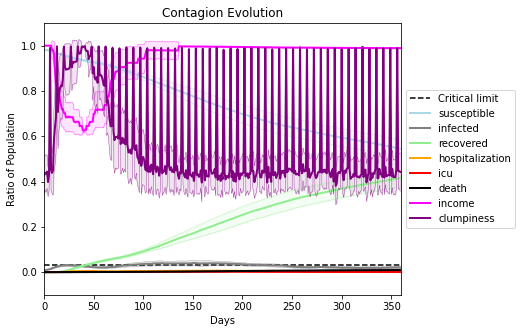

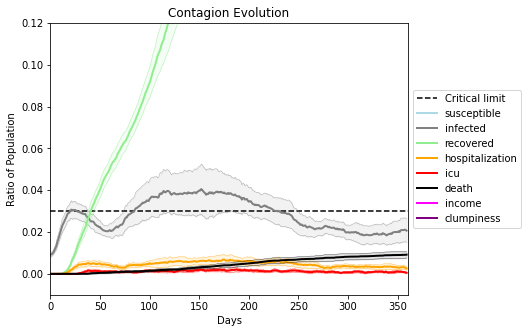

In [4]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4443, 5849, 4319, 203, 9494, 4692, 5952, 6979, 8469, 2108, 5263, 3569, 9794, 9899, 1900, 2648, 4649, 5244, 5612, 5780]
Average similarity between family members is 0.971093572204218 at temperature -0.999
Average similarity between family and home is 0.9998586341745341 at temperature -1
Average similarity between students and their classroom is 0.7560499938934482 at temperature -0.999
Average classroom occupancy is 4.424242424242424 and number classrooms is 66
Average similarity between workers is 0.9686500562786644 at temperature -0.999
Average office occupancy is 3.5833333333333335 and number offices is 180
Average friend similarity for adults: 0.8537293496581069 for kids: 0.718245495650209
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.6916119698492615
avg restaurant similarity 0.7776861365893549
avg restaurant similarity 0.5584287145488337
avg restaurant similarity 0.5909924740702008
avg restaurant similarity 0.5336892595509156
avg restaurant similarity 0.5946639284650594
avg restaurant similarity 0.5118579845720967
avg restaurant similarity 0.5865583894358963
avg restaurant similarity 0.5938425585306234
avg restaurant similarity 0.6171042520398764
avg restaurant similarity 0.6963102757441779
avg restaurant similarity 0.7025752397035252
avg restaurant similarity 0.6292665629266497
avg restaurant similarity 0.5904305727916132
avg restaurant similarity 0.563968665906578
avg restaurant similarity 0.6862150117293803
avg restaurant similarity 0.761281396537155
avg restaurant similarity 0.60553632717201
avg restaurant similarity 0.46107807467217166
avg restaurant similarity 0.4461815916433254
avg restaurant similarity 0.5514565141822734
avg restaurant similarity 0.6885794361892059
avg restauran

avg restaurant similarity 0.8279696699096245
avg restaurant similarity 0.5750596237284552
avg restaurant similarity 0.46085441380011805
avg restaurant similarity 0.612644155614487
avg restaurant similarity 0.4107138128077882
avg restaurant similarity 0.5056357967712383
avg restaurant similarity 0.5044658963043581
avg restaurant similarity 0.4481439043171591
avg restaurant similarity 0.5937907181652229
avg restaurant similarity 0.601840867766252
avg restaurant similarity 0.6167898496599755
avg restaurant similarity 0.475670416601731
avg restaurant similarity 0.5337698279315788
avg restaurant similarity 0.5868819009233908
avg restaurant similarity 0.3722695839272995
avg restaurant similarity 0.5315273456162675
avg restaurant similarity 0.5736354567936047
avg restaurant similarity 0.7800317106379969
avg restaurant similarity 0.582697432612553
avg restaurant similarity 0.8031490367002005
avg restaurant similarity 0.4505895017564168
avg restaurant similarity 0.6487747068792655
avg restauran

avg restaurant similarity 0.6562891314259538
avg restaurant similarity 0.5277730037284822
avg restaurant similarity 0.659205943105078
avg restaurant similarity 0.6477076665053828
avg restaurant similarity 0.5505982020956803
avg restaurant similarity 0.5578209558647002
avg restaurant similarity 0.5717058851431694
avg restaurant similarity 0.5325943004670088
avg restaurant similarity 0.5312062622518529
avg restaurant similarity 0.5046961592321149
avg restaurant similarity 0.5688913893719117
avg restaurant similarity 0.683634483304709
avg restaurant similarity 0.5682083095013329
avg restaurant similarity 0.6978709353787089
avg restaurant similarity 0.44802525224391787
avg restaurant similarity 0.6896782930656833
avg restaurant similarity 0.626536777445548
avg restaurant similarity 0.5346470267644503
avg restaurant similarity 0.5167577814336286
avg restaurant similarity 0.5068375213369775
avg restaurant similarity 0.5312554200586396
avg restaurant similarity 0.864372006767589
avg restauran

avg restaurant similarity 0.5266145391127167
avg restaurant similarity 0.6355902358975822
avg restaurant similarity 0.44245709271803135
avg restaurant similarity 0.5347246896919399
avg restaurant similarity 0.650063640253477
avg restaurant similarity 0.6300506068482681
avg restaurant similarity 0.8826566332529711
avg restaurant similarity 0.5377731690193436
avg restaurant similarity 0.4271107131692964
avg restaurant similarity 0.5364237830818299
avg restaurant similarity 0.6483109933289116
avg restaurant similarity 0.6703711221483425
avg restaurant similarity 0.6389076497681622
avg restaurant similarity 0.5824410586827395
avg restaurant similarity 0.7386705690809199
avg restaurant similarity 0.5495525786471676
avg restaurant similarity 0.652253285031054
avg restaurant similarity 0.5557794440225631
avg restaurant similarity 0.726837795629393
avg restaurant similarity 0.5889341828695914
avg restaurant similarity 0.6274389768274068
avg restaurant similarity 0.46442914809298547
avg restaur

avg restaurant similarity 0.6358842148123669
avg restaurant similarity 0.5628134605109213
avg restaurant similarity 0.8683024822862038
avg restaurant similarity 0.83934727581337
avg restaurant similarity 0.5955958195318526
avg restaurant similarity 0.45551479876349676
avg restaurant similarity 0.5243211010363489
avg restaurant similarity 0.3430320663660371
avg restaurant similarity 0.706945146418075
avg restaurant similarity 0.6250856095366281
avg restaurant similarity 0.6505774820054028
avg restaurant similarity 0.6031245478306481
avg restaurant similarity 0.48661760217188377
avg restaurant similarity 0.6751355225871586
avg restaurant similarity 0.7187518504194853
avg restaurant similarity 0.37680175656054693
avg restaurant similarity 0.2815996704441125
avg restaurant similarity 0.3376336769880239
avg restaurant similarity 0.7513600268637621
avg restaurant similarity 0.7369254507703932
avg restaurant similarity 0.6420861887963188
avg restaurant similarity 0.8248275085114927
avg restau

avg restaurant similarity 0.37680175656054693
avg restaurant similarity 0.4422272933598206
avg restaurant similarity 0.6131877711186091
avg restaurant similarity 0.7799499882680139
avg restaurant similarity 0.6687847163221008
avg restaurant similarity 0.737433928727658
avg restaurant similarity 0.9998226725171396
avg restaurant similarity 0.5932669825458666
avg restaurant similarity 0.763060849305873
avg restaurant similarity 0.4631201059584319
avg restaurant similarity 0.9548827412521927
avg restaurant similarity 0.5919255383989984
avg restaurant similarity 0.6123641660681672
avg restaurant similarity 0.6406407976635964
avg restaurant similarity 0.3347306154477758
avg restaurant similarity 0.5638807710864017
avg restaurant similarity 0.7010525363484419
avg restaurant similarity 0.46249995408838024
avg restaurant similarity 0.4853626700692756
avg restaurant similarity 0.6677756459411585
avg restaurant similarity 0.6611771625070129
avg restaurant similarity 0.5300582073913994
avg restau

avg restaurant similarity 0.6805736020739278
avg restaurant similarity 0.5461392420566212
avg restaurant similarity 0.5427107456766008
avg restaurant similarity 0.5262108618688343
avg restaurant similarity 0.6365795812048064
avg restaurant similarity 0.4083790194659399
avg restaurant similarity 0.7661263792553162
avg restaurant similarity 0.6818092260608216
avg restaurant similarity 0.5460890020461026
avg restaurant similarity 0.600347526758843
avg restaurant similarity 0.5932884048407392
avg restaurant similarity 0.6939698831085853
avg restaurant similarity 0.5660585171436538
avg restaurant similarity 0.6732798213930382
avg restaurant similarity 0.6294023784571043
avg restaurant similarity 0.7743598024397448
avg restaurant similarity 0.522014379370135
avg restaurant similarity 0.682090489772524
avg restaurant similarity 0.6816610991204604
avg restaurant similarity 0.6251250392509144
avg restaurant similarity 0.6167905481313598
avg restaurant similarity 0.48682199625816575
avg restaura

avg restaurant similarity 0.4934245907447272
avg restaurant similarity 0.6483818552163633
avg restaurant similarity 0.701391142921127
avg restaurant similarity 0.5544096738647909
avg restaurant similarity 0.5824069231114914
avg restaurant similarity 0.5839429032654475
avg restaurant similarity 0.5872987507434632
avg restaurant similarity 0.7880098472682976
avg restaurant similarity 0.5797930510382923
avg restaurant similarity 0.5208976640606611
avg restaurant similarity 0.35501299934475644
avg restaurant similarity 0.49452641053473034
avg restaurant similarity 0.5940272677561433
avg restaurant similarity 0.6272615161662469
avg restaurant similarity 0.5721447957916641
avg restaurant similarity 0.7470041103643951
avg restaurant similarity 0.6648784782190107
avg restaurant similarity 0.48117405910976146
avg restaurant similarity 0.5790993535220517
avg restaurant similarity 0.6215936623187311
avg restaurant similarity 0.5291421888848961
avg restaurant similarity 0.7829559548413019
avg rest

avg restaurant similarity 0.8267883290406827
avg restaurant similarity 0.7107498693356895
avg restaurant similarity 0.6792340684161857
avg restaurant similarity 0.5942852170182026
avg restaurant similarity 0.5462386652222789
avg restaurant similarity 0.5956521187924108
avg restaurant similarity 0.6211794638591204
avg restaurant similarity 0.5826789001452635
avg restaurant similarity 0.6097809584624957
avg restaurant similarity 0.679966776740967
avg restaurant similarity 0.7292838268341989
avg restaurant similarity 0.6991260482480263
avg restaurant similarity 0.8649478476761004
avg restaurant similarity 0.6038055750164952
avg restaurant similarity 0.8299095537754668
avg restaurant similarity 0.7030141105680485
avg restaurant similarity 0.9993818397781937
avg restaurant similarity 0.7715643834252782
avg restaurant similarity 0.8458151969704462
avg restaurant similarity 0.7247769317529814
avg restaurant similarity 0.5286999925591974
avg restaurant similarity 0.7665556895423409
avg restaur

avg restaurant similarity 0.5729349095254768
avg restaurant similarity 0.7526453473027663
avg restaurant similarity 0.708629651504382
avg restaurant similarity 0.742226357563919
avg restaurant similarity 0.999446439222901
avg restaurant similarity 0.7618694200839305
avg restaurant similarity 0.7017933795737574
avg restaurant similarity 0.5585659231040988
avg restaurant similarity 0.7510611562051556
avg restaurant similarity 0.6011358834018813
avg restaurant similarity 0.6630673261558083
avg restaurant similarity 0.6115323792310918
avg restaurant similarity 0.743746668168862
avg restaurant similarity 0.7873292139749503
avg restaurant similarity 0.6982894076278696
avg restaurant similarity 0.850181928548101
avg restaurant similarity 0.6285990591759207
avg restaurant similarity 0.6916957667635177
avg restaurant similarity 0.8098408044112815
avg restaurant similarity 0.6818668204041402
avg restaurant similarity 0.5541253955381853
avg restaurant similarity 0.7893137915115326
avg restaurant 

avg restaurant similarity 0.6446757979528005
avg restaurant similarity 0.6824928333761138
avg restaurant similarity 0.4903695912723439
avg restaurant similarity 0.7775735795885754
avg restaurant similarity 0.6381780983333881
avg restaurant similarity 0.623159302190451
avg restaurant similarity 0.4313965534870713
avg restaurant similarity 0.5677246558919533
avg restaurant similarity 0.6389143654692648
avg restaurant similarity 0.6115758236721464
avg restaurant similarity 0.5251254615335444
avg restaurant similarity 0.8752955842694294
avg restaurant similarity 0.6976099561121927
avg restaurant similarity 0.9369279376225726
avg restaurant similarity 0.6863606186111637
avg restaurant similarity 0.6064641239852179
avg restaurant similarity 0.5645901232759268
avg restaurant similarity 0.6122684930402784
avg restaurant similarity 0.5676474715259769
avg restaurant similarity 0.6217317807538955
avg restaurant similarity 0.5882838113658982
avg restaurant similarity 0.6882809691048198
avg restaur

avg restaurant similarity 0.5092008944381465
avg restaurant similarity 0.7678541818913956
avg restaurant similarity 0.6554028613158636
avg restaurant similarity 0.6374998655966334
avg restaurant similarity 0.5611605342880792
avg restaurant similarity 0.675005547093914
avg restaurant similarity 0.5691010453959979
avg restaurant similarity 0.4582656801435129
avg restaurant similarity 0.622897950031388
avg restaurant similarity 0.567360238676686
avg restaurant similarity 0.6086136161556323
avg restaurant similarity 0.6851269559206061
avg restaurant similarity 0.5923685806978652
avg restaurant similarity 0.6776850117874038
avg restaurant similarity 0.5493102807394863
avg restaurant similarity 0.6473679345101655
avg restaurant similarity 0.5530735403414085
avg restaurant similarity 0.5524470029977019
avg restaurant similarity 0.49706861676685826
avg restaurant similarity 0.6406017709687003
avg restaurant similarity 0.680380586359413
avg restaurant similarity 0.6285089304720932
avg restauran

avg restaurant similarity 0.5713181787809265
avg restaurant similarity 0.5998549825311027
avg restaurant similarity 0.6019288428138441
avg restaurant similarity 0.6437537324781111
avg restaurant similarity 0.5731217079981384
avg restaurant similarity 0.5826572044351694
avg restaurant similarity 0.7057534809425688
avg restaurant similarity 0.6128889818828109
avg restaurant similarity 0.6908664136062627
avg restaurant similarity 0.6355910038884166
avg restaurant similarity 0.5430137042568057
avg restaurant similarity 0.6091599373061922
avg restaurant similarity 0.7005293316934991
avg restaurant similarity 0.5453447566070472
avg restaurant similarity 0.5286503856491869
avg restaurant similarity 0.7293333837802287
avg restaurant similarity 0.707490227736093
avg restaurant similarity 0.629768289707853
avg restaurant similarity 0.5420332365635502
avg restaurant similarity 0.7263237818627296
avg restaurant similarity 0.6709191432236706
avg restaurant similarity 0.6345443423035905
avg restaura

avg restaurant similarity 0.6216358066587554
avg restaurant similarity 0.708026662197442
avg restaurant similarity 0.5335616676198234
avg restaurant similarity 0.6842061777397598
avg restaurant similarity 0.6655770897319038
avg restaurant similarity 0.6255044049950658
avg restaurant similarity 0.632892445975403
avg restaurant similarity 0.5587547654751255
avg restaurant similarity 0.681116212216788
avg restaurant similarity 0.8647358046106959
avg restaurant similarity 0.6462424141451042
avg restaurant similarity 0.6266633318154445
avg restaurant similarity 0.5138767503089456
avg restaurant similarity 0.6396411953964982
avg restaurant similarity 0.6276026790643852
avg restaurant similarity 0.664370135352278
avg restaurant similarity 0.5240385634099415
avg restaurant similarity 0.5999221183331331
avg restaurant similarity 0.5819682933403733
avg restaurant similarity 0.6501180727715083
avg restaurant similarity 0.6652932582046275
avg restaurant similarity 0.5323602889837475
avg restaurant

avg restaurant similarity 0.844979806349283
avg restaurant similarity 0.6636368139851978
avg restaurant similarity 0.5251846319702167
avg restaurant similarity 0.45662074487908183
avg restaurant similarity 0.8147429702257947
avg restaurant similarity 0.5421282541044176
avg restaurant similarity 0.52337052466812
avg restaurant similarity 0.7743662128334761
avg restaurant similarity 0.7261342363775528
avg restaurant similarity 0.593764773075253
avg restaurant similarity 0.7608402045153316
avg restaurant similarity 0.7294165285671699
avg restaurant similarity 0.7933458213215703
avg restaurant similarity 0.9997115493541313
avg restaurant similarity 0.5137165832378964
avg restaurant similarity 0.5900933566803521
avg restaurant similarity 0.6207190964996872
avg restaurant similarity 0.8377227993138353
avg restaurant similarity 0.46597816979717643
avg restaurant similarity 0.4346964175223459
avg restaurant similarity 0.5543189551878946
avg restaurant similarity 0.5115742025155783
avg restaura

avg restaurant similarity 0.514155753635875
avg restaurant similarity 0.6220279710290533
avg restaurant similarity 0.6548337395932893
avg restaurant similarity 0.48457004833305184
avg restaurant similarity 0.3333988998567057
avg restaurant similarity 0.7563686469947662
avg restaurant similarity 0.5826518852246809
avg restaurant similarity 0.8136681010707326
avg restaurant similarity 0.9995171820257089
avg restaurant similarity 0.6008897613857558
avg restaurant similarity 0.9996212917934967
avg restaurant similarity 0.5137165832378964
avg restaurant similarity 0.6686403438283244
avg restaurant similarity 0.5225018438660776
avg restaurant similarity 0.9998031273951373
avg restaurant similarity 0.874186578453238
avg restaurant similarity 0.9731748880938934
avg restaurant similarity 0.5171773019561491
avg restaurant similarity 0.7909310967946478
avg restaurant similarity 0.43400529858460957
avg restaurant similarity 0.3885282461486321
avg restaurant similarity 0.9361877275913832
avg restau

avg restaurant similarity 0.6237144656670064
avg restaurant similarity 0.6579172356764124
avg restaurant similarity 0.720504720064812
avg restaurant similarity 0.5698399986322539
avg restaurant similarity 0.6325269012818397
avg restaurant similarity 0.7263145463186177
avg restaurant similarity 0.588463107053071
avg restaurant similarity 0.6375710904007359
avg restaurant similarity 0.7608281739104352
avg restaurant similarity 0.663160672348672
avg restaurant similarity 0.6396670951786797
avg restaurant similarity 0.502452285364012
avg restaurant similarity 0.5235733297815153
avg restaurant similarity 0.719864189938148
avg restaurant similarity 0.5603423635113051
avg restaurant similarity 0.5930753486802849
avg restaurant similarity 0.6270475833448519
avg restaurant similarity 0.354455747217961
avg restaurant similarity 0.5272759600855308
avg restaurant similarity 0.4528358441963793
avg restaurant similarity 0.6084457794418252
avg restaurant similarity 0.5759210229141053
avg restaurant s

avg restaurant similarity 0.6465043580532172
avg restaurant similarity 0.5717994825811925
avg restaurant similarity 0.41118457595254937
avg restaurant similarity 0.686347318626941
avg restaurant similarity 0.6078603329366162
avg restaurant similarity 0.6811531463776723
avg restaurant similarity 0.4701959022227585
avg restaurant similarity 0.5802641772158847
avg restaurant similarity 0.6025157375901924
avg restaurant similarity 0.6702877210710916
avg restaurant similarity 0.6427737325888198
avg restaurant similarity 0.5888616502373725
avg restaurant similarity 0.5555853635007224
avg restaurant similarity 0.667630300477141
avg restaurant similarity 0.7391038714614173
avg restaurant similarity 0.845879072530174
avg restaurant similarity 0.7110785358669605
avg restaurant similarity 0.504897775003774
avg restaurant similarity 0.6164252815604039
avg restaurant similarity 0.6381203324121097
avg restaurant similarity 0.6849702341218449
avg restaurant similarity 0.6633436323300587
avg restauran

avg restaurant similarity 0.5567288318413846
avg restaurant similarity 0.5966766401452405
avg restaurant similarity 0.7215047426706701
avg restaurant similarity 0.5875911306317303
avg restaurant similarity 0.7397772047192076
avg restaurant similarity 0.7621169553554522
avg restaurant similarity 0.8248567680136629
avg restaurant similarity 0.5919615277502793
avg restaurant similarity 0.7317672769182317
avg restaurant similarity 0.5867275070261958
avg restaurant similarity 0.665386637458761
avg restaurant similarity 0.622705449913668
avg restaurant similarity 0.6078006951849352
avg restaurant similarity 0.6166989299153224
avg restaurant similarity 0.6112566318168461
avg restaurant similarity 0.6873173857702839
avg restaurant similarity 0.4757965969122351
avg restaurant similarity 0.6244158441300097
avg restaurant similarity 0.5816531908047572
avg restaurant similarity 0.6868889911442575
avg restaurant similarity 0.5196967297436366
avg restaurant similarity 0.5782628196259807
avg restaura

avg restaurant similarity 0.5975539417306218
avg restaurant similarity 0.5318893420830582
avg restaurant similarity 0.6689292488455859
avg restaurant similarity 0.5332129311437509
avg restaurant similarity 0.6625449471281935
avg restaurant similarity 0.7898066683520518
avg restaurant similarity 0.7949831719501148
avg restaurant similarity 0.6056262768495919
avg restaurant similarity 0.5732554090157272
avg restaurant similarity 0.5815176354155932
avg restaurant similarity 0.7090894007921295
avg restaurant similarity 0.6265894198229431
avg restaurant similarity 0.7417075362435828
avg restaurant similarity 0.5239206389063754
avg restaurant similarity 0.6723273069737712
avg restaurant similarity 0.4876471158603531
avg restaurant similarity 0.6233335230731657
avg restaurant similarity 0.4855121109666902
avg restaurant similarity 0.6590003885169361
avg restaurant similarity 0.7246160832588716
avg restaurant similarity 0.7803562723222537
avg restaurant similarity 0.5699407959196221
avg restau

avg restaurant similarity 0.6315069951714021
avg restaurant similarity 0.5076940481303115
avg restaurant similarity 0.47642679533829035
avg restaurant similarity 0.647379560959388
avg restaurant similarity 0.7281346129434727
avg restaurant similarity 0.6366946818003578
avg restaurant similarity 0.5684806450362756
avg restaurant similarity 0.5971180356555017
avg restaurant similarity 0.8447269063607269
avg restaurant similarity 0.6585131597430104
avg restaurant similarity 0.6492297532761363
avg restaurant similarity 0.397919556873894
avg restaurant similarity 0.4220631103251432
avg restaurant similarity 0.637569120343596
avg restaurant similarity 0.626750269942206
avg restaurant similarity 0.4778931954844167
avg restaurant similarity 0.5497948283139553
avg restaurant similarity 0.4867697443692616
avg restaurant similarity 0.71794501565502
avg restaurant similarity 0.5365652452431913
avg restaurant similarity 0.7530339773917947
avg restaurant similarity 0.4490200284941617
avg restaurant 

avg restaurant similarity 0.5467973011445628
avg restaurant similarity 0.5332634996325689
avg restaurant similarity 0.585078935591427
avg restaurant similarity 0.6461596187850701
avg restaurant similarity 0.7313129204604031
avg restaurant similarity 0.6601363412867814
avg restaurant similarity 0.5716595148554179
avg restaurant similarity 0.601693219486867
avg restaurant similarity 0.5183538050353541
avg restaurant similarity 0.5608540513069812
avg restaurant similarity 0.6152517142117687
avg restaurant similarity 0.611994634745102
avg restaurant similarity 0.6509597214292416
avg restaurant similarity 0.48491304054651135
avg restaurant similarity 0.5182724118461567
avg restaurant similarity 0.5223656703952639
avg restaurant similarity 0.6562038112587048
avg restaurant similarity 0.8198150963456025
avg restaurant similarity 0.6678564609883757
avg restaurant similarity 0.7317926536415502
avg restaurant similarity 0.538595273650158
avg restaurant similarity 0.6451991943689224
avg restauran

avg restaurant similarity 0.7676995621771289
avg restaurant similarity 0.7614312441353271
avg restaurant similarity 0.7312258613696981
avg restaurant similarity 0.8058220701171587
avg restaurant similarity 0.7438017673455208
avg restaurant similarity 0.5602009302415203
avg restaurant similarity 0.7867618170177065
avg restaurant similarity 0.6933061150801775
avg restaurant similarity 0.7455636185572627
avg restaurant similarity 0.7733684199596839
avg restaurant similarity 0.6746873387087637
avg restaurant similarity 0.8295207291721288
avg restaurant similarity 0.8325097702319021
avg restaurant similarity 0.7729805831706523
avg restaurant similarity 0.7084381862322486
avg restaurant similarity 0.6187316926441079
avg restaurant similarity 0.6961054698539278
avg restaurant similarity 0.8017196141969789
avg restaurant similarity 0.6902456800619183
avg restaurant similarity 0.732735866380814
avg restaurant similarity 0.7487918474435001
avg restaurant similarity 0.7042709241337693
avg restaur

avg restaurant similarity 0.6555766200128572
avg restaurant similarity 0.506866935444856
avg restaurant similarity 0.8686490813365068
avg restaurant similarity 0.7767824187977759
avg restaurant similarity 0.7649640964112522
avg restaurant similarity 0.6160287678861219
avg restaurant similarity 0.6841568801259917
avg restaurant similarity 0.772078258720421
avg restaurant similarity 0.8010904150322657
avg restaurant similarity 0.8428982147547792
avg restaurant similarity 0.7187166368215225
avg restaurant similarity 0.6161776072177456
avg restaurant similarity 0.9999355030408348
avg restaurant similarity 0.7547871034794696
avg restaurant similarity 0.8848390428069948
avg restaurant similarity 0.5713678881777352
avg restaurant similarity 0.7338434389112414
avg restaurant similarity 0.8458578847140865
avg restaurant similarity 0.8423710692729202
avg restaurant similarity 0.6205601334822706
avg restaurant similarity 0.7911244103552896
avg restaurant similarity 0.5056732806534477
avg restaura

avg restaurant similarity 0.5917300190086452
avg restaurant similarity 0.6980143306201526
avg restaurant similarity 0.5401617534398767
avg restaurant similarity 0.5462037728627817
avg restaurant similarity 0.5952675781870109
avg restaurant similarity 0.49475300431962604
avg restaurant similarity 0.6149781817218589
avg restaurant similarity 0.7186418435019105
avg restaurant similarity 0.6105360997620473
avg restaurant similarity 0.39649370698541003
avg restaurant similarity 0.6707895250023341
avg restaurant similarity 0.6911245562604406
avg restaurant similarity 0.5274744300381092
avg restaurant similarity 0.593196644665606
avg restaurant similarity 0.5682863321358347
avg restaurant similarity 0.5117694280195858
avg restaurant similarity 0.5036635974105177
avg restaurant similarity 0.6814076641485745
avg restaurant similarity 0.5181694181247039
avg restaurant similarity 0.6623273844968223
avg restaurant similarity 0.5538109279847274
avg restaurant similarity 0.46137317573327785
avg rest

avg restaurant similarity 0.5840149473793359
avg restaurant similarity 0.7133405221272557
avg restaurant similarity 0.5531185472187302
avg restaurant similarity 0.6873816283228812
avg restaurant similarity 0.5051431326762901
avg restaurant similarity 0.5629649748341395
avg restaurant similarity 0.45148944864811713
avg restaurant similarity 0.7760151776378997
avg restaurant similarity 0.5487732343921391
avg restaurant similarity 0.5739288796623481
avg restaurant similarity 0.5721465485277318
avg restaurant similarity 0.37986885687835104
avg restaurant similarity 0.4670407728382439
avg restaurant similarity 0.519871561785795
avg restaurant similarity 0.5816246758882871
avg restaurant similarity 0.7384823916584173
avg restaurant similarity 0.6482400598894578
avg restaurant similarity 0.5956852728483985
avg restaurant similarity 0.5345556189000519
avg restaurant similarity 0.5279673763464009
avg restaurant similarity 0.7593472600470383
avg restaurant similarity 0.5796313863472881
avg resta

avg restaurant similarity 0.6079232925725349
avg restaurant similarity 0.6963823418587153
avg restaurant similarity 0.6501297955412491
avg restaurant similarity 0.5697625447580754
avg restaurant similarity 0.7260126268166326
avg restaurant similarity 0.6732271793754743
avg restaurant similarity 0.5988392010772915
avg restaurant similarity 0.6998229091279878
avg restaurant similarity 0.644086847578919
avg restaurant similarity 0.6886263772732979
avg restaurant similarity 0.60955241957143
avg restaurant similarity 0.6920787355064519
avg restaurant similarity 0.6859702233558013
avg restaurant similarity 0.5021528923334755
avg restaurant similarity 0.5703458020922035
avg restaurant similarity 0.6358131977617019
avg restaurant similarity 0.5632194184324921
avg restaurant similarity 0.6638290580414365
avg restaurant similarity 0.7016789157599153
avg restaurant similarity 0.7002481676882285
avg restaurant similarity 0.6291285438021404
avg restaurant similarity 0.597647826309402
avg restaurant

avg restaurant similarity 0.5684251498812628
avg restaurant similarity 0.6305936111674109
avg restaurant similarity 0.6806998837691537
avg restaurant similarity 0.6434347522398715
avg restaurant similarity 0.5874554133650528
avg restaurant similarity 0.5263081112094999
avg restaurant similarity 0.697961345875422
avg restaurant similarity 0.5872064571728866
avg restaurant similarity 0.5432681649909031
avg restaurant similarity 0.6594554308768485
avg restaurant similarity 0.6143209871300301
avg restaurant similarity 0.6748385797622464
avg restaurant similarity 0.804109172998266
avg restaurant similarity 0.6870442200780811
avg restaurant similarity 0.8282600360875265
avg restaurant similarity 0.7803565232350999
avg restaurant similarity 0.5328115086346245
avg restaurant similarity 0.6965379677338379
avg restaurant similarity 0.7110967506795793
avg restaurant similarity 0.6059081711462522
avg restaurant similarity 0.6467779530921814
avg restaurant similarity 0.6432871985432863
avg restaura

avg restaurant similarity 0.8269041918028388
avg restaurant similarity 0.509593806734417
avg restaurant similarity 0.5950599665622708
avg restaurant similarity 0.6069987812272504
avg restaurant similarity 0.7014793527477661
avg restaurant similarity 0.7157625441784682
avg restaurant similarity 0.6008137498167263
avg restaurant similarity 0.552510842471093
avg restaurant similarity 0.6014063164940753
avg restaurant similarity 0.7979761238535082
avg restaurant similarity 0.6038687681777212
avg restaurant similarity 0.6532279768314222
avg restaurant similarity 0.7387504907487902
avg restaurant similarity 0.6394710001015923
avg restaurant similarity 0.6831914456286444
avg restaurant similarity 0.7361506435831756
avg restaurant similarity 0.648367329668731
avg restaurant similarity 0.8217727828249827
avg restaurant similarity 0.7278372689966082
avg restaurant similarity 0.807562193791565
avg restaurant similarity 0.5472564500110582
avg restaurant similarity 0.7194053688311906
avg restaurant

avg restaurant similarity 0.722618436516365
avg restaurant similarity 0.7216730015657866
avg restaurant similarity 0.5074207816248123
avg restaurant similarity 0.586347524269091
avg restaurant similarity 0.6537853074219279
avg restaurant similarity 0.8228475789681721
avg restaurant similarity 0.6584531769998434
avg restaurant similarity 0.5726742507239297
avg restaurant similarity 0.6978653112883644
avg restaurant similarity 0.5041877967162992
avg restaurant similarity 0.7007157171106291
avg restaurant similarity 0.5763396056156038
avg restaurant similarity 0.6412425568587642
avg restaurant similarity 0.6622286023007842
avg restaurant similarity 0.7028026278201223
avg restaurant similarity 0.7007703434507152
avg restaurant similarity 0.6590412558886719
avg restaurant similarity 0.6945710495724077
avg restaurant similarity 0.6046462107147087
avg restaurant similarity 0.691754592380261
avg restaurant similarity 0.5563211120208771
avg restaurant similarity 0.6831505605587151
avg restauran

avg restaurant similarity 0.8813216435038081
avg restaurant similarity 0.6696158354674141
avg restaurant similarity 0.628694583775152
avg restaurant similarity 0.9219898338538498
avg restaurant similarity 0.5682535639420723
avg restaurant similarity 0.6091943360939908
avg restaurant similarity 0.6118416311390034
avg restaurant similarity 0.723945005049782
avg restaurant similarity 0.7503091411240409
avg restaurant similarity 0.6828902594499056
avg restaurant similarity 0.4631440005024857
avg restaurant similarity 0.650614715553277
avg restaurant similarity 0.7169083150620539
avg restaurant similarity 0.7416934217708027
avg restaurant similarity 0.8962683142432182
avg restaurant similarity 0.5435784220467471
avg restaurant similarity 0.5726902378274363
avg restaurant similarity 0.5223631669544981
avg restaurant similarity 0.7141128619752494
avg restaurant similarity 0.5830383210930452
avg restaurant similarity 0.6134808839474398
avg restaurant similarity 0.8775335131677209
avg restauran

avg restaurant similarity 0.656798702072918
avg restaurant similarity 0.703723532958701
avg restaurant similarity 0.7125068033904317
avg restaurant similarity 0.7407281076240549
avg restaurant similarity 0.7863066662826715
avg restaurant similarity 0.7568600324881986
avg restaurant similarity 0.4313872538224505
avg restaurant similarity 0.6286269072319536
avg restaurant similarity 0.5944885278403458
avg restaurant similarity 0.8051482518225941
avg restaurant similarity 0.5974416699007927
avg restaurant similarity 0.6897301415129912
avg restaurant similarity 0.9996476333211303
avg restaurant similarity 0.6419282977335077
avg restaurant similarity 0.7551934964787397
avg restaurant similarity 0.32731508024469835
avg restaurant similarity 0.5886673005472678
avg restaurant similarity 0.8491890065490374
avg restaurant similarity 0.6206458489481829
avg restaurant similarity 0.7020748372514611
avg restaurant similarity 0.6518596227196541
avg restaurant similarity 0.6090674818102717
avg restaur

avg restaurant similarity 0.5864434562526325
avg restaurant similarity 0.5919262273629203
avg restaurant similarity 0.5369547583086003
avg restaurant similarity 0.547015536438021
avg restaurant similarity 0.6778647349397938
avg restaurant similarity 0.8405206981737713
avg restaurant similarity 0.5955686050832419
avg restaurant similarity 0.6782889577656885
avg restaurant similarity 0.943876493851501
avg restaurant similarity 0.6192950373588201
avg restaurant similarity 0.5051916832171807
avg restaurant similarity 0.8056269863944725
avg restaurant similarity 0.4268790972158789
avg restaurant similarity 0.630399101046325
avg restaurant similarity 0.5748434557161483
avg restaurant similarity 0.6330151543019129
avg restaurant similarity 0.6629162577080041
avg restaurant similarity 0.6759634354208485
avg restaurant similarity 0.8320925291307691
avg restaurant similarity 0.6280016287713734
avg restaurant similarity 0.8473795363197241
avg restaurant similarity 0.6522306580932445
avg restauran

avg restaurant similarity 0.5552234126959799
avg restaurant similarity 0.6311123373406066
avg restaurant similarity 0.7520079561546099
avg restaurant similarity 0.80676050434853
avg restaurant similarity 0.846217164495266
avg restaurant similarity 0.8259889261842198
avg restaurant similarity 0.7665804317680658
avg restaurant similarity 0.6954168833990609
avg restaurant similarity 0.7348744572760625
avg restaurant similarity 0.5526201991066749
avg restaurant similarity 0.822212076361094
avg restaurant similarity 0.7540211254898438
avg restaurant similarity 0.6379586756021811
avg restaurant similarity 0.7772708795274014
avg restaurant similarity 0.7033825300127159
avg restaurant similarity 0.7257418546549845
avg restaurant similarity 0.6884044286708244
avg restaurant similarity 0.787613808205613
avg restaurant similarity 0.7177363697512809
avg restaurant similarity 0.7650606121808703
avg restaurant similarity 0.9998299226535259
avg restaurant similarity 0.8091549186376846
avg restaurant 

avg restaurant similarity 0.7843928542576283
avg restaurant similarity 0.5185757771998846
avg restaurant similarity 0.845498053570427
avg restaurant similarity 0.6349663614428724
avg restaurant similarity 0.48177295697772377
avg restaurant similarity 0.6133823614993285
avg restaurant similarity 0.5704530186661206
avg restaurant similarity 0.759504222437673
avg restaurant similarity 0.5321655964703325
avg restaurant similarity 0.5722641048024674
avg restaurant similarity 0.5992526182412778
avg restaurant similarity 0.6505388292415551
avg restaurant similarity 0.5418115720274616
avg restaurant similarity 0.5055487117493309
avg restaurant similarity 0.6400400366375079
avg restaurant similarity 0.6171561061287617
avg restaurant similarity 0.7376810279927686
avg restaurant similarity 0.4866097532459439
avg restaurant similarity 0.6477208446735196
avg restaurant similarity 0.4679823514333124
avg restaurant similarity 0.8144784303772206
avg restaurant similarity 0.5541422106307807
avg restaur

avg restaurant similarity 0.615967083332804
avg restaurant similarity 0.5432157124514094
avg restaurant similarity 0.6115931432516017
avg restaurant similarity 0.5471365325446194
avg restaurant similarity 0.6959848771343686
avg restaurant similarity 0.5611098130495011
avg restaurant similarity 0.3774415676878066
avg restaurant similarity 0.7463142408531802
avg restaurant similarity 0.6935113906646746
avg restaurant similarity 0.6978218714714536
avg restaurant similarity 0.578051596377306
avg restaurant similarity 0.5729964820750176
avg restaurant similarity 0.4450798831137861
avg restaurant similarity 0.6189324720042213
avg restaurant similarity 0.49830085486375153
avg restaurant similarity 0.5751509972819043
avg restaurant similarity 0.7029454477485061
avg restaurant similarity 0.540221898986514
avg restaurant similarity 0.5098500160439272
avg restaurant similarity 0.5886994992561898
avg restaurant similarity 0.6798781163961081
avg restaurant similarity 0.6288774900138664
avg restaura

avg restaurant similarity 0.5630897125438254
avg restaurant similarity 0.40633176114092745
avg restaurant similarity 0.4155803164539696
avg restaurant similarity 0.5513005128703429
avg restaurant similarity 0.6602371468754226
avg restaurant similarity 0.6448869340995547
avg restaurant similarity 0.38627305768545356
avg restaurant similarity 0.6067571324560026
avg restaurant similarity 0.6723698420848494
avg restaurant similarity 0.545335251435365
avg restaurant similarity 0.5876442453277563
avg restaurant similarity 0.41088885825521865
avg restaurant similarity 0.4369127599257779
avg restaurant similarity 0.8421777741141332
avg restaurant similarity 0.45046532549280005
avg restaurant similarity 0.5388652673586262
avg restaurant similarity 0.9297869541083672
avg restaurant similarity 0.6570094810321394
avg restaurant similarity 0.5461559972321361
avg restaurant similarity 0.6761250119023259
avg restaurant similarity 0.5700022599472439
avg restaurant similarity 0.7546827619811507
avg res

avg restaurant similarity 0.6271397981892801
avg restaurant similarity 0.44634709141429113
avg restaurant similarity 0.7070357368283628
avg restaurant similarity 0.5045778197491902
avg restaurant similarity 0.7653445387493162
avg restaurant similarity 0.5501724848798817
avg restaurant similarity 0.7535753122314608
avg restaurant similarity 0.7060016381151477
avg restaurant similarity 0.8212155191361677
avg restaurant similarity 0.7916548252996757
avg restaurant similarity 0.6307461657850477
avg restaurant similarity 0.6336809896506316
avg restaurant similarity 0.4816253362233884
avg restaurant similarity 0.6731496655568443
avg restaurant similarity 0.4094315888963255
avg restaurant similarity 0.6100650741598269
avg restaurant similarity 0.5728521616721024
avg restaurant similarity 0.5643412313209061
avg restaurant similarity 0.6743691023390912
avg restaurant similarity 0.5473814207205855
avg restaurant similarity 0.5144023415986326
avg restaurant similarity 0.5101341478407346
avg resta

avg restaurant similarity 0.7593824162406554
avg restaurant similarity 0.7701864133530522
avg restaurant similarity 0.6735513835976938
avg restaurant similarity 0.5601024304767558
avg restaurant similarity 0.6040547870907503
avg restaurant similarity 0.547570915878447
avg restaurant similarity 0.7239688497032156
avg restaurant similarity 0.7080639117034866
avg restaurant similarity 0.5759799025787313
avg restaurant similarity 0.6101113584809313
avg restaurant similarity 0.7609151216520659
avg restaurant similarity 0.7135635679822128
avg restaurant similarity 0.6913402240171133
avg restaurant similarity 0.6746166616819635
avg restaurant similarity 0.7195266549701446
avg restaurant similarity 0.7397051205324692
avg restaurant similarity 0.721920002945791
avg restaurant similarity 0.7372604100887774
avg restaurant similarity 0.6712965796253884
avg restaurant similarity 0.581255550131354
avg restaurant similarity 0.7062553180186948
avg restaurant similarity 0.6307536612732917
avg restauran

avg restaurant similarity 0.6463480723433075
avg restaurant similarity 0.6587030138333273
avg restaurant similarity 0.7682222083645749
avg restaurant similarity 0.8537374640369033
avg restaurant similarity 0.7233673976259373
avg restaurant similarity 0.8347824120720851
avg restaurant similarity 0.9995626843959777
avg restaurant similarity 0.7252747564493162
avg restaurant similarity 0.7448254808908558
avg restaurant similarity 0.7035921660287867
avg restaurant similarity 0.7132748542704782
avg restaurant similarity 0.5602041176722856
avg restaurant similarity 0.6619180251631935
avg restaurant similarity 0.7045144079713727
avg restaurant similarity 0.7621383672656236
avg restaurant similarity 0.6012931093178343
avg restaurant similarity 0.7073152383120105
avg restaurant similarity 0.7020900248029571
avg restaurant similarity 0.6256079928684924
avg restaurant similarity 0.685999789463507
avg restaurant similarity 0.6575653388280277
avg restaurant similarity 0.6295676335930398
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

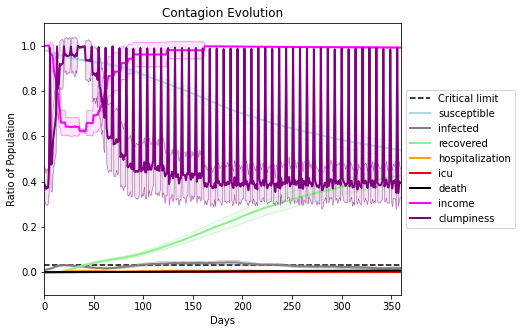

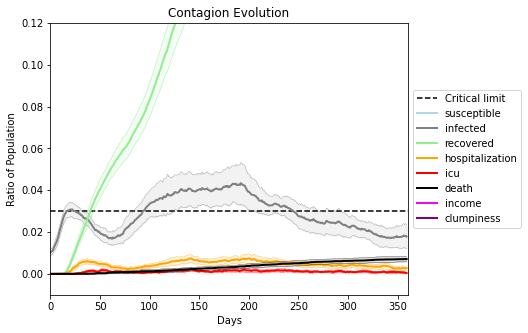

In [5]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.999
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7669, 9799, 5484, 2472, 6804, 845, 3287, 1838, 9157, 8477, 257, 7392, 3966, 3188, 9164, 8664, 9569, 9529, 4753, 1495]
Average similarity between family members is 0.9737466338065026 at temperature -0.998
Average similarity between family and home is 0.9998540132473606 at temperature -1
Average similarity between students and their classroom is 0.758259557348938 at temperature -0.998
Average classroom occupancy is 4.594202898550725 and number classrooms is 69
Average similarity between workers is 0.9490104948328888 at temperature -0.998
Average office occupancy is 3.52 and number offices is 175
Average friend similarity for adults: 0.8486605505886718 for kids: 0.7375058665403808
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousB

avg restaurant similarity 0.5676816323149522
avg restaurant similarity 0.6231296850292187
avg restaurant similarity 0.5555346067235174
avg restaurant similarity 0.6416249950452392
avg restaurant similarity 0.6620651514300163
avg restaurant similarity 0.7040715682580354
avg restaurant similarity 0.48885894190310175
avg restaurant similarity 0.6662415998771616
avg restaurant similarity 0.46069972320045766
avg restaurant similarity 0.536966490637418
avg restaurant similarity 0.5607047863918886
avg restaurant similarity 0.8348929243333649
avg restaurant similarity 0.6878733838439808
avg restaurant similarity 0.8634406066283323
avg restaurant similarity 0.6122412475223282
avg restaurant similarity 0.8673262414135865
avg restaurant similarity 0.5387770350705464
avg restaurant similarity 0.6647757195785688
avg restaurant similarity 0.5211109360723468
avg restaurant similarity 0.628757376761849
avg restaurant similarity 0.6376405063046908
avg restaurant similarity 0.9017847892914886
avg restau

avg restaurant similarity 0.4443772911955881
avg restaurant similarity 0.42055217497258984
avg restaurant similarity 0.5800436759317117
avg restaurant similarity 0.562275133512367
avg restaurant similarity 0.5768725298242929
avg restaurant similarity 0.6027303188279298
avg restaurant similarity 0.7645667207967031
avg restaurant similarity 0.5087534721393214
avg restaurant similarity 0.4827016584729661
avg restaurant similarity 0.6716256240249926
avg restaurant similarity 0.47130436967786893
avg restaurant similarity 0.6310182748212592
avg restaurant similarity 0.6081626045823736
avg restaurant similarity 0.9996597891827261
avg restaurant similarity 0.5973050099376147
avg restaurant similarity 0.5529063137643845
avg restaurant similarity 0.5453118858018409
avg restaurant similarity 0.6336920715812668
avg restaurant similarity 0.511247438525937
avg restaurant similarity 0.4673064725465362
avg restaurant similarity 0.559494226295147
avg restaurant similarity 0.5839748734265136
avg restaur

avg restaurant similarity 0.6534265782398206
avg restaurant similarity 0.5614142350389022
avg restaurant similarity 0.8163566079148546
avg restaurant similarity 0.6871156460517456
avg restaurant similarity 0.7425491978000747
avg restaurant similarity 0.6422197239499856
avg restaurant similarity 0.37793830085123953
avg restaurant similarity 0.745197211089789
avg restaurant similarity 0.8106459232135076
avg restaurant similarity 0.5965317312238051
avg restaurant similarity 0.5578681657360485
avg restaurant similarity 0.808496414635012
avg restaurant similarity 0.7161527865824515
avg restaurant similarity 0.5147177274473256
avg restaurant similarity 0.7607464823684216
avg restaurant similarity 0.8640038738286457
avg restaurant similarity 0.578460616756786
avg restaurant similarity 0.6066679595096935
avg restaurant similarity 0.6296771670988076
avg restaurant similarity 0.70619887685539
avg restaurant similarity 0.5856685891295561
avg restaurant similarity 0.5534072833371042
avg restaurant

avg restaurant similarity 0.5528849422872165
avg restaurant similarity 0.5595401162417482
avg restaurant similarity 0.6774722518902755
avg restaurant similarity 0.5659554162602557
avg restaurant similarity 0.49983236183109836
avg restaurant similarity 0.7216324434077853
avg restaurant similarity 0.8000625134333884
avg restaurant similarity 0.6392533192119149
avg restaurant similarity 0.633348622623129
avg restaurant similarity 0.6320879005326074
avg restaurant similarity 0.6415211000197013
avg restaurant similarity 0.42023102593758604
avg restaurant similarity 0.6645066002124271
avg restaurant similarity 0.7417755530363848
avg restaurant similarity 0.5173244903268547
avg restaurant similarity 0.5168556821932192
avg restaurant similarity 0.7198930298283944
avg restaurant similarity 0.7272994196546616
avg restaurant similarity 0.8344242545154974
avg restaurant similarity 0.5015308783079676
avg restaurant similarity 0.6025453037885801
avg restaurant similarity 0.6001670381248188
avg resta

avg restaurant similarity 0.48887046135080436
avg restaurant similarity 0.43199906268185967
avg restaurant similarity 0.5683531849795328
avg restaurant similarity 0.6094653019129297
avg restaurant similarity 0.3109850879177746
avg restaurant similarity 0.4217367400941452
avg restaurant similarity 0.5947935713258372
avg restaurant similarity 0.6161810759312362
avg restaurant similarity 0.5340489336413803
avg restaurant similarity 0.5136486646718657
avg restaurant similarity 0.4239867575161234
avg restaurant similarity 0.4698352253430718
avg restaurant similarity 0.5401489201416716
avg restaurant similarity 0.28025684593781
avg restaurant similarity 0.3857235482071636
avg restaurant similarity 0.2772140068517369
avg restaurant similarity 0.34226751159416746
avg restaurant similarity 0.4658097032117652
avg restaurant similarity 0.5329534476357756
avg restaurant similarity 0.6796701424944731
avg restaurant similarity 0.7834340019421051
avg restaurant similarity 0.5723494462145398
avg resta

avg restaurant similarity 0.6289492044831995
avg restaurant similarity 0.3902332923695498
avg restaurant similarity 0.9998095044059017
avg restaurant similarity 0.833542876982101
avg restaurant similarity 0.4524016027696731
avg restaurant similarity 0.4277694056311945
avg restaurant similarity 0.553962408358927
avg restaurant similarity 0.532850825718843
avg restaurant similarity 0.6240394460878893
avg restaurant similarity 0.6865939483133792
avg restaurant similarity 0.5160869042965387
avg restaurant similarity 0.6878335797492899
avg restaurant similarity 0.46434576361263513
avg restaurant similarity 0.8918730606949711
avg restaurant similarity 0.5080748304750263
avg restaurant similarity 0.614404459866337
avg restaurant similarity 0.4999723496872913
avg restaurant similarity 0.4849044766568037
avg restaurant similarity 0.4658097032117652
avg restaurant similarity 0.4760002564231207
avg restaurant similarity 0.4373477193086915
avg restaurant similarity 0.39381054934138304
avg restaura

avg restaurant similarity 0.6266495788174313
avg restaurant similarity 0.7711827983148938
avg restaurant similarity 0.7747083644954861
avg restaurant similarity 0.6139146168584962
avg restaurant similarity 0.6021673396832842
avg restaurant similarity 0.5896852587844157
avg restaurant similarity 0.5708538416282462
avg restaurant similarity 0.6001245440848683
avg restaurant similarity 0.7540061840313569
avg restaurant similarity 0.5348938425544968
avg restaurant similarity 0.8754223189132913
avg restaurant similarity 0.508662731539224
avg restaurant similarity 0.6673940139952217
avg restaurant similarity 0.5827205634199271
avg restaurant similarity 0.913212707174424
avg restaurant similarity 0.6957722545676247
avg restaurant similarity 0.6931649012992955
avg restaurant similarity 0.7213285337950839
avg restaurant similarity 0.7446161907861456
avg restaurant similarity 0.6475094849768159
avg restaurant similarity 0.6864002245478016
avg restaurant similarity 0.6499398157226536
avg restaura

avg restaurant similarity 0.6187747643493328
avg restaurant similarity 0.5112788712412095
avg restaurant similarity 0.864050085477124
avg restaurant similarity 0.699645702973835
avg restaurant similarity 0.6395661109467331
avg restaurant similarity 0.5413545857053722
avg restaurant similarity 0.4606290628093032
avg restaurant similarity 0.7089811313013963
avg restaurant similarity 0.7055708929946033
avg restaurant similarity 0.6696093273843619
avg restaurant similarity 0.5943716297370165
avg restaurant similarity 0.5879047536251395
avg restaurant similarity 0.6693795372146157
avg restaurant similarity 0.43031738663548774
avg restaurant similarity 0.5324786237511462
avg restaurant similarity 0.5090957091197412
avg restaurant similarity 0.6360822529292721
avg restaurant similarity 0.7613193920772959
avg restaurant similarity 0.6247185007188839
avg restaurant similarity 0.5840540014350535
avg restaurant similarity 0.5969431655168111
avg restaurant similarity 0.4376387552340045
avg restaur

avg restaurant similarity 0.8368916813718551
avg restaurant similarity 0.7995035864598791
avg restaurant similarity 0.6306217349867905
avg restaurant similarity 0.6806373896992064
avg restaurant similarity 0.7842301095521328
avg restaurant similarity 0.8339516666909592
avg restaurant similarity 0.5984647524653924
avg restaurant similarity 0.7489307224242034
avg restaurant similarity 0.7754519778657132
avg restaurant similarity 0.8054071575324439
avg restaurant similarity 0.763419070738177
avg restaurant similarity 0.8463228428547178
avg restaurant similarity 0.7158207832001087
avg restaurant similarity 0.7858344911134835
avg restaurant similarity 0.6681891093566757
avg restaurant similarity 0.8037153854995667
avg restaurant similarity 0.7006901999231386
avg restaurant similarity 0.7235653657246296
avg restaurant similarity 0.734002692582445
avg restaurant similarity 0.7282957030115432
avg restaurant similarity 0.6639124178632815
avg restaurant similarity 0.7302988227290207
avg restaura

avg restaurant similarity 0.6451647704376595
avg restaurant similarity 0.7484910239769299
avg restaurant similarity 0.6362028551032285
avg restaurant similarity 0.679572936007847
avg restaurant similarity 0.7049815464589887
avg restaurant similarity 0.7518834818732012
avg restaurant similarity 0.782619786254773
avg restaurant similarity 0.819880428305553
avg restaurant similarity 0.7023541252527113
avg restaurant similarity 0.8790371127321048
avg restaurant similarity 0.8095936301491932
avg restaurant similarity 0.6403467358129663
avg restaurant similarity 0.6373380125011355
avg restaurant similarity 0.8344134654509237
avg restaurant similarity 0.5745190885821287
avg restaurant similarity 0.7189398552448982
avg restaurant similarity 0.8667224272896696
avg restaurant similarity 0.8187763754927865
avg restaurant similarity 0.6560667663043406
avg restaurant similarity 0.7035826205333436
avg restaurant similarity 0.6836982841339374
avg restaurant similarity 0.816449935454045
avg restaurant

avg restaurant similarity 0.5797759446922888
avg restaurant similarity 0.6796169815516827
avg restaurant similarity 0.5510952334237951
avg restaurant similarity 0.7221542696028336
avg restaurant similarity 0.7208056002719476
avg restaurant similarity 0.512327539413713
avg restaurant similarity 0.7273812416427883
avg restaurant similarity 0.5969562724578332
avg restaurant similarity 0.8453481694385399
avg restaurant similarity 0.6557688796997214
avg restaurant similarity 0.62907637547882
avg restaurant similarity 0.5339879965509926
avg restaurant similarity 0.7254310196771523
avg restaurant similarity 0.612754630454456
avg restaurant similarity 0.6282330555260739
avg restaurant similarity 0.5592274393121311
avg restaurant similarity 0.7821349953717217
avg restaurant similarity 0.8401833770068194
avg restaurant similarity 0.6757435501332678
avg restaurant similarity 0.6700945422431689
avg restaurant similarity 0.5196635401103378
avg restaurant similarity 0.8764174760857883
avg restaurant

avg restaurant similarity 0.5274054487213727
avg restaurant similarity 0.7032011890181108
avg restaurant similarity 0.7744495386885296
avg restaurant similarity 0.7193207405463677
avg restaurant similarity 0.7563292866286133
avg restaurant similarity 0.6141804777256028
avg restaurant similarity 0.7412505053847014
avg restaurant similarity 0.6642103554059771
avg restaurant similarity 0.7145333098336595
avg restaurant similarity 0.5565773357465904
avg restaurant similarity 0.8104643591072177
avg restaurant similarity 0.6569644906356475
avg restaurant similarity 0.7000049302841918
avg restaurant similarity 0.45392197299665094
avg restaurant similarity 0.5693952644455607
avg restaurant similarity 0.7283362686376214
avg restaurant similarity 0.7367599629479876
avg restaurant similarity 0.67921929331445
avg restaurant similarity 0.5236532447654638
avg restaurant similarity 0.6983289552749233
avg restaurant similarity 0.45443945012110376
avg restaurant similarity 0.5687936870355749
avg restau

avg restaurant similarity 0.7050593257986839
avg restaurant similarity 0.8283929007818666
avg restaurant similarity 0.688581359561197
avg restaurant similarity 0.6210828945728396
avg restaurant similarity 0.6123761398373977
avg restaurant similarity 0.5458833418440701
avg restaurant similarity 0.6173041225211495
avg restaurant similarity 0.47077620182714686
avg restaurant similarity 0.5581403730202589
avg restaurant similarity 0.8575084692596082
avg restaurant similarity 0.5130336331720543
avg restaurant similarity 0.5102873531100116
avg restaurant similarity 0.4916692945839004
avg restaurant similarity 0.8122157957801657
avg restaurant similarity 0.6508906485083035
avg restaurant similarity 0.5352633500554719
avg restaurant similarity 0.659822037187483
avg restaurant similarity 0.5009821671828886
avg restaurant similarity 0.5038353483293746
avg restaurant similarity 0.606837389141375
avg restaurant similarity 0.6072298433465868
avg restaurant similarity 0.5659417768663441
avg restaura

avg restaurant similarity 0.4681421843677465
avg restaurant similarity 0.5464512973814166
avg restaurant similarity 0.5299796628615835
avg restaurant similarity 0.5770834921685855
avg restaurant similarity 0.5650227189985614
avg restaurant similarity 0.626068865062292
avg restaurant similarity 0.4806379656466525
avg restaurant similarity 0.6265645930959807
avg restaurant similarity 0.5847005241171535
avg restaurant similarity 0.5647861687737338
avg restaurant similarity 0.663495146249452
avg restaurant similarity 0.5820717332038617
avg restaurant similarity 0.3852206490253182
avg restaurant similarity 0.7992619270533732
avg restaurant similarity 0.6568731567038166
avg restaurant similarity 0.49884267528578874
avg restaurant similarity 0.9186443771742442
avg restaurant similarity 0.7334152233021839
avg restaurant similarity 0.5800149216722887
avg restaurant similarity 0.607965108702126
avg restaurant similarity 0.5510080542486602
avg restaurant similarity 0.6026273396250166
avg restaura

avg restaurant similarity 0.6282706507471192
avg restaurant similarity 0.6980129225653584
avg restaurant similarity 0.7162903294930767
avg restaurant similarity 0.4822776665677424
avg restaurant similarity 0.4702685372975803
avg restaurant similarity 0.7912990940931979
avg restaurant similarity 0.6210079004545462
avg restaurant similarity 0.5601187941218833
avg restaurant similarity 0.5928615721379747
avg restaurant similarity 0.6384319187652113
avg restaurant similarity 0.6062496938714208
avg restaurant similarity 0.7592591162558042
avg restaurant similarity 0.6954029291926909
avg restaurant similarity 0.6055226606045876
avg restaurant similarity 0.5568310730429981
avg restaurant similarity 0.5916796344169523
avg restaurant similarity 0.49986694224311284
avg restaurant similarity 0.9996385610626035
avg restaurant similarity 0.6733991643353782
avg restaurant similarity 0.41255057513808807
avg restaurant similarity 0.6123297375243304
avg restaurant similarity 0.6942318186406942
avg rest

avg restaurant similarity 0.5099624733997171
avg restaurant similarity 0.6856759513920461
avg restaurant similarity 0.6048450096457253
avg restaurant similarity 0.8124099318626135
avg restaurant similarity 0.6269121266986609
avg restaurant similarity 0.5037843315571785
avg restaurant similarity 0.706830492171696
avg restaurant similarity 0.6949015401900874
avg restaurant similarity 0.8020589519223192
avg restaurant similarity 0.7508702277421153
avg restaurant similarity 0.5642571287994546
avg restaurant similarity 0.6035723563458757
avg restaurant similarity 0.6724676619763327
avg restaurant similarity 0.6337390691222062
avg restaurant similarity 0.7962333743188097
avg restaurant similarity 0.7185420363632904
avg restaurant similarity 0.6231908836651874
avg restaurant similarity 0.5605919757413544
avg restaurant similarity 0.5888730113981279
avg restaurant similarity 0.7478031202123767
avg restaurant similarity 0.7117253739448817
avg restaurant similarity 0.8443457388831428
avg restaur

avg restaurant similarity 0.5636255087680865
avg restaurant similarity 0.4144193073739776
avg restaurant similarity 0.5381868626677978
avg restaurant similarity 0.4309310338257369
avg restaurant similarity 0.5362599315626616
avg restaurant similarity 0.5904443324696466
avg restaurant similarity 0.5972679825965758
avg restaurant similarity 0.4844530140621973
avg restaurant similarity 0.49707161720569576
avg restaurant similarity 0.4675373566147641
avg restaurant similarity 0.4957556245989708
avg restaurant similarity 0.5676016957235827
avg restaurant similarity 0.5072905098540074
avg restaurant similarity 0.9004349932057679
avg restaurant similarity 0.6395909786201716
avg restaurant similarity 0.32389668922844184
avg restaurant similarity 0.6918582415393265
avg restaurant similarity 0.4918958524116842
avg restaurant similarity 0.6536313713621046
avg restaurant similarity 0.6495847921733994
avg restaurant similarity 0.4227690853591241
avg restaurant similarity 0.24309174567290934
avg res

avg restaurant similarity 0.5068076699589047
avg restaurant similarity 0.4371933869172378
avg restaurant similarity 0.6652884542172375
avg restaurant similarity 0.5856549051488298
avg restaurant similarity 0.4063225801036868
avg restaurant similarity 0.606983415478296
avg restaurant similarity 0.5367475925832182
avg restaurant similarity 0.5078617898758392
avg restaurant similarity 0.47985460971998695
avg restaurant similarity 0.39127253797195766
avg restaurant similarity 0.49680159724960704
avg restaurant similarity 0.6618908469710696
avg restaurant similarity 0.4031082693363319
avg restaurant similarity 0.6507089085820089
avg restaurant similarity 0.38203562247676554
avg restaurant similarity 0.3897971183370903
avg restaurant similarity 0.647822011097932
avg restaurant similarity 0.5495035756085651
avg restaurant similarity 0.5343125373524806
avg restaurant similarity 0.48237938673717695
avg restaurant similarity 0.6561678743220759
avg restaurant similarity 0.5857223489723944
avg res

avg restaurant similarity 0.6146201367869897
avg restaurant similarity 0.7350620278711306
avg restaurant similarity 0.6495663390612896
avg restaurant similarity 0.7578355993878433
avg restaurant similarity 0.8137334684382295
avg restaurant similarity 0.7667760265589907
avg restaurant similarity 0.8468129072085632
avg restaurant similarity 0.5910891188688268
avg restaurant similarity 0.7063353021359222
avg restaurant similarity 0.8126577533107262
avg restaurant similarity 0.7068261899408375
avg restaurant similarity 0.734265771563165
avg restaurant similarity 0.7822561772010355
avg restaurant similarity 0.49627912499355054
avg restaurant similarity 0.8121525045311366
avg restaurant similarity 0.5934435289178264
avg restaurant similarity 0.6678302591914322
avg restaurant similarity 0.7158189158706454
avg restaurant similarity 0.7608137545375642
avg restaurant similarity 0.7917761565003191
avg restaurant similarity 0.6484203882411513
avg restaurant similarity 0.742015804453692
avg restaur

avg restaurant similarity 0.7137666783216483
avg restaurant similarity 0.48087011825782155
avg restaurant similarity 0.7416123693501661
avg restaurant similarity 0.8742313882628221
avg restaurant similarity 0.8844573277894021
avg restaurant similarity 0.8455878240139568
avg restaurant similarity 0.8632315209202474
avg restaurant similarity 0.548605485712333
avg restaurant similarity 0.5853784510458129
avg restaurant similarity 0.6109479961144345
avg restaurant similarity 0.5882366714116145
avg restaurant similarity 0.7413736771458974
avg restaurant similarity 0.7694864470041565
avg restaurant similarity 0.8443776867405252
avg restaurant similarity 0.6539957170683081
avg restaurant similarity 0.7760236180516792
avg restaurant similarity 0.8015799401151849
avg restaurant similarity 0.7324977053595454
avg restaurant similarity 0.7015376410522521
avg restaurant similarity 0.6313308903146211
avg restaurant similarity 0.7682032071647513
avg restaurant similarity 0.8761292057965884
avg restau

avg restaurant similarity 0.7580935722715179
avg restaurant similarity 0.6425114445455377
avg restaurant similarity 0.7272634248174307
avg restaurant similarity 0.722906046556669
avg restaurant similarity 0.5463155398478297
avg restaurant similarity 0.6678150589648923
avg restaurant similarity 0.7128248436594364
avg restaurant similarity 0.9998269956458217
avg restaurant similarity 0.6998774309945274
avg restaurant similarity 0.6694538369669317
avg restaurant similarity 0.7364236853201307
avg restaurant similarity 0.7733507778899444
avg restaurant similarity 0.6820479782879905
avg restaurant similarity 0.701113709372996
avg restaurant similarity 0.599971630902474
avg restaurant similarity 0.7924997939657032
avg restaurant similarity 0.7353372683533883
avg restaurant similarity 0.7766637310441057
avg restaurant similarity 0.669509353004847
avg restaurant similarity 0.6500047829026971
avg restaurant similarity 0.6511760106915567
avg restaurant similarity 0.6199821323590418
avg restaurant

avg restaurant similarity 0.6938659841323824
avg restaurant similarity 0.7491907995205193
avg restaurant similarity 0.6594543114751413
avg restaurant similarity 0.8076304695727451
avg restaurant similarity 0.8216730425643802
avg restaurant similarity 0.7561116373216212
avg restaurant similarity 0.7200045731515579
avg restaurant similarity 0.7722349218204211
avg restaurant similarity 0.6962569922600588
avg restaurant similarity 0.8685206315678475
avg restaurant similarity 0.6470177782994125
avg restaurant similarity 0.7933028600817454
avg restaurant similarity 0.7542737406364789
avg restaurant similarity 0.6357083049879118
avg restaurant similarity 0.7903457459794795
avg restaurant similarity 0.6872526243815403
avg restaurant similarity 0.6693523108978643
avg restaurant similarity 0.4902024760644755
avg restaurant similarity 0.6674894603204633
avg restaurant similarity 0.676299489636574
avg restaurant similarity 0.7058818063978792
avg restaurant similarity 0.7293851248319042
avg restaur

avg restaurant similarity 0.8644019419624027
avg restaurant similarity 0.6549492603968686
avg restaurant similarity 0.7539448146611825
avg restaurant similarity 0.7686877988970323
avg restaurant similarity 0.6316364567970074
avg restaurant similarity 0.6742993803607579
avg restaurant similarity 0.665286357774053
avg restaurant similarity 0.649544899438359
avg restaurant similarity 0.7099590875242513
avg restaurant similarity 0.6099098098590027
avg restaurant similarity 0.6979289652848657
avg restaurant similarity 0.5321793362664502
avg restaurant similarity 0.8361677370252498
avg restaurant similarity 0.7283163128669191
avg restaurant similarity 0.6794595667914346
avg restaurant similarity 0.6242924426358515
avg restaurant similarity 0.6938259499962763
avg restaurant similarity 0.7390498789013278
avg restaurant similarity 0.6181678308998959
avg restaurant similarity 0.5289350467993192
avg restaurant similarity 0.6640535289496557
avg restaurant similarity 0.6907939396448315
avg restaura

avg restaurant similarity 0.6129131306699618
avg restaurant similarity 0.5725546707681277
avg restaurant similarity 0.5392235155286342
avg restaurant similarity 0.6075260377001156
avg restaurant similarity 0.6440533649737891
avg restaurant similarity 0.606020980209915
avg restaurant similarity 0.6588330803424511
avg restaurant similarity 0.6269580545357476
avg restaurant similarity 0.6584561974939609
avg restaurant similarity 0.727447777887602
avg restaurant similarity 0.602369551563634
avg restaurant similarity 0.6303582437359537
avg restaurant similarity 0.691158480584823
avg restaurant similarity 0.6623823155995732
avg restaurant similarity 0.6301658424967332
avg restaurant similarity 0.6772825389310387
avg restaurant similarity 0.6494364215849853
avg restaurant similarity 0.67886057830081
avg restaurant similarity 0.8161100303112544
avg restaurant similarity 0.7114862042633997
avg restaurant similarity 0.6140766689782859
avg restaurant similarity 0.5993274522487746
avg restaurant s

avg restaurant similarity 0.5678594992388971
avg restaurant similarity 0.5960276247052403
avg restaurant similarity 0.6547920893126803
avg restaurant similarity 0.6838689023885923
avg restaurant similarity 0.5353665433184754
avg restaurant similarity 0.6060273349590617
avg restaurant similarity 0.596384505010482
avg restaurant similarity 0.6160691816331739
avg restaurant similarity 0.6430725579194475
avg restaurant similarity 0.7099617889182338
avg restaurant similarity 0.6211272618704333
avg restaurant similarity 0.5658665276114707
avg restaurant similarity 0.7586116624921091
avg restaurant similarity 0.6884362546340967
avg restaurant similarity 0.5701418514535006
avg restaurant similarity 0.8801936797160475
avg restaurant similarity 0.5551172298911666
avg restaurant similarity 0.6617878575811456
avg restaurant similarity 0.5132706740309827
avg restaurant similarity 0.4855965665268583
avg restaurant similarity 0.49975871320512777
avg restaurant similarity 0.5853203395602424
avg restau

avg restaurant similarity 0.5993136269331953
avg restaurant similarity 0.7491376609612808
avg restaurant similarity 0.6532118907172035
avg restaurant similarity 0.5558039415397512
avg restaurant similarity 0.7040589733555529
avg restaurant similarity 0.6067583235049752
avg restaurant similarity 0.5689831933584701
avg restaurant similarity 0.6863179919811042
avg restaurant similarity 0.7050836375266984
avg restaurant similarity 0.5126382841026065
avg restaurant similarity 0.5663828962737545
avg restaurant similarity 0.6205640045779928
avg restaurant similarity 0.5180631653193967
avg restaurant similarity 0.47162134541335743
avg restaurant similarity 0.5157505001544924
avg restaurant similarity 0.8641346253875765
avg restaurant similarity 0.8283367667532092
avg restaurant similarity 0.6886334406109923
avg restaurant similarity 0.7242879278758144
avg restaurant similarity 0.6256089308514503
avg restaurant similarity 0.5694487410350333
avg restaurant similarity 0.7076850531624709
avg resta

avg restaurant similarity 0.5578303360935882
avg restaurant similarity 0.569197697274868
avg restaurant similarity 0.4289142453104834
avg restaurant similarity 0.53583629353397
avg restaurant similarity 0.49595765689741883
avg restaurant similarity 0.6573755032423694
avg restaurant similarity 0.6580325031586856
avg restaurant similarity 0.5256295640924153
avg restaurant similarity 0.7048396568817656
avg restaurant similarity 0.6463385506926367
avg restaurant similarity 0.5551247222127962
avg restaurant similarity 0.5658638294386099
avg restaurant similarity 0.7280744681300975
avg restaurant similarity 0.7190887748447001
avg restaurant similarity 0.6537942820190195
avg restaurant similarity 0.5513207073117663
avg restaurant similarity 0.5427354973712144
avg restaurant similarity 0.5488627402695494
avg restaurant similarity 0.6817794519149204
avg restaurant similarity 0.4807187627736427
avg restaurant similarity 0.6109263962497187
avg restaurant similarity 0.6086212808950157
avg restaura

avg restaurant similarity 0.8751722489843686
avg restaurant similarity 0.7690619706715942
avg restaurant similarity 0.5424574892269024
avg restaurant similarity 0.7660187424236565
avg restaurant similarity 0.5331594378757226
avg restaurant similarity 0.5883436479446689
avg restaurant similarity 0.6380670589588323
avg restaurant similarity 0.5035586468335862
avg restaurant similarity 0.8009012141242831
avg restaurant similarity 0.747738466314048
avg restaurant similarity 0.6615878726658067
avg restaurant similarity 0.6294437314490401
avg restaurant similarity 0.5659215735978599
avg restaurant similarity 0.5205375711874566
avg restaurant similarity 0.6017297009763718
avg restaurant similarity 0.5888474494862537
avg restaurant similarity 0.5134340765309824
avg restaurant similarity 0.6051312843839253
avg restaurant similarity 0.730401108152336
avg restaurant similarity 0.4700448305522751
avg restaurant similarity 0.516691405437774
avg restaurant similarity 0.6484823588502625
avg restauran

avg restaurant similarity 0.6910946613488917
avg restaurant similarity 0.6742455582390812
avg restaurant similarity 0.783387795926425
avg restaurant similarity 0.6644329295217654
avg restaurant similarity 0.6722534272633678
avg restaurant similarity 0.7719617537588414
avg restaurant similarity 0.703806466417876
avg restaurant similarity 0.574276304442181
avg restaurant similarity 0.6463185692175929
avg restaurant similarity 0.6838984771938945
avg restaurant similarity 0.518013060405969
avg restaurant similarity 0.5944992486652839
avg restaurant similarity 0.5632984522935982
avg restaurant similarity 0.7218670383581967
avg restaurant similarity 0.7560000578612635
avg restaurant similarity 0.7926871924150684
avg restaurant similarity 0.5982009194004954
avg restaurant similarity 0.6858897005283323
avg restaurant similarity 0.8485429093063371
avg restaurant similarity 0.7949984791303135
avg restaurant similarity 0.5740042240168323
avg restaurant similarity 0.7775637364394022
avg restaurant

avg restaurant similarity 0.29360435430660387
avg restaurant similarity 0.5732415235964435
avg restaurant similarity 0.6012634441581719
avg restaurant similarity 0.6125334627141258
avg restaurant similarity 0.5083424907384989
avg restaurant similarity 0.6884993558524019
avg restaurant similarity 0.7695617818505505
avg restaurant similarity 0.9465734874857926
avg restaurant similarity 0.5867722850348238
avg restaurant similarity 0.6988221065008303
avg restaurant similarity 0.8553416580650299
avg restaurant similarity 0.5718497014126889
avg restaurant similarity 0.7152241354830107
avg restaurant similarity 0.5145964866094952
avg restaurant similarity 0.35176654611183855
avg restaurant similarity 0.6386595274984108
avg restaurant similarity 0.7510718787126339
avg restaurant similarity 0.8163041917079503
avg restaurant similarity 0.37563475377105005
avg restaurant similarity 0.4642738176805823
avg restaurant similarity 0.829354665660884
avg restaurant similarity 0.7264933970440126
avg rest

avg restaurant similarity 0.5604484190958214
avg restaurant similarity 0.7691517119779573
avg restaurant similarity 0.6722235039782964
avg restaurant similarity 0.6778506981783043
avg restaurant similarity 0.6875463509550256
avg restaurant similarity 0.7657261333717199
avg restaurant similarity 0.8049955685762117
avg restaurant similarity 0.6949433600275087
avg restaurant similarity 0.7075444758084333
avg restaurant similarity 0.7661674635399655
avg restaurant similarity 0.7394683441593493
avg restaurant similarity 0.6519094631072838
avg restaurant similarity 0.708186995938898
avg restaurant similarity 0.5445994372008741
avg restaurant similarity 0.8301543159238729
avg restaurant similarity 0.7449765800497182
avg restaurant similarity 0.7250743794062154
avg restaurant similarity 0.6756641511667036
avg restaurant similarity 0.6063614766622055
avg restaurant similarity 0.4805136408950232
avg restaurant similarity 0.8138809536756311
avg restaurant similarity 0.7257330038409355
avg restaur

avg restaurant similarity 0.69136175395612
avg restaurant similarity 0.667372061396167
avg restaurant similarity 0.5434729711276565
avg restaurant similarity 0.6443120500493251
avg restaurant similarity 0.8096970370118833
avg restaurant similarity 0.7717206731787473
avg restaurant similarity 0.8106603204167964
avg restaurant similarity 0.7434450000143151
avg restaurant similarity 0.723085220949936
avg restaurant similarity 0.6017076543014349
avg restaurant similarity 0.740784727268151
avg restaurant similarity 0.7096418782326891
avg restaurant similarity 0.7107276133288031
avg restaurant similarity 0.6999738084134804
avg restaurant similarity 0.7585124524558887
avg restaurant similarity 0.6679250167676943
avg restaurant similarity 0.7347788555543938
avg restaurant similarity 0.6037458931923021
avg restaurant similarity 0.6824548584209544
avg restaurant similarity 0.7290004644338075
avg restaurant similarity 0.7843454707376343
avg restaurant similarity 0.5498158262805493
avg restaurant 

avg restaurant similarity 0.5986220782271204
avg restaurant similarity 0.476379048112817
avg restaurant similarity 0.6797930346938499
avg restaurant similarity 0.7006895191062397
avg restaurant similarity 0.6997648784054872
avg restaurant similarity 0.7112936119334398
avg restaurant similarity 0.662440135248739
avg restaurant similarity 0.7942164438585579
avg restaurant similarity 0.6596424069842366
avg restaurant similarity 0.5855848261239518
avg restaurant similarity 0.7399971296977021
avg restaurant similarity 0.5899787025361005
avg restaurant similarity 0.6325326323770766
avg restaurant similarity 0.5628281675893688
avg restaurant similarity 0.5661374422383598
avg restaurant similarity 0.7517649952916338
avg restaurant similarity 0.624881254061726
avg restaurant similarity 0.5842352422510136
avg restaurant similarity 0.7266222352082198
avg restaurant similarity 0.7338013936775529
avg restaurant similarity 0.9299863677257078
avg restaurant similarity 0.7358623873788733
avg restauran

avg restaurant similarity 0.609158625392768
avg restaurant similarity 0.7019671253725405
avg restaurant similarity 0.6839595358362257
avg restaurant similarity 0.6894714259007965
avg restaurant similarity 0.8067324928851004
avg restaurant similarity 0.5301357835177812
avg restaurant similarity 0.6566450565655232
avg restaurant similarity 0.6698343032353571
avg restaurant similarity 0.6388849869739751
avg restaurant similarity 0.5695831476231713
avg restaurant similarity 0.6894267162740412
avg restaurant similarity 0.6468822974737184
avg restaurant similarity 0.6432885266681294
avg restaurant similarity 0.6645386009402724
avg restaurant similarity 0.7085041196108433
avg restaurant similarity 0.6715603021676354
avg restaurant similarity 0.6694278475169942
avg restaurant similarity 0.5381868187191032
avg restaurant similarity 0.5666364433439242
avg restaurant similarity 0.5972154070142163
avg restaurant similarity 0.6023840176765597
avg restaurant similarity 0.7213918129347452
avg restaur

avg restaurant similarity 0.7070819357060105
avg restaurant similarity 0.7243733464060578
avg restaurant similarity 0.6332598452579626
avg restaurant similarity 0.6838506019845594
avg restaurant similarity 0.7148531124871406
avg restaurant similarity 0.7351533906195779
avg restaurant similarity 0.6927680678032121
avg restaurant similarity 0.6512083968423857
avg restaurant similarity 0.7029226868016865
avg restaurant similarity 0.7054881237528826
avg restaurant similarity 0.7328207485198326
avg restaurant similarity 0.7268236034957734
avg restaurant similarity 0.5882816885122825
avg restaurant similarity 0.624969013172397
avg restaurant similarity 0.7204338428077778
avg restaurant similarity 0.5460937404002191
avg restaurant similarity 0.6089723755446413
avg restaurant similarity 0.6218567210861864
avg restaurant similarity 0.7509953958381496
avg restaurant similarity 0.6210005866098313
avg restaurant similarity 0.7979219469027035
avg restaurant similarity 0.7696450241448862
avg restaur

avg restaurant similarity 0.7408219943182259
avg restaurant similarity 0.796153748423682
avg restaurant similarity 0.58507574729904
avg restaurant similarity 0.8177524899069736
avg restaurant similarity 0.6512425561321444
avg restaurant similarity 0.5579001193287577
avg restaurant similarity 0.7032185354879872
avg restaurant similarity 0.7747885649195465
avg restaurant similarity 0.5787580921841033
avg restaurant similarity 0.6601178568722371
avg restaurant similarity 0.6769298476441542
avg restaurant similarity 0.6297652781813224
avg restaurant similarity 0.656618305735338
avg restaurant similarity 0.8117402137219475
avg restaurant similarity 0.7503178986968098
avg restaurant similarity 0.5343389540399717
avg restaurant similarity 0.7882403398263361
avg restaurant similarity 0.7250334315035015
avg restaurant similarity 0.7448672874751966
avg restaurant similarity 0.7602405911427724
avg restaurant similarity 0.8766397647392683
avg restaurant similarity 0.7487935047491296
avg restaurant

avg restaurant similarity 0.6656951069470012
avg restaurant similarity 0.9704779205659072
avg restaurant similarity 0.3587877781822734
avg restaurant similarity 0.6581880541176813
avg restaurant similarity 0.6586141772896055
avg restaurant similarity 0.5344231614473994
avg restaurant similarity 0.6505425356624716
avg restaurant similarity 0.518011102943214
avg restaurant similarity 0.5642403642437794
avg restaurant similarity 0.7423032656895956
avg restaurant similarity 0.612989149053922
avg restaurant similarity 0.46231947899789505
avg restaurant similarity 0.6552692077223067
avg restaurant similarity 0.9998836867932499
avg restaurant similarity 0.7620021578699142
avg restaurant similarity 0.5487761304084872
avg restaurant similarity 0.567457826483899
avg restaurant similarity 0.5382135829281159
avg restaurant similarity 0.4074382504203813
avg restaurant similarity 0.950503421387752
avg restaurant similarity 0.6256153502217239
avg restaurant similarity 0.2757469205231775
avg restauran

avg restaurant similarity 0.6017616375345082
avg restaurant similarity 0.5187390008997385
avg restaurant similarity 0.7189407691934098
avg restaurant similarity 0.7093860925057299
avg restaurant similarity 0.8289279661368701
avg restaurant similarity 0.44211470630510785
avg restaurant similarity 0.6317913714715584
avg restaurant similarity 0.8336496755481315
avg restaurant similarity 0.7541648051653722
avg restaurant similarity 0.4687687042232166
avg restaurant similarity 0.565941883011905
avg restaurant similarity 0.6562092393970641
avg restaurant similarity 0.4198164553430244
avg restaurant similarity 0.4423151385587964
avg restaurant similarity 0.5137278986917551
avg restaurant similarity 0.6414391137434566
avg restaurant similarity 0.7318878662311301
avg restaurant similarity 0.3841304885706777
avg restaurant similarity 0.5370491206452566
avg restaurant similarity 0.8024179683631678
avg restaurant similarity 0.9009661059648352
avg restaurant similarity 0.5730309992089782
avg restau

avg restaurant similarity 0.7825628609145318
avg restaurant similarity 0.7503646532999327
avg restaurant similarity 0.6443535223360408
avg restaurant similarity 0.7375932854207313
avg restaurant similarity 0.6758771792900511
avg restaurant similarity 0.9097160543279058
avg restaurant similarity 0.8190843452013061
avg restaurant similarity 0.7412246917474175
avg restaurant similarity 0.7775903036488481
avg restaurant similarity 0.4724290646922221
avg restaurant similarity 0.9462496510583321
avg restaurant similarity 0.6377707977616016
avg restaurant similarity 0.8116194235571562
avg restaurant similarity 0.6642465737477143
avg restaurant similarity 0.7231597588180172
avg restaurant similarity 0.8041468547725122
avg restaurant similarity 0.6608571996259278
avg restaurant similarity 0.7686472607280704
avg restaurant similarity 0.38106192623294427
avg restaurant similarity 0.705320187549896
avg restaurant similarity 0.8952238478568182
avg restaurant similarity 0.7577136897689442
avg restau

avg restaurant similarity 0.8457248583461403
avg restaurant similarity 0.8390847694796703
avg restaurant similarity 0.7255944749379625
avg restaurant similarity 0.7820754005610502
avg restaurant similarity 0.4871034172185781
avg restaurant similarity 0.8104481308077464
avg restaurant similarity 0.5828043359894752
avg restaurant similarity 0.9579861080352075
avg restaurant similarity 0.999788288464483
avg restaurant similarity 0.8682218835014746
avg restaurant similarity 0.7020551676466769
avg restaurant similarity 0.686421094695415
avg restaurant similarity 0.6007033973404774
avg restaurant similarity 0.8004010121585969
avg restaurant similarity 0.9290542042163562
avg restaurant similarity 0.7925208830860189
avg restaurant similarity 0.7478181128704483
avg restaurant similarity 0.7927385647544225
avg restaurant similarity 0.7533211130936796
avg restaurant similarity 0.6364341015618497
avg restaurant similarity 0.40873329282549686
avg restaurant similarity 0.583207070676546
avg restaura

(<function dict.items>, <function dict.items>, <function dict.items>)

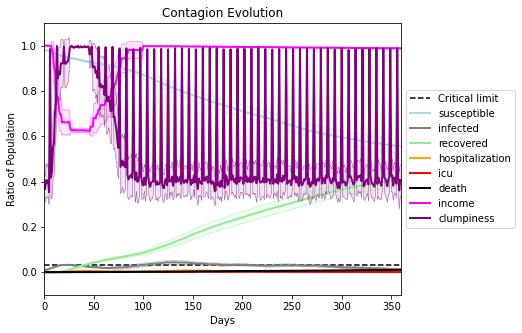

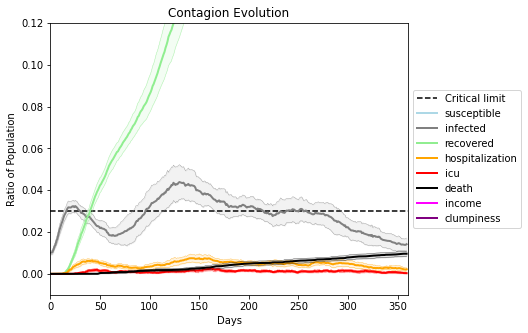

In [6]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.998
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2230, 9840, 3174, 7245, 3192, 5906, 2984, 3637, 5179, 5601, 1405, 1126, 3475, 329, 9356, 7034, 7497, 1255, 2305, 3661]
Average similarity between family members is 0.9553975239380263 at temperature -0.9975
Average similarity between family and home is 0.9998494184042551 at temperature -1
Average similarity between students and their classroom is 0.6872114040105717 at temperature -0.9975
Average classroom occupancy is 4.134328358208955 and number classrooms is 67
Average similarity between workers is 0.9328264069240154 at temperature -0.9975
Average office occupancy is 3.394871794871795 and number offices is 195
Average friend similarity for adults: 0.849204742150469 for kids: 0.6998391756170738
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.45801248745974893
avg restaurant similarity 0.6135559247461854
avg restaurant similarity 0.5754884364833185
avg restaurant similarity 0.6087002262876539
avg restaurant similarity 0.676150024612579
avg restaurant similarity 0.6029608965191074
avg restaurant similarity 0.5725522724761781
avg restaurant similarity 0.5782924706852256
avg restaurant similarity 0.5307078927918784
avg restaurant similarity 0.5503624518249609
avg restaurant similarity 0.5495924265287377
avg restaurant similarity 0.7964492168169547
avg restaurant similarity 0.6546837444637371
avg restaurant similarity 0.4755671356700088
avg restaurant similarity 0.7160004790110205
avg restaurant similarity 0.571077138429395
avg restaurant similarity 0.9071126349315918
avg restaurant similarity 0.6700869675455374
avg restaurant similarity 0.676158702228401
avg restaurant similarity 0.5045726372280082
avg restaurant similarity 0.5128625205301083
avg restaurant similarity 0.6158714845654533
avg restaura

avg restaurant similarity 0.5055710808593442
avg restaurant similarity 0.562170460424147
avg restaurant similarity 0.5971780609672869
avg restaurant similarity 0.5750518829098554
avg restaurant similarity 0.6902049232676462
avg restaurant similarity 0.5368752556607226
avg restaurant similarity 0.5684421080599285
avg restaurant similarity 0.900073749652526
avg restaurant similarity 0.6543573766549546
avg restaurant similarity 0.6249741127445122
avg restaurant similarity 0.5984188079502238
avg restaurant similarity 0.6101944570068681
avg restaurant similarity 0.7531157501705604
avg restaurant similarity 0.8955304513562719
avg restaurant similarity 0.6902976792530136
avg restaurant similarity 0.6621297139093513
avg restaurant similarity 0.6563664851986125
avg restaurant similarity 0.6456354392729604
avg restaurant similarity 0.6624511680395029
avg restaurant similarity 0.675870523157503
avg restaurant similarity 0.503129589394531
avg restaurant similarity 0.5712386968176936
avg restaurant

avg restaurant similarity 0.5986967280197092
avg restaurant similarity 0.5163380520920177
avg restaurant similarity 0.5342028433335697
avg restaurant similarity 0.5544309635478837
avg restaurant similarity 0.586783723939965
avg restaurant similarity 0.6820171350291393
avg restaurant similarity 0.6593921195494512
avg restaurant similarity 0.6721525571978371
avg restaurant similarity 0.2708123381974806
avg restaurant similarity 0.5707502546510428
avg restaurant similarity 0.5948715644848039
avg restaurant similarity 0.6357126044781902
avg restaurant similarity 0.6329102875350996
avg restaurant similarity 0.4358655618309459
avg restaurant similarity 0.5770512429770764
avg restaurant similarity 0.5138508085829483
avg restaurant similarity 0.685673166433
avg restaurant similarity 0.6772224287095705
avg restaurant similarity 0.6228726015742654
avg restaurant similarity 0.7681179159381214
avg restaurant similarity 0.7435183340092274
avg restaurant similarity 0.511603132659693
avg restaurant s

avg restaurant similarity 0.6855055855979283
avg restaurant similarity 0.6201978608351401
avg restaurant similarity 0.5597239992028094
avg restaurant similarity 0.5357378001674233
avg restaurant similarity 0.6133304620405209
avg restaurant similarity 0.4987276129177594
avg restaurant similarity 0.6309115458551768
avg restaurant similarity 0.46276849706209766
avg restaurant similarity 0.6110187125859664
avg restaurant similarity 0.5889456270354552
avg restaurant similarity 0.5864101596932807
avg restaurant similarity 0.6007477426619064
avg restaurant similarity 0.4868190847375566
avg restaurant similarity 0.55753907776648
avg restaurant similarity 0.5821437956587371
avg restaurant similarity 0.6352443322735714
avg restaurant similarity 0.7324925247539269
avg restaurant similarity 0.5180347575321576
avg restaurant similarity 0.5648971823302062
avg restaurant similarity 0.5378349453430034
avg restaurant similarity 0.5749549323438904
avg restaurant similarity 0.41971645129293844
avg restau

avg restaurant similarity 0.7676461512330033
avg restaurant similarity 0.5060600975524908
avg restaurant similarity 0.8335809647332436
avg restaurant similarity 0.4777577055226136
avg restaurant similarity 0.5409664551427787
avg restaurant similarity 0.4190118374730661
avg restaurant similarity 0.3757926004870281
avg restaurant similarity 0.589836937777466
avg restaurant similarity 0.5689018238749792
avg restaurant similarity 0.8178434254099367
avg restaurant similarity 0.4647225869159612
avg restaurant similarity 0.6066269310363019
avg restaurant similarity 0.725200626617185
avg restaurant similarity 0.5310361960528904
avg restaurant similarity 0.6530719947796417
avg restaurant similarity 0.653192159824696
avg restaurant similarity 0.6234144954595128
avg restaurant similarity 0.5833014147029483
avg restaurant similarity 0.6284827690881448
avg restaurant similarity 0.5305908058561188
avg restaurant similarity 0.6725727707991039
avg restaurant similarity 0.7427808066162895
avg restauran

avg restaurant similarity 0.2058467896842639
avg restaurant similarity 0.6441478036996328
avg restaurant similarity 0.4752486860286546
avg restaurant similarity 0.70756145351508
avg restaurant similarity 0.4896007738126288
avg restaurant similarity 0.4804781958853708
avg restaurant similarity 0.6709614867384558
avg restaurant similarity 0.31567038200422654
avg restaurant similarity 0.6399190184378426
avg restaurant similarity 0.6924773389314216
avg restaurant similarity 0.4860918453407075
avg restaurant similarity 0.4683665148876725
avg restaurant similarity 0.5559738202359404
avg restaurant similarity 0.6078144657901436
avg restaurant similarity 0.7742766793064974
avg restaurant similarity 0.3415598266835167
avg restaurant similarity 0.6470860714471354
avg restaurant similarity 0.8791429934566619
avg restaurant similarity 0.48896027797282826
avg restaurant similarity 0.6225373743048891
avg restaurant similarity 0.38426759748389594
avg restaurant similarity 0.547896388224288
avg restau

avg restaurant similarity 0.7616455489903972
avg restaurant similarity 0.593869014200987
avg restaurant similarity 0.45856127506866223
avg restaurant similarity 0.6089603792426062
avg restaurant similarity 0.4521279212179839
avg restaurant similarity 0.5384676797595404
avg restaurant similarity 0.714034120405477
avg restaurant similarity 0.5919756609379415
avg restaurant similarity 0.5931135980669995
avg restaurant similarity 0.5555559055729099
avg restaurant similarity 0.5365131561437907
avg restaurant similarity 0.767105255244359
avg restaurant similarity 0.8499384356480456
avg restaurant similarity 0.48294427317797334
avg restaurant similarity 0.445616239021076
avg restaurant similarity 0.5939076740991471
avg restaurant similarity 0.6019424145495375
avg restaurant similarity 0.5559436483075574
avg restaurant similarity 0.6119316944321596
avg restaurant similarity 0.6941321758352847
avg restaurant similarity 0.5079908179041105
avg restaurant similarity 0.5571799223584586
avg restaura

avg restaurant similarity 0.6371866488730078
avg restaurant similarity 0.7428167488665496
avg restaurant similarity 0.6809074680735769
avg restaurant similarity 0.5426394758327113
avg restaurant similarity 0.7697822474740781
avg restaurant similarity 0.664798091221562
avg restaurant similarity 0.6245035859516529
avg restaurant similarity 0.5793999964347292
avg restaurant similarity 0.5554851359002143
avg restaurant similarity 0.532517152023193
avg restaurant similarity 0.6501253844980115
avg restaurant similarity 0.6344055375315628
avg restaurant similarity 0.6938248990122141
avg restaurant similarity 0.7374345502613803
avg restaurant similarity 0.6549648085004945
avg restaurant similarity 0.853997802685872
avg restaurant similarity 0.6823417281689872
avg restaurant similarity 0.6759520177320236
avg restaurant similarity 0.5493056880542031
avg restaurant similarity 0.704585471188791
avg restaurant similarity 0.7570164535317218
avg restaurant similarity 0.5840411489728401
avg restaurant

avg restaurant similarity 0.6476792278187854
avg restaurant similarity 0.8706072710568545
avg restaurant similarity 0.7118614211622823
avg restaurant similarity 0.7639695643293144
avg restaurant similarity 0.8560948415040713
avg restaurant similarity 0.7608180363377242
avg restaurant similarity 0.9998045816117502
avg restaurant similarity 0.7204177325606288
avg restaurant similarity 0.8157533278152251
avg restaurant similarity 0.7377631982200912
avg restaurant similarity 0.7297883478017261
avg restaurant similarity 0.6661460528494364
avg restaurant similarity 0.7259359110876513
avg restaurant similarity 0.7737267426399379
avg restaurant similarity 0.8279578430890493
avg restaurant similarity 0.8179570735426183
avg restaurant similarity 0.6903915287888421
avg restaurant similarity 0.6579356085129622
avg restaurant similarity 0.635988022261522
avg restaurant similarity 0.6400268169782528
avg restaurant similarity 0.59253507496793
avg restaurant similarity 0.8894021262695877
avg restauran

avg restaurant similarity 0.7683130140071556
avg restaurant similarity 0.6520931515718685
avg restaurant similarity 0.6535968081377539
avg restaurant similarity 0.8695763096455226
avg restaurant similarity 0.7062746046716997
avg restaurant similarity 0.6949426780689225
avg restaurant similarity 0.658142688830257
avg restaurant similarity 0.48744903145043816
avg restaurant similarity 0.7125279898287387
avg restaurant similarity 0.6274828035279104
avg restaurant similarity 0.9997519494602792
avg restaurant similarity 0.6776858501253331
avg restaurant similarity 0.8470523681733495
avg restaurant similarity 0.6424408687074664
avg restaurant similarity 0.8677035977208701
avg restaurant similarity 0.7812885604865276
avg restaurant similarity 0.823058474853176
avg restaurant similarity 0.8214407264999575
avg restaurant similarity 0.7473721577930081
avg restaurant similarity 0.8000900044776711
avg restaurant similarity 0.8634560133421112
avg restaurant similarity 0.72728886567806
avg restauran

avg restaurant similarity 0.6775719904235442
avg restaurant similarity 0.611594380167557
avg restaurant similarity 0.689092881724916
avg restaurant similarity 0.6064675130818528
avg restaurant similarity 0.6709622615458013
avg restaurant similarity 0.7529115665315644
avg restaurant similarity 0.47739283020315715
avg restaurant similarity 0.5316704884223091
avg restaurant similarity 0.77564567390137
avg restaurant similarity 0.9999078378273643
avg restaurant similarity 0.7691993157975693
avg restaurant similarity 0.8680799060864719
avg restaurant similarity 0.4983047149487402
avg restaurant similarity 0.613022304644646
avg restaurant similarity 0.6175500048650655
avg restaurant similarity 0.562806823721517
avg restaurant similarity 0.7541562442623546
avg restaurant similarity 0.7633729760345357
avg restaurant similarity 0.6494441081771348
avg restaurant similarity 0.8818265872354862
avg restaurant similarity 0.4945434502013689
avg restaurant similarity 0.8081437719494923
avg restaurant 

avg restaurant similarity 0.5493798102933724
avg restaurant similarity 0.625860390104745
avg restaurant similarity 0.6611856332050665
avg restaurant similarity 0.9227639988841917
avg restaurant similarity 0.7991088670019445
avg restaurant similarity 0.7146200462367658
avg restaurant similarity 0.5897083297947071
avg restaurant similarity 0.7112162460487627
avg restaurant similarity 0.7141026841448621
avg restaurant similarity 0.7146359779754147
avg restaurant similarity 0.6334189603471934
avg restaurant similarity 0.6623843476358445
avg restaurant similarity 0.7116026459680717
avg restaurant similarity 0.4913846482239356
avg restaurant similarity 0.6687749697764406
avg restaurant similarity 0.6843273392197475
avg restaurant similarity 0.3537367238550131
avg restaurant similarity 0.6307482307303112
avg restaurant similarity 0.5090207171385817
avg restaurant similarity 0.5250612386137425
avg restaurant similarity 0.6713325320062852
avg restaurant similarity 0.5198713407721234
avg restaur

avg restaurant similarity 0.6294581945530441
avg restaurant similarity 0.5774081193430753
avg restaurant similarity 0.657516247470337
avg restaurant similarity 0.7324706627250458
avg restaurant similarity 0.8099056169022325
avg restaurant similarity 0.7123979643831473
avg restaurant similarity 0.3193423575351354
avg restaurant similarity 0.7638673221787021
avg restaurant similarity 0.7605584699344835
avg restaurant similarity 0.6584068080653934
avg restaurant similarity 0.6457592882907126
avg restaurant similarity 0.6859501182622653
avg restaurant similarity 0.6055621008854729
avg restaurant similarity 0.7521343026939649
avg restaurant similarity 0.7222074429542599
avg restaurant similarity 0.6115132031847921
avg restaurant similarity 0.90633398114436
avg restaurant similarity 0.8798267337072618
avg restaurant similarity 0.5660012787041985
avg restaurant similarity 0.7965472835786289
avg restaurant similarity 0.6594087457942065
avg restaurant similarity 0.5295417942030393
avg restauran

avg restaurant similarity 0.605372159176133
avg restaurant similarity 0.6164939862921475
avg restaurant similarity 0.6673352451256327
avg restaurant similarity 0.6934031181652762
avg restaurant similarity 0.5621532053847684
avg restaurant similarity 0.485161061770963
avg restaurant similarity 0.6156808583369643
avg restaurant similarity 0.5849711353739394
avg restaurant similarity 0.5493115358263353
avg restaurant similarity 0.6280235712119112
avg restaurant similarity 0.6387239761930733
avg restaurant similarity 0.6711945585449282
avg restaurant similarity 0.6354800003553776
avg restaurant similarity 0.6903718739593827
avg restaurant similarity 0.5405680467979359
avg restaurant similarity 0.5695183128892578
avg restaurant similarity 0.5885339537200868
avg restaurant similarity 0.6922740227814972
avg restaurant similarity 0.5543278923398778
avg restaurant similarity 0.6670769342687821
avg restaurant similarity 0.6697050056264829
avg restaurant similarity 0.5232078871973234
avg restaura

avg restaurant similarity 0.6304555640813331
avg restaurant similarity 0.6250949510909468
avg restaurant similarity 0.4154289277707804
avg restaurant similarity 0.619644102025991
avg restaurant similarity 0.519625279725
avg restaurant similarity 0.5394715394521015
avg restaurant similarity 0.7219185732459343
avg restaurant similarity 0.7034561244304198
avg restaurant similarity 0.5326482032200286
avg restaurant similarity 0.7579452841471555
avg restaurant similarity 0.5935270404318892
avg restaurant similarity 0.577182396662762
avg restaurant similarity 0.6184175647503535
avg restaurant similarity 0.5642359993481362
avg restaurant similarity 0.7035487465017743
avg restaurant similarity 0.4763941032843012
avg restaurant similarity 0.5076102712915935
avg restaurant similarity 0.7238716972975325
avg restaurant similarity 0.6395859316397658
avg restaurant similarity 0.6107084308817304
avg restaurant similarity 0.6361469996856178
avg restaurant similarity 0.5866291561420226
avg restaurant s

avg restaurant similarity 0.6673669734714883
avg restaurant similarity 0.5204374173304049
avg restaurant similarity 0.5952283324561655
avg restaurant similarity 0.6322666174503895
avg restaurant similarity 0.721411473676928
avg restaurant similarity 0.741787361764167
avg restaurant similarity 0.6447632416268652
avg restaurant similarity 0.6066009384504902
avg restaurant similarity 0.4391731805727821
avg restaurant similarity 0.5428725255189765
avg restaurant similarity 0.5694737631723107
avg restaurant similarity 0.6175175598405236
avg restaurant similarity 0.5336436730325906
avg restaurant similarity 0.7727538721719593
avg restaurant similarity 0.6573206242629682
avg restaurant similarity 0.591906138357169
avg restaurant similarity 0.5629614130250412
avg restaurant similarity 0.49675033549191794
avg restaurant similarity 0.5120845279078653
avg restaurant similarity 0.6071090041914687
avg restaurant similarity 0.6920828053841379
avg restaurant similarity 0.5617204151076471
avg restaura

avg restaurant similarity 0.5853573817633471
avg restaurant similarity 0.524484034887664
avg restaurant similarity 0.6040973641780447
avg restaurant similarity 0.6102187674992271
avg restaurant similarity 0.599000651457077
avg restaurant similarity 0.550185730999482
avg restaurant similarity 0.5012859847811144
avg restaurant similarity 0.538697937051944
avg restaurant similarity 0.8012783017913969
avg restaurant similarity 0.5836594232381825
avg restaurant similarity 0.6238707592965316
avg restaurant similarity 0.9295129539486472
avg restaurant similarity 0.665540841302421
avg restaurant similarity 0.6492577710277336
avg restaurant similarity 0.5234946617930369
avg restaurant similarity 0.6464527945983286
avg restaurant similarity 0.4304433575650364
avg restaurant similarity 0.5089082031364346
avg restaurant similarity 0.6089211861915675
avg restaurant similarity 0.4612005319072289
avg restaurant similarity 0.43298665720305785
avg restaurant similarity 0.5407020857462915
avg restaurant

avg restaurant similarity 0.625775257767038
avg restaurant similarity 0.5290070416361445
avg restaurant similarity 0.473682460409997
avg restaurant similarity 0.543923003996803
avg restaurant similarity 0.7121290808604095
avg restaurant similarity 0.6468787327355098
avg restaurant similarity 0.6759660306053923
avg restaurant similarity 0.6822096360489807
avg restaurant similarity 0.5972703486300576
avg restaurant similarity 0.5027193998514379
avg restaurant similarity 0.49891163133212263
avg restaurant similarity 0.5340730869260687
avg restaurant similarity 0.6735360954728656
avg restaurant similarity 0.6308660666292597
avg restaurant similarity 0.5402757275382595
avg restaurant similarity 0.5874706067774333
avg restaurant similarity 0.5484263542131301
avg restaurant similarity 0.44995874229381483
avg restaurant similarity 0.6641057908370884
avg restaurant similarity 0.55119887245258
avg restaurant similarity 0.7916501603626773
avg restaurant similarity 0.55154493701947
avg restaurant 

avg restaurant similarity 0.583916291800125
avg restaurant similarity 0.7790795139875047
avg restaurant similarity 0.7712384551985448
avg restaurant similarity 0.709557348515858
avg restaurant similarity 0.6143706142671388
avg restaurant similarity 0.7098201693126039
avg restaurant similarity 0.503356351250318
avg restaurant similarity 0.4952096783933375
avg restaurant similarity 0.5042634287798347
avg restaurant similarity 0.6122478376691398
avg restaurant similarity 0.6193209948317849
avg restaurant similarity 0.7064850813699161
avg restaurant similarity 0.5639541173329192
avg restaurant similarity 0.5257979504402287
avg restaurant similarity 0.5975616750461024
avg restaurant similarity 0.8169983445351888
avg restaurant similarity 0.5941415004904226
avg restaurant similarity 0.6201058905565915
avg restaurant similarity 0.7064437334468128
avg restaurant similarity 0.7099809021593209
avg restaurant similarity 0.594732559182915
avg restaurant similarity 0.6356399805688033
avg restaurant

avg restaurant similarity 0.6044222912231973
avg restaurant similarity 0.5390025983584962
avg restaurant similarity 0.5335354823333054
avg restaurant similarity 0.706026022906852
avg restaurant similarity 0.561347241741496
avg restaurant similarity 0.6964922028152363
avg restaurant similarity 0.4918020162445549
avg restaurant similarity 0.4443304567050747
avg restaurant similarity 0.5804999530229842
avg restaurant similarity 0.6495552293749561
avg restaurant similarity 0.5369198784711908
avg restaurant similarity 0.6407538270410844
avg restaurant similarity 0.5926735801725508
avg restaurant similarity 0.7216484691551209
avg restaurant similarity 0.5950360949873663
avg restaurant similarity 0.7690625062465646
avg restaurant similarity 0.5438454177176105
avg restaurant similarity 0.7839014363497488
avg restaurant similarity 0.5772708790224025
avg restaurant similarity 0.5341621250648021
avg restaurant similarity 0.7089588768929079
avg restaurant similarity 0.5090456244030634
avg restaura

avg restaurant similarity 0.7397685441803437
avg restaurant similarity 0.6476219498459574
avg restaurant similarity 0.6791947318101793
avg restaurant similarity 0.5576683648150937
avg restaurant similarity 0.6739433768300557
avg restaurant similarity 0.6156200462505407
avg restaurant similarity 0.5775733376197171
avg restaurant similarity 0.6194897344245556
avg restaurant similarity 0.5657439165335447
avg restaurant similarity 0.5042349076849197
avg restaurant similarity 0.5665455041064738
avg restaurant similarity 0.628194293707527
avg restaurant similarity 0.6244084928054048
avg restaurant similarity 0.6435853295401903
avg restaurant similarity 0.6018175011431232
avg restaurant similarity 0.717806304273535
avg restaurant similarity 0.5879925462540905
avg restaurant similarity 0.5722671740796452
avg restaurant similarity 0.6616152166102764
avg restaurant similarity 0.5814646795625749
avg restaurant similarity 0.5558230051263019
avg restaurant similarity 0.7547740806903604
avg restaura

avg restaurant similarity 0.4377786418698921
avg restaurant similarity 0.5331265461040855
avg restaurant similarity 0.49533689561508903
avg restaurant similarity 0.5695942697611872
avg restaurant similarity 0.5523269049504345
avg restaurant similarity 0.6561289434567271
avg restaurant similarity 0.45231705671024025
avg restaurant similarity 0.8283462692280033
avg restaurant similarity 0.583759609687366
avg restaurant similarity 0.4397319641887157
avg restaurant similarity 0.6776008656904406
avg restaurant similarity 0.6270219661984703
avg restaurant similarity 0.7241676387741628
avg restaurant similarity 0.5426862152953495
avg restaurant similarity 0.4465984159091154
avg restaurant similarity 0.6862685382063082
avg restaurant similarity 0.6483548804011066
avg restaurant similarity 0.6536826999756307
avg restaurant similarity 0.7282134591326246
avg restaurant similarity 0.6297336504491851
avg restaurant similarity 0.576966479287282
avg restaurant similarity 0.7139120127266239
avg restau

avg restaurant similarity 0.41286546751967645
avg restaurant similarity 0.6016017585914221
avg restaurant similarity 0.6054950569326618
avg restaurant similarity 0.601409544018368
avg restaurant similarity 0.5548988250474447
avg restaurant similarity 0.8088580764411126
avg restaurant similarity 0.5312030849076698
avg restaurant similarity 0.6842904431288824
avg restaurant similarity 0.35115214745112255
avg restaurant similarity 0.5448564538379056
avg restaurant similarity 0.7054510872798945
avg restaurant similarity 0.6315636142856298
avg restaurant similarity 0.5854609423352942
avg restaurant similarity 0.4388517764047709
avg restaurant similarity 0.6488955290603109
avg restaurant similarity 0.5960883636342376
avg restaurant similarity 0.6211126503486082
avg restaurant similarity 0.7135566097389293
avg restaurant similarity 0.5639830493211385
avg restaurant similarity 0.31532106926174247
avg restaurant similarity 0.42199942152832925
avg restaurant similarity 0.4990620078887818
avg res

avg restaurant similarity 0.6178066863612497
avg restaurant similarity 0.7492322483319379
avg restaurant similarity 0.8194868915223065
avg restaurant similarity 0.5510355764063551
avg restaurant similarity 0.7872006241733729
avg restaurant similarity 0.5790920239564542
avg restaurant similarity 0.4779235883337649
avg restaurant similarity 0.6562705604170304
avg restaurant similarity 0.5229740729777562
avg restaurant similarity 0.6748881606457479
avg restaurant similarity 0.6358783355278174
avg restaurant similarity 0.47913456956863765
avg restaurant similarity 0.6121304845688798
avg restaurant similarity 0.9998191230212813
avg restaurant similarity 0.49446963389434223
avg restaurant similarity 0.7294050333828129
avg restaurant similarity 0.4148595205919752
avg restaurant similarity 0.4027943751250933
avg restaurant similarity 0.5241790384403211
avg restaurant similarity 0.7986354114899155
avg restaurant similarity 0.5986960227146119
avg restaurant similarity 0.5239380060481094
avg rest

avg restaurant similarity 0.519787041814806
avg restaurant similarity 0.502031306026422
avg restaurant similarity 0.6544903132186441
avg restaurant similarity 0.6794946961389104
avg restaurant similarity 0.6045593293912879
avg restaurant similarity 0.605794478170086
avg restaurant similarity 0.5639734027800631
avg restaurant similarity 0.5197456785673602
avg restaurant similarity 0.5799737295790325
avg restaurant similarity 0.6252833155591353
avg restaurant similarity 0.4992914790316658
avg restaurant similarity 0.6519080010471815
avg restaurant similarity 0.6152780126500447
avg restaurant similarity 0.5435118781570133
avg restaurant similarity 0.6815567192338504
avg restaurant similarity 0.610652068572013
avg restaurant similarity 0.49104152061483597
avg restaurant similarity 0.7094104888382877
avg restaurant similarity 0.5102716543665167
avg restaurant similarity 0.7063263356703345
avg restaurant similarity 0.42685674159335046
avg restaurant similarity 0.8093214774989658
avg restaura

avg restaurant similarity 0.5073625478692638
avg restaurant similarity 0.5581008576447204
avg restaurant similarity 0.5387891515705935
avg restaurant similarity 0.588457208489186
avg restaurant similarity 0.5799959882871107
avg restaurant similarity 0.47088659898551644
avg restaurant similarity 0.5003983070696275
avg restaurant similarity 0.5441905810014572
avg restaurant similarity 0.5736478967317287
avg restaurant similarity 0.5282683844656813
avg restaurant similarity 0.48133343734477263
avg restaurant similarity 0.5287605022713342
avg restaurant similarity 0.5597046762854784
avg restaurant similarity 0.7114465577892072
avg restaurant similarity 0.7892194456780417
avg restaurant similarity 0.6935324224468549
avg restaurant similarity 0.46143248572937967
avg restaurant similarity 0.5435676374438724
avg restaurant similarity 0.673726856444644
avg restaurant similarity 0.5309974123822185
avg restaurant similarity 0.6281106503775141
avg restaurant similarity 0.4599026080335456
avg resta

avg restaurant similarity 0.6851959883418217
avg restaurant similarity 0.6577782321275454
avg restaurant similarity 0.4598038329326437
avg restaurant similarity 0.49002288852347925
avg restaurant similarity 0.5775215907268985
avg restaurant similarity 0.6988612046179934
avg restaurant similarity 0.6291839295358013
avg restaurant similarity 0.4923115490665542
avg restaurant similarity 0.6227179802111299
avg restaurant similarity 0.6106642207573438
avg restaurant similarity 0.6901743706585726
avg restaurant similarity 0.36270126295599386
avg restaurant similarity 0.6303304650287694
avg restaurant similarity 0.40786029552447095
avg restaurant similarity 0.6363635353558197
avg restaurant similarity 0.5899815571050733
avg restaurant similarity 0.5713101292601616
avg restaurant similarity 0.5606758839442758
avg restaurant similarity 0.5546767325293961
avg restaurant similarity 0.5301567835152597
avg restaurant similarity 0.5436371195588736
avg restaurant similarity 0.5499233550794561
avg res

avg restaurant similarity 0.2950562099137381
avg restaurant similarity 0.5853949745024225
avg restaurant similarity 0.6582162829430581
avg restaurant similarity 0.5132786091310004
avg restaurant similarity 0.661371461521258
avg restaurant similarity 0.5531326545507274
avg restaurant similarity 0.7893035524403245
avg restaurant similarity 0.49016941850315526
avg restaurant similarity 0.6434108163528165
avg restaurant similarity 0.6838756632819764
avg restaurant similarity 0.41540817081928566
avg restaurant similarity 0.5168286242247893
avg restaurant similarity 0.7128239415223244
avg restaurant similarity 0.6892277095103896
avg restaurant similarity 0.46558650821871334
avg restaurant similarity 0.46271637317678177
avg restaurant similarity 0.646377280343141
avg restaurant similarity 0.8735292041813313
avg restaurant similarity 0.49596998969773887
avg restaurant similarity 0.4675316115193231
avg restaurant similarity 0.517073954261421
avg restaurant similarity 0.5644536771669764
avg rest

avg restaurant similarity 0.6147905669812679
avg restaurant similarity 0.8347051777517384
avg restaurant similarity 0.8747967293281573
avg restaurant similarity 0.451717472451649
avg restaurant similarity 0.6652285912975004
avg restaurant similarity 0.5117967853968811
avg restaurant similarity 0.6198416559884503
avg restaurant similarity 0.6229986868933843
avg restaurant similarity 0.7418527001027342
avg restaurant similarity 0.3906710870602912
avg restaurant similarity 0.732687132507917
avg restaurant similarity 0.7556415847244836
avg restaurant similarity 0.5995953270325917
avg restaurant similarity 0.6221779457961194
avg restaurant similarity 0.34866538693607635
avg restaurant similarity 0.7390475799643759
avg restaurant similarity 0.7950868400080869
avg restaurant similarity 0.5332983575275552
avg restaurant similarity 0.6423441679802666
avg restaurant similarity 0.46923865845499546
avg restaurant similarity 0.6743047051251688
avg restaurant similarity 0.6918172042861965
avg restau

avg restaurant similarity 0.8353695581191142
avg restaurant similarity 0.6099360949453044
avg restaurant similarity 0.5490434250824802
avg restaurant similarity 0.864332676131497
avg restaurant similarity 0.6347688942936676
avg restaurant similarity 0.7176384640281743
avg restaurant similarity 0.49336989951734994
avg restaurant similarity 0.5481916232894739
avg restaurant similarity 0.6468538987197874
avg restaurant similarity 0.5494383166294675
avg restaurant similarity 0.675737770587228
avg restaurant similarity 0.701545801832963
avg restaurant similarity 0.6569019927385421
avg restaurant similarity 0.6367764664617022
avg restaurant similarity 0.5811548054804299
avg restaurant similarity 0.598548723249232
avg restaurant similarity 0.720168142127088
avg restaurant similarity 0.45538705106070304
avg restaurant similarity 0.6480365267595429
avg restaurant similarity 0.9998558009418488
avg restaurant similarity 0.5541798075484345
avg restaurant similarity 0.2977031426426419
avg restauran

avg restaurant similarity 0.5496635223570181
avg restaurant similarity 0.6232183476161233
avg restaurant similarity 0.63496606710448
avg restaurant similarity 0.595712457612845
avg restaurant similarity 0.6557621189383009
avg restaurant similarity 0.6484012597810002
avg restaurant similarity 0.5821684190250345
avg restaurant similarity 0.7603362442976835
avg restaurant similarity 0.7084495755507627
avg restaurant similarity 0.4786260484832709
avg restaurant similarity 0.5365042021756321
avg restaurant similarity 0.5362800387246943
avg restaurant similarity 0.4918423062201608
avg restaurant similarity 0.7963667015677564
avg restaurant similarity 0.6151819002096027
avg restaurant similarity 0.7055858394267078
avg restaurant similarity 0.4919246247041823
avg restaurant similarity 0.6615657232488714
avg restaurant similarity 0.7959067893313758
avg restaurant similarity 0.5104222469902835
avg restaurant similarity 0.5256345308685059
avg restaurant similarity 0.490168213878993
avg restaurant

avg restaurant similarity 0.6690964973937297
avg restaurant similarity 0.7329162654025401
avg restaurant similarity 0.7100814078795925
avg restaurant similarity 0.681979801125769
avg restaurant similarity 0.5065243488344089
avg restaurant similarity 0.599759986629218
avg restaurant similarity 0.6940313326171054
avg restaurant similarity 0.8152644442481891
avg restaurant similarity 0.4399411804829228
avg restaurant similarity 0.7339128572000951
avg restaurant similarity 0.5220063062722157
avg restaurant similarity 0.6915298886527237
avg restaurant similarity 0.6504165074681496
avg restaurant similarity 0.45929221715592394
avg restaurant similarity 0.5619625578987774
avg restaurant similarity 0.6755369109697856
avg restaurant similarity 0.6232096783750012
avg restaurant similarity 0.6641093047351987
avg restaurant similarity 0.533436807189361
avg restaurant similarity 0.7333500601176718
avg restaurant similarity 0.594861991224196
avg restaurant similarity 0.7151770146471882
avg restauran

avg restaurant similarity 0.5710743776769285
avg restaurant similarity 0.8325826375676532
avg restaurant similarity 0.5932089167276254
avg restaurant similarity 0.5558596853155706
avg restaurant similarity 0.5036028553424109
avg restaurant similarity 0.9997831361727867
avg restaurant similarity 0.5735749865474808
avg restaurant similarity 0.8125083824427538
avg restaurant similarity 0.5763917534830445
avg restaurant similarity 0.4629875693971497
avg restaurant similarity 0.4984850046256667
avg restaurant similarity 0.9999193033093499
avg restaurant similarity 0.6008662320351139
avg restaurant similarity 0.5063919893837286
avg restaurant similarity 0.5620626317215955
avg restaurant similarity 0.6073406362859106
avg restaurant similarity 0.7385751085913368
avg restaurant similarity 0.5955675210828095
avg restaurant similarity 0.48641917182825145
avg restaurant similarity 0.5115382025736221
avg restaurant similarity 0.5430319534489234
avg restaurant similarity 0.25082638992446266
avg rest

avg restaurant similarity 0.4970245095592849
avg restaurant similarity 0.9045978834043488
avg restaurant similarity 0.4137701501500386
avg restaurant similarity 0.6473005926550899
avg restaurant similarity 0.7290429941404681
avg restaurant similarity 0.6763034714514673
avg restaurant similarity 0.8169671485510943
avg restaurant similarity 0.594969388086691
avg restaurant similarity 0.4634256987010249
avg restaurant similarity 0.7003691809500912
avg restaurant similarity 0.5045884060780943
avg restaurant similarity 0.5274985752430515
avg restaurant similarity 0.657202478081336
avg restaurant similarity 0.5619268561968517
avg restaurant similarity 0.8175914666464121
avg restaurant similarity 0.7561161730745589
avg restaurant similarity 0.4136857219442796
avg restaurant similarity 0.5045804896364927
avg restaurant similarity 0.6627894409664937
avg restaurant similarity 0.5257054615485276
avg restaurant similarity 0.5320755488252936
avg restaurant similarity 0.999778695890988
avg restauran

avg restaurant similarity 0.6698978958155983
avg restaurant similarity 0.6020383923446362
avg restaurant similarity 0.7271028030214924
avg restaurant similarity 0.3622774726444968
avg restaurant similarity 0.6682072603832724
avg restaurant similarity 0.7353878647189206
avg restaurant similarity 0.5804302628312762
avg restaurant similarity 0.7123541050884169
avg restaurant similarity 0.5789593755244742
avg restaurant similarity 0.6100925183695616
avg restaurant similarity 0.6804220154412342
avg restaurant similarity 0.7089274918419994
avg restaurant similarity 0.6602391522974902
avg restaurant similarity 0.5658949293077338
avg restaurant similarity 0.4871503185313202
avg restaurant similarity 0.5049055353314562
avg restaurant similarity 0.4522197362762543
avg restaurant similarity 0.6603525964266695
avg restaurant similarity 0.749355910681581
avg restaurant similarity 0.5900895227499602
avg restaurant similarity 0.3661057220212868
avg restaurant similarity 0.5627627987046346
avg restaur

avg restaurant similarity 0.6695239632932826
avg restaurant similarity 0.504917236990236
avg restaurant similarity 0.7738951690249958
avg restaurant similarity 0.6636799013555913
avg restaurant similarity 0.6784498109645396
avg restaurant similarity 0.46579107200982567
avg restaurant similarity 0.5816343106067285
avg restaurant similarity 0.7879278935688545
avg restaurant similarity 0.5840465742904307
avg restaurant similarity 0.5520821035955764
avg restaurant similarity 0.5796933425293078
avg restaurant similarity 0.567022159192449
avg restaurant similarity 0.5846605005083693
avg restaurant similarity 0.6271275014702635
avg restaurant similarity 0.6209425686514162
avg restaurant similarity 0.7008952694706256
avg restaurant similarity 0.5138961635638664
avg restaurant similarity 0.4981477471494534
avg restaurant similarity 0.522944995686182
avg restaurant similarity 0.6897694854467702
avg restaurant similarity 0.656083280359695
avg restaurant similarity 0.6208488832388225
avg restauran

avg restaurant similarity 0.5871253734086704
avg restaurant similarity 0.5893629747681476
avg restaurant similarity 0.7893328184626824
avg restaurant similarity 0.5525347428508538
avg restaurant similarity 0.5087336270926182
avg restaurant similarity 0.5112781587755346
avg restaurant similarity 0.4672185791631774
avg restaurant similarity 0.3911447616368054
avg restaurant similarity 0.5621447633673957
avg restaurant similarity 0.536344409905472
avg restaurant similarity 0.4890914735352562
avg restaurant similarity 0.6520572133938864
avg restaurant similarity 0.7410066741046957
avg restaurant similarity 0.5401840507343708
avg restaurant similarity 0.4647378847851447
avg restaurant similarity 0.5523849647105268
avg restaurant similarity 0.6538450190584475
avg restaurant similarity 0.5756044539282611
avg restaurant similarity 0.6866354984004763
avg restaurant similarity 0.6785960920848476
avg restaurant similarity 0.6825788735114116
avg restaurant similarity 0.47806162592540347
avg restau

avg restaurant similarity 0.47736577531302515
avg restaurant similarity 0.36623338121832555
avg restaurant similarity 0.6015252425618784
avg restaurant similarity 0.4784218527478144
avg restaurant similarity 0.465132288657215
avg restaurant similarity 0.5401537188887579
avg restaurant similarity 0.525674024655059
avg restaurant similarity 0.5363614149915745
avg restaurant similarity 0.7343098140228227
avg restaurant similarity 0.5520391563072554
avg restaurant similarity 0.573746581503558
avg restaurant similarity 0.6053946360273254
avg restaurant similarity 0.49479386154796395
avg restaurant similarity 0.7045271897942111
avg restaurant similarity 0.7127435624211413
avg restaurant similarity 0.5455286515871864
avg restaurant similarity 0.5957096796588033
avg restaurant similarity 0.843158092753725
avg restaurant similarity 0.5062157750754426
avg restaurant similarity 0.5974088924744468
avg restaurant similarity 0.5012503541074955
avg restaurant similarity 0.47320588752159826
avg restau

avg restaurant similarity 0.6291942909732298
avg restaurant similarity 0.7359110050652827
avg restaurant similarity 0.6235532828441218
avg restaurant similarity 0.618747559716857
avg restaurant similarity 0.6952209838812613
avg restaurant similarity 0.6904216168295255
avg restaurant similarity 0.6630076120771886
avg restaurant similarity 0.6923282006357959
avg restaurant similarity 0.6123819987577603
avg restaurant similarity 0.6553761172631404
avg restaurant similarity 0.6993459485370754
avg restaurant similarity 0.6350770887340064
avg restaurant similarity 0.8310093515174981
avg restaurant similarity 0.5893665579306431
avg restaurant similarity 0.7052678500214944
avg restaurant similarity 0.7026209898488879
avg restaurant similarity 0.6746926943425253
avg restaurant similarity 0.7501149077805909
avg restaurant similarity 0.6709854489004946
avg restaurant similarity 0.6537718257579667
avg restaurant similarity 0.6609738928943056
avg restaurant similarity 0.7536553897731207
avg restaur

avg restaurant similarity 0.6568695732620973
avg restaurant similarity 0.7513189072326446
avg restaurant similarity 0.5799841477264691
avg restaurant similarity 0.7251043109357597
avg restaurant similarity 0.6976030481554406
avg restaurant similarity 0.6154108829712659
avg restaurant similarity 0.5977607404508019
avg restaurant similarity 0.618761489942152
avg restaurant similarity 0.6821901480564766
avg restaurant similarity 0.755917655409407
avg restaurant similarity 0.8381258910775089
avg restaurant similarity 0.698232299246409
avg restaurant similarity 0.6996113926901679
avg restaurant similarity 0.7652638009569931
avg restaurant similarity 0.7094438267792114
avg restaurant similarity 0.6726659626726326
avg restaurant similarity 0.6342715467494263
avg restaurant similarity 0.5854192365299611
avg restaurant similarity 0.6529588417084056
avg restaurant similarity 0.7191343835677243
avg restaurant similarity 0.6850834889701456
avg restaurant similarity 0.8788832943740357
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

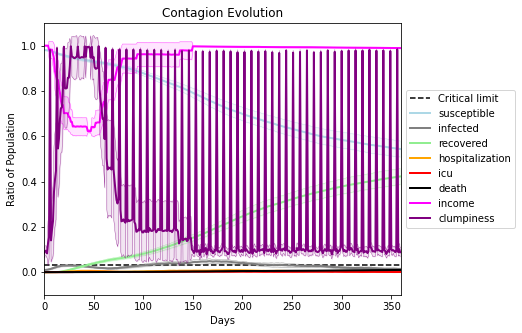

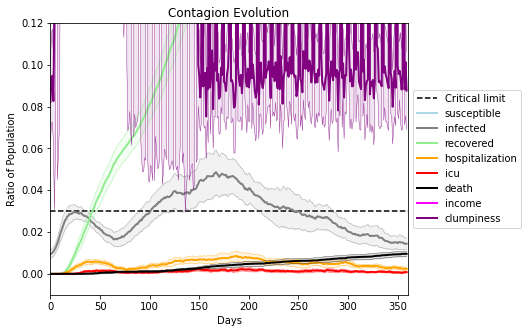

In [7]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9975
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2384, 8038, 3269, 3123, 388, 1012, 3321, 1302, 1807, 9673, 2635, 7702, 579, 7210, 8997, 1748, 8069, 1144, 2782, 6211]
Average similarity between family members is 0.957591374246188 at temperature -0.997
Average similarity between family and home is 0.999850966152291 at temperature -1
Average similarity between students and their classroom is 0.6507692600740073 at temperature -0.997
Average classroom occupancy is 4.6716417910447765 and number classrooms is 67
Average similarity between workers is 0.9196629875739806 at temperature -0.997
Average office occupancy is 3.203045685279188 and number offices is 197
Average friend similarity for adults: 0.851213949671966 for kids: 0.7170687382211735
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.798499487684107
avg restaurant similarity 0.851044655480642
avg restaurant similarity 0.5652374563981514
avg restaurant similarity 0.40244059525808085
avg restaurant similarity 0.6625310163922894
avg restaurant similarity 0.8918218867057127
avg restaurant similarity 0.6986688713239045
avg restaurant similarity 0.693460755594632
avg restaurant similarity 0.69957155672194
avg restaurant similarity 0.6673807203859226
avg restaurant similarity 0.7505996087195436
avg restaurant similarity 0.6841176457400764
avg restaurant similarity 0.7060873516138302
avg restaurant similarity 0.6647095339781873
avg restaurant similarity 0.7425493075451048
avg restaurant similarity 0.6153443833254705
avg restaurant similarity 0.6824792227255402
avg restaurant similarity 0.6686088226524727
avg restaurant similarity 0.6451896888373031
avg restaurant similarity 0.47117534836805686
avg restaurant similarity 0.6295371793643391
avg restaurant similarity 0.7816698432049758
avg restauran

avg restaurant similarity 0.503055785429225
avg restaurant similarity 0.6096441656578331
avg restaurant similarity 0.6494757330292861
avg restaurant similarity 0.6584281443667899
avg restaurant similarity 0.7244743992598315
avg restaurant similarity 0.5813755402104712
avg restaurant similarity 0.5753148690658605
avg restaurant similarity 0.5995620642861436
avg restaurant similarity 0.6244529112865429
avg restaurant similarity 0.5667776022008751
avg restaurant similarity 0.6140358936677939
avg restaurant similarity 0.5761596655684812
avg restaurant similarity 0.6559732792620675
avg restaurant similarity 0.713929333723584
avg restaurant similarity 0.48308201218967534
avg restaurant similarity 0.6682741488993698
avg restaurant similarity 0.7966496957682017
avg restaurant similarity 0.6557857055499049
avg restaurant similarity 0.7118899343426258
avg restaurant similarity 0.5065612147224664
avg restaurant similarity 0.7782523777994546
avg restaurant similarity 0.5492328460069191
avg restaur

avg restaurant similarity 0.41903809698132916
avg restaurant similarity 0.4334569329875107
avg restaurant similarity 0.6157732773418787
avg restaurant similarity 0.35885245059111154
avg restaurant similarity 0.47150502372610936
avg restaurant similarity 0.45101062369138134
avg restaurant similarity 0.5783336010514228
avg restaurant similarity 0.5479841590178568
avg restaurant similarity 0.4884231947229123
avg restaurant similarity 0.5650861229819331
avg restaurant similarity 0.5203431517967548
avg restaurant similarity 0.2968998000887066
avg restaurant similarity 0.5695188607367617
avg restaurant similarity 0.4742293461167062
avg restaurant similarity 0.5225578681711447
avg restaurant similarity 0.5303438962233606
avg restaurant similarity 0.778017505365044
avg restaurant similarity 0.5388713158440965
avg restaurant similarity 0.42377268649554
avg restaurant similarity 0.655770325594103
avg restaurant similarity 0.45621033148255835
avg restaurant similarity 0.6942099235430793
avg resta

avg restaurant similarity 0.5719257331849288
avg restaurant similarity 0.6510923826519202
avg restaurant similarity 0.5012452554898642
avg restaurant similarity 0.30293082971853574
avg restaurant similarity 0.6010813864372235
avg restaurant similarity 0.9996338598181818
avg restaurant similarity 0.39501112648837344
avg restaurant similarity 0.9998196047897019
avg restaurant similarity 0.7067853405075768
avg restaurant similarity 0.41361280990973215
avg restaurant similarity 0.4700679800752019
avg restaurant similarity 0.7332362818499825
avg restaurant similarity 0.6081419723879122
avg restaurant similarity 0.49856884408506924
avg restaurant similarity 0.434223611492094
avg restaurant similarity 0.4961924975446056
avg restaurant similarity 0.5346486696411186
avg restaurant similarity 0.6475165529925617
avg restaurant similarity 0.4486093838202605
avg restaurant similarity 0.4467493255989694
avg restaurant similarity 0.7807958713818552
avg restaurant similarity 0.4756949460968381
avg res

avg restaurant similarity 0.7611798087570284
avg restaurant similarity 0.5828887777174055
avg restaurant similarity 0.6721091013680929
avg restaurant similarity 0.7112778169473816
avg restaurant similarity 0.6153028040790994
avg restaurant similarity 0.45089259685703326
avg restaurant similarity 0.6311784606536898
avg restaurant similarity 0.5401093458023037
avg restaurant similarity 0.6867689954196606
avg restaurant similarity 0.5314346840894496
avg restaurant similarity 0.756249805970955
avg restaurant similarity 0.6141351150685146
avg restaurant similarity 0.6381662739048121
avg restaurant similarity 0.5262234065317455
avg restaurant similarity 0.6143113200290007
avg restaurant similarity 0.7926133389464379
avg restaurant similarity 0.731215208642424
avg restaurant similarity 0.7040287905998863
avg restaurant similarity 0.5917479416444794
avg restaurant similarity 0.6362264186568596
avg restaurant similarity 0.5707713616552552
avg restaurant similarity 0.5976665940678643
avg restaur

avg restaurant similarity 0.6656795636017916
avg restaurant similarity 0.751048223277489
avg restaurant similarity 0.7010229109347562
avg restaurant similarity 0.6807006906209275
avg restaurant similarity 0.7022773605756246
avg restaurant similarity 0.626020910236191
avg restaurant similarity 0.5382085631620345
avg restaurant similarity 0.674851112668716
avg restaurant similarity 0.6055698780183151
avg restaurant similarity 0.41138882351662737
avg restaurant similarity 0.6748138721308746
avg restaurant similarity 0.5832459795547908
avg restaurant similarity 0.6238996693433839
avg restaurant similarity 0.6888562125927389
avg restaurant similarity 0.62855336493978
avg restaurant similarity 0.7414555831951501
avg restaurant similarity 0.7320960533345773
avg restaurant similarity 0.7194811006584374
avg restaurant similarity 0.5665112566257375
avg restaurant similarity 0.641286170187645
avg restaurant similarity 0.8286121934386265
avg restaurant similarity 0.6898028693516138
avg restaurant 

avg restaurant similarity 0.749327086107863
avg restaurant similarity 0.7174415405617927
avg restaurant similarity 0.6045975085694941
avg restaurant similarity 0.8423019624656223
avg restaurant similarity 0.6992711491721599
avg restaurant similarity 0.5567818251004442
avg restaurant similarity 0.521291774836437
avg restaurant similarity 0.5855935264265264
avg restaurant similarity 0.46764900546695065
avg restaurant similarity 0.5133463545979182
avg restaurant similarity 0.6114468743559278
avg restaurant similarity 0.566712502367941
avg restaurant similarity 0.4991816109292138
avg restaurant similarity 0.5937418431520436
avg restaurant similarity 0.5651976203014765
avg restaurant similarity 0.5907140747418907
avg restaurant similarity 0.7091027296474802
avg restaurant similarity 0.6165255148853335
avg restaurant similarity 0.2268116064404141
avg restaurant similarity 0.5999239149018925
avg restaurant similarity 0.8015730686579443
avg restaurant similarity 0.15307747927486015
avg restaur

avg restaurant similarity 0.6382281649408987
avg restaurant similarity 0.5672307858077164
avg restaurant similarity 0.5196289018062616
avg restaurant similarity 0.3393340387030985
avg restaurant similarity 0.8317288062177858
avg restaurant similarity 0.6846719825474763
avg restaurant similarity 0.7412600573568049
avg restaurant similarity 0.7097234017003076
avg restaurant similarity 0.550696565085089
avg restaurant similarity 0.6570190662291503
avg restaurant similarity 0.6779546539727808
avg restaurant similarity 0.653572707095539
avg restaurant similarity 0.823733383372008
avg restaurant similarity 0.6875258360428237
avg restaurant similarity 0.8123424989029384
avg restaurant similarity 0.32179379136004194
avg restaurant similarity 0.4467713678199971
avg restaurant similarity 0.7913619846610748
avg restaurant similarity 0.710684460593594
avg restaurant similarity 0.6323007432209258
avg restaurant similarity 0.2756561564180929
avg restaurant similarity 0.7337274903416247
avg restauran

avg restaurant similarity 0.7525464265741956
avg restaurant similarity 0.6029584753139617
avg restaurant similarity 0.5076208808291154
avg restaurant similarity 0.7108664431566694
avg restaurant similarity 0.5682435748465849
avg restaurant similarity 0.6422648317670739
avg restaurant similarity 0.6556064626193469
avg restaurant similarity 0.4427303270755526
avg restaurant similarity 0.6521674234074063
avg restaurant similarity 0.5844824245560126
avg restaurant similarity 0.6005223482269121
avg restaurant similarity 0.6887419423153226
avg restaurant similarity 0.49759085501707273
avg restaurant similarity 0.5608398505023366
avg restaurant similarity 0.4809851627687816
avg restaurant similarity 0.7941844389461825
avg restaurant similarity 0.6991463584024872
avg restaurant similarity 0.541874224185039
avg restaurant similarity 0.6524172174937288
avg restaurant similarity 0.5727817105199949
avg restaurant similarity 0.7625751719568393
avg restaurant similarity 0.6996032872712954
avg restau

avg restaurant similarity 0.687756960651304
avg restaurant similarity 0.657431512604817
avg restaurant similarity 0.6635607418660107
avg restaurant similarity 0.6140700320336518
avg restaurant similarity 0.5734636076182396
avg restaurant similarity 0.6495388048320296
avg restaurant similarity 0.6830337730489393
avg restaurant similarity 0.6148127193966821
avg restaurant similarity 0.6962625842407784
avg restaurant similarity 0.8363883585758506
avg restaurant similarity 0.6196543004235673
avg restaurant similarity 0.7207670471093357
avg restaurant similarity 0.6247775391717616
avg restaurant similarity 0.6716361652902237
avg restaurant similarity 0.586850605103765
avg restaurant similarity 0.41183288268217205
avg restaurant similarity 0.5372546073053767
avg restaurant similarity 0.6048170165005451
avg restaurant similarity 0.6182249610523836
avg restaurant similarity 0.6908492484540096
avg restaurant similarity 0.5277363864512227
avg restaurant similarity 0.5693342791361711
avg restaura

avg restaurant similarity 0.6735569013291319
avg restaurant similarity 0.5154850379660159
avg restaurant similarity 0.5386224448146035
avg restaurant similarity 0.6619886090359807
avg restaurant similarity 0.3871364298726204
avg restaurant similarity 0.7063761542870223
avg restaurant similarity 0.6969938236709771
avg restaurant similarity 0.7163936492183971
avg restaurant similarity 0.5227231398369906
avg restaurant similarity 0.6224045623287272
avg restaurant similarity 0.7102895126200354
avg restaurant similarity 0.6270966426302031
avg restaurant similarity 0.6022471881744841
avg restaurant similarity 0.560331949989562
avg restaurant similarity 0.6020860131060929
avg restaurant similarity 0.5483140030522782
avg restaurant similarity 0.5681822754723712
avg restaurant similarity 0.6213492746477353
avg restaurant similarity 0.5448754143006543
avg restaurant similarity 0.6355254854449565
avg restaurant similarity 0.5489521079067718
avg restaurant similarity 0.5397324981350504
avg restaur

avg restaurant similarity 0.6688733903628936
avg restaurant similarity 0.6404967493060432
avg restaurant similarity 0.6922791954769436
avg restaurant similarity 0.6668502797267566
avg restaurant similarity 0.499389877009265
avg restaurant similarity 0.6385918297793696
avg restaurant similarity 0.8188424375520684
avg restaurant similarity 0.537836086582287
avg restaurant similarity 0.5814716047027942
avg restaurant similarity 0.6049401658208096
avg restaurant similarity 0.3935597357380537
avg restaurant similarity 0.5990645091211331
avg restaurant similarity 0.47414105567584436
avg restaurant similarity 0.6323818741661272
avg restaurant similarity 0.6913107880440774
avg restaurant similarity 0.5558011289717124
avg restaurant similarity 0.5352092567630176
avg restaurant similarity 0.4953510746320131
avg restaurant similarity 0.4862440076416133
avg restaurant similarity 0.4987066064319602
avg restaurant similarity 0.45468583778739347
avg restaurant similarity 0.5401344133170841
avg restau

avg restaurant similarity 0.728675997269001
avg restaurant similarity 0.7814332694881349
avg restaurant similarity 0.6023639054428368
avg restaurant similarity 0.7984293707276772
avg restaurant similarity 0.655608214448908
avg restaurant similarity 0.7966627243359656
avg restaurant similarity 0.8295568659500371
avg restaurant similarity 0.8104937626473454
avg restaurant similarity 0.6760039388178803
avg restaurant similarity 0.8673266487674306
avg restaurant similarity 0.8077287684341389
avg restaurant similarity 0.7295320736296227
avg restaurant similarity 0.7389427707786971
avg restaurant similarity 0.8639310513360412
avg restaurant similarity 0.7209488439323535
avg restaurant similarity 0.6164127116406227
avg restaurant similarity 0.7624017539468476
avg restaurant similarity 0.7707682161211723
avg restaurant similarity 0.7379253778048167
avg restaurant similarity 0.6309238145661659
avg restaurant similarity 0.6313424243944854
avg restaurant similarity 0.7243888784148498
avg restaura

avg restaurant similarity 0.7539277595690577
avg restaurant similarity 0.7195009831878186
avg restaurant similarity 0.7291150287499093
avg restaurant similarity 0.5919272858256048
avg restaurant similarity 0.7063277408016466
avg restaurant similarity 0.45201395141193806
avg restaurant similarity 0.5090469504725784
avg restaurant similarity 0.688759963130821
avg restaurant similarity 0.5864337267516642
avg restaurant similarity 0.51981676218502
avg restaurant similarity 0.6195594451678924
avg restaurant similarity 0.6639209516141575
avg restaurant similarity 0.8583330804851571
avg restaurant similarity 0.8219916124025445
avg restaurant similarity 0.6766032368682091
avg restaurant similarity 0.8230913357198087
avg restaurant similarity 0.6111512347145894
avg restaurant similarity 0.7671426034522362
avg restaurant similarity 0.6436720247180866
avg restaurant similarity 0.6255797477486109
avg restaurant similarity 0.7587635320820348
avg restaurant similarity 0.7694390966756894
avg restaura

avg restaurant similarity 0.6451675893490127
avg restaurant similarity 0.42315612260393615
avg restaurant similarity 0.5667977761635614
avg restaurant similarity 0.4623378152074151
avg restaurant similarity 0.5866197665678425
avg restaurant similarity 0.6398771208343909
avg restaurant similarity 0.6519714451789337
avg restaurant similarity 0.5978199472922874
avg restaurant similarity 0.5115358471869712
avg restaurant similarity 0.596545796323886
avg restaurant similarity 0.8218325019389694
avg restaurant similarity 0.7481808785242887
avg restaurant similarity 0.629869979885625
avg restaurant similarity 0.5028600304070415
avg restaurant similarity 0.7550862282567041
avg restaurant similarity 0.4420049556038966
avg restaurant similarity 0.4421576169863401
avg restaurant similarity 0.5256085638195258
avg restaurant similarity 0.5891209435525636
avg restaurant similarity 0.47489813222123656
avg restaurant similarity 0.6109740344703306
avg restaurant similarity 0.5867369214064636
avg restau

avg restaurant similarity 0.6516847631057059
avg restaurant similarity 0.6719066942469047
avg restaurant similarity 0.5731374534530854
avg restaurant similarity 0.410677308558307
avg restaurant similarity 0.5746273874926289
avg restaurant similarity 0.8778226535545091
avg restaurant similarity 0.5412402969403856
avg restaurant similarity 0.44835884014227956
avg restaurant similarity 0.5458855389307118
avg restaurant similarity 0.6485774151372703
avg restaurant similarity 0.720294553550814
avg restaurant similarity 0.636634882327563
avg restaurant similarity 0.47267225929815665
avg restaurant similarity 0.5882176674091016
avg restaurant similarity 0.5943132179335038
avg restaurant similarity 0.412684400813728
avg restaurant similarity 0.6826515887061247
avg restaurant similarity 0.6936570623966609
avg restaurant similarity 0.7148076655669307
avg restaurant similarity 0.6888600072574821
avg restaurant similarity 0.6998489330960012
avg restaurant similarity 0.4965756142377855
avg restaura

avg restaurant similarity 0.5895532402644221
avg restaurant similarity 0.48491626093280765
avg restaurant similarity 0.5681890363252666
avg restaurant similarity 0.4161696548501453
avg restaurant similarity 0.6745107696086212
avg restaurant similarity 0.5665649739785394
avg restaurant similarity 0.5146071372054284
avg restaurant similarity 0.4930682643460223
avg restaurant similarity 0.7483166671303486
avg restaurant similarity 0.5391613337243293
avg restaurant similarity 0.7906187190243753
avg restaurant similarity 0.6622504549974371
avg restaurant similarity 0.6018692890058873
avg restaurant similarity 0.48895585532824043
avg restaurant similarity 0.5484910216666454
avg restaurant similarity 0.6905843836523983
avg restaurant similarity 0.25361668336743665
avg restaurant similarity 0.4838734614465288
avg restaurant similarity 0.5786462696952636
avg restaurant similarity 0.6119319308725107
avg restaurant similarity 0.6563158085343028
avg restaurant similarity 0.75589493481212
avg resta

avg restaurant similarity 0.7476153174911864
avg restaurant similarity 0.6099478426999497
avg restaurant similarity 0.6276101844395455
avg restaurant similarity 0.5279467826202063
avg restaurant similarity 0.7691845057377904
avg restaurant similarity 0.6014560340033828
avg restaurant similarity 0.6657487736153404
avg restaurant similarity 0.605081041912283
avg restaurant similarity 0.39191486151904
avg restaurant similarity 0.5786647155272516
avg restaurant similarity 0.4257577090777292
avg restaurant similarity 0.528740205573563
avg restaurant similarity 0.7033097835935144
avg restaurant similarity 0.609594753922525
avg restaurant similarity 0.6416655915858507
avg restaurant similarity 0.727476011252523
avg restaurant similarity 0.8026027126783177
avg restaurant similarity 0.5946574682559316
avg restaurant similarity 0.3597895602820707
avg restaurant similarity 0.5224203204494885
avg restaurant similarity 0.6394662483578947
avg restaurant similarity 0.6314262143639604
avg restaurant s

avg restaurant similarity 0.5083896342712787
avg restaurant similarity 0.4878043335732851
avg restaurant similarity 0.5171087465886812
avg restaurant similarity 0.6543466914436619
avg restaurant similarity 0.6169146539841796
avg restaurant similarity 0.6083590198423711
avg restaurant similarity 0.5264602788869386
avg restaurant similarity 0.5876560050681037
avg restaurant similarity 0.6276367681349649
avg restaurant similarity 0.682149457963931
avg restaurant similarity 0.7199581333474148
avg restaurant similarity 0.6506261936930174
avg restaurant similarity 0.49345030217435637
avg restaurant similarity 0.5744977121798082
avg restaurant similarity 0.5607812447807475
avg restaurant similarity 0.7021930592209535
avg restaurant similarity 0.5913201845586834
avg restaurant similarity 0.45152066785229983
avg restaurant similarity 0.5545652970576859
avg restaurant similarity 0.708916843651493
avg restaurant similarity 0.5742973389202769
avg restaurant similarity 0.6663805795966741
avg restau

avg restaurant similarity 0.5406053643286984
avg restaurant similarity 0.7074295021387064
avg restaurant similarity 0.5235392942023709
avg restaurant similarity 0.6245783774212146
avg restaurant similarity 0.5967475661806703
avg restaurant similarity 0.8343520449192957
avg restaurant similarity 0.5481098071997257
avg restaurant similarity 0.5670458446687415
avg restaurant similarity 0.633184594433179
avg restaurant similarity 0.6657657387885106
avg restaurant similarity 0.4673666676813073
avg restaurant similarity 0.568497453039264
avg restaurant similarity 0.531640801405354
avg restaurant similarity 0.5031165160084017
avg restaurant similarity 0.468871460921542
avg restaurant similarity 0.5421098192482416
avg restaurant similarity 0.5352102930191647
avg restaurant similarity 0.5394050333054401
avg restaurant similarity 0.6538775303712057
avg restaurant similarity 0.6101620053103667
avg restaurant similarity 0.659598709041548
avg restaurant similarity 0.5233962804853028
avg restaurant 

avg restaurant similarity 0.6419400978160104
avg restaurant similarity 0.5934246302001489
avg restaurant similarity 0.6846371574284285
avg restaurant similarity 0.6381208112121872
avg restaurant similarity 0.5505351811974551
avg restaurant similarity 0.44651903507031954
avg restaurant similarity 0.4614836525981686
avg restaurant similarity 0.6139512380455472
avg restaurant similarity 0.4622143622022807
avg restaurant similarity 0.4961632503498789
avg restaurant similarity 0.5987864111269839
avg restaurant similarity 0.5658011835369187
avg restaurant similarity 0.5436016437589506
avg restaurant similarity 0.6365169580140156
avg restaurant similarity 0.4850844328979205
avg restaurant similarity 0.6372234408196656
avg restaurant similarity 0.5648827882974434
avg restaurant similarity 0.5468321205923543
avg restaurant similarity 0.5784225510330641
avg restaurant similarity 0.5834206457634137
avg restaurant similarity 0.6658802610534208
avg restaurant similarity 0.40469846291212674
avg rest

avg restaurant similarity 0.5872722530637456
avg restaurant similarity 0.6564779034065025
avg restaurant similarity 0.5517080257706765
avg restaurant similarity 0.6634310737374501
avg restaurant similarity 0.6066425425827012
avg restaurant similarity 0.4481808414417472
avg restaurant similarity 0.6819108696979782
avg restaurant similarity 0.66720084295828
avg restaurant similarity 0.5594984868772893
avg restaurant similarity 0.6248480877311343
avg restaurant similarity 0.5887261145818754
avg restaurant similarity 0.6120094138575835
avg restaurant similarity 0.5440095988553096
avg restaurant similarity 0.6169658339492657
avg restaurant similarity 0.8111016238687772
avg restaurant similarity 0.5893128752149897
avg restaurant similarity 0.6766669728752648
avg restaurant similarity 0.6432631526319089
avg restaurant similarity 0.5332022833535343
avg restaurant similarity 0.5809364166049736
avg restaurant similarity 0.49928944685842597
avg restaurant similarity 0.5339379173032681
avg restaur

avg restaurant similarity 0.6122660186735184
avg restaurant similarity 0.7085907035612058
avg restaurant similarity 0.7768377005494518
avg restaurant similarity 0.4170446109122406
avg restaurant similarity 0.5144644253368714
avg restaurant similarity 0.7400331532082148
avg restaurant similarity 0.5705770882062073
avg restaurant similarity 0.4876828047424359
avg restaurant similarity 0.7526829113592325
avg restaurant similarity 0.5413179231716393
avg restaurant similarity 0.46897982062570764
avg restaurant similarity 0.5078877431373814
avg restaurant similarity 0.8052468097276042
avg restaurant similarity 0.7863531521701206
avg restaurant similarity 0.7999411975252767
avg restaurant similarity 0.6145386235032623
avg restaurant similarity 0.573219131599605
avg restaurant similarity 0.684480845390554
avg restaurant similarity 0.5592331553078596
avg restaurant similarity 0.5058872575784698
avg restaurant similarity 0.6797017931535838
avg restaurant similarity 0.5241945359295072
avg restaur

avg restaurant similarity 0.9109317711377425
avg restaurant similarity 0.9194126331697715
avg restaurant similarity 0.6538457983781572
avg restaurant similarity 0.7598837054428863
avg restaurant similarity 0.5488440996627776
avg restaurant similarity 0.42894924971120013
avg restaurant similarity 0.7087438433605522
avg restaurant similarity 0.8705607105201078
avg restaurant similarity 0.5665116567285694
avg restaurant similarity 0.9121436681091432
avg restaurant similarity 0.9839022836792732
avg restaurant similarity 0.7895960965125327
avg restaurant similarity 0.9994488432717116
avg restaurant similarity 0.5791941577935503
avg restaurant similarity 0.8584521726140647
avg restaurant similarity 0.5171475275605748
avg restaurant similarity 0.4917211383016781
avg restaurant similarity 0.6867981959439777
avg restaurant similarity 0.6921266601416288
avg restaurant similarity 0.7259931535760428
avg restaurant similarity 0.5464705768697452
avg restaurant similarity 0.6646583126796841
avg resta

avg restaurant similarity 0.4922098654658965
avg restaurant similarity 0.6456084469624139
avg restaurant similarity 0.565538824281764
avg restaurant similarity 0.6757991789966508
avg restaurant similarity 0.5922067989743443
avg restaurant similarity 0.6591397413877064
avg restaurant similarity 0.7503048859185628
avg restaurant similarity 0.671396648371402
avg restaurant similarity 0.6760158004916621
avg restaurant similarity 0.742139269224959
avg restaurant similarity 0.6819942997149305
avg restaurant similarity 0.5689866251007135
avg restaurant similarity 0.624167362092858
avg restaurant similarity 0.8181312007908453
avg restaurant similarity 0.5342017592880732
avg restaurant similarity 0.486279106141553
avg restaurant similarity 0.7114094439620801
avg restaurant similarity 0.59390714263489
avg restaurant similarity 0.6942104125611154
avg restaurant similarity 0.4500740228071205
avg restaurant similarity 0.5893602416997774
avg restaurant similarity 0.8144654487216727
avg restaurant si

avg restaurant similarity 0.5517314321377718
avg restaurant similarity 0.5829707619525938
avg restaurant similarity 0.9996018268248317
avg restaurant similarity 0.6241328138719848
avg restaurant similarity 0.8121508608292035
avg restaurant similarity 0.6653403338629933
avg restaurant similarity 0.611475232273414
avg restaurant similarity 0.5741734010295716
avg restaurant similarity 0.6133857890745782
avg restaurant similarity 0.6457108488642067
avg restaurant similarity 0.6047626914579558
avg restaurant similarity 0.47659691068145726
avg restaurant similarity 0.6567556194011206
avg restaurant similarity 0.7217009150751275
avg restaurant similarity 0.5205939928888401
avg restaurant similarity 0.599537367391983
avg restaurant similarity 0.5916573228343154
avg restaurant similarity 0.7915065184849456
avg restaurant similarity 0.5516291133434791
avg restaurant similarity 0.699239873696486
avg restaurant similarity 0.9278835971024062
avg restaurant similarity 0.6807974006026879
avg restaura

avg restaurant similarity 0.6200523388340742
avg restaurant similarity 0.572832625685737
avg restaurant similarity 0.6787124630532938
avg restaurant similarity 0.563954312993403
avg restaurant similarity 0.5349893041394845
avg restaurant similarity 0.7113233380702707
avg restaurant similarity 0.6274085859023247
avg restaurant similarity 0.6563715730640843
avg restaurant similarity 0.47841366093603616
avg restaurant similarity 0.8008492591013708
avg restaurant similarity 0.6332679340881652
avg restaurant similarity 0.698435066444538
avg restaurant similarity 0.8437588905440254
avg restaurant similarity 0.5128945911433567
avg restaurant similarity 0.7737274874952599
avg restaurant similarity 0.7664405851030351
avg restaurant similarity 0.6706072027553327
avg restaurant similarity 0.6864366775276923
avg restaurant similarity 0.623157269690313
avg restaurant similarity 0.3416604865964246
avg restaurant similarity 0.5291390388873304
avg restaurant similarity 0.9998280680210874
avg restauran

avg restaurant similarity 0.9014095438092113
avg restaurant similarity 0.5191679249445738
avg restaurant similarity 0.5957746566448827
avg restaurant similarity 0.5451773887683893
avg restaurant similarity 0.48867641654053273
avg restaurant similarity 0.6058143327971837
avg restaurant similarity 0.707714607448734
avg restaurant similarity 0.6064986885936272
avg restaurant similarity 0.9997874513017814
avg restaurant similarity 0.5619424516730614
avg restaurant similarity 0.7961095455811366
avg restaurant similarity 0.6391364492066594
avg restaurant similarity 0.5853763966517793
avg restaurant similarity 0.753803321032946
avg restaurant similarity 0.5024014370091409
avg restaurant similarity 0.6621664597119946
avg restaurant similarity 0.6170795887636532
avg restaurant similarity 0.47421326443860046
avg restaurant similarity 0.6029800718556098
avg restaurant similarity 0.5647827810853603
avg restaurant similarity 0.5010852332639666
avg restaurant similarity 0.6872373232845344
avg restau

avg restaurant similarity 0.5289122518449514
avg restaurant similarity 0.49836228594586807
avg restaurant similarity 0.5664790073844759
avg restaurant similarity 0.49687051010407934
avg restaurant similarity 0.5136848962641332
avg restaurant similarity 0.5471993404138131
avg restaurant similarity 0.7071042074713958
avg restaurant similarity 0.6720477581422014
avg restaurant similarity 0.6561049074074
avg restaurant similarity 0.6884976214922162
avg restaurant similarity 0.6366614447144748
avg restaurant similarity 0.6248204371157804
avg restaurant similarity 0.38273293138544967
avg restaurant similarity 0.6196958912011097
avg restaurant similarity 0.47192345629069254
avg restaurant similarity 0.5542059482352031
avg restaurant similarity 0.26574574477683494
avg restaurant similarity 0.5778109600677351
avg restaurant similarity 0.5189491348491064
avg restaurant similarity 0.5922249541945086
avg restaurant similarity 0.793775194269745
avg restaurant similarity 0.24094369364186718
avg rest

avg restaurant similarity 0.5247951829639574
avg restaurant similarity 0.5136830135308288
avg restaurant similarity 0.5568724426900935
avg restaurant similarity 0.7140028844717499
avg restaurant similarity 0.5562093460573885
avg restaurant similarity 0.5204296571484445
avg restaurant similarity 0.4496232106905856
avg restaurant similarity 0.4380064129017906
avg restaurant similarity 0.7859150628464315
avg restaurant similarity 0.6322692780520273
avg restaurant similarity 0.5043126429249472
avg restaurant similarity 0.6642482115539493
avg restaurant similarity 0.6377964411116982
avg restaurant similarity 0.4165424809678339
avg restaurant similarity 0.57391250970831
avg restaurant similarity 0.6248215233263155
avg restaurant similarity 0.5202430190267585
avg restaurant similarity 0.7218102282485892
avg restaurant similarity 0.5779617309259363
avg restaurant similarity 0.638949496098389
avg restaurant similarity 0.5061099554557515
avg restaurant similarity 0.6653370061787994
avg restauran

avg restaurant similarity 0.656418242914351
avg restaurant similarity 0.6105388280679633
avg restaurant similarity 0.6481027897801256
avg restaurant similarity 0.7744748243112506
avg restaurant similarity 0.5706287362651923
avg restaurant similarity 0.9573728913972943
avg restaurant similarity 0.7927592177528435
avg restaurant similarity 0.6167781262593688
avg restaurant similarity 0.5101484791119498
avg restaurant similarity 0.6769233994580773
avg restaurant similarity 0.6416308438224227
avg restaurant similarity 0.7529073863495321
avg restaurant similarity 0.7032235713964974
avg restaurant similarity 0.6235267545728317
avg restaurant similarity 0.4251638935017649
avg restaurant similarity 0.6967419095061385
avg restaurant similarity 0.5253721973658896
avg restaurant similarity 0.6345006911643344
avg restaurant similarity 0.29869225394246623
avg restaurant similarity 0.7129710873859658
avg restaurant similarity 0.6407872242065157
avg restaurant similarity 0.8540896857820699
avg restau

avg restaurant similarity 0.822080530154451
avg restaurant similarity 0.5803764696685216
avg restaurant similarity 0.5394718589264756
avg restaurant similarity 0.7283275057193617
avg restaurant similarity 0.6701449412274335
avg restaurant similarity 0.7256786917361524
avg restaurant similarity 0.5826152716187027
avg restaurant similarity 0.6314053430736537
avg restaurant similarity 0.6927818147920917
avg restaurant similarity 0.4299049571873352
avg restaurant similarity 0.7031705145512822
avg restaurant similarity 0.7481059342936962
avg restaurant similarity 0.6025133427076204
avg restaurant similarity 0.6636770791873282
avg restaurant similarity 0.6052218008286381
avg restaurant similarity 0.6878947581285347
avg restaurant similarity 0.5808196647525288
avg restaurant similarity 0.6500604513903476
avg restaurant similarity 0.6595544680178409
avg restaurant similarity 0.5881671218427711
avg restaurant similarity 0.6367544850110305
avg restaurant similarity 0.716948262759679
avg restaura

avg restaurant similarity 0.7653553467857082
avg restaurant similarity 0.6329205920550374
avg restaurant similarity 0.7676819240388781
avg restaurant similarity 0.6721727370873423
avg restaurant similarity 0.5506441370694386
avg restaurant similarity 0.4503704844482349
avg restaurant similarity 0.5816992865739197
avg restaurant similarity 0.7342913446628909
avg restaurant similarity 0.5641158819830091
avg restaurant similarity 0.6324517847563372
avg restaurant similarity 0.6976524342573462
avg restaurant similarity 0.6986755417572581
avg restaurant similarity 0.7395348585100893
avg restaurant similarity 0.6261977006503164
avg restaurant similarity 0.4474855976669822
avg restaurant similarity 0.49857214937902433
avg restaurant similarity 0.7838303626445576
avg restaurant similarity 0.562376268191005
avg restaurant similarity 0.5835328922461241
avg restaurant similarity 0.48256753013709025
avg restaurant similarity 0.6796130855208814
avg restaurant similarity 0.6212180824705027
avg resta

avg restaurant similarity 0.3930769748290313
avg restaurant similarity 0.7778953844006984
avg restaurant similarity 0.47014982473297573
avg restaurant similarity 0.7096392194112966
avg restaurant similarity 0.6391255372473338
avg restaurant similarity 0.6219108243497172
avg restaurant similarity 0.5819088048746237
avg restaurant similarity 0.5043401544432713
avg restaurant similarity 0.6769316539284553
avg restaurant similarity 0.5860718987736943
avg restaurant similarity 0.5900565838982982
avg restaurant similarity 0.5615028284746492
avg restaurant similarity 0.5981423008627188
avg restaurant similarity 0.8706085763558001
avg restaurant similarity 0.6269421492247513
avg restaurant similarity 0.6550084364516118
avg restaurant similarity 0.7088968460489513
avg restaurant similarity 0.3861873248157687
avg restaurant similarity 0.9314179344749911
avg restaurant similarity 0.5723487560831187
avg restaurant similarity 0.4930862509549326
avg restaurant similarity 0.6364013994832498
avg resta

avg restaurant similarity 0.7785790792795351
avg restaurant similarity 0.48042745722702956
avg restaurant similarity 0.6114799107419446
avg restaurant similarity 0.7740916698225622
avg restaurant similarity 0.6730424550322636
avg restaurant similarity 0.606406031965202
avg restaurant similarity 0.9088444392450038
avg restaurant similarity 0.5740534533088383
avg restaurant similarity 0.6757762909905778
avg restaurant similarity 0.6503532143423263
avg restaurant similarity 0.38357680616263656
avg restaurant similarity 0.5840007656373348
avg restaurant similarity 0.6135004008714096
avg restaurant similarity 0.5909893672284444
avg restaurant similarity 0.6285598059597798
avg restaurant similarity 0.7113490176953743
avg restaurant similarity 0.7804766350558816
avg restaurant similarity 0.496431350524889
avg restaurant similarity 0.799012700439441
avg restaurant similarity 0.5504626275140494
avg restaurant similarity 0.5208749435231029
avg restaurant similarity 0.5979765773229195
avg restaur

avg restaurant similarity 0.6580689009612095
avg restaurant similarity 0.6366448217145108
avg restaurant similarity 0.5320349276055607
avg restaurant similarity 0.5646788923009248
avg restaurant similarity 0.5835363519293232
avg restaurant similarity 0.7649455067055708
avg restaurant similarity 0.6101003112154784
avg restaurant similarity 0.5110805604461055
avg restaurant similarity 0.6864305749478814
avg restaurant similarity 0.5758787862513886
avg restaurant similarity 0.8666798180770223
avg restaurant similarity 0.6431981611538398
avg restaurant similarity 0.776733127576338
avg restaurant similarity 0.6357949055433327
avg restaurant similarity 0.41500601952527927
avg restaurant similarity 0.739772569882733
avg restaurant similarity 0.7844360673476976
avg restaurant similarity 0.6240545021842583
avg restaurant similarity 0.5381722049047473
avg restaurant similarity 0.6694734084812572
avg restaurant similarity 0.6518756473561442
avg restaurant similarity 0.7664464139777688
avg restaur

avg restaurant similarity 0.8375116014068225
avg restaurant similarity 0.5439729144670796
avg restaurant similarity 0.6219240859237166
avg restaurant similarity 0.6648304417439267
avg restaurant similarity 0.4461734661754204
avg restaurant similarity 0.4655799189654048
avg restaurant similarity 0.40983930548146297
avg restaurant similarity 0.6566110217771797
avg restaurant similarity 0.5864145221833547
avg restaurant similarity 0.46672830108558144
avg restaurant similarity 0.5140908591461119
avg restaurant similarity 0.40626175728667646
avg restaurant similarity 0.5059272836395772
avg restaurant similarity 0.6217745478284378
avg restaurant similarity 0.5237019809018876
avg restaurant similarity 0.47702601534261435
avg restaurant similarity 0.5627729318297455
avg restaurant similarity 0.6001163764076889
avg restaurant similarity 0.6223307083652616
avg restaurant similarity 0.5625290061982929
avg restaurant similarity 0.5157500693985825
avg restaurant similarity 0.6269102358602551
avg re

avg restaurant similarity 0.6132612473570116
avg restaurant similarity 0.894270318168044
avg restaurant similarity 0.5306305309707711
avg restaurant similarity 0.5370170714031655
avg restaurant similarity 0.5550798936049033
avg restaurant similarity 0.5753069122062981
avg restaurant similarity 0.5743455334994331
avg restaurant similarity 0.49825273125062236
avg restaurant similarity 0.6576659961142057
avg restaurant similarity 0.5834661507465484
avg restaurant similarity 0.6078934838265497
avg restaurant similarity 0.5374205223474535
avg restaurant similarity 0.5731485730102956
avg restaurant similarity 0.444935892057816
avg restaurant similarity 0.7033280674578793
avg restaurant similarity 0.6013973080795854
avg restaurant similarity 0.485446793230152
avg restaurant similarity 0.8070355672920404
avg restaurant similarity 0.4785658879483478
avg restaurant similarity 0.5928157352232659
avg restaurant similarity 0.4326224684816005
avg restaurant similarity 0.5798214271807605
avg restaura

avg restaurant similarity 0.5232615497638928
avg restaurant similarity 0.5433694414643381
avg restaurant similarity 0.6093205477580587
avg restaurant similarity 0.7251515751963356
avg restaurant similarity 0.5902968880116155
avg restaurant similarity 0.8323120324384395
avg restaurant similarity 0.6073037950375707
avg restaurant similarity 0.7014268735704652
avg restaurant similarity 0.6669031018322223
avg restaurant similarity 0.6130242327372657
avg restaurant similarity 0.7520386947993352
avg restaurant similarity 0.5486369177194289
avg restaurant similarity 0.6116527923676641
avg restaurant similarity 0.6173949380101151
avg restaurant similarity 0.6329509419218902
avg restaurant similarity 0.5640004682644494
avg restaurant similarity 0.8003956146280053
avg restaurant similarity 0.6162914214627007
avg restaurant similarity 0.7379903283132462
avg restaurant similarity 0.5839183083654841
avg restaurant similarity 0.6728156562116808
avg restaurant similarity 0.735623850424762
avg restaur

avg restaurant similarity 0.885345454345611
avg restaurant similarity 0.596801038657738
avg restaurant similarity 0.5231674137978384
avg restaurant similarity 0.6814598064599275
avg restaurant similarity 0.6799796732133745
avg restaurant similarity 0.48907727084447195
avg restaurant similarity 0.6095727276942526
avg restaurant similarity 0.28816793772549437
avg restaurant similarity 0.6462772177572583
avg restaurant similarity 0.493761358200538
avg restaurant similarity 0.5578823309030412
avg restaurant similarity 0.7877772635389807
avg restaurant similarity 0.5415597977688312
avg restaurant similarity 0.6802832526191348
avg restaurant similarity 0.8570230990767596
avg restaurant similarity 0.549239057280608
avg restaurant similarity 0.7351830096053296
avg restaurant similarity 0.7572578664311297
avg restaurant similarity 0.7386780867139318
avg restaurant similarity 0.6237519937351947
avg restaurant similarity 0.5267329242612191
avg restaurant similarity 0.6654723920794435
avg restaura

(<function dict.items>, <function dict.items>, <function dict.items>)

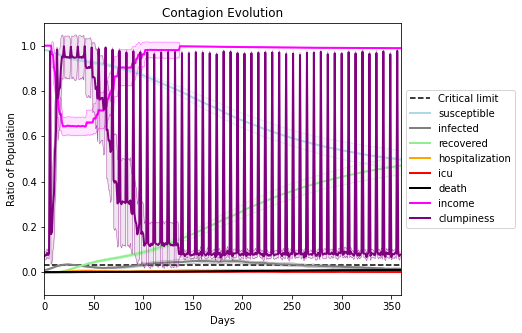

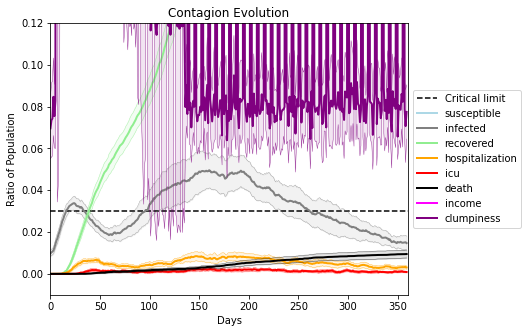

In [8]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.997
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8646, 7548, 8808, 3935, 6699, 7560, 6854, 5192, 4283, 8171, 7719, 8827, 8829, 4778, 6921, 9737, 363, 8776, 2367, 5359]
Average similarity between family members is 0.9484201201538975 at temperature -0.996
Average similarity between family and home is 0.9998504554096532 at temperature -1
Average similarity between students and their classroom is 0.6119816254066326 at temperature -0.996
Average classroom occupancy is 4.314285714285714 and number classrooms is 70
Average similarity between workers is 0.9164560348875949 at temperature -0.996
Average office occupancy is 3.3473684210526318 and number offices is 190
Average friend similarity for adults: 0.8480102341533161 for kids: 0.6943985776421603
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.6585717560153003
avg restaurant similarity 0.502433223583587
avg restaurant similarity 0.6341149704118527
avg restaurant similarity 0.6701297225965095
avg restaurant similarity 0.5444009050331083
avg restaurant similarity 0.593989415267724
avg restaurant similarity 0.43650743022470007
avg restaurant similarity 0.4683868272783014
avg restaurant similarity 0.6125866420232454
avg restaurant similarity 0.6511043593393107
avg restaurant similarity 0.6982840238139294
avg restaurant similarity 0.7196864756365292
avg restaurant similarity 0.6341199233628665
avg restaurant similarity 0.799268544507379
avg restaurant similarity 0.5534309121226323
avg restaurant similarity 0.5288216379083848
avg restaurant similarity 0.5221140815932797
avg restaurant similarity 0.563858938865945
avg restaurant similarity 0.5657938249103952
avg restaurant similarity 0.6769968775773906
avg restaurant similarity 0.6778414812757324
avg restaurant similarity 0.6462463834417278
avg restauran

avg restaurant similarity 0.5377735232277644
avg restaurant similarity 0.48620702425361084
avg restaurant similarity 0.2719050338399071
avg restaurant similarity 0.6421012416180969
avg restaurant similarity 0.5647853132549109
avg restaurant similarity 0.6521138249595483
avg restaurant similarity 0.7010151715548103
avg restaurant similarity 0.580117905190441
avg restaurant similarity 0.5719960666355492
avg restaurant similarity 0.5461479276241644
avg restaurant similarity 0.3954338011102628
avg restaurant similarity 0.49121905230145596
avg restaurant similarity 0.6954120768925023
avg restaurant similarity 0.44183338740927597
avg restaurant similarity 0.847110033009012
avg restaurant similarity 0.7308542430303054
avg restaurant similarity 0.5070325411042346
avg restaurant similarity 0.5475644024505516
avg restaurant similarity 0.3988725687202532
avg restaurant similarity 0.9455964134512197
avg restaurant similarity 0.889271781836239
avg restaurant similarity 0.698883913510691
avg restaur

avg restaurant similarity 0.6211842571515704
avg restaurant similarity 0.762401481828185
avg restaurant similarity 0.6279883272949216
avg restaurant similarity 0.5750270494582964
avg restaurant similarity 0.35253450487928867
avg restaurant similarity 0.5456718828470677
avg restaurant similarity 0.43540899248675935
avg restaurant similarity 0.5802174889823916
avg restaurant similarity 0.5328456874450506
avg restaurant similarity 0.6641380506886311
avg restaurant similarity 0.6271706300648214
avg restaurant similarity 0.610200586064728
avg restaurant similarity 0.4371587370339787
avg restaurant similarity 0.6020858917772707
avg restaurant similarity 0.6297609522655099
avg restaurant similarity 0.622525447768367
avg restaurant similarity 0.7213123225002516
avg restaurant similarity 0.7559961478670322
avg restaurant similarity 0.634045800247257
avg restaurant similarity 0.6749512634592364
avg restaurant similarity 0.6137656631046543
avg restaurant similarity 0.5654272479690182
avg restaura

avg restaurant similarity 0.47582639430218354
avg restaurant similarity 0.5214150124133596
avg restaurant similarity 0.587215952103434
avg restaurant similarity 0.7093541068835881
avg restaurant similarity 0.4880293733357373
avg restaurant similarity 0.6245687270490778
avg restaurant similarity 0.5195958611033914
avg restaurant similarity 0.6637974480279485
avg restaurant similarity 0.3898188425413045
avg restaurant similarity 0.6919652723386852
avg restaurant similarity 0.5877518665838087
avg restaurant similarity 0.644656355752989
avg restaurant similarity 0.5135905286348933
avg restaurant similarity 0.544270377879364
avg restaurant similarity 0.5850768512034566
avg restaurant similarity 0.5637444859621584
avg restaurant similarity 0.6108984293864483
avg restaurant similarity 0.6250637248322768
avg restaurant similarity 0.49784949771784154
avg restaurant similarity 0.663985674286707
avg restaurant similarity 0.7285314855907663
avg restaurant similarity 0.5773247406082759
avg restaura

avg restaurant similarity 0.7130417035757217
avg restaurant similarity 0.5733124730964474
avg restaurant similarity 0.538634180213607
avg restaurant similarity 0.627228940483088
avg restaurant similarity 0.3976655500171149
avg restaurant similarity 0.6333445500918241
avg restaurant similarity 0.5346814520570587
avg restaurant similarity 0.6703964525281465
avg restaurant similarity 0.9325560623744736
avg restaurant similarity 0.47270518758286517
avg restaurant similarity 0.2900762892580466
avg restaurant similarity 0.5635177418913462
avg restaurant similarity 0.6256164854732628
avg restaurant similarity 0.7655268053783297
avg restaurant similarity 0.7368762477115524
avg restaurant similarity 0.49558379388947915
avg restaurant similarity 0.49344192429678824
avg restaurant similarity 0.6369971235533841
avg restaurant similarity 0.8145717649839448
avg restaurant similarity 0.5987022010353062
avg restaurant similarity 0.47764793952656465
avg restaurant similarity 0.7159588035530351
avg rest

avg restaurant similarity 0.47686755733844877
avg restaurant similarity 0.7682579637498472
avg restaurant similarity 0.5835669802241511
avg restaurant similarity 0.7432338314052718
avg restaurant similarity 0.6586346621375391
avg restaurant similarity 0.513975209598117
avg restaurant similarity 0.5703517923611368
avg restaurant similarity 0.5655103720342072
avg restaurant similarity 0.4169942211779405
avg restaurant similarity 0.6061677856232354
avg restaurant similarity 0.6111541881835916
avg restaurant similarity 0.516311625558573
avg restaurant similarity 0.7985619311221168
avg restaurant similarity 0.5598787822578158
avg restaurant similarity 0.48291539799470895
avg restaurant similarity 0.6474816153781944
avg restaurant similarity 0.630214090352531
avg restaurant similarity 0.3919340179964408
avg restaurant similarity 0.5852070007302421
avg restaurant similarity 0.2508666822456379
avg restaurant similarity 0.4618189495793103
avg restaurant similarity 0.6625538466182296
avg restaur

avg restaurant similarity 0.4988475745321025
avg restaurant similarity 0.6739912088061975
avg restaurant similarity 0.8755103697582852
avg restaurant similarity 0.6935061956138563
avg restaurant similarity 0.6428072809644569
avg restaurant similarity 0.7168467530803697
avg restaurant similarity 0.674413203936415
avg restaurant similarity 0.5890708333336795
avg restaurant similarity 0.6836795784429154
avg restaurant similarity 0.7782436716094743
avg restaurant similarity 0.5908747231941653
avg restaurant similarity 0.7669525302034571
avg restaurant similarity 0.7038738461997659
avg restaurant similarity 0.7366362638417994
avg restaurant similarity 0.7316118727025974
avg restaurant similarity 0.7426000077640026
avg restaurant similarity 0.6678262844274565
avg restaurant similarity 0.6856900356440278
avg restaurant similarity 0.6313548883697723
avg restaurant similarity 0.7225512027169021
avg restaurant similarity 0.5485307045807724
avg restaurant similarity 0.9998526563027758
avg restaur

avg restaurant similarity 0.6954722062830441
avg restaurant similarity 0.7986020766948564
avg restaurant similarity 0.8260033020587493
avg restaurant similarity 0.8113694004648848
avg restaurant similarity 0.6936994263550765
avg restaurant similarity 0.6261788113638772
avg restaurant similarity 0.5661402763544326
avg restaurant similarity 0.8688003349602443
avg restaurant similarity 0.7867035453619767
avg restaurant similarity 0.6401322784431683
avg restaurant similarity 0.5824266272329964
avg restaurant similarity 0.7926025587982034
avg restaurant similarity 0.7412939939194209
avg restaurant similarity 0.7947961428364844
avg restaurant similarity 0.7534524874826559
avg restaurant similarity 0.5929743864334919
avg restaurant similarity 0.4165955033960127
avg restaurant similarity 0.8072368750484702
avg restaurant similarity 0.8686866431109201
avg restaurant similarity 0.6524535211157824
avg restaurant similarity 0.6419469419825774
avg restaurant similarity 0.6215492548454162
avg restau

avg restaurant similarity 0.6986001546490695
avg restaurant similarity 0.6752131505237188
avg restaurant similarity 0.6131332774092099
avg restaurant similarity 0.7113992161373258
avg restaurant similarity 0.5383894088199728
avg restaurant similarity 0.590967808935556
avg restaurant similarity 0.8340045542374743
avg restaurant similarity 0.6515815937331486
avg restaurant similarity 0.7420775472918975
avg restaurant similarity 0.7948013714772987
avg restaurant similarity 0.5895475949855565
avg restaurant similarity 0.7070041300277299
avg restaurant similarity 0.6998180996377064
avg restaurant similarity 0.5389978434205966
avg restaurant similarity 0.5654423171020672
avg restaurant similarity 0.7798003122177941
avg restaurant similarity 0.5849291450211883
avg restaurant similarity 0.6790104588893042
avg restaurant similarity 0.5194997627935255
avg restaurant similarity 0.5738968329708458
avg restaurant similarity 0.607321182238418
avg restaurant similarity 0.707317673211647
avg restauran

avg restaurant similarity 0.6269407481752802
avg restaurant similarity 0.4879399560707871
avg restaurant similarity 0.4952984192538943
avg restaurant similarity 0.6930354857484786
avg restaurant similarity 0.6453221114562663
avg restaurant similarity 0.6042865280737976
avg restaurant similarity 0.6393025126627746
avg restaurant similarity 0.5406117356162994
avg restaurant similarity 0.5850502846118307
avg restaurant similarity 0.6820945880246564
avg restaurant similarity 0.5240390923288718
avg restaurant similarity 0.4450551866321684
avg restaurant similarity 0.6719688001302098
avg restaurant similarity 0.3993654491963344
avg restaurant similarity 0.6570926132970025
avg restaurant similarity 0.556762379000873
avg restaurant similarity 0.8548544989070094
avg restaurant similarity 0.6870223067330782
avg restaurant similarity 0.5375217205183688
avg restaurant similarity 0.5953801668418206
avg restaurant similarity 0.49665056297199484
avg restaurant similarity 0.6368615303128747
avg restau

avg restaurant similarity 0.5342027675359222
avg restaurant similarity 0.6637927257466884
avg restaurant similarity 0.4660441062758628
avg restaurant similarity 0.47785208507378346
avg restaurant similarity 0.4301336342547439
avg restaurant similarity 0.5331100924984876
avg restaurant similarity 0.5080913216241031
avg restaurant similarity 0.45187585339238
avg restaurant similarity 0.5172487246768267
avg restaurant similarity 0.43508498399779066
avg restaurant similarity 0.6404286961149122
avg restaurant similarity 0.5886318987629572
avg restaurant similarity 0.5827106009152242
avg restaurant similarity 0.5518940157472193
avg restaurant similarity 0.3506525534166529
avg restaurant similarity 0.7146205620882267
avg restaurant similarity 0.5193675706404709
avg restaurant similarity 0.5332825595171542
avg restaurant similarity 0.6165685381890901
avg restaurant similarity 0.6234166677811036
avg restaurant similarity 0.7092271571109993
avg restaurant similarity 0.6965377969432539
avg restau

avg restaurant similarity 0.6282381575836259
avg restaurant similarity 0.56938162551713
avg restaurant similarity 0.467940830093033
avg restaurant similarity 0.6895266686703798
avg restaurant similarity 0.6874342172658348
avg restaurant similarity 0.5472009913270124
avg restaurant similarity 0.6813669503525975
avg restaurant similarity 0.5727470456070989
avg restaurant similarity 0.5685395547587391
avg restaurant similarity 0.532892923682327
avg restaurant similarity 0.5041608207314843
avg restaurant similarity 0.39506358398816005
avg restaurant similarity 0.420861657605308
avg restaurant similarity 0.5521069192697348
avg restaurant similarity 0.5493149731503951
avg restaurant similarity 0.46829776900184394
avg restaurant similarity 0.636276968975582
avg restaurant similarity 0.5854574698469192
avg restaurant similarity 0.36857393866209637
avg restaurant similarity 0.7877260690409891
avg restaurant similarity 0.689440598833039
avg restaurant similarity 0.678099876994021
avg restaurant 

avg restaurant similarity 0.8445328859937931
avg restaurant similarity 0.7773690523752863
avg restaurant similarity 0.3676902786629687
avg restaurant similarity 0.715302155072438
avg restaurant similarity 0.7827041365435441
avg restaurant similarity 0.6566888125705153
avg restaurant similarity 0.6543953431557091
avg restaurant similarity 0.647568911064253
avg restaurant similarity 0.5740098879443875
avg restaurant similarity 0.6313430513304052
avg restaurant similarity 0.5908362420006451
avg restaurant similarity 0.5934095101029028
avg restaurant similarity 0.7071995584709344
avg restaurant similarity 0.7202054841129463
avg restaurant similarity 0.7258627291604067
avg restaurant similarity 0.5853459373638008
avg restaurant similarity 0.4238953062093911
avg restaurant similarity 0.7588729250395592
avg restaurant similarity 0.6216426392825941
avg restaurant similarity 0.773511632168859
avg restaurant similarity 0.5861862128751695
avg restaurant similarity 0.8427352892162424
avg restauran

avg restaurant similarity 0.6475718670865128
avg restaurant similarity 0.7631721275859543
avg restaurant similarity 0.6157607110370563
avg restaurant similarity 0.6823182345107566
avg restaurant similarity 0.7911889270937453
avg restaurant similarity 0.7900585051412461
avg restaurant similarity 0.7456179075170442
avg restaurant similarity 0.707770305085815
avg restaurant similarity 0.6426676191107065
avg restaurant similarity 0.6986895911756157
avg restaurant similarity 0.7714323121467721
avg restaurant similarity 0.6322956570263645
avg restaurant similarity 0.6891320870091519
avg restaurant similarity 0.5624693307750229
avg restaurant similarity 0.7817971219249259
avg restaurant similarity 0.5843138542692861
avg restaurant similarity 0.7012338714456551
avg restaurant similarity 0.5714655677750164
avg restaurant similarity 0.6209690958293715
avg restaurant similarity 0.7501653666303163
avg restaurant similarity 0.6955339941517393
avg restaurant similarity 0.49260539964879135
avg restau

avg restaurant similarity 0.5747984949647629
avg restaurant similarity 0.6706458513023591
avg restaurant similarity 0.6171499525678423
avg restaurant similarity 0.5685281676375984
avg restaurant similarity 0.6476428664787633
avg restaurant similarity 0.5679189465881057
avg restaurant similarity 0.7960201972189044
avg restaurant similarity 0.7213177753549035
avg restaurant similarity 0.5682268503798372
avg restaurant similarity 0.6462549538854396
avg restaurant similarity 0.5446537156669287
avg restaurant similarity 0.535770968248658
avg restaurant similarity 0.8558217740633213
avg restaurant similarity 0.7425690239606708
avg restaurant similarity 0.783590361935618
avg restaurant similarity 0.5338291288828542
avg restaurant similarity 0.5473014752922972
avg restaurant similarity 0.665096436298047
avg restaurant similarity 0.7693983985442623
avg restaurant similarity 0.6525193969946427
avg restaurant similarity 0.5558211120455171
avg restaurant similarity 0.597689171673104
avg restaurant

avg restaurant similarity 0.72018391106626
avg restaurant similarity 0.5768177791769937
avg restaurant similarity 0.6681687816276167
avg restaurant similarity 0.5181044928979762
avg restaurant similarity 0.5345308361680605
avg restaurant similarity 0.5902315772839308
avg restaurant similarity 0.7712863669605512
avg restaurant similarity 0.6777962700295759
avg restaurant similarity 0.6702193801626022
avg restaurant similarity 0.6479517325060807
avg restaurant similarity 0.6722504148165657
avg restaurant similarity 0.7822043175991219
avg restaurant similarity 0.5867133748386479
avg restaurant similarity 0.5804128923504596
avg restaurant similarity 0.653323106575685
avg restaurant similarity 0.8191860730484597
avg restaurant similarity 0.8703212409831781
avg restaurant similarity 0.5197253915018375
avg restaurant similarity 0.6917680426761809
avg restaurant similarity 0.7499328232054516
avg restaurant similarity 0.6644261061421588
avg restaurant similarity 0.5622244682059284
avg restauran

avg restaurant similarity 0.642686639689682
avg restaurant similarity 0.5159983736757302
avg restaurant similarity 0.6965707281807076
avg restaurant similarity 0.630235205181107
avg restaurant similarity 0.617965967576
avg restaurant similarity 0.6550326677827857
avg restaurant similarity 0.6874936627424046
avg restaurant similarity 0.6659314053585564
avg restaurant similarity 0.6642722370213058
avg restaurant similarity 0.654033294688522
avg restaurant similarity 0.6531158946622888
avg restaurant similarity 0.7196979398937292
avg restaurant similarity 0.5659399400054411
avg restaurant similarity 0.6499505008476218
avg restaurant similarity 0.6068987641120924
avg restaurant similarity 0.6722808080181903
avg restaurant similarity 0.5740724446911482
avg restaurant similarity 0.6914611425786066
avg restaurant similarity 0.6091596311533697
avg restaurant similarity 0.6254323106040345
avg restaurant similarity 0.7439870248797205
avg restaurant similarity 0.74983834962095
avg restaurant simi

avg restaurant similarity 0.574493312307343
avg restaurant similarity 0.7831912542428611
avg restaurant similarity 0.5701766592465632
avg restaurant similarity 0.7531408396396084
avg restaurant similarity 0.6771527741564854
avg restaurant similarity 0.5120209139462175
avg restaurant similarity 0.6720860383050574
avg restaurant similarity 0.5706370095510955
avg restaurant similarity 0.7611838662934022
avg restaurant similarity 0.6024052960979193
avg restaurant similarity 0.6692945880544594
avg restaurant similarity 0.5846115854273897
avg restaurant similarity 0.6125186845241083
avg restaurant similarity 0.6439897075112124
avg restaurant similarity 0.5733669776533797
avg restaurant similarity 0.7495517718419588
avg restaurant similarity 0.56776198812071
avg restaurant similarity 0.5780340180186229
avg restaurant similarity 0.6678131564602366
avg restaurant similarity 0.530955811654024
avg restaurant similarity 0.5523497997590254
avg restaurant similarity 0.7421028334630962
avg restaurant

avg restaurant similarity 0.376787267557952
avg restaurant similarity 0.31783894763881093
avg restaurant similarity 0.5030163183213001
avg restaurant similarity 0.6517929302024232
avg restaurant similarity 0.7159806432316238
avg restaurant similarity 0.4837992917832479
avg restaurant similarity 0.7916547525451052
avg restaurant similarity 0.6597509688559889
avg restaurant similarity 0.6238352152020659
avg restaurant similarity 0.8438529563953538
avg restaurant similarity 0.694897893573381
avg restaurant similarity 0.5345137313302646
avg restaurant similarity 0.7567235710753077
avg restaurant similarity 0.4670179180476931
avg restaurant similarity 0.5285993096622221
avg restaurant similarity 0.509046526775698
avg restaurant similarity 0.15459422076629628
avg restaurant similarity 0.44985341524835365
avg restaurant similarity 0.5667611779461192
avg restaurant similarity 0.4403698040707847
avg restaurant similarity 0.47429599355446966
avg restaurant similarity 0.6575180356213269
avg resta

avg restaurant similarity 0.6778341624163758
avg restaurant similarity 0.607763064738215
avg restaurant similarity 0.7308630173403775
avg restaurant similarity 0.9997170195558257
avg restaurant similarity 0.6673059951503155
avg restaurant similarity 0.7867912478844589
avg restaurant similarity 0.5739067555027348
avg restaurant similarity 0.5592565419145649
avg restaurant similarity 0.6841870901086021
avg restaurant similarity 0.6308187256683475
avg restaurant similarity 0.6501071879752928
avg restaurant similarity 0.4146369734755829
avg restaurant similarity 0.6316262193712988
avg restaurant similarity 0.3538279635416394
avg restaurant similarity 0.22942740263869918
avg restaurant similarity 0.6731157086820501
avg restaurant similarity 0.5634874512317518
avg restaurant similarity 0.5801372465594811
avg restaurant similarity 0.663322698819165
avg restaurant similarity 0.5154490030338076
avg restaurant similarity 0.3377481155886959
avg restaurant similarity 0.6509297258664218
avg restaur

avg restaurant similarity 0.6949997525756227
avg restaurant similarity 0.5865868571080651
avg restaurant similarity 0.5374293845528892
avg restaurant similarity 0.5585552123529278
avg restaurant similarity 0.6412954207678159
avg restaurant similarity 0.5313327537768121
avg restaurant similarity 0.5278714583949891
avg restaurant similarity 0.6669933536055908
avg restaurant similarity 0.7720586763009605
avg restaurant similarity 0.5146180008992157
avg restaurant similarity 0.5210043828968719
avg restaurant similarity 0.6450141037057394
avg restaurant similarity 0.49600617365016675
avg restaurant similarity 0.5088627522594593
avg restaurant similarity 0.5604989513862249
avg restaurant similarity 0.6228850350699708
avg restaurant similarity 0.5815136833140163
avg restaurant similarity 0.6306994169305982
avg restaurant similarity 0.62236501438673
avg restaurant similarity 0.6823246491724821
avg restaurant similarity 0.6433141709516527
avg restaurant similarity 0.615828669751645
avg restaura

avg restaurant similarity 0.5910041862399364
avg restaurant similarity 0.619240800530554
avg restaurant similarity 0.5322025698907031
avg restaurant similarity 0.5612259937125446
avg restaurant similarity 0.5557092971728151
avg restaurant similarity 0.6232943374377664
avg restaurant similarity 0.4817642627923533
avg restaurant similarity 0.5352542628828937
avg restaurant similarity 0.619701755776875
avg restaurant similarity 0.4736767096070477
avg restaurant similarity 0.6975203141398439
avg restaurant similarity 0.6349885481923263
avg restaurant similarity 0.7482452426367062
avg restaurant similarity 0.46487372470189375
avg restaurant similarity 0.457058916737365
avg restaurant similarity 0.6271122066282203
avg restaurant similarity 0.2328346354172271
avg restaurant similarity 0.5008565428557393
avg restaurant similarity 0.5829701787236261
avg restaurant similarity 0.535594768626435
avg restaurant similarity 0.581102676254847
avg restaurant similarity 0.6931589974436259
avg restaurant

avg restaurant similarity 0.7111639796772714
avg restaurant similarity 0.5912908412477644
avg restaurant similarity 0.6162823950032462
avg restaurant similarity 0.5429040602457396
avg restaurant similarity 0.4572093839875685
avg restaurant similarity 0.6426511631715083
avg restaurant similarity 0.5127460747650396
avg restaurant similarity 0.6633895161478616
avg restaurant similarity 0.3131062393055831
avg restaurant similarity 0.9385320354906159
avg restaurant similarity 0.49608335437039813
avg restaurant similarity 0.7967923006150379
avg restaurant similarity 0.7171481909242433
avg restaurant similarity 0.5657750378916824
avg restaurant similarity 0.531858194311532
avg restaurant similarity 0.48220461115267843
avg restaurant similarity 0.5640210806393791
avg restaurant similarity 0.6969751982153649
avg restaurant similarity 0.4905504519903291
avg restaurant similarity 0.6855306798443686
avg restaurant similarity 0.6480208979324518
avg restaurant similarity 0.5927023929579006
avg resta

avg restaurant similarity 0.9997439148209473
avg restaurant similarity 0.275380466184098
avg restaurant similarity 0.6682171272125353
avg restaurant similarity 0.7809002706440258
avg restaurant similarity 0.4840408031793971
avg restaurant similarity 0.4274410373366402
avg restaurant similarity 0.64219176324978
avg restaurant similarity 0.5475030919355213
avg restaurant similarity 0.46320000963181474
avg restaurant similarity 0.555580313246568
avg restaurant similarity 0.555809901789716
avg restaurant similarity 0.5053568297974823
avg restaurant similarity 0.7170427432148863
avg restaurant similarity 0.4866005158509825
avg restaurant similarity 0.7690540804373346
avg restaurant similarity 0.7181545826317665
avg restaurant similarity 0.4204779696654141
avg restaurant similarity 0.522617841482989
avg restaurant similarity 0.6854886085216274
avg restaurant similarity 0.581141296172395
avg restaurant similarity 0.6985408793161316
avg restaurant similarity 0.6985408793161316
avg restaurant s

avg restaurant similarity 0.5981574180324916
avg restaurant similarity 0.5264907586359683
avg restaurant similarity 0.5786156250720194
avg restaurant similarity 0.5413340447580393
avg restaurant similarity 0.679158944883575
avg restaurant similarity 0.7860140857801268
avg restaurant similarity 0.5830789509969017
avg restaurant similarity 0.5915686683412165
avg restaurant similarity 0.6146001149147612
avg restaurant similarity 0.6241996352709871
avg restaurant similarity 0.8255867615380316
avg restaurant similarity 0.5741931060431658
avg restaurant similarity 0.7823000641054157
avg restaurant similarity 0.6882511131031112
avg restaurant similarity 0.5453299332701996
avg restaurant similarity 0.6573672967024322
avg restaurant similarity 0.7500432592333418
avg restaurant similarity 0.25266330829650696
avg restaurant similarity 0.6069698342805094
avg restaurant similarity 0.7968628829839334
avg restaurant similarity 0.5868656161321554
avg restaurant similarity 0.6858707285270104
avg restau

avg restaurant similarity 0.8617962652639367
avg restaurant similarity 0.5913580210521703
avg restaurant similarity 0.7636287749523593
avg restaurant similarity 0.6524011133017229
avg restaurant similarity 0.8623899509884454
avg restaurant similarity 0.6903376276863453
avg restaurant similarity 0.408848979639052
avg restaurant similarity 0.7764003939950893
avg restaurant similarity 0.7785265770576573
avg restaurant similarity 0.6846377277980856
avg restaurant similarity 0.48063735473933555
avg restaurant similarity 0.4073357200188919
avg restaurant similarity 0.6687382637603098
avg restaurant similarity 0.8888559079515613
avg restaurant similarity 0.4589124343413068
avg restaurant similarity 0.5805089274392093
avg restaurant similarity 0.6342511466312865
avg restaurant similarity 0.5602253832910193
avg restaurant similarity 0.6141224177964456
avg restaurant similarity 0.6796136193675012
avg restaurant similarity 0.5852385293124872
avg restaurant similarity 0.7210210225240494
avg restau

avg restaurant similarity 0.5893249895648832
avg restaurant similarity 0.5736840383856228
avg restaurant similarity 0.5792359919780086
avg restaurant similarity 0.5960413262256041
avg restaurant similarity 0.7137537391244014
avg restaurant similarity 0.6780100324610893
avg restaurant similarity 0.631657393229659
avg restaurant similarity 0.6108625728893523
avg restaurant similarity 0.4421208242147639
avg restaurant similarity 0.48231619221767746
avg restaurant similarity 0.4255049409891459
avg restaurant similarity 0.3653881964271043
avg restaurant similarity 0.5469485791166222
avg restaurant similarity 0.5026293785486468
avg restaurant similarity 0.613253928562046
avg restaurant similarity 0.391985213917022
avg restaurant similarity 0.8201418741916262
avg restaurant similarity 0.4455795204591717
avg restaurant similarity 0.6863723364321466
avg restaurant similarity 0.7514087543720415
avg restaurant similarity 0.7337750694295807
avg restaurant similarity 0.8327216460432068
avg restaura

avg restaurant similarity 0.4524792639656871
avg restaurant similarity 0.6170797496124604
avg restaurant similarity 0.5070800663807884
avg restaurant similarity 0.6013210830052871
avg restaurant similarity 0.7652408374577426
avg restaurant similarity 0.526312540688107
avg restaurant similarity 0.564706480388737
avg restaurant similarity 0.6492577708696057
avg restaurant similarity 0.6365090799240803
avg restaurant similarity 0.6099698140320466
avg restaurant similarity 0.5635456510737803
avg restaurant similarity 0.14016009050239364
avg restaurant similarity 0.540621005643496
avg restaurant similarity 0.8169591533656985
avg restaurant similarity 0.5866560471192336
avg restaurant similarity 0.5697842594537877
avg restaurant similarity 0.6339009375602876
avg restaurant similarity 0.5948002935073987
avg restaurant similarity 0.6179064571768902
avg restaurant similarity 0.7100335486427689
avg restaurant similarity 0.4982122879723375
avg restaurant similarity 0.4239292310349616
avg restaura

avg restaurant similarity 0.6091925675925886
avg restaurant similarity 0.579642754762922
avg restaurant similarity 0.6245037502583074
avg restaurant similarity 0.48496198213401964
avg restaurant similarity 0.6619753916784848
avg restaurant similarity 0.37492418092243884
avg restaurant similarity 0.5797519212336947
avg restaurant similarity 0.4397726180896727
avg restaurant similarity 0.5323041443321018
avg restaurant similarity 0.7130671411933067
avg restaurant similarity 0.6262100998916004
avg restaurant similarity 0.5936646185920764
avg restaurant similarity 0.522886214112745
avg restaurant similarity 0.5250489653865668
avg restaurant similarity 0.5930160340131564
avg restaurant similarity 0.6273525955880118
avg restaurant similarity 0.6821502065147258
avg restaurant similarity 0.6604202531508898
avg restaurant similarity 0.6489583003573776
avg restaurant similarity 0.431504967472409
avg restaurant similarity 0.6613539965770296
avg restaurant similarity 0.6209502729878802
avg restaur

avg restaurant similarity 0.6543260966538216
avg restaurant similarity 0.612554819119805
avg restaurant similarity 0.5933675263318444
avg restaurant similarity 0.6138804638323162
avg restaurant similarity 0.6101974671367136
avg restaurant similarity 0.35570729057949874
avg restaurant similarity 0.6038625756735482
avg restaurant similarity 0.540912734366701
avg restaurant similarity 0.5778606015768589
avg restaurant similarity 0.5864507299841306
avg restaurant similarity 0.5914461857344008
avg restaurant similarity 0.707900174718978
avg restaurant similarity 0.6819339731574899
avg restaurant similarity 0.47923365073510654
avg restaurant similarity 0.5695088385603768
avg restaurant similarity 0.610195127647196
avg restaurant similarity 0.5177863885502136
avg restaurant similarity 0.5833771172440178
avg restaurant similarity 0.5636699254223778
avg restaurant similarity 0.5495472709081469
avg restaurant similarity 0.6498820977100853
avg restaurant similarity 0.6277345139331506
avg restaura

avg restaurant similarity 0.6821283069825025
avg restaurant similarity 0.727235651158323
avg restaurant similarity 0.4136327769400889
avg restaurant similarity 0.6956045756095496
avg restaurant similarity 0.6041456470626162
avg restaurant similarity 0.49483142802714947
avg restaurant similarity 0.6007414505410347
avg restaurant similarity 0.6145504613300198
avg restaurant similarity 0.49919811843195827
avg restaurant similarity 0.20982404387126935
avg restaurant similarity 0.3545505584615245
avg restaurant similarity 0.7754935396927181
avg restaurant similarity 0.6566245497623786
avg restaurant similarity 0.5178962040705777
avg restaurant similarity 0.7514297313944669
avg restaurant similarity 0.7857002352449148
avg restaurant similarity 0.5519317913571292
avg restaurant similarity 0.7620338167855468
avg restaurant similarity 0.6057301319254569
avg restaurant similarity 0.5471597544621333
avg restaurant similarity 0.605545408117229
avg restaurant similarity 0.5246420506876368
avg resta

avg restaurant similarity 0.5933851050431643
avg restaurant similarity 0.5380858687001376
avg restaurant similarity 0.41397217429595246
avg restaurant similarity 0.5759980380041944
avg restaurant similarity 0.8430577901422805
avg restaurant similarity 0.6533055664001719
avg restaurant similarity 0.611749365455454
avg restaurant similarity 0.7043746395926168
avg restaurant similarity 0.7975481383331077
avg restaurant similarity 0.5589132167300108
avg restaurant similarity 0.5102081374494023
avg restaurant similarity 0.6694771679094182
avg restaurant similarity 0.8139329764882877
avg restaurant similarity 0.7256170978824971
avg restaurant similarity 0.5033558315712705
avg restaurant similarity 0.6536075068482631
avg restaurant similarity 0.4363120413979484
avg restaurant similarity 0.6111212812182117
avg restaurant similarity 0.6462522966783979
avg restaurant similarity 0.6115322744976256
avg restaurant similarity 0.6096210718329453
avg restaurant similarity 0.5451539729370677
avg restau

avg restaurant similarity 0.5963490624494547
avg restaurant similarity 0.6040272961934855
avg restaurant similarity 0.7901649283966298
avg restaurant similarity 0.5781320053403164
avg restaurant similarity 0.6736393050247101
avg restaurant similarity 0.4420008293441866
avg restaurant similarity 0.7672376239695881
avg restaurant similarity 0.7118436910689994
avg restaurant similarity 0.5813132691700549
avg restaurant similarity 0.48452009023948117
avg restaurant similarity 0.548874800185039
avg restaurant similarity 0.620598778669465
avg restaurant similarity 0.6567965630750763
avg restaurant similarity 0.7389383402156442
avg restaurant similarity 0.6239845779301276
avg restaurant similarity 0.5843917878368134
avg restaurant similarity 0.5658145528093532
avg restaurant similarity 0.7025517725446239
avg restaurant similarity 0.7355343050658664
avg restaurant similarity 0.7821267225859034
avg restaurant similarity 0.5870418393227069
avg restaurant similarity 0.6976026093084797
avg restaur

avg restaurant similarity 0.5515482626634602
avg restaurant similarity 0.633587356749776
avg restaurant similarity 0.4769113383037643
avg restaurant similarity 0.6073344599548295
avg restaurant similarity 0.6997334823315369
avg restaurant similarity 0.7471870987727617
avg restaurant similarity 0.7258151623838881
avg restaurant similarity 0.6814058766565338
avg restaurant similarity 0.6771762338983509
avg restaurant similarity 0.6310743206093713
avg restaurant similarity 0.7482283537339222
avg restaurant similarity 0.6080532477496099
avg restaurant similarity 0.5717773220316372
avg restaurant similarity 0.5358592889490726
avg restaurant similarity 0.5862636281959615
avg restaurant similarity 0.618018871482932
avg restaurant similarity 0.6025315135218333
avg restaurant similarity 0.48909961422684
avg restaurant similarity 0.5056752353036252
avg restaurant similarity 0.569958624590146
avg restaurant similarity 0.6148534698943906
avg restaurant similarity 0.7445977680115256
avg restaurant 

avg restaurant similarity 0.7072477201820266
avg restaurant similarity 0.6254616623181397
avg restaurant similarity 0.5841322485284038
avg restaurant similarity 0.5953317717868458
avg restaurant similarity 0.6105937495016048
avg restaurant similarity 0.6307117400006789
avg restaurant similarity 0.6050863168400056
avg restaurant similarity 0.7660752001292485
avg restaurant similarity 0.6101791025275325
avg restaurant similarity 0.8831925675871211
avg restaurant similarity 0.6107470335329703
avg restaurant similarity 0.5893936632709121
avg restaurant similarity 0.48931854215770937
avg restaurant similarity 0.6102129515694075
avg restaurant similarity 0.6614073508121272
avg restaurant similarity 0.6562615137942714
avg restaurant similarity 0.5594456866206641
avg restaurant similarity 0.6639014443141154
avg restaurant similarity 0.6863947248525172
avg restaurant similarity 0.5815361474403826
avg restaurant similarity 0.6503153304630013
avg restaurant similarity 0.5816718811051306
avg resta

avg restaurant similarity 0.4588833099474041
avg restaurant similarity 0.5094013253489508
avg restaurant similarity 0.6746565117885552
avg restaurant similarity 0.8537526379520788
avg restaurant similarity 0.9101680897971589
avg restaurant similarity 0.5464843317500611
avg restaurant similarity 0.6241664155895852
avg restaurant similarity 0.5416314286739268
avg restaurant similarity 0.5777270584241676
avg restaurant similarity 0.770112814131479
avg restaurant similarity 0.6676628306886644
avg restaurant similarity 0.550648023085119
avg restaurant similarity 0.6270921003252001
avg restaurant similarity 0.6658257311218807
avg restaurant similarity 0.5704444303043547
avg restaurant similarity 0.6301101460980588
avg restaurant similarity 0.6512281477253326
avg restaurant similarity 0.7581823968714407
avg restaurant similarity 0.6537918985782669
avg restaurant similarity 0.7318881906977395
avg restaurant similarity 0.6543994347932205
avg restaurant similarity 0.5688781030159699
avg restaura

avg restaurant similarity 0.45456746385195235
avg restaurant similarity 0.5022952797868507
avg restaurant similarity 0.764324066644049
avg restaurant similarity 0.7828178542945667
avg restaurant similarity 0.5313067039075604
avg restaurant similarity 0.5395723342688339
avg restaurant similarity 0.307200744544027
avg restaurant similarity 0.7049882071109699
avg restaurant similarity 0.7909677696390974
avg restaurant similarity 0.5795546060188795
avg restaurant similarity 0.7710088607122925
avg restaurant similarity 0.4987968935424734
avg restaurant similarity 0.521816502312213
avg restaurant similarity 0.5100524455396517
avg restaurant similarity 0.5920481211088061
avg restaurant similarity 0.5067410958069302
avg restaurant similarity 0.7665354860546457
avg restaurant similarity 0.516753940230815
avg restaurant similarity 0.7049983949013484
avg restaurant similarity 0.6940684045098573
avg restaurant similarity 0.5029766896391116
avg restaurant similarity 0.6435260111388997
avg restauran

avg restaurant similarity 0.48708429792826513
avg restaurant similarity 0.5697425999601337
avg restaurant similarity 0.7227044610883813
avg restaurant similarity 0.5468039954519485
avg restaurant similarity 0.38589196969980766
avg restaurant similarity 0.4776527881623998
avg restaurant similarity 0.48550652063144234
avg restaurant similarity 0.5590006640474513
avg restaurant similarity 0.7046262097229158
avg restaurant similarity 0.4580501327855395
avg restaurant similarity 0.6430029752641502
avg restaurant similarity 0.7899606092022867
avg restaurant similarity 0.9996027762746129
avg restaurant similarity 0.6044126702150865
avg restaurant similarity 0.5352424538787779
avg restaurant similarity 0.6209881345369906
avg restaurant similarity 0.624097044747719
avg restaurant similarity 0.7594493613032949
avg restaurant similarity 0.7294506384515418
avg restaurant similarity 0.5539228763190008
avg restaurant similarity 0.5281844445008916
avg restaurant similarity 0.8525478937233164
avg rest

avg restaurant similarity 0.5424771877816745
avg restaurant similarity 0.6727504660001689
avg restaurant similarity 0.6235006614695396
avg restaurant similarity 0.5457223845279059
avg restaurant similarity 0.5995563115134891
avg restaurant similarity 0.615309575461559
avg restaurant similarity 0.558228001977817
avg restaurant similarity 0.6489281062238381
avg restaurant similarity 0.5199987743739029
avg restaurant similarity 0.4869952680538293
avg restaurant similarity 0.5915705812071805
avg restaurant similarity 0.7179327056550894
avg restaurant similarity 0.5995838256220065
avg restaurant similarity 0.510850986520989
avg restaurant similarity 0.7153313838113692
avg restaurant similarity 0.7073918420901351
avg restaurant similarity 0.6612963095673227
avg restaurant similarity 0.5393981007006269
avg restaurant similarity 0.5740359197349064
avg restaurant similarity 0.6365982723816385
avg restaurant similarity 0.6124922290913988
avg restaurant similarity 0.7252715179759767
avg restauran

avg restaurant similarity 0.7251605543200698
avg restaurant similarity 0.7611012801987058
avg restaurant similarity 0.5993322913295241
avg restaurant similarity 0.7255222320782356
avg restaurant similarity 0.6612750302990366
avg restaurant similarity 0.6024474359660609
avg restaurant similarity 0.7261422910406145
avg restaurant similarity 0.5737844999963004
avg restaurant similarity 0.7003908078295856
avg restaurant similarity 0.5476136628956609
avg restaurant similarity 0.6586266945851877
avg restaurant similarity 0.6298980024738354
avg restaurant similarity 0.4404792876970373
avg restaurant similarity 0.6195985294443063
avg restaurant similarity 0.7185720850534699
avg restaurant similarity 0.5410462558298696
avg restaurant similarity 0.5579865560791406
avg restaurant similarity 0.5808537103439694
avg restaurant similarity 0.7003258517653034
avg restaurant similarity 0.5721662294301506
avg restaurant similarity 0.8338483018554387
avg restaurant similarity 0.6086879319001961
avg restau

(<function dict.items>, <function dict.items>, <function dict.items>)

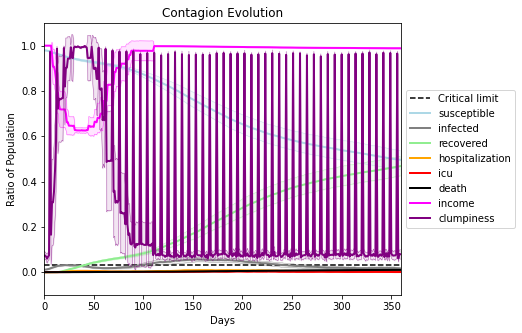

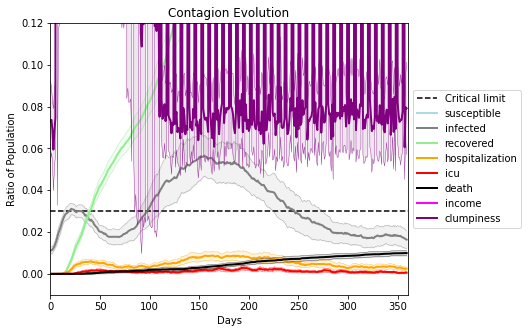

In [9]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.996
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8653, 4152, 1220, 2351, 3844, 6820, 2536, 2274, 1655, 8770, 6512, 2996, 3600, 5021, 3044, 5771, 6518, 8072, 165, 4350]
Average similarity between family members is 0.9461457834321401 at temperature -0.995
Average similarity between family and home is 0.9998495294663575 at temperature -1
Average similarity between students and their classroom is 0.6383931518463108 at temperature -0.995
Average classroom occupancy is 4.223880597014926 and number classrooms is 67
Average similarity between workers is 0.894138935940271 at temperature -0.995
Average office occupancy is 3.394871794871795 and number offices is 195
Average friend similarity for adults: 0.854737005995605 for kids: 0.7013586761581726
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.5516157338697105
avg restaurant similarity 0.6678010117813213
avg restaurant similarity 0.40250233852974804
avg restaurant similarity 0.4327220300573506
avg restaurant similarity 0.5913645516475041
avg restaurant similarity 0.3967246037535969
avg restaurant similarity 0.5464554926841767
avg restaurant similarity 0.5343315901998514
avg restaurant similarity 0.4709129971869667
avg restaurant similarity 0.6473937786283804
avg restaurant similarity 0.5245227936891581
avg restaurant similarity 0.5380470553921698
avg restaurant similarity 0.6074875832487522
avg restaurant similarity 0.602342103046462
avg restaurant similarity 0.5591738676264368
avg restaurant similarity 0.5532884954973422
avg restaurant similarity 0.4720392268857774
avg restaurant similarity 0.5664198811716067
avg restaurant similarity 0.5318397241648708
avg restaurant similarity 0.5128522265974015
avg restaurant similarity 0.41055266311622624
avg restaurant similarity 0.5703468554142589
avg resta

avg restaurant similarity 0.49810163085769493
avg restaurant similarity 0.5825431616770145
avg restaurant similarity 0.4848668205287879
avg restaurant similarity 0.6457917694232341
avg restaurant similarity 0.6044883569192561
avg restaurant similarity 0.5182670940427961
avg restaurant similarity 0.6370506822066484
avg restaurant similarity 0.6371354463888995
avg restaurant similarity 0.5969678534437836
avg restaurant similarity 0.5625250053044973
avg restaurant similarity 0.6548835893333576
avg restaurant similarity 0.4605077742820448
avg restaurant similarity 0.3532081037853985
avg restaurant similarity 0.6729863804522408
avg restaurant similarity 0.4941710569411416
avg restaurant similarity 0.38931172387127133
avg restaurant similarity 0.35007017621403064
avg restaurant similarity 0.493911190768028
avg restaurant similarity 0.5533408501632281
avg restaurant similarity 0.46595568128509374
avg restaurant similarity 0.04584243328919749
avg restaurant similarity 0.4635440546894097
avg re

avg restaurant similarity 0.5746172569361542
avg restaurant similarity 0.8097983390568054
avg restaurant similarity 0.8494481637606773
avg restaurant similarity 0.47199525739057707
avg restaurant similarity 0.5638602125287304
avg restaurant similarity 0.48590967395137535
avg restaurant similarity 0.569876730996369
avg restaurant similarity 0.7768263624967274
avg restaurant similarity 0.3829454651732601
avg restaurant similarity 0.639129711384625
avg restaurant similarity 0.7931724010901822
avg restaurant similarity 0.6633353305807522
avg restaurant similarity 0.6315670101444558
avg restaurant similarity 0.6513696410216772
avg restaurant similarity 0.6545746852014174
avg restaurant similarity 0.6255012986336073
avg restaurant similarity 0.4968317387808251
avg restaurant similarity 0.5680154084383252
avg restaurant similarity 0.4884481972566508
avg restaurant similarity 0.2700563714884242
avg restaurant similarity 0.5191282822794925
avg restaurant similarity 0.6361821951940402
avg restau

avg restaurant similarity 0.8300204627980327
avg restaurant similarity 0.6466556097104399
avg restaurant similarity 0.5789748611783105
avg restaurant similarity 0.5038748227373874
avg restaurant similarity 0.4727979312377725
avg restaurant similarity 0.22765749781214953
avg restaurant similarity 0.6928999257057411
avg restaurant similarity 0.5994113239290481
avg restaurant similarity 0.49402326795826956
avg restaurant similarity 0.4797615221781138
avg restaurant similarity 0.5217328518485577
avg restaurant similarity 0.49944150953424354
avg restaurant similarity 0.6674332673010004
avg restaurant similarity 0.4235363025990521
avg restaurant similarity 0.5026348862278227
avg restaurant similarity 0.5110187943594497
avg restaurant similarity 0.5846689935439728
avg restaurant similarity 0.5104543169810442
avg restaurant similarity 0.5459063399916715
avg restaurant similarity 0.5818393792473322
avg restaurant similarity 0.5962967627081597
avg restaurant similarity 0.592087224821886
avg rest

avg restaurant similarity 0.6452890149196643
avg restaurant similarity 0.6295162159876244
avg restaurant similarity 0.5987771734109705
avg restaurant similarity 0.5283853401309279
avg restaurant similarity 0.5361693981846518
avg restaurant similarity 0.4852829115898903
avg restaurant similarity 0.5950387158620428
avg restaurant similarity 0.5311750814034509
avg restaurant similarity 0.5408632178841134
avg restaurant similarity 0.6261861437913189
avg restaurant similarity 0.6954107074619292
avg restaurant similarity 0.6002967252617497
avg restaurant similarity 0.3469013088126011
avg restaurant similarity 0.5612252426952419
avg restaurant similarity 0.6771662180145938
avg restaurant similarity 0.6486951689584215
avg restaurant similarity 0.5479671940246761
avg restaurant similarity 0.5648248477879175
avg restaurant similarity 0.6689950304365775
avg restaurant similarity 0.4717363453849111
avg restaurant similarity 0.6307593397352838
avg restaurant similarity 0.8187578040549512
avg restau

avg restaurant similarity 0.62499532539863
avg restaurant similarity 0.6201451609363675
avg restaurant similarity 0.7499163549326018
avg restaurant similarity 0.5592913649679966
avg restaurant similarity 0.6767699708589892
avg restaurant similarity 0.6375489852218288
avg restaurant similarity 0.7317615113661177
avg restaurant similarity 0.512255333984502
avg restaurant similarity 0.4757133651317396
avg restaurant similarity 0.5752286948218661
avg restaurant similarity 0.6790438730138851
avg restaurant similarity 0.5113123309176825
avg restaurant similarity 0.5795459855246299
avg restaurant similarity 0.6376410841270232
avg restaurant similarity 0.5838628337253025
avg restaurant similarity 0.5514336688093859
avg restaurant similarity 0.5779340903393942
avg restaurant similarity 0.6852031545906813
avg restaurant similarity 0.5805635490878627
avg restaurant similarity 0.5669952472028951
avg restaurant similarity 0.5210272418652849
avg restaurant similarity 0.5765975223388993
avg restauran

avg restaurant similarity 0.5547915043818958
avg restaurant similarity 0.5619649519480038
avg restaurant similarity 0.6080362589341607
avg restaurant similarity 0.64186377379057
avg restaurant similarity 0.4485959018583426
avg restaurant similarity 0.5918720795412562
avg restaurant similarity 0.48261485028886675
avg restaurant similarity 0.5299463242574752
avg restaurant similarity 0.6697102251684436
avg restaurant similarity 0.4713220397226081
avg restaurant similarity 0.6734459395935521
avg restaurant similarity 0.6226295536050295
avg restaurant similarity 0.7241968682610516
avg restaurant similarity 0.41972080983247323
avg restaurant similarity 0.6967855568994078
avg restaurant similarity 0.6133762349527005
avg restaurant similarity 0.9521476196302764
avg restaurant similarity 0.5277607778391291
avg restaurant similarity 0.6166899072754399
avg restaurant similarity 0.7096648706662806
avg restaurant similarity 0.772900329952744
avg restaurant similarity 0.5517486916266108
avg restaur

avg restaurant similarity 0.4731132186441102
avg restaurant similarity 0.4389808739532228
avg restaurant similarity 0.7185018567250344
avg restaurant similarity 0.6100864226133966
avg restaurant similarity 0.4706166002924216
avg restaurant similarity 0.7145521866759115
avg restaurant similarity 0.4979953865048833
avg restaurant similarity 0.37858857698373827
avg restaurant similarity 0.37858857698373827
avg restaurant similarity 0.4836054642127681
avg restaurant similarity 0.8698370740710049
avg restaurant similarity 0.6384635991550455
avg restaurant similarity 0.4647359480780077
avg restaurant similarity 0.6226491168047117
avg restaurant similarity 0.6292798584161585
avg restaurant similarity 0.47920433868338486
avg restaurant similarity 0.7611321105906247
avg restaurant similarity 0.5069480355495346
avg restaurant similarity 0.49272891087210485
avg restaurant similarity 0.6254698809659193
avg restaurant similarity 0.5199137206936448
avg restaurant similarity 0.61877990917666
avg rest

avg restaurant similarity 0.49999083982797404
avg restaurant similarity 0.6292168723234411
avg restaurant similarity 0.45477109332405596
avg restaurant similarity 0.4178849389409052
avg restaurant similarity 0.5938722570859089
avg restaurant similarity 0.5974829083684587
avg restaurant similarity 0.5360997966955853
avg restaurant similarity 0.6342000505216848
avg restaurant similarity 0.9098119499057296
avg restaurant similarity 0.5205814186919157
avg restaurant similarity 0.43124260156874816
avg restaurant similarity 0.6186415654533934
avg restaurant similarity 0.43615758033260055
avg restaurant similarity 0.5548513367841696
avg restaurant similarity 0.6512731664312564
avg restaurant similarity 0.5550035848483205
avg restaurant similarity 0.6364958241885591
avg restaurant similarity 0.6036762808705426
avg restaurant similarity 0.5306510580317092
avg restaurant similarity 0.8132915171260265
avg restaurant similarity 0.7496327262099061
avg restaurant similarity 0.5620283082441218
avg re

avg restaurant similarity 0.5780408545394637
avg restaurant similarity 0.5219251972718395
avg restaurant similarity 0.5036411448005407
avg restaurant similarity 0.6013264527639757
avg restaurant similarity 0.5010384041693934
avg restaurant similarity 0.4532690297448725
avg restaurant similarity 0.7595912193488842
avg restaurant similarity 0.6297658775231925
avg restaurant similarity 0.5051213164589459
avg restaurant similarity 0.5523707733684162
avg restaurant similarity 0.36666264666138204
avg restaurant similarity 0.529250657647468
avg restaurant similarity 0.659188157679539
avg restaurant similarity 0.4744565499166643
avg restaurant similarity 0.6284728042207732
avg restaurant similarity 0.5711632648748196
avg restaurant similarity 0.5143864152401875
avg restaurant similarity 0.5654111105972126
avg restaurant similarity 0.5212200830626674
avg restaurant similarity 0.5691280058664893
avg restaurant similarity 0.530445926119435
avg restaurant similarity 0.7207154130691396
avg restaura

avg restaurant similarity 0.470181254624059
avg restaurant similarity 0.5329712192769241
avg restaurant similarity 0.48897549032127086
avg restaurant similarity 0.7109986964434162
avg restaurant similarity 0.5418115169666663
avg restaurant similarity 0.5331166685101666
avg restaurant similarity 0.5652456724410634
avg restaurant similarity 0.6071880757717161
avg restaurant similarity 0.822960688643598
avg restaurant similarity 0.5832436182278338
avg restaurant similarity 0.6276727299072035
avg restaurant similarity 0.6522582481447524
avg restaurant similarity 0.5512362682680751
avg restaurant similarity 0.5982944515063202
avg restaurant similarity 0.5438513674992115
avg restaurant similarity 0.6392000883775242
avg restaurant similarity 0.5544542629034386
avg restaurant similarity 0.46725787841396915
avg restaurant similarity 0.6414503740403235
avg restaurant similarity 0.40446973477674836
avg restaurant similarity 0.5411352405124521
avg restaurant similarity 0.726915934283437
avg restau

avg restaurant similarity 0.6075115553647829
avg restaurant similarity 0.6827049370065504
avg restaurant similarity 0.5772638863632222
avg restaurant similarity 0.48546074984504123
avg restaurant similarity 0.5236910360597506
avg restaurant similarity 0.5233668090304857
avg restaurant similarity 0.5236910360597506
avg restaurant similarity 0.6027822033249174
avg restaurant similarity 0.5500967241743872
avg restaurant similarity 0.6132600660717775
avg restaurant similarity 0.43640896595720324
avg restaurant similarity 0.5879136991089682
avg restaurant similarity 0.602047325145155
avg restaurant similarity 0.7918741919700668
avg restaurant similarity 0.7236679312738271
avg restaurant similarity 0.6237184065648917
avg restaurant similarity 0.8297475782632713
avg restaurant similarity 0.49368671190955826
avg restaurant similarity 0.7469881482094223
avg restaurant similarity 0.565440566580732
avg restaurant similarity 0.7083291198678388
avg restaurant similarity 0.5925513807690965
avg resta

avg restaurant similarity 0.5865985642403078
avg restaurant similarity 0.6665149504396102
avg restaurant similarity 0.5590749968218641
avg restaurant similarity 0.6442021605199398
avg restaurant similarity 0.3845941093686361
avg restaurant similarity 0.3979046581723006
avg restaurant similarity 0.6887213441510339
avg restaurant similarity 0.5383518320987734
avg restaurant similarity 0.6408833813370245
avg restaurant similarity 0.6549200293065119
avg restaurant similarity 0.6298175016916829
avg restaurant similarity 0.5272780591647743
avg restaurant similarity 0.5795348490629352
avg restaurant similarity 0.9997109527437222
avg restaurant similarity 0.5790455873029501
avg restaurant similarity 0.8982923175548316
avg restaurant similarity 0.7322342425471815
avg restaurant similarity 0.7189902695435713
avg restaurant similarity 0.6989669389736717
avg restaurant similarity 0.8373169050401832
avg restaurant similarity 0.6436887481512583
avg restaurant similarity 0.5893707748366633
avg restau

avg restaurant similarity 0.5775290404975355
avg restaurant similarity 0.49889748541980194
avg restaurant similarity 0.4391085953360122
avg restaurant similarity 0.657157859148132
avg restaurant similarity 0.8743406735598528
avg restaurant similarity 0.6700559340182534
avg restaurant similarity 0.8972290257110974
avg restaurant similarity 0.6333212101019151
avg restaurant similarity 0.5820045401864538
avg restaurant similarity 0.6398458860065063
avg restaurant similarity 0.5568606634641914
avg restaurant similarity 0.6938972972992756
avg restaurant similarity 0.6075190089765612
avg restaurant similarity 0.9214656624388085
avg restaurant similarity 0.5418453196075526
avg restaurant similarity 0.7120526316177549
avg restaurant similarity 0.5414416308372485
avg restaurant similarity 0.4441945807451896
avg restaurant similarity 0.6363834145033777
avg restaurant similarity 0.42428728339964306
avg restaurant similarity 0.7929904429817625
avg restaurant similarity 0.7056843908957415
avg resta

avg restaurant similarity 0.6399886993129635
avg restaurant similarity 0.5815015812993497
avg restaurant similarity 0.5769321072252931
avg restaurant similarity 0.60439444316851
avg restaurant similarity 0.6558249107557207
avg restaurant similarity 0.509389727549787
avg restaurant similarity 0.6279470739056594
avg restaurant similarity 0.6084362021118936
avg restaurant similarity 0.44252996515611825
avg restaurant similarity 0.3369668697802754
avg restaurant similarity 0.6474543168800178
avg restaurant similarity 0.5877818113134049
avg restaurant similarity 0.579246320515902
avg restaurant similarity 0.5732508736221363
avg restaurant similarity 0.6246728904084271
avg restaurant similarity 0.6897313426966432
avg restaurant similarity 0.643910003590092
avg restaurant similarity 0.5657319257210985
avg restaurant similarity 0.517788392347953
avg restaurant similarity 0.4801336347456919
avg restaurant similarity 0.6953466104783815
avg restaurant similarity 0.4747328193784219
avg restaurant 

avg restaurant similarity 0.7313602759233864
avg restaurant similarity 0.5434183752816445
avg restaurant similarity 0.36400319436827805
avg restaurant similarity 0.6292438045857718
avg restaurant similarity 0.6516065233837375
avg restaurant similarity 0.5676850089075739
avg restaurant similarity 0.7743404486839273
avg restaurant similarity 0.6298979247658102
avg restaurant similarity 0.5227721925587412
avg restaurant similarity 0.5599192390674214
avg restaurant similarity 0.6723911361525214
avg restaurant similarity 0.6809875184587165
avg restaurant similarity 0.7943587759975432
avg restaurant similarity 0.5671509812976618
avg restaurant similarity 0.7124160578442512
avg restaurant similarity 0.7428003927156648
avg restaurant similarity 0.6594678407900803
avg restaurant similarity 0.6620989178221978
avg restaurant similarity 0.6615695226207978
avg restaurant similarity 0.5844699226219927
avg restaurant similarity 0.5555439455880574
avg restaurant similarity 0.6296781991123969
avg resta

avg restaurant similarity 0.48154956641521596
avg restaurant similarity 0.425061588318812
avg restaurant similarity 0.566887144738572
avg restaurant similarity 0.5677439618045881
avg restaurant similarity 0.5234510937343828
avg restaurant similarity 0.5502480547927651
avg restaurant similarity 0.4639678002123514
avg restaurant similarity 0.7035111736734209
avg restaurant similarity 0.80073238681161
avg restaurant similarity 0.6237605150067105
avg restaurant similarity 0.594592074742246
avg restaurant similarity 0.614898574681084
avg restaurant similarity 0.5947927520223291
avg restaurant similarity 0.5332612927295145
avg restaurant similarity 0.437889893835823
avg restaurant similarity 0.3994953278334929
avg restaurant similarity 0.5846717525400369
avg restaurant similarity 0.5818198474068447
avg restaurant similarity 0.6275315972918255
avg restaurant similarity 0.6115264929317874
avg restaurant similarity 0.866821643593138
avg restaurant similarity 0.6090833350865109
avg restaurant si

avg restaurant similarity 0.37645645575538617
avg restaurant similarity 0.6717712659012148
avg restaurant similarity 0.4885884145649706
avg restaurant similarity 0.5522226033612602
avg restaurant similarity 0.48551318693445383
avg restaurant similarity 0.5907401662879598
avg restaurant similarity 0.4754418565641259
avg restaurant similarity 0.7475299020554194
avg restaurant similarity 0.4183009735681278
avg restaurant similarity 0.5974538302701367
avg restaurant similarity 0.5465971629795677
avg restaurant similarity 0.6989876673956712
avg restaurant similarity 0.5985259617911904
avg restaurant similarity 0.5495040575620265
avg restaurant similarity 0.6867504994707546
avg restaurant similarity 0.8235656021588862
avg restaurant similarity 0.4969537946868356
avg restaurant similarity 0.524761584401926
avg restaurant similarity 0.553900579479462
avg restaurant similarity 0.5297404034587763
avg restaurant similarity 0.5259927728092725
avg restaurant similarity 0.6439208077061779
avg restau

avg restaurant similarity 0.5635035935964058
avg restaurant similarity 0.7343885946691837
avg restaurant similarity 0.5650680942818381
avg restaurant similarity 0.5783044168940195
avg restaurant similarity 0.6137293970731384
avg restaurant similarity 0.5559485406771344
avg restaurant similarity 0.4677043286315192
avg restaurant similarity 0.3267031467061703
avg restaurant similarity 0.5253556980124624
avg restaurant similarity 0.5678313606913155
avg restaurant similarity 0.47933113684759626
avg restaurant similarity 0.5690151448386063
avg restaurant similarity 0.4975375238469875
avg restaurant similarity 0.5484592549625927
avg restaurant similarity 0.3515364369263622
avg restaurant similarity 0.526980080939466
avg restaurant similarity 0.5530935758172307
avg restaurant similarity 0.708089340240604
avg restaurant similarity 0.63206565416871
avg restaurant similarity 0.601393541828431
avg restaurant similarity 0.7361108154103255
avg restaurant similarity 0.46183201339410707
avg restauran

avg restaurant similarity 0.4683887426753907
avg restaurant similarity 0.34634445864624214
avg restaurant similarity 0.5374462025903842
avg restaurant similarity 0.7089247694863341
avg restaurant similarity 0.32303717938444343
avg restaurant similarity 0.6796675987348444
avg restaurant similarity 0.5768302757198862
avg restaurant similarity 0.67673056226088
avg restaurant similarity 0.43735104727622093
avg restaurant similarity 0.5655602551416222
avg restaurant similarity 0.5829493394094545
avg restaurant similarity 0.5648657910890786
avg restaurant similarity 0.5157791993857423
avg restaurant similarity 0.6118451058823637
avg restaurant similarity 0.5033569729353624
avg restaurant similarity 0.5236886837542766
avg restaurant similarity 0.9995521387485271
avg restaurant similarity 0.45687021651102416
avg restaurant similarity 0.603842121222324
avg restaurant similarity 0.5815086370165541
avg restaurant similarity 0.48722347090472395
avg restaurant similarity 0.5040508591627971
avg rest

avg restaurant similarity 0.5182440476172259
avg restaurant similarity 0.47788249563547414
avg restaurant similarity 0.6522224780891255
avg restaurant similarity 0.7659833274041413
avg restaurant similarity 0.38029811724329254
avg restaurant similarity 0.4903345065567508
avg restaurant similarity 0.4611017829885696
avg restaurant similarity 0.6815072780070127
avg restaurant similarity 0.533151220029796
avg restaurant similarity 0.7578050078395961
avg restaurant similarity 0.4777668364901125
avg restaurant similarity 0.6557040200939428
avg restaurant similarity 0.7223193386340103
avg restaurant similarity 0.5495212281059015
avg restaurant similarity 0.4999083830059774
avg restaurant similarity 0.38134857095097824
avg restaurant similarity 0.5597844072704549
avg restaurant similarity 0.6771900376535043
avg restaurant similarity 0.4943926275797963
avg restaurant similarity 0.633989424518035
avg restaurant similarity 0.41652510935775744
avg restaurant similarity 0.6290828692455739
avg rest

avg restaurant similarity 0.5651522859165511
avg restaurant similarity 0.3684693796172103
avg restaurant similarity 0.400086282427796
avg restaurant similarity 0.8106376322985851
avg restaurant similarity 0.6304679648677376
avg restaurant similarity 0.6950372055697306
avg restaurant similarity 0.51466281234037
avg restaurant similarity 0.4873961710159042
avg restaurant similarity 0.5165747893960332
avg restaurant similarity 0.587378482249869
avg restaurant similarity 0.5096891320837369
avg restaurant similarity 0.5767444899342874
avg restaurant similarity 0.8463344414382128
avg restaurant similarity 0.6650570313284624
avg restaurant similarity 0.5685272617786008
avg restaurant similarity 0.677599136614081
avg restaurant similarity 0.5530724980039986
avg restaurant similarity 0.3764503177361682
avg restaurant similarity 0.4648799166777499
avg restaurant similarity 0.45483214839529995
avg restaurant similarity 0.5907482056744799
avg restaurant similarity 0.46887118118414617
avg restauran

avg restaurant similarity 0.6259202866210778
avg restaurant similarity 0.6126054403222947
avg restaurant similarity 0.6789066258921579
avg restaurant similarity 0.5884708256963282
avg restaurant similarity 0.6508074153994907
avg restaurant similarity 0.6683464139814497
avg restaurant similarity 0.6572167035264479
avg restaurant similarity 0.6168132782348574
avg restaurant similarity 0.6501731509405865
avg restaurant similarity 0.45229300988260696
avg restaurant similarity 0.5358555914918446
avg restaurant similarity 0.4410775436533077
avg restaurant similarity 0.6752404249729328
avg restaurant similarity 0.999598130495382
avg restaurant similarity 0.6476136665914457
avg restaurant similarity 0.7071498625310148
avg restaurant similarity 0.6790307787592552
avg restaurant similarity 0.6874385621115134
avg restaurant similarity 0.9998370908656857
avg restaurant similarity 0.6244363203810389
avg restaurant similarity 0.6722668972247521
avg restaurant similarity 0.5524702396182887
avg restau

avg restaurant similarity 0.6055676671573483
avg restaurant similarity 0.6260994048145351
avg restaurant similarity 0.7511851997782367
avg restaurant similarity 0.5621749335731272
avg restaurant similarity 0.7331179478916925
avg restaurant similarity 0.769095186001812
avg restaurant similarity 0.6821810223931586
avg restaurant similarity 0.5808860478433581
avg restaurant similarity 0.6690052935396006
avg restaurant similarity 0.7741243794459592
avg restaurant similarity 0.626468276154357
avg restaurant similarity 0.4641109700201641
avg restaurant similarity 0.784626587765848
avg restaurant similarity 0.6154343084362658
avg restaurant similarity 0.6790410899742273
avg restaurant similarity 0.7803733884725124
avg restaurant similarity 0.5078912299490694
avg restaurant similarity 0.5985510792268381
avg restaurant similarity 0.5568150761868913
avg restaurant similarity 0.5242821276048832
avg restaurant similarity 0.7621041472603324
avg restaurant similarity 0.5770747428471986
avg restauran

avg restaurant similarity 0.5822331762877848
avg restaurant similarity 0.6086694787330477
avg restaurant similarity 0.5687742426690565
avg restaurant similarity 0.7195169037728303
avg restaurant similarity 0.5473894637469653
avg restaurant similarity 0.6784114901550798
avg restaurant similarity 0.5081568514763158
avg restaurant similarity 0.552187367937322
avg restaurant similarity 0.5103960450687294
avg restaurant similarity 0.5144883737386301
avg restaurant similarity 0.5888456914283511
avg restaurant similarity 0.6760471824332851
avg restaurant similarity 0.5778302360444266
avg restaurant similarity 0.6038676486545936
avg restaurant similarity 0.5713864689712889
avg restaurant similarity 0.5977985842453601
avg restaurant similarity 0.6091271569706671
avg restaurant similarity 0.5737930284961127
avg restaurant similarity 0.4991449601511274
avg restaurant similarity 0.4971394343841287
avg restaurant similarity 0.545148272766108
avg restaurant similarity 0.6240401199353833
avg restaura

avg restaurant similarity 0.645641399040616
avg restaurant similarity 0.6053921012258286
avg restaurant similarity 0.6099696336351148
avg restaurant similarity 0.7510754908701807
avg restaurant similarity 0.5674825114605242
avg restaurant similarity 0.5515565239744692
avg restaurant similarity 0.5971611359287905
avg restaurant similarity 0.414620927155386
avg restaurant similarity 0.5714156162552659
avg restaurant similarity 0.5470814233408144
avg restaurant similarity 0.5828892537366673
avg restaurant similarity 0.5826833388431167
avg restaurant similarity 0.6739786093087289
avg restaurant similarity 0.6961632634871786
avg restaurant similarity 0.5459167274812277
avg restaurant similarity 0.6517178645874844
avg restaurant similarity 0.6253173642221148
avg restaurant similarity 0.5444389371399129
avg restaurant similarity 0.4981995199856535
avg restaurant similarity 0.5334415078761312
avg restaurant similarity 0.517590547037356
avg restaurant similarity 0.6046497425841912
avg restauran

avg restaurant similarity 0.6131045610180135
avg restaurant similarity 0.537837578196887
avg restaurant similarity 0.62883388449019
avg restaurant similarity 0.5120577143671592
avg restaurant similarity 0.6582713495125708
avg restaurant similarity 0.5314452757627581
avg restaurant similarity 0.5399589011527675
avg restaurant similarity 0.6040153328476117
avg restaurant similarity 0.45790770577870465
avg restaurant similarity 0.19326766394145703
avg restaurant similarity 0.48205171727330387
avg restaurant similarity 0.6709131557545074
avg restaurant similarity 0.5587826506430374
avg restaurant similarity 0.5522241938536641
avg restaurant similarity 0.6430155112227012
avg restaurant similarity 0.47815902899208435
avg restaurant similarity 0.4815857382786716
avg restaurant similarity 0.6034004211563022
avg restaurant similarity 0.5419480919753278
avg restaurant similarity 0.6974882559641405
avg restaurant similarity 0.7095727669587558
avg restaurant similarity 0.5965375079519845
avg resta

avg restaurant similarity 0.6575633519987225
avg restaurant similarity 0.7217782306987378
avg restaurant similarity 0.5899662453216833
avg restaurant similarity 0.5897707873237618
avg restaurant similarity 0.5553438337921621
avg restaurant similarity 0.6837524372934227
avg restaurant similarity 0.5546330469835192
avg restaurant similarity 0.707367058409177
avg restaurant similarity 0.4326954811424968
avg restaurant similarity 0.782984985137078
avg restaurant similarity 0.6342293776016338
avg restaurant similarity 0.6788054492497475
avg restaurant similarity 0.688835787861464
avg restaurant similarity 0.7976317286310934
avg restaurant similarity 0.5450360146899977
avg restaurant similarity 0.6902912679877125
avg restaurant similarity 0.6165611366886178
avg restaurant similarity 0.637154108025037
avg restaurant similarity 0.6604770988135237
avg restaurant similarity 0.5560804844726276
avg restaurant similarity 0.5041708931130527
avg restaurant similarity 0.5620656614852991
avg restaurant

avg restaurant similarity 0.5939675763464447
avg restaurant similarity 0.637863468665402
avg restaurant similarity 0.5903318764961153
avg restaurant similarity 0.5065486093918309
avg restaurant similarity 0.5248588706734736
avg restaurant similarity 0.9322008078210349
avg restaurant similarity 0.5957065252645393
avg restaurant similarity 0.560529845676545
avg restaurant similarity 0.6626287368173484
avg restaurant similarity 0.47857540574630336
avg restaurant similarity 0.7790263175965974
avg restaurant similarity 0.5782554787325048
avg restaurant similarity 0.8118219681066705
avg restaurant similarity 0.49777063208637573
avg restaurant similarity 0.5909625136617254
avg restaurant similarity 0.7207997933035436
avg restaurant similarity 0.8311158841398031
avg restaurant similarity 0.39176297993707343
avg restaurant similarity 0.8232037072103316
avg restaurant similarity 0.7963850131771435
avg restaurant similarity 0.5146646925072668
avg restaurant similarity 0.5747027596075495
avg resta

avg restaurant similarity 0.7780145493777869
avg restaurant similarity 0.6799377210130593
avg restaurant similarity 0.6278512912720882
avg restaurant similarity 0.6971845313766355
avg restaurant similarity 0.5025562110952375
avg restaurant similarity 0.8173212865820716
avg restaurant similarity 0.7196883161303246
avg restaurant similarity 0.53310439556771
avg restaurant similarity 0.933362422228446
avg restaurant similarity 0.999647588531458
avg restaurant similarity 0.6761421954829909
avg restaurant similarity 0.4976944456324222
avg restaurant similarity 0.38808136903224455
avg restaurant similarity 0.7845665969154805
avg restaurant similarity 0.6292770316902965
avg restaurant similarity 0.45254669907707734
avg restaurant similarity 0.4065528287215172
avg restaurant similarity 0.7256387469934766
avg restaurant similarity 0.5415538857457651
avg restaurant similarity 0.37182942770600036
avg restaurant similarity 0.5711034334681823
avg restaurant similarity 0.47145404450363376
avg restau

avg restaurant similarity 0.5422540209603904
avg restaurant similarity 0.5983521906317724
avg restaurant similarity 0.763713657462352
avg restaurant similarity 0.6307020946732985
avg restaurant similarity 0.58929166682511
avg restaurant similarity 0.6463385995797719
avg restaurant similarity 0.5775342600806938
avg restaurant similarity 0.589498667405803
avg restaurant similarity 0.6745733319089848
avg restaurant similarity 0.5119451342631829
avg restaurant similarity 0.6744418034085682
avg restaurant similarity 0.756905294736443
avg restaurant similarity 0.7291202904822723
avg restaurant similarity 0.5913903423661234
avg restaurant similarity 0.6167709512383104
avg restaurant similarity 0.5684468957745921
avg restaurant similarity 0.7377558092364861
avg restaurant similarity 0.5494380228214834
avg restaurant similarity 0.37988735055891865
avg restaurant similarity 0.5309138880393661
avg restaurant similarity 0.678840640313813
avg restaurant similarity 0.6786389407742643
avg restaurant 

avg restaurant similarity 0.6288782516957678
avg restaurant similarity 0.6620488030428952
avg restaurant similarity 0.674119001494823
avg restaurant similarity 0.7693217556696386
avg restaurant similarity 0.6866471541428981
avg restaurant similarity 0.4698161325841796
avg restaurant similarity 0.5905110853386245
avg restaurant similarity 0.628754389666353
avg restaurant similarity 0.5813033411483585
avg restaurant similarity 0.5817695444979941
avg restaurant similarity 0.6556136608950592
avg restaurant similarity 0.6245152050417867
avg restaurant similarity 0.6371406508017223
avg restaurant similarity 0.769466895382079
avg restaurant similarity 0.5630177051801264
avg restaurant similarity 0.48863502982249707
avg restaurant similarity 0.6124550033483138
avg restaurant similarity 0.6766761751226199
avg restaurant similarity 0.6330742999279908
avg restaurant similarity 0.6450356601056693
avg restaurant similarity 0.5112917829331556
avg restaurant similarity 0.5081557274353597
avg restaura

avg restaurant similarity 0.4955961174392227
avg restaurant similarity 0.5245951169355718
avg restaurant similarity 0.603566327439668
avg restaurant similarity 0.613111262739131
avg restaurant similarity 0.5306976534786255
avg restaurant similarity 0.5588652624218898
avg restaurant similarity 0.4530521775668146
avg restaurant similarity 0.6239236880690583
avg restaurant similarity 0.60660435882018
avg restaurant similarity 0.5092955764191497
avg restaurant similarity 0.6533523999975985
avg restaurant similarity 0.4647972227703425
avg restaurant similarity 0.45756968496447736
avg restaurant similarity 0.6289718746489186
avg restaurant similarity 0.31467129746150646
avg restaurant similarity 0.5545074958813452
avg restaurant similarity 0.7169844638524225
avg restaurant similarity 0.688172753204628
avg restaurant similarity 0.5356029989105462
avg restaurant similarity 0.5751463352113382
avg restaurant similarity 0.6013164896779161
avg restaurant similarity 0.6263696728531881
avg restauran

avg restaurant similarity 0.49472794305639756
avg restaurant similarity 0.5868275000477202
avg restaurant similarity 0.6226957175775647
avg restaurant similarity 0.5134379517677764
avg restaurant similarity 0.5790856710610532
avg restaurant similarity 0.657835118282859
avg restaurant similarity 0.5973099276611579
avg restaurant similarity 0.8466943124803628
avg restaurant similarity 0.5713258123833894
avg restaurant similarity 0.7246906357727442
avg restaurant similarity 0.830385542812029
avg restaurant similarity 0.7941804096539
avg restaurant similarity 0.6459489412526077
avg restaurant similarity 0.6424218011452473
avg restaurant similarity 0.5761294489760401
avg restaurant similarity 0.6233711967479869
avg restaurant similarity 0.5409623838286831
avg restaurant similarity 0.49977240983738447
avg restaurant similarity 0.7943254199547048
avg restaurant similarity 0.6520108218620241
avg restaurant similarity 0.5143815033332942
avg restaurant similarity 0.5038792946616759
avg restauran

avg restaurant similarity 0.519017732366774
avg restaurant similarity 0.668760980009526
avg restaurant similarity 0.57927826911227
avg restaurant similarity 0.518676721572256
avg restaurant similarity 0.6157632829289733
avg restaurant similarity 0.7442456481511168
avg restaurant similarity 0.5242739678140087
avg restaurant similarity 0.6942316286064105
avg restaurant similarity 0.5684495735957278
avg restaurant similarity 0.5898121431707889
avg restaurant similarity 0.6293963211741361
avg restaurant similarity 0.7191392470595659
avg restaurant similarity 0.4980212821214918
avg restaurant similarity 0.47649782756029013
avg restaurant similarity 0.4991295160343539
avg restaurant similarity 0.5745152871837085
avg restaurant similarity 0.5287835640432406
avg restaurant similarity 0.4964477200703923
avg restaurant similarity 0.6358650185190544
avg restaurant similarity 0.8805078306934302
avg restaurant similarity 0.9997977798918557
avg restaurant similarity 0.6656719908249938
avg restaurant

avg restaurant similarity 0.6151777009150087
avg restaurant similarity 0.4589952559358006
avg restaurant similarity 0.3861964089760216
avg restaurant similarity 0.5941982696316774
avg restaurant similarity 0.6330102034430912
avg restaurant similarity 0.6675145541469318
avg restaurant similarity 0.5703763174666133
avg restaurant similarity 0.4485322850611451
avg restaurant similarity 0.6700537846413855
avg restaurant similarity 0.6557553017509427
avg restaurant similarity 0.5945271330767639
avg restaurant similarity 0.5090540440201
avg restaurant similarity 0.5164747820887566
avg restaurant similarity 0.5112539409986193
avg restaurant similarity 0.6779283921409396
avg restaurant similarity 0.5229241614432563
avg restaurant similarity 0.6368339802724439
avg restaurant similarity 0.6122946737979026
avg restaurant similarity 0.588528845137387
avg restaurant similarity 0.6020080129562569
avg restaurant similarity 0.5861050754050247
avg restaurant similarity 0.5111317206988404
avg restaurant

avg restaurant similarity 0.39224555053759025
avg restaurant similarity 0.3503892937890853
avg restaurant similarity 0.6114265476441003
avg restaurant similarity 0.4590778604096758
avg restaurant similarity 0.7185022128495077
avg restaurant similarity 0.5155686590736602
avg restaurant similarity 0.5747185127963675
avg restaurant similarity 0.49348995477044827
avg restaurant similarity 0.49215724519879456
avg restaurant similarity 0.5552925989067498
avg restaurant similarity 0.5826424054167436
avg restaurant similarity 0.5925506586424025
avg restaurant similarity 0.5907843624651017
avg restaurant similarity 0.6073250925383141
avg restaurant similarity 0.9995909892714312
avg restaurant similarity 0.7624863108809736
avg restaurant similarity 0.9996108461369451
avg restaurant similarity 0.5865853451804364
avg restaurant similarity 0.4257654417119297
avg restaurant similarity 0.46124124322110216
avg restaurant similarity 0.49424019760754234
avg restaurant similarity 0.5275089697169284
avg r

avg restaurant similarity 0.5481134294913291
avg restaurant similarity 0.433010918969452
avg restaurant similarity 0.48927353604922513
avg restaurant similarity 0.5116216871257528
avg restaurant similarity 0.40576860097799655
avg restaurant similarity 0.39238463766389076
avg restaurant similarity 0.4504965901479251
avg restaurant similarity 0.522550136625903
avg restaurant similarity 0.43763640402069903
avg restaurant similarity 0.4882427078735232
avg restaurant similarity 0.5689322740897524
avg restaurant similarity 0.6491697187789481
avg restaurant similarity 0.6052496381465229
avg restaurant similarity 0.648237633831698
avg restaurant similarity 0.5906781755393681
avg restaurant similarity 0.7051376996888039
avg restaurant similarity 0.4570797089285251
avg restaurant similarity 0.48013956434278815
avg restaurant similarity 0.5125566040015401
avg restaurant similarity 0.46635466024105326
avg restaurant similarity 0.46279578640372804
avg restaurant similarity 0.4809963540614044
avg re

avg restaurant similarity 0.7097680831659646
avg restaurant similarity 0.5729118422848323
avg restaurant similarity 0.6908215452124375
avg restaurant similarity 0.5662715054196701
avg restaurant similarity 0.6236437205491346
avg restaurant similarity 0.9993281446764377
avg restaurant similarity 0.5628349885329663
avg restaurant similarity 0.46201086963831806
avg restaurant similarity 0.6519005109928091
avg restaurant similarity 0.4914109485716943
avg restaurant similarity 0.28484485148936844
avg restaurant similarity 0.5044616864679337
avg restaurant similarity 0.5004431396997179
avg restaurant similarity 0.4095794074713017
avg restaurant similarity 0.6756079408219356
avg restaurant similarity 0.5767233799851492
avg restaurant similarity 0.5808793781251249
avg restaurant similarity 0.5280545952733968
avg restaurant similarity 0.5885338538535176
avg restaurant similarity 0.5313053360607186
avg restaurant similarity 0.6345441675614947
avg restaurant similarity 0.5305019415502769
avg rest

avg restaurant similarity 0.5747888737749581
avg restaurant similarity 0.45106527974106897
avg restaurant similarity 0.46122873150185373
avg restaurant similarity 0.5787492022040023
avg restaurant similarity 0.5806749846700718
avg restaurant similarity 0.387108977237544
avg restaurant similarity 0.6391673877415348
avg restaurant similarity 0.8562340242058908
avg restaurant similarity 0.5607812060481027
avg restaurant similarity 0.6567253499865654
avg restaurant similarity 0.5386154329102683
avg restaurant similarity 0.6505376886514905
avg restaurant similarity 0.5462447339831101
avg restaurant similarity 0.6711064574497514
avg restaurant similarity 0.6378316494246508
avg restaurant similarity 0.6413815448396609
avg restaurant similarity 0.5565828776496657
avg restaurant similarity 0.5121284654416336
avg restaurant similarity 0.5431063988242766
avg restaurant similarity 0.4953551618527144
avg restaurant similarity 0.6627961355751506
avg restaurant similarity 0.6373344274569445
avg resta

(<function dict.items>, <function dict.items>, <function dict.items>)

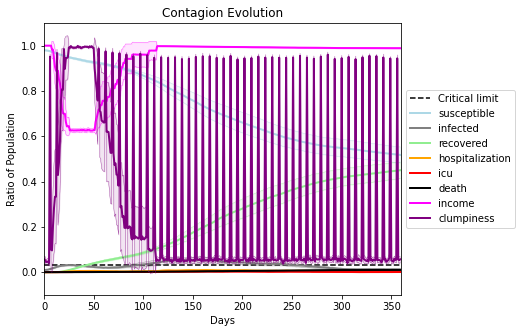

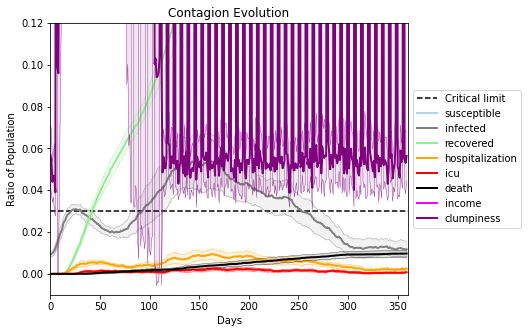

In [10]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.995
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[562, 7530, 2069, 4514, 8633, 3205, 6376, 9410, 8154, 6474, 6650, 9185, 4051, 8651, 5801, 4487, 6514, 1276, 6841, 2418]
Average similarity between family members is 0.9317596657149035 at temperature -0.994
Average similarity between family and home is 0.9998569780442811 at temperature -1
Average similarity between students and their classroom is 0.5734198284368144 at temperature -0.994
Average classroom occupancy is 4.246376811594203 and number classrooms is 69
Average similarity between workers is 0.886019871972297 at temperature -0.994
Average office occupancy is 3.375 and number offices is 192
Average friend similarity for adults: 0.8434460189170806 for kids: 0.67508755798713
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousB

avg restaurant similarity 0.359421089269151
avg restaurant similarity 0.4245427919605208
avg restaurant similarity 0.4725493182238609
avg restaurant similarity 0.8165967056097116
avg restaurant similarity 0.4668514657332208
avg restaurant similarity 0.526026917402947
avg restaurant similarity 0.49341491693963785
avg restaurant similarity 0.49425894219170735
avg restaurant similarity 0.4450795326607743
avg restaurant similarity 0.4504325224221191
avg restaurant similarity 0.654576445181039
avg restaurant similarity 0.44501419658514274
avg restaurant similarity 0.32951539654280104
avg restaurant similarity 0.524300629175529
avg restaurant similarity 0.8216251651450892
avg restaurant similarity 0.7734237764430412
avg restaurant similarity 0.5371294112532485
avg restaurant similarity 0.41941663005177005
avg restaurant similarity 0.49074078102179897
avg restaurant similarity 0.4691688477379035
avg restaurant similarity 0.595415348730968
avg restaurant similarity 0.36139576887165736
avg rest

avg restaurant similarity 0.379830427980183
avg restaurant similarity 0.698531348128103
avg restaurant similarity 0.43857357176647166
avg restaurant similarity 0.633982624589867
avg restaurant similarity 0.3752920886696775
avg restaurant similarity 0.4632925277375192
avg restaurant similarity 0.36964747112431295
avg restaurant similarity 0.5656594425994053
avg restaurant similarity 0.5244220067941987
avg restaurant similarity 0.536384082810968
avg restaurant similarity 0.5020067682941552
avg restaurant similarity 0.5501026814670265
avg restaurant similarity 0.48261729894925076
avg restaurant similarity 0.5269227697929072
avg restaurant similarity 0.4338200969296069
avg restaurant similarity 0.5193438112187061
avg restaurant similarity 0.5308543498425095
avg restaurant similarity 0.5238237387303231
avg restaurant similarity 0.47479543984637357
avg restaurant similarity 0.5411150832578171
avg restaurant similarity 0.8151134977070449
avg restaurant similarity 0.4266037096684242
avg restau

avg restaurant similarity 0.5276211249827635
avg restaurant similarity 0.5969479441663383
avg restaurant similarity 0.4743552122491775
avg restaurant similarity 0.5367052100037989
avg restaurant similarity 0.61840127860527
avg restaurant similarity 0.6374425746065286
avg restaurant similarity 0.5014821619439619
avg restaurant similarity 0.45876209432096254
avg restaurant similarity 0.39595169607939906
avg restaurant similarity 0.6559383988563037
avg restaurant similarity 0.5789463403520229
avg restaurant similarity 0.6641441520707589
avg restaurant similarity 0.6092583639171909
avg restaurant similarity 0.5422004506419251
avg restaurant similarity 0.6071330663936167
avg restaurant similarity 0.6976035648551407
avg restaurant similarity 0.5349241392033932
avg restaurant similarity 0.5810997552311655
avg restaurant similarity 0.6796150299290569
avg restaurant similarity 0.6546460000848187
avg restaurant similarity 0.5383444953437848
avg restaurant similarity 0.5518341219998696
avg restau

avg restaurant similarity 0.6704045247732004
avg restaurant similarity 0.5485170627795414
avg restaurant similarity 0.5071921821365116
avg restaurant similarity 0.6918207378076753
avg restaurant similarity 0.5339526016903428
avg restaurant similarity 0.40654592717765736
avg restaurant similarity 0.5908723799926765
avg restaurant similarity 0.6486189644847582
avg restaurant similarity 0.46043131914326896
avg restaurant similarity 0.5848752345649997
avg restaurant similarity 0.5625411535211727
avg restaurant similarity 0.6950658560644003
avg restaurant similarity 0.6422881200709454
avg restaurant similarity 0.71937908574927
avg restaurant similarity 0.6658009772678757
avg restaurant similarity 0.6495221544242535
avg restaurant similarity 0.48137978623649097
avg restaurant similarity 0.6628787815774863
avg restaurant similarity 0.625119178591823
avg restaurant similarity 0.5731167100849833
avg restaurant similarity 0.5999024710406899
avg restaurant similarity 0.4583473275152519
avg restau

avg restaurant similarity 0.56954107516192
avg restaurant similarity 0.5555210716739281
avg restaurant similarity 0.4748051752595678
avg restaurant similarity 0.43245171598060045
avg restaurant similarity 0.6991212557456247
avg restaurant similarity 0.6470219905966099
avg restaurant similarity 0.49722657949276544
avg restaurant similarity 0.6880722529519595
avg restaurant similarity 0.5439542836989022
avg restaurant similarity 0.7031980284286377
avg restaurant similarity 0.5479392736176724
avg restaurant similarity 0.6404917225485747
avg restaurant similarity 0.6065107348995527
avg restaurant similarity 0.49141485560411224
avg restaurant similarity 0.6586755618943514
avg restaurant similarity 0.6587000817500029
avg restaurant similarity 0.6887845882040393
avg restaurant similarity 0.7261255510869578
avg restaurant similarity 0.48062667091766126
avg restaurant similarity 0.7162014405149555
avg restaurant similarity 0.6082622572449972
avg restaurant similarity 0.5937535069027753
avg rest

avg restaurant similarity 0.5667885747989214
avg restaurant similarity 0.5240447184035371
avg restaurant similarity 0.7764409560109512
avg restaurant similarity 0.6747072040321291
avg restaurant similarity 0.5958636500688202
avg restaurant similarity 0.6728107720432378
avg restaurant similarity 0.6774144855327366
avg restaurant similarity 0.5721684047502593
avg restaurant similarity 0.6279062144026203
avg restaurant similarity 0.4080395152618776
avg restaurant similarity 0.7501813805722499
avg restaurant similarity 0.6188017498499662
avg restaurant similarity 0.43298173559921094
avg restaurant similarity 0.6548036937516256
avg restaurant similarity 0.5516461201897027
avg restaurant similarity 0.5848226479375078
avg restaurant similarity 0.722107637494002
avg restaurant similarity 0.5950919085979878
avg restaurant similarity 0.7085059793088014
avg restaurant similarity 0.6391351205515612
avg restaurant similarity 0.7220260911205066
avg restaurant similarity 0.6054153291356965
avg restau

avg restaurant similarity 0.5735764937390777
avg restaurant similarity 0.6253431553221255
avg restaurant similarity 0.4874297819310037
avg restaurant similarity 0.5418691842481048
avg restaurant similarity 0.6473921684703539
avg restaurant similarity 0.8177147475931852
avg restaurant similarity 0.5248448051189729
avg restaurant similarity 0.4696983410150368
avg restaurant similarity 0.5754791657653603
avg restaurant similarity 0.5939884376043739
avg restaurant similarity 0.502033987186912
avg restaurant similarity 0.6171519920224781
avg restaurant similarity 0.4407313136364247
avg restaurant similarity 0.5503224210549391
avg restaurant similarity 0.6789236262060669
avg restaurant similarity 0.7238437976902136
avg restaurant similarity 0.5516980676389667
avg restaurant similarity 0.5138578427955363
avg restaurant similarity 0.4748043488294839
avg restaurant similarity 0.5803581276512731
avg restaurant similarity 0.7418091711603705
avg restaurant similarity 0.5442268660478816
avg restaur

avg restaurant similarity 0.5521152568853517
avg restaurant similarity 0.8376782843673206
avg restaurant similarity 0.559014214861867
avg restaurant similarity 0.6208909608419572
avg restaurant similarity 0.6662996205917195
avg restaurant similarity 0.4704545503695984
avg restaurant similarity 0.5171219259683246
avg restaurant similarity 0.6958537873359439
avg restaurant similarity 0.5336560886513481
avg restaurant similarity 0.47306216801229706
avg restaurant similarity 0.5073532095363974
avg restaurant similarity 0.5089597778221304
avg restaurant similarity 0.41564299522444764
avg restaurant similarity 0.6558716392137849
avg restaurant similarity 0.549563501884329
avg restaurant similarity 0.46004870928502717
avg restaurant similarity 0.7070705470139133
avg restaurant similarity 0.5206040727437469
avg restaurant similarity 0.5987977168472273
avg restaurant similarity 0.7484335506720762
avg restaurant similarity 0.5014870502607354
avg restaurant similarity 0.36157561173154107
avg rest

avg restaurant similarity 0.5373860533465272
avg restaurant similarity 0.7830506169579747
avg restaurant similarity 0.5455693949722322
avg restaurant similarity 0.5016151630374818
avg restaurant similarity 0.6337790701661318
avg restaurant similarity 0.6203589302621985
avg restaurant similarity 0.5584092354313698
avg restaurant similarity 0.5791583556349994
avg restaurant similarity 0.4148423565504856
avg restaurant similarity 0.6326700018005134
avg restaurant similarity 0.5898099137531799
avg restaurant similarity 0.511010239029121
avg restaurant similarity 0.5530835975965811
avg restaurant similarity 0.5826281293754559
avg restaurant similarity 0.6732501429921146
avg restaurant similarity 0.7230203760274646
avg restaurant similarity 0.46427878460717353
avg restaurant similarity 0.5120364030901299
avg restaurant similarity 0.48945089918984463
avg restaurant similarity 0.48736305207371633
avg restaurant similarity 0.637388445677009
avg restaurant similarity 0.5287398452595108
avg resta

avg restaurant similarity 0.5068879501518011
avg restaurant similarity 0.6061153296699255
avg restaurant similarity 0.6309517316749294
avg restaurant similarity 0.47459150342316714
avg restaurant similarity 0.56876771801183
avg restaurant similarity 0.6018445973431303
avg restaurant similarity 0.8140977155222076
avg restaurant similarity 0.5959490490901959
avg restaurant similarity 0.6207373683634481
avg restaurant similarity 0.352102806415268
avg restaurant similarity 0.5565569772197962
avg restaurant similarity 0.65116116120289
avg restaurant similarity 0.6104785685060972
avg restaurant similarity 0.5882211850466151
avg restaurant similarity 0.5383342637262217
avg restaurant similarity 0.46520487470978783
avg restaurant similarity 0.6617442084586318
avg restaurant similarity 0.5193940748529802
avg restaurant similarity 0.5060158768395423
avg restaurant similarity 0.620849354504267
avg restaurant similarity 0.7277525195646453
avg restaurant similarity 0.3951477762104749
avg restaurant

avg restaurant similarity 0.4730450262375131
avg restaurant similarity 0.5799582959421647
avg restaurant similarity 0.5661575756695182
avg restaurant similarity 0.6918488500126009
avg restaurant similarity 0.7686757539547251
avg restaurant similarity 0.5675797762261914
avg restaurant similarity 0.43388610258374155
avg restaurant similarity 0.5306430000857022
avg restaurant similarity 0.4375610661823516
avg restaurant similarity 0.4544042437570868
avg restaurant similarity 0.5201797722730236
avg restaurant similarity 0.5432839016154538
avg restaurant similarity 0.5835259233999235
avg restaurant similarity 0.7155093159740619
avg restaurant similarity 0.619202791890706
avg restaurant similarity 0.7447602444688749
avg restaurant similarity 0.5652310909176625
avg restaurant similarity 0.6100818239865117
avg restaurant similarity 0.5581148858718161
avg restaurant similarity 0.4793626857093929
avg restaurant similarity 0.9814054252806361
avg restaurant similarity 0.41494943895779707
avg resta

avg restaurant similarity 0.6573950974473091
avg restaurant similarity 0.4849129326717261
avg restaurant similarity 0.6176153329115175
avg restaurant similarity 0.8341948707168558
avg restaurant similarity 0.5451179459732083
avg restaurant similarity 0.5429382851004803
avg restaurant similarity 0.6492860433753104
avg restaurant similarity 0.6560788735476443
avg restaurant similarity 0.4564765320949191
avg restaurant similarity 0.6153247849468061
avg restaurant similarity 0.5395997020750786
avg restaurant similarity 0.6107866766869758
avg restaurant similarity 0.6623228685877952
avg restaurant similarity 0.4106257475757765
avg restaurant similarity 0.4870680667328156
avg restaurant similarity 0.6838852109893607
avg restaurant similarity 0.5796553863691845
avg restaurant similarity 0.6756511743226159
avg restaurant similarity 0.63327071704165
avg restaurant similarity 0.6577563478717139
avg restaurant similarity 0.5803882918161561
avg restaurant similarity 0.43110591369782675
avg restaur

avg restaurant similarity 0.5279283965303859
avg restaurant similarity 0.4638466720405608
avg restaurant similarity 0.2928935954462094
avg restaurant similarity 0.6965275077404154
avg restaurant similarity 0.6139475712287198
avg restaurant similarity 0.6354226050322972
avg restaurant similarity 0.5881391735406295
avg restaurant similarity 0.6666135188875716
avg restaurant similarity 0.7655145137225108
avg restaurant similarity 0.5847446014143622
avg restaurant similarity 0.6007902681138371
avg restaurant similarity 0.46826407426243943
avg restaurant similarity 0.7144235856063238
avg restaurant similarity 0.4001706309282484
avg restaurant similarity 0.6597616277107347
avg restaurant similarity 0.3767885781466884
avg restaurant similarity 0.7074061767044562
avg restaurant similarity 0.4929133471623097
avg restaurant similarity 0.475730648079489
avg restaurant similarity 0.47473439088017433
avg restaurant similarity 0.7597601287645703
avg restaurant similarity 0.704877140150669
avg restau

avg restaurant similarity 0.6135745240331286
avg restaurant similarity 0.4272251455998637
avg restaurant similarity 0.6815589194787379
avg restaurant similarity 0.7335458702478794
avg restaurant similarity 0.6440499121637029
avg restaurant similarity 0.5112679034013708
avg restaurant similarity 0.41717295353760353
avg restaurant similarity 0.5629935948685475
avg restaurant similarity 0.6722228614846597
avg restaurant similarity 0.7905881403750745
avg restaurant similarity 0.6439091776729897
avg restaurant similarity 0.8078761167027773
avg restaurant similarity 0.8714108469719415
avg restaurant similarity 0.6112791562485633
avg restaurant similarity 0.2943863920305279
avg restaurant similarity 0.6696269781676467
avg restaurant similarity 0.510594455237007
avg restaurant similarity 0.8743326207834278
avg restaurant similarity 0.6211704277625515
avg restaurant similarity 0.5567477440020981
avg restaurant similarity 0.415073490646399
avg restaurant similarity 0.4492327618952201
avg restaur

avg restaurant similarity 0.4288662139510548
avg restaurant similarity 0.8663993773881472
avg restaurant similarity 0.5712723241395581
avg restaurant similarity 0.8492969748525322
avg restaurant similarity 0.2878222936394733
avg restaurant similarity 0.6683092287083351
avg restaurant similarity 0.5493864850622298
avg restaurant similarity 0.4696510976839071
avg restaurant similarity 0.3920954586073362
avg restaurant similarity 0.7941811764844371
avg restaurant similarity 0.8562953594460143
avg restaurant similarity 0.6312752143465031
avg restaurant similarity 0.7555919688703784
avg restaurant similarity 0.6343612224481645
avg restaurant similarity 0.47552585934262237
avg restaurant similarity 0.6488212680578315
avg restaurant similarity 0.6527865505208524
avg restaurant similarity 0.8149873261688594
avg restaurant similarity 0.5741190722045393
avg restaurant similarity 0.5474221534694486
avg restaurant similarity 0.5940833468187363
avg restaurant similarity 0.5491859552195485
avg resta

avg restaurant similarity 0.5669743074573842
avg restaurant similarity 0.6013859052427909
avg restaurant similarity 0.6576208513135057
avg restaurant similarity 0.5772031731365002
avg restaurant similarity 0.41731855608508445
avg restaurant similarity 0.5349904197586761
avg restaurant similarity 0.8691146952941147
avg restaurant similarity 0.5832058301538897
avg restaurant similarity 0.7136143469511778
avg restaurant similarity 0.8421768011704197
avg restaurant similarity 0.5591392129011262
avg restaurant similarity 0.6516267788417908
avg restaurant similarity 0.6297708856560665
avg restaurant similarity 0.9114132951526297
avg restaurant similarity 0.621568645679622
avg restaurant similarity 0.7607424969653747
avg restaurant similarity 0.4242827831658754
avg restaurant similarity 0.6100456192392554
avg restaurant similarity 0.5494366715015294
avg restaurant similarity 0.660347367425925
avg restaurant similarity 0.44493021458806703
avg restaurant similarity 0.5108491567289263
avg restau

avg restaurant similarity 0.7015804655313013
avg restaurant similarity 0.6571739701482814
avg restaurant similarity 0.6505670534520424
avg restaurant similarity 0.49068196086701604
avg restaurant similarity 0.6153968583881463
avg restaurant similarity 0.5220017164962558
avg restaurant similarity 0.5398885595544052
avg restaurant similarity 0.5563478688588691
avg restaurant similarity 0.6831338528738397
avg restaurant similarity 0.6148256733236103
avg restaurant similarity 0.6935342877191694
avg restaurant similarity 0.5540678657342557
avg restaurant similarity 0.5930020804569074
avg restaurant similarity 0.5571946862977268
avg restaurant similarity 0.37072027269817553
avg restaurant similarity 0.6936461778270123
avg restaurant similarity 0.6154076952974116
avg restaurant similarity 0.5524124445475244
avg restaurant similarity 0.49626570235472933
avg restaurant similarity 0.46281717607656503
avg restaurant similarity 0.49877966160706755
avg restaurant similarity 0.5803752142272985
avg r

avg restaurant similarity 0.4833539192244345
avg restaurant similarity 0.5790990134713478
avg restaurant similarity 0.4736664234879657
avg restaurant similarity 0.3519095174800908
avg restaurant similarity 0.6278381861634882
avg restaurant similarity 0.6838757372332082
avg restaurant similarity 0.5762196828690442
avg restaurant similarity 0.36467173201973063
avg restaurant similarity 0.6645949889959599
avg restaurant similarity 0.6829617789350084
avg restaurant similarity 0.6806043018180179
avg restaurant similarity 0.6079654138274679
avg restaurant similarity 0.4771403084074138
avg restaurant similarity 0.47221306120868967
avg restaurant similarity 0.5269835314838454
avg restaurant similarity 0.603117981802308
avg restaurant similarity 0.3893760383010548
avg restaurant similarity 0.5695595053660835
avg restaurant similarity 0.5830434206664571
avg restaurant similarity 0.5074326345369323
avg restaurant similarity 0.5018769346799505
avg restaurant similarity 0.6489911153804958
avg resta

avg restaurant similarity 0.5802070567354712
avg restaurant similarity 0.44252839602907446
avg restaurant similarity 0.438511052017646
avg restaurant similarity 0.4141803210005337
avg restaurant similarity 0.7880276737464943
avg restaurant similarity 0.5969481581637806
avg restaurant similarity 0.47358048721743307
avg restaurant similarity 0.501967588755268
avg restaurant similarity 0.6306166578923342
avg restaurant similarity 0.754371521281698
avg restaurant similarity 0.6285685106006254
avg restaurant similarity 0.9998775243079089
avg restaurant similarity 0.369049607762205
avg restaurant similarity 0.7028113193236567
avg restaurant similarity 0.5507806324521682
avg restaurant similarity 0.6555766553705552
avg restaurant similarity 0.6001641609692815
avg restaurant similarity 0.5341175087806712
avg restaurant similarity 0.712634154658463
avg restaurant similarity 0.562382422934536
avg restaurant similarity 0.6154915638657643
avg restaurant similarity 0.5598760118906985
avg restaurant

avg restaurant similarity 0.7419043440665815
avg restaurant similarity 0.5744964186272775
avg restaurant similarity 0.7609126810875217
avg restaurant similarity 0.5967520117729186
avg restaurant similarity 0.5308751797956179
avg restaurant similarity 0.5948018562500175
avg restaurant similarity 0.5263104433679252
avg restaurant similarity 0.5585537651280804
avg restaurant similarity 0.6454497802793355
avg restaurant similarity 0.7964354697960713
avg restaurant similarity 0.7549477695966565
avg restaurant similarity 0.5241516829673302
avg restaurant similarity 0.5032452070392052
avg restaurant similarity 0.5428791588983619
avg restaurant similarity 0.5340922829444811
avg restaurant similarity 0.5204695663191288
avg restaurant similarity 0.6211971605970239
avg restaurant similarity 0.6382693772666791
avg restaurant similarity 0.39499009681957054
avg restaurant similarity 0.4371892370191425
avg restaurant similarity 0.44688746609259855
avg restaurant similarity 0.6192546312974744
avg rest

avg restaurant similarity 0.6521667889396607
avg restaurant similarity 0.41176099012598155
avg restaurant similarity 0.46967435725819767
avg restaurant similarity 0.676273334557186
avg restaurant similarity 0.5913392955392216
avg restaurant similarity 0.8111185866256202
avg restaurant similarity 0.536607477182348
avg restaurant similarity 0.40154125138247587
avg restaurant similarity 0.6070637988488425
avg restaurant similarity 0.5278536365377468
avg restaurant similarity 0.6528797868744884
avg restaurant similarity 0.5925243802950556
avg restaurant similarity 0.6726709462814248
avg restaurant similarity 0.6908365135544748
avg restaurant similarity 0.6340104842796115
avg restaurant similarity 0.5718968522261667
avg restaurant similarity 0.6553483930566335
avg restaurant similarity 0.5677258357661255
avg restaurant similarity 0.44948046567408023
avg restaurant similarity 0.7749163652100304
avg restaurant similarity 0.5546988598680618
avg restaurant similarity 0.5886079438516564
avg rest

avg restaurant similarity 0.6859188335518418
avg restaurant similarity 0.6887221967428663
avg restaurant similarity 0.5329138850948375
avg restaurant similarity 0.6163295768642818
avg restaurant similarity 0.6953145458591562
avg restaurant similarity 0.5845027604987569
avg restaurant similarity 0.605262268357375
avg restaurant similarity 0.6927887338493193
avg restaurant similarity 0.8285504514020369
avg restaurant similarity 0.5694536022094536
avg restaurant similarity 0.704192085175236
avg restaurant similarity 0.6017435832604748
avg restaurant similarity 0.559730295628619
avg restaurant similarity 0.6891406268828817
avg restaurant similarity 0.45612076955652653
avg restaurant similarity 0.5961811944505004
avg restaurant similarity 0.429558409126841
avg restaurant similarity 0.6107141282125099
avg restaurant similarity 0.5211494957736776
avg restaurant similarity 0.6403510318898487
avg restaurant similarity 0.5516444290021654
avg restaurant similarity 0.6759184602411438
avg restauran

avg restaurant similarity 0.46373750090334054
avg restaurant similarity 0.6017050301157907
avg restaurant similarity 0.48390131586462065
avg restaurant similarity 0.5894185712035359
avg restaurant similarity 0.5781366092257191
avg restaurant similarity 0.7711165841184894
avg restaurant similarity 0.4149539817271581
avg restaurant similarity 0.7941294407145413
avg restaurant similarity 0.4261180843259789
avg restaurant similarity 0.6073296625654624
avg restaurant similarity 0.6282982641060827
avg restaurant similarity 0.47612821064438476
avg restaurant similarity 0.375977608757963
avg restaurant similarity 0.5921545227453453
avg restaurant similarity 0.8446549987819354
avg restaurant similarity 0.3378524420511204
avg restaurant similarity 0.5115312120564407
avg restaurant similarity 0.7926764823774444
avg restaurant similarity 0.6228930463407091
avg restaurant similarity 0.44620220057360305
avg restaurant similarity 0.7874970540663078
avg restaurant similarity 0.9997594500834797
avg res

avg restaurant similarity 0.6677628607923626
avg restaurant similarity 0.5583009352316681
avg restaurant similarity 0.5421098378164698
avg restaurant similarity 0.5428948830246152
avg restaurant similarity 0.6072174324642734
avg restaurant similarity 0.7095024130333647
avg restaurant similarity 0.5621995305246342
avg restaurant similarity 0.4979475757784383
avg restaurant similarity 0.8846590432083938
avg restaurant similarity 0.5615232945868922
avg restaurant similarity 0.62423849074693
avg restaurant similarity 0.6121254259230832
avg restaurant similarity 0.21422352802946423
avg restaurant similarity 0.6593010883609729
avg restaurant similarity 0.6559405431013483
avg restaurant similarity 0.71171532914655
avg restaurant similarity 0.4088336360255171
avg restaurant similarity 0.4225552774842017
avg restaurant similarity 0.5853901507404987
avg restaurant similarity 0.6532960127935967
avg restaurant similarity 0.6112091600782766
avg restaurant similarity 0.7150099463083877
avg restauran

avg restaurant similarity -0.005813695235756006
avg restaurant similarity 0.5600766029628826
avg restaurant similarity 0.751203478069945
avg restaurant similarity 0.6093788889824673
avg restaurant similarity 0.5957230471517846
avg restaurant similarity 0.717635946651475
avg restaurant similarity 0.28014280685821746
avg restaurant similarity 0.6329362792396236
avg restaurant similarity 0.909784461499235
avg restaurant similarity 0.5328911590688514
avg restaurant similarity 0.5757135672961358
avg restaurant similarity 0.5758450494935642
avg restaurant similarity 0.6271889344249468
avg restaurant similarity 0.6320933483656641
avg restaurant similarity 0.7083343744806807
avg restaurant similarity 0.5678911247355145
avg restaurant similarity 0.540670640055445
avg restaurant similarity 0.7903954149025108
avg restaurant similarity 0.999903911204685
avg restaurant similarity 0.8070008108003853
avg restaurant similarity 0.7401177954301749
avg restaurant similarity 0.40190505104677876
avg restau

avg restaurant similarity 0.5356510401105602
avg restaurant similarity 0.6089131144153755
avg restaurant similarity 0.5672638055067544
avg restaurant similarity 0.5814731417174372
avg restaurant similarity 0.726182480531958
avg restaurant similarity 0.37199411685254447
avg restaurant similarity 0.5405100405712969
avg restaurant similarity 0.5705063657855302
avg restaurant similarity 0.5902730127318303
avg restaurant similarity 0.4979259384286668
avg restaurant similarity 0.7378324202589233
avg restaurant similarity 0.39462979741716847
avg restaurant similarity 0.6056711314121501
avg restaurant similarity 0.5005921645319077
avg restaurant similarity 0.6406508372504913
avg restaurant similarity 0.8001683479413052
avg restaurant similarity 0.7181257626474958
avg restaurant similarity 0.6452713905569808
avg restaurant similarity 0.4941812614916486
avg restaurant similarity 0.7084147773854627
avg restaurant similarity 0.6916568294065452
avg restaurant similarity 0.5657314914537872
avg resta

avg restaurant similarity 0.6135783081630002
avg restaurant similarity 0.5323333004612505
avg restaurant similarity 0.459771296068924
avg restaurant similarity 0.6209102523186579
avg restaurant similarity 0.5672831530531411
avg restaurant similarity 0.47349186780063857
avg restaurant similarity 0.5548655374349412
avg restaurant similarity 0.6506430840264663
avg restaurant similarity 0.5900344344258193
avg restaurant similarity 0.846365507449226
avg restaurant similarity 0.9997974029929816
avg restaurant similarity 0.4813361951723099
avg restaurant similarity 0.6372756695144649
avg restaurant similarity 0.6305873406590032
avg restaurant similarity 0.807478517497352
avg restaurant similarity 0.5086692529956027
avg restaurant similarity 0.5469378497696978
avg restaurant similarity 0.42132679046778376
avg restaurant similarity 0.7840482314162495
avg restaurant similarity 0.6172436321253018
avg restaurant similarity 0.5639849239072975
avg restaurant similarity 0.5740062772578722
avg restaur

avg restaurant similarity 0.814292791801182
avg restaurant similarity 0.7716327885133754
avg restaurant similarity 0.5293023536576102
avg restaurant similarity 0.7317998010009185
avg restaurant similarity 0.5559252512807203
avg restaurant similarity 0.4030626222423267
avg restaurant similarity 0.7179895545162592
avg restaurant similarity 0.37313283482723664
avg restaurant similarity 0.4508402901555829
avg restaurant similarity 0.6186978002272494
avg restaurant similarity 0.5112710244400445
avg restaurant similarity 0.3744578677409936
avg restaurant similarity 0.45038334621177006
avg restaurant similarity 0.5616696198026706
avg restaurant similarity 0.567897465492488
avg restaurant similarity 0.37292376157444274
avg restaurant similarity 0.5254136305326186
avg restaurant similarity 0.5631128222539848
avg restaurant similarity 0.4228089792439169
avg restaurant similarity 0.42871551156241106
avg restaurant similarity 0.5421633448551372
avg restaurant similarity 0.494910343156481
avg resta

avg restaurant similarity 0.4821929371555286
avg restaurant similarity 0.5204230176034144
avg restaurant similarity 0.532155359308668
avg restaurant similarity 0.4664349864618007
avg restaurant similarity 0.5578224495054243
avg restaurant similarity 0.3699656964945712
avg restaurant similarity 0.43963530356224373
avg restaurant similarity 0.3983649041345491
avg restaurant similarity 0.542772108778225
avg restaurant similarity 0.46218883124073573
avg restaurant similarity 0.5159096433778771
avg restaurant similarity 0.7218167246128874
avg restaurant similarity 0.5307190120425865
avg restaurant similarity 0.503038036091134
avg restaurant similarity 0.4020824293442287
avg restaurant similarity 0.49705677233057266
avg restaurant similarity 0.4919309494652236
avg restaurant similarity 0.5535623909324706
avg restaurant similarity 0.6778027299199645
avg restaurant similarity 0.46147405750855214
avg restaurant similarity 0.6868486408506113
avg restaurant similarity 0.516832095585584
avg restau

avg restaurant similarity 0.46661819967958207
avg restaurant similarity 0.6882084726973242
avg restaurant similarity 0.6765420135728065
avg restaurant similarity 0.41570323342328197
avg restaurant similarity 0.5332309324025606
avg restaurant similarity 0.7237715743499296
avg restaurant similarity 0.5159096433778771
avg restaurant similarity 0.49058059148413485
avg restaurant similarity 0.5158683176995481
avg restaurant similarity 0.5982592868566723
avg restaurant similarity 0.46419131732284125
avg restaurant similarity 0.4349039886460137
avg restaurant similarity 0.6086953025722919
avg restaurant similarity 0.6153277197072914
avg restaurant similarity 0.5804440188741616
avg restaurant similarity 0.41765923720276793
avg restaurant similarity 0.4439015906327641
avg restaurant similarity 0.9995731579189099
avg restaurant similarity 0.5122227673787385
avg restaurant similarity 0.7263404301890762
avg restaurant similarity 0.6561387151436103
avg restaurant similarity 0.5467901013998581
avg r

avg restaurant similarity 0.6877495263060809
avg restaurant similarity 0.7154351455981828
avg restaurant similarity 0.9997902400427875
avg restaurant similarity 0.6067913560944718
avg restaurant similarity 0.7747398319373127
avg restaurant similarity 0.6973835267572921
avg restaurant similarity 0.6390718272909323
avg restaurant similarity 0.6329141736742624
avg restaurant similarity 0.5704703989353804
avg restaurant similarity 0.551565081376019
avg restaurant similarity 0.6483573960526204
avg restaurant similarity 0.6362949277505019
avg restaurant similarity 0.5526926828517907
avg restaurant similarity 0.41033299720420574
avg restaurant similarity 0.6957045775799617
avg restaurant similarity 0.6514498474916984
avg restaurant similarity 0.6432428979054563
avg restaurant similarity 0.5226465695255904
avg restaurant similarity 0.5520260935483235
avg restaurant similarity 0.679163842514602
avg restaurant similarity 0.49779817143500593
avg restaurant similarity 0.678067294922697
avg restaur

avg restaurant similarity 0.7575822598373863
avg restaurant similarity 0.7123815031517728
avg restaurant similarity 0.5358228110949534
avg restaurant similarity 0.7073283510486004
avg restaurant similarity 0.5989700927445257
avg restaurant similarity 0.5502315748197089
avg restaurant similarity 0.8213685048934951
avg restaurant similarity 0.6264545428215634
avg restaurant similarity 0.49262565300786365
avg restaurant similarity 0.5145364920322942
avg restaurant similarity 0.6738382956431581
avg restaurant similarity 0.5689358169913947
avg restaurant similarity 0.5948625717845406
avg restaurant similarity 0.7024263094897409
avg restaurant similarity 0.5578541606565539
avg restaurant similarity 0.5582943457331734
avg restaurant similarity 0.6828760365100703
avg restaurant similarity 0.456318454813735
avg restaurant similarity 0.7223372589667859
avg restaurant similarity 0.7454772590138861
avg restaurant similarity 0.6590290470613684
avg restaurant similarity 0.5936957430031111
avg restau

avg restaurant similarity 0.5491049250072468
avg restaurant similarity 0.6371590584214426
avg restaurant similarity 0.605972292358183
avg restaurant similarity 0.6198636784337511
avg restaurant similarity 0.5469694522160601
avg restaurant similarity 0.6523712837216239
avg restaurant similarity 0.5592794022080841
avg restaurant similarity 0.642400056663399
avg restaurant similarity 0.45253848799197144
avg restaurant similarity 0.6021114547518845
avg restaurant similarity 0.5609618490440288
avg restaurant similarity 0.5579600379190023
avg restaurant similarity 0.4035175537980814
avg restaurant similarity 0.6900530140440061
avg restaurant similarity 0.3963304570361433
avg restaurant similarity 0.5722435851544806
avg restaurant similarity 0.5847052705992873
avg restaurant similarity 0.5183593520287472
avg restaurant similarity 0.546892116371524
avg restaurant similarity 0.46764820280734404
avg restaurant similarity 0.5778160211141813
avg restaurant similarity 0.48394178024384615
avg restau

avg restaurant similarity 0.466795092479751
avg restaurant similarity 0.6182813031979324
avg restaurant similarity 0.647418675369951
avg restaurant similarity 0.4587418517585637
avg restaurant similarity 0.5719526331757067
avg restaurant similarity 0.561574274882853
avg restaurant similarity 0.6945013498644836
avg restaurant similarity 0.40831084186197525
avg restaurant similarity 0.5586812378001818
avg restaurant similarity 0.46096346506096997
avg restaurant similarity 0.6747089100550955
avg restaurant similarity 0.6778564200679834
avg restaurant similarity 0.49953545101150937
avg restaurant similarity 0.5028824002411979
avg restaurant similarity 0.4311004498291601
avg restaurant similarity 0.603561798992979
avg restaurant similarity 0.5575319462334098
avg restaurant similarity 0.5208142718982589
avg restaurant similarity 0.7058106479827856
avg restaurant similarity 0.5693456661490374
avg restaurant similarity 0.6135885047138918
avg restaurant similarity 0.6509374357021576
avg restaur

avg restaurant similarity 0.5769644564961781
avg restaurant similarity 0.49512028936595387
avg restaurant similarity 0.7219600877102772
avg restaurant similarity 0.3947221477752621
avg restaurant similarity 0.42096309706349105
avg restaurant similarity 0.5171516762748636
avg restaurant similarity 0.5278339434635235
avg restaurant similarity 0.9998203330075628
avg restaurant similarity 0.5645031926141644
avg restaurant similarity 0.6562619725472241
avg restaurant similarity 0.6607495363419118
avg restaurant similarity 0.4176607752914536
avg restaurant similarity 0.7631597074329468
avg restaurant similarity 0.6807643590385857
avg restaurant similarity 0.5369579630966448
avg restaurant similarity 0.8118563877685009
avg restaurant similarity 0.4446312957731146
avg restaurant similarity 0.3303098914513681
avg restaurant similarity 0.4616521715731249
avg restaurant similarity 0.8082911867965572
avg restaurant similarity 0.5992809003650266
avg restaurant similarity 0.48599214076640146
avg res

avg restaurant similarity 0.5169651293360368
avg restaurant similarity 0.6209190065737116
avg restaurant similarity 0.6374950489760007
avg restaurant similarity 0.5419622357677142
avg restaurant similarity 0.7339438625371709
avg restaurant similarity 0.7141984697996212
avg restaurant similarity 0.5000228647681153
avg restaurant similarity 0.3005453646451927
avg restaurant similarity 0.2956636780322506
avg restaurant similarity 0.49536213024265247
avg restaurant similarity 0.3587692359090695
avg restaurant similarity 0.8648967166724826
avg restaurant similarity 0.481662238710773
avg restaurant similarity 0.47863712194516245
avg restaurant similarity 0.4831998734198375
avg restaurant similarity 0.4460611158755016
avg restaurant similarity 0.47945963923674867
avg restaurant similarity 0.42270087364254394
avg restaurant similarity 0.643851156498848
avg restaurant similarity 0.6771078425625836
avg restaurant similarity 0.5150291700095361
avg restaurant similarity 0.6821677718450547
avg rest

avg restaurant similarity 0.6319445045895387
avg restaurant similarity 0.589804327574787
avg restaurant similarity 0.6102597235859
avg restaurant similarity 0.6503727830215712
avg restaurant similarity 0.56382741470342
avg restaurant similarity 0.5051246053084312
avg restaurant similarity 0.4771633299104823
avg restaurant similarity 0.6703738185200512
avg restaurant similarity 0.38300918039183507
avg restaurant similarity 0.5684310620998207
avg restaurant similarity 0.6124293771046535
avg restaurant similarity 0.49011582282173305
avg restaurant similarity 0.38793142508137923
avg restaurant similarity 0.5644236826983546
avg restaurant similarity 0.743008582297678
avg restaurant similarity 0.7275795224155611
avg restaurant similarity 0.5571214348477036
avg restaurant similarity 0.4021884586136814
avg restaurant similarity 0.491571741944353
avg restaurant similarity 0.6027263381534549
avg restaurant similarity 0.553560943778264
avg restaurant similarity 0.5257134861139575
avg restaurant s

avg restaurant similarity 0.41374618315242656
avg restaurant similarity 0.5246299468396398
avg restaurant similarity 0.61355777698067
avg restaurant similarity 0.4524537781940463
avg restaurant similarity 0.47149663349591664
avg restaurant similarity 0.4809579405018983
avg restaurant similarity 0.5913029441055727
avg restaurant similarity 0.600799168619844
avg restaurant similarity 0.46262728501737393
avg restaurant similarity 0.5773080574736147
avg restaurant similarity 0.6273065826451509
avg restaurant similarity 0.5673662294864138
avg restaurant similarity 0.6118293512292072
avg restaurant similarity 0.5611878115702653
avg restaurant similarity 0.5655124610689901
avg restaurant similarity 0.5210071667390187
avg restaurant similarity 0.7758740197394722
avg restaurant similarity 0.5418030171668472
avg restaurant similarity 0.6205382579287191
avg restaurant similarity 0.7894198839627364
avg restaurant similarity 0.5757663391396384
avg restaurant similarity 0.568928088871943
avg restaur

avg restaurant similarity 0.8556805486256266
avg restaurant similarity 0.5188393711036817
avg restaurant similarity 0.6332085361794001
avg restaurant similarity 0.737395083389813
avg restaurant similarity 0.5354396184426351
avg restaurant similarity 0.6503112465485621
avg restaurant similarity 0.5740125657164372
avg restaurant similarity 0.5126699044336722
avg restaurant similarity 0.6879535726496252
avg restaurant similarity 0.778037977700571
avg restaurant similarity 0.46610428198179493
avg restaurant similarity 0.5457106492712034
avg restaurant similarity 0.7698152765069598
avg restaurant similarity 0.6076450832173008
avg restaurant similarity 0.6173131459494829
avg restaurant similarity 0.5607448203933136
avg restaurant similarity 0.6892561513776818
avg restaurant similarity 0.44920600443824615
avg restaurant similarity 0.5975554985437861
avg restaurant similarity 0.4763993859400513
avg restaurant similarity 0.5527844537702854
avg restaurant similarity 0.5400030890737276
avg restau

avg restaurant similarity 0.38336155919165193
avg restaurant similarity 0.6037903825532903
avg restaurant similarity 0.3896898290099645
avg restaurant similarity 0.4436741867615988
avg restaurant similarity 0.6782101235722267
avg restaurant similarity 0.9210509974278519
avg restaurant similarity 0.9252275657096007
avg restaurant similarity 0.6301230763020573
avg restaurant similarity 0.6343430378410557
avg restaurant similarity 0.656326146166408
avg restaurant similarity 0.7151938497668019
avg restaurant similarity 0.6469894223074848
avg restaurant similarity 0.5581895011013773
avg restaurant similarity 0.6900323400042285
avg restaurant similarity 0.5268541568705469
avg restaurant similarity 0.5809357090066888
avg restaurant similarity 0.5194317882617636
avg restaurant similarity 0.6131154581076058
avg restaurant similarity 0.7911749562556213
avg restaurant similarity 0.6564080815228215
avg restaurant similarity 0.4163786703545023
avg restaurant similarity 0.6299752242586967
avg restau

(<function dict.items>, <function dict.items>, <function dict.items>)

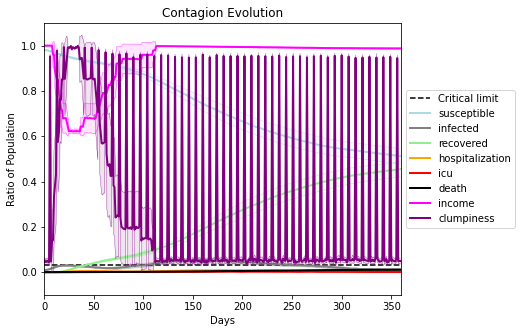

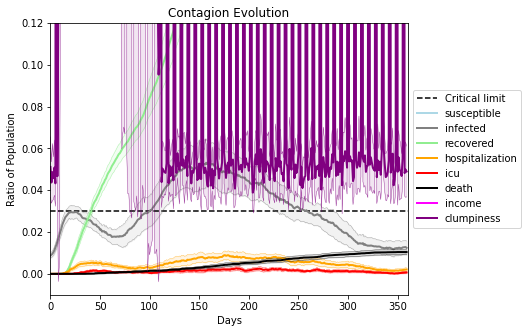

In [11]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.994
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8140, 4276, 1688, 158, 3575, 1923, 3798, 8532, 4040, 9652, 832, 9573, 2212, 2861, 196, 2407, 5138, 130, 3210, 2627]
Average similarity between family members is 0.9289077536598253 at temperature -0.993
Average similarity between family and home is 0.9998525889005694 at temperature -1
Average similarity between students and their classroom is 0.5637245247294821 at temperature -0.993
Average classroom occupancy is 3.9859154929577465 and number classrooms is 71
Average similarity between workers is 0.8714913910111336 at temperature -0.993
Average office occupancy is 3.372448979591837 and number offices is 196
Average friend similarity for adults: 0.8541408110114019 for kids: 0.6824751633045432
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.4793341989183037
avg restaurant similarity 0.45189805773986697
avg restaurant similarity 0.558022715556371
avg restaurant similarity 0.45649182694172113
avg restaurant similarity 0.4159794244842119
avg restaurant similarity 0.475594406569875
avg restaurant similarity 0.3851029211947924
avg restaurant similarity 0.7285276744151815
avg restaurant similarity 0.586695592080684
avg restaurant similarity 0.39609888086801903
avg restaurant similarity 0.4866676446995345
avg restaurant similarity 0.664235136807846
avg restaurant similarity 0.5083158684681482
avg restaurant similarity 0.5552123041707474
avg restaurant similarity 0.36352791970882586
avg restaurant similarity 0.4337755413179925
avg restaurant similarity 0.4845511332477921
avg restaurant similarity 0.4451478975442933
avg restaurant similarity 0.6626777378889878
avg restaurant similarity 0.6008600617698825
avg restaurant similarity 0.48141475782113174
avg restaurant similarity 0.45501028464958443
avg rest

avg restaurant similarity 0.5048085981028209
avg restaurant similarity 0.5185638554588909
avg restaurant similarity 0.11159280792533736
avg restaurant similarity 0.6022800727074303
avg restaurant similarity 0.5985026191483444
avg restaurant similarity 0.5690144528182904
avg restaurant similarity 0.233884673637905
avg restaurant similarity 0.59460899366952
avg restaurant similarity 0.48805998706108633
avg restaurant similarity 0.43203244593339213
avg restaurant similarity 0.4939791273224591
avg restaurant similarity 0.5498615534537726
avg restaurant similarity 0.3476901048039117
avg restaurant similarity 0.4760723223275194
avg restaurant similarity 0.5615154541243783
avg restaurant similarity 0.4557413844604175
avg restaurant similarity 0.438359125726721
avg restaurant similarity 0.3930997188843612
avg restaurant similarity 0.5376456669957121
avg restaurant similarity 0.6147531039725981
avg restaurant similarity 0.3863116113595025
avg restaurant similarity 0.5313750409403369
avg restaur

avg restaurant similarity 0.4687081172872448
avg restaurant similarity 0.5942522505931411
avg restaurant similarity 0.594412116758064
avg restaurant similarity 0.6558606603747819
avg restaurant similarity 0.49494880800723756
avg restaurant similarity 0.6063663473072661
avg restaurant similarity 0.683626742338504
avg restaurant similarity 0.598218666772692
avg restaurant similarity 0.7557354313034033
avg restaurant similarity 0.6347289843943498
avg restaurant similarity 0.5803551886453115
avg restaurant similarity 0.537953832930295
avg restaurant similarity 0.4512016627632803
avg restaurant similarity 0.4610773634330998
avg restaurant similarity 0.5091525485050112
avg restaurant similarity 0.6467831628597375
avg restaurant similarity 0.6726898588262019
avg restaurant similarity 0.5080916388259068
avg restaurant similarity 0.5425598087571601
avg restaurant similarity 0.7441873689745642
avg restaurant similarity 0.5077905451021589
avg restaurant similarity 0.534692838241749
avg restaurant

avg restaurant similarity 0.5397986018533436
avg restaurant similarity 0.6307353548345908
avg restaurant similarity 0.6068590108424392
avg restaurant similarity 0.7995226942786298
avg restaurant similarity 0.6619671241499195
avg restaurant similarity 0.7513564039723515
avg restaurant similarity 0.6627714129598937
avg restaurant similarity 0.4934358068823158
avg restaurant similarity 0.6156543874480728
avg restaurant similarity 0.6230442271903993
avg restaurant similarity 0.7252985464913425
avg restaurant similarity 0.6433731508852385
avg restaurant similarity 0.5030734660672644
avg restaurant similarity 0.6258197081897615
avg restaurant similarity 0.3513057621017519
avg restaurant similarity 0.5892332342719172
avg restaurant similarity 0.6355851085888891
avg restaurant similarity 0.6147187574896334
avg restaurant similarity 0.6849232890638538
avg restaurant similarity 0.5170856381818152
avg restaurant similarity 0.6986486101103168
avg restaurant similarity 0.5583392250409556
avg restau

avg restaurant similarity 0.8106099306279515
avg restaurant similarity 0.4535241629551003
avg restaurant similarity 0.6425470841856149
avg restaurant similarity 0.4935501145819711
avg restaurant similarity 0.5019737152042663
avg restaurant similarity 0.3487296358999416
avg restaurant similarity 0.5417473780876939
avg restaurant similarity 0.4149812329615706
avg restaurant similarity 0.9997513187689124
avg restaurant similarity 0.9998543814461605
avg restaurant similarity 0.5655424140914684
avg restaurant similarity 0.8188482420949605
avg restaurant similarity 0.516383478200683
avg restaurant similarity 0.37810876597672893
avg restaurant similarity 0.6124704306537074
avg restaurant similarity 0.7656287114467881
avg restaurant similarity 0.48131904269466147
avg restaurant similarity 0.597245363300091
avg restaurant similarity 0.5053565804171984
avg restaurant similarity 0.49580201525912326
avg restaurant similarity 0.5344049002293786
avg restaurant similarity 0.45980381273208865
avg rest

avg restaurant similarity 0.747790379715447
avg restaurant similarity 0.5851758321745538
avg restaurant similarity 0.6823578876092591
avg restaurant similarity 0.3821818887946792
avg restaurant similarity 0.4530406167351011
avg restaurant similarity 0.5997142501213544
avg restaurant similarity 0.5373513972229708
avg restaurant similarity 0.521142894580741
avg restaurant similarity 0.9997873172732088
avg restaurant similarity 0.50938659485676
avg restaurant similarity 0.7200225565974722
avg restaurant similarity 0.4742642820523816
avg restaurant similarity 0.6663597606681271
avg restaurant similarity 0.417056898488699
avg restaurant similarity 0.6630165573734026
avg restaurant similarity 0.6538588482688423
avg restaurant similarity 0.3630925704042754
avg restaurant similarity 0.4801754292620538
avg restaurant similarity 0.5418949842860924
avg restaurant similarity 0.692678063734708
avg restaurant similarity 0.5175097798278684
avg restaurant similarity 0.45037601107016423
avg restaurant 

avg restaurant similarity 0.5611717907188529
avg restaurant similarity 0.5926374194719167
avg restaurant similarity 0.5198019808714792
avg restaurant similarity 0.6256168803268317
avg restaurant similarity 0.5290411801571625
avg restaurant similarity 0.4309323032785369
avg restaurant similarity 0.5938287480222011
avg restaurant similarity 0.7318390442113547
avg restaurant similarity 0.4854233621873855
avg restaurant similarity 0.7078906731690446
avg restaurant similarity 0.5312625006671351
avg restaurant similarity 0.4505696474728996
avg restaurant similarity 0.4580741974721283
avg restaurant similarity 0.4034559547967441
avg restaurant similarity 0.6480372450453981
avg restaurant similarity 0.6022474314451031
avg restaurant similarity 0.5962911550804341
avg restaurant similarity 0.5528721353862952
avg restaurant similarity 0.5280679134905854
avg restaurant similarity 0.5978529693500213
avg restaurant similarity 0.6022055847295155
avg restaurant similarity 0.46895768922153086
avg resta

avg restaurant similarity 0.5893422049073509
avg restaurant similarity 0.4215137861166503
avg restaurant similarity 0.804593403106956
avg restaurant similarity 0.5568472303733939
avg restaurant similarity 0.4923613756907216
avg restaurant similarity 0.6473666531354099
avg restaurant similarity 0.4246630998573763
avg restaurant similarity 0.5653638223556984
avg restaurant similarity 0.6587875287095055
avg restaurant similarity 0.3610669344915923
avg restaurant similarity 0.5663481622488591
avg restaurant similarity 0.4355259019344316
avg restaurant similarity 0.43129755705154904
avg restaurant similarity 0.6378144897176026
avg restaurant similarity 0.44863232549555254
avg restaurant similarity 0.42481712504900326
avg restaurant similarity 0.6365069584605685
avg restaurant similarity 0.5900011909485576
avg restaurant similarity 0.6332167376693811
avg restaurant similarity 0.520398926238175
avg restaurant similarity 0.47445537922768444
avg restaurant similarity 0.4903484595801808
avg rest

avg restaurant similarity 0.631620716101332
avg restaurant similarity 0.6539474468451718
avg restaurant similarity 0.5268029879213424
avg restaurant similarity 0.44610432312810333
avg restaurant similarity 0.7095448665124501
avg restaurant similarity 0.5271993874079716
avg restaurant similarity 0.49341047369484653
avg restaurant similarity 0.5762902622894898
avg restaurant similarity 0.6002947991462523
avg restaurant similarity 0.5915077868627803
avg restaurant similarity 0.7027950913217569
avg restaurant similarity 0.5957535256621427
avg restaurant similarity 0.43312818403047526
avg restaurant similarity 0.727022297393999
avg restaurant similarity 0.40061829489981743
avg restaurant similarity 0.40998126514074806
avg restaurant similarity 0.3259696875964036
avg restaurant similarity 0.5569399855279272
avg restaurant similarity 0.5057422469931405
avg restaurant similarity 0.48719449554358446
avg restaurant similarity 0.5827239749340418
avg restaurant similarity 0.4686569589145063
avg re

avg restaurant similarity 0.19617139926077237
avg restaurant similarity 0.554052939652494
avg restaurant similarity 0.5037037945504939
avg restaurant similarity 0.5527229643734856
avg restaurant similarity 0.5655533094848161
avg restaurant similarity 0.5005111140001773
avg restaurant similarity 0.47866242598649517
avg restaurant similarity 0.444171971951898
avg restaurant similarity 0.5549176766732272
avg restaurant similarity 0.6166411785862252
avg restaurant similarity 0.4881227299315958
avg restaurant similarity 0.6104634894084585
avg restaurant similarity 0.6918423950939043
avg restaurant similarity 0.5245671397119357
avg restaurant similarity 0.4009372622692547
avg restaurant similarity 0.7088272256208766
avg restaurant similarity 0.46324636673174796
avg restaurant similarity 0.6746936971382286
avg restaurant similarity 0.5886966670575546
avg restaurant similarity 0.6563410112911864
avg restaurant similarity 0.5539323170809742
avg restaurant similarity 0.4865954942380523
avg resta

avg restaurant similarity 0.553798932633258
avg restaurant similarity 0.7212387660262105
avg restaurant similarity 0.4183116375481647
avg restaurant similarity 0.5642609695670022
avg restaurant similarity 0.5947312888925103
avg restaurant similarity 0.5216619317639403
avg restaurant similarity 0.444029675829312
avg restaurant similarity 0.6247711975633152
avg restaurant similarity 0.36662641966522685
avg restaurant similarity 0.6131852208685883
avg restaurant similarity 0.48100974739704555
avg restaurant similarity 0.5493521176925592
avg restaurant similarity 0.4833477082432919
avg restaurant similarity 0.6822644706813565
avg restaurant similarity 0.6546970917662822
avg restaurant similarity 0.6585090738920214
avg restaurant similarity 0.4294653070712194
avg restaurant similarity 0.4792466303549803
avg restaurant similarity 0.25040128195417594
avg restaurant similarity 0.6722338422350472
avg restaurant similarity 0.38244689534334003
avg restaurant similarity 0.4452039334331756
avg rest

avg restaurant similarity 0.5531485520966976
avg restaurant similarity 0.5403268140781967
avg restaurant similarity 0.3347051414094239
avg restaurant similarity 0.5119865521262644
avg restaurant similarity 0.5396852744816896
avg restaurant similarity 0.5543522453954584
avg restaurant similarity 0.5810477192655201
avg restaurant similarity 0.5323059704281664
avg restaurant similarity 0.45441232451786373
avg restaurant similarity 0.5642352400595676
avg restaurant similarity 0.4652838618393272
avg restaurant similarity 0.5593028402901413
avg restaurant similarity 0.6134901953310907
avg restaurant similarity 0.6902524466831484
avg restaurant similarity 0.5286783521051744
avg restaurant similarity 0.5648642683179023
avg restaurant similarity 0.4672654957211469
avg restaurant similarity 0.616123533160935
avg restaurant similarity 0.3834106642481741
avg restaurant similarity 0.6312134515169009
avg restaurant similarity 0.6470510933419525
avg restaurant similarity 0.4687410102016527
avg restau

avg restaurant similarity 0.6378881785591616
avg restaurant similarity 0.5815941922365091
avg restaurant similarity 0.5625951003093025
avg restaurant similarity 0.5210509152614698
avg restaurant similarity 0.6304853271639368
avg restaurant similarity 0.658436427536962
avg restaurant similarity 0.6193045444628431
avg restaurant similarity 0.5503139118620924
avg restaurant similarity 0.5557191354425778
avg restaurant similarity 0.3286651885055997
avg restaurant similarity 0.435922639913015
avg restaurant similarity 0.5027159957292003
avg restaurant similarity 0.4784704269445148
avg restaurant similarity 0.3479755436670984
avg restaurant similarity 0.5533897249052947
avg restaurant similarity 0.5199225448788506
avg restaurant similarity 0.6209739516043441
avg restaurant similarity 0.5856269286547343
avg restaurant similarity 0.5186275810920091
avg restaurant similarity 0.39566465177982274
avg restaurant similarity 0.6606350904723806
avg restaurant similarity 0.5223486007181546
avg restaur

avg restaurant similarity 0.5075888399713256
avg restaurant similarity 0.48508392852022547
avg restaurant similarity 0.5610525757699509
avg restaurant similarity 0.6586719264114534
avg restaurant similarity 0.4440883812831113
avg restaurant similarity 0.5545852560535465
avg restaurant similarity 0.5358951374849868
avg restaurant similarity 0.6245243841118828
avg restaurant similarity 0.6718996718968088
avg restaurant similarity 0.6457847524663654
avg restaurant similarity 0.5703632386831448
avg restaurant similarity 0.5968142413934141
avg restaurant similarity 0.5181324601128382
avg restaurant similarity 0.4632790761204053
avg restaurant similarity 0.4669776663317052
avg restaurant similarity 0.4775312647681334
avg restaurant similarity 0.610154959743781
avg restaurant similarity 0.5314327214018433
avg restaurant similarity 0.6270997742722375
avg restaurant similarity 0.45205615250671843
avg restaurant similarity 0.5511779018844893
avg restaurant similarity 0.5997131701731081
avg resta

avg restaurant similarity 0.6411021426258761
avg restaurant similarity 0.6505184968495626
avg restaurant similarity 0.3763558354556128
avg restaurant similarity 0.4364393026260286
avg restaurant similarity 0.259452159286921
avg restaurant similarity 0.690510133277095
avg restaurant similarity 0.44382360726021985
avg restaurant similarity 0.3831014088806593
avg restaurant similarity 0.5444795483483624
avg restaurant similarity 0.3754073285917291
avg restaurant similarity 0.678079903767805
avg restaurant similarity 0.31328302288366944
avg restaurant similarity 0.49516630408914203
avg restaurant similarity 0.5988166564950422
avg restaurant similarity 0.5193042942504648
avg restaurant similarity 0.5367756437045879
avg restaurant similarity 0.5719313865749416
avg restaurant similarity 0.33474338324752106
avg restaurant similarity 0.6632493911849126
avg restaurant similarity 0.5513703440832917
avg restaurant similarity 0.45655500925441234
avg restaurant similarity 0.6218775823987553
avg rest

avg restaurant similarity 0.5733602576225657
avg restaurant similarity 0.3659068129691874
avg restaurant similarity 0.14164341912340855
avg restaurant similarity 0.625797568310404
avg restaurant similarity 0.36743096485483956
avg restaurant similarity 0.5097830505611911
avg restaurant similarity 0.45665518114225334
avg restaurant similarity 0.6548608737580224
avg restaurant similarity 0.5123350858624542
avg restaurant similarity 0.438373640216288
avg restaurant similarity 0.6237913857824489
avg restaurant similarity 0.5995789614161601
avg restaurant similarity 0.67060617468555
avg restaurant similarity 0.5857714402784641
avg restaurant similarity 0.558399685419444
avg restaurant similarity 0.4102729506728358
avg restaurant similarity 0.7145587678051258
avg restaurant similarity 0.2767794679060119
avg restaurant similarity 0.7110947026053371
avg restaurant similarity 0.45859846221470124
avg restaurant similarity 0.4113915834998677
avg restaurant similarity 0.44266965393897467
avg restau

avg restaurant similarity 0.5500925427878989
avg restaurant similarity 0.39645794295085257
avg restaurant similarity 0.5190055008013007
avg restaurant similarity 0.4340000634120175
avg restaurant similarity 0.4971429631676269
avg restaurant similarity 0.5227857605337021
avg restaurant similarity 0.4830885283798011
avg restaurant similarity 0.5668666641739748
avg restaurant similarity 0.39568726828962864
avg restaurant similarity 0.7439924007110503
avg restaurant similarity 0.46794652858234953
avg restaurant similarity 0.5048595215829371
avg restaurant similarity 0.33333360634375003
avg restaurant similarity 0.999685251247371
avg restaurant similarity 0.5364176413494521
avg restaurant similarity 0.5373835493638234
avg restaurant similarity 0.3955945761576742
avg restaurant similarity 0.6655459526382472
avg restaurant similarity 0.5379671508488789
avg restaurant similarity 0.7055122406474206
avg restaurant similarity 0.36469225245801423
avg restaurant similarity 0.5746104453263162
avg re

avg restaurant similarity 0.40880847483610827
avg restaurant similarity 0.47526879902214064
avg restaurant similarity 0.5765301325975554
avg restaurant similarity 0.46676703672217557
avg restaurant similarity 0.6742629292760568
avg restaurant similarity 0.4101397230409986
avg restaurant similarity 0.5584096928913619
avg restaurant similarity 0.4122877070943322
avg restaurant similarity 0.6038128308614478
avg restaurant similarity 0.5778543110736734
avg restaurant similarity 0.4053958427646296
avg restaurant similarity 0.2001698315730893
avg restaurant similarity 0.3520974915930683
avg restaurant similarity 0.49673977819122644
avg restaurant similarity 0.4277210112120826
avg restaurant similarity 0.3178350661444709
avg restaurant similarity 0.5433572246378293
avg restaurant similarity 0.4963240442468072
avg restaurant similarity 0.9120959680830716
avg restaurant similarity 0.4334982353244791
avg restaurant similarity 0.4807026851896879
avg restaurant similarity 0.700596582274175
avg res

avg restaurant similarity 0.6898429200847573
avg restaurant similarity 0.5662592442504627
avg restaurant similarity 0.5749763591422637
avg restaurant similarity 0.5180108674412787
avg restaurant similarity 0.4470224914067397
avg restaurant similarity 0.49363005719371705
avg restaurant similarity 0.46063689751687387
avg restaurant similarity 0.4243975518973964
avg restaurant similarity 0.41640816644973483
avg restaurant similarity 0.5188587302230991
avg restaurant similarity 0.48961560875963916
avg restaurant similarity 0.5241222681739278
avg restaurant similarity 0.5044334510586752
avg restaurant similarity 0.48615200836423766
avg restaurant similarity 0.4779631754869175
avg restaurant similarity 0.6159150106860705
avg restaurant similarity 0.556462204975933
avg restaurant similarity 0.5613494621504259
avg restaurant similarity 0.4423122224627366
avg restaurant similarity 0.6250439439013561
avg restaurant similarity 0.4532486909253519
avg restaurant similarity 0.5199299802647461
avg re

avg restaurant similarity 0.49294875927039866
avg restaurant similarity 0.5572421384739219
avg restaurant similarity 0.4940191929109663
avg restaurant similarity 0.43136730815785385
avg restaurant similarity 0.4853017189859115
avg restaurant similarity 0.6151792944609892
avg restaurant similarity 0.43676876566329637
avg restaurant similarity 0.4292366165890115
avg restaurant similarity 0.6083310831992621
avg restaurant similarity 0.34733392949203074
avg restaurant similarity 0.4540829789296141
avg restaurant similarity 0.5070841303596902
avg restaurant similarity 0.351637421830812
avg restaurant similarity 0.5283757020656954
avg restaurant similarity 0.42450881111665123
avg restaurant similarity 0.5556058871557761
avg restaurant similarity 0.5545627063645883
avg restaurant similarity 0.6199187888352905
avg restaurant similarity 0.581451425674107
avg restaurant similarity 0.49755598146653846
avg restaurant similarity 0.5258051550874568
avg restaurant similarity 0.5502323579371127
avg re

avg restaurant similarity 0.6090184210620484
avg restaurant similarity 0.49209949710093903
avg restaurant similarity 0.3876313426740712
avg restaurant similarity 0.4573188788639736
avg restaurant similarity 0.5876525671729975
avg restaurant similarity 0.36820619031245
avg restaurant similarity 0.517190131310639
avg restaurant similarity 0.3570136800239749
avg restaurant similarity 0.5215262931304061
avg restaurant similarity 0.5636054789855501
avg restaurant similarity 0.5071642619242522
avg restaurant similarity 0.5755396503871142
avg restaurant similarity 0.4392776984744194
avg restaurant similarity 0.6810647021198573
avg restaurant similarity 0.6350126768140896
avg restaurant similarity 0.5863888818940869
avg restaurant similarity 0.6115600883631113
avg restaurant similarity 0.6121136435928297
avg restaurant similarity 0.7334811158099959
avg restaurant similarity 0.5278180221998204
avg restaurant similarity 0.5302041071099202
avg restaurant similarity 0.6296206390491783
avg restaura

avg restaurant similarity 0.449833888088158
avg restaurant similarity 0.7687693218232771
avg restaurant similarity 0.611056472870887
avg restaurant similarity 0.7061054230697922
avg restaurant similarity 0.5312210119871731
avg restaurant similarity 0.4889896571488263
avg restaurant similarity 0.6061402710158702
avg restaurant similarity 0.639417968717435
avg restaurant similarity 0.5108902602724236
avg restaurant similarity 0.5618674994889059
avg restaurant similarity 0.47020609097623123
avg restaurant similarity 0.504482348932087
avg restaurant similarity 0.8370826849469347
avg restaurant similarity 0.6326552252037055
avg restaurant similarity 0.44012978562033533
avg restaurant similarity 0.5586157721835746
avg restaurant similarity 0.6624502993236211
avg restaurant similarity 0.49658141621485297
avg restaurant similarity 0.500454544690949
avg restaurant similarity 0.46950223359014287
avg restaurant similarity 0.62397178918719
avg restaurant similarity 0.5026812828797804
avg restauran

avg restaurant similarity 0.4101927749462526
avg restaurant similarity 0.5098213332505876
avg restaurant similarity 0.5248111890399171
avg restaurant similarity 0.40459682377634054
avg restaurant similarity 0.4344148465015491
avg restaurant similarity 0.4098316913743966
avg restaurant similarity 0.48590852795774164
avg restaurant similarity 0.5569788258771458
avg restaurant similarity 0.5941873104825504
avg restaurant similarity 0.6212155842148994
avg restaurant similarity 0.4287504103655183
avg restaurant similarity 0.6856103951005053
avg restaurant similarity 0.5183533084747515
avg restaurant similarity 0.4270178849064549
avg restaurant similarity 0.5930419357321498
avg restaurant similarity 0.6258461257947344
avg restaurant similarity 0.6275105596576076
avg restaurant similarity 0.6575255546079691
avg restaurant similarity 0.4744858707007036
avg restaurant similarity 0.49249072917083964
avg restaurant similarity 0.5624304535777829
avg restaurant similarity 0.7169544810001027
avg res

avg restaurant similarity 0.29706297703741363
avg restaurant similarity 0.6241550047958185
avg restaurant similarity 0.45649067589352377
avg restaurant similarity 0.6329886767772295
avg restaurant similarity 0.7339000214700399
avg restaurant similarity 0.5236601112028152
avg restaurant similarity 0.46073853860975933
avg restaurant similarity 0.6861696523534286
avg restaurant similarity 0.4480106561448995
avg restaurant similarity 0.6242529647312103
avg restaurant similarity 0.49422565738352836
avg restaurant similarity 0.48508078802499327
avg restaurant similarity 0.4020582292915341
avg restaurant similarity 0.44532566676244095
avg restaurant similarity 0.7105117667880676
avg restaurant similarity 0.5669725968127034
avg restaurant similarity 0.30988917064465554
avg restaurant similarity 0.3766750512411927
avg restaurant similarity 0.48608288798717136
avg restaurant similarity 0.6594094661546976
avg restaurant similarity 0.6402101042602075
avg restaurant similarity 0.8117203437947663
av

avg restaurant similarity 0.5907761007206098
avg restaurant similarity 0.5881153244415236
avg restaurant similarity 0.5582060949675901
avg restaurant similarity 0.5166096330754916
avg restaurant similarity 0.6219861710409187
avg restaurant similarity 0.48538703261657884
avg restaurant similarity 0.5908713725036454
avg restaurant similarity 0.5953993806721445
avg restaurant similarity 0.6839254240334732
avg restaurant similarity 0.5278267616135608
avg restaurant similarity 0.9997624309166491
avg restaurant similarity 0.6146182031870538
avg restaurant similarity 0.4397814021184672
avg restaurant similarity 0.512876065211478
avg restaurant similarity 0.46553138371822794
avg restaurant similarity 0.7010158472185823
avg restaurant similarity 0.4991479299010048
avg restaurant similarity 0.5398407847510772
avg restaurant similarity 0.6626809013616622
avg restaurant similarity 0.5616048087437824
avg restaurant similarity 0.5243411689623395
avg restaurant similarity 0.442137620792373
avg restau

avg restaurant similarity 0.5593530328325327
avg restaurant similarity 0.5360693358889387
avg restaurant similarity 0.33716849707707325
avg restaurant similarity 0.5284919125770747
avg restaurant similarity 0.32782444292820667
avg restaurant similarity 0.6667442381652485
avg restaurant similarity 0.6018719380021184
avg restaurant similarity 0.7377119074688964
avg restaurant similarity 0.42807743813191146
avg restaurant similarity 0.6432401880132969
avg restaurant similarity 0.6018467032631172
avg restaurant similarity 0.5223522476036394
avg restaurant similarity 0.6121657110440384
avg restaurant similarity 0.5558178469993256
avg restaurant similarity 0.5125258287309631
avg restaurant similarity 0.5233063044325122
avg restaurant similarity 0.6723715581591263
avg restaurant similarity 0.6177545219161557
avg restaurant similarity 0.44633390485331476
avg restaurant similarity 0.7244283878139548
avg restaurant similarity 0.6506934819621539
avg restaurant similarity 0.6765211599889372
avg re

avg restaurant similarity 0.3997843711150991
avg restaurant similarity 0.3551696499633386
avg restaurant similarity 0.41420928269380675
avg restaurant similarity 0.3682185020685232
avg restaurant similarity 0.37202280189691267
avg restaurant similarity 0.2062548955386334
avg restaurant similarity 0.4811751400665691
avg restaurant similarity 0.5323717685335073
avg restaurant similarity 0.4406235463630162
avg restaurant similarity 0.5046419757604647
avg restaurant similarity 0.5330127875051199
avg restaurant similarity 0.4695233402251351
avg restaurant similarity 0.3559563782596264
avg restaurant similarity 0.45414591098604673
avg restaurant similarity 0.27153781995334286
avg restaurant similarity 0.5592055000118445
avg restaurant similarity 0.41843026127250965
avg restaurant similarity 0.2562583210401937
avg restaurant similarity 0.46754715066820673
avg restaurant similarity 0.2987774986885818
avg restaurant similarity 0.3942241306717804
avg restaurant similarity 0.519954524326524
avg r

avg restaurant similarity 0.28657644621416956
avg restaurant similarity 0.4404221334514286
avg restaurant similarity 0.43574252041801925
avg restaurant similarity 0.4786361665478586
avg restaurant similarity 0.4737525094836977
avg restaurant similarity 0.48443349078380676
avg restaurant similarity 0.5529742115611301
avg restaurant similarity 0.41304836902742
avg restaurant similarity 0.4417159350549319
avg restaurant similarity 0.4837508852788268
avg restaurant similarity 0.6246455404740229
avg restaurant similarity 0.5108803942689388
avg restaurant similarity 0.28733293141616284
avg restaurant similarity 0.384222624201439
avg restaurant similarity 0.38691796262872313
avg restaurant similarity 0.43536401591931495
avg restaurant similarity 0.5994319045092094
avg restaurant similarity 0.2539574138229966
avg restaurant similarity 0.1942576972325061
avg restaurant similarity 0.593553025311475
avg restaurant similarity 0.4719505842513308
avg restaurant similarity 0.42759610820887
avg restau

avg restaurant similarity 0.5864430306355817
avg restaurant similarity 0.5056551080916923
avg restaurant similarity 0.41715801156256804
avg restaurant similarity 0.47356676963125055
avg restaurant similarity 0.44793265773483004
avg restaurant similarity 0.4326892939172765
avg restaurant similarity 0.4591319154453503
avg restaurant similarity 0.5988608356961792
avg restaurant similarity 0.45211851217305377
avg restaurant similarity 0.48410451045184444
avg restaurant similarity 0.4333671795170732
avg restaurant similarity 0.5095709585537973
avg restaurant similarity 0.6298115957453218
avg restaurant similarity 0.4062783366773355
avg restaurant similarity 0.41270136072327557
avg restaurant similarity 0.5640800425747703
avg restaurant similarity 0.5311968213641639
avg restaurant similarity 0.4828674479839382
avg restaurant similarity 0.6695476767014311
avg restaurant similarity 0.5690702255686423
avg restaurant similarity 0.6207763660879684
avg restaurant similarity 0.509004508407312
avg r

avg restaurant similarity 0.4707436351359889
avg restaurant similarity 0.5910032679869897
avg restaurant similarity 0.5131667857054113
avg restaurant similarity 0.4546704455852152
avg restaurant similarity 0.4854705017044701
avg restaurant similarity 0.5016034797451997
avg restaurant similarity 0.6032727122314969
avg restaurant similarity 0.4973471554773455
avg restaurant similarity 0.4974403881325499
avg restaurant similarity 0.5258535866209877
avg restaurant similarity 0.5018792351997436
avg restaurant similarity 0.5340784134893949
avg restaurant similarity 0.3920608524909597
avg restaurant similarity 0.5165437799097241
avg restaurant similarity 0.5575807754295656
avg restaurant similarity 0.5604396697173646
avg restaurant similarity 0.5947536311891904
avg restaurant similarity 0.5616254602908445
avg restaurant similarity 0.46703219814607544
avg restaurant similarity 0.43905944865306396
avg restaurant similarity 0.6789822373110397
avg restaurant similarity 0.5007526530748159
avg rest

avg restaurant similarity 0.4651732858835011
avg restaurant similarity 0.5449349960791405
avg restaurant similarity 0.727856316964394
avg restaurant similarity 0.6677134249189854
avg restaurant similarity 0.4468209414627877
avg restaurant similarity 0.7154982894833611
avg restaurant similarity 0.5374511443551804
avg restaurant similarity 0.5253394642809667
avg restaurant similarity 0.6213165356843453
avg restaurant similarity 0.7367278597716942
avg restaurant similarity 0.5607311278304614
avg restaurant similarity 0.5462695122381621
avg restaurant similarity 0.5630349715324365
avg restaurant similarity 0.7294202947872411
avg restaurant similarity 0.5729872379838539
avg restaurant similarity 0.4969124407581396
avg restaurant similarity 0.6395002951017329
avg restaurant similarity 0.8325967001653608
avg restaurant similarity 0.6305568184582131
avg restaurant similarity 0.6869463511723719
avg restaurant similarity 0.6054167162619648
avg restaurant similarity 0.42634330397343567
avg restau

avg restaurant similarity 0.5923283214738109
avg restaurant similarity 0.6812503936043524
avg restaurant similarity 0.48788484554861594
avg restaurant similarity 0.5227991065589976
avg restaurant similarity 0.6270666641544483
avg restaurant similarity 0.5393062569366541
avg restaurant similarity 0.673475371003572
avg restaurant similarity 0.7216348513597015
avg restaurant similarity 0.7020946875703702
avg restaurant similarity 0.5603278679073379
avg restaurant similarity 0.5349077643694784
avg restaurant similarity 0.5069635082867712
avg restaurant similarity 0.7393177355887861
avg restaurant similarity 0.5010505376351249
avg restaurant similarity 0.5719148612575851
avg restaurant similarity 0.6722001744204075
avg restaurant similarity 0.586995415235177
avg restaurant similarity 0.44213455291088766
avg restaurant similarity 0.4550114130200387
avg restaurant similarity 0.545135172788407
avg restaurant similarity 0.6089187807044951
avg restaurant similarity 0.6070239567909703
avg restaur

avg restaurant similarity 0.7080620330700955
avg restaurant similarity 0.5948804568756113
avg restaurant similarity 0.6188024633539525
avg restaurant similarity 0.5887535261473137
avg restaurant similarity 0.6124283540895025
avg restaurant similarity 0.6703216677665848
avg restaurant similarity 0.5514622508695365
avg restaurant similarity 0.6811339555605811
avg restaurant similarity 0.6131767752722014
avg restaurant similarity 0.5926208020451431
avg restaurant similarity 0.5323155155039418
avg restaurant similarity 0.684287331949264
avg restaurant similarity 0.6579141726234088
avg restaurant similarity 0.6248943386225022
avg restaurant similarity 0.5539652478684428
avg restaurant similarity 0.5756182603747311
avg restaurant similarity 0.7772649435073693
avg restaurant similarity 0.7401618238053659
avg restaurant similarity 0.47617828666078155
avg restaurant similarity 0.5721465748925672
avg restaurant similarity 0.7346719425158718
avg restaurant similarity 0.7031665923932942
avg restau

avg restaurant similarity 0.5598003864757233
avg restaurant similarity 0.47740404667608555
avg restaurant similarity 0.5375877181876899
avg restaurant similarity 0.5192746295910645
avg restaurant similarity 0.5591358841726498
avg restaurant similarity 0.6074069202589153
avg restaurant similarity 0.7760473397356701
avg restaurant similarity 0.5509893410542376
avg restaurant similarity 0.5808627156945756
avg restaurant similarity 0.6215693335437183
avg restaurant similarity 0.6252684478800264
avg restaurant similarity 0.5650819711109801
avg restaurant similarity 0.615680062459837
avg restaurant similarity 0.7137726415397753
avg restaurant similarity 0.550745486990048
avg restaurant similarity 0.5459760410035824
avg restaurant similarity 0.5698735021511195
avg restaurant similarity 0.6073199472998824
avg restaurant similarity 0.6334784333290715
avg restaurant similarity 0.4920078317887688
avg restaurant similarity 0.5670641676145075
avg restaurant similarity 0.7536581361969513
avg restaur

avg restaurant similarity 0.32548127775460967
avg restaurant similarity 0.8003031517196488
avg restaurant similarity 0.4643688261293673
avg restaurant similarity 0.5820930458135485
avg restaurant similarity 0.5277232799308295
avg restaurant similarity 0.9993816297578874
avg restaurant similarity 0.6359242683022837
avg restaurant similarity 0.5621947843899213
avg restaurant similarity 0.41210429620331746
avg restaurant similarity 0.48260122185472093
avg restaurant similarity 0.7624251340852523
avg restaurant similarity 0.597134833067312
avg restaurant similarity 0.39186536737011696
avg restaurant similarity 0.5636563605066687
avg restaurant similarity 0.8052737616245917
avg restaurant similarity 0.2688858784341692
avg restaurant similarity 0.589883009039203
avg restaurant similarity 0.7339038369505828
avg restaurant similarity 0.8487597754839773
avg restaurant similarity 0.4602849885133229
avg restaurant similarity 0.9997318697436288
avg restaurant similarity 0.3764798474402887
avg rest

avg restaurant similarity 0.416237239864504
avg restaurant similarity 0.628218563579592
avg restaurant similarity 0.4264978672186028
avg restaurant similarity 0.6011422763623555
avg restaurant similarity 0.5930362512190425
avg restaurant similarity 0.6381846334533569
avg restaurant similarity 0.45727344660027364
avg restaurant similarity 0.7056623421385024
avg restaurant similarity 0.4936388533254212
avg restaurant similarity 0.6495689956156822
avg restaurant similarity 0.5093559647613094
avg restaurant similarity 0.43385302673078935
avg restaurant similarity 0.7358772968677585
avg restaurant similarity 0.5986134512789163
avg restaurant similarity 0.6915818127191381
avg restaurant similarity 0.4006459917801488
avg restaurant similarity 0.4603113120693667
avg restaurant similarity 0.359455973984639
avg restaurant similarity 0.5433835051116821
avg restaurant similarity 0.5084301950334292
avg restaurant similarity 0.37303642522287345
avg restaurant similarity 0.6602090869476572
avg restau

avg restaurant similarity 0.6453163834164063
avg restaurant similarity 0.6424956879854672
avg restaurant similarity 0.595001484538077
avg restaurant similarity 0.648443087999901
avg restaurant similarity 0.556283079435523
avg restaurant similarity 0.4773978398241693
avg restaurant similarity 0.503541803964182
avg restaurant similarity 0.46454136320128575
avg restaurant similarity 0.7669925497552803
avg restaurant similarity 0.6320796269098659
avg restaurant similarity 0.6518621778986364
avg restaurant similarity 0.6182393142250879
avg restaurant similarity 0.7279385665649735
avg restaurant similarity 0.5449468732584649
avg restaurant similarity 0.6566125650395667
avg restaurant similarity 0.6568081880197455
avg restaurant similarity 0.4137817125204776
avg restaurant similarity 0.5238442346405751
avg restaurant similarity 0.7188782413966817
avg restaurant similarity 0.6238673164034386
avg restaurant similarity 0.696916355518569
avg restaurant similarity 0.474343911304952
avg restaurant 

avg restaurant similarity 0.5507453870708462
avg restaurant similarity 0.6825359335828391
avg restaurant similarity 0.5538887728253044
avg restaurant similarity 0.6888989103327666
avg restaurant similarity 0.848742565826187
avg restaurant similarity 0.5588761352806685
avg restaurant similarity 0.4936511810596123
avg restaurant similarity 0.6015681294494389
avg restaurant similarity 0.5438666503161766
avg restaurant similarity 0.5551129270362272
avg restaurant similarity 0.43741759865052604
avg restaurant similarity 0.5808354526156719
avg restaurant similarity 0.5493716710076656
avg restaurant similarity 0.9994874114489898
avg restaurant similarity 0.5240725716323338
avg restaurant similarity 0.5600363853342598
avg restaurant similarity 0.5832831984915233
avg restaurant similarity 0.5108704484442192
avg restaurant similarity 0.5005553357937476
avg restaurant similarity 0.5132766621633971
avg restaurant similarity 0.6538763892775494
avg restaurant similarity 0.5159562652693092
avg restau

avg restaurant similarity 0.5018976844035924
avg restaurant similarity 0.583490243392359
avg restaurant similarity 0.5006479539866951
avg restaurant similarity 0.49309150830615495
avg restaurant similarity 0.27908660219989667
avg restaurant similarity 0.5556489358388941
avg restaurant similarity 0.539021667268188
avg restaurant similarity 0.20374492295114816
avg restaurant similarity 0.5466717213892324
avg restaurant similarity 0.5365525148791432
avg restaurant similarity 0.5182129193324003
avg restaurant similarity 0.4828149206699664
avg restaurant similarity 0.6013171784224279
avg restaurant similarity 0.4532928910076582
avg restaurant similarity 0.5433293014116276
avg restaurant similarity 0.4201433163479391
avg restaurant similarity 0.5837534786788141
avg restaurant similarity 0.40913783676605897
avg restaurant similarity 0.549408646074029
avg restaurant similarity 0.5961052988121425
avg restaurant similarity 0.3935081059504513
avg restaurant similarity 0.5414675661479189
avg resta

avg restaurant similarity 0.4994996110632444
avg restaurant similarity 0.5850918011057369
avg restaurant similarity 0.49075314078739174
avg restaurant similarity 0.4629719310774071
avg restaurant similarity 0.4721338646718778
avg restaurant similarity 0.5137950056959946
avg restaurant similarity 0.48398755887682504
avg restaurant similarity 0.6008436533104198
avg restaurant similarity 0.44539393650058995
avg restaurant similarity 0.43032934456301736
avg restaurant similarity 0.4288934700564395
avg restaurant similarity 0.4129507189795392
avg restaurant similarity 0.703073849406081
avg restaurant similarity 0.5086370030722438
avg restaurant similarity 0.7543087343369694
avg restaurant similarity 0.4919225626613251
avg restaurant similarity 0.47867287192729996
avg restaurant similarity 0.49634867675423444
avg restaurant similarity 0.38445469643340685
avg restaurant similarity 0.5867768621969106
avg restaurant similarity 0.4654569314756557
avg restaurant similarity 0.4990285570771366
avg 

(<function dict.items>, <function dict.items>, <function dict.items>)

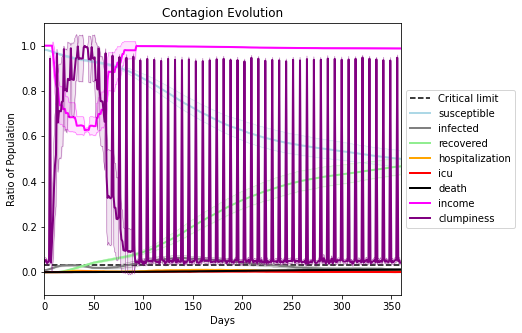

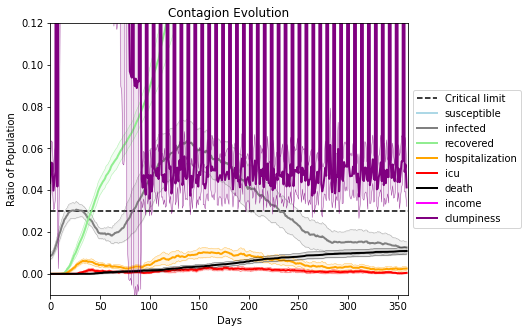

In [12]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.993
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4665, 696, 9441, 2671, 5907, 6183, 2116, 7722, 3003, 6478, 8232, 9158, 3665, 494, 9787, 2963, 2714, 8469, 5292, 7145]
Average similarity between family members is 0.9189282498498204 at temperature -0.992
Average similarity between family and home is 0.9998603328074762 at temperature -1
Average similarity between students and their classroom is 0.5241447006889149 at temperature -0.992
Average classroom occupancy is 4.140845070422535 and number classrooms is 71
Average similarity between workers is 0.8533061203506884 at temperature -0.992
Average office occupancy is 3.4712041884816753 and number offices is 191
Average friend similarity for adults: 0.8469493343122653 for kids: 0.6769494357926275
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.4700181638537583
avg restaurant similarity 0.5098180755872909
avg restaurant similarity 0.5483246803990045
avg restaurant similarity 0.7379869670693705
avg restaurant similarity 0.34962075634911133
avg restaurant similarity 0.4924132612929421
avg restaurant similarity 0.38143103466612494
avg restaurant similarity 0.3878162978144799
avg restaurant similarity 0.4356075835539642
avg restaurant similarity 0.28403895133486956
avg restaurant similarity 0.5828780019686096
avg restaurant similarity 0.5823775386109911
avg restaurant similarity 0.2736525610003333
avg restaurant similarity 0.5353295847333149
avg restaurant similarity 0.2568816283379251
avg restaurant similarity 0.5215407719366378
avg restaurant similarity 0.4021812845516547
avg restaurant similarity 0.46945813698027844
avg restaurant similarity 0.6060143337670802
avg restaurant similarity 0.6160805065632201
avg restaurant similarity 0.8127440993101429
avg restaurant similarity 0.5201365950730217
avg re

avg restaurant similarity 0.5934956763382099
avg restaurant similarity 0.536186421561867
avg restaurant similarity 0.5976776791939299
avg restaurant similarity 0.568009339155206
avg restaurant similarity 0.659637153773717
avg restaurant similarity 0.607226080871835
avg restaurant similarity 0.380270054700647
avg restaurant similarity 0.42729512920368407
avg restaurant similarity 0.4656033528573246
avg restaurant similarity 0.756396132065165
avg restaurant similarity 0.45596779250735825
avg restaurant similarity 0.524603179895206
avg restaurant similarity 0.35165673338524445
avg restaurant similarity 0.4746284226041805
avg restaurant similarity 0.7056448928945818
avg restaurant similarity 0.47164549695936975
avg restaurant similarity 0.6689065211158122
avg restaurant similarity 0.49381900379097293
avg restaurant similarity 0.32002326131877507
avg restaurant similarity 0.747860162151412
avg restaurant similarity 0.4305458572097217
avg restaurant similarity 0.48282759239141126
avg restaur

avg restaurant similarity 0.5209767494822286
avg restaurant similarity 0.5623477519007889
avg restaurant similarity 0.35484946600195905
avg restaurant similarity 0.6961815685550149
avg restaurant similarity 0.4652205003816279
avg restaurant similarity 0.5459595114406894
avg restaurant similarity 0.7301361619632505
avg restaurant similarity 0.5831507230684779
avg restaurant similarity 0.662284687445917
avg restaurant similarity 0.5901985790443943
avg restaurant similarity 0.3904233425801441
avg restaurant similarity 0.48634108114743235
avg restaurant similarity 0.6359831788401229
avg restaurant similarity 0.5899819292271347
avg restaurant similarity 0.5218362923154649
avg restaurant similarity 0.6515886903450352
avg restaurant similarity 0.4719090939254036
avg restaurant similarity 0.6215056936997184
avg restaurant similarity 0.6970076075726492
avg restaurant similarity 0.7605837074272881
avg restaurant similarity 0.4204777275306375
avg restaurant similarity 0.5323686373803687
avg resta

avg restaurant similarity 0.5808974716717763
avg restaurant similarity 0.6626834600202641
avg restaurant similarity 0.3474695232603372
avg restaurant similarity 0.5493976738971268
avg restaurant similarity 0.6620046848744738
avg restaurant similarity 0.5350767889067103
avg restaurant similarity 0.5452833574219452
avg restaurant similarity 0.6012994650969287
avg restaurant similarity 0.4570563058454196
avg restaurant similarity 0.5414286725246286
avg restaurant similarity 0.4948886620955699
avg restaurant similarity 0.8580797282611115
avg restaurant similarity 0.4708580702653582
avg restaurant similarity 0.6171903061674555
avg restaurant similarity 0.5441705696065389
avg restaurant similarity 0.52736983929935
avg restaurant similarity 0.3793127938845905
avg restaurant similarity 0.35486289665696313
avg restaurant similarity 0.7324524572143426
avg restaurant similarity 0.35965280522626486
avg restaurant similarity 0.4522573361723362
avg restaurant similarity 0.47653254283102076
avg resta

avg restaurant similarity 0.6288277292768558
avg restaurant similarity 0.8158096540567995
avg restaurant similarity 0.5078681642399305
avg restaurant similarity 0.49133969342450734
avg restaurant similarity 0.5130343570073529
avg restaurant similarity 0.7104330847221502
avg restaurant similarity 0.6093749217810226
avg restaurant similarity 0.6293900382127542
avg restaurant similarity 0.5862532585265993
avg restaurant similarity 0.44084222214684826
avg restaurant similarity 0.6829278802137959
avg restaurant similarity 0.4775410696620462
avg restaurant similarity 0.6020467413736094
avg restaurant similarity 0.7511786701167995
avg restaurant similarity 0.5888043557692546
avg restaurant similarity 0.6625934793905631
avg restaurant similarity 0.5030247250359869
avg restaurant similarity 0.5385839343274299
avg restaurant similarity 0.4864887209290577
avg restaurant similarity 0.4753780855528803
avg restaurant similarity 0.49434837251948127
avg restaurant similarity 0.406483977049746
avg rest

avg restaurant similarity 0.6116159794070506
avg restaurant similarity 0.6652128589468027
avg restaurant similarity 0.46794712673774164
avg restaurant similarity 0.6315895433203763
avg restaurant similarity 0.8239875741442051
avg restaurant similarity 0.350897555056143
avg restaurant similarity 0.6318462593128451
avg restaurant similarity 0.47835077042031926
avg restaurant similarity 0.4493132459251867
avg restaurant similarity 0.44592283363133967
avg restaurant similarity 0.6594898229055576
avg restaurant similarity 0.4777467761016283
avg restaurant similarity 0.7800984867969725
avg restaurant similarity 0.7103210785366312
avg restaurant similarity 0.46166881786487096
avg restaurant similarity 0.742613196872789
avg restaurant similarity 0.6512845649846215
avg restaurant similarity 0.5270738708207113
avg restaurant similarity 0.6435095428600586
avg restaurant similarity 0.5208334261842181
avg restaurant similarity 0.5121956927034413
avg restaurant similarity 0.6171313679659193
avg rest

avg restaurant similarity 0.4991614155855766
avg restaurant similarity 0.4275643057774761
avg restaurant similarity 0.42527260962596763
avg restaurant similarity 0.3852814001917954
avg restaurant similarity 0.5539396808141777
avg restaurant similarity 0.3868153116355839
avg restaurant similarity 0.5169752430049921
avg restaurant similarity 0.5546486936281164
avg restaurant similarity 0.635907513846633
avg restaurant similarity 0.34406366466965854
avg restaurant similarity 0.5595131511060148
avg restaurant similarity 0.6033478896258616
avg restaurant similarity 0.5262008759968911
avg restaurant similarity 0.6214631707302546
avg restaurant similarity 0.6485412342669977
avg restaurant similarity 0.5344769197424883
avg restaurant similarity 0.4349347789501383
avg restaurant similarity 0.4739295363008378
avg restaurant similarity 0.44211798554310033
avg restaurant similarity 0.9520593080206518
avg restaurant similarity 0.5099917936762127
avg restaurant similarity 0.4932665721318318
avg rest

avg restaurant similarity 0.45682896162268866
avg restaurant similarity 0.45694622061692974
avg restaurant similarity 0.4709063725984819
avg restaurant similarity 0.6260897282053559
avg restaurant similarity 0.308310102709386
avg restaurant similarity 0.5122959931392935
avg restaurant similarity 0.4530943406244025
avg restaurant similarity 0.5135368784816238
avg restaurant similarity 0.6225830127602132
avg restaurant similarity 0.5317653130253073
avg restaurant similarity 0.5476000100264935
avg restaurant similarity 0.5234213810157592
avg restaurant similarity 0.5350767187344053
avg restaurant similarity 0.5109878104370721
avg restaurant similarity 0.7041024952601935
avg restaurant similarity 0.5925063243708547
avg restaurant similarity 0.48209411289043497
avg restaurant similarity 0.618607012622777
avg restaurant similarity 0.5147704705618925
avg restaurant similarity 0.544272344807789
avg restaurant similarity 0.5523260355824443
avg restaurant similarity 0.6358607698391531
avg restau

avg restaurant similarity 0.6833417705166448
avg restaurant similarity 0.5932157243871724
avg restaurant similarity 0.4539203473629231
avg restaurant similarity 0.5325127249513333
avg restaurant similarity 0.390751904280868
avg restaurant similarity 0.5280296389639483
avg restaurant similarity 0.7971415379552713
avg restaurant similarity 0.586273513616911
avg restaurant similarity 0.5885332065120218
avg restaurant similarity 0.5806427638988776
avg restaurant similarity 0.30934385004077497
avg restaurant similarity 0.6648207960590579
avg restaurant similarity 0.5429943893631258
avg restaurant similarity 0.542891322792135
avg restaurant similarity 0.6120372686879115
avg restaurant similarity 0.48304393838813153
avg restaurant similarity 0.713349839806762
avg restaurant similarity 0.5590123551188831
avg restaurant similarity 0.6934359974358995
avg restaurant similarity 0.8593241294379977
avg restaurant similarity 0.5777656764132627
avg restaurant similarity 0.41992076827213964
avg restaur

avg restaurant similarity 0.3800846623465559
avg restaurant similarity 0.9028519299738087
avg restaurant similarity 0.8856820536278717
avg restaurant similarity 0.7256479259025153
avg restaurant similarity 0.3240032302228469
avg restaurant similarity 0.5392058803607934
avg restaurant similarity 0.46507984813639514
avg restaurant similarity 0.8080664879750854
avg restaurant similarity 0.5971852900539607
avg restaurant similarity 0.5554386828602397
avg restaurant similarity 0.287217193418281
avg restaurant similarity 0.6853858990567502
avg restaurant similarity 0.6273466375755397
avg restaurant similarity 0.1526430668521348
avg restaurant similarity 0.5377579172042437
avg restaurant similarity 0.4935130536124385
avg restaurant similarity 0.6703613821736765
avg restaurant similarity 0.5884695322415641
avg restaurant similarity 0.6222873839797575
avg restaurant similarity 0.604101410281653
avg restaurant similarity 0.5702473540438853
avg restaurant similarity 0.5217902114714768
avg restaur

avg restaurant similarity 0.6308361095961645
avg restaurant similarity 0.3903533217858864
avg restaurant similarity 0.5651728483055908
avg restaurant similarity 0.5011556483969911
avg restaurant similarity 0.571625556827484
avg restaurant similarity 0.5676173264018297
avg restaurant similarity 0.5831529603647875
avg restaurant similarity 0.5567795983630707
avg restaurant similarity 0.6788748185846644
avg restaurant similarity 0.5349145023486479
avg restaurant similarity 0.43217278155968586
avg restaurant similarity 0.6014503450884436
avg restaurant similarity 0.5462228573933369
avg restaurant similarity 0.4819221557340076
avg restaurant similarity 0.5800654820808198
avg restaurant similarity 0.5872990111904486
avg restaurant similarity 0.5355582420567476
avg restaurant similarity 0.462051024978995
avg restaurant similarity 0.40886256395469844
avg restaurant similarity 0.6071623748503283
avg restaurant similarity 0.5645571661870847
avg restaurant similarity 0.4971133389954621
avg restau

avg restaurant similarity 0.5353170395179333
avg restaurant similarity 0.6005560204413593
avg restaurant similarity 0.5534936158490266
avg restaurant similarity 0.6956015033593522
avg restaurant similarity 0.5512102886638333
avg restaurant similarity 0.4923715975440343
avg restaurant similarity 0.4930747292121389
avg restaurant similarity 0.6488160170829945
avg restaurant similarity 0.4418600205142535
avg restaurant similarity 0.7212556890029792
avg restaurant similarity 0.5472661998838833
avg restaurant similarity 0.6012300079265266
avg restaurant similarity 0.6696497712454833
avg restaurant similarity 0.5325281869722965
avg restaurant similarity 0.46466512755095035
avg restaurant similarity 0.5389525335927642
avg restaurant similarity 0.5042266864626194
avg restaurant similarity 0.5677850252288876
avg restaurant similarity 0.5109902593631233
avg restaurant similarity 0.5537523433882815
avg restaurant similarity 0.5741135494578795
avg restaurant similarity 0.6236679454311788
avg resta

avg restaurant similarity 0.5340932475263379
avg restaurant similarity 0.46513142052482737
avg restaurant similarity 0.6161910694532085
avg restaurant similarity 0.5012377300229153
avg restaurant similarity 0.4646363033344067
avg restaurant similarity 0.5250778341784195
avg restaurant similarity 0.39874580174804164
avg restaurant similarity 0.8245547456313544
avg restaurant similarity 0.3046887121468705
avg restaurant similarity 0.5117270051420736
avg restaurant similarity 0.5913854195667508
avg restaurant similarity 0.47282807572303287
avg restaurant similarity 0.722844534518621
avg restaurant similarity 0.670362627921528
avg restaurant similarity 0.6483377483866268
avg restaurant similarity 0.41897279964381684
avg restaurant similarity 0.6800135581976897
avg restaurant similarity 0.41777729844883005
avg restaurant similarity 0.5380500920114979
avg restaurant similarity 0.5591601440853904
avg restaurant similarity 0.5366179932544364
avg restaurant similarity 0.44273940788856236
avg re

avg restaurant similarity 0.45778746212097254
avg restaurant similarity 0.4997786900864177
avg restaurant similarity 0.5791229868151773
avg restaurant similarity 0.6093916895766321
avg restaurant similarity 0.5125631211905806
avg restaurant similarity 0.42185100775208784
avg restaurant similarity 0.45143838118581187
avg restaurant similarity 0.47506699941549585
avg restaurant similarity 0.5476496555201422
avg restaurant similarity 0.503406460182977
avg restaurant similarity 0.688740223625004
avg restaurant similarity 0.5547734654215225
avg restaurant similarity 0.5347430040499689
avg restaurant similarity 0.45521897339849504
avg restaurant similarity 0.4549204715010551
avg restaurant similarity 0.5896941740787205
avg restaurant similarity 0.5987385147959114
avg restaurant similarity 0.3585841274425917
avg restaurant similarity 0.4001824130777054
avg restaurant similarity 0.4510123898593573
avg restaurant similarity 0.4993600926534242
avg restaurant similarity 0.4760834190262317
avg res

avg restaurant similarity 0.6060922746415127
avg restaurant similarity 0.536621547885217
avg restaurant similarity 0.5118071922107514
avg restaurant similarity 0.5685557598836543
avg restaurant similarity 0.45423549603955693
avg restaurant similarity 0.5288532726510644
avg restaurant similarity 0.5157109688568646
avg restaurant similarity 0.46814002714027614
avg restaurant similarity 0.514980122934969
avg restaurant similarity 0.6303920185360556
avg restaurant similarity 0.6317820756285374
avg restaurant similarity 0.45435485474527865
avg restaurant similarity 0.6826375377730611
avg restaurant similarity 0.5853146055753922
avg restaurant similarity 0.676313273192802
avg restaurant similarity 0.7735533341247296
avg restaurant similarity 0.7626290908721302
avg restaurant similarity 0.5400743090683975
avg restaurant similarity 0.5731282204236836
avg restaurant similarity 0.5148381803267281
avg restaurant similarity 0.49343768371673163
avg restaurant similarity 0.6488370243908353
avg resta

avg restaurant similarity 0.8241475519790582
avg restaurant similarity 0.6254831140290867
avg restaurant similarity 0.6172768183821646
avg restaurant similarity 0.4488546256837046
avg restaurant similarity 0.5306115983069045
avg restaurant similarity 0.466158935134797
avg restaurant similarity 0.6839090743687432
avg restaurant similarity 0.6190671423504868
avg restaurant similarity 0.5227292585454455
avg restaurant similarity 0.5074778998549366
avg restaurant similarity 0.8046015922476994
avg restaurant similarity 0.48854950415284454
avg restaurant similarity 0.41516292272231153
avg restaurant similarity 0.5256738398192611
avg restaurant similarity 0.4984143493143245
avg restaurant similarity 0.5997994855576418
avg restaurant similarity 0.6290649799591413
avg restaurant similarity 0.7724797974324202
avg restaurant similarity 0.5178244478333166
avg restaurant similarity 0.5233994222124065
avg restaurant similarity 0.5315495110484065
avg restaurant similarity 0.5698551468819038
avg resta

avg restaurant similarity 0.631849113529169
avg restaurant similarity 0.5114236835668864
avg restaurant similarity 0.5518954190383412
avg restaurant similarity 0.3881573398424411
avg restaurant similarity 0.4534486479159322
avg restaurant similarity 0.4576690583774746
avg restaurant similarity 0.6048202513946929
avg restaurant similarity 0.5504525415298842
avg restaurant similarity 0.5849954373954983
avg restaurant similarity 0.5032171843840965
avg restaurant similarity 0.31467578581045386
avg restaurant similarity 0.5190947072571143
avg restaurant similarity 0.5610310522450349
avg restaurant similarity 0.5538886305544612
avg restaurant similarity 0.7447604341614622
avg restaurant similarity 0.5192963241951898
avg restaurant similarity 0.6246666900416727
avg restaurant similarity 0.5975671602397379
avg restaurant similarity 0.6594681815518632
avg restaurant similarity 0.4507544805221144
avg restaurant similarity 0.5317976121403948
avg restaurant similarity 0.7079785624084498
avg restau

avg restaurant similarity 0.4825609328851964
avg restaurant similarity 0.7658651146132708
avg restaurant similarity 0.5338455093797954
avg restaurant similarity 0.6031118218423008
avg restaurant similarity 0.3117729153399384
avg restaurant similarity 0.5736015943307722
avg restaurant similarity 0.4592291100276719
avg restaurant similarity 0.6609806445075637
avg restaurant similarity 0.5780019544012989
avg restaurant similarity 0.4032364163138638
avg restaurant similarity 0.4978581272032008
avg restaurant similarity 0.4462021803685981
avg restaurant similarity 0.4989545971260996
avg restaurant similarity 0.49323123736366814
avg restaurant similarity 0.39157137997007885
avg restaurant similarity 0.5513735468461931
avg restaurant similarity 0.5267414798274875
avg restaurant similarity 0.6009695647004004
avg restaurant similarity 0.3944705386927518
avg restaurant similarity 0.559976124439853
avg restaurant similarity 0.6529114358364716
avg restaurant similarity 0.5737217919219137
avg resta

avg restaurant similarity 0.5175926814556726
avg restaurant similarity 0.6181856336139041
avg restaurant similarity 0.4542319669443834
avg restaurant similarity 0.5628876221419444
avg restaurant similarity 0.44392868110305306
avg restaurant similarity 0.550761184557363
avg restaurant similarity 0.6330113394046265
avg restaurant similarity 0.4342052418688277
avg restaurant similarity 0.4614358148785328
avg restaurant similarity 0.5373180915746686
avg restaurant similarity 0.6344811998430461
avg restaurant similarity 0.7038923830331631
avg restaurant similarity 0.6786694895492175
avg restaurant similarity 0.4669337624344557
avg restaurant similarity 0.6553071537076761
avg restaurant similarity 0.5852731864328119
avg restaurant similarity 0.40705935492300577
avg restaurant similarity 0.5191950623829859
avg restaurant similarity 0.9035177788106961
avg restaurant similarity 0.42951463324577105
avg restaurant similarity 0.4768193296332245
avg restaurant similarity 0.7787270320359259
avg rest

avg restaurant similarity 0.5610388200047953
avg restaurant similarity 0.20249180944951126
avg restaurant similarity 0.5695124180994553
avg restaurant similarity 0.5539237302889284
avg restaurant similarity 0.6720085698076079
avg restaurant similarity 0.49579283102783434
avg restaurant similarity 0.48149029238657887
avg restaurant similarity 0.5488272181383819
avg restaurant similarity 0.5432504754324956
avg restaurant similarity 0.7733441401926845
avg restaurant similarity 0.5615354440373264
avg restaurant similarity 0.43002492219263355
avg restaurant similarity 0.4291005599398173
avg restaurant similarity 0.2932132035383307
avg restaurant similarity 0.7214277263634677
avg restaurant similarity 0.4732572719705994
avg restaurant similarity 0.6221957840077602
avg restaurant similarity 0.5635682787690038
avg restaurant similarity 0.6018728839321659
avg restaurant similarity 0.6080733194859287
avg restaurant similarity 0.5102769196146877
avg restaurant similarity 0.49526779143359106
avg r

avg restaurant similarity 0.41468755689364295
avg restaurant similarity 0.7775614928900985
avg restaurant similarity 0.5241296167679517
avg restaurant similarity 0.6442149232902961
avg restaurant similarity 0.6748677091835399
avg restaurant similarity 0.5910399632397528
avg restaurant similarity 0.5528596406015933
avg restaurant similarity 0.8245089362851361
avg restaurant similarity 0.4360351256724343
avg restaurant similarity 0.5528679775282342
avg restaurant similarity 0.3813726569502318
avg restaurant similarity 0.3689197094178481
avg restaurant similarity 0.4967015718431182
avg restaurant similarity 0.8808478790841583
avg restaurant similarity 0.943185331338693
avg restaurant similarity 0.5105603015770745
avg restaurant similarity 0.5278844888203827
avg restaurant similarity 0.5782771182566119
avg restaurant similarity 0.7426071516013312
avg restaurant similarity 0.801209282486344
avg restaurant similarity 0.4901565222953849
avg restaurant similarity 0.4418913595878653
avg restaur

avg restaurant similarity 0.6268885775806012
avg restaurant similarity 0.7019506699552557
avg restaurant similarity 0.5644074461994131
avg restaurant similarity 0.6524501260439006
avg restaurant similarity 0.5201458501256809
avg restaurant similarity 0.4911846965484761
avg restaurant similarity 0.609610233047444
avg restaurant similarity 0.44507700832323266
avg restaurant similarity 0.801530506530165
avg restaurant similarity 0.5259661191080548
avg restaurant similarity 0.5491208431868239
avg restaurant similarity 0.4142248134724842
avg restaurant similarity 0.4450958439077305
avg restaurant similarity 0.46819889980891205
avg restaurant similarity 0.4107079909915957
avg restaurant similarity 0.4101988342083075
avg restaurant similarity 0.4607540701239763
avg restaurant similarity 0.7971246110532025
avg restaurant similarity 0.6672989179841661
avg restaurant similarity 0.7075898901110363
avg restaurant similarity 0.6383983671587868
avg restaurant similarity 0.5385061459755017
avg restau

avg restaurant similarity 0.5219962509367881
avg restaurant similarity 0.30727363375907996
avg restaurant similarity 0.6333647254074899
avg restaurant similarity 0.41744183684049385
avg restaurant similarity 0.5898384695981479
avg restaurant similarity 0.6934235756082767
avg restaurant similarity 0.7094219746003633
avg restaurant similarity 0.3287552311795547
avg restaurant similarity 0.6415592304116532
avg restaurant similarity 0.37982453576008207
avg restaurant similarity 0.5242948895773998
avg restaurant similarity 0.5407074188186215
avg restaurant similarity 0.6104055333996462
avg restaurant similarity 0.6119341113695147
avg restaurant similarity 0.5458516142558817
avg restaurant similarity 0.45314997061376044
avg restaurant similarity 0.26567330307391446
avg restaurant similarity 0.644271050618531
avg restaurant similarity 0.5034102180594574
avg restaurant similarity 0.49774015234838237
avg restaurant similarity 0.5932166950827844
avg restaurant similarity 0.43592159340550196
avg 

avg restaurant similarity 0.4380730612315883
avg restaurant similarity 0.35424992483647877
avg restaurant similarity 0.45383028698540934
avg restaurant similarity 0.5205936223789551
avg restaurant similarity 0.4872852111064819
avg restaurant similarity 0.7497376950293623
avg restaurant similarity 0.574204675761201
avg restaurant similarity 0.5731027398520557
avg restaurant similarity 0.5158954618318196
avg restaurant similarity 0.38508096368485323
avg restaurant similarity 0.5627899683473447
avg restaurant similarity 0.8067651106384495
avg restaurant similarity 0.485928875720997
avg restaurant similarity 0.5623498496335597
avg restaurant similarity 0.8089354169357675
avg restaurant similarity 0.5034982968117856
avg restaurant similarity 0.33641404930578617
avg restaurant similarity 0.384444697410011
avg restaurant similarity 0.6252518304864477
avg restaurant similarity 0.3012179171646156
avg restaurant similarity 0.5600711945564332
avg restaurant similarity 0.5012747143464942
avg resta

avg restaurant similarity 0.6730558913867382
avg restaurant similarity 0.6425749675840935
avg restaurant similarity 0.5266153375903583
avg restaurant similarity 0.5258559084819892
avg restaurant similarity 0.48122507856072894
avg restaurant similarity 0.4527351046166186
avg restaurant similarity 0.3155733168547636
avg restaurant similarity 0.6436088263458535
avg restaurant similarity 0.5355594630846164
avg restaurant similarity 0.5460979662730374
avg restaurant similarity 0.5270076226725016
avg restaurant similarity 0.4812634168863674
avg restaurant similarity 0.3859569475697686
avg restaurant similarity 0.4761595583395039
avg restaurant similarity 0.6163680215247337
avg restaurant similarity 0.5132106490133099
avg restaurant similarity 0.5204997491724964
avg restaurant similarity 0.5456743682516013
avg restaurant similarity 0.6858202699022804
avg restaurant similarity 0.6453271509375452
avg restaurant similarity 0.6044000543722539
avg restaurant similarity 0.8601207633420137
avg resta

avg restaurant similarity 0.5023690963550829
avg restaurant similarity 0.5557774407022138
avg restaurant similarity 0.38395509748787376
avg restaurant similarity 0.4994464836517613
avg restaurant similarity 0.40808045053941555
avg restaurant similarity 0.5870057355685335
avg restaurant similarity 0.4155343505502772
avg restaurant similarity 0.4746802696916752
avg restaurant similarity 0.5695448667255812
avg restaurant similarity 0.5476983817741934
avg restaurant similarity 0.5390809627696216
avg restaurant similarity 0.6004253895728158
avg restaurant similarity 0.528323532024461
avg restaurant similarity 0.4456983558186979
avg restaurant similarity 0.39928182869103923
avg restaurant similarity 0.5479278673309885
avg restaurant similarity 0.43812425756375395
avg restaurant similarity 0.6429780921787173
avg restaurant similarity 0.597522850167539
avg restaurant similarity 0.5840797309542162
avg restaurant similarity 0.4208920447627362
avg restaurant similarity 0.3957214623227932
avg rest

avg restaurant similarity 0.6453138837457151
avg restaurant similarity 0.5705566140857123
avg restaurant similarity 0.5387076580753846
avg restaurant similarity 0.6169494716651874
avg restaurant similarity 0.7060993355450474
avg restaurant similarity 0.4852156644009607
avg restaurant similarity 0.6508029178661684
avg restaurant similarity 0.6458802995276339
avg restaurant similarity 0.5373513514067249
avg restaurant similarity 0.5230706868708659
avg restaurant similarity 0.6653509572055258
avg restaurant similarity 0.587663236887419
avg restaurant similarity 0.47186753580397767
avg restaurant similarity 0.5845048207599088
avg restaurant similarity 0.6322693571292309
avg restaurant similarity 0.4105068836262007
avg restaurant similarity 0.5342457878595728
avg restaurant similarity 0.4549198481161553
avg restaurant similarity 0.5585144371620682
avg restaurant similarity 0.4794496445268989
avg restaurant similarity 0.39853350698448753
avg restaurant similarity 0.4883511550319047
avg resta

avg restaurant similarity 0.519388038868363
avg restaurant similarity 0.5467706018080849
avg restaurant similarity 0.6090503549561282
avg restaurant similarity 0.49407722642266355
avg restaurant similarity 0.5712631648878815
avg restaurant similarity 0.36349728707832607
avg restaurant similarity 0.5607898364897324
avg restaurant similarity 0.6758918680728793
avg restaurant similarity 0.44965135772820686
avg restaurant similarity 0.6461285300312167
avg restaurant similarity 0.4618574964874358
avg restaurant similarity 0.5400074152354158
avg restaurant similarity 0.6188322748311486
avg restaurant similarity 0.750767040656957
avg restaurant similarity 0.8358935976551856
avg restaurant similarity 0.47091750862911713
avg restaurant similarity 0.6147897825990343
avg restaurant similarity 0.8149323438236572
avg restaurant similarity 0.7061460032589343
avg restaurant similarity 0.4472410726648268
avg restaurant similarity 0.421160999057798
avg restaurant similarity 0.6143531865335288
avg resta

avg restaurant similarity 0.6327357923350682
avg restaurant similarity 0.5208133410860958
avg restaurant similarity 0.5474013852801876
avg restaurant similarity 0.4434376098384565
avg restaurant similarity 0.630826218690699
avg restaurant similarity 0.6719042745106254
avg restaurant similarity 0.5966686630621642
avg restaurant similarity 0.44559073271283534
avg restaurant similarity 0.43695991903723674
avg restaurant similarity 0.40937857135964795
avg restaurant similarity 0.5493763059819944
avg restaurant similarity 0.38941753504297144
avg restaurant similarity 0.5129512635371953
avg restaurant similarity 0.42843390288572997
avg restaurant similarity 0.6167804272328571
avg restaurant similarity 0.6044992495129405
avg restaurant similarity 0.43813322220970297
avg restaurant similarity 0.42618497138056693
avg restaurant similarity 0.6159577407899078
avg restaurant similarity 0.6487811502746428
avg restaurant similarity 0.5053523128177032
avg restaurant similarity 0.4694325752635
avg res

avg restaurant similarity 0.3063747400476438
avg restaurant similarity 0.6911190657261602
avg restaurant similarity 0.4937555373147808
avg restaurant similarity 0.4763421080541276
avg restaurant similarity 0.502832985538842
avg restaurant similarity 0.5350120788743619
avg restaurant similarity 0.5146004340217228
avg restaurant similarity 0.5616758166510678
avg restaurant similarity 0.5747394566078429
avg restaurant similarity 0.5278293881829229
avg restaurant similarity 0.5883952262182413
avg restaurant similarity 0.5378223308773933
avg restaurant similarity 0.6103419266229482
avg restaurant similarity 0.5596746589073776
avg restaurant similarity 0.571948509334188
avg restaurant similarity 0.6491282080200417
avg restaurant similarity 0.5995124673935928
avg restaurant similarity 0.5863722947447749
avg restaurant similarity 0.49546185520385705
avg restaurant similarity 0.6203104279624628
avg restaurant similarity 0.6721713784831889
avg restaurant similarity 0.4633935758164596
avg restaur

avg restaurant similarity 0.46685980057668913
avg restaurant similarity 0.5587405340154884
avg restaurant similarity 0.6451089578028834
avg restaurant similarity 0.45601873739860804
avg restaurant similarity 0.45913854662671394
avg restaurant similarity 0.5922443162959125
avg restaurant similarity 0.5011757315981575
avg restaurant similarity 0.3982175136023109
avg restaurant similarity 0.5088262881661019
avg restaurant similarity 0.3221057661824143
avg restaurant similarity 0.4513048190539223
avg restaurant similarity 0.433962584588403
avg restaurant similarity 0.9998458471316751
avg restaurant similarity 0.4810817491124232
avg restaurant similarity 0.544390366124415
avg restaurant similarity 0.43614127759053306
avg restaurant similarity 0.554308949038885
avg restaurant similarity 0.4415866560797661
avg restaurant similarity 0.5559158344164168
avg restaurant similarity 0.6391496849031826
avg restaurant similarity 0.39377476173639153
avg restaurant similarity 0.47262225112838085
avg res

avg restaurant similarity 0.6586009627143062
avg restaurant similarity 0.6010074029267808
avg restaurant similarity 0.4625748151354
avg restaurant similarity 0.5264630907888
avg restaurant similarity 0.5260723508668327
avg restaurant similarity 0.5161629943909889
avg restaurant similarity 0.4380275102424418
avg restaurant similarity 0.3537694982851746
avg restaurant similarity 0.47305054319417633
avg restaurant similarity 0.7991295636163488
avg restaurant similarity 0.6574324520589351
avg restaurant similarity 0.5744162142382012
avg restaurant similarity 0.3479814671880346
avg restaurant similarity 0.34762625094448346
avg restaurant similarity 0.4979539179646591
avg restaurant similarity 0.57881197760996
avg restaurant similarity 0.6157112136837238
avg restaurant similarity 0.6747295789478802
avg restaurant similarity 0.5281909124760951
avg restaurant similarity 0.5647664190139688
avg restaurant similarity 0.5470002475144632
avg restaurant similarity 0.43841206898092006
avg restaurant 

avg restaurant similarity 0.3311900465866306
avg restaurant similarity 0.5665439517018619
avg restaurant similarity 0.5445985885458835
avg restaurant similarity 0.4263141987269454
avg restaurant similarity 0.4346179013659841
avg restaurant similarity 0.6056909963604137
avg restaurant similarity 0.3660919207271212
avg restaurant similarity 0.5481780747812464
avg restaurant similarity 0.5647559747464664
avg restaurant similarity 0.4565761744049359
avg restaurant similarity 0.4749519415314379
avg restaurant similarity 0.45234320440452885
avg restaurant similarity 0.40878614145669645
avg restaurant similarity 0.41316637913453613
avg restaurant similarity 0.6363056527071561
avg restaurant similarity 0.5061785409958183
avg restaurant similarity 0.30422213794849584
avg restaurant similarity 0.3746015957935258
avg restaurant similarity 0.46003177607996176
avg restaurant similarity 0.4342462828389447
avg restaurant similarity 0.465507830349522
avg restaurant similarity 0.7353284414675224
avg re

avg restaurant similarity 0.36273281758490133
avg restaurant similarity 0.4891352864394879
avg restaurant similarity 0.5812200043309982
avg restaurant similarity 0.5508929743673505
avg restaurant similarity 0.4649064953048058
avg restaurant similarity 0.47592653519220884
avg restaurant similarity 0.47034092139616984
avg restaurant similarity 0.564774482478495
avg restaurant similarity 0.4918850005691232
avg restaurant similarity 0.45306601102047234
avg restaurant similarity 0.6901756337782801
avg restaurant similarity 0.6573535536213347
avg restaurant similarity 0.38513242181759955
avg restaurant similarity 0.5274472165951403
avg restaurant similarity 0.46134006748872775
avg restaurant similarity 0.48636506725429945
avg restaurant similarity 0.3411979830636293
avg restaurant similarity 0.3714476823733308
avg restaurant similarity 0.49435662575467476
avg restaurant similarity 0.8100393402653218
avg restaurant similarity 0.37504316069542776
avg restaurant similarity 0.5554739335752529
av

avg restaurant similarity 0.572908842914394
avg restaurant similarity 0.566414252790832
avg restaurant similarity 0.5656231219046899
avg restaurant similarity 0.59878557599371
avg restaurant similarity 0.7012544091718773
avg restaurant similarity 0.5576178997665965
avg restaurant similarity 0.5571021203838052
avg restaurant similarity 0.6936259518111269
avg restaurant similarity 0.5037380650285462
avg restaurant similarity 0.7297946169672241
avg restaurant similarity 0.5461641740310837
avg restaurant similarity 0.5767203601315062
avg restaurant similarity 0.6148683079830849
avg restaurant similarity 0.5871607986627495
avg restaurant similarity 0.5161567460982546
avg restaurant similarity 0.5944179040564209
avg restaurant similarity 0.5838642631114055
avg restaurant similarity 0.5175700348692704
avg restaurant similarity 0.6672276366730329
avg restaurant similarity 0.7429144788991549
avg restaurant similarity 0.5423257266316752
avg restaurant similarity 0.415972612522448
avg restaurant 

avg restaurant similarity 0.4667607667699213
avg restaurant similarity 0.6477018217474382
avg restaurant similarity 0.5786768154312517
avg restaurant similarity 0.6585271648627842
avg restaurant similarity 0.6024345029301261
avg restaurant similarity 0.6310847392327947
avg restaurant similarity 0.4830344492479692
avg restaurant similarity 0.6283336619069687
avg restaurant similarity 0.556806845232532
avg restaurant similarity 0.733738215636233
avg restaurant similarity 0.46891030179719867
avg restaurant similarity 0.5902516311633915
avg restaurant similarity 0.46327475160196224
avg restaurant similarity 0.4967864847819555
avg restaurant similarity 0.5831609796354534
avg restaurant similarity 0.4799400029225529
avg restaurant similarity 0.5028377601343482
avg restaurant similarity 0.5905753581554223
avg restaurant similarity 0.7058998501746471
avg restaurant similarity 0.67354510889138
avg restaurant similarity 0.48502642404550556
avg restaurant similarity 0.570784708880727
avg restaura

avg restaurant similarity 0.588073432285962
avg restaurant similarity 0.4448624789129226
avg restaurant similarity 0.6288409263334134
avg restaurant similarity 0.5370654574967394
avg restaurant similarity 0.6236629393208658
avg restaurant similarity 0.41951930011006366
avg restaurant similarity 0.4920853276128937
avg restaurant similarity 0.635343069473494
avg restaurant similarity 0.5599914548295387
avg restaurant similarity 0.5371762644266331
avg restaurant similarity 0.4933011918362466
avg restaurant similarity 0.4918972944653916
avg restaurant similarity 0.5429744488343727
avg restaurant similarity 0.5859258467341342
avg restaurant similarity 0.6489418230572984
avg restaurant similarity 0.517176467564149
avg restaurant similarity 0.619665111424417
avg restaurant similarity 0.6620861303266429
avg restaurant similarity 0.674210976798174
avg restaurant similarity 0.5164756549128658
avg restaurant similarity 0.5839779040728439
avg restaurant similarity 0.5842737955382312
avg restaurant

avg restaurant similarity 0.47396368146269535
avg restaurant similarity 0.5774416587343248
avg restaurant similarity 0.5030094567458311
avg restaurant similarity 0.49733750878374017
avg restaurant similarity 0.4746528931939814
avg restaurant similarity 0.5739931715213746
avg restaurant similarity 0.6869642719055529
avg restaurant similarity 0.5750165807703361
avg restaurant similarity 0.4468138598592741
avg restaurant similarity 0.5559266741262172
avg restaurant similarity 0.6297973534991742
avg restaurant similarity 0.6174189124768411
avg restaurant similarity 0.5989553775351002
avg restaurant similarity 0.5894249339335145
avg restaurant similarity 0.30510161310796957
avg restaurant similarity 0.4863743429683487
avg restaurant similarity 0.6117647257019079
avg restaurant similarity 0.47261411595963865
avg restaurant similarity 0.6698992253836207
avg restaurant similarity 0.47288960277473996
avg restaurant similarity 0.6546481161468186
avg restaurant similarity 0.7005487254075147
avg r

avg restaurant similarity 0.41824270326106566
avg restaurant similarity 0.4817060671894121
avg restaurant similarity 0.5372424630686392
avg restaurant similarity 0.6843515893802078
avg restaurant similarity 0.5977859912508536
avg restaurant similarity 0.4923440606011127
avg restaurant similarity 0.5806791245084686
avg restaurant similarity 0.6332896238520352
avg restaurant similarity 0.6070822408161962
avg restaurant similarity 0.3665790471769344
avg restaurant similarity 0.5048342318215289
avg restaurant similarity 0.5063712021610494
avg restaurant similarity 0.5358270119863049
avg restaurant similarity 0.5083075750555671
avg restaurant similarity 0.3573254817053791
avg restaurant similarity 0.448883274966627
avg restaurant similarity 0.6115017540599058
avg restaurant similarity 0.5592640353111061
avg restaurant similarity 0.5377703670665909
avg restaurant similarity 0.4352899357655479
avg restaurant similarity 0.5865846383485018
avg restaurant similarity 0.48988605968623067
avg resta

avg restaurant similarity 0.5637971138517196
avg restaurant similarity 0.6549651379286253
avg restaurant similarity 0.5805780504692524
avg restaurant similarity 0.5228119756176454
avg restaurant similarity 0.6269303777187039
avg restaurant similarity 0.4358757432423763
avg restaurant similarity 0.5227344823682084
avg restaurant similarity 0.3822466152335212
avg restaurant similarity 0.5130777705987083
avg restaurant similarity 0.7606573334182843
avg restaurant similarity 0.4935627327364266
avg restaurant similarity 0.4337977187814196
avg restaurant similarity 0.4852271836272081
avg restaurant similarity 0.4741404773427212
avg restaurant similarity 0.5099468962797669
avg restaurant similarity 0.4024037911372162
avg restaurant similarity 0.4272773498778278
avg restaurant similarity 0.5872541053025289
avg restaurant similarity 0.36072546958717516
avg restaurant similarity 0.4257185155106497
avg restaurant similarity 0.49198040710317853
avg restaurant similarity 0.5767504949415095
avg rest

(<function dict.items>, <function dict.items>, <function dict.items>)

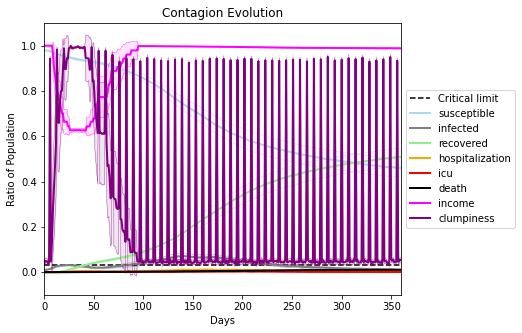

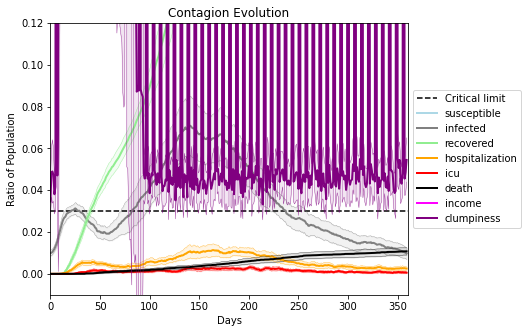

In [13]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.992
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7173, 2006, 7713, 40, 574, 4799, 4581, 6633, 4690, 5595, 4325, 1637, 4299, 1202, 9929, 1056, 4639, 6029, 5983, 8390]
Average similarity between family members is 0.9127818220093449 at temperature -0.991
Average similarity between family and home is 0.9998534001684359 at temperature -1
Average similarity between students and their classroom is 0.5102658449889792 at temperature -0.991
Average classroom occupancy is 4.043478260869565 and number classrooms is 69
Average similarity between workers is 0.8229180265461543 at temperature -0.991
Average office occupancy is 3.357142857142857 and number offices is 196
Average friend similarity for adults: 0.8270322671806545 for kids: 0.6410801570020129
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.5360195149846139
avg restaurant similarity 0.35071390605550923
avg restaurant similarity 0.569359450238301
avg restaurant similarity 0.5459644952350229
avg restaurant similarity 0.6684222181539454
avg restaurant similarity 0.5555252564541683
avg restaurant similarity 0.4348695005286785
avg restaurant similarity 0.627423001240355
avg restaurant similarity 0.4938845769205941
avg restaurant similarity 0.5168443134738196
avg restaurant similarity 0.4660222860547957
avg restaurant similarity 0.5783630444683618
avg restaurant similarity 0.4435982419874338
avg restaurant similarity 0.40164969118020344
avg restaurant similarity 0.5210628395484568
avg restaurant similarity 0.5865810292192059
avg restaurant similarity 0.3876227249080134
avg restaurant similarity 0.5521953185209738
avg restaurant similarity 0.47992638689123746
avg restaurant similarity 0.6549586080559111
avg restaurant similarity 0.3735532888090412
avg restaurant similarity 0.4431505616654725
avg resta

avg restaurant similarity 0.4301675528989616
avg restaurant similarity 0.5041762737117456
avg restaurant similarity 0.6052979991619549
avg restaurant similarity 0.46106294162679984
avg restaurant similarity 0.45737045108479196
avg restaurant similarity 0.37349725633836206
avg restaurant similarity 0.5004591248241689
avg restaurant similarity 0.3737146766615801
avg restaurant similarity 0.399285428328519
avg restaurant similarity 0.45520093786840166
avg restaurant similarity 0.47653041638056837
avg restaurant similarity 0.8641770851492374
avg restaurant similarity 0.37358428588889636
avg restaurant similarity 0.3761417044769891
avg restaurant similarity 0.4658585919012263
avg restaurant similarity 0.5191211912878649
avg restaurant similarity 0.4805517841332603
avg restaurant similarity 0.46954189220041576
avg restaurant similarity 0.5493504128286641
avg restaurant similarity 0.556913882569413
avg restaurant similarity 0.52761470115144
avg restaurant similarity 0.5199148756617954
avg res

avg restaurant similarity 0.6026621768096723
avg restaurant similarity 0.5604850768251735
avg restaurant similarity 0.3957592421953181
avg restaurant similarity 0.4325538174430786
avg restaurant similarity 0.4816654744663006
avg restaurant similarity 0.6416032444401167
avg restaurant similarity 0.6067283293985261
avg restaurant similarity 0.4986098703977319
avg restaurant similarity 0.47861076144406284
avg restaurant similarity 0.5291058012213904
avg restaurant similarity 0.3925457877666665
avg restaurant similarity 0.5860245421714247
avg restaurant similarity 0.49256706281149387
avg restaurant similarity 0.40700982997840646
avg restaurant similarity 0.6653362226782401
avg restaurant similarity 0.594945568893926
avg restaurant similarity 0.6400763359451934
avg restaurant similarity 0.4061361224954875
avg restaurant similarity 0.28129121423364395
avg restaurant similarity 0.538683408001644
avg restaurant similarity 0.6015354431806808
avg restaurant similarity 0.7039542156239998
avg rest

avg restaurant similarity 0.5569509698804997
avg restaurant similarity 0.4929956350150664
avg restaurant similarity 0.6043904536938057
avg restaurant similarity 0.6174634046399914
avg restaurant similarity 0.4676955784041176
avg restaurant similarity 0.6003846135995365
avg restaurant similarity 0.6778042569114545
avg restaurant similarity 0.531768601738017
avg restaurant similarity 0.8519364646946301
avg restaurant similarity 0.5923919574903053
avg restaurant similarity 0.8097853517001428
avg restaurant similarity 0.4290378208868912
avg restaurant similarity 0.5159599396767435
avg restaurant similarity 0.6488525934107648
avg restaurant similarity 0.8120585450490333
avg restaurant similarity 0.6141852971355369
avg restaurant similarity 0.42593830359422025
avg restaurant similarity 0.6596943787417752
avg restaurant similarity 0.5633676696363605
avg restaurant similarity 0.5789694924090929
avg restaurant similarity 0.28228128590731305
avg restaurant similarity 0.5189515122768551
avg resta

avg restaurant similarity 0.653291411071689
avg restaurant similarity 0.6753999668403546
avg restaurant similarity 0.3722377527139417
avg restaurant similarity 0.6094412223697414
avg restaurant similarity 0.7638697690960452
avg restaurant similarity 0.4949591222644333
avg restaurant similarity 0.4706866282069755
avg restaurant similarity 0.6514673214328344
avg restaurant similarity 0.4326490885756697
avg restaurant similarity 0.7063184553206993
avg restaurant similarity 0.4903008225413499
avg restaurant similarity 0.5864945576791909
avg restaurant similarity 0.6251076846399445
avg restaurant similarity 0.7224988465761094
avg restaurant similarity 0.5561479646436153
avg restaurant similarity 0.7052528891916795
avg restaurant similarity 0.7595883064741845
avg restaurant similarity 0.7419720357856698
avg restaurant similarity 0.7143921708245443
avg restaurant similarity 0.5385350125460362
avg restaurant similarity 0.6562454408696932
avg restaurant similarity 0.5947374269483197
avg restaur

avg restaurant similarity 0.5629231817513611
avg restaurant similarity 0.6541632780640257
avg restaurant similarity 0.30051898030418156
avg restaurant similarity 0.5245802152588314
avg restaurant similarity 0.8829292885926083
avg restaurant similarity 0.6607603093887082
avg restaurant similarity 0.638603973813068
avg restaurant similarity 0.6205147195333309
avg restaurant similarity 0.30210726214050204
avg restaurant similarity 0.6568934963937526
avg restaurant similarity 0.5551432296739371
avg restaurant similarity 0.6410586494464068
avg restaurant similarity 0.5613600194530511
avg restaurant similarity 0.7021838452551877
avg restaurant similarity 0.47588366639551877
avg restaurant similarity 0.4955263708869974
avg restaurant similarity 0.5246834090187142
avg restaurant similarity 0.389353835076081
avg restaurant similarity 0.7875410958722516
avg restaurant similarity 0.4579321391440551
avg restaurant similarity 0.5524488574129696
avg restaurant similarity 0.5667339094254841
avg resta

avg restaurant similarity 0.4398142013998872
avg restaurant similarity 0.5762230458213958
avg restaurant similarity 0.3944083644169963
avg restaurant similarity 0.7174029101259972
avg restaurant similarity 0.660596100359238
avg restaurant similarity 0.5080578878174898
avg restaurant similarity 0.4425991281032367
avg restaurant similarity 0.41484338178974867
avg restaurant similarity 0.25228526500086557
avg restaurant similarity 0.34039057961480634
avg restaurant similarity 0.6289714731273178
avg restaurant similarity 0.35307610212010404
avg restaurant similarity 0.3856838844697177
avg restaurant similarity 0.5150407563170244
avg restaurant similarity 0.4598536617480998
avg restaurant similarity 0.28750228531375654
avg restaurant similarity 0.6124759577639671
avg restaurant similarity 0.44162859721548486
avg restaurant similarity 0.585843885552454
avg restaurant similarity 0.2851388100171534
avg restaurant similarity 0.4295322887511494
avg restaurant similarity 0.4925309014777004
avg re

avg restaurant similarity 0.28007128063496145
avg restaurant similarity 0.5088736184381416
avg restaurant similarity 0.5850517693698649
avg restaurant similarity 0.8950377669465625
avg restaurant similarity 0.4572482002043645
avg restaurant similarity 0.40159053318011156
avg restaurant similarity 0.9998515255469932
avg restaurant similarity 0.6615431359611602
avg restaurant similarity 0.6757648372125955
avg restaurant similarity 0.6673698793225642
avg restaurant similarity 0.6487415130104793
avg restaurant similarity 0.9477170674084583
avg restaurant similarity 0.6857171664658193
avg restaurant similarity 0.27335305492934814
avg restaurant similarity 0.7933193432445541
avg restaurant similarity 0.7895779014625633
avg restaurant similarity 0.50275665291086
avg restaurant similarity 0.5602376947958762
avg restaurant similarity 0.4165460442664487
avg restaurant similarity 0.42413416823882755
avg restaurant similarity 0.5906623705499282
avg restaurant similarity 0.5550043160286392
avg rest

avg restaurant similarity 0.5739727064967106
avg restaurant similarity 0.46681242272574613
avg restaurant similarity 0.519281904786694
avg restaurant similarity 0.5978125083710301
avg restaurant similarity 0.508126702730764
avg restaurant similarity 0.29392734493093053
avg restaurant similarity 0.5327682575205802
avg restaurant similarity 0.5113922768868823
avg restaurant similarity 0.6005222946560295
avg restaurant similarity 0.5042717270292826
avg restaurant similarity 0.5847210551678241
avg restaurant similarity 0.5030651014007788
avg restaurant similarity 0.4502203685434243
avg restaurant similarity 0.46532199033592675
avg restaurant similarity 0.5869445819739938
avg restaurant similarity 0.3769013862394892
avg restaurant similarity 0.653401757927109
avg restaurant similarity 0.5663328592415638
avg restaurant similarity 0.41679695731071825
avg restaurant similarity 0.5063923729736917
avg restaurant similarity 0.4333462753875068
avg restaurant similarity 0.6020767260040119
avg resta

avg restaurant similarity 0.5180058484862122
avg restaurant similarity 0.6877736835151615
avg restaurant similarity 0.3880597358820188
avg restaurant similarity 0.4818563212248779
avg restaurant similarity 0.5361307105905178
avg restaurant similarity 0.5186392975272041
avg restaurant similarity 0.4987754181703039
avg restaurant similarity 0.3061157756086786
avg restaurant similarity 0.42302573609769534
avg restaurant similarity 0.5225429540229477
avg restaurant similarity 0.4079060866540599
avg restaurant similarity 0.5604633505761848
avg restaurant similarity 0.6498521491264486
avg restaurant similarity 0.7298092024182453
avg restaurant similarity 0.5693266193009311
avg restaurant similarity 0.5633177400422089
avg restaurant similarity 0.4378866552470664
avg restaurant similarity 0.5180248996543398
avg restaurant similarity 0.4150648319301097
avg restaurant similarity 0.7120067442316182
avg restaurant similarity 0.3992260968874576
avg restaurant similarity 0.5931652187247657
avg resta

avg restaurant similarity 0.484323478221353
avg restaurant similarity 0.4904347330509306
avg restaurant similarity 0.48865827153105823
avg restaurant similarity 0.6960078407682517
avg restaurant similarity 0.4794199457318351
avg restaurant similarity 0.5559211857476435
avg restaurant similarity 0.515509171261529
avg restaurant similarity 0.45509085969504104
avg restaurant similarity 0.48853533859029147
avg restaurant similarity 0.6362755772826337
avg restaurant similarity 0.3046740834438238
avg restaurant similarity 0.476157075519579
avg restaurant similarity 0.35599058937531264
avg restaurant similarity 0.41158002186154985
avg restaurant similarity 0.5149484586793182
avg restaurant similarity 0.41853613733638656
avg restaurant similarity 0.5774968841321535
avg restaurant similarity 0.31734463376625555
avg restaurant similarity 0.5851723419289573
avg restaurant similarity 0.5179422077775362
avg restaurant similarity 0.5528388900456478
avg restaurant similarity 0.4109565999659635
avg re

avg restaurant similarity 0.701817475055191
avg restaurant similarity 0.5589906245187014
avg restaurant similarity 0.6009232167682912
avg restaurant similarity 0.4797032444370105
avg restaurant similarity 0.6959028632992148
avg restaurant similarity 0.5751557420774747
avg restaurant similarity 0.7062405490870998
avg restaurant similarity 0.5357648766191004
avg restaurant similarity 0.33054427981838386
avg restaurant similarity 0.5793428785168491
avg restaurant similarity 0.4280104124939
avg restaurant similarity 0.6623665260248397
avg restaurant similarity 0.3826439591462865
avg restaurant similarity 0.54860713409879
avg restaurant similarity 0.3998409699574405
avg restaurant similarity 0.40629563517503364
avg restaurant similarity 0.5052052089693287
avg restaurant similarity 0.5133160522350172
avg restaurant similarity 0.41782042875741754
avg restaurant similarity 0.6435992942166369
avg restaurant similarity 0.4737133394301865
avg restaurant similarity 0.44028198373833616
avg restaura

avg restaurant similarity 0.642602093297006
avg restaurant similarity 0.5687097317326196
avg restaurant similarity 0.529724532704967
avg restaurant similarity 0.46806850857504034
avg restaurant similarity 0.46630126866868177
avg restaurant similarity 0.6627194348444656
avg restaurant similarity 0.37375715701903917
avg restaurant similarity 0.4190566696791114
avg restaurant similarity 0.6006610373602078
avg restaurant similarity 0.6349972286020635
avg restaurant similarity 0.4519234346298267
avg restaurant similarity 0.5430743556286592
avg restaurant similarity 0.572007936106387
avg restaurant similarity 0.6431538977775921
avg restaurant similarity 0.4330471241279466
avg restaurant similarity 0.6981959328545977
avg restaurant similarity 0.5773449364856015
avg restaurant similarity 0.6098712751275777
avg restaurant similarity 0.5032661950595622
avg restaurant similarity 0.5586716825633402
avg restaurant similarity 0.4811199912523031
avg restaurant similarity 0.507206767714027
avg restaur

avg restaurant similarity 0.7022944064982966
avg restaurant similarity 0.5253098517681095
avg restaurant similarity 0.6051780483483713
avg restaurant similarity 0.9996262522345467
avg restaurant similarity 0.4120314812523559
avg restaurant similarity 0.39718091278090023
avg restaurant similarity 0.5134108888244547
avg restaurant similarity 0.2415486902852679
avg restaurant similarity 0.5573397590120819
avg restaurant similarity 0.6654873366937705
avg restaurant similarity 0.5455513446045557
avg restaurant similarity 0.638372652830475
avg restaurant similarity 0.32315326834152863
avg restaurant similarity 0.36135005403711495
avg restaurant similarity 0.5009504651964753
avg restaurant similarity 0.46675940241208014
avg restaurant similarity 0.37171204983981754
avg restaurant similarity 0.06837255361816805
avg restaurant similarity 0.7040051924553448
avg restaurant similarity 0.5172212148366883
avg restaurant similarity 0.575996847028067
avg restaurant similarity 0.5661337067141576
avg re

avg restaurant similarity 0.42223768115234117
avg restaurant similarity 0.5935570827042158
avg restaurant similarity 0.4179028778602307
avg restaurant similarity 0.47749564650301446
avg restaurant similarity 0.42427441018829365
avg restaurant similarity 0.6928124157975168
avg restaurant similarity 0.4034761062382921
avg restaurant similarity 0.45761942142422085
avg restaurant similarity 0.5301710163569269
avg restaurant similarity 0.3463092444433398
avg restaurant similarity 0.693736856691045
avg restaurant similarity 0.47811086530664776
avg restaurant similarity 0.4670694517225962
avg restaurant similarity 0.6431907006342084
avg restaurant similarity 0.3359759359329322
avg restaurant similarity 0.5296482110365575
avg restaurant similarity 0.558577320546198
avg restaurant similarity 0.5007040648063851
avg restaurant similarity 0.5487442083015007
avg restaurant similarity 0.4301448633443768
avg restaurant similarity 0.47401737515809256
avg restaurant similarity 0.4453623823297362
avg re

avg restaurant similarity 0.5180893214795609
avg restaurant similarity 0.4755762597939387
avg restaurant similarity 0.637977239521708
avg restaurant similarity 0.5419065604928942
avg restaurant similarity 0.5951523358545656
avg restaurant similarity 0.5445682300755653
avg restaurant similarity 0.5775578170888256
avg restaurant similarity 0.5823087258710252
avg restaurant similarity 0.41444806367213693
avg restaurant similarity 0.5900752959102443
avg restaurant similarity 0.4410305632301766
avg restaurant similarity 0.34051182726118373
avg restaurant similarity 0.384908842502882
avg restaurant similarity 0.49329276641665
avg restaurant similarity 0.40927024947605406
avg restaurant similarity 0.6066708564423814
avg restaurant similarity 0.37416132208936237
avg restaurant similarity 0.4885352608740086
avg restaurant similarity 0.3654858404647557
avg restaurant similarity 0.4976858886582068
avg restaurant similarity 0.3838474320116992
avg restaurant similarity 0.4786661205001179
avg restau

avg restaurant similarity 0.6060796738077302
avg restaurant similarity 0.48734406676292935
avg restaurant similarity 0.46525846359479417
avg restaurant similarity 0.5147575910996072
avg restaurant similarity 0.5372329871635989
avg restaurant similarity 0.4907430671819106
avg restaurant similarity 0.5599689270450536
avg restaurant similarity 0.5242682215255099
avg restaurant similarity 0.48724717016434943
avg restaurant similarity 0.4787888588732497
avg restaurant similarity 0.47295675666013126
avg restaurant similarity 0.5358573211119125
avg restaurant similarity 0.6629504315329297
avg restaurant similarity 0.5665385447815485
avg restaurant similarity 0.5249294569456741
avg restaurant similarity 0.775059255908966
avg restaurant similarity 0.43331220838505125
avg restaurant similarity 0.5168383583465146
avg restaurant similarity 0.39453020496551927
avg restaurant similarity 0.5564893262152416
avg restaurant similarity 0.386857804266819
avg restaurant similarity 0.4539613959994549
avg re

avg restaurant similarity 0.8972190388384813
avg restaurant similarity 0.6405165908889933
avg restaurant similarity 0.6452729474312063
avg restaurant similarity 0.6774186298675243
avg restaurant similarity 0.39426229598281226
avg restaurant similarity 0.8498796083865426
avg restaurant similarity 0.5751799280469624
avg restaurant similarity 0.3915406347865604
avg restaurant similarity 0.5289373805550521
avg restaurant similarity 0.3435260426500411
avg restaurant similarity 0.6979399019786896
avg restaurant similarity 0.5649629439254091
avg restaurant similarity 0.5389859261010292
avg restaurant similarity 0.5132519945474093
avg restaurant similarity 0.49540222325646377
avg restaurant similarity 0.599272937151166
avg restaurant similarity 0.6373499099119193
avg restaurant similarity 0.4385390187290433
avg restaurant similarity 0.4891302667996251
avg restaurant similarity 0.5400665982051818
avg restaurant similarity 0.47145576552960367
avg restaurant similarity 0.4136324506777735
avg rest

avg restaurant similarity 0.47204554391642195
avg restaurant similarity 0.46117906200763104
avg restaurant similarity 0.5413616781428805
avg restaurant similarity 0.437088678090211
avg restaurant similarity 0.3558489630060809
avg restaurant similarity 0.5424655704144993
avg restaurant similarity 0.45819189128338017
avg restaurant similarity 0.5557234083452137
avg restaurant similarity 0.4595739059649535
avg restaurant similarity 0.4269999768861664
avg restaurant similarity 0.3109943447037785
avg restaurant similarity 0.38800680572026613
avg restaurant similarity 0.4517578234296293
avg restaurant similarity 0.5854700291086241
avg restaurant similarity 0.28896913842352934
avg restaurant similarity 0.4077237187747352
avg restaurant similarity 0.21677008147749985
avg restaurant similarity 0.6065567026944861
avg restaurant similarity 0.5687272320039644
avg restaurant similarity 0.4806819591374869
avg restaurant similarity 0.7385849218552607
avg restaurant similarity 0.6463414339656657
avg r

avg restaurant similarity 0.5490393297301426
avg restaurant similarity 0.2992869392550685
avg restaurant similarity 0.4049633460128627
avg restaurant similarity 0.5065277805726718
avg restaurant similarity 0.512168311572333
avg restaurant similarity 0.48760124236054997
avg restaurant similarity 0.5896552767807351
avg restaurant similarity 0.3599384708780925
avg restaurant similarity 0.33498378360154374
avg restaurant similarity 0.41983133074493295
avg restaurant similarity 0.3469604365403379
avg restaurant similarity 0.33184994495854764
avg restaurant similarity 0.43957352114367493
avg restaurant similarity 0.4439295471830418
avg restaurant similarity 0.21870943464690568
avg restaurant similarity 0.5550414680924347
avg restaurant similarity 0.5269022427023267
avg restaurant similarity 0.6476161912453485
avg restaurant similarity 0.5190408246231003
avg restaurant similarity 0.48935164003751735
avg restaurant similarity 0.4872443078929152
avg restaurant similarity 0.7047001464911017
avg 

avg restaurant similarity 0.47746848835489797
avg restaurant similarity 0.6639416232316177
avg restaurant similarity 0.6493874158105492
avg restaurant similarity 0.425645792792464
avg restaurant similarity 0.4781072714859845
avg restaurant similarity 0.6260464952525655
avg restaurant similarity 0.5826189066560348
avg restaurant similarity 0.6945191661956656
avg restaurant similarity 0.520694265147727
avg restaurant similarity 0.4932549395057998
avg restaurant similarity 0.5529115304367574
avg restaurant similarity 0.5186122324467061
avg restaurant similarity 0.5468050043388365
avg restaurant similarity 0.5430678253943785
avg restaurant similarity 0.43991906376389767
avg restaurant similarity 0.5153883044710541
avg restaurant similarity 0.5990206346283842
avg restaurant similarity 0.3645902185042145
avg restaurant similarity 0.6066103891758632
avg restaurant similarity 0.5128968945433677
avg restaurant similarity 0.6209262453355576
avg restaurant similarity 0.5658801674008616
avg restau

avg restaurant similarity 0.6706197995353801
avg restaurant similarity 0.6487279504618075
avg restaurant similarity 0.4531099253571191
avg restaurant similarity 0.6761471076522065
avg restaurant similarity 0.6463325604819942
avg restaurant similarity 0.6944228592744849
avg restaurant similarity 0.5479500991225672
avg restaurant similarity 0.5910758644187818
avg restaurant similarity 0.5349261793309501
avg restaurant similarity 0.6639416232316177
avg restaurant similarity 0.4318633394590176
avg restaurant similarity 0.8399173654826766
avg restaurant similarity 0.8093512307392593
avg restaurant similarity 0.6349406514184146
avg restaurant similarity 0.5611954115541277
avg restaurant similarity 0.5535185388189999
avg restaurant similarity 0.5325928421802198
avg restaurant similarity 0.6831182264260169
avg restaurant similarity 0.5241616689665884
avg restaurant similarity 0.5556908561514774
avg restaurant similarity 0.540440458200335
avg restaurant similarity 0.381233936365649
avg restaura

avg restaurant similarity 0.8394671270551534
avg restaurant similarity 0.6015324165421027
avg restaurant similarity 0.5735250284621576
avg restaurant similarity 0.7117475899301317
avg restaurant similarity 0.6328522195632029
avg restaurant similarity 0.7674895671792532
avg restaurant similarity 0.5168440292711479
avg restaurant similarity 0.6384118861735056
avg restaurant similarity 0.40042625692632144
avg restaurant similarity 0.6668583851451569
avg restaurant similarity 0.4022113182712884
avg restaurant similarity 0.616231636997214
avg restaurant similarity 0.4962188826083279
avg restaurant similarity 0.4798354367054595
avg restaurant similarity 0.37774604337443596
avg restaurant similarity 0.47651115618926515
avg restaurant similarity 0.6311678231630848
avg restaurant similarity 0.40817709395329976
avg restaurant similarity 0.6882286397344302
avg restaurant similarity 0.6075374227730564
avg restaurant similarity 0.7744987878310488
avg restaurant similarity 0.5301056676510504
avg res

avg restaurant similarity 0.8346291910320773
avg restaurant similarity 0.47133799012927585
avg restaurant similarity 0.6935162492310571
avg restaurant similarity 0.5629382749867271
avg restaurant similarity 0.6586615961231922
avg restaurant similarity 0.4977206954075917
avg restaurant similarity 0.6550965324533663
avg restaurant similarity 0.43687998391560734
avg restaurant similarity 0.6303558658105246
avg restaurant similarity 0.6602446415902637
avg restaurant similarity 0.7910101621257316
avg restaurant similarity 0.5608502570032816
avg restaurant similarity 0.5703374168585476
avg restaurant similarity 0.47618634498987633
avg restaurant similarity 0.8276729043103004
avg restaurant similarity 0.5198332301956874
avg restaurant similarity 0.5581133839422291
avg restaurant similarity 0.702565046661155
avg restaurant similarity 0.5110210120252301
avg restaurant similarity 0.6469760350916426
avg restaurant similarity 0.6390519615860948
avg restaurant similarity 0.6061738629290724
avg rest

avg restaurant similarity 0.45088543137119297
avg restaurant similarity 0.5254788662512043
avg restaurant similarity 0.4956642574792152
avg restaurant similarity 0.5710105008338064
avg restaurant similarity 0.4958613361525978
avg restaurant similarity 0.3628818148776207
avg restaurant similarity 0.4804516853169267
avg restaurant similarity 0.4116877207182823
avg restaurant similarity 0.4963948989460765
avg restaurant similarity 0.4671075922781823
avg restaurant similarity 0.5871256704395551
avg restaurant similarity 0.618303968685288
avg restaurant similarity 0.3705735511573501
avg restaurant similarity 0.42428282274667306
avg restaurant similarity 0.5976427479261863
avg restaurant similarity 0.6506537363038827
avg restaurant similarity 0.4681242410354264
avg restaurant similarity 0.5835159411705685
avg restaurant similarity 0.535413296516576
avg restaurant similarity 0.5079622888974898
avg restaurant similarity 0.350574883330501
avg restaurant similarity 0.5788577237374204
avg restaur

avg restaurant similarity 0.243266948001599
avg restaurant similarity 0.5518118001695651
avg restaurant similarity 0.5344187585179287
avg restaurant similarity 0.5515615452500826
avg restaurant similarity 0.42165395769285813
avg restaurant similarity 0.622545826423869
avg restaurant similarity 0.3493209010719465
avg restaurant similarity 0.5218732615379084
avg restaurant similarity 0.5239127754459503
avg restaurant similarity 0.4170007471021002
avg restaurant similarity 0.43851046678665073
avg restaurant similarity 0.6907194869107468
avg restaurant similarity 0.5728551931107619
avg restaurant similarity 0.42605800980138875
avg restaurant similarity 0.6268094175271507
avg restaurant similarity 0.5231836427021448
avg restaurant similarity 0.45489350844737375
avg restaurant similarity 0.43752376282330097
avg restaurant similarity 0.4028527303080199
avg restaurant similarity 0.575385810870448
avg restaurant similarity 0.3610248185602573
avg restaurant similarity 0.3986639299802141
avg rest

avg restaurant similarity 0.5613023661014528
avg restaurant similarity 0.6010533780711866
avg restaurant similarity 0.6023041762482355
avg restaurant similarity 0.5562137829460392
avg restaurant similarity 0.45753906957489054
avg restaurant similarity 0.6543488412404853
avg restaurant similarity 0.4937741788816193
avg restaurant similarity 0.5608237805420788
avg restaurant similarity 0.3799075910794177
avg restaurant similarity 0.35461260624380253
avg restaurant similarity 0.5969488677735356
avg restaurant similarity 0.5517711081064381
avg restaurant similarity 0.5261156861343828
avg restaurant similarity 0.5471303451494985
avg restaurant similarity 0.6779394895515783
avg restaurant similarity 0.5143167114282946
avg restaurant similarity 0.6013224964010053
avg restaurant similarity 0.5841612268306944
avg restaurant similarity 0.5636569259304622
avg restaurant similarity 0.5929588238066634
avg restaurant similarity 0.5305310100836477
avg restaurant similarity 0.5561330916080153
avg rest

avg restaurant similarity 0.5183214282401287
avg restaurant similarity 0.6510874705742636
avg restaurant similarity 0.6229975460675946
avg restaurant similarity 0.6146661567437908
avg restaurant similarity 0.536768427272452
avg restaurant similarity 0.7774518233488537
avg restaurant similarity 0.49616539518478175
avg restaurant similarity 0.5947528807876625
avg restaurant similarity 0.5836252477244451
avg restaurant similarity 0.5317363747191799
avg restaurant similarity 0.5389890091900971
avg restaurant similarity 0.6098569957744524
avg restaurant similarity 0.28362883128602057
avg restaurant similarity 0.5962926670675369
avg restaurant similarity 0.6537807723043141
avg restaurant similarity 0.4389659438583377
avg restaurant similarity 0.41980045559884227
avg restaurant similarity 0.4925586007329025
avg restaurant similarity 0.6099193307275262
avg restaurant similarity 0.6092032876899269
avg restaurant similarity 0.5303918273610584
avg restaurant similarity 0.5196714470018151
avg rest

avg restaurant similarity 0.5397490765194193
avg restaurant similarity 0.5002032288438255
avg restaurant similarity 0.5238100112464885
avg restaurant similarity 0.550845568787548
avg restaurant similarity 0.4940234540457705
avg restaurant similarity 0.532822115886069
avg restaurant similarity 0.6062207094403085
avg restaurant similarity 0.41095152066683016
avg restaurant similarity 0.43091986133500315
avg restaurant similarity 0.42539339420772243
avg restaurant similarity 0.5584450894081778
avg restaurant similarity 0.636160944054843
avg restaurant similarity 0.4313183201631642
avg restaurant similarity 0.5163777796288155
avg restaurant similarity 0.5730890446102236
avg restaurant similarity 0.5175562285435014
avg restaurant similarity 0.40418265688507155
avg restaurant similarity 0.6207491730381709
avg restaurant similarity 0.5235400375736677
avg restaurant similarity 0.5776526697761235
avg restaurant similarity 0.5060374443107489
avg restaurant similarity 0.4686258149741016
avg resta

avg restaurant similarity 0.5145027804636859
avg restaurant similarity 0.46684317426405525
avg restaurant similarity 0.4419140732180595
avg restaurant similarity 0.5219072499390143
avg restaurant similarity 0.44656686640751664
avg restaurant similarity 0.45596792293019384
avg restaurant similarity 0.4707315356283503
avg restaurant similarity 0.5162786847226364
avg restaurant similarity 0.525151838711864
avg restaurant similarity 0.4436560314703712
avg restaurant similarity 0.4152832149180973
avg restaurant similarity 0.44742895659395115
avg restaurant similarity 0.47128247276632335
avg restaurant similarity 0.5354764431656733
avg restaurant similarity 0.5220776677331016
avg restaurant similarity 0.5069177764162095
avg restaurant similarity 0.5568814708252434
avg restaurant similarity 0.49120033748834935
avg restaurant similarity 0.4732374555825449
avg restaurant similarity 0.5266994605525221
avg restaurant similarity 0.41643833602642816
avg restaurant similarity 0.6193056495931942
avg 

avg restaurant similarity 0.38331498276244436
avg restaurant similarity 0.38446749686021536
avg restaurant similarity 0.47502069507210537
avg restaurant similarity 0.5309187701452439
avg restaurant similarity 0.538812659609406
avg restaurant similarity 0.4028326128203912
avg restaurant similarity 0.359647584083086
avg restaurant similarity 0.3254207885609984
avg restaurant similarity 0.3668569370217397
avg restaurant similarity 0.5851379173022935
avg restaurant similarity 0.49806762164429685
avg restaurant similarity 0.43610137315101366
avg restaurant similarity 0.4707976844336357
avg restaurant similarity 0.4825480815926543
avg restaurant similarity 0.5172457586948235
avg restaurant similarity 0.46963040479610574
avg restaurant similarity 0.3024514118925795
avg restaurant similarity 0.4278061055178754
avg restaurant similarity 0.36818323086330357
avg restaurant similarity 0.5318048050321054
avg restaurant similarity 0.42196010138247786
avg restaurant similarity 0.41180230512200755
avg

avg restaurant similarity 0.37930425116317157
avg restaurant similarity 0.49813766354827393
avg restaurant similarity 0.3740324801602638
avg restaurant similarity 0.3804829303108949
avg restaurant similarity 0.3493549293747315
avg restaurant similarity 0.9999106317026176
avg restaurant similarity 0.49190250991284373
avg restaurant similarity 0.4608525863121849
avg restaurant similarity 0.5317530029340075
avg restaurant similarity 0.49622950074875644
avg restaurant similarity 0.5201106776906989
avg restaurant similarity 0.292746261937579
avg restaurant similarity 0.4850930036710618
avg restaurant similarity 0.48515055144884345
avg restaurant similarity 0.508641048969308
avg restaurant similarity 0.5497601759221181
avg restaurant similarity 0.5264747600226305
avg restaurant similarity 0.27263695323889103
avg restaurant similarity 0.43191007630202577
avg restaurant similarity 0.3603324260241273
avg restaurant similarity 0.5360306248746096
avg restaurant similarity 0.4520742685449394
avg r

avg restaurant similarity 0.8047000394145869
avg restaurant similarity 0.8091744561101307
avg restaurant similarity 0.755048863355246
avg restaurant similarity 0.6905405102320179
avg restaurant similarity 0.627695308686885
avg restaurant similarity 0.4318575134124596
avg restaurant similarity 0.6736090179426361
avg restaurant similarity 0.3808725890164048
avg restaurant similarity 0.43270648934343403
avg restaurant similarity 0.4823172526498294
avg restaurant similarity 0.5106359697130747
avg restaurant similarity 0.3697517253997523
avg restaurant similarity 0.4667777397825396
avg restaurant similarity 0.7526708712962006
avg restaurant similarity 0.30794037588161804
avg restaurant similarity 0.4876899132583922
avg restaurant similarity 0.5159616193431562
avg restaurant similarity 0.5128789291961047
avg restaurant similarity 0.9442725145386944
avg restaurant similarity 0.35166777876368205
avg restaurant similarity 0.9997145376566752
avg restaurant similarity 0.76318473931917
avg restaur

avg restaurant similarity 0.5260290511431045
avg restaurant similarity 0.43654132454461925
avg restaurant similarity 0.7630392244424129
avg restaurant similarity 0.999583442120315
avg restaurant similarity 0.67415478783079
avg restaurant similarity 0.4112684116224896
avg restaurant similarity 0.22161293852805358
avg restaurant similarity 0.5188803940159382
avg restaurant similarity 0.4892016473487506
avg restaurant similarity 0.43807140469968936
avg restaurant similarity 0.6956477636403657
avg restaurant similarity 0.7849252411417169
avg restaurant similarity 0.5130451966654022
avg restaurant similarity 0.4641967189189009
avg restaurant similarity 0.5329304820576325
avg restaurant similarity 0.4678411608485735
avg restaurant similarity 0.8769222501508129
avg restaurant similarity 0.7559726050159543
avg restaurant similarity 0.4979985823677875
avg restaurant similarity 0.2905874752112153
avg restaurant similarity 0.5253737557664885
avg restaurant similarity 0.4530308671978195
avg restau

avg restaurant similarity 0.49849720750723775
avg restaurant similarity 0.6358887752503943
avg restaurant similarity 0.5930984429623567
avg restaurant similarity 0.43690474287488057
avg restaurant similarity 0.4567404980926578
avg restaurant similarity 0.39316110933932513
avg restaurant similarity 0.8433471886793071
avg restaurant similarity 0.43999844655038767
avg restaurant similarity 0.473945078767921
avg restaurant similarity 0.46298224162596546
avg restaurant similarity 0.5475683878107063
avg restaurant similarity 0.6466884473773834
avg restaurant similarity 0.5975231276449069
avg restaurant similarity 0.45555066952022694
avg restaurant similarity 0.2468412990025339
avg restaurant similarity -0.13825665901205886
avg restaurant similarity 0.4139994959082188
avg restaurant similarity 0.6562305309890542
avg restaurant similarity 0.5903891953978144
avg restaurant similarity 0.6712436861391019
avg restaurant similarity 0.5954230729504559
avg restaurant similarity 0.48061326969078244
av

avg restaurant similarity 0.7996152818443498
avg restaurant similarity 0.6293914054301678
avg restaurant similarity 0.5939121083991578
avg restaurant similarity 0.6165934236454028
avg restaurant similarity 0.46045614226565873
avg restaurant similarity 0.38947270100320946
avg restaurant similarity 0.5434582549735822
avg restaurant similarity 0.5279819980998902
avg restaurant similarity 0.3179203686108737
avg restaurant similarity 0.5464572066308144
avg restaurant similarity 0.7441123460402775
avg restaurant similarity 0.45558677512003715
avg restaurant similarity 0.5147264777936
avg restaurant similarity 0.5596266846764075
avg restaurant similarity 0.6325700403773551
avg restaurant similarity 0.5798469638612722
avg restaurant similarity 0.379039445357366
avg restaurant similarity 0.560413503138908
avg restaurant similarity 0.6019300582429102
avg restaurant similarity 0.8084994051718386
avg restaurant similarity 0.25118660660296444
avg restaurant similarity 0.539689396165234
avg restaura

avg restaurant similarity 0.5655826210866749
avg restaurant similarity 0.6137274654001401
avg restaurant similarity 0.4897401285758256
avg restaurant similarity 0.6382357882823481
avg restaurant similarity 0.3247019596790992
avg restaurant similarity 0.44652701195403655
avg restaurant similarity 0.5100576684183868
avg restaurant similarity 0.6725198546823533
avg restaurant similarity 0.7185643231534448
avg restaurant similarity 0.5476115330773996
avg restaurant similarity 0.48114221399869544
avg restaurant similarity 0.4962602091465015
avg restaurant similarity 0.6309284983859365
avg restaurant similarity 0.7479671888851177
avg restaurant similarity 0.5331713534283631
avg restaurant similarity 0.533463683673387
avg restaurant similarity 0.6654978408400536
avg restaurant similarity 0.5257939578144507
avg restaurant similarity 0.5874841888818815
avg restaurant similarity 0.547878392113539
avg restaurant similarity 0.6935332557084805
avg restaurant similarity 0.47138546306718104
avg resta

avg restaurant similarity 0.4517598939595479
avg restaurant similarity 0.39158260123228983
avg restaurant similarity 0.41626607346610417
avg restaurant similarity 0.4670911265005085
avg restaurant similarity 0.6159726742107473
avg restaurant similarity 0.6857957877818208
avg restaurant similarity 0.6272827435515068
avg restaurant similarity 0.4255077982197755
avg restaurant similarity 0.6474299548539669
avg restaurant similarity 0.37357999400737074
avg restaurant similarity 0.38389265261718936
avg restaurant similarity 0.566954441756694
avg restaurant similarity 0.7293884660596083
avg restaurant similarity 0.7944988925009464
avg restaurant similarity 0.5430837123331086
avg restaurant similarity 0.903332203777263
avg restaurant similarity 0.5827656432279815
avg restaurant similarity 0.6581594590394543
avg restaurant similarity 0.44660825832314843
avg restaurant similarity 0.45302122786523963
avg restaurant similarity 0.4798819955339441
avg restaurant similarity 0.602287042956306
avg res

avg restaurant similarity 0.4434334479374354
avg restaurant similarity 0.37126414106340855
avg restaurant similarity 0.5535113874726444
avg restaurant similarity 0.7011740766869402
avg restaurant similarity 0.4323421917434954
avg restaurant similarity 0.41909081445663476
avg restaurant similarity 0.5716060778073605
avg restaurant similarity 0.4251969683182294
avg restaurant similarity 0.6569876177327398
avg restaurant similarity 0.5336193200729406
avg restaurant similarity 0.6505470586236539
avg restaurant similarity 0.6459082276190977
avg restaurant similarity 0.4700206027478453
avg restaurant similarity 0.5767391868880433
avg restaurant similarity 0.4989982923053063
avg restaurant similarity 0.5839627355321392
avg restaurant similarity 0.600272445261713
avg restaurant similarity 0.5907888018411165
avg restaurant similarity 0.4700395346956767
avg restaurant similarity 0.5990847513259867
avg restaurant similarity 0.6634985692812327
avg restaurant similarity 0.38071677954221594
avg rest

avg restaurant similarity 0.5426409580238307
avg restaurant similarity 0.13743760487394172
avg restaurant similarity 0.5229551758290657
avg restaurant similarity 0.3475541610592309
avg restaurant similarity 0.45268981327703817
avg restaurant similarity 0.4966152072772394
avg restaurant similarity 0.43910364367035026
avg restaurant similarity 0.31994243142842865
avg restaurant similarity 0.3937191064773733
avg restaurant similarity 0.5439092142892011
avg restaurant similarity 0.3810003815048064
avg restaurant similarity 0.5404410200848686
avg restaurant similarity 0.3638632012127675
avg restaurant similarity 0.5021416889656338
avg restaurant similarity 0.6421969571782781
avg restaurant similarity 0.5184574203449579
avg restaurant similarity 0.6747117005762527
avg restaurant similarity 0.4633436024629061
avg restaurant similarity 0.3570820250166831
avg restaurant similarity 0.46817058268715983
avg restaurant similarity 0.43711161529636916
avg restaurant similarity 0.7567730152182675
avg 

(<function dict.items>, <function dict.items>, <function dict.items>)

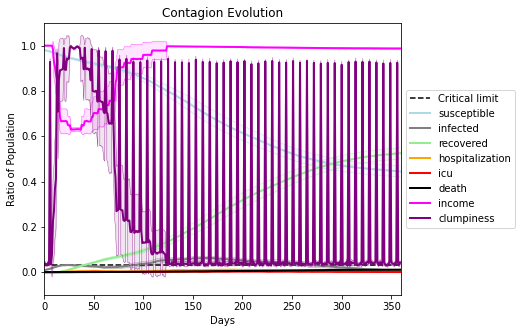

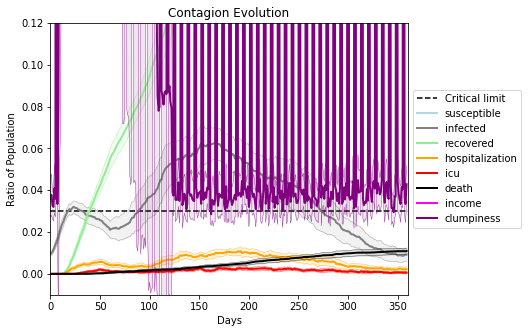

In [14]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.991
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5602, 1571, 3237, 230, 5843, 682, 666, 8299, 1158, 9207, 5848, 8630, 2210, 9356, 7233, 1028, 2553, 7779, 1793, 2707]
Average similarity between family members is 0.8999188751890292 at temperature -0.99
Average similarity between family and home is 0.9998532342248534 at temperature -1
Average similarity between students and their classroom is 0.5000947385162391 at temperature -0.99
Average classroom occupancy is 3.7971014492753623 and number classrooms is 69
Average similarity between workers is 0.8303498243992969 at temperature -0.99
Average office occupancy is 3.50253807106599 and number offices is 197
Average friend similarity for adults: 0.8380780854746513 for kids: 0.646377264557021
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homog

avg restaurant similarity 0.39959517650551424
avg restaurant similarity 0.5195067049487699
avg restaurant similarity 0.4169242488606349
avg restaurant similarity 0.6609388877908683
avg restaurant similarity 0.4649085277773182
avg restaurant similarity 0.4632819754343336
avg restaurant similarity 0.44031000073026194
avg restaurant similarity 0.34221159273668145
avg restaurant similarity 0.5887463513789148
avg restaurant similarity 0.38490098628588437
avg restaurant similarity 0.5519977330465913
avg restaurant similarity 0.5845164998812536
avg restaurant similarity 0.5245734561038684
avg restaurant similarity 0.5020987669176712
avg restaurant similarity 0.5230178155900603
avg restaurant similarity 0.48545456322011643
avg restaurant similarity 0.6381583227751382
avg restaurant similarity 0.575604546410301
avg restaurant similarity 0.5745401018444536
avg restaurant similarity 0.47984662548463014
avg restaurant similarity 0.45916529946849177
avg restaurant similarity 0.47436699305494606
avg

avg restaurant similarity 0.555779271190109
avg restaurant similarity 0.42037745413605615
avg restaurant similarity 0.4887403307399711
avg restaurant similarity 0.39717726910211437
avg restaurant similarity 0.3596002543781494
avg restaurant similarity 0.5137037416361484
avg restaurant similarity 0.7207295637801189
avg restaurant similarity 0.5581504604647148
avg restaurant similarity 0.5682649720607061
avg restaurant similarity 0.2563112357311418
avg restaurant similarity 0.40881129941286143
avg restaurant similarity 0.45721600424014774
avg restaurant similarity 0.714273514623411
avg restaurant similarity 0.4838571645230509
avg restaurant similarity 0.4167511094498858
avg restaurant similarity 0.6246209707257134
avg restaurant similarity 0.6327678462376948
avg restaurant similarity 0.38432685571695474
avg restaurant similarity 0.5569599132435814
avg restaurant similarity 0.46886428913467604
avg restaurant similarity 0.579198116868908
avg restaurant similarity 0.5581568715511788
avg res

avg restaurant similarity 0.442694940180578
avg restaurant similarity 0.5493020383030749
avg restaurant similarity 0.4677515511281866
avg restaurant similarity 0.6028398135656863
avg restaurant similarity 0.49131880825557617
avg restaurant similarity 0.4256145644695114
avg restaurant similarity 0.6475275537185478
avg restaurant similarity 0.5280954986595827
avg restaurant similarity 0.3797746970470984
avg restaurant similarity 0.3661963075256144
avg restaurant similarity 0.7279560444270056
avg restaurant similarity 0.5991690279674114
avg restaurant similarity 0.49837050086027934
avg restaurant similarity 0.27989853085951943
avg restaurant similarity 0.4591233033436308
avg restaurant similarity 0.513027060779766
avg restaurant similarity 0.5958087628300922
avg restaurant similarity 0.4416706334956253
avg restaurant similarity 0.5597732499967014
avg restaurant similarity 0.3395493692603296
avg restaurant similarity 0.3786662999034393
avg restaurant similarity 0.48670796429147806
avg rest

avg restaurant similarity 0.49692573112421257
avg restaurant similarity 0.490928795122368
avg restaurant similarity 0.5211739369529184
avg restaurant similarity 0.44045285629131065
avg restaurant similarity 0.5244445901392062
avg restaurant similarity 0.42438976638416004
avg restaurant similarity 0.537488167498154
avg restaurant similarity 0.3290918727007224
avg restaurant similarity 0.4895063675817149
avg restaurant similarity 0.4241461945579243
avg restaurant similarity 0.45739596337296407
avg restaurant similarity 0.6245633294507029
avg restaurant similarity 0.8135119417319558
avg restaurant similarity 0.4623707276854986
avg restaurant similarity 0.4208576996003352
avg restaurant similarity 0.654883831105134
avg restaurant similarity 0.7421228342504925
avg restaurant similarity 0.6633248638208725
avg restaurant similarity 0.5359128035466416
avg restaurant similarity 0.4831104107025892
avg restaurant similarity 0.45456987513656877
avg restaurant similarity 0.46340987391487876
avg res

avg restaurant similarity 0.32989281667741527
avg restaurant similarity 0.3846607292127022
avg restaurant similarity 0.4833722185473486
avg restaurant similarity 0.7892118891557676
avg restaurant similarity 0.3525229066938788
avg restaurant similarity 0.19896189143754248
avg restaurant similarity 0.5855535972939859
avg restaurant similarity 0.3772362209606461
avg restaurant similarity 0.4162518882240035
avg restaurant similarity 0.39946416775002513
avg restaurant similarity 0.60212023453674
avg restaurant similarity 0.4724667277146429
avg restaurant similarity 0.48358882399964864
avg restaurant similarity 0.4088373939015001
avg restaurant similarity 0.5696908823080259
avg restaurant similarity 0.394314572288943
avg restaurant similarity 0.5469847275521502
avg restaurant similarity 0.5814202799618031
avg restaurant similarity 0.5366022225288974
avg restaurant similarity 0.7977540114137823
avg restaurant similarity 0.5512733786642114
avg restaurant similarity 0.5586819012963294
avg resta

avg restaurant similarity 0.34196716681723893
avg restaurant similarity 0.4005371091166528
avg restaurant similarity 0.57981609605027
avg restaurant similarity 0.5725553255910257
avg restaurant similarity 0.44250941502239594
avg restaurant similarity 0.47699173318066584
avg restaurant similarity 0.5109752229372487
avg restaurant similarity 0.4997766774501729
avg restaurant similarity 0.32156732126995285
avg restaurant similarity 0.43076315768416373
avg restaurant similarity 0.3335860833045966
avg restaurant similarity 0.38659532036280986
avg restaurant similarity 0.4949780010589795
avg restaurant similarity 0.6393540914200884
avg restaurant similarity 0.4874216479377923
avg restaurant similarity 0.46325384009237364
avg restaurant similarity 0.5600053438118737
avg restaurant similarity 0.34586020846731186
avg restaurant similarity 0.43729571319066096
avg restaurant similarity 0.4738599488445332
avg restaurant similarity 0.5154630119282145
avg restaurant similarity 0.7606801616714558
avg

avg restaurant similarity 0.48065084077511905
avg restaurant similarity 0.41227150965442183
avg restaurant similarity 0.4208865200843454
avg restaurant similarity 0.4625437750523577
avg restaurant similarity 0.5852608858098695
avg restaurant similarity 0.39745626160354386
avg restaurant similarity 0.4171418300038304
avg restaurant similarity 0.4098551758618316
avg restaurant similarity 0.44303616053246797
avg restaurant similarity 0.4662281407693694
avg restaurant similarity 0.4569083589807514
avg restaurant similarity 0.6169872901085427
avg restaurant similarity 0.587677091321475
avg restaurant similarity 0.6109341629884951
avg restaurant similarity 0.5540445638474183
avg restaurant similarity 0.6247256381393828
avg restaurant similarity 0.6880805687986749
avg restaurant similarity 0.5113692892500541
avg restaurant similarity 0.5688839455515244
avg restaurant similarity 0.60487872253072
avg restaurant similarity 0.4542158814928838
avg restaurant similarity 0.2666533862695868
avg resta

avg restaurant similarity 0.31384134844073114
avg restaurant similarity 0.5149955146483252
avg restaurant similarity 0.49145250503663307
avg restaurant similarity 0.4654634733697323
avg restaurant similarity 0.4899303356214416
avg restaurant similarity 0.5485937661378519
avg restaurant similarity 0.45049334910428723
avg restaurant similarity 0.4263139738761331
avg restaurant similarity 0.6996330863842292
avg restaurant similarity 0.4659656501372698
avg restaurant similarity 0.38147682135735905
avg restaurant similarity 0.3333561476417508
avg restaurant similarity 0.48467255347991534
avg restaurant similarity 0.4986142538845666
avg restaurant similarity 0.4731638059286172
avg restaurant similarity 0.49136871780867086
avg restaurant similarity 0.3379087704939649
avg restaurant similarity 0.47248896743401947
avg restaurant similarity 0.5021370240393039
avg restaurant similarity 0.5447260739131595
avg restaurant similarity 0.4734370974854453
avg restaurant similarity 0.38135765899050356
av

avg restaurant similarity 0.5632243852653259
avg restaurant similarity 0.4590267483363938
avg restaurant similarity 0.512127075802863
avg restaurant similarity 0.6157492094860987
avg restaurant similarity 0.6902445571954136
avg restaurant similarity 0.4928238545918432
avg restaurant similarity 0.5539310288269744
avg restaurant similarity 0.47137487335704314
avg restaurant similarity 0.999872865615816
avg restaurant similarity 0.625310063405347
avg restaurant similarity 0.5319047968811514
avg restaurant similarity 0.6167045727654539
avg restaurant similarity 0.5577781996165545
avg restaurant similarity 0.5462992709752382
avg restaurant similarity 0.5750728133455008
avg restaurant similarity 0.41948018506988405
avg restaurant similarity 0.6007319037281803
avg restaurant similarity 0.8532690142893596
avg restaurant similarity 0.5553944273517005
avg restaurant similarity 0.4928303746210731
avg restaurant similarity 0.5063559362238806
avg restaurant similarity 0.6906073187290691
avg restaur

avg restaurant similarity 0.34125494243185367
avg restaurant similarity 0.5309652946285449
avg restaurant similarity 0.5729771261761806
avg restaurant similarity 0.4854246370025883
avg restaurant similarity 0.3958873100510232
avg restaurant similarity 0.5139098701725473
avg restaurant similarity 0.4588642652389099
avg restaurant similarity 0.675936884354606
avg restaurant similarity 0.5148544882381372
avg restaurant similarity 0.5748769264209157
avg restaurant similarity 0.49539373970904504
avg restaurant similarity 0.5581462016606269
avg restaurant similarity 0.6152677472023677
avg restaurant similarity 0.3265350324042138
avg restaurant similarity 0.50279119945506
avg restaurant similarity 0.5424385868003061
avg restaurant similarity 0.7479614058502829
avg restaurant similarity 0.5372244431405389
avg restaurant similarity 0.5481518358581359
avg restaurant similarity 0.413636587789956
avg restaurant similarity 0.6123673189919814
avg restaurant similarity 0.5381157339208392
avg restaura

avg restaurant similarity 0.4402032755039229
avg restaurant similarity 0.5306716578893234
avg restaurant similarity 0.4960570717305618
avg restaurant similarity 0.568599932405678
avg restaurant similarity 0.4053124527565928
avg restaurant similarity 0.5553027543438586
avg restaurant similarity 0.5182503726291262
avg restaurant similarity 0.46273856713271977
avg restaurant similarity 0.48689685458126203
avg restaurant similarity 0.4022767913825942
avg restaurant similarity 0.6205664564677128
avg restaurant similarity 0.7092048426457018
avg restaurant similarity 0.5616285998246778
avg restaurant similarity 0.47080024122231845
avg restaurant similarity 0.4283852181652493
avg restaurant similarity 0.604725395357868
avg restaurant similarity 0.6024830425344332
avg restaurant similarity 0.6690759000108949
avg restaurant similarity 0.43975148289427823
avg restaurant similarity 0.4401887293171414
avg restaurant similarity 0.6560026237495917
avg restaurant similarity 0.4221676483160118
avg rest

avg restaurant similarity 0.8195037640710303
avg restaurant similarity 0.5389994450915415
avg restaurant similarity 0.47404123922144753
avg restaurant similarity 0.7428729788366559
avg restaurant similarity 0.58021638430931
avg restaurant similarity 0.6665538965260452
avg restaurant similarity 0.5402962489888716
avg restaurant similarity 0.6745078467601463
avg restaurant similarity 0.42729592453322945
avg restaurant similarity 0.2847068880580043
avg restaurant similarity 0.43064056909216725
avg restaurant similarity 0.4850543497223927
avg restaurant similarity 0.5926449400744672
avg restaurant similarity 0.6008153713043234
avg restaurant similarity 0.8575567021961096
avg restaurant similarity 0.3129826078963922
avg restaurant similarity 0.2951197817090842
avg restaurant similarity 0.570940481240786
avg restaurant similarity 0.6726892995217275
avg restaurant similarity 0.5726104050336711
avg restaurant similarity 0.5325254212534273
avg restaurant similarity 0.5685987383413984
avg restau

avg restaurant similarity 0.43209099332029827
avg restaurant similarity 0.4221608056343483
avg restaurant similarity 0.47721823301562855
avg restaurant similarity 0.43284118744882144
avg restaurant similarity 0.5746543168762572
avg restaurant similarity 0.4519744822306272
avg restaurant similarity 0.456930799694347
avg restaurant similarity 0.5194495100087219
avg restaurant similarity 0.553865606352855
avg restaurant similarity 0.40515442437457105
avg restaurant similarity 0.4263510430029366
avg restaurant similarity 0.3852981854980033
avg restaurant similarity 0.45409157684343576
avg restaurant similarity 0.4792147560529611
avg restaurant similarity 0.45359944992479917
avg restaurant similarity 0.3422989509921417
avg restaurant similarity 0.8905951429438446
avg restaurant similarity 0.4811563537956369
avg restaurant similarity 0.36993705064786786
avg restaurant similarity 0.5121534875526268
avg restaurant similarity 0.5039502625198944
avg restaurant similarity 0.5286411819564345
avg r

avg restaurant similarity 0.49547671370845975
avg restaurant similarity 0.3763963186343632
avg restaurant similarity 0.5778685540071533
avg restaurant similarity 0.5274867971558393
avg restaurant similarity 0.5860142099786244
avg restaurant similarity 0.4864376346615575
avg restaurant similarity 0.5401893037170394
avg restaurant similarity 0.445615575155595
avg restaurant similarity 0.6660584993899945
avg restaurant similarity 0.41480483232488913
avg restaurant similarity 0.5191363118982705
avg restaurant similarity 0.385645104773789
avg restaurant similarity 0.4385101125502766
avg restaurant similarity 0.5058715110198446
avg restaurant similarity 0.47854493855836866
avg restaurant similarity 0.5134615896406179
avg restaurant similarity 0.4688062888603752
avg restaurant similarity 0.3818210961464228
avg restaurant similarity 0.5345444818069168
avg restaurant similarity 0.3775786429270509
avg restaurant similarity 0.6741491627987566
avg restaurant similarity 0.3805248682373484
avg resta

avg restaurant similarity 0.6555471587917583
avg restaurant similarity 0.3587542850256733
avg restaurant similarity 0.3727848750859266
avg restaurant similarity 0.531864879007072
avg restaurant similarity 0.47244849179085846
avg restaurant similarity 0.5685111040258598
avg restaurant similarity 0.1903255331690363
avg restaurant similarity 0.34094853576963874
avg restaurant similarity 0.4680656613468672
avg restaurant similarity 0.5034342034211869
avg restaurant similarity 0.3080364117079636
avg restaurant similarity 0.4381603186441414
avg restaurant similarity 0.5412102656998529
avg restaurant similarity 0.40566510936816846
avg restaurant similarity 0.4654965349384197
avg restaurant similarity 0.44431574956686715
avg restaurant similarity 0.436100645690378
avg restaurant similarity 0.5226521352823262
avg restaurant similarity 0.461486200828211
avg restaurant similarity 0.5188243668036686
avg restaurant similarity 0.49319784248923776
avg restaurant similarity 0.4087639227852427
avg rest

avg restaurant similarity 0.342751549388455
avg restaurant similarity 0.4905953691866892
avg restaurant similarity 0.4449007032487617
avg restaurant similarity 0.4365916962470597
avg restaurant similarity 0.5699800131012207
avg restaurant similarity 0.5150401001033755
avg restaurant similarity 0.34199108831205743
avg restaurant similarity 0.5565514271910491
avg restaurant similarity 0.5358818593999544
avg restaurant similarity 0.5762406085094264
avg restaurant similarity 0.6461362302479773
avg restaurant similarity 0.4261106422937748
avg restaurant similarity 0.505495343817708
avg restaurant similarity 0.42962223334390454
avg restaurant similarity 0.5510117425755072
avg restaurant similarity 0.4036984736473674
avg restaurant similarity 0.7482022592018849
avg restaurant similarity 0.48444607951958935
avg restaurant similarity 0.38614238029949616
avg restaurant similarity 0.41241069398141866
avg restaurant similarity 0.39897534764694464
avg restaurant similarity 0.4486155321909188
avg re

avg restaurant similarity 0.5011317828650348
avg restaurant similarity 0.6285067640556736
avg restaurant similarity 0.5807948756302127
avg restaurant similarity 0.3918569586754997
avg restaurant similarity 0.3456098952494601
avg restaurant similarity 0.6626903203885497
avg restaurant similarity 0.4180334761579719
avg restaurant similarity 0.45264910459054153
avg restaurant similarity 0.4913316461469439
avg restaurant similarity 0.34804047257484666
avg restaurant similarity 0.5705515466189124
avg restaurant similarity 0.49580393447871546
avg restaurant similarity 0.5341302672054021
avg restaurant similarity 0.6237721186616061
avg restaurant similarity 0.6573851784804461
avg restaurant similarity 0.6333233320302943
avg restaurant similarity 0.5510218014310082
avg restaurant similarity 0.5189443027020608
avg restaurant similarity 0.7171748460752538
avg restaurant similarity 0.37600761017449
avg restaurant similarity 0.4912439799872214
avg restaurant similarity 0.7065091190883255
avg resta

avg restaurant similarity 0.29475415487376705
avg restaurant similarity 0.5287968806262572
avg restaurant similarity 0.6080022971906358
avg restaurant similarity 0.6180885800247106
avg restaurant similarity 0.49047654967056975
avg restaurant similarity 0.6499927027151129
avg restaurant similarity 0.7792127362326764
avg restaurant similarity 0.5683606559667063
avg restaurant similarity 0.48275223151988167
avg restaurant similarity 0.44912506955560655
avg restaurant similarity 0.5276880775194475
avg restaurant similarity 0.5036315442161501
avg restaurant similarity 0.4340260394217554
avg restaurant similarity 0.6435306537437336
avg restaurant similarity 0.5068700405644168
avg restaurant similarity 0.2839578256778935
avg restaurant similarity 0.4985499218382777
avg restaurant similarity 0.7004035083283345
avg restaurant similarity 0.5525084844879897
avg restaurant similarity 0.4781773779494882
avg restaurant similarity 0.6286334174924055
avg restaurant similarity 0.5375771243395243
avg re

avg restaurant similarity 0.2750769178925771
avg restaurant similarity 0.6492742649132088
avg restaurant similarity 0.5832342780348206
avg restaurant similarity 0.5119062286184602
avg restaurant similarity 0.713973455477624
avg restaurant similarity 0.5433247555526939
avg restaurant similarity 0.5109837398698723
avg restaurant similarity 0.612209161586738
avg restaurant similarity 0.5962456574345032
avg restaurant similarity 0.5655280042359089
avg restaurant similarity 0.34023543310411153
avg restaurant similarity 0.3710719899214423
avg restaurant similarity 0.4950417605745964
avg restaurant similarity 0.5602360162625892
avg restaurant similarity 0.4922355103845135
avg restaurant similarity 0.5846244880270759
avg restaurant similarity 0.5545369363479427
avg restaurant similarity 0.45311559701231835
avg restaurant similarity 0.44905013758015694
avg restaurant similarity 0.63581265620324
avg restaurant similarity 0.45459159315719294
avg restaurant similarity 0.49632636564007304
avg resta

avg restaurant similarity 0.44774585658304844
avg restaurant similarity 0.7024311407921449
avg restaurant similarity 0.6057230256480017
avg restaurant similarity 0.39334339154377695
avg restaurant similarity 0.24853927742023646
avg restaurant similarity 0.48589078056191115
avg restaurant similarity 0.35159025583627007
avg restaurant similarity 0.7854422615589346
avg restaurant similarity 0.7924563906617471
avg restaurant similarity 0.6085789615896582
avg restaurant similarity 0.40727324797923
avg restaurant similarity 0.5484552497789509
avg restaurant similarity 0.6506103375449959
avg restaurant similarity 0.4404672242453321
avg restaurant similarity 0.23942695711165218
avg restaurant similarity 0.5245375018212746
avg restaurant similarity 0.5113356150170909
avg restaurant similarity 0.652796468738736
avg restaurant similarity 0.746960078788527
avg restaurant similarity 0.7666303944129222
avg restaurant similarity 0.6768635996962683
avg restaurant similarity 0.584300562184036
avg resta

avg restaurant similarity 0.3625077252731463
avg restaurant similarity 0.5064361008960925
avg restaurant similarity 0.5586054943097449
avg restaurant similarity 0.5756731539059167
avg restaurant similarity 0.6056878747461942
avg restaurant similarity 0.3653767234414382
avg restaurant similarity 0.4578120345996526
avg restaurant similarity 0.36961478407740794
avg restaurant similarity 0.42899359230912915
avg restaurant similarity 0.6599974273927213
avg restaurant similarity 0.4641739741547847
avg restaurant similarity 0.3785388469923641
avg restaurant similarity 0.3744597279312713
avg restaurant similarity 0.3926828068254971
avg restaurant similarity 0.39232741194346454
avg restaurant similarity 0.46761191710402106
avg restaurant similarity 0.84093684325865
avg restaurant similarity 0.4107036858894292
avg restaurant similarity 0.40826880006930294
avg restaurant similarity 0.3134056823456557
avg restaurant similarity 0.5773119426703955
avg restaurant similarity 0.3724473472293874
avg res

avg restaurant similarity 0.4948552695464984
avg restaurant similarity 0.42267609116026
avg restaurant similarity 0.42497150662578154
avg restaurant similarity 0.1512192628454721
avg restaurant similarity 0.49498884887590483
avg restaurant similarity 0.27648527022860736
avg restaurant similarity 0.23402021803187123
avg restaurant similarity 0.36768587287007237
avg restaurant similarity 0.4731926397797547
avg restaurant similarity 0.35620870363855067
avg restaurant similarity 0.34604975732976023
avg restaurant similarity 0.4218140306900844
avg restaurant similarity 0.33356392661821843
avg restaurant similarity 0.4475999396794567
avg restaurant similarity 0.40827364445400144
avg restaurant similarity 0.285816802064666
avg restaurant similarity 0.5364459800221876
avg restaurant similarity 0.5059209082233759
avg restaurant similarity 0.28678374344299395
avg restaurant similarity 0.43360479906900923
avg restaurant similarity 0.5661352105858032
avg restaurant similarity 0.7504582149402279
av

avg restaurant similarity 0.5403484313099473
avg restaurant similarity 0.41593033170082677
avg restaurant similarity 0.4761693522319142
avg restaurant similarity 0.360952738617362
avg restaurant similarity 0.34275818123637547
avg restaurant similarity 0.35583472444377456
avg restaurant similarity 0.4126151876107831
avg restaurant similarity 0.4777170751495297
avg restaurant similarity 0.3447822576295105
avg restaurant similarity 0.3248766412801705
avg restaurant similarity 0.4175760872229996
avg restaurant similarity 0.3683000287285006
avg restaurant similarity 0.3265631383063546
avg restaurant similarity 0.529643034959597
avg restaurant similarity 0.3685636279780538
avg restaurant similarity 0.5466223905168628
avg restaurant similarity 0.39487348851355364
avg restaurant similarity 0.5146012512589039
avg restaurant similarity 0.7158821373326038
avg restaurant similarity 0.49771471036498843
avg restaurant similarity 0.4487860221365803
avg restaurant similarity 0.5367102233771835
avg res

avg restaurant similarity 0.5803965827448643
avg restaurant similarity 0.6198437855072045
avg restaurant similarity 0.4269299657003922
avg restaurant similarity 0.36069117025562347
avg restaurant similarity 0.28723695972344215
avg restaurant similarity 0.7170875065440353
avg restaurant similarity 0.3312882136117678
avg restaurant similarity 0.4257153799518601
avg restaurant similarity 0.4280036860338714
avg restaurant similarity 0.8403073428359604
avg restaurant similarity 0.3116537078610898
avg restaurant similarity 0.5784243602553774
avg restaurant similarity 0.3647566627257651
avg restaurant similarity 0.5191668122742321
avg restaurant similarity 0.4211936095982081
avg restaurant similarity 0.36260380770066547
avg restaurant similarity 0.31261061098580534
avg restaurant similarity 0.22303843296831
avg restaurant similarity 0.5209043890483402
avg restaurant similarity 0.3592361622293324
avg restaurant similarity 0.4457511885502779
avg restaurant similarity 0.3990196537686971
avg rest

avg restaurant similarity 0.6529462744102242
avg restaurant similarity 0.383591872316659
avg restaurant similarity 0.48389868350240883
avg restaurant similarity 0.32661514713158607
avg restaurant similarity 0.5276403914557177
avg restaurant similarity 0.5733577685138912
avg restaurant similarity 0.5296099124142182
avg restaurant similarity 0.5879010551144918
avg restaurant similarity 0.44121211420799006
avg restaurant similarity 0.6156588046623749
avg restaurant similarity 0.5042020130693257
avg restaurant similarity 0.6102464091578507
avg restaurant similarity 0.5328057923447534
avg restaurant similarity 0.5548513785775071
avg restaurant similarity 0.5048438864850027
avg restaurant similarity 0.5082729867692451
avg restaurant similarity 0.6084152041483464
avg restaurant similarity 0.5044281532778231
avg restaurant similarity 0.42736007765732026
avg restaurant similarity 0.6030511160352884
avg restaurant similarity 0.6454750579893191
avg restaurant similarity 0.3160403991007514
avg res

avg restaurant similarity 0.4292572307129808
avg restaurant similarity 0.5163532223675854
avg restaurant similarity 0.7602879302952432
avg restaurant similarity 0.49543657699484595
avg restaurant similarity 0.40126695677662844
avg restaurant similarity 0.5447002458782169
avg restaurant similarity 0.5417084411861617
avg restaurant similarity 0.3971138569605344
avg restaurant similarity 0.35487208527613656
avg restaurant similarity 0.8617788345737705
avg restaurant similarity 0.5707020042622263
avg restaurant similarity 0.6348187861618015
avg restaurant similarity 0.43970441368843627
avg restaurant similarity 0.46070883471697527
avg restaurant similarity 0.33897033614666483
avg restaurant similarity 0.4879662918727125
avg restaurant similarity 0.5482604486434537
avg restaurant similarity 0.6049141118013636
avg restaurant similarity 0.9997084006749521
avg restaurant similarity 0.7881955517967704
avg restaurant similarity 0.5000751920735489
avg restaurant similarity 0.45475053136004684
avg

avg restaurant similarity 0.5572492392668644
avg restaurant similarity 0.44815063157937374
avg restaurant similarity 0.45068384287418783
avg restaurant similarity 0.48988069640779885
avg restaurant similarity 0.21505585210739558
avg restaurant similarity 0.4946558463532003
avg restaurant similarity 0.4981506847045471
avg restaurant similarity 0.4706192168775054
avg restaurant similarity 0.4773929295263134
avg restaurant similarity 0.47332587139043125
avg restaurant similarity 0.3667919621466543
avg restaurant similarity 0.41853883238708817
avg restaurant similarity 0.4269888444985915
avg restaurant similarity 0.5419349216665792
avg restaurant similarity 0.4556049663354916
avg restaurant similarity 0.575159381348019
avg restaurant similarity 0.4632857465351859
avg restaurant similarity 0.4860658427206148
avg restaurant similarity 0.38722298743314143
avg restaurant similarity 0.5732465138094942
avg restaurant similarity 0.4011345494229357
avg restaurant similarity 0.4317808844512319
avg 

avg restaurant similarity 0.46034140214733266
avg restaurant similarity 0.27287899208324745
avg restaurant similarity 0.43660406087372317
avg restaurant similarity 0.6851645585616467
avg restaurant similarity 0.4473743982432268
avg restaurant similarity 0.3968571128123572
avg restaurant similarity 0.38802507306160516
avg restaurant similarity 0.4942114990016183
avg restaurant similarity 0.5554073948924697
avg restaurant similarity 0.42731048735032384
avg restaurant similarity 0.45930737366978597
avg restaurant similarity 0.40866545685280387
avg restaurant similarity 0.4291753908354816
avg restaurant similarity 0.4483596060107085
avg restaurant similarity 0.5053259843353592
avg restaurant similarity 0.4674622214686759
avg restaurant similarity 0.5114317668128835
avg restaurant similarity 0.4486669214763275
avg restaurant similarity 0.42277940331739794
avg restaurant similarity 0.374207672778481
avg restaurant similarity 0.4983706293092698
avg restaurant similarity 0.5290111411415523
avg

avg restaurant similarity 0.3183794613288153
avg restaurant similarity 0.5017415881313875
avg restaurant similarity 0.5129416122815765
avg restaurant similarity 0.30088780620154965
avg restaurant similarity 0.466565856791016
avg restaurant similarity 0.28858644040546555
avg restaurant similarity 0.37041894914899626
avg restaurant similarity 0.45120088795957786
avg restaurant similarity 0.46528794001662527
avg restaurant similarity 0.4404178744333587
avg restaurant similarity 0.31262907101071136
avg restaurant similarity 0.4771222537649294
avg restaurant similarity 0.6220805008884601
avg restaurant similarity 0.6170959156618597
avg restaurant similarity 0.4887796013559389
avg restaurant similarity 0.3703812845357819
avg restaurant similarity 0.3850739456055724
avg restaurant similarity 0.40928330748283825
avg restaurant similarity 0.33939801904036604
avg restaurant similarity 0.40266403668489936
avg restaurant similarity 0.20068475219234547
avg restaurant similarity 0.3874885514059681
a

avg restaurant similarity 0.6043107558965597
avg restaurant similarity 0.39531683430651393
avg restaurant similarity 0.3501163260307185
avg restaurant similarity 0.4248856789425146
avg restaurant similarity 0.40563500051804324
avg restaurant similarity 0.5521102131654884
avg restaurant similarity 0.5011926261598453
avg restaurant similarity 0.3387868601034421
avg restaurant similarity 0.3008800643886791
avg restaurant similarity 0.5319352016535617
avg restaurant similarity 0.34158530783755225
avg restaurant similarity 0.6114139139070189
avg restaurant similarity 0.23469777331411212
avg restaurant similarity 0.42072893974910563
avg restaurant similarity 0.5142804211055442
avg restaurant similarity 0.43293920333049846
avg restaurant similarity 0.29298358625065984
avg restaurant similarity 0.6087908685049825
avg restaurant similarity 0.463190851875778
avg restaurant similarity 0.43446586174447566
avg restaurant similarity 0.37931695733403237
avg restaurant similarity 0.36043771359521126
a

avg restaurant similarity 0.49052233284292657
avg restaurant similarity 0.4884815775333942
avg restaurant similarity 0.5529430881938331
avg restaurant similarity 0.35154291218888306
avg restaurant similarity 0.5622967486262266
avg restaurant similarity 0.6173818564289778
avg restaurant similarity 0.6027459325368686
avg restaurant similarity 0.4289986781917188
avg restaurant similarity 0.5628474104194809
avg restaurant similarity 0.4865750526160871
avg restaurant similarity 0.5025527204052266
avg restaurant similarity 0.40212129484687165
avg restaurant similarity 0.5764458922131432
avg restaurant similarity 0.5074139011781159
avg restaurant similarity 0.5017244230894606
avg restaurant similarity 0.4978364416325517
avg restaurant similarity 0.5654644746076094
avg restaurant similarity 0.301530203634807
avg restaurant similarity 0.6178890945407314
avg restaurant similarity 0.5927738496036915
avg restaurant similarity 0.5255805185190462
avg restaurant similarity 0.5505617225823528
avg rest

avg restaurant similarity 0.5125069189638366
avg restaurant similarity 0.48523463276949025
avg restaurant similarity 0.5207579924383704
avg restaurant similarity 0.5213548228318194
avg restaurant similarity 0.47420436860431703
avg restaurant similarity 0.44950349544618373
avg restaurant similarity 0.4926557460314338
avg restaurant similarity 0.9999001389115355
avg restaurant similarity 0.5183018393329454
avg restaurant similarity 0.5752385005194494
avg restaurant similarity 0.9045641821493215
avg restaurant similarity 0.5292179768207211
avg restaurant similarity 0.40451809899850677
avg restaurant similarity 0.43407016007816956
avg restaurant similarity 0.46597156033842385
avg restaurant similarity 0.48852781990124616
avg restaurant similarity 0.5507813611963112
avg restaurant similarity 0.30484203794388337
avg restaurant similarity 0.6562410675917725
avg restaurant similarity 0.45899088744413086
avg restaurant similarity 0.3860461454488913
avg restaurant similarity 0.5194761101550587
a

avg restaurant similarity 0.65172441847043
avg restaurant similarity 0.7519490788612111
avg restaurant similarity 0.5213832092732731
avg restaurant similarity 0.5301073266875432
avg restaurant similarity 0.5746905112982172
avg restaurant similarity 0.4619802307276255
avg restaurant similarity 0.494201800532791
avg restaurant similarity 0.5165811956908246
avg restaurant similarity 0.5756901611635877
avg restaurant similarity 0.5844447725234743
avg restaurant similarity 0.6614681723054963
avg restaurant similarity 0.5350365168911748
avg restaurant similarity 0.5583727240622106
avg restaurant similarity 0.45560326067488294
avg restaurant similarity 0.48910467593053797
avg restaurant similarity 0.7227876606555877
avg restaurant similarity 0.512567029084472
avg restaurant similarity 0.5096418409483549
avg restaurant similarity 0.5647017081473915
avg restaurant similarity 0.4935916527833947
avg restaurant similarity 0.5541926664183248
avg restaurant similarity 0.4939252086777427
avg restaura

avg restaurant similarity 0.4585938944040382
avg restaurant similarity 0.5347537171126323
avg restaurant similarity 0.4837129443443554
avg restaurant similarity 0.6348859101739897
avg restaurant similarity 0.5022183726587987
avg restaurant similarity 0.5516825579613953
avg restaurant similarity 0.5686047833210449
avg restaurant similarity 0.494023984302243
avg restaurant similarity 0.616290620216538
avg restaurant similarity 0.44862542023656593
avg restaurant similarity 0.44146972431292775
avg restaurant similarity 0.5284670974305031
avg restaurant similarity 0.6546646831265509
avg restaurant similarity 0.5258187723271374
avg restaurant similarity 0.6404981066589178
avg restaurant similarity 0.8579031938023903
avg restaurant similarity 0.5743375803926573
avg restaurant similarity 0.6444497856133802
avg restaurant similarity 0.6250515478998949
avg restaurant similarity 0.5502706193125413
avg restaurant similarity 0.40992656803696087
avg restaurant similarity 0.6226971689220863
avg resta

avg restaurant similarity 0.6440061832726365
avg restaurant similarity 0.40057375615124435
avg restaurant similarity 0.6123669366223249
avg restaurant similarity 0.4655608408132734
avg restaurant similarity 0.525608293231524
avg restaurant similarity 0.5286945340648945
avg restaurant similarity 0.6528983670635478
avg restaurant similarity 0.5902603592980221
avg restaurant similarity 0.7289737491539268
avg restaurant similarity 0.4692452770297828
avg restaurant similarity 0.46962727221500944
avg restaurant similarity 0.5216959283548458
avg restaurant similarity 0.4187473081055844
avg restaurant similarity 0.309469139210344
avg restaurant similarity 0.6812148410134009
avg restaurant similarity 0.5055731019725231
avg restaurant similarity 0.5511411880097277
avg restaurant similarity 0.4473137174784497
avg restaurant similarity 0.5443364217671997
avg restaurant similarity 0.45652217602933576
avg restaurant similarity 0.6484655515279989
avg restaurant similarity 0.4778270638254868
avg resta

avg restaurant similarity 0.5407844501028821
avg restaurant similarity 0.52287565534935
avg restaurant similarity 0.447756618134603
avg restaurant similarity 0.5170790836491695
avg restaurant similarity 0.5127074714212716
avg restaurant similarity 0.5746378513846212
avg restaurant similarity 0.4576138884317828
avg restaurant similarity 0.39399642787013817
avg restaurant similarity 0.4653917455028503
avg restaurant similarity 0.5092435777526984
avg restaurant similarity 0.5182620373696211
avg restaurant similarity 0.6958495704986306
avg restaurant similarity 0.6243945783749447
avg restaurant similarity 0.34338603486691405
avg restaurant similarity 0.47760369446753514
avg restaurant similarity 0.3701953499491207
avg restaurant similarity 0.44935830242512176
avg restaurant similarity 0.43873036983969504
avg restaurant similarity 0.5381352841005015
avg restaurant similarity 0.5544988846107647
avg restaurant similarity 0.5598429842847512
avg restaurant similarity 0.46031645934276083
avg res

avg restaurant similarity 0.4307560025495614
avg restaurant similarity 0.5229908125290555
avg restaurant similarity 0.4795075437354126
avg restaurant similarity 0.5607741205763997
avg restaurant similarity 0.3675235152229589
avg restaurant similarity 0.4592500743072572
avg restaurant similarity 0.47341792392478865
avg restaurant similarity 0.4894988313206989
avg restaurant similarity 0.6634192918683891
avg restaurant similarity 0.6365507335007471
avg restaurant similarity 0.38377705531399847
avg restaurant similarity 0.3701999446695277
avg restaurant similarity 0.42952959897117904
avg restaurant similarity 0.7124822190785264
avg restaurant similarity 0.42637185078850687
avg restaurant similarity 0.3102608778604072
avg restaurant similarity 0.7233112289942507
avg restaurant similarity 0.6143377545344108
avg restaurant similarity 0.44264071615394274
avg restaurant similarity 0.532656521730269
avg restaurant similarity 0.40276776886208737
avg restaurant similarity 0.4353855123753127
avg r

avg restaurant similarity 0.515765394683205
avg restaurant similarity 0.5625311990228157
avg restaurant similarity 0.44078352500116896
avg restaurant similarity 0.6192096085901115
avg restaurant similarity 0.37961111940363756
avg restaurant similarity 0.5239058582108669
avg restaurant similarity 0.3983216860373038
avg restaurant similarity 0.37110267935765406
avg restaurant similarity 0.4313924342474504
avg restaurant similarity 0.5158671776356472
avg restaurant similarity 0.4501744101095589
avg restaurant similarity 0.4972829884032611
avg restaurant similarity 0.12541912249210344
avg restaurant similarity 0.5962868157329098
avg restaurant similarity 0.29503562220426466
avg restaurant similarity 0.2954945819507206
avg restaurant similarity 0.7392608682775946
avg restaurant similarity 0.3018000801653981
avg restaurant similarity 0.4748802580901204
avg restaurant similarity 0.29401545381374733
avg restaurant similarity 0.5246512214122121
avg restaurant similarity 0.5094545780168069
avg r

avg restaurant similarity 0.5629750204134066
avg restaurant similarity 0.41461579898563633
avg restaurant similarity 0.4579522630814672
avg restaurant similarity 0.4838922286516939
avg restaurant similarity 0.5079787115385798
avg restaurant similarity 0.37549444970384643
avg restaurant similarity 0.3889647431551362
avg restaurant similarity 0.4147562264938138
avg restaurant similarity 0.46200823186104706
avg restaurant similarity 0.48207287056699494
avg restaurant similarity 0.38411985749322985
avg restaurant similarity 0.3848452822047146
avg restaurant similarity 0.6132240022689638
avg restaurant similarity 0.4298926981379989
avg restaurant similarity 0.6959617069778761
avg restaurant similarity 0.4869467873352688
avg restaurant similarity 0.6289412714497516
avg restaurant similarity 0.4445142381830987
avg restaurant similarity 0.5271537942659236
avg restaurant similarity 0.746295140309449
avg restaurant similarity 0.36910910479614295
avg restaurant similarity 0.42312449817482034
avg 

avg restaurant similarity 0.4108446751188299
avg restaurant similarity 0.5553794795328826
avg restaurant similarity 0.6844841970300348
avg restaurant similarity 0.4614793595982712
avg restaurant similarity 0.6602598024395476
avg restaurant similarity 0.5357222531440865
avg restaurant similarity 0.5516010426340807
avg restaurant similarity 0.612199708319336
avg restaurant similarity 0.4527663296064528
avg restaurant similarity 0.4836064301729369
avg restaurant similarity 0.5573319947469174
avg restaurant similarity 0.5224146273414383
avg restaurant similarity 0.480090461729304
avg restaurant similarity 0.496093803031446
avg restaurant similarity 0.5911850851417491
avg restaurant similarity 0.4103540701641747
avg restaurant similarity 0.4138315785206617
avg restaurant similarity 0.4310626271492717
avg restaurant similarity 0.5494608700638078
avg restaurant similarity 0.3855244487093698
avg restaurant similarity 0.46874333629663684
avg restaurant similarity 0.5598841185716913
avg restaura

(<function dict.items>, <function dict.items>, <function dict.items>)

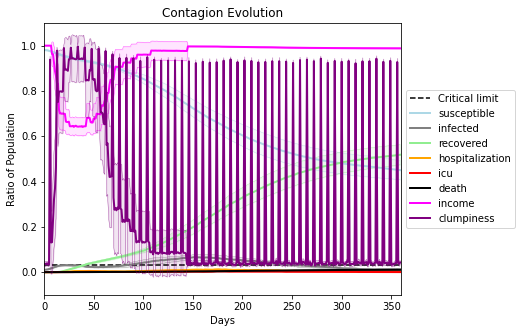

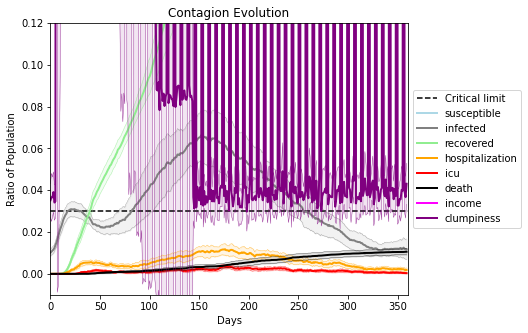

In [15]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.99
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], work_home_list = [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[8857, 6170, 1960, 681, 8989, 3021, 7909, 2450, 9892, 6232, 275, 3004, 5354, 1397, 8508, 3791, 939, 9444, 4586, 1354]
Average similarity between family members is 0.5403989835674974 at temperature -0.9
Average similarity between family and home is 0.9998447712586219 at temperature -1
Average similarity between students and their classroom is 0.20340826834833048 at temperature -0.9
Average classroom occupancy is 4.154929577464789 and number classrooms is 71
Average similarity between workers is 0.4503924495688999 at temperature -0.9
Average office occupancy is 3.2216748768472905 and number offices is 203
Average friend similarity for adults: 0.5980741887606179 for kids: 0.44862130464894506
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity -0.16169374351894483
avg restaurant similarity 0.602976592708828
avg restaurant similarity 0.21911556891565223
avg restaurant similarity 0.25935221369367034
avg restaurant similarity 0.0053498490646207595
avg restaurant similarity -0.18502879662460345
avg restaurant similarity -0.0006332479233070454
avg restaurant similarity -0.22402078104913448
avg restaurant similarity -0.007263970381756726
avg restaurant similarity 0.2277879215725441
avg restaurant similarity 0.05017395506087144
avg restaurant similarity -0.1341068610059766
avg restaurant similarity 0.022667826966568508
avg restaurant similarity 0.0205821029352543
avg restaurant similarity -0.11758097219157396
avg restaurant similarity -0.10657606998672102
avg restaurant similarity 0.23262750231320084
avg restaurant similarity 0.07570290118889518
avg restaurant similarity 0.30081337348977644
avg restaurant similarity -0.19152240109407664
avg restaurant similarity 0.0006124868524723826
avg restaurant similar

avg restaurant similarity 0.19623374750851008
avg restaurant similarity 0.14034432752100534
avg restaurant similarity 0.2489861084703791
avg restaurant similarity -0.36508506743383085
avg restaurant similarity 0.00029667979162290286
avg restaurant similarity 0.5097448741110497
avg restaurant similarity 0.009415476773737908
avg restaurant similarity 0.26131966523943734
avg restaurant similarity -0.11113179295192195
avg restaurant similarity 0.32004561506553153
avg restaurant similarity 0.12321234451264902
avg restaurant similarity 0.029249671305382554
avg restaurant similarity 0.1517924685155321
avg restaurant similarity 0.11326257431383605
avg restaurant similarity 0.14243498849358008
avg restaurant similarity 0.6855671122065079
avg restaurant similarity 0.6233176018151263
avg restaurant similarity 0.0629103559155152
avg restaurant similarity -0.1921863337867412
avg restaurant similarity 0.15170563928923952
avg restaurant similarity 0.13478364633783022
avg restaurant similarity 0.08178

avg restaurant similarity -0.19527254383538936
avg restaurant similarity 0.4113892456192475
avg restaurant similarity 0.057129261968670936
avg restaurant similarity 0.14892531482384094
avg restaurant similarity 0.3387568427330235
avg restaurant similarity -0.1335316188261693
avg restaurant similarity 0.21231257241175155
avg restaurant similarity 0.15228555545666428
avg restaurant similarity 0.15260715672193267
avg restaurant similarity 0.11074223207277863
avg restaurant similarity 0.12569630181118033
avg restaurant similarity 0.16244317436591746
avg restaurant similarity -0.13026317830843234
avg restaurant similarity 0.17448881915051007
avg restaurant similarity 0.2629404476887117
avg restaurant similarity 0.1876824577759184
avg restaurant similarity -0.016406211066962814
avg restaurant similarity 0.006211600908010123
avg restaurant similarity 0.07638828983857397
avg restaurant similarity 0.445321329699194
avg restaurant similarity 0.04744782428247631
avg restaurant similarity 0.099567

avg restaurant similarity 0.06853454585958316
avg restaurant similarity 0.1266731178932308
avg restaurant similarity 0.1341766215253113
avg restaurant similarity -0.04199837992441887
avg restaurant similarity 0.09348179616793269
avg restaurant similarity 0.2324791584447137
avg restaurant similarity 0.24513323480588983
avg restaurant similarity -0.016454193822609375
avg restaurant similarity 0.1284328881769201
avg restaurant similarity 0.19374083307129558
avg restaurant similarity 0.2455651062777934
avg restaurant similarity -0.005429178161598908
avg restaurant similarity -0.009762192594155686
avg restaurant similarity -0.16841123990074255
avg restaurant similarity 0.137862568785723
avg restaurant similarity 0.06571761151064372
avg restaurant similarity 0.06990953254691704
avg restaurant similarity 0.4349426940894915
avg restaurant similarity -0.09479232377134293
avg restaurant similarity 0.12462753730564735
avg restaurant similarity 0.18799319028410838
avg restaurant similarity 0.39542

avg restaurant similarity 0.026093525831900322
avg restaurant similarity 0.1076541430267771
avg restaurant similarity -0.04984447601031924
avg restaurant similarity -0.0631737417222681
avg restaurant similarity 0.1596574270798256
avg restaurant similarity 0.010142625807201376
avg restaurant similarity 0.06985425376144236
avg restaurant similarity 0.0428351771361501
avg restaurant similarity 0.14551504352502206
avg restaurant similarity 0.1278660489189947
avg restaurant similarity -0.009822590065179467
avg restaurant similarity 0.1833460375802902
avg restaurant similarity 0.12383850371285628
avg restaurant similarity 0.31325690613197277
avg restaurant similarity 0.05339240223722587
avg restaurant similarity 0.21823740385657994
avg restaurant similarity 0.12451613087343835
avg restaurant similarity 0.12477230460520923
avg restaurant similarity 0.16509583309432802
avg restaurant similarity 0.1713834210509167
avg restaurant similarity -0.0076200456093793514
avg restaurant similarity 0.0979

avg restaurant similarity 0.06982112571290336
avg restaurant similarity 0.11698346809376833
avg restaurant similarity -0.02801230789093027
avg restaurant similarity 0.28312053885230765
avg restaurant similarity 0.008314862530055228
avg restaurant similarity -0.07832345380144526
avg restaurant similarity 0.13528099797656937
avg restaurant similarity 0.09814268198456014
avg restaurant similarity 0.10663047252396414
avg restaurant similarity 0.188417508840623
avg restaurant similarity 0.04450527043698871
avg restaurant similarity 0.4678124571685191
avg restaurant similarity -0.11304400223914658
avg restaurant similarity 0.08545567377561226
avg restaurant similarity 0.20084123609321047
avg restaurant similarity 0.07675799588153405
avg restaurant similarity -0.03814330291068997
avg restaurant similarity 0.2946558477835398
avg restaurant similarity 0.19713427812051054
avg restaurant similarity -0.06868481084648928
avg restaurant similarity -0.14625084956376738
avg restaurant similarity 0.091

avg restaurant similarity -0.05293971454365498
avg restaurant similarity -0.020981071400100137
avg restaurant similarity 0.14614716485803378
avg restaurant similarity 0.19973982840689083
avg restaurant similarity -0.02627416511155125
avg restaurant similarity 0.39180649920152066
avg restaurant similarity -0.043535226069882214
avg restaurant similarity 0.16736085610963713
avg restaurant similarity 0.23564776554596076
avg restaurant similarity 0.06007198890368731
avg restaurant similarity 0.245755314367948
avg restaurant similarity 0.2374068230421361
avg restaurant similarity 0.10176368072886438
avg restaurant similarity -0.07937509299679
avg restaurant similarity 0.17774810615817854
avg restaurant similarity 0.11875133334826175
avg restaurant similarity -0.09289126491092041
avg restaurant similarity 0.1779739840684998
avg restaurant similarity 0.17709072983143528
avg restaurant similarity 0.041273506102938645
avg restaurant similarity 0.10628876642794385
avg restaurant similarity 0.0604

avg restaurant similarity 0.20809652733643158
avg restaurant similarity 0.2168536815009957
avg restaurant similarity 0.44484696735048074
avg restaurant similarity -0.14445485460310886
avg restaurant similarity 0.10142060336948414
avg restaurant similarity -0.14091739243382861
avg restaurant similarity -0.06508227023006692
avg restaurant similarity 0.08065739104492885
avg restaurant similarity -0.09799744995633528
avg restaurant similarity -0.021405946381802737
avg restaurant similarity 0.11517859294490523
avg restaurant similarity -0.018293799916520456
avg restaurant similarity 0.19477929051555623
avg restaurant similarity 0.07717656343064766
avg restaurant similarity 0.17606243433999616
avg restaurant similarity 0.17386069410799873
avg restaurant similarity 0.017693840864853216
avg restaurant similarity 0.10421347695390877
avg restaurant similarity -0.08694923706460872
avg restaurant similarity 0.21187509407264765
avg restaurant similarity 0.24971099346076311
avg restaurant similarity

avg restaurant similarity 0.30955291891152625
avg restaurant similarity 0.17035752919909702
avg restaurant similarity 0.3496233571747594
avg restaurant similarity 0.48081642174004
avg restaurant similarity 0.29090696722809556
avg restaurant similarity -0.31501437044943426
avg restaurant similarity 0.13668438898936602
avg restaurant similarity 0.24116953638207922
avg restaurant similarity 0.004194466331755409
avg restaurant similarity 0.14031459091279738
avg restaurant similarity -0.025835654262038998
avg restaurant similarity 0.3890340065334317
avg restaurant similarity -0.06535422563763063
avg restaurant similarity -0.47672199530601855
avg restaurant similarity 0.26092108203668224
avg restaurant similarity -0.5309170384454982
avg restaurant similarity 0.024174555074730826
avg restaurant similarity 0.33628815219333114
avg restaurant similarity 0.20151401131242
avg restaurant similarity -0.30437178734564313
avg restaurant similarity 0.12595813186891558
avg restaurant similarity -0.06829

avg restaurant similarity 0.20004742612904336
avg restaurant similarity 0.32138802894839574
avg restaurant similarity -0.09371223670510415
avg restaurant similarity -0.3100231457664324
avg restaurant similarity 0.22750377884301096
avg restaurant similarity 0.27343930117534426
avg restaurant similarity 0.021175689008334386
avg restaurant similarity 0.07970706513257887
avg restaurant similarity -0.23859143033915925
avg restaurant similarity 0.1634822630516316
avg restaurant similarity 0.3258151137312465
avg restaurant similarity 0.05971617800526555
avg restaurant similarity 0.4267934746136018
avg restaurant similarity 0.25767503439922534
avg restaurant similarity 0.11538891656032144
avg restaurant similarity 0.17947944605167412
avg restaurant similarity 0.01478754586548384
avg restaurant similarity 0.005835234495189676
avg restaurant similarity 0.6079007643169227
avg restaurant similarity 0.03814412891185234
avg restaurant similarity 0.05720348505636367
avg restaurant similarity 0.045615

avg restaurant similarity 0.18462362371256708
avg restaurant similarity 0.2586226631524269
avg restaurant similarity 0.1563053503128722
avg restaurant similarity 0.15735503105154966
avg restaurant similarity -0.014133846646656723
avg restaurant similarity -0.02369046676294695
avg restaurant similarity 0.12462849259632437
avg restaurant similarity 0.1399746865624194
avg restaurant similarity 0.07680339422401036
avg restaurant similarity -0.22633854586982846
avg restaurant similarity 0.14623204931801922
avg restaurant similarity 0.2059454669501171
avg restaurant similarity 0.07317091214176538
avg restaurant similarity 0.22909707876678417
avg restaurant similarity 0.22559002580364182
avg restaurant similarity 0.09952518030863998
avg restaurant similarity 0.2247728846624751
avg restaurant similarity 0.13080012425437376
avg restaurant similarity 0.1486880444494925
avg restaurant similarity 0.10849349058882164
avg restaurant similarity 0.1796265959586481
avg restaurant similarity 0.062706094

avg restaurant similarity 0.22391800272381063
avg restaurant similarity -0.08338326910411496
avg restaurant similarity -0.06687331532482313
avg restaurant similarity -0.15152634083514016
avg restaurant similarity 0.06399012887741277
avg restaurant similarity 0.08497927622002152
avg restaurant similarity 0.31395259163948314
avg restaurant similarity 0.12826553399107746
avg restaurant similarity 0.12301515682124466
avg restaurant similarity -0.2430201208542288
avg restaurant similarity -0.2066240690947226
avg restaurant similarity 0.25273872455988455
avg restaurant similarity -0.05556130846700771
avg restaurant similarity 0.0520028026507963
avg restaurant similarity 0.09994746598587216
avg restaurant similarity -0.0018812175120193285
avg restaurant similarity 0.15026480287594018
avg restaurant similarity 0.023477508361181326
avg restaurant similarity 0.03187697254032296
avg restaurant similarity 0.3633584416933165
avg restaurant similarity 0.06466263348068049
avg restaurant similarity 0.

avg restaurant similarity 0.16192728320594646
avg restaurant similarity -0.03781794943180362
avg restaurant similarity -0.23292144875981327
avg restaurant similarity 0.27602042745937266
avg restaurant similarity -0.02903598481669681
avg restaurant similarity -0.017903689783076677
avg restaurant similarity -0.02305600445498196
avg restaurant similarity 0.08964625315437341
avg restaurant similarity 0.006314823057610923
avg restaurant similarity 0.04235542833132716
avg restaurant similarity 0.3469781008067868
avg restaurant similarity -0.029389795380598716
avg restaurant similarity 0.16053614324777535
avg restaurant similarity -0.1564406534481732
avg restaurant similarity 0.3849394553125811
avg restaurant similarity 0.1162690006772841
avg restaurant similarity 0.011205740086217181
avg restaurant similarity 0.057317542691701626
avg restaurant similarity 0.16772987374873674
avg restaurant similarity 0.04193399820500351
avg restaurant similarity 0.06805214449807866
avg restaurant similarity 

avg restaurant similarity -0.06463741314572252
avg restaurant similarity 0.059748478496824145
avg restaurant similarity 0.08624130856760191
avg restaurant similarity 0.036719327211892805
avg restaurant similarity -0.11085903830807461
avg restaurant similarity -0.10927978454632799
avg restaurant similarity 0.15246893205654213
avg restaurant similarity 0.22776100913521505
avg restaurant similarity -0.06372681779201085
avg restaurant similarity 0.05434551101850427
avg restaurant similarity 0.011888547652477962
avg restaurant similarity -0.02412103770996447
avg restaurant similarity -0.14112708446923886
avg restaurant similarity 0.15744448951006454
avg restaurant similarity 0.16120591292136996
avg restaurant similarity 0.13345315834169605
avg restaurant similarity 0.07937611932984931
avg restaurant similarity 0.13697775324697056
avg restaurant similarity 0.30147599649180684
avg restaurant similarity 0.09994117526833286
avg restaurant similarity 0.05131900472455757
avg restaurant similarity

avg restaurant similarity 0.08636778066844658
avg restaurant similarity 0.15959725338729663
avg restaurant similarity 0.056570202462320536
avg restaurant similarity 0.18070723351535808
avg restaurant similarity 0.3534721559781072
avg restaurant similarity 0.16312626304580602
avg restaurant similarity 0.1780680285493847
avg restaurant similarity 0.11622750313741019
avg restaurant similarity 0.0984234668223264
avg restaurant similarity 0.352811060078628
avg restaurant similarity -0.03461393017826589
avg restaurant similarity 0.13706894133665137
avg restaurant similarity 0.011723184389806962
avg restaurant similarity 0.10421981314246344
avg restaurant similarity 0.10098727600896451
avg restaurant similarity 0.047240547929731015
avg restaurant similarity 0.11073606292019798
avg restaurant similarity -0.10283124070482008
avg restaurant similarity 0.14257608102577568
avg restaurant similarity 0.1410951658686971
avg restaurant similarity 0.018460868339145856
avg restaurant similarity 0.311914

avg restaurant similarity 0.014948684154854406
avg restaurant similarity 0.07963750187397664
avg restaurant similarity 0.19669347951242608
avg restaurant similarity 0.21286366466494872
avg restaurant similarity 0.11702530240852616
avg restaurant similarity -0.03198468932846745
avg restaurant similarity -0.07292303911229901
avg restaurant similarity 0.1830863887765557
avg restaurant similarity 0.11559611735679735
avg restaurant similarity 0.278583946292322
avg restaurant similarity -0.010123249820929436
avg restaurant similarity 0.05290119729410379
avg restaurant similarity 0.09358927944352623
avg restaurant similarity 0.22868634925175907
avg restaurant similarity -0.16827490375515364
avg restaurant similarity 0.1643298972275102
avg restaurant similarity 0.18435998890306138
avg restaurant similarity 0.1635393987403942
avg restaurant similarity 0.03728489274557792
avg restaurant similarity 0.12244443071327826
avg restaurant similarity 0.1123995400159822
avg restaurant similarity 0.139516

avg restaurant similarity 0.03358721874391265
avg restaurant similarity 0.2299192533347005
avg restaurant similarity -0.21762761236257722
avg restaurant similarity 0.047500942359007335
avg restaurant similarity 0.3472548852425841
avg restaurant similarity 0.04039911786373054
avg restaurant similarity 0.10495977962639495
avg restaurant similarity 0.06227254713136393
avg restaurant similarity 0.24481964661625222
avg restaurant similarity 0.12879080813094393
avg restaurant similarity 0.5697734340177382
avg restaurant similarity 0.07520284596390904
avg restaurant similarity 0.0476603448000297
avg restaurant similarity -0.10323592113707714
avg restaurant similarity 0.10405270992733621
avg restaurant similarity 0.049673223077880115
avg restaurant similarity 0.08381054229535337
avg restaurant similarity 0.1934228647613723
avg restaurant similarity 0.08908313604170214
avg restaurant similarity -0.16866194325520317
avg restaurant similarity 0.29938411592131164
avg restaurant similarity 0.141183

avg restaurant similarity 0.18680918412081027
avg restaurant similarity 0.014868374150609915
avg restaurant similarity 0.11035874025200994
avg restaurant similarity 0.20179584573516368
avg restaurant similarity 0.17231743044735154
avg restaurant similarity 0.15074679369454283
avg restaurant similarity -0.017135954582223688
avg restaurant similarity -0.024803497195300696
avg restaurant similarity 0.04815910309894758
avg restaurant similarity 0.20233841210590636
avg restaurant similarity 0.13241624870350333
avg restaurant similarity -0.0730308319828738
avg restaurant similarity 0.012586194920382487
avg restaurant similarity 0.038875118049586224
avg restaurant similarity 0.24507387145973994
avg restaurant similarity -0.049182109004443475
avg restaurant similarity 0.1858438080260577
avg restaurant similarity -0.33295019883961025
avg restaurant similarity -0.022903469427860916
avg restaurant similarity 0.24905257621527543
avg restaurant similarity 0.3154848379731614
avg restaurant similarit

avg restaurant similarity 0.009005165140635193
avg restaurant similarity 0.09035882233756772
avg restaurant similarity 0.3864564168672929
avg restaurant similarity 0.1808803234868562
avg restaurant similarity 0.2140243817996206
avg restaurant similarity 0.3778495573147937
avg restaurant similarity -0.10956619152650059
avg restaurant similarity 0.1718498090515908
avg restaurant similarity 0.04838808673460857
avg restaurant similarity -0.03548143696438675
avg restaurant similarity 0.47194223893304044
avg restaurant similarity -0.06228093216209505
avg restaurant similarity -0.016271773816308673
avg restaurant similarity 0.12611990161424802
avg restaurant similarity 0.09957503157307986
avg restaurant similarity 0.17354011924354296
avg restaurant similarity 0.15593393813650613
avg restaurant similarity 0.46060673554471904
avg restaurant similarity 0.1010235823449519
avg restaurant similarity 0.23847078155977205
avg restaurant similarity 0.20900027426303533
avg restaurant similarity -0.03999

avg restaurant similarity -0.01971305371539335
avg restaurant similarity 0.23583476374006773
avg restaurant similarity 0.21669751182153846
avg restaurant similarity 0.14525899609053358
avg restaurant similarity 0.9998442488988961
avg restaurant similarity 0.002991944434775129
avg restaurant similarity 0.24641635431918507
avg restaurant similarity 0.37317291876650743
avg restaurant similarity 0.17125594953250922
avg restaurant similarity 0.19573157727208457
avg restaurant similarity -0.21053596198260555
avg restaurant similarity 0.2547808743133878
avg restaurant similarity -0.25464432610298743
avg restaurant similarity 0.14856000381547366
avg restaurant similarity 0.6096899158131804
avg restaurant similarity 0.46406981692677185
avg restaurant similarity 0.17061627872478188
avg restaurant similarity 0.03960756249185188
avg restaurant similarity -0.16960811712254498
avg restaurant similarity -0.5428394706412893
avg restaurant similarity 0.4499969204615732
avg restaurant similarity 0.17831

avg restaurant similarity 0.2957691491316231
avg restaurant similarity 0.4926948341766121
avg restaurant similarity -0.0889526130595594
avg restaurant similarity 0.011273515450479912
avg restaurant similarity 0.036600064263807686
avg restaurant similarity 0.03247645672276174
avg restaurant similarity 0.11792903265569514
avg restaurant similarity 0.22238537907599074
avg restaurant similarity -0.03740980093197687
avg restaurant similarity 0.11674290258222755
avg restaurant similarity -0.03011847694357962
avg restaurant similarity 0.20414944042839328
avg restaurant similarity 0.08208204918112477
avg restaurant similarity 0.019456162474897273
avg restaurant similarity 0.2912828443765806
avg restaurant similarity 0.3574191498429209
avg restaurant similarity -0.007477130079404809
avg restaurant similarity -0.16304154605650814
avg restaurant similarity 0.2420637769776997
avg restaurant similarity 0.3832074600596196
avg restaurant similarity 0.06225629715882969
avg restaurant similarity 0.1749

avg restaurant similarity -0.11682426684168778
avg restaurant similarity 0.3000203162478188
avg restaurant similarity 0.29456280632772164
avg restaurant similarity 0.1301331928490803
avg restaurant similarity 0.18058778620448965
avg restaurant similarity 0.14108331429291493
avg restaurant similarity -0.02459130049326814
avg restaurant similarity 0.5348417708460742
avg restaurant similarity 0.25945708421807934
avg restaurant similarity -0.15944966961081797
avg restaurant similarity 0.2110734147550059
avg restaurant similarity 0.3431183200810193
avg restaurant similarity 0.48795899842529966
avg restaurant similarity 0.15396878984344414
avg restaurant similarity 0.199758735451596
avg restaurant similarity 0.03284027459226769
avg restaurant similarity 0.17312633244188724
avg restaurant similarity 0.3416057264611935
avg restaurant similarity -0.05136249605272618
avg restaurant similarity 0.4149155642879531
avg restaurant similarity 0.1563070159361847
avg restaurant similarity 0.681480248134

avg restaurant similarity 0.028898887880822663
avg restaurant similarity 0.4124340464922851
avg restaurant similarity 0.47367976663260486
avg restaurant similarity 0.2754036842733956
avg restaurant similarity 0.12196747364161614
avg restaurant similarity 0.21546484160737905
avg restaurant similarity 0.1521266058943076
avg restaurant similarity -0.07066780697614455
avg restaurant similarity 0.3721963213259901
avg restaurant similarity 0.14336004104041228
avg restaurant similarity 0.15447833674347153
avg restaurant similarity -0.05949601219942868
avg restaurant similarity 0.003380489723078727
avg restaurant similarity 0.6490589974053546
avg restaurant similarity 0.39283265086521085
avg restaurant similarity 0.06070390793529753
avg restaurant similarity 0.2349578254735713
avg restaurant similarity -0.02617070756719005
avg restaurant similarity 0.275541463150176
avg restaurant similarity -0.10684598116575746
avg restaurant similarity -0.1808958175450099
avg restaurant similarity -0.0423685

avg restaurant similarity 0.3224154256794682
avg restaurant similarity 0.06839229591998029
avg restaurant similarity -0.006646391592472718
avg restaurant similarity 0.05580435168367959
avg restaurant similarity 0.25458053086555266
avg restaurant similarity -0.005659050095473808
avg restaurant similarity 0.16065122320869704
avg restaurant similarity 0.04780515441380343
avg restaurant similarity 0.1561067189029689
avg restaurant similarity 0.6795350127687865
avg restaurant similarity 0.39530558035122854
avg restaurant similarity 0.47367976663260486
avg restaurant similarity 0.16971202095718582
avg restaurant similarity -0.027093481586061716
avg restaurant similarity 0.1881828185915871
avg restaurant similarity 0.17939971555674306
avg restaurant similarity 0.7408554713046736
avg restaurant similarity 0.5669207921960773
avg restaurant similarity 0.3381670049485607
avg restaurant similarity 0.32196951356284903
avg restaurant similarity 0.2655878352999692
avg restaurant similarity 0.08022909

avg restaurant similarity 0.12799679772826367
avg restaurant similarity 0.04305644708016959
avg restaurant similarity 0.10552573670941225
avg restaurant similarity 0.01763211714120553
avg restaurant similarity 0.11295102247155704
avg restaurant similarity -0.1340424951374745
avg restaurant similarity 0.2750493584840592
avg restaurant similarity 0.08616122918281778
avg restaurant similarity 0.21067436638092485
avg restaurant similarity 0.020895682207341722
avg restaurant similarity -0.010083007516736256
avg restaurant similarity 0.15581861787536866
avg restaurant similarity -0.09739076248102609
avg restaurant similarity 0.2201385805365248
avg restaurant similarity 0.10651797662386116
avg restaurant similarity 0.05396423766950853
avg restaurant similarity 0.08351401197023209
avg restaurant similarity 0.12426612941466299
avg restaurant similarity 0.03936116641158784
avg restaurant similarity 0.10534389027582268
avg restaurant similarity -0.01254376184841237
avg restaurant similarity 0.296

avg restaurant similarity 0.26658800916779496
avg restaurant similarity 0.0809967002471079
avg restaurant similarity -0.01824441686423492
avg restaurant similarity -0.05574895786905315
avg restaurant similarity 0.20477707313912813
avg restaurant similarity 0.19800464119890412
avg restaurant similarity 0.25271941028707606
avg restaurant similarity 0.2554691544180454
avg restaurant similarity 0.10463785282927614
avg restaurant similarity 0.2549352846737879
avg restaurant similarity 0.18894461493780484
avg restaurant similarity -0.03684728544742181
avg restaurant similarity 0.06008977982305096
avg restaurant similarity 0.08463997818605867
avg restaurant similarity 0.04854932667655069
avg restaurant similarity -0.05001893800787062
avg restaurant similarity 0.2320931626928815
avg restaurant similarity 0.3705052319648077
avg restaurant similarity 0.024846237512179986
avg restaurant similarity 0.12379786575534506
avg restaurant similarity 0.26159694713746207
avg restaurant similarity -0.03925

avg restaurant similarity 0.30029208031779037
avg restaurant similarity -0.009285295112791853
avg restaurant similarity 0.03437933596240856
avg restaurant similarity 0.12759404844696906
avg restaurant similarity 0.06673632391498793
avg restaurant similarity 0.4426616822520883
avg restaurant similarity 0.15239315401599401
avg restaurant similarity 0.1951911664897242
avg restaurant similarity 0.42542349854987993
avg restaurant similarity 0.059506513388947434
avg restaurant similarity 0.3254667111653997
avg restaurant similarity 0.2231948451077816
avg restaurant similarity 0.3096249237583938
avg restaurant similarity 0.05471053353231696
avg restaurant similarity 0.19728613391565172
avg restaurant similarity -0.024445794407410293
avg restaurant similarity 0.2058646559013266
avg restaurant similarity 0.13883997307775298
avg restaurant similarity 0.13641319126526885
avg restaurant similarity 0.2497810249801713
avg restaurant similarity -0.05685976095370158
avg restaurant similarity 0.1468572

avg restaurant similarity 0.10617831192341508
avg restaurant similarity 0.14162981037911643
avg restaurant similarity -0.09606009306769751
avg restaurant similarity 0.3468419674856261
avg restaurant similarity 0.07074882743736373
avg restaurant similarity 0.1740295935859441
avg restaurant similarity 0.23593682041444622
avg restaurant similarity -0.18528341435581117
avg restaurant similarity 0.19592386223096137
avg restaurant similarity 0.188090940830404
avg restaurant similarity 0.25277376575515886
avg restaurant similarity 0.495671998219495
avg restaurant similarity 0.14937074794390814
avg restaurant similarity -0.15494843944102146
avg restaurant similarity 0.20174175092521204
avg restaurant similarity 0.214056017917166
avg restaurant similarity 0.30846373040385805
avg restaurant similarity 0.1978229538544336
avg restaurant similarity 0.09673435252028811
avg restaurant similarity -0.08887447129957259
avg restaurant similarity 0.02568266473282541
avg restaurant similarity 0.33096976799

avg restaurant similarity -0.008589624498330598
avg restaurant similarity -0.012573962801808017
avg restaurant similarity 0.015361408559361071
avg restaurant similarity 0.2280426298706143
avg restaurant similarity -0.048319576382671425
avg restaurant similarity 0.16368463620391535
avg restaurant similarity 0.04297395757322295
avg restaurant similarity 0.025252167479684708
avg restaurant similarity -0.13156590439150256
avg restaurant similarity -0.26901618541133326
avg restaurant similarity 0.10999012742873965
avg restaurant similarity 0.1620094813329312
avg restaurant similarity 0.30256393895213013
avg restaurant similarity 0.036088624488505146
avg restaurant similarity 0.11250305032237486
avg restaurant similarity 0.05309130906528087
avg restaurant similarity -0.01528989228672148
avg restaurant similarity -0.01628219676965513
avg restaurant similarity 0.2397322079705724
avg restaurant similarity -0.12448327452540607
avg restaurant similarity -0.06288601252467436
avg restaurant similar

avg restaurant similarity 0.2482559178868284
avg restaurant similarity 0.40769048560707094
avg restaurant similarity 0.07579472301977733
avg restaurant similarity 0.37214483545422405
avg restaurant similarity 0.5326990687660486
avg restaurant similarity 0.07177036039025664
avg restaurant similarity -0.22746760475276007
avg restaurant similarity 0.07479956852600697
avg restaurant similarity 0.11991208642182508
avg restaurant similarity 0.41159773502798114
avg restaurant similarity 0.07898397467409901
avg restaurant similarity 0.2947987015831651
avg restaurant similarity 0.02713305019610944
avg restaurant similarity -0.06032952516950715
avg restaurant similarity 0.24126704055791628
avg restaurant similarity 0.11563023480963801
avg restaurant similarity 0.3933910126524735
avg restaurant similarity 0.09020765554454212
avg restaurant similarity 0.04726763276132332
avg restaurant similarity 0.19457628433088392
avg restaurant similarity -0.02307461183609662
avg restaurant similarity 0.1295164

avg restaurant similarity -0.07952867723118325
avg restaurant similarity 0.4084770167575625
avg restaurant similarity 0.171124540048706
avg restaurant similarity 0.09933447613847525
avg restaurant similarity 0.0895583049782811
avg restaurant similarity 0.13996115518835126
avg restaurant similarity 0.1834570472866747
avg restaurant similarity 0.08832219456288279
avg restaurant similarity 0.19467335732022714
avg restaurant similarity 0.22937587178534397
avg restaurant similarity 0.11995596482426611
avg restaurant similarity 0.032356690043426575
avg restaurant similarity 0.08950485853353969
avg restaurant similarity 0.14907055664978075
avg restaurant similarity 0.01029255620251994
avg restaurant similarity -0.056223832139844054
avg restaurant similarity 0.1204080371010961
avg restaurant similarity -0.017672131223466402
avg restaurant similarity 0.1951796938748873
avg restaurant similarity 0.26230570064137776
avg restaurant similarity 0.32622219998660107
avg restaurant similarity 0.2946489

avg restaurant similarity 0.17884945062157354
avg restaurant similarity 0.08516854848729288
avg restaurant similarity 0.2901654626774929
avg restaurant similarity 0.40930840989285694
avg restaurant similarity -0.016553690708714843
avg restaurant similarity -0.13537532684088435
avg restaurant similarity 0.3705959699433544
avg restaurant similarity 0.21695263591767525
avg restaurant similarity 0.24358634554679615
avg restaurant similarity 0.24903829862919621
avg restaurant similarity 0.0815182308376666
avg restaurant similarity 0.08147103682292182
avg restaurant similarity 0.26044228977353095
avg restaurant similarity 0.034666111401213826
avg restaurant similarity 0.2509466820154612
avg restaurant similarity 0.6428832111292689
avg restaurant similarity 0.23069510406056687
avg restaurant similarity 0.17238472145210293
avg restaurant similarity 0.040510593409736
avg restaurant similarity 0.13340834410534547
avg restaurant similarity 0.07527652098400842
avg restaurant similarity 0.279131860

avg restaurant similarity 0.1301220873466473
avg restaurant similarity 0.3414225161821957
avg restaurant similarity 0.17492330204225479
avg restaurant similarity 0.16868339794576714
avg restaurant similarity 0.2645515138229722
avg restaurant similarity 0.11842081597131214
avg restaurant similarity 0.11911287874478826
avg restaurant similarity 0.052128630810893126
avg restaurant similarity 0.07198563536708204
avg restaurant similarity 0.2811532574393498
avg restaurant similarity -0.07390482444359865
avg restaurant similarity 0.1875984291608848
avg restaurant similarity 0.3306634617022414
avg restaurant similarity -0.19733537657189726
avg restaurant similarity 0.339356095768124
avg restaurant similarity 0.22308808452687237
avg restaurant similarity 0.07642058740607377
avg restaurant similarity 0.2818880273165485
avg restaurant similarity -0.08391214318094203
avg restaurant similarity 0.080150173228652
avg restaurant similarity 0.12858739900830393
avg restaurant similarity 0.0758857671027

avg restaurant similarity 0.22321757562169822
avg restaurant similarity -0.09043954476065419
avg restaurant similarity 0.07263030472488127
avg restaurant similarity 0.268821252451736
avg restaurant similarity 0.2645227935405874
avg restaurant similarity 0.1967531786432915
avg restaurant similarity 0.2080505428016852
avg restaurant similarity 0.06190112715557596
avg restaurant similarity 0.005519533495039907
avg restaurant similarity 0.09990478900886328
avg restaurant similarity 0.23552529000170708
avg restaurant similarity 0.18949682079168162
avg restaurant similarity 0.2321571910643939
avg restaurant similarity 0.08406867925409801
avg restaurant similarity 0.2723182557123948
avg restaurant similarity 0.3270589299780748
avg restaurant similarity -0.08933946455794302
avg restaurant similarity 0.18015875962578196
avg restaurant similarity 0.33408201705545104
avg restaurant similarity -0.1310945323079028
avg restaurant similarity 0.22394551884642727
avg restaurant similarity 0.10000890701

avg restaurant similarity 0.1850627446254099
avg restaurant similarity -0.048561250396255425
avg restaurant similarity 0.04459628096511401
avg restaurant similarity 0.08511899392211364
avg restaurant similarity 0.3498125688008543
avg restaurant similarity 0.2073563920406771
avg restaurant similarity -0.031069928667337474
avg restaurant similarity 0.23236817932906412
avg restaurant similarity 0.1824822473558955
avg restaurant similarity 0.14749041177700667
avg restaurant similarity -0.009023339764731547
avg restaurant similarity 0.04653256014374237
avg restaurant similarity 0.05913525983694107
avg restaurant similarity 0.18605388624716876
avg restaurant similarity 0.2496218803847152
avg restaurant similarity 0.021212250925261644
avg restaurant similarity 0.25420717146160654
avg restaurant similarity 0.24693699040390932
avg restaurant similarity 0.4456665522689054
avg restaurant similarity 0.32553539251019364
avg restaurant similarity 0.12852649282518858
avg restaurant similarity 0.17971

avg restaurant similarity -0.08969737899116392
avg restaurant similarity 0.39761667135985745
avg restaurant similarity -0.10579419164987602
avg restaurant similarity 0.16720890533159574
avg restaurant similarity 0.11951013549590149
avg restaurant similarity -0.33862994433900273
avg restaurant similarity -0.09734197968149377
avg restaurant similarity 0.14682314723925155
avg restaurant similarity 0.11324827467389229
avg restaurant similarity -0.0276140789888073
avg restaurant similarity -0.2248141606401444
avg restaurant similarity 0.2967590235149267
avg restaurant similarity 0.15722123237045377
avg restaurant similarity 0.401057452476474
avg restaurant similarity 0.24369646413652013
avg restaurant similarity 0.2659086466519707
avg restaurant similarity -0.14683838671766566
avg restaurant similarity -0.03771590751118351
avg restaurant similarity 0.13634936605143042
avg restaurant similarity 0.10733832629433263
avg restaurant similarity 0.17213715109824818
avg restaurant similarity 0.1790

avg restaurant similarity 0.6855735920853419
avg restaurant similarity 0.17553510298757177
avg restaurant similarity 0.111462980996386
avg restaurant similarity 0.20170295826509158
avg restaurant similarity 0.13060382863439784
avg restaurant similarity -0.0010933360371345735
avg restaurant similarity 0.010928335075080479
avg restaurant similarity -0.006869762253155713
avg restaurant similarity 0.0702615981206935
avg restaurant similarity 0.046607136881417065
avg restaurant similarity 0.050530133505972595
avg restaurant similarity -0.04758616653830615
avg restaurant similarity 0.18569993033623874
avg restaurant similarity -0.08416638707344293
avg restaurant similarity 0.035143778803729875
avg restaurant similarity 0.05689606537933573
avg restaurant similarity 0.3446450952189948
avg restaurant similarity 0.2300387734464674
avg restaurant similarity 0.17880794770044955
avg restaurant similarity -0.07307640495369694
avg restaurant similarity 0.7572010864634606
avg restaurant similarity 0.1

avg restaurant similarity 0.07134011836045906
avg restaurant similarity 0.2761937738243428
avg restaurant similarity -0.11158617461050367
avg restaurant similarity 0.11390295530904607
avg restaurant similarity 0.12155281271978385
avg restaurant similarity -0.055255810643128615
avg restaurant similarity -0.04933431529877898
avg restaurant similarity 0.08335106588580465
avg restaurant similarity -0.11386110279745956
avg restaurant similarity 0.05401678830096361
avg restaurant similarity 0.12267123561747233
avg restaurant similarity -0.09099793461265905
avg restaurant similarity -0.01788262131880669
avg restaurant similarity 0.04031707024978567
avg restaurant similarity 0.01816570410351659
avg restaurant similarity 0.08160543012947595
avg restaurant similarity -0.06772060672375838
avg restaurant similarity 0.09388892723020752
avg restaurant similarity 0.15842092415532147
avg restaurant similarity -0.04444199223989562
avg restaurant similarity 0.018991016040612284
avg restaurant similarity

avg restaurant similarity 0.16131534324692123
avg restaurant similarity 0.1592111701998983
avg restaurant similarity 0.1503494879772606
avg restaurant similarity 0.16178948850923813
avg restaurant similarity 0.20202305285190295
avg restaurant similarity 0.19255713429366778
avg restaurant similarity 0.1979367220801072
avg restaurant similarity 0.13232210914166248
avg restaurant similarity 0.2790010457063857
avg restaurant similarity 0.1474628229532849
avg restaurant similarity 0.32680207924287563
avg restaurant similarity 0.13408681523843125
avg restaurant similarity 0.23546046123997447
avg restaurant similarity -0.027127793291905806
avg restaurant similarity -0.0429540820307164
avg restaurant similarity 0.1583003208993948
avg restaurant similarity 0.22236086407538677
avg restaurant similarity 0.19337648279726252
avg restaurant similarity 0.1862165643277059
avg restaurant similarity 0.2715350957898548
avg restaurant similarity 0.1969434393936741
avg restaurant similarity 0.3115230400660

avg restaurant similarity 0.19095299959731
avg restaurant similarity 0.3051121232129251
avg restaurant similarity 0.12275924781359196
avg restaurant similarity 0.19311437358545794
avg restaurant similarity 0.09584938705364278
avg restaurant similarity 0.26114170172712253
avg restaurant similarity 0.1809333412098858
avg restaurant similarity 0.27807919131051706
avg restaurant similarity 0.4986212497813811
avg restaurant similarity 0.11457141655670466
avg restaurant similarity 0.19541742508815227
avg restaurant similarity 0.14104950609257486
avg restaurant similarity 0.1940307373628548
avg restaurant similarity 0.07623368442824674
avg restaurant similarity -0.008839881969972187
avg restaurant similarity -0.1901970302875558
avg restaurant similarity 0.2514182264436343
avg restaurant similarity 0.30904058984339555
avg restaurant similarity 0.3512736497262259
avg restaurant similarity -0.0008837549134494849
avg restaurant similarity 0.30710170706778134
avg restaurant similarity 0.1717872178

(<function dict.items>, <function dict.items>, <function dict.items>)

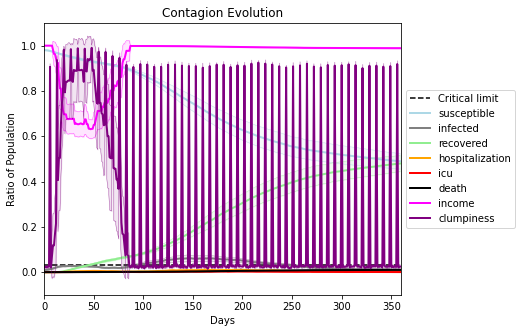

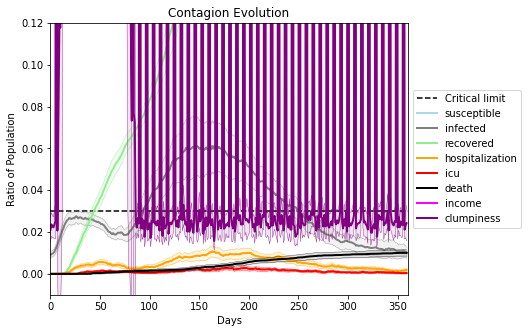

In [32]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9
params.params['num_communities'] = 100
seeds = [2252]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs=20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],
              work_home_list = 
            
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4533, 5273, 5070, 877, 8903, 2045, 3321, 6780, 2523, 2161, 5682, 7317, 8232, 7779, 890, 9725, 3168, 6054, 9854, 1982]
Average similarity between family members is 0.4229716185188137 at temperature -0.8
Average similarity between family and home is 0.99985367552879 at temperature -1
Average similarity between students and their classroom is 0.1435929588556733 at temperature -0.8
Average classroom occupancy is 3.704225352112676 and number classrooms is 71
Average similarity between workers is 0.30201707744038525 at temperature -0.8
Average office occupancy is 3.4153846153846152 and number offices is 195
Average friend similarity for adults: 0.507955794015906 for kids: 0.35534776338686014
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homo

avg restaurant similarity 0.17532774935739404
avg restaurant similarity 0.06328601392410775
avg restaurant similarity 0.11747302292068153
avg restaurant similarity 0.16915438971173127
avg restaurant similarity 0.21523069819261959
avg restaurant similarity 0.43420512395967226
avg restaurant similarity 0.21317434003364127
avg restaurant similarity 0.23984518650814193
avg restaurant similarity 0.3425920103281028
avg restaurant similarity 0.08234801571722533
avg restaurant similarity 0.37567535486030196
avg restaurant similarity 0.1617979496536063
avg restaurant similarity 0.10005320686558883
avg restaurant similarity 0.11654228343561583
avg restaurant similarity 0.23801557991029218
avg restaurant similarity 0.2905155626344702
avg restaurant similarity 0.27332614761717333
avg restaurant similarity 0.20200302099641054
avg restaurant similarity 0.2568124476848457
avg restaurant similarity 0.34432739692751374
avg restaurant similarity 0.14653899806461665
avg restaurant similarity 0.2940972248

avg restaurant similarity 0.04896576457364597
avg restaurant similarity 0.2308879661266243
avg restaurant similarity 0.34130239126789674
avg restaurant similarity 0.14269811629611606
avg restaurant similarity 0.18920648303257054
avg restaurant similarity 0.2604832899790775
avg restaurant similarity 0.04187424197561909
avg restaurant similarity 0.28403099878254134
avg restaurant similarity 0.2604566538993746
avg restaurant similarity 0.19909720744785475
avg restaurant similarity -0.10646357089482196
avg restaurant similarity 0.0796960735504447
avg restaurant similarity 0.08957411176008377
avg restaurant similarity 0.13729293860848632
avg restaurant similarity 0.0415484014390293
avg restaurant similarity 0.1140506353366789
avg restaurant similarity 0.4353212136650082
avg restaurant similarity 0.11241713466549161
avg restaurant similarity 0.21702430336341433
avg restaurant similarity 0.30164897746157626
avg restaurant similarity 0.2794982350904333
avg restaurant similarity 0.1990607379306

avg restaurant similarity 0.17133435902731342
avg restaurant similarity -0.03971328965527117
avg restaurant similarity 0.17705275764345352
avg restaurant similarity 0.10667918208756588
avg restaurant similarity 0.12837567346253714
avg restaurant similarity 0.4356857815306904
avg restaurant similarity 0.4126111015494267
avg restaurant similarity -0.018129510895284865
avg restaurant similarity -0.10364582431391094
avg restaurant similarity -0.06807444800432841
avg restaurant similarity 0.0545620435031576
avg restaurant similarity -0.17570776656835235
avg restaurant similarity -0.22191483890351843
avg restaurant similarity -0.15081722055896388
avg restaurant similarity 0.1121771679422373
avg restaurant similarity 0.1416584594080447
avg restaurant similarity -0.04413101525519368
avg restaurant similarity -0.08850168893529967
avg restaurant similarity 0.06195647693207342
avg restaurant similarity 0.07929987255965516
avg restaurant similarity 0.1761148163691155
avg restaurant similarity -0.0

avg restaurant similarity 0.09114096844994145
avg restaurant similarity 0.2539365284151437
avg restaurant similarity 0.5430404268998692
avg restaurant similarity 0.11375446798529522
avg restaurant similarity 0.022090742938091757
avg restaurant similarity 0.07043923353078997
avg restaurant similarity 0.12971586216033856
avg restaurant similarity 0.04961153055282153
avg restaurant similarity 0.15745837492537545
avg restaurant similarity 0.32913105861563086
avg restaurant similarity 0.00524959246734874
avg restaurant similarity 0.3728790356307919
avg restaurant similarity 0.04321622225094759
avg restaurant similarity 0.15802613038320693
avg restaurant similarity -0.0534719089530836
avg restaurant similarity 0.22472458658554623
avg restaurant similarity 0.14947258292892412
avg restaurant similarity -0.09804701329538991
avg restaurant similarity 0.14431392692698872
avg restaurant similarity 0.29801717782488973
avg restaurant similarity -0.1282466632981911
avg restaurant similarity -0.042864

avg restaurant similarity 0.02594335197421485
avg restaurant similarity 0.1456851831697654
avg restaurant similarity 0.07511201978044653
avg restaurant similarity -0.16971494211208119
avg restaurant similarity 0.2730510562645028
avg restaurant similarity -0.05007870237027592
avg restaurant similarity 0.21080446402666592
avg restaurant similarity 0.08353871698601464
avg restaurant similarity 0.19508449188077753
avg restaurant similarity 0.2044591437536651
avg restaurant similarity 0.027908815693670326
avg restaurant similarity 0.225171140939404
avg restaurant similarity 0.006650443316479174
avg restaurant similarity 0.2524180902947706
avg restaurant similarity -0.17099331792925562
avg restaurant similarity 0.1182760233042008
avg restaurant similarity 0.03879451165385158
avg restaurant similarity -0.21283198150274762
avg restaurant similarity 0.026848119326786175
avg restaurant similarity 0.1893636431323502
avg restaurant similarity 0.26167002833760333
avg restaurant similarity -0.002979

avg restaurant similarity 0.1791255654987026
avg restaurant similarity 0.12114929201777258
avg restaurant similarity 0.2112896660558839
avg restaurant similarity 0.1525003080047297
avg restaurant similarity -0.14536042368226584
avg restaurant similarity 0.09211388968687699
avg restaurant similarity 0.08922863370106467
avg restaurant similarity -0.10326850100921099
avg restaurant similarity 0.16264733736707035
avg restaurant similarity -0.16006115272130195
avg restaurant similarity 0.009161994595237553
avg restaurant similarity 0.09369293642931317
avg restaurant similarity 0.10507785257530518
avg restaurant similarity -0.062182077947886896
avg restaurant similarity 0.0499267526724827
avg restaurant similarity -0.04551623142175811
avg restaurant similarity 0.06670392853928964
avg restaurant similarity -0.08619920661783172
avg restaurant similarity 0.007059999714891708
avg restaurant similarity -0.07502879972036353
avg restaurant similarity 0.4236396233601859
avg restaurant similarity 0.1

avg restaurant similarity 0.14241173281919894
avg restaurant similarity 0.1145231429305061
avg restaurant similarity 0.03144884123059758
avg restaurant similarity -0.045381114523978285
avg restaurant similarity 0.09009287406816868
avg restaurant similarity 0.17598964426902997
avg restaurant similarity 0.39251542298215875
avg restaurant similarity -0.07047988248781564
avg restaurant similarity 0.3810400885819209
avg restaurant similarity -0.05839858463765037
avg restaurant similarity 0.006259605531955955
avg restaurant similarity 0.11972506238152447
avg restaurant similarity 0.40189332461480254
avg restaurant similarity -0.053758512458813794
avg restaurant similarity 0.07342929075145566
avg restaurant similarity 0.1836719368988225
avg restaurant similarity 0.14804412595896013
avg restaurant similarity 0.11562601561545438
avg restaurant similarity 0.4790082675898645
avg restaurant similarity 0.21212132427960792
avg restaurant similarity -0.12357643298692247
avg restaurant similarity 0.20

avg restaurant similarity 0.15258867203810972
avg restaurant similarity 0.23502219287428164
avg restaurant similarity -0.14031679835631444
avg restaurant similarity -0.13019612521914642
avg restaurant similarity 0.20074596138170725
avg restaurant similarity 0.6155046581137631
avg restaurant similarity 0.24797182788978173
avg restaurant similarity -0.17362856040808725
avg restaurant similarity 0.3043420798520211
avg restaurant similarity 0.24473015261277806
avg restaurant similarity 0.20929835242022762
avg restaurant similarity 0.16836115078982514
avg restaurant similarity 0.49322346555442165
avg restaurant similarity 0.03694998297148333
avg restaurant similarity -0.319938118150467
avg restaurant similarity 0.35959012353576514
avg restaurant similarity 0.28426980973225496
avg restaurant similarity 0.17929594289002534
avg restaurant similarity -0.034448136141799764
avg restaurant similarity 0.2541123149419966
avg restaurant similarity 0.32849833918263655
avg restaurant similarity -0.1610

avg restaurant similarity 0.20240630214209615
avg restaurant similarity 0.1964449788185803
avg restaurant similarity 0.010625028568775964
avg restaurant similarity 0.2738205915329442
avg restaurant similarity 0.006101419999607435
avg restaurant similarity 0.2958127036491342
avg restaurant similarity 0.21787332388893005
avg restaurant similarity 0.026387978260666096
avg restaurant similarity 0.11375408458211085
avg restaurant similarity 0.19119320942102178
avg restaurant similarity -0.05822854440777728
avg restaurant similarity 0.1398197353176649
avg restaurant similarity 0.10685840565497405
avg restaurant similarity 0.19201271814691676
avg restaurant similarity 0.1031014226719231
avg restaurant similarity -0.033145179007784784
avg restaurant similarity 0.029205489516324696
avg restaurant similarity 0.06990574185100457
avg restaurant similarity 0.1409908456819146
avg restaurant similarity 0.2218911179014978
avg restaurant similarity 0.19441359989236232
avg restaurant similarity 0.103962

avg restaurant similarity 0.19113515311679957
avg restaurant similarity 0.1062516623944067
avg restaurant similarity 0.4206158623877118
avg restaurant similarity -0.05316289542490015
avg restaurant similarity 0.3504419632969274
avg restaurant similarity 0.21644635231735507
avg restaurant similarity 0.26349861600403485
avg restaurant similarity 0.14320593984832616
avg restaurant similarity 0.18781338305203618
avg restaurant similarity 0.08738350160506465
avg restaurant similarity -0.06428433696321618
avg restaurant similarity -0.022241047068089586
avg restaurant similarity 0.024487568191681013
avg restaurant similarity 0.18957771182880936
avg restaurant similarity 0.18829675841920498
avg restaurant similarity 0.040189657765366746
avg restaurant similarity 0.04557303296102262
avg restaurant similarity -0.08355222768664039
avg restaurant similarity 0.019043264333281153
avg restaurant similarity -0.17301133747910943
avg restaurant similarity 0.10383469949915639
avg restaurant similarity 0.

avg restaurant similarity 0.23857937053285094
avg restaurant similarity 0.15932080257505793
avg restaurant similarity 0.36291760198674866
avg restaurant similarity 0.042602546752592514
avg restaurant similarity 0.03996405148136643
avg restaurant similarity 0.31655271054858647
avg restaurant similarity -0.027331527405974727
avg restaurant similarity -0.03907252467456668
avg restaurant similarity -0.14862939169290104
avg restaurant similarity -0.11759936586266047
avg restaurant similarity -0.08017677835986756
avg restaurant similarity 0.10486004332039035
avg restaurant similarity 0.1692500272861255
avg restaurant similarity 0.4171388105619477
avg restaurant similarity 0.17176756180780114
avg restaurant similarity 0.20560667702449983
avg restaurant similarity 0.4445017852602198
avg restaurant similarity 0.27948991813419755
avg restaurant similarity 0.049472413831629286
avg restaurant similarity 0.14009565007516292
avg restaurant similarity 0.2351138231250927
avg restaurant similarity 0.28

avg restaurant similarity 0.22985687939777422
avg restaurant similarity 0.2919643280768737
avg restaurant similarity 0.2123476434475841
avg restaurant similarity 0.21147359323218823
avg restaurant similarity 0.1859300655571641
avg restaurant similarity 0.26781682350964997
avg restaurant similarity 0.48429589977997295
avg restaurant similarity 0.14479535525361545
avg restaurant similarity 0.09781198925711079
avg restaurant similarity 0.5088795293824248
avg restaurant similarity 0.5000123799517036
avg restaurant similarity 0.20580580840640414
avg restaurant similarity -0.0799243046632807
avg restaurant similarity -0.10476461742148693
avg restaurant similarity 0.376414121493602
avg restaurant similarity -0.2152139886338067
avg restaurant similarity -0.015690191031330875
avg restaurant similarity 0.3476667945079428
avg restaurant similarity 0.012105489610696088
avg restaurant similarity 0.26766712948007565
avg restaurant similarity 0.12275912268442006
avg restaurant similarity 0.0513662224

avg restaurant similarity 0.20422863834090704
avg restaurant similarity 0.11451893592947295
avg restaurant similarity 0.1516349274556765
avg restaurant similarity -0.002191275551849059
avg restaurant similarity 0.15074158185252776
avg restaurant similarity -0.06306941362105709
avg restaurant similarity 0.11461795759377262
avg restaurant similarity 0.0857050433411432
avg restaurant similarity 0.15204834786638563
avg restaurant similarity 0.05956436213574581
avg restaurant similarity -0.12512789758576287
avg restaurant similarity 0.23387813836122662
avg restaurant similarity 0.12327077292097836
avg restaurant similarity 0.021901300664558355
avg restaurant similarity 0.04932804004272544
avg restaurant similarity 0.15801624328489228
avg restaurant similarity 0.12259124341156102
avg restaurant similarity 0.0027448751139162266
avg restaurant similarity 0.04800641783235203
avg restaurant similarity 0.07032028496698098
avg restaurant similarity 0.1402240966630738
avg restaurant similarity 0.09

avg restaurant similarity 0.0939024621559466
avg restaurant similarity 0.11046996523077808
avg restaurant similarity -0.08139746309707951
avg restaurant similarity 0.09903800672053549
avg restaurant similarity 0.22369192990685474
avg restaurant similarity -0.01948593825732373
avg restaurant similarity 0.15047770881598754
avg restaurant similarity 0.09717980095583015
avg restaurant similarity 0.05017959498447616
avg restaurant similarity 0.00709769085824699
avg restaurant similarity 0.13513136707858103
avg restaurant similarity 0.08404984240510449
avg restaurant similarity 0.1908535642367055
avg restaurant similarity -0.2721299804620195
avg restaurant similarity 0.10162508536060366
avg restaurant similarity 0.07312012106349335
avg restaurant similarity 0.12604486940311485
avg restaurant similarity 0.22474527696820104
avg restaurant similarity 0.24209198170104285
avg restaurant similarity -0.01985181487106856
avg restaurant similarity 0.13605528260506305
avg restaurant similarity 0.13185

avg restaurant similarity 0.03624239663131948
avg restaurant similarity 0.3065943227471475
avg restaurant similarity 0.013763801498135797
avg restaurant similarity 0.07789543849621142
avg restaurant similarity 0.18564044612924974
avg restaurant similarity 0.1771611939101511
avg restaurant similarity 0.06959171529761546
avg restaurant similarity 0.09899504118788048
avg restaurant similarity -0.13005898580519273
avg restaurant similarity -0.044688805939529105
avg restaurant similarity 0.054591436566161416
avg restaurant similarity 0.24330053185381115
avg restaurant similarity 0.1866988522345007
avg restaurant similarity 0.004654648406340944
avg restaurant similarity 0.11944790265308931
avg restaurant similarity 0.05139064245207717
avg restaurant similarity 0.21690007298189826
avg restaurant similarity 0.07208551034760417
avg restaurant similarity 0.007370266919627305
avg restaurant similarity -0.21277843534585106
avg restaurant similarity 0.05135506407431576
avg restaurant similarity 0.1

avg restaurant similarity 0.06342348403274159
avg restaurant similarity -0.28001113389647586
avg restaurant similarity 0.00979691436632284
avg restaurant similarity 0.009384800632320778
avg restaurant similarity 0.17961515289850483
avg restaurant similarity 0.07049212184113574
avg restaurant similarity -0.23549943210792276
avg restaurant similarity -0.05049233214163492
avg restaurant similarity 0.18412477987207915
avg restaurant similarity 0.06020042109114915
avg restaurant similarity -0.1921870928000369
avg restaurant similarity 0.16522544514913093
avg restaurant similarity 0.3111239857162977
avg restaurant similarity 0.06857360742222955
avg restaurant similarity 0.38768246836418696
avg restaurant similarity -0.13370198199129008
avg restaurant similarity 0.14970245962057707
avg restaurant similarity -0.19798778200478861
avg restaurant similarity 0.2579649931494257
avg restaurant similarity 0.33835984629767557
avg restaurant similarity 0.1704586374641975
avg restaurant similarity -0.17

avg restaurant similarity 0.1427223097029122
avg restaurant similarity 0.006839488109852696
avg restaurant similarity 0.2216013965968792
avg restaurant similarity -0.03706512253253761
avg restaurant similarity 0.04660603078296715
avg restaurant similarity 0.14116400780840377
avg restaurant similarity -0.0589931524705589
avg restaurant similarity 0.05083342571750583
avg restaurant similarity -0.04767200095942333
avg restaurant similarity 0.17616921828450993
avg restaurant similarity 0.052423913450894304
avg restaurant similarity 0.03685396370175881
avg restaurant similarity 0.25245304525381146
avg restaurant similarity 0.09017654353507154
avg restaurant similarity 0.17271681642106587
avg restaurant similarity 0.22430676460456261
avg restaurant similarity 0.32778444158015135
avg restaurant similarity 0.004787785835159073
avg restaurant similarity -0.08625057723243505
avg restaurant similarity 0.06112926480511748
avg restaurant similarity 0.08352944334651653
avg restaurant similarity 0.11

avg restaurant similarity 0.008161910900517044
avg restaurant similarity -0.06813515358037811
avg restaurant similarity 0.3691071271714685
avg restaurant similarity 0.1535637639823541
avg restaurant similarity 0.08305885837914752
avg restaurant similarity 0.026904786831643965
avg restaurant similarity -0.01784570358339929
avg restaurant similarity 0.0627443573442565
avg restaurant similarity 0.07391446098399043
avg restaurant similarity 0.004494790849544669
avg restaurant similarity -0.23834121319649
avg restaurant similarity 0.09192930567274528
avg restaurant similarity -0.002956065531060287
avg restaurant similarity 0.22147616663159186
avg restaurant similarity 0.4454356605294568
avg restaurant similarity 0.13094035507960305
avg restaurant similarity 0.009638461222200764
avg restaurant similarity 0.07188309128013669
avg restaurant similarity -0.034750702891129484
avg restaurant similarity 0.14560748519925953
avg restaurant similarity 0.009499115750459707
avg restaurant similarity 0.2

avg restaurant similarity 0.2655552377497174
avg restaurant similarity -0.038889089942206
avg restaurant similarity 0.3547263505910704
avg restaurant similarity 0.25905348069389345
avg restaurant similarity 0.2278490110469247
avg restaurant similarity 0.08287938006745005
avg restaurant similarity 0.31057201068611245
avg restaurant similarity 0.04422507203293666
avg restaurant similarity 0.24610954715774644
avg restaurant similarity -0.012516839219141263
avg restaurant similarity 0.2002702743347158
avg restaurant similarity 0.053264461627751065
avg restaurant similarity 0.3107935243465783
avg restaurant similarity 0.11923192501883706
avg restaurant similarity -0.07775182813974542
avg restaurant similarity 0.49241656023433195
avg restaurant similarity -0.07957155689112849
avg restaurant similarity -0.06551111677867863
avg restaurant similarity -0.12804628880323898
avg restaurant similarity 0.19346240108430843
avg restaurant similarity -0.08951428069567902
avg restaurant similarity 0.0527

avg restaurant similarity 0.14816101526526423
avg restaurant similarity -0.33466141613493267
avg restaurant similarity 0.20877652821186085
avg restaurant similarity 0.11514646175673587
avg restaurant similarity -0.06298417242544349
avg restaurant similarity 0.18266521058304255
avg restaurant similarity -0.029236363480063497
avg restaurant similarity -0.13432756659877165
avg restaurant similarity 0.2520553145177149
avg restaurant similarity 0.23125865967380999
avg restaurant similarity 0.09067237909549959
avg restaurant similarity -0.231360743273072
avg restaurant similarity -0.026169739877098565
avg restaurant similarity 0.019073384191457095
avg restaurant similarity 0.0035758346677242196
avg restaurant similarity 0.11657834567695674
avg restaurant similarity -0.18214062774728934
avg restaurant similarity 0.09789101397124511
avg restaurant similarity 0.3468134378968526
avg restaurant similarity 0.1903104142173515
avg restaurant similarity 0.17667386980807073
avg restaurant similarity -

avg restaurant similarity 0.3322043405232318
avg restaurant similarity 0.033410459096556176
avg restaurant similarity 0.009018334127610064
avg restaurant similarity 0.24364486437548008
avg restaurant similarity 0.19828433234713258
avg restaurant similarity 0.1087880823739297
avg restaurant similarity -0.09757245034257972
avg restaurant similarity -0.06566380900279195
avg restaurant similarity 0.20178009469500885
avg restaurant similarity 0.014462721578793594
avg restaurant similarity 0.1894299297783407
avg restaurant similarity 0.2259770685221647
avg restaurant similarity 0.1461839604651658
avg restaurant similarity -0.03404694542147686
avg restaurant similarity -0.06069114112692985
avg restaurant similarity 0.09217427211920737
avg restaurant similarity 0.3166915528333228
avg restaurant similarity 0.14122098759733642
avg restaurant similarity 0.2554762763918633
avg restaurant similarity 0.1449136847052828
avg restaurant similarity 0.28422609086660955
avg restaurant similarity 0.0906205

avg restaurant similarity 0.20936738762712423
avg restaurant similarity 0.16436117880735915
avg restaurant similarity 0.031985725107377995
avg restaurant similarity 0.14203916626269042
avg restaurant similarity 0.02181891723247346
avg restaurant similarity 0.24702019807238187
avg restaurant similarity 0.10001645122015702
avg restaurant similarity -0.19003745576541015
avg restaurant similarity 0.09268384626202524
avg restaurant similarity 0.08084501284318545
avg restaurant similarity 0.3925557441954522
avg restaurant similarity 0.13947494894016396
avg restaurant similarity 0.1412298503828128
avg restaurant similarity 0.026926772830368144
avg restaurant similarity 0.3716030630332541
avg restaurant similarity 0.4642982427116975
avg restaurant similarity 0.3015940820919146
avg restaurant similarity 0.07651447669690804
avg restaurant similarity 0.39711146115938256
avg restaurant similarity 0.4610973128057705
avg restaurant similarity 0.18814314444633767
avg restaurant similarity 0.178571913

avg restaurant similarity 0.06603332958301088
avg restaurant similarity 0.04916251314549528
avg restaurant similarity -0.13828709263436087
avg restaurant similarity 0.13227980391133348
avg restaurant similarity 0.1648978901511102
avg restaurant similarity -0.10144785081568015
avg restaurant similarity -0.0053295941510173445
avg restaurant similarity -0.09758865410377707
avg restaurant similarity 0.04735610284731047
avg restaurant similarity 0.0373496376038336
avg restaurant similarity 0.11243263883031943
avg restaurant similarity 0.09041817274039385
avg restaurant similarity 0.19722356402048108
avg restaurant similarity 0.1516888478115988
avg restaurant similarity 0.06312043182202151
avg restaurant similarity 0.3183542228187037
avg restaurant similarity 0.12757006669130688
avg restaurant similarity -0.04357184908850856
avg restaurant similarity 0.16453120406838
avg restaurant similarity -0.009549802523731039
avg restaurant similarity 0.20225876411614252
avg restaurant similarity -0.048

avg restaurant similarity 0.09421100598252677
avg restaurant similarity 0.11982311191646876
avg restaurant similarity 0.06971458663877601
avg restaurant similarity 0.08539719561738535
avg restaurant similarity 0.1386494204009793
avg restaurant similarity -0.06086048880312019
avg restaurant similarity 0.08929374912523963
avg restaurant similarity -0.01149344747928679
avg restaurant similarity 0.08133394351781312
avg restaurant similarity -0.1266975085402299
avg restaurant similarity 0.22615051281418436
avg restaurant similarity -0.038597938093771454
avg restaurant similarity -0.10822890775697262
avg restaurant similarity 0.05722651530515718
avg restaurant similarity 0.2088706453549694
avg restaurant similarity 0.11024653538683021
avg restaurant similarity 0.03683175316424415
avg restaurant similarity 0.19227918114106374
avg restaurant similarity 0.14697032588759337
avg restaurant similarity 0.153200993222029
avg restaurant similarity 0.06608377225272698
avg restaurant similarity 0.04393

avg restaurant similarity 0.46104229982774503
avg restaurant similarity 0.3260276433953932
avg restaurant similarity 0.2658838235475691
avg restaurant similarity 0.06322536596040897
avg restaurant similarity 0.1987093433578734
avg restaurant similarity 0.15180341771561293
avg restaurant similarity 0.3233583820244067
avg restaurant similarity 0.27457145955715484
avg restaurant similarity 0.11177769728413152
avg restaurant similarity -0.013185168548603405
avg restaurant similarity 0.25102415046888793
avg restaurant similarity 0.005882654277142975
avg restaurant similarity 0.1483361020398703
avg restaurant similarity -0.025662522601956766
avg restaurant similarity 0.1764910055843636
avg restaurant similarity 0.2893978711048206
avg restaurant similarity 0.10316899321971663
avg restaurant similarity 0.08068474503260517
avg restaurant similarity 0.14322608243414214
avg restaurant similarity 0.30744236420867493
avg restaurant similarity 0.0507214437779057
avg restaurant similarity -0.25420857

avg restaurant similarity 0.13680989158542206
avg restaurant similarity 0.14179039837625304
avg restaurant similarity -0.04742170277414472
avg restaurant similarity 0.030139483499091596
avg restaurant similarity -0.2431534029431749
avg restaurant similarity -0.35596892260126156
avg restaurant similarity 0.06420408761722371
avg restaurant similarity 0.1361187305679493
avg restaurant similarity -0.26358985934329004
avg restaurant similarity 0.44466054927055554
avg restaurant similarity 0.0904871968430872
avg restaurant similarity 0.14436778276948883
avg restaurant similarity 0.2321942220253099
avg restaurant similarity 0.38730972591757445
avg restaurant similarity 0.15976368983320158
avg restaurant similarity 0.11218470826027022
avg restaurant similarity 0.11210280308021683
avg restaurant similarity 0.17674225316686712
avg restaurant similarity -0.19574517085126547
avg restaurant similarity -0.23416260678471212
avg restaurant similarity 0.11458543376374726
avg restaurant similarity 0.184

avg restaurant similarity 0.08685193984855673
avg restaurant similarity 0.09931034297482634
avg restaurant similarity 0.16079893798847167
avg restaurant similarity 0.23060084276840562
avg restaurant similarity 0.19315842134156436
avg restaurant similarity 0.2526766287101127
avg restaurant similarity 0.04693695443426251
avg restaurant similarity 0.04189748840463862
avg restaurant similarity 0.2565723143159718
avg restaurant similarity -0.052321794841172824
avg restaurant similarity -0.006380311374875838
avg restaurant similarity 0.10165581608994737
avg restaurant similarity -0.20772194378377343
avg restaurant similarity 0.18960965442620167
avg restaurant similarity 0.008355835119745185
avg restaurant similarity 0.16690261452582258
avg restaurant similarity 0.13586082522478238
avg restaurant similarity -0.06051397537268584
avg restaurant similarity 0.5195514476000422
avg restaurant similarity 0.4612456178360392
avg restaurant similarity 0.1377102949450305
avg restaurant similarity 0.2390

avg restaurant similarity -0.053365885763872724
avg restaurant similarity 0.17720613951179423
avg restaurant similarity 0.6797905221663086
avg restaurant similarity 0.3113724688195677
avg restaurant similarity 0.19140995363287416
avg restaurant similarity -0.18301389894030903
avg restaurant similarity 0.06176611782030378
avg restaurant similarity 0.09449846513625972
avg restaurant similarity -0.11843646637120735
avg restaurant similarity 0.21376426859421965
avg restaurant similarity 0.02296011293482467
avg restaurant similarity 0.10918771950900623
avg restaurant similarity -0.052486334157470456
avg restaurant similarity 0.1624926156813717
avg restaurant similarity 0.5632905243194043
avg restaurant similarity -0.09223827910689174
avg restaurant similarity -0.020951497906379492
avg restaurant similarity 0.28553466535460464
avg restaurant similarity 0.12436032629702187
avg restaurant similarity 0.1535374142733265
avg restaurant similarity 0.1663144788876528
avg restaurant similarity 0.423

avg restaurant similarity 0.1963151362680322
avg restaurant similarity 0.35870310919610016
avg restaurant similarity 0.19680781372339334
avg restaurant similarity 0.21647297549746758
avg restaurant similarity -0.15990098126268787
avg restaurant similarity 0.1540700433605195
avg restaurant similarity 0.08171801311286145
avg restaurant similarity 0.06999204162094777
avg restaurant similarity 0.07571107073246647
avg restaurant similarity -0.031567037261135834
avg restaurant similarity 0.19233276669982205
avg restaurant similarity 0.401368426895921
avg restaurant similarity -0.002924682888058368
avg restaurant similarity -0.09438839386501902
avg restaurant similarity 0.1999121211365109
avg restaurant similarity -0.01211772120556823
avg restaurant similarity -0.01926980282931372
avg restaurant similarity 0.14402603660051172
avg restaurant similarity 0.07791565463111147
avg restaurant similarity 0.11038996757357872
avg restaurant similarity -0.13823507495668916
avg restaurant similarity 0.20

avg restaurant similarity 0.42504296640917116
avg restaurant similarity 0.15022578696858913
avg restaurant similarity 0.08565225412440855
avg restaurant similarity -0.11575115933562252
avg restaurant similarity 0.14434261612331653
avg restaurant similarity 0.24626914985760834
avg restaurant similarity 0.4781974096858934
avg restaurant similarity 0.032583225677364956
avg restaurant similarity -0.1517455927754421
avg restaurant similarity -0.1562487150255693
avg restaurant similarity -0.009825376629185895
avg restaurant similarity 0.09211491030761998
avg restaurant similarity 0.3254743095046671
avg restaurant similarity 0.3406774308240832
avg restaurant similarity 0.16551603760570133
avg restaurant similarity 0.1910260427793008
avg restaurant similarity 0.16982659497758396
avg restaurant similarity 0.021194997769812818
avg restaurant similarity 0.0881212666578593
avg restaurant similarity 0.3443482217275198
avg restaurant similarity 0.19944464742815138
avg restaurant similarity 0.0418693

avg restaurant similarity 0.24766284608276087
avg restaurant similarity 0.024832468534489987
avg restaurant similarity -0.08492226550050921
avg restaurant similarity 0.035255486101193126
avg restaurant similarity 0.30899608109978266
avg restaurant similarity 0.12305115808351723
avg restaurant similarity 0.14261399582403342
avg restaurant similarity 0.15758213103981797
avg restaurant similarity 0.4534059757841178
avg restaurant similarity 0.25545811720180156
avg restaurant similarity -0.20938771047529087
avg restaurant similarity 0.04647414361939867
avg restaurant similarity 0.40139749093253685
avg restaurant similarity 0.4024534415927726
avg restaurant similarity 0.26973198321450187
avg restaurant similarity 0.5034766577096393
avg restaurant similarity 0.19088792540294153
avg restaurant similarity 0.08473749022987773
avg restaurant similarity 0.003811041796592962
avg restaurant similarity 0.04823373985782281
avg restaurant similarity 0.12302226600198946
avg restaurant similarity -0.380

avg restaurant similarity -0.08986958170807223
avg restaurant similarity 0.16029026974994381
avg restaurant similarity 0.021282278533683818
avg restaurant similarity -0.013601831340969914
avg restaurant similarity 0.19975784446860614
avg restaurant similarity -0.03265452724481252
avg restaurant similarity 0.34268292162796543
avg restaurant similarity 0.4963620781949672
avg restaurant similarity 0.12775263774428097
avg restaurant similarity 0.2281834065537234
avg restaurant similarity -0.05732263630939609
avg restaurant similarity 0.20127937320754574
avg restaurant similarity 0.16843393272194232
avg restaurant similarity 0.200963721559703
avg restaurant similarity 0.3064259216507499
avg restaurant similarity 0.21616527111441772
avg restaurant similarity -0.2470682658807957
avg restaurant similarity 0.10828844336763555
avg restaurant similarity 0.18709072928470283
avg restaurant similarity 0.46226979120924727
avg restaurant similarity 0.145551727901833
avg restaurant similarity 0.1117358

avg restaurant similarity 0.17274681875619768
avg restaurant similarity 0.09436372364905762
avg restaurant similarity -0.04933299919143232
avg restaurant similarity 0.04511628755807008
avg restaurant similarity 0.09977697622432957
avg restaurant similarity 0.3733604512679891
avg restaurant similarity 0.3819666088486461
avg restaurant similarity 0.06381391009859953
avg restaurant similarity 0.2214566026343021
avg restaurant similarity 0.19465026292280346
avg restaurant similarity 0.1913625669702866
avg restaurant similarity 0.052314628871022416
avg restaurant similarity 0.258175748236272
avg restaurant similarity 0.7463173038840633
avg restaurant similarity 0.24328191528553006
avg restaurant similarity 0.11640463216388382
avg restaurant similarity 0.12818228129206158
avg restaurant similarity 0.26740717336638364
avg restaurant similarity -0.019066623994541666
avg restaurant similarity 0.28077502886219113
avg restaurant similarity 0.16889463237612318
avg restaurant similarity 0.167754112

avg restaurant similarity -0.04883589371389354
avg restaurant similarity 0.21800304493862405
avg restaurant similarity 0.11235926132694123
avg restaurant similarity -0.21476804038874014
avg restaurant similarity 0.280407858587541
avg restaurant similarity 0.18458404437952056
avg restaurant similarity 0.07799861116917872
avg restaurant similarity 0.24205806368668886
avg restaurant similarity 0.17107988791125958
avg restaurant similarity 0.11478297023718288
avg restaurant similarity 0.1250097377127879
avg restaurant similarity 0.17344641680754658
avg restaurant similarity 0.39492136252869814
avg restaurant similarity -0.04070453640991773
avg restaurant similarity 0.05196762353817726
avg restaurant similarity 0.08185864004878708
avg restaurant similarity 0.2986492448594776
avg restaurant similarity -0.14928433969995725
avg restaurant similarity 0.06398549959245034
avg restaurant similarity 0.2288974816195598
avg restaurant similarity 0.2553219830115836
avg restaurant similarity 0.08828580

avg restaurant similarity -0.09938282423644093
avg restaurant similarity 0.2086532560712155
avg restaurant similarity 0.1340317034640564
avg restaurant similarity 0.0066383642813784005
avg restaurant similarity 0.05300048575417004
avg restaurant similarity 0.17001288974199147
avg restaurant similarity 0.21036872475380397
avg restaurant similarity -0.033052617122151684
avg restaurant similarity -0.09566671581503843
avg restaurant similarity 0.10333126375393839
avg restaurant similarity 0.18505507962553241
avg restaurant similarity 0.459073950379926
avg restaurant similarity 0.26985172624994264
avg restaurant similarity 0.2692743264940772
avg restaurant similarity 0.13668442498547803
avg restaurant similarity 0.15621588000800385
avg restaurant similarity 0.2771227672761264
avg restaurant similarity 0.15440588677759823
avg restaurant similarity 0.015121550490642857
avg restaurant similarity -0.14311671381283209
avg restaurant similarity -0.10304692053558459
avg restaurant similarity 0.287

avg restaurant similarity -0.33326796052418944
avg restaurant similarity -0.0023346196481788856
avg restaurant similarity 0.1384857219434286
avg restaurant similarity 0.2527836416606332
avg restaurant similarity -0.01464866875091072
avg restaurant similarity 0.1768546501833684
avg restaurant similarity 0.1425859877509305
avg restaurant similarity 0.19993821904212863
avg restaurant similarity 0.24287270627257795
avg restaurant similarity 0.29950447068127034
avg restaurant similarity 0.11490817204457479
avg restaurant similarity 0.16724579775289003
avg restaurant similarity 0.2068410379861023
avg restaurant similarity -0.02171493504605436
avg restaurant similarity 0.17994575118903827
avg restaurant similarity 0.0892797984880086
avg restaurant similarity 0.26190788787009384
avg restaurant similarity 0.20757751048159565
avg restaurant similarity 0.2148243154726888
avg restaurant similarity 0.27133433318976036
avg restaurant similarity 0.22155602417669823
avg restaurant similarity 0.1308249

avg restaurant similarity 0.29221761156908677
avg restaurant similarity 0.00971656364506924
avg restaurant similarity 0.12039038913717544
avg restaurant similarity 0.042261350010460184
avg restaurant similarity 0.022117771118691294
avg restaurant similarity 0.30578387069454216
avg restaurant similarity 0.17186645434808068
avg restaurant similarity 0.26183538239878557
avg restaurant similarity 0.00955187927708363
avg restaurant similarity 0.41077074256303875
avg restaurant similarity 0.09558667315901812
avg restaurant similarity -0.029216151707507854
avg restaurant similarity -0.015604098031639924
avg restaurant similarity -0.021739999329659837
avg restaurant similarity 0.22274647809223078
avg restaurant similarity 0.233076216897277
avg restaurant similarity -0.04567601507091787
avg restaurant similarity 0.21441634896275638
avg restaurant similarity 0.37842883388347914
avg restaurant similarity 0.16780687627185054
avg restaurant similarity 0.09502936719583792
avg restaurant similarity 0

avg restaurant similarity 0.3118266415695078
avg restaurant similarity 0.04134489384640502
avg restaurant similarity -0.06747520935552466
avg restaurant similarity 0.07462604770070182
avg restaurant similarity 0.04828124037567653
avg restaurant similarity 0.027447322094249528
avg restaurant similarity 0.9995454722795174
avg restaurant similarity 0.01169225263012491
avg restaurant similarity 0.260900172128183
avg restaurant similarity 0.26848124394839135
avg restaurant similarity 0.15244376126663592
avg restaurant similarity 0.10257739794451635
avg restaurant similarity 0.17659843585868584
avg restaurant similarity 0.11150707909813208
avg restaurant similarity 0.0781090679980523
avg restaurant similarity 0.08013430199498467
avg restaurant similarity 0.1638110733012522
avg restaurant similarity 0.18066557674694259
avg restaurant similarity 0.44552677010224234
avg restaurant similarity 0.08747355331739863
avg restaurant similarity 0.33387068198570746
avg restaurant similarity 0.0731218076

avg restaurant similarity 0.03899779605349392
avg restaurant similarity 0.1507920617810115
avg restaurant similarity 0.0366153682835705
avg restaurant similarity 0.19368896719958878
avg restaurant similarity 0.16088466951497438
avg restaurant similarity 0.0643370030599318
avg restaurant similarity 0.48591479001938276
avg restaurant similarity -0.02327530643436089
avg restaurant similarity -0.10356028425755175
avg restaurant similarity 0.2985005401075773
avg restaurant similarity -0.042967640392112136
avg restaurant similarity 0.27384913201739314
avg restaurant similarity 0.23394077649181472
avg restaurant similarity 0.28341914274861946
avg restaurant similarity 0.13399889663983763
avg restaurant similarity 0.03998748526918399
avg restaurant similarity 0.1402688309615029
avg restaurant similarity 0.029937076473007147
avg restaurant similarity 0.10837292973099816
avg restaurant similarity 0.27716966335253207
avg restaurant similarity -0.053217849045211034
avg restaurant similarity 0.2070

avg restaurant similarity 0.00683930691365139
avg restaurant similarity -0.04361181068289807
avg restaurant similarity 0.36571326021753586
avg restaurant similarity 0.17835332604883344
avg restaurant similarity 0.04919782728427773
avg restaurant similarity -0.0606406069754211
avg restaurant similarity 0.08340401701162772
avg restaurant similarity 0.0037910608433621784
avg restaurant similarity -0.168545844301772
avg restaurant similarity 0.1763789837176648
avg restaurant similarity -0.34989558459375686
avg restaurant similarity 0.058373536777853556
avg restaurant similarity 0.13316199916081534
avg restaurant similarity 0.18736121845451073
avg restaurant similarity 0.04339806799671963
avg restaurant similarity 0.043920877367701436
avg restaurant similarity -0.2244366935880584
avg restaurant similarity 0.4711578738819888
avg restaurant similarity -0.0015443876801039906
avg restaurant similarity 0.044823257228125385
avg restaurant similarity 0.19567266785884918
avg restaurant similarity -

(<function dict.items>, <function dict.items>, <function dict.items>)

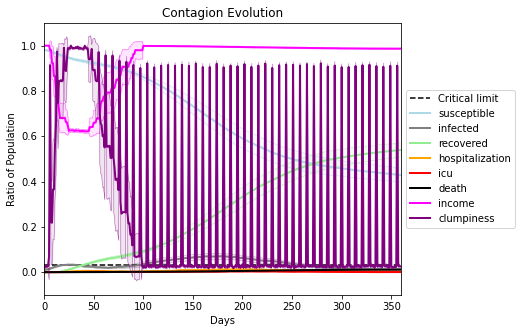

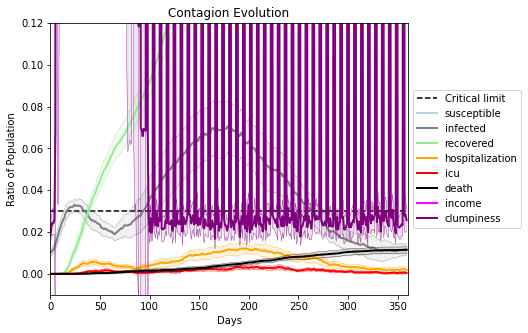

In [33]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.8
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3787, 8136, 489, 7347, 5794, 8406, 2155, 8568, 2674, 3928, 7566, 5027, 8391, 1523, 5888, 5580, 4843, 1537, 6604, 6813]
Average similarity between family members is 0.36483084673285954 at temperature -0.7
Average similarity between family and home is 0.9998601676414487 at temperature -1
Average similarity between students and their classroom is 0.16115208963000807 at temperature -0.7
Average classroom occupancy is 3.955223880597015 and number classrooms is 67
Average similarity between workers is 0.154504929856073 at temperature -0.7
Average office occupancy is 3.3251231527093594 and number offices is 203
Average friend similarity for adults: 0.4293409505953485 for kids: 0.2637819606255884
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.04214056838214968
avg restaurant similarity -0.030513670046534862
avg restaurant similarity 0.15419273018596677
avg restaurant similarity 0.07482932906461144
avg restaurant similarity 0.17376668938326076
avg restaurant similarity -0.11602545530244153
avg restaurant similarity 0.2660886838519066
avg restaurant similarity -0.0022370732453401015
avg restaurant similarity 0.37347125032272316
avg restaurant similarity 0.2800470299546637
avg restaurant similarity 0.022696855095599433
avg restaurant similarity 0.04439035399004227
avg restaurant similarity 0.0451712114399088
avg restaurant similarity -0.036795513817281356
avg restaurant similarity -0.06137074222287462
avg restaurant similarity 0.03510318489376561
avg restaurant similarity -0.06292563591492754
avg restaurant similarity 0.11810945348746875
avg restaurant similarity -0.0020071366901255275
avg restaurant similarity -0.09136313160112987
avg restaurant similarity 0.21725493169347943
avg restaurant similar

avg restaurant similarity 0.25041265777675753
avg restaurant similarity 0.12394923645895259
avg restaurant similarity 0.1863349967854763
avg restaurant similarity -0.039586224746430844
avg restaurant similarity 0.05102772059893348
avg restaurant similarity -0.03471153561493312
avg restaurant similarity 0.242286992793893
avg restaurant similarity 0.20167068480832184
avg restaurant similarity 0.06033004838261206
avg restaurant similarity -0.0315813630266617
avg restaurant similarity 0.1928753438029053
avg restaurant similarity 0.25617277966987584
avg restaurant similarity -0.021476120302313093
avg restaurant similarity -0.12062528948438747
avg restaurant similarity 0.25782783442963025
avg restaurant similarity -0.002635946636798031
avg restaurant similarity -0.034305957147609374
avg restaurant similarity -0.11474997034137221
avg restaurant similarity -0.06898369894260536
avg restaurant similarity -0.07655130039764778
avg restaurant similarity 0.1464365691739083
avg restaurant similarity 

avg restaurant similarity -0.010623093310015161
avg restaurant similarity 0.4291442722045895
avg restaurant similarity 0.022485086488806313
avg restaurant similarity -0.06967939865685611
avg restaurant similarity 0.1549782766607221
avg restaurant similarity -0.010473923307522198
avg restaurant similarity 0.12400152703900238
avg restaurant similarity -0.08750978463883115
avg restaurant similarity 0.14694273480420522
avg restaurant similarity 0.0026605599175728474
avg restaurant similarity 0.2758528610179286
avg restaurant similarity 0.24193326881149094
avg restaurant similarity -0.18546269205470434
avg restaurant similarity 0.21927741367350237
avg restaurant similarity 0.055616217994412825
avg restaurant similarity 0.1265490109505294
avg restaurant similarity 0.28432183572312153
avg restaurant similarity -0.0026415182024042
avg restaurant similarity -0.07025775128742275
avg restaurant similarity 0.1633240080069838
avg restaurant similarity 0.17118631125252334
avg restaurant similarity 0

avg restaurant similarity 0.08008408206843903
avg restaurant similarity 0.0965603446759482
avg restaurant similarity 0.6085353966563378
avg restaurant similarity 0.14123825669987178
avg restaurant similarity 0.022100041709622265
avg restaurant similarity -0.05108384964877684
avg restaurant similarity 0.006039493472783648
avg restaurant similarity 0.31219804998415285
avg restaurant similarity 0.06640622115494423
avg restaurant similarity 0.04464333016655097
avg restaurant similarity 0.08007379201896206
avg restaurant similarity 0.2073800151631789
avg restaurant similarity 0.18005317201345783
avg restaurant similarity -0.04345113675291072
avg restaurant similarity 0.03883024426986923
avg restaurant similarity 0.13296055556970057
avg restaurant similarity 0.20437705876678378
avg restaurant similarity 0.1187781857339762
avg restaurant similarity 0.26060704759469994
avg restaurant similarity 0.056052620224431964
avg restaurant similarity 0.021733376883319257
avg restaurant similarity 0.2282

avg restaurant similarity -0.06874588431510141
avg restaurant similarity -0.06965954244132745
avg restaurant similarity 0.16910445659158252
avg restaurant similarity 0.07681316992228046
avg restaurant similarity 0.1954287936206279
avg restaurant similarity 0.10964068221769847
avg restaurant similarity 0.01856403081627207
avg restaurant similarity 0.10719496338469553
avg restaurant similarity 0.03422748650055853
avg restaurant similarity 0.05729926063516383
avg restaurant similarity 0.24225043616772032
avg restaurant similarity 0.03490573416384708
avg restaurant similarity -0.02369564378324121
avg restaurant similarity 0.09459621137450717
avg restaurant similarity 0.0496987721305602
avg restaurant similarity 0.11977014431037589
avg restaurant similarity -0.039305678102025024
avg restaurant similarity 0.13177380141736483
avg restaurant similarity -0.04402257558144984
avg restaurant similarity 0.06541502234669203
avg restaurant similarity -0.030414335892695238
avg restaurant similarity 0.

avg restaurant similarity 0.09988505232998202
avg restaurant similarity 0.20953034827066436
avg restaurant similarity 0.04732780029054972
avg restaurant similarity 0.03802610265457521
avg restaurant similarity 0.06269619475310546
avg restaurant similarity 0.15545744205713108
avg restaurant similarity 0.1376295307384744
avg restaurant similarity 0.27486158200517147
avg restaurant similarity 0.289952007703388
avg restaurant similarity 0.03714434747806554
avg restaurant similarity 0.14102328440857304
avg restaurant similarity 0.02613031159499568
avg restaurant similarity -0.0206660938981322
avg restaurant similarity 0.03986671411913634
avg restaurant similarity -0.0233595263305031
avg restaurant similarity 0.10641837361576574
avg restaurant similarity 0.14155093041567227
avg restaurant similarity 0.23204534155767167
avg restaurant similarity 0.08823687879277127
avg restaurant similarity 0.08262735641964472
avg restaurant similarity 0.25281792382466467
avg restaurant similarity 0.110941043

avg restaurant similarity 0.21138007536585854
avg restaurant similarity 0.10050461194284692
avg restaurant similarity 0.08609290423508308
avg restaurant similarity 0.1879293171579685
avg restaurant similarity 0.04567576557443821
avg restaurant similarity 0.0885741247648932
avg restaurant similarity 0.06339855662490944
avg restaurant similarity 0.48739840140684193
avg restaurant similarity 0.2632131807328731
avg restaurant similarity -0.03636206251110072
avg restaurant similarity 0.05166888689083852
avg restaurant similarity 0.2920990995256696
avg restaurant similarity 0.11704340408533977
avg restaurant similarity 0.009958826533793642
avg restaurant similarity 0.19534565530743028
avg restaurant similarity 0.17492934854153488
avg restaurant similarity -0.037243383892080664
avg restaurant similarity 0.1254585803368871
avg restaurant similarity 0.05815975811980382
avg restaurant similarity -0.010112310581414671
avg restaurant similarity -0.0836048705425142
avg restaurant similarity 0.21935

avg restaurant similarity 0.05318195912535548
avg restaurant similarity 0.0764993012426938
avg restaurant similarity 0.27983270262812227
avg restaurant similarity 0.08116796430100368
avg restaurant similarity 0.15180752339034562
avg restaurant similarity -0.026122989741994534
avg restaurant similarity 0.08328992177413683
avg restaurant similarity 0.23821211333781694
avg restaurant similarity 0.14052098225633647
avg restaurant similarity 0.2037401230143201
avg restaurant similarity 0.07006630223844602
avg restaurant similarity -0.10229921629418066
avg restaurant similarity 0.02322203481311722
avg restaurant similarity 0.06387533929878854
avg restaurant similarity 0.07214097711440269
avg restaurant similarity 0.08875541858258461
avg restaurant similarity -0.034027596166613126
avg restaurant similarity 0.28214906445601706
avg restaurant similarity 0.0945860427641449
avg restaurant similarity 0.2010235738269599
avg restaurant similarity 0.03720859892397076
avg restaurant similarity 0.57974

avg restaurant similarity 0.022729056952557003
avg restaurant similarity 0.046416047962289216
avg restaurant similarity 0.17425146749822112
avg restaurant similarity -0.09893868602346192
avg restaurant similarity 0.16717820082990092
avg restaurant similarity 0.22712829766015474
avg restaurant similarity -0.11134224167941638
avg restaurant similarity 0.06281988261575938
avg restaurant similarity 0.053059741412496884
avg restaurant similarity 0.16986459788294972
avg restaurant similarity 0.14343460462811825
avg restaurant similarity 0.13542354524899913
avg restaurant similarity 0.07815425581411273
avg restaurant similarity -0.013878507821724409
avg restaurant similarity 0.02633346227917644
avg restaurant similarity 0.22865920033517942
avg restaurant similarity 0.18878895845446717
avg restaurant similarity 0.13378046843308036
avg restaurant similarity 0.05331472657771174
avg restaurant similarity 0.07905407891141794
avg restaurant similarity 0.15217961575598085
avg restaurant similarity 0

avg restaurant similarity -0.19626939003430338
avg restaurant similarity 0.3252151532672932
avg restaurant similarity 0.3842750989687936
avg restaurant similarity 0.0837568493125337
avg restaurant similarity 0.059835772231077784
avg restaurant similarity 0.046504226557486955
avg restaurant similarity -0.028157412339382324
avg restaurant similarity 0.13699703797221827
avg restaurant similarity 0.22777262901453854
avg restaurant similarity -0.012588268070526968
avg restaurant similarity 0.06632757656945965
avg restaurant similarity 0.011542128137125142
avg restaurant similarity -0.10165835838114534
avg restaurant similarity 0.2320255729580044
avg restaurant similarity 0.014057414022371907
avg restaurant similarity 0.06800245935724801
avg restaurant similarity 0.28720727074952107
avg restaurant similarity 0.2641882034526347
avg restaurant similarity 0.3900247961586155
avg restaurant similarity 0.07161543979871669
avg restaurant similarity 0.18501048120892827
avg restaurant similarity -0.2

avg restaurant similarity -0.12149299309542128
avg restaurant similarity 0.22534355381464405
avg restaurant similarity 0.048613855690266744
avg restaurant similarity 0.1938547612614286
avg restaurant similarity -0.10533855506505622
avg restaurant similarity 0.2970304761797445
avg restaurant similarity 0.05479374031169192
avg restaurant similarity 0.05048255009251926
avg restaurant similarity -0.0526669201178054
avg restaurant similarity 0.4345560029162914
avg restaurant similarity -0.14306355464390572
avg restaurant similarity 0.11423370576244969
avg restaurant similarity 0.03464742887797912
avg restaurant similarity 0.08610391878278613
avg restaurant similarity -0.042116005650042844
avg restaurant similarity -0.04293274227944393
avg restaurant similarity 0.0900296753965852
avg restaurant similarity 0.10050955996745356
avg restaurant similarity 0.06046508382417892
avg restaurant similarity -0.08122098859850166
avg restaurant similarity -0.11939698352160606
avg restaurant similarity 0.3

avg restaurant similarity 0.03575919118139157
avg restaurant similarity -0.04307288836396047
avg restaurant similarity 0.14775702075722344
avg restaurant similarity 0.19328221457505926
avg restaurant similarity 0.0035643902688977797
avg restaurant similarity 0.410329124621514
avg restaurant similarity 0.028840646387014463
avg restaurant similarity -0.11459910084585435
avg restaurant similarity 0.1432940108945877
avg restaurant similarity 0.1657667766237952
avg restaurant similarity -0.1059782692903557
avg restaurant similarity -0.047860496778105194
avg restaurant similarity 0.012802575812464835
avg restaurant similarity 0.24970940060108787
avg restaurant similarity 0.1531507689074829
avg restaurant similarity 0.21681169309634657
avg restaurant similarity 0.012093689917524866
avg restaurant similarity 0.26814651284302055
avg restaurant similarity 0.48184938416882217
avg restaurant similarity 0.057592247031496735
avg restaurant similarity 0.27884441007164235
avg restaurant similarity 0.2

avg restaurant similarity 0.1880993473112335
avg restaurant similarity 0.33252659466216017
avg restaurant similarity 0.013910788019624832
avg restaurant similarity 0.10662626917643411
avg restaurant similarity 0.14032166747117905
avg restaurant similarity 0.02987450271414173
avg restaurant similarity 0.2226066480993214
avg restaurant similarity -0.120062189379219
avg restaurant similarity 0.08258529030850682
avg restaurant similarity -0.12621874147903145
avg restaurant similarity 0.22948778015848237
avg restaurant similarity 0.06115432572600884
avg restaurant similarity 0.1729102720047363
avg restaurant similarity 0.23851217099357405
avg restaurant similarity -0.5845655606394701
avg restaurant similarity 0.07690748804917585
avg restaurant similarity 0.18642395691296224
avg restaurant similarity 0.17422668339927938
avg restaurant similarity -0.05501991386921301
avg restaurant similarity 0.016210614137221302
avg restaurant similarity 0.1731577994226114
avg restaurant similarity 0.1494943

avg restaurant similarity 0.09185648267774359
avg restaurant similarity -0.02967785601461077
avg restaurant similarity 0.19855443538492087
avg restaurant similarity 0.060996985355963
avg restaurant similarity 0.08541813491126315
avg restaurant similarity 0.11954993372029768
avg restaurant similarity 0.15551169523370414
avg restaurant similarity 0.051986553227717
avg restaurant similarity 0.33513465219301675
avg restaurant similarity 0.08144885126637198
avg restaurant similarity 0.16050393644530908
avg restaurant similarity 0.1932403445452197
avg restaurant similarity 0.1534606766700724
avg restaurant similarity 0.051031175789773855
avg restaurant similarity 0.31364317175892176
avg restaurant similarity 0.2058751316382812
avg restaurant similarity 0.2068836953320378
avg restaurant similarity 0.12949088222491342
avg restaurant similarity 0.1591332476483612
avg restaurant similarity 0.13149108437141735
avg restaurant similarity -0.0026425293649076946
avg restaurant similarity 0.0613323014

avg restaurant similarity 0.09075671302287777
avg restaurant similarity 0.17083109534788574
avg restaurant similarity 0.049264213348917896
avg restaurant similarity 0.15808216049461557
avg restaurant similarity 0.09596332696910775
avg restaurant similarity -0.0019719242285757
avg restaurant similarity 0.014662474640333295
avg restaurant similarity 0.3770664328226022
avg restaurant similarity 0.06499169291629546
avg restaurant similarity 0.09953816712363232
avg restaurant similarity 0.17461117050535063
avg restaurant similarity -0.0008898778137152128
avg restaurant similarity 0.23348062762663335
avg restaurant similarity 0.3706300292436631
avg restaurant similarity 0.09160718666599676
avg restaurant similarity 0.7666533107905484
avg restaurant similarity 0.09134262061418304
avg restaurant similarity 0.0735575836980347
avg restaurant similarity 0.04805705445241479
avg restaurant similarity 0.10676373732318475
avg restaurant similarity -0.03656317677257363
avg restaurant similarity 0.2042

avg restaurant similarity 0.025350833556794957
avg restaurant similarity 0.13288295452758728
avg restaurant similarity 0.165402528760749
avg restaurant similarity -0.001086785480195647
avg restaurant similarity 0.20178845193222278
avg restaurant similarity 0.19146089794405677
avg restaurant similarity 0.11458574523893242
avg restaurant similarity 0.09307351482476284
avg restaurant similarity 0.03223328606201112
avg restaurant similarity 0.1883710288449643
avg restaurant similarity 0.40338143645606084
avg restaurant similarity 0.09715411354923974
avg restaurant similarity 0.1279905225555986
avg restaurant similarity 0.12603168481147445
avg restaurant similarity 0.2598634322053096
avg restaurant similarity -0.14035894963580486
avg restaurant similarity 0.39419277722439117
avg restaurant similarity 0.18797402422540183
avg restaurant similarity 0.1856981034377927
avg restaurant similarity 0.10752225617560177
avg restaurant similarity -0.022737716405279256
avg restaurant similarity 0.257915

avg restaurant similarity 0.2595498822650749
avg restaurant similarity 0.21300624935974163
avg restaurant similarity 0.013978353604720852
avg restaurant similarity 0.07557767665927188
avg restaurant similarity 0.11813346407664332
avg restaurant similarity 0.11310077932365627
avg restaurant similarity 0.1767800882871101
avg restaurant similarity -0.009497164359457933
avg restaurant similarity 0.31577876992738485
avg restaurant similarity 0.10483186375128556
avg restaurant similarity 0.10045266423881016
avg restaurant similarity 0.04630865293397157
avg restaurant similarity 0.13990987617368045
avg restaurant similarity 0.05324051004175028
avg restaurant similarity 0.15759564354446023
avg restaurant similarity 0.09959252829638245
avg restaurant similarity 0.11023242970628809
avg restaurant similarity 0.08301712748430584
avg restaurant similarity 0.0026845617186514598
avg restaurant similarity 0.07502118954613693
avg restaurant similarity 0.14324919224746074
avg restaurant similarity 0.145

avg restaurant similarity 0.07816433797197692
avg restaurant similarity 0.28334956253202276
avg restaurant similarity 0.10417042575930588
avg restaurant similarity 0.08098634359874579
avg restaurant similarity -0.10599668690187705
avg restaurant similarity -0.013735979085005713
avg restaurant similarity 0.11330544386027148
avg restaurant similarity 0.0664177326965746
avg restaurant similarity 0.255821029618104
avg restaurant similarity 0.13241562830006565
avg restaurant similarity -0.038526982265653924
avg restaurant similarity 0.17341221482906766
avg restaurant similarity 0.03199901272771225
avg restaurant similarity 0.07435779269461762
avg restaurant similarity 0.049936240586112436
avg restaurant similarity 0.12238223754995091
avg restaurant similarity 0.1449772417409527
avg restaurant similarity 0.013949202701638123
avg restaurant similarity -0.016480346994564736
avg restaurant similarity 0.07909041923758703
avg restaurant similarity 0.19432343659747758
avg restaurant similarity 0.0

avg restaurant similarity 0.05826615868079025
avg restaurant similarity 0.00571338968722753
avg restaurant similarity 0.04275608086530864
avg restaurant similarity 0.015073773181954228
avg restaurant similarity 0.13080807542026493
avg restaurant similarity 0.1357264016567153
avg restaurant similarity 0.12957742895552007
avg restaurant similarity 0.07835673504754864
avg restaurant similarity 0.10610931049140944
avg restaurant similarity 0.21221646228572716
avg restaurant similarity 0.15239655371239197
avg restaurant similarity 0.10568373024135079
avg restaurant similarity 0.23830402213966329
avg restaurant similarity 0.20200305677462432
avg restaurant similarity 0.18613471367418227
avg restaurant similarity 0.04076080913664162
avg restaurant similarity 0.18645455418046528
avg restaurant similarity 0.15469484043387777
avg restaurant similarity 0.0874799597378972
avg restaurant similarity 0.39082838078988963
avg restaurant similarity 0.03963580002129256
avg restaurant similarity 0.1328484

avg restaurant similarity -0.03964012461912481
avg restaurant similarity -0.08634291908184354
avg restaurant similarity 0.1981066831759877
avg restaurant similarity 0.20036839688242697
avg restaurant similarity 0.0032860441906543874
avg restaurant similarity -0.02644549834743445
avg restaurant similarity 0.17012571866557866
avg restaurant similarity 0.1528490294170104
avg restaurant similarity 0.0556673805714747
avg restaurant similarity -0.11901170745503283
avg restaurant similarity 0.1856976657382354
avg restaurant similarity 0.1438829686186102
avg restaurant similarity 0.03922657365487007
avg restaurant similarity -0.08191962770887236
avg restaurant similarity -0.12167209180398307
avg restaurant similarity 0.10739490079458588
avg restaurant similarity 0.1571863890148759
avg restaurant similarity 0.04798615504031373
avg restaurant similarity 0.302334687695085
avg restaurant similarity 0.16216101908166455
avg restaurant similarity 0.01894318983290825
avg restaurant similarity 0.117567

avg restaurant similarity 0.09121483376609148
avg restaurant similarity 0.16897087187176552
avg restaurant similarity 0.2822625149062645
avg restaurant similarity 0.12108717183860576
avg restaurant similarity 0.17891808377170948
avg restaurant similarity 0.35093997220489986
avg restaurant similarity 0.06381061944270125
avg restaurant similarity 0.34636602413022854
avg restaurant similarity 0.09034594265124542
avg restaurant similarity 0.31960411010978645
avg restaurant similarity 0.268036651912363
avg restaurant similarity 0.3022859225387178
avg restaurant similarity -0.19227736734703021
avg restaurant similarity 0.23806521157533486
avg restaurant similarity 0.11622423739679141
avg restaurant similarity 0.3259417926195897
avg restaurant similarity -0.16452880138853612
avg restaurant similarity -0.04114532366619581
avg restaurant similarity 0.056744680647256636
avg restaurant similarity -0.1037284699171665
avg restaurant similarity 0.3505819712849711
avg restaurant similarity 0.10564876

avg restaurant similarity 0.16287352235356434
avg restaurant similarity 0.25904116018504947
avg restaurant similarity -0.017557257879110104
avg restaurant similarity 0.005548782471297226
avg restaurant similarity 0.13327146955651498
avg restaurant similarity 0.3581596536689702
avg restaurant similarity 0.05980481198330816
avg restaurant similarity -0.04075677048538446
avg restaurant similarity -0.01998357098424542
avg restaurant similarity 0.010268971202943455
avg restaurant similarity 0.256174175437618
avg restaurant similarity 0.08512984102188312
avg restaurant similarity 0.22478116652814745
avg restaurant similarity -0.11919268622397994
avg restaurant similarity -0.06177456524668817
avg restaurant similarity 0.16857743067556452
avg restaurant similarity -0.20530521879013197
avg restaurant similarity 0.21234487937789737
avg restaurant similarity 0.09691939341100834
avg restaurant similarity 0.24537196313523993
avg restaurant similarity 0.16614145890287654
avg restaurant similarity 0.

avg restaurant similarity 0.03227070930567324
avg restaurant similarity 0.25545273656298473
avg restaurant similarity -0.017296196627489657
avg restaurant similarity -0.0160866524970827
avg restaurant similarity 0.09593892204125958
avg restaurant similarity 0.1642280058725521
avg restaurant similarity -0.4156175237806098
avg restaurant similarity 0.007630142896746191
avg restaurant similarity 0.04258122197660926
avg restaurant similarity 0.0876899927250627
avg restaurant similarity 0.26677730398198085
avg restaurant similarity 0.03689970423135636
avg restaurant similarity 0.44453020368329027
avg restaurant similarity 0.1773078254223011
avg restaurant similarity 0.2688001793267746
avg restaurant similarity 0.2447913629628743
avg restaurant similarity 0.1734297887762153
avg restaurant similarity 0.20371167647343205
avg restaurant similarity 0.20704154856471121
avg restaurant similarity -0.061141158475951515
avg restaurant similarity -0.28564951444513026
avg restaurant similarity 0.062054

avg restaurant similarity 0.1031963903572903
avg restaurant similarity 0.18077169794577608
avg restaurant similarity 0.1630318853492638
avg restaurant similarity 0.2353889979380713
avg restaurant similarity 0.29564008179681334
avg restaurant similarity 0.04968784060362157
avg restaurant similarity 0.2713991086594556
avg restaurant similarity 0.27897555933935864
avg restaurant similarity 0.0665167355608583
avg restaurant similarity 0.18093412347193238
avg restaurant similarity 0.03742683761280896
avg restaurant similarity 0.10839502330768744
avg restaurant similarity 0.17030153696871056
avg restaurant similarity 0.17970513982733108
avg restaurant similarity 0.30219467822753393
avg restaurant similarity 0.10006436309511536
avg restaurant similarity 0.18926243191389389
avg restaurant similarity 0.07585813160390255
avg restaurant similarity 0.2937076660533769
avg restaurant similarity -0.09497247468612154
avg restaurant similarity 0.2339253864267046
avg restaurant similarity -0.02804377948

avg restaurant similarity 0.1670340311194645
avg restaurant similarity 0.19967206107397395
avg restaurant similarity 0.17962563742767612
avg restaurant similarity -0.03516859663351755
avg restaurant similarity 0.13148153975185323
avg restaurant similarity -0.36537549021581056
avg restaurant similarity -0.31860030298714154
avg restaurant similarity 0.09106539020302601
avg restaurant similarity -0.3558312260190778
avg restaurant similarity 0.16304218406222698
avg restaurant similarity 0.187610628997308
avg restaurant similarity 0.04748770961590369
avg restaurant similarity 0.1308128871589972
avg restaurant similarity -0.2861495933558049
avg restaurant similarity 0.04523459188897374
avg restaurant similarity -0.03801420918673427
avg restaurant similarity -0.11307773243905737
avg restaurant similarity 0.33146232627796457
avg restaurant similarity 0.03209731435251104
avg restaurant similarity 0.16856688779055773
avg restaurant similarity 0.06880713092091373
avg restaurant similarity -0.3399

avg restaurant similarity -0.18357069360732903
avg restaurant similarity 0.06994783610513179
avg restaurant similarity 0.06726990997140256
avg restaurant similarity 0.01808111846603974
avg restaurant similarity 0.27739297649731076
avg restaurant similarity 0.1716928564138339
avg restaurant similarity 0.14228362686722304
avg restaurant similarity -0.1488088795712347
avg restaurant similarity 0.2791558122465931
avg restaurant similarity -0.12069427241643511
avg restaurant similarity -0.05067312315929628
avg restaurant similarity -0.0261669234721392
avg restaurant similarity 0.03956298600745274
avg restaurant similarity 0.2632919750511247
avg restaurant similarity 0.11689960887433903
avg restaurant similarity -0.011152924431996503
avg restaurant similarity -0.16099219977009546
avg restaurant similarity 0.15239611408645956
avg restaurant similarity -0.015214573892363817
avg restaurant similarity -0.09005475380320548
avg restaurant similarity 0.05294065027944962
avg restaurant similarity 0.

avg restaurant similarity 0.08995938543103184
avg restaurant similarity 0.05091146256366646
avg restaurant similarity 0.2968715540827368
avg restaurant similarity 0.1839747969409544
avg restaurant similarity 0.1605584504875114
avg restaurant similarity -0.15157748722460632
avg restaurant similarity 0.14548484061757358
avg restaurant similarity 0.018723882010184177
avg restaurant similarity 0.22157747224907837
avg restaurant similarity 0.06866941163993516
avg restaurant similarity 0.09958756170880288
avg restaurant similarity 0.1062866327055412
avg restaurant similarity -0.001660459833766989
avg restaurant similarity 0.2857758949633881
avg restaurant similarity 0.021253535024985802
avg restaurant similarity 0.0180227136122375
avg restaurant similarity 0.09458348699817445
avg restaurant similarity 0.150244378812852
avg restaurant similarity -0.10486874407478632
avg restaurant similarity 0.03700255049250412
avg restaurant similarity 0.10522124055602672
avg restaurant similarity 0.25313113

avg restaurant similarity 0.08412164073490282
avg restaurant similarity 0.05760671150215072
avg restaurant similarity 0.13760919785374628
avg restaurant similarity 0.21308896356588689
avg restaurant similarity 0.23008855776600126
avg restaurant similarity 0.15476489408506655
avg restaurant similarity 0.2906256999409583
avg restaurant similarity 0.04146512762581857
avg restaurant similarity 0.07279258719430723
avg restaurant similarity 0.1629374339747054
avg restaurant similarity -0.0058377250574545205
avg restaurant similarity 0.311550004913456
avg restaurant similarity 0.07444926179553679
avg restaurant similarity 0.05776291333331156
avg restaurant similarity 0.17363849158392003
avg restaurant similarity 0.2778042203347104
avg restaurant similarity 0.1444820283752956
avg restaurant similarity 0.2312967036550196
avg restaurant similarity 0.2863498048979572
avg restaurant similarity -0.05572505316806184
avg restaurant similarity 0.20157636587965172
avg restaurant similarity 0.1260561393

avg restaurant similarity 0.15950446448406
avg restaurant similarity 0.10613885615264367
avg restaurant similarity 0.2377500001448766
avg restaurant similarity 0.12194826909562236
avg restaurant similarity -0.06930541796352611
avg restaurant similarity 0.3194698234369593
avg restaurant similarity -0.04711023798801106
avg restaurant similarity 0.288960025794287
avg restaurant similarity 0.09202846014086352
avg restaurant similarity 0.2052445122752759
avg restaurant similarity 0.3215881691834825
avg restaurant similarity -0.03385196906564573
avg restaurant similarity 0.18822799693418155
avg restaurant similarity 0.052947446952117797
avg restaurant similarity 0.16630285813740903
avg restaurant similarity 0.08794436197037594
avg restaurant similarity 0.18614661366124555
avg restaurant similarity 0.1383174993875915
avg restaurant similarity 0.3751137817774194
avg restaurant similarity 0.21138893765120903
avg restaurant similarity 0.04016047091743564
avg restaurant similarity -0.192168740361

avg restaurant similarity 0.07623541883676765
avg restaurant similarity 0.044964557566229066
avg restaurant similarity -0.0693100577225579
avg restaurant similarity -0.13032055967468595
avg restaurant similarity 0.06751796824793768
avg restaurant similarity 0.3598190329077099
avg restaurant similarity 0.1738263071339908
avg restaurant similarity 0.1546499467910147
avg restaurant similarity 0.05326657354908246
avg restaurant similarity 0.014325164838841076
avg restaurant similarity -0.00020949767824068877
avg restaurant similarity 0.0992162260140409
avg restaurant similarity 0.08631328136468458
avg restaurant similarity 0.1871849708485946
avg restaurant similarity -0.11220154235834857
avg restaurant similarity 0.31057171405167894
avg restaurant similarity -0.09071671873468355
avg restaurant similarity 0.025222896297201796
avg restaurant similarity 0.15509202784367465
avg restaurant similarity 0.282669917234192
avg restaurant similarity 0.4666376465646024
avg restaurant similarity -0.199

avg restaurant similarity 0.2680848548626565
avg restaurant similarity 0.08261977962144997
avg restaurant similarity 0.04833399577851458
avg restaurant similarity 0.2054297445692946
avg restaurant similarity 0.005529152906710785
avg restaurant similarity 0.2273642955414082
avg restaurant similarity 0.12005684858177974
avg restaurant similarity 0.11449626418244296
avg restaurant similarity 0.07707720697099843
avg restaurant similarity 0.11163892148237074
avg restaurant similarity 0.10792641264170963
avg restaurant similarity 0.3029374962881178
avg restaurant similarity 0.18338488476664072
avg restaurant similarity 0.046330243770673116
avg restaurant similarity 0.1172616459170869
avg restaurant similarity -0.06941051599342568
avg restaurant similarity -0.045855303278669594
avg restaurant similarity -0.04073018437586274
avg restaurant similarity 0.2443184164715934
avg restaurant similarity 0.37478409872955376
avg restaurant similarity 0.15316278936958894
avg restaurant similarity 0.061472

avg restaurant similarity 0.07451413795427662
avg restaurant similarity 0.08405334944883373
avg restaurant similarity -0.03613446114793408
avg restaurant similarity 0.27551478198339713
avg restaurant similarity 0.03021749656157096
avg restaurant similarity 0.2925668584795018
avg restaurant similarity 0.17433775979362617
avg restaurant similarity -0.001627746979993433
avg restaurant similarity 0.1256807941068947
avg restaurant similarity 0.07815101432412155
avg restaurant similarity 0.44158802176398043
avg restaurant similarity -0.019201002597496877
avg restaurant similarity 0.2194756646342059
avg restaurant similarity 0.29783776446599625
avg restaurant similarity 0.21034268744922605
avg restaurant similarity -0.002295353238326064
avg restaurant similarity 0.06705487569319526
avg restaurant similarity 0.28616760502667693
avg restaurant similarity 0.2146043866740788
avg restaurant similarity 0.09794488790972372
avg restaurant similarity 0.13339178429133086
avg restaurant similarity -0.00

avg restaurant similarity 0.06865296027013162
avg restaurant similarity 0.321400798766883
avg restaurant similarity 0.07560080916413656
avg restaurant similarity -0.06728285170561686
avg restaurant similarity 0.18229673202694407
avg restaurant similarity 0.17566160085092622
avg restaurant similarity 0.19542132538643212
avg restaurant similarity 0.14200562238682987
avg restaurant similarity 0.06723559154852696
avg restaurant similarity -0.04007473544423665
avg restaurant similarity -0.11143536526414266
avg restaurant similarity 0.13665180142869718
avg restaurant similarity 0.36040372446346636
avg restaurant similarity 0.14564137137900376
avg restaurant similarity 0.07608456569517444
avg restaurant similarity 0.2494468284037733
avg restaurant similarity 0.21718623655657945
avg restaurant similarity 0.1649589213078799
avg restaurant similarity 0.0016500124796254528
avg restaurant similarity 0.5273993964457618
avg restaurant similarity 0.28673343304968474
avg restaurant similarity 0.178199

avg restaurant similarity 0.4109875778311969
avg restaurant similarity 0.18841877232776832
avg restaurant similarity 0.10197698612408171
avg restaurant similarity 0.5023042756451537
avg restaurant similarity -0.0256423786015115
avg restaurant similarity 0.15421123356147196
avg restaurant similarity 0.07895145173070692
avg restaurant similarity 0.3855492752936896
avg restaurant similarity 0.27412993725956625
avg restaurant similarity 0.3251614600159147
avg restaurant similarity 0.392137330032346
avg restaurant similarity -0.02514256603272822
avg restaurant similarity 0.11194311617082131
avg restaurant similarity -7.592701887599677e-05
avg restaurant similarity 0.006887579440408106
avg restaurant similarity -0.02688630798167275
avg restaurant similarity -0.14932164753390376
avg restaurant similarity 0.8418868219040553
avg restaurant similarity -0.013196322594981144
avg restaurant similarity 0.20472906565850157
avg restaurant similarity -0.20968632823985697
avg restaurant similarity 0.059

avg restaurant similarity 0.18809657410892391
avg restaurant similarity 0.026518925098932056
avg restaurant similarity -0.04501949444200856
avg restaurant similarity -0.40378495200325626
avg restaurant similarity 0.10623425347971907
avg restaurant similarity -0.01435996465803898
avg restaurant similarity 0.06985408259925145
avg restaurant similarity 0.20591636201048935
avg restaurant similarity 0.034294623749237925
avg restaurant similarity 0.2240743279588345
avg restaurant similarity 0.44253803464895963
avg restaurant similarity 0.07141793848077962
avg restaurant similarity 0.12840430495657848
avg restaurant similarity 0.2658717466989912
avg restaurant similarity 0.03731220110748772
avg restaurant similarity 0.06195731880210218
avg restaurant similarity 0.07561461621302952
avg restaurant similarity -0.009869220249950244
avg restaurant similarity 0.2986386843753629
avg restaurant similarity -0.11999922126140997
avg restaurant similarity 0.04680104788643997
avg restaurant similarity 0.0

avg restaurant similarity 0.1516094602357711
avg restaurant similarity -0.18531565891528617
avg restaurant similarity 0.018132741395420912
avg restaurant similarity 0.088840852811008
avg restaurant similarity 0.1895387001774586
avg restaurant similarity 0.13904962355731043
avg restaurant similarity 0.10046382789927485
avg restaurant similarity 0.20484125362560643
avg restaurant similarity 0.2337868025551364
avg restaurant similarity 0.2018641958270573
avg restaurant similarity -0.09098135938923034
avg restaurant similarity -0.009664375589192647
avg restaurant similarity -0.030601769087858312
avg restaurant similarity 0.18895319850696635
avg restaurant similarity 0.04808459440419356
avg restaurant similarity -0.09843728786064715
avg restaurant similarity 0.05526008978847874
avg restaurant similarity 0.22575339985841997
avg restaurant similarity 0.03215152120029375
avg restaurant similarity 0.03752404979987973
avg restaurant similarity 0.07335216286579593
avg restaurant similarity 0.0715

avg restaurant similarity 0.0903510247747175
avg restaurant similarity 0.4676441017636729
avg restaurant similarity -0.05419467158448925
avg restaurant similarity 0.41189313642342623
avg restaurant similarity 0.3591630308453486
avg restaurant similarity -0.07076863368185028
avg restaurant similarity 0.14233438053127537
avg restaurant similarity -0.006770823122099294
avg restaurant similarity 0.4409200593480097
avg restaurant similarity 0.07735155879477046
avg restaurant similarity -0.06854869304222148
avg restaurant similarity -0.08967694744853727
avg restaurant similarity -0.031036274126227958
avg restaurant similarity -0.12046617334972
avg restaurant similarity 0.35467398552540097
avg restaurant similarity 0.06294417465518337
avg restaurant similarity -0.006223585504350712
avg restaurant similarity 0.3994085639600816
avg restaurant similarity 0.1636023217184712
avg restaurant similarity -0.3151380312971236
avg restaurant similarity 0.11773038810194776
avg restaurant similarity -0.084

avg restaurant similarity 0.07498393249937318
avg restaurant similarity -0.07423289338915193
avg restaurant similarity 0.04831728747737429
avg restaurant similarity -0.06633956522701502
avg restaurant similarity 0.04514963164092085
avg restaurant similarity 0.16356327113738722
avg restaurant similarity 0.20756626495276306
avg restaurant similarity 0.25465795843572325
avg restaurant similarity 0.08140723410802327
avg restaurant similarity 0.20043524712884803
avg restaurant similarity 0.17617746347411262
avg restaurant similarity 0.16903919907208642
avg restaurant similarity 0.37876601216921446
avg restaurant similarity 0.3693396368404932
avg restaurant similarity 0.014564569062748528
avg restaurant similarity -0.012522810436052653
avg restaurant similarity 0.2412121977112886
avg restaurant similarity 0.004310985294377623
avg restaurant similarity 0.1100227494290273
avg restaurant similarity -0.04436700009554759
avg restaurant similarity 0.1801809872048863
avg restaurant similarity -0.04

avg restaurant similarity 0.0957584397171033
avg restaurant similarity 0.15612743067167392
avg restaurant similarity 0.21664966930583657
avg restaurant similarity 0.3419158192277763
avg restaurant similarity 0.07156677784676105
avg restaurant similarity -0.04673102640226932
avg restaurant similarity 0.19366614053718414
avg restaurant similarity 0.3181801452697533
avg restaurant similarity 0.24626675244434862
avg restaurant similarity 0.3060137339104643
avg restaurant similarity 0.16158093012160327
avg restaurant similarity 0.40809057476228433
avg restaurant similarity 0.18645875098574816
avg restaurant similarity 0.10811906751115019
avg restaurant similarity 0.19503747037007513
avg restaurant similarity 0.2771551445858919
avg restaurant similarity 0.10749650007020364
avg restaurant similarity 0.3724416115319568
avg restaurant similarity 0.17807146175613828
avg restaurant similarity 0.06261008074925241
avg restaurant similarity 0.07518756589235862
avg restaurant similarity 0.08777966618

avg restaurant similarity 0.08419165253189369
avg restaurant similarity 0.03441314029944245
avg restaurant similarity 0.0895159304435375
avg restaurant similarity 0.10997035810063398
avg restaurant similarity 0.31123652158632203
avg restaurant similarity 0.1114266336755231
avg restaurant similarity 0.17445086336539878
avg restaurant similarity 0.5162608410452302
avg restaurant similarity 0.03322550568169695
avg restaurant similarity 0.14431484940681205
avg restaurant similarity 0.057798290550638884
avg restaurant similarity 0.2356105054647168
avg restaurant similarity 0.11982533431820042
avg restaurant similarity -0.010690184007249387
avg restaurant similarity 0.11237055972317615
avg restaurant similarity 0.10879643031195045
avg restaurant similarity 0.07148888806881297
avg restaurant similarity 0.2530747247139412
avg restaurant similarity 0.18932753552667778
avg restaurant similarity 0.08995661931416696
avg restaurant similarity 0.14973759704827128
avg restaurant similarity 0.13251833

(<function dict.items>, <function dict.items>, <function dict.items>)

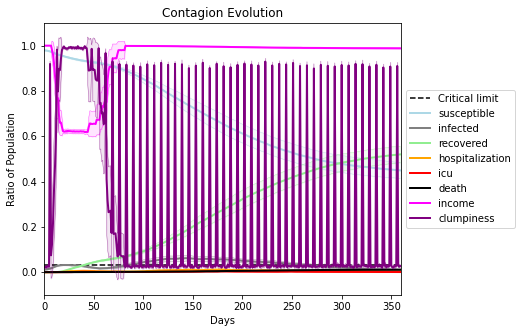

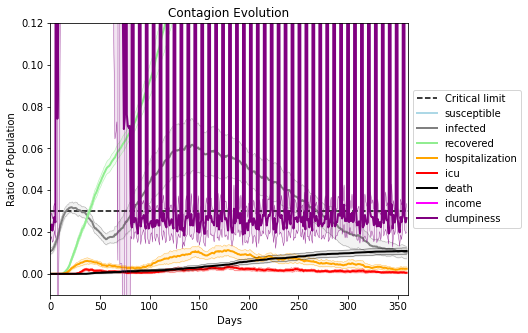

In [34]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.7
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[5350, 8832, 73, 8932, 4049, 474, 1913, 417, 3465, 8942, 5861, 8656, 9135, 5533, 2658, 2578, 7746, 9866, 3202, 6636]
Average similarity between family members is 0.28807734286643744 at temperature -0.6
Average similarity between family and home is 0.999861789507376 at temperature -1
Average similarity between students and their classroom is 0.20523476958059397 at temperature -0.6
Average classroom occupancy is 3.8714285714285714 and number classrooms is 70
Average similarity between workers is 0.16865371670134136 at temperature -0.6
Average office occupancy is 3.2857142857142856 and number offices is 203
Average friend similarity for adults: 0.38095985665685833 for kids: 0.21127091164092815
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.12419359725332002
avg restaurant similarity -0.02561912073521492
avg restaurant similarity 0.2352892738546107
avg restaurant similarity 0.3953266930222966
avg restaurant similarity 0.058606976485646826
avg restaurant similarity -0.0044585743367654244
avg restaurant similarity -0.06255242571571887
avg restaurant similarity -0.10301918440856961
avg restaurant similarity -0.15938778061069106
avg restaurant similarity -0.008161235208826265
avg restaurant similarity -0.17772294262413368
avg restaurant similarity 0.14699579257069662
avg restaurant similarity -0.0677001439944998
avg restaurant similarity -0.17530598997519284
avg restaurant similarity -0.04965246839485528
avg restaurant similarity 0.09084975344882323
avg restaurant similarity 0.03299657957248138
avg restaurant similarity -0.14337641099626167
avg restaurant similarity 0.35832579260307124
avg restaurant similarity -0.06536879774539173
avg restaurant similarity -0.13923961394232218
avg restaurant simil

avg restaurant similarity -0.16214200453277963
avg restaurant similarity 0.1011459539194313
avg restaurant similarity 0.03742274056807784
avg restaurant similarity 0.133580700266755
avg restaurant similarity 0.16193422713406555
avg restaurant similarity 0.10870770376871879
avg restaurant similarity -0.017842233905151807
avg restaurant similarity 0.697364469351688
avg restaurant similarity 0.10601328025436299
avg restaurant similarity 0.2976344170619232
avg restaurant similarity -0.0544790750974643
avg restaurant similarity 0.047614384174570104
avg restaurant similarity 0.05197982980859855
avg restaurant similarity 0.09352452343016027
avg restaurant similarity -0.1778317715105232
avg restaurant similarity -0.1778317715105232
avg restaurant similarity 0.07688798681262375
avg restaurant similarity 0.06700143954080005
avg restaurant similarity 0.10212554096987658
avg restaurant similarity 0.1631392163642173
avg restaurant similarity 0.06320934135004883
avg restaurant similarity -0.01644705

avg restaurant similarity 0.125082584023301
avg restaurant similarity 0.1601656546681639
avg restaurant similarity -0.08972548056337301
avg restaurant similarity 0.21112987525144988
avg restaurant similarity 0.050666318551539316
avg restaurant similarity 0.021925425881517958
avg restaurant similarity 0.19521743937028693
avg restaurant similarity 0.13008820493250073
avg restaurant similarity -0.061388699046315824
avg restaurant similarity 0.15283780237901748
avg restaurant similarity 0.14450172790956645
avg restaurant similarity -0.017072945171998494
avg restaurant similarity -0.041303461918493066
avg restaurant similarity 0.09866636217367576
avg restaurant similarity 0.023230930775261345
avg restaurant similarity 0.2760391192134318
avg restaurant similarity 0.01615491024979106
avg restaurant similarity 0.017672661798164013
avg restaurant similarity 0.1269087658254134
avg restaurant similarity 0.13771287271631488
avg restaurant similarity 0.21263417590609998
avg restaurant similarity 0.

avg restaurant similarity -0.010282072990023847
avg restaurant similarity -0.10031559177715217
avg restaurant similarity 0.19504488209807835
avg restaurant similarity 0.15108654062895643
avg restaurant similarity 0.18513743841161248
avg restaurant similarity 0.13975937419479786
avg restaurant similarity 0.23451883135398635
avg restaurant similarity 0.036288898542784755
avg restaurant similarity 0.03163191802813601
avg restaurant similarity 0.32331253933433135
avg restaurant similarity -0.021839610602738237
avg restaurant similarity 0.19653471973025594
avg restaurant similarity 0.02347258746234322
avg restaurant similarity 0.09519267467733745
avg restaurant similarity -0.05562590943695628
avg restaurant similarity 0.27920932876788834
avg restaurant similarity 0.3748241269897855
avg restaurant similarity 0.04815609662009495
avg restaurant similarity -0.30271670136724155
avg restaurant similarity 0.16112024533510108
avg restaurant similarity 0.25834333421969286
avg restaurant similarity -

avg restaurant similarity -0.05838722282399214
avg restaurant similarity 0.05073561990230364
avg restaurant similarity 0.0669059404940555
avg restaurant similarity -0.03988679382958999
avg restaurant similarity 0.08643756581125286
avg restaurant similarity 0.05626502055292545
avg restaurant similarity 0.14744573458331517
avg restaurant similarity 0.2807212521161185
avg restaurant similarity 0.02018963199519516
avg restaurant similarity 0.035122056246482916
avg restaurant similarity -0.11041248310038132
avg restaurant similarity 0.3024715257929805
avg restaurant similarity 0.26966314953187126
avg restaurant similarity 0.08018179711484628
avg restaurant similarity 0.06610868911463628
avg restaurant similarity 0.09799300116819083
avg restaurant similarity 0.03586932182847581
avg restaurant similarity 0.07307863319352699
avg restaurant similarity 0.15808495514091334
avg restaurant similarity 0.01718337911506403
avg restaurant similarity 0.01902583936903848
avg restaurant similarity 0.22048

avg restaurant similarity 0.10166029892433115
avg restaurant similarity 0.05097950411751536
avg restaurant similarity 0.010652832687522073
avg restaurant similarity 0.12853019203851762
avg restaurant similarity 0.15646933479152636
avg restaurant similarity 0.22516954564007866
avg restaurant similarity 0.21659951155516138
avg restaurant similarity 0.09369158270554204
avg restaurant similarity 0.01419042204435598
avg restaurant similarity 0.3367204457537386
avg restaurant similarity 0.19329717194621027
avg restaurant similarity -0.03331173239048762
avg restaurant similarity 0.12436118225597284
avg restaurant similarity 0.08397253608929568
avg restaurant similarity 0.12892933660262543
avg restaurant similarity 0.08358464895460674
avg restaurant similarity 0.047220901580776485
avg restaurant similarity -0.011152308941940015
avg restaurant similarity 0.1420448461261942
avg restaurant similarity 0.22844661469335603
avg restaurant similarity 0.20891712916811714
avg restaurant similarity -0.01

avg restaurant similarity 0.07562782887458891
avg restaurant similarity 0.09777462102876602
avg restaurant similarity 0.15889026103643356
avg restaurant similarity 0.003044205765871114
avg restaurant similarity -0.018995892760029248
avg restaurant similarity 0.2809513550880373
avg restaurant similarity 0.3330028857211092
avg restaurant similarity -0.1757939023029813
avg restaurant similarity 0.21320042325297003
avg restaurant similarity -0.045692344127201946
avg restaurant similarity 0.039601869073112354
avg restaurant similarity 0.16327117164132193
avg restaurant similarity -0.08315445977403635
avg restaurant similarity -0.07041301604902536
avg restaurant similarity 0.042741299599820703
avg restaurant similarity -0.01133833121984878
avg restaurant similarity 0.23519511888946965
avg restaurant similarity 0.1456300441656565
avg restaurant similarity 0.02559675302459148
avg restaurant similarity -0.03229252006358726
avg restaurant similarity 0.2755871023050256
avg restaurant similarity -

avg restaurant similarity 0.1152551588634125
avg restaurant similarity 0.033358319499266605
avg restaurant similarity 0.08522504415299216
avg restaurant similarity 0.07548903266477229
avg restaurant similarity -0.08834276367368182
avg restaurant similarity 0.09645352188614563
avg restaurant similarity 0.3645678513944885
avg restaurant similarity -0.0008533561694759245
avg restaurant similarity 0.04672514389066086
avg restaurant similarity 0.1074548958546379
avg restaurant similarity -0.010034063731863099
avg restaurant similarity -0.16745148312085906
avg restaurant similarity 0.05285081553634855
avg restaurant similarity -0.25001913045912794
avg restaurant similarity 0.1469839722752099
avg restaurant similarity 0.07061015481581444
avg restaurant similarity 0.10192537953389472
avg restaurant similarity -0.049664543960406614
avg restaurant similarity 0.04467182455051394
avg restaurant similarity 0.07191982276373228
avg restaurant similarity -0.08568248351874584
avg restaurant similarity 

avg restaurant similarity 0.07129672970368701
avg restaurant similarity 0.048178594379586014
avg restaurant similarity 0.014106032036497473
avg restaurant similarity -0.10261314288223936
avg restaurant similarity 0.20980799304441045
avg restaurant similarity 0.2309707893787527
avg restaurant similarity 0.046782471289127874
avg restaurant similarity -0.1187763134095962
avg restaurant similarity 0.0155771063750282
avg restaurant similarity 0.30178990816765977
avg restaurant similarity -0.08775303445976215
avg restaurant similarity 0.14353552568359756
avg restaurant similarity 0.06074401379272145
avg restaurant similarity -0.07865352597850332
avg restaurant similarity 0.06380230927951393
avg restaurant similarity 0.20613865959649155
avg restaurant similarity 0.14692536827544136
avg restaurant similarity -0.11263119381411883
avg restaurant similarity 0.32983113024361094
avg restaurant similarity 0.11099634320277377
avg restaurant similarity 0.044438841343917956
avg restaurant similarity 0.

avg restaurant similarity 0.015270665217565864
avg restaurant similarity 0.07402094344034045
avg restaurant similarity 0.2804883107204489
avg restaurant similarity -0.05848958428407472
avg restaurant similarity -0.11301219545470718
avg restaurant similarity 0.03353311540159154
avg restaurant similarity 0.15931371255155274
avg restaurant similarity 0.15513593913541984
avg restaurant similarity 0.13907748295593142
avg restaurant similarity 0.09762042540307599
avg restaurant similarity 0.20009082624688773
avg restaurant similarity 0.08020875351472719
avg restaurant similarity 0.05889658056594799
avg restaurant similarity -0.09090630075856646
avg restaurant similarity 0.2692397685472451
avg restaurant similarity 0.24243652312577232
avg restaurant similarity 0.19744426124758832
avg restaurant similarity 0.20154456131971316
avg restaurant similarity 0.16816024954777503
avg restaurant similarity 0.2825281669079328
avg restaurant similarity 0.008041594687484777
avg restaurant similarity -0.170

avg restaurant similarity 0.17083729009757925
avg restaurant similarity 0.21035294616392944
avg restaurant similarity 0.5305240753880636
avg restaurant similarity 0.010838627266586007
avg restaurant similarity 0.10579210999365692
avg restaurant similarity 0.12645059796547645
avg restaurant similarity 0.1419441678330496
avg restaurant similarity 0.29169694534931495
avg restaurant similarity 0.3148646226234955
avg restaurant similarity 0.05381622055968305
avg restaurant similarity 0.25656925792346863
avg restaurant similarity 0.07305107347674562
avg restaurant similarity 0.39021262914468163
avg restaurant similarity 0.18614533464882776
avg restaurant similarity -0.020607355571246277
avg restaurant similarity 0.24016765782614696
avg restaurant similarity 0.4845680164824985
avg restaurant similarity 0.06828063562796219
avg restaurant similarity 0.3413183998029602
avg restaurant similarity 0.2862489653331664
avg restaurant similarity 0.433979255880767
avg restaurant similarity 0.22411782850

avg restaurant similarity 0.1728651495642105
avg restaurant similarity -0.10994950574149569
avg restaurant similarity -0.4154102134207202
avg restaurant similarity 0.10015061125375029
avg restaurant similarity 0.5323014409251455
avg restaurant similarity 0.15936812110902257
avg restaurant similarity 0.09473428923048173
avg restaurant similarity 0.35602005569730416
avg restaurant similarity 0.022395117372662095
avg restaurant similarity 0.07326501782331066
avg restaurant similarity 0.060875981065388086
avg restaurant similarity 0.04091717657632181
avg restaurant similarity 0.2795402801236784
avg restaurant similarity 0.11695339500118067
avg restaurant similarity 0.3554964990049063
avg restaurant similarity 0.37973731303791686
avg restaurant similarity 0.20047396538718773
avg restaurant similarity 0.2580156942105967
avg restaurant similarity 0.11145079323623046
avg restaurant similarity 0.0617999307147902
avg restaurant similarity 0.37981313046987086
avg restaurant similarity 0.234265369

avg restaurant similarity -0.03158755471204623
avg restaurant similarity 0.10937809234591404
avg restaurant similarity -0.09685403771241233
avg restaurant similarity -0.185824876494451
avg restaurant similarity 0.11759507254998834
avg restaurant similarity 0.10783221723576782
avg restaurant similarity 0.09590676981154128
avg restaurant similarity 0.3741651404023265
avg restaurant similarity 0.09537559761770568
avg restaurant similarity 0.08541622246732325
avg restaurant similarity -0.04380752224779087
avg restaurant similarity 0.13173198629638794
avg restaurant similarity 0.12605772816416755
avg restaurant similarity 0.05074570534197692
avg restaurant similarity 0.19325207090096627
avg restaurant similarity -0.08002464377409045
avg restaurant similarity 0.11858366951597094
avg restaurant similarity 0.01306946374692522
avg restaurant similarity -0.02450950559866352
avg restaurant similarity 0.07607409980448936
avg restaurant similarity 0.17075413961259772
avg restaurant similarity 0.154

avg restaurant similarity 0.02048765563481757
avg restaurant similarity 0.18230463908252864
avg restaurant similarity 0.4076542742950774
avg restaurant similarity 0.5275936747457772
avg restaurant similarity -0.08718910795108466
avg restaurant similarity 0.08000764357438371
avg restaurant similarity 0.23547794689761328
avg restaurant similarity 0.22053575696536692
avg restaurant similarity 0.16351471141197146
avg restaurant similarity 0.02384290227120741
avg restaurant similarity 0.00679555204559881
avg restaurant similarity 0.17738517299907552
avg restaurant similarity 0.17725570493528767
avg restaurant similarity 0.10083906487807275
avg restaurant similarity 0.1256753432678517
avg restaurant similarity 0.008308842565832515
avg restaurant similarity -0.03093352949853699
avg restaurant similarity 0.39862722440573856
avg restaurant similarity 0.24685862972341996
avg restaurant similarity 0.06815911227388258
avg restaurant similarity -0.01941947627644481
avg restaurant similarity 0.15025

avg restaurant similarity 0.13949589104083585
avg restaurant similarity 0.13066896679898868
avg restaurant similarity -0.03412187990830327
avg restaurant similarity 0.41889046584990663
avg restaurant similarity 0.03654211750739655
avg restaurant similarity 0.14867825980343768
avg restaurant similarity 0.23175332050362205
avg restaurant similarity 0.27444430471489634
avg restaurant similarity 0.030504444112706103
avg restaurant similarity 0.05584769724691894
avg restaurant similarity 0.19744988106288466
avg restaurant similarity -0.030173063283965212
avg restaurant similarity -0.13582519451309671
avg restaurant similarity 0.32205698718216663
avg restaurant similarity 0.13396369300200103
avg restaurant similarity 0.1559652718712725
avg restaurant similarity 0.2710824982203004
avg restaurant similarity 0.05518222662436154
avg restaurant similarity 0.06458221166664824
avg restaurant similarity -0.06396969377652127
avg restaurant similarity -0.16736109874683638
avg restaurant similarity 0.0

avg restaurant similarity 0.18049683287027513
avg restaurant similarity -0.036963942779812
avg restaurant similarity 0.039389164832522215
avg restaurant similarity 0.08493753090284649
avg restaurant similarity 0.4167610111955295
avg restaurant similarity -0.09863832913994006
avg restaurant similarity 0.20505293136295039
avg restaurant similarity 0.351467828143329
avg restaurant similarity 0.3348829893161086
avg restaurant similarity -0.1227701937913835
avg restaurant similarity 0.09145309761589192
avg restaurant similarity 0.10950285499778285
avg restaurant similarity -0.37523346858753687
avg restaurant similarity -0.030306073920563933
avg restaurant similarity -0.017364108682955348
avg restaurant similarity 0.43558318394947615
avg restaurant similarity 0.07393702546244348
avg restaurant similarity 0.2216388303553712
avg restaurant similarity 0.09298362477427294
avg restaurant similarity 0.29222790241089414
avg restaurant similarity 0.2508018090586081
avg restaurant similarity 0.043255

avg restaurant similarity 0.11247955211951598
avg restaurant similarity 0.1303072098106351
avg restaurant similarity -0.09846003723522856
avg restaurant similarity 0.15463002304583479
avg restaurant similarity 0.10867817059792789
avg restaurant similarity 0.06305855541097723
avg restaurant similarity 0.04921813163501781
avg restaurant similarity -0.0891095601653763
avg restaurant similarity 0.018745197090689898
avg restaurant similarity 0.06185043956424128
avg restaurant similarity 0.2055600752678566
avg restaurant similarity 0.033390487092670236
avg restaurant similarity 0.12714183806945703
avg restaurant similarity 0.00799039463230855
avg restaurant similarity 0.09920612934650662
avg restaurant similarity 0.20755704227096985
avg restaurant similarity 0.1506465808535196
avg restaurant similarity 0.28367645132159036
avg restaurant similarity 0.22557580704548758
avg restaurant similarity 0.09052861791335266
avg restaurant similarity 0.12032361209573379
avg restaurant similarity 0.226943

avg restaurant similarity 0.09737501190432286
avg restaurant similarity 0.12768651077970997
avg restaurant similarity 0.0771195962744546
avg restaurant similarity 0.12674041423437138
avg restaurant similarity 0.05190635742644578
avg restaurant similarity 0.20367327035149446
avg restaurant similarity 0.1609841976473399
avg restaurant similarity 0.1571305151734042
avg restaurant similarity 0.16728676646624416
avg restaurant similarity 0.08607286772459916
avg restaurant similarity 0.018659704348369617
avg restaurant similarity 0.06668723545649892
avg restaurant similarity -0.019525004426672116
avg restaurant similarity 0.1346144388779353
avg restaurant similarity 0.27432016904528045
avg restaurant similarity 0.016993127745156114
avg restaurant similarity -0.026229780329591355
avg restaurant similarity 0.03343863667919606
avg restaurant similarity -0.015448430941005405
avg restaurant similarity 0.33858192847981416
avg restaurant similarity 0.25399461524038885
avg restaurant similarity -0.0

avg restaurant similarity 0.26401450975171564
avg restaurant similarity 0.2300380227777175
avg restaurant similarity 0.0037159749352890714
avg restaurant similarity 0.04733458400677267
avg restaurant similarity 0.2840701096718505
avg restaurant similarity 0.07455859122253453
avg restaurant similarity 0.14250947471298678
avg restaurant similarity 0.11996871591826491
avg restaurant similarity 0.29329370923504955
avg restaurant similarity 0.36196593553729367
avg restaurant similarity 0.24751289566403564
avg restaurant similarity 0.1096981054206566
avg restaurant similarity -0.046679507497121873
avg restaurant similarity 0.02372164299135405
avg restaurant similarity 0.37037435910042926
avg restaurant similarity 0.22141698985293412
avg restaurant similarity 0.05249448453648455
avg restaurant similarity 0.13893088428760123
avg restaurant similarity 0.13590739916544664
avg restaurant similarity 0.11443910994136615
avg restaurant similarity 0.09863630125050511
avg restaurant similarity -0.0026

avg restaurant similarity 0.07260179299066129
avg restaurant similarity 0.1816592443300784
avg restaurant similarity 0.3596196296188602
avg restaurant similarity 0.39863547308636127
avg restaurant similarity 0.01774058379632271
avg restaurant similarity 0.0259336282416005
avg restaurant similarity 0.20031878658568983
avg restaurant similarity 0.06650422322804497
avg restaurant similarity 0.17533386978568294
avg restaurant similarity 0.04636673491675738
avg restaurant similarity 0.3314996052731513
avg restaurant similarity 0.195443858520038
avg restaurant similarity 0.11964964404834125
avg restaurant similarity 0.403784532841965
avg restaurant similarity 0.0949923990188779
avg restaurant similarity 0.12015150467998217
avg restaurant similarity 0.15508002966816656
avg restaurant similarity -0.07941921837268233
avg restaurant similarity 0.05064992043943924
avg restaurant similarity 0.29608413958915036
avg restaurant similarity -0.030750199565718495
avg restaurant similarity 0.211586175248

avg restaurant similarity 0.009344703247293843
avg restaurant similarity 0.2722370795165393
avg restaurant similarity 0.2699588344776069
avg restaurant similarity 0.11791016454226885
avg restaurant similarity 0.14103441335389763
avg restaurant similarity 0.08918457310348492
avg restaurant similarity 0.10434601534357425
avg restaurant similarity 0.1610360000697045
avg restaurant similarity 0.18519400624105062
avg restaurant similarity 0.08828765226669204
avg restaurant similarity 0.15217174249708645
avg restaurant similarity 0.052488851148350855
avg restaurant similarity 0.14635478782850106
avg restaurant similarity 0.2240579003355024
avg restaurant similarity -0.03157649344003425
avg restaurant similarity 0.05428997196106653
avg restaurant similarity 0.241278680579041
avg restaurant similarity 0.20617447141083914
avg restaurant similarity 0.2084918384150607
avg restaurant similarity 0.02598777863312257
avg restaurant similarity 0.0873807911049491
avg restaurant similarity 0.09874574081

avg restaurant similarity 0.058963352025729825
avg restaurant similarity 0.2058194355149038
avg restaurant similarity 0.052822586976801846
avg restaurant similarity 0.20539348719413883
avg restaurant similarity 0.3017545594757358
avg restaurant similarity 0.08425910842447866
avg restaurant similarity 0.09429237975290494
avg restaurant similarity 0.20428901315805809
avg restaurant similarity 0.00992608179083102
avg restaurant similarity -0.09130819190496293
avg restaurant similarity 0.006859688096096706
avg restaurant similarity 0.18897496770379762
avg restaurant similarity 0.11680240328816807
avg restaurant similarity 0.09378373547122737
avg restaurant similarity 0.19655879329661488
avg restaurant similarity 0.12948686339400997
avg restaurant similarity 0.15957544150082195
avg restaurant similarity 0.2796935571239817
avg restaurant similarity -0.09072600284485033
avg restaurant similarity 0.07366247671686628
avg restaurant similarity 0.1333092299693825
avg restaurant similarity 0.32124

avg restaurant similarity 0.08697500179567165
avg restaurant similarity 0.005708522233139462
avg restaurant similarity 0.13027584636095246
avg restaurant similarity -0.04886680056467613
avg restaurant similarity -0.10255451047037943
avg restaurant similarity -0.3974800746069269
avg restaurant similarity 0.11556665700414405
avg restaurant similarity 0.315934549162341
avg restaurant similarity 0.055051932742699865
avg restaurant similarity 0.27142536469639655
avg restaurant similarity 0.3556208339543759
avg restaurant similarity 0.18172990571393455
avg restaurant similarity 0.05446765500737712
avg restaurant similarity 0.4782460858670047
avg restaurant similarity 0.0063454811660381485
avg restaurant similarity 0.35529866924530223
avg restaurant similarity 0.24412461016689904
avg restaurant similarity 0.2533654587417008
avg restaurant similarity 0.02595270903095833
avg restaurant similarity 0.15548424273851724
avg restaurant similarity 0.03780379333697727
avg restaurant similarity 0.02728

avg restaurant similarity -0.09230383348181255
avg restaurant similarity 0.5935638462118766
avg restaurant similarity 0.2389109308080778
avg restaurant similarity -0.026952909034125127
avg restaurant similarity 0.0467100611497676
avg restaurant similarity 0.6422230340065072
avg restaurant similarity 0.13789608649221768
avg restaurant similarity 0.13115710787857954
avg restaurant similarity 0.06819045427769402
avg restaurant similarity 0.05181491878058306
avg restaurant similarity -0.14069098304585217
avg restaurant similarity 0.29459283565434
avg restaurant similarity -0.07601032646829968
avg restaurant similarity 0.0943280765399801
avg restaurant similarity 0.014988685926907623
avg restaurant similarity 0.2519113308680169
avg restaurant similarity 0.045872134938599846
avg restaurant similarity 0.2433003774082493
avg restaurant similarity -0.11541759881550226
avg restaurant similarity 0.17082848545725507
avg restaurant similarity -0.047805138091445085
avg restaurant similarity 0.243395

avg restaurant similarity -0.28203919850002934
avg restaurant similarity -0.009767354946700613
avg restaurant similarity -0.012532371078975832
avg restaurant similarity 0.12217247240651241
avg restaurant similarity 0.23313728948711523
avg restaurant similarity 0.049174024773958845
avg restaurant similarity 0.1625486774697044
avg restaurant similarity -0.005477853333648245
avg restaurant similarity 0.0687306495189046
avg restaurant similarity 0.3130684444364087
avg restaurant similarity 0.032111944330442184
avg restaurant similarity -0.00367139661108698
avg restaurant similarity -0.14668970288443522
avg restaurant similarity 0.14303086234599713
avg restaurant similarity 0.21543454153188188
avg restaurant similarity 0.13496990765589503
avg restaurant similarity 0.12991130877856602
avg restaurant similarity 0.09735687313408022
avg restaurant similarity 0.17346829625983085
avg restaurant similarity 0.03102710778807538
avg restaurant similarity 0.15181811230429032
avg restaurant similarity 

avg restaurant similarity -0.03168663368826013
avg restaurant similarity 0.5575317929477532
avg restaurant similarity 0.07164464024173364
avg restaurant similarity 0.3220623734325429
avg restaurant similarity 0.08202458657562335
avg restaurant similarity -0.12495981351749388
avg restaurant similarity 0.18809537808964397
avg restaurant similarity 0.2761012647308885
avg restaurant similarity 0.04269401900396622
avg restaurant similarity 0.04395232635495594
avg restaurant similarity -0.11912209281039715
avg restaurant similarity 0.28588252225531524
avg restaurant similarity -0.07946599948156086
avg restaurant similarity 0.21058550443897198
avg restaurant similarity 0.15481721617935115
avg restaurant similarity 0.36352432046569333
avg restaurant similarity 0.05466628621927514
avg restaurant similarity 0.3676964422837207
avg restaurant similarity 0.22711121162276432
avg restaurant similarity 0.11859906258617085
avg restaurant similarity -0.048027588083612106
avg restaurant similarity -0.043

avg restaurant similarity -0.11043073261611046
avg restaurant similarity 0.021572462285341043
avg restaurant similarity 0.12100789266118261
avg restaurant similarity 0.2306131619533259
avg restaurant similarity -0.08649503701397118
avg restaurant similarity 0.06595318396706766
avg restaurant similarity 0.02961865630246647
avg restaurant similarity 0.2218868012180546
avg restaurant similarity -0.019280936114934134
avg restaurant similarity 0.0630850647536813
avg restaurant similarity 0.20960566627240135
avg restaurant similarity 0.20944259180318522
avg restaurant similarity -0.14193920930021042
avg restaurant similarity 0.2061158567968799
avg restaurant similarity 0.1914607153599414
avg restaurant similarity 0.07004217987286313
avg restaurant similarity 0.1803064118147468
avg restaurant similarity 0.4036041528409388
avg restaurant similarity 0.33060772155633483
avg restaurant similarity 0.11205295456909196
avg restaurant similarity 0.07161411190922243
avg restaurant similarity 0.0602573

avg restaurant similarity 0.2180387823003854
avg restaurant similarity 0.3185664925545787
avg restaurant similarity 0.2762073009682853
avg restaurant similarity 0.077629981073483
avg restaurant similarity 0.28295902292058117
avg restaurant similarity 0.018112312116719785
avg restaurant similarity 0.16317421385889413
avg restaurant similarity 0.3228118587497909
avg restaurant similarity 0.025971328504354362
avg restaurant similarity 0.3536598073255413
avg restaurant similarity 0.1546162561886077
avg restaurant similarity 0.138612610646805
avg restaurant similarity 0.05993814547631108
avg restaurant similarity 0.14959001773728114
avg restaurant similarity 0.08766791275613224
avg restaurant similarity 0.055665969623834244
avg restaurant similarity -0.3078948217671469
avg restaurant similarity 0.27497466409737836
avg restaurant similarity 0.13135870857029872
avg restaurant similarity 0.17643529199467659
avg restaurant similarity 0.18695686651875085
avg restaurant similarity 0.0794587129420

avg restaurant similarity 0.12311508213519425
avg restaurant similarity 0.5301438197870093
avg restaurant similarity 0.07349179333011974
avg restaurant similarity 0.07485276228868057
avg restaurant similarity 0.22959092727940497
avg restaurant similarity 0.08039739233140716
avg restaurant similarity 0.11950569288272472
avg restaurant similarity -0.01053078626697555
avg restaurant similarity 0.11453296140496239
avg restaurant similarity -0.02739664517127779
avg restaurant similarity 0.04402496128403648
avg restaurant similarity 0.11997271260035425
avg restaurant similarity 0.19450480267962533
avg restaurant similarity 0.07726578268457213
avg restaurant similarity 0.22457310990156593
avg restaurant similarity 0.06389595323826655
avg restaurant similarity 0.2503830960743825
avg restaurant similarity 0.0597763320725584
avg restaurant similarity 0.256369859281709
avg restaurant similarity 0.1802382952792151
avg restaurant similarity 0.30335299069827093
avg restaurant similarity 0.0370666319

avg restaurant similarity 0.30422443766973667
avg restaurant similarity 0.256369691025804
avg restaurant similarity 0.12872332131449987
avg restaurant similarity 0.13778294427684562
avg restaurant similarity 0.16478147980448699
avg restaurant similarity 0.0972669337272126
avg restaurant similarity 0.08315445179268148
avg restaurant similarity 0.019194825908743145
avg restaurant similarity 0.23937771164623284
avg restaurant similarity 0.17896829485398286
avg restaurant similarity 0.16359050923278634
avg restaurant similarity 0.15487094074126914
avg restaurant similarity 0.10336797562110656
avg restaurant similarity 0.2629482418668632
avg restaurant similarity 0.0196987871970023
avg restaurant similarity 0.18196570882247087
avg restaurant similarity 0.2736424502839107
avg restaurant similarity 0.16767436741678124
avg restaurant similarity 0.255442881428699
avg restaurant similarity 0.09518709558733847
avg restaurant similarity 0.3753031563235475
avg restaurant similarity 0.30132428771908

avg restaurant similarity 0.1666226195792483
avg restaurant similarity -0.10356127290423706
avg restaurant similarity 0.0950502666541719
avg restaurant similarity -0.08722230976775691
avg restaurant similarity 0.1188062726413659
avg restaurant similarity 0.16787007509434873
avg restaurant similarity 0.1484274875709505
avg restaurant similarity 0.09480358225521926
avg restaurant similarity -0.04197038559209006
avg restaurant similarity 0.09370269276974524
avg restaurant similarity 0.21630535367641263
avg restaurant similarity 0.27380808910664317
avg restaurant similarity 0.07899318300337677
avg restaurant similarity 0.22050217798467686
avg restaurant similarity 0.19804156678041704
avg restaurant similarity 0.35098775579037056
avg restaurant similarity 0.14167176436887272
avg restaurant similarity -0.08623169685013322
avg restaurant similarity 0.16036325049131306
avg restaurant similarity 0.11924438505894236
avg restaurant similarity 0.041357299940541846
avg restaurant similarity -0.0237

avg restaurant similarity 0.05009293997758235
avg restaurant similarity 0.1768894205596516
avg restaurant similarity -0.09956937021750376
avg restaurant similarity 0.11529512540841423
avg restaurant similarity 0.13026974778488407
avg restaurant similarity 0.24183852620794766
avg restaurant similarity 0.0236870117924034
avg restaurant similarity 0.2137905406567022
avg restaurant similarity 0.0002855133154662237
avg restaurant similarity -0.0030877090654155837
avg restaurant similarity 0.062102312501217234
avg restaurant similarity 0.18886762083683437
avg restaurant similarity 0.393437518868188
avg restaurant similarity 0.1970838967595762
avg restaurant similarity -0.010360241524572074
avg restaurant similarity 0.07739013566135108
avg restaurant similarity 0.025718521790910016
avg restaurant similarity 0.17076436405163306
avg restaurant similarity 0.24172163065817218
avg restaurant similarity 0.04206534896418978
avg restaurant similarity 0.055947156934143906
avg restaurant similarity 0.3

avg restaurant similarity 0.25769753175922133
avg restaurant similarity -0.05284562400395779
avg restaurant similarity 0.011338236022309666
avg restaurant similarity 0.0800810250741691
avg restaurant similarity 0.03674496734465602
avg restaurant similarity 0.11469163283303815
avg restaurant similarity 0.2031921320606785
avg restaurant similarity 0.09404194456985512
avg restaurant similarity 0.21747699403198653
avg restaurant similarity 0.1113574429542927
avg restaurant similarity -0.12237528182699892
avg restaurant similarity 0.19155965035678577
avg restaurant similarity 0.18818081009169693
avg restaurant similarity 0.12535154809590224
avg restaurant similarity -0.05682727885162865
avg restaurant similarity 0.04425664008509662
avg restaurant similarity 0.19625606237900628
avg restaurant similarity 0.03600514686764634
avg restaurant similarity 0.2893263072134789
avg restaurant similarity 0.12290108700391884
avg restaurant similarity -0.17926254133090308
avg restaurant similarity 0.18431

avg restaurant similarity 0.28367101580203313
avg restaurant similarity 0.02178449167934845
avg restaurant similarity -0.06041043128820047
avg restaurant similarity 0.551101165185621
avg restaurant similarity 0.2634806325233162
avg restaurant similarity 0.3071387270504549
avg restaurant similarity 0.21781532039141233
avg restaurant similarity 0.3958181023272784
avg restaurant similarity 0.179772058597152
avg restaurant similarity 0.022631109009686755
avg restaurant similarity -0.09366337571953723
avg restaurant similarity -0.1789894682510137
avg restaurant similarity 0.26296820890070227
avg restaurant similarity 0.12311142645074216
avg restaurant similarity 0.5316072131046656
avg restaurant similarity 0.14225774134404606
avg restaurant similarity 0.09628761909497607
avg restaurant similarity -0.058502594088587996
avg restaurant similarity 0.2678657974377634
avg restaurant similarity 0.12808184375691903
avg restaurant similarity 0.1002414652237633
avg restaurant similarity 0.38340337728

avg restaurant similarity 0.22515091588457098
avg restaurant similarity 0.3102338474017665
avg restaurant similarity 0.20283766986826743
avg restaurant similarity 0.12534927438094995
avg restaurant similarity 0.3728362344219055
avg restaurant similarity 0.2881888397852957
avg restaurant similarity 0.15140217979936832
avg restaurant similarity 0.05774069155273525
avg restaurant similarity 0.1752173775044134
avg restaurant similarity 0.2175269742105067
avg restaurant similarity 0.1816743893543415
avg restaurant similarity 0.2728690159689938
avg restaurant similarity 0.08413882387961356
avg restaurant similarity 0.06055723267248255
avg restaurant similarity 0.4052957773916812
avg restaurant similarity 0.10512982438381804
avg restaurant similarity 0.20404070305204247
avg restaurant similarity 0.03458133024095633
avg restaurant similarity 0.061304500951492424
avg restaurant similarity 0.04158500175905385
avg restaurant similarity 0.011579900871900525
avg restaurant similarity 0.157142347577

avg restaurant similarity 0.28026164457591557
avg restaurant similarity 0.1693286066818107
avg restaurant similarity 0.41661237292708125
avg restaurant similarity 0.20366775046103633
avg restaurant similarity 0.17930724073332308
avg restaurant similarity -0.1762351012792136
avg restaurant similarity 0.04201941859427539
avg restaurant similarity 0.3144460266734738
avg restaurant similarity 0.12785907481724249
avg restaurant similarity 0.16726731238100112
avg restaurant similarity 0.3455864500290612
avg restaurant similarity 0.0451663459240873
avg restaurant similarity 0.16471449308466848
avg restaurant similarity 0.030252753722219184
avg restaurant similarity 0.1562245936846683
avg restaurant similarity 0.17523620576916132
avg restaurant similarity 0.14295728423290807
avg restaurant similarity 0.14558581312994062
avg restaurant similarity -0.12493849257984467
avg restaurant similarity -0.15677366660618558
avg restaurant similarity -0.08501050754469727
avg restaurant similarity 0.0004406

avg restaurant similarity -0.01607536380270989
avg restaurant similarity 0.18383693508827323
avg restaurant similarity 0.015110178420122869
avg restaurant similarity -0.13586115806511018
avg restaurant similarity -0.0645125992724675
avg restaurant similarity 0.04418506793243491
avg restaurant similarity 0.21535045035696476
avg restaurant similarity 0.13207947754510402
avg restaurant similarity -0.016512926896705304
avg restaurant similarity 0.044251364484996114
avg restaurant similarity 0.125712313387319
avg restaurant similarity -0.048251249130325205
avg restaurant similarity -0.03751067123172733
avg restaurant similarity -0.1682782098177064
avg restaurant similarity 0.014556983382019878
avg restaurant similarity 0.23406418163942525
avg restaurant similarity 0.1171146395059583
avg restaurant similarity 0.0821382777290969
avg restaurant similarity -0.03239617666102796
avg restaurant similarity 0.10263689601790131
avg restaurant similarity 0.08035116259567593
avg restaurant similarity 0

avg restaurant similarity 0.13662004931745134
avg restaurant similarity 0.12155496956229128
avg restaurant similarity 0.4662619063085176
avg restaurant similarity 0.038901587902352014
avg restaurant similarity 0.021123205381393083
avg restaurant similarity -0.05560084036948629
avg restaurant similarity 0.14210005618457566
avg restaurant similarity 0.04502529432950588
avg restaurant similarity -0.02846062067061776
avg restaurant similarity 0.1278958431670051
avg restaurant similarity 0.09133185852011944
avg restaurant similarity -0.15755292601475326
avg restaurant similarity -0.05632370560922271
avg restaurant similarity 0.045371855060455296
avg restaurant similarity 0.10257527790141564
avg restaurant similarity 0.17186229522913044
avg restaurant similarity 0.05436662058120974
avg restaurant similarity -0.01799648342118959
avg restaurant similarity 0.27809956014992154
avg restaurant similarity 0.07872588334904576
avg restaurant similarity 0.1331031260018585
avg restaurant similarity -0.

avg restaurant similarity 0.09747788557198905
avg restaurant similarity -0.005943249129403194
avg restaurant similarity 0.6930416234545358
avg restaurant similarity -0.07768034395415709
avg restaurant similarity 0.05740115363466751
avg restaurant similarity -0.1684916365775558
avg restaurant similarity 0.07721168364736689
avg restaurant similarity 0.009041651269633992
avg restaurant similarity 0.10292205568536418
avg restaurant similarity 0.0715220075034529
avg restaurant similarity 0.10553876519149819
avg restaurant similarity 0.17733586390299244
avg restaurant similarity -0.014906734471736387
avg restaurant similarity 0.06615049091426191
avg restaurant similarity -0.15651318841314252
avg restaurant similarity -0.15759002462971788
avg restaurant similarity -0.04328238767555329
avg restaurant similarity 0.09269433538967216
avg restaurant similarity 0.2860919769981766
avg restaurant similarity 0.21449036889824036
avg restaurant similarity 0.02813772896831722
avg restaurant similarity -0

avg restaurant similarity -0.017735651527474736
avg restaurant similarity 0.12178335986518732
avg restaurant similarity 0.08665910902391223
avg restaurant similarity 0.0954716125437038
avg restaurant similarity -0.035293515794281506
avg restaurant similarity 0.29924037328287617
avg restaurant similarity -0.14620781748352873
avg restaurant similarity -0.031112544443274184
avg restaurant similarity 0.20384718539140514
avg restaurant similarity 0.19660310973332973
avg restaurant similarity 0.20051319790207237
avg restaurant similarity 0.2149053764738082
avg restaurant similarity 0.0866237794495293
avg restaurant similarity 0.32656000446776906
avg restaurant similarity 0.02567110895917829
avg restaurant similarity 0.38427332671353936
avg restaurant similarity 0.06491758939649794
avg restaurant similarity 0.5238873557649654
avg restaurant similarity 0.2418402655991051
avg restaurant similarity 0.02638401843389433
avg restaurant similarity 0.4380053316438819
avg restaurant similarity 0.09432

(<function dict.items>, <function dict.items>, <function dict.items>)

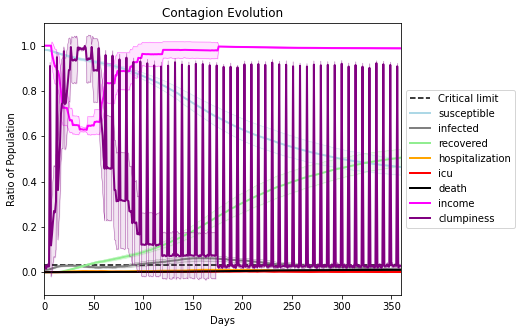

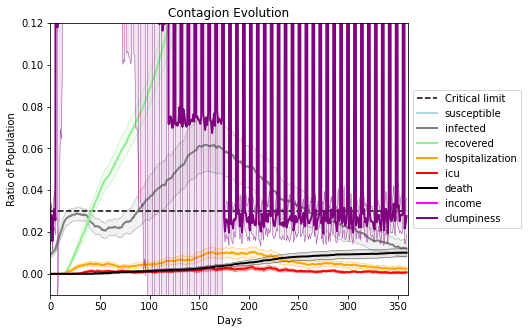

In [35]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.6
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3612, 8861, 9615, 2830, 498, 2639, 9847, 9795, 8901, 5383, 3361, 5098, 870, 9152, 7627, 8222, 6093, 2553, 9523, 5840]
Average similarity between family members is 0.2560698990977575 at temperature -0.5
Average similarity between family and home is 0.9998520855138021 at temperature -1
Average similarity between students and their classroom is 0.16422829264943584 at temperature -0.5
Average classroom occupancy is 4.140845070422535 and number classrooms is 71
Average similarity between workers is 0.16432637309578224 at temperature -0.5
Average office occupancy is 3.26 and number offices is 200
Average friend similarity for adults: 0.326720966612373 for kids: 0.2066493150444115
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuildin

avg restaurant similarity 0.13217784194922186
avg restaurant similarity 0.36539048918777933
avg restaurant similarity 0.020548839615322296
avg restaurant similarity 0.10519387231708624
avg restaurant similarity -0.045483323715114106
avg restaurant similarity 0.04890911090396462
avg restaurant similarity 0.26673722935771277
avg restaurant similarity 0.3292353496939767
avg restaurant similarity 0.30864637563445424
avg restaurant similarity 0.21655347317620047
avg restaurant similarity 0.1871031329255853
avg restaurant similarity 0.059489730376841736
avg restaurant similarity 0.12772251427471945
avg restaurant similarity 0.41277490149999607
avg restaurant similarity 0.0756960709779829
avg restaurant similarity 0.2751698030276339
avg restaurant similarity 0.0692701241326161
avg restaurant similarity 0.08478308113069949
avg restaurant similarity 0.1472826185533007
avg restaurant similarity 0.030721209444851034
avg restaurant similarity 0.15930896502960684
avg restaurant similarity 0.1688668

avg restaurant similarity 0.3729197885362663
avg restaurant similarity 0.052182401084848194
avg restaurant similarity 0.23758660767232614
avg restaurant similarity 0.337918989191992
avg restaurant similarity 0.24669212612330174
avg restaurant similarity 0.11217151152836484
avg restaurant similarity 0.23761061316668816
avg restaurant similarity 0.22463365880774094
avg restaurant similarity 0.013553577167067645
avg restaurant similarity 0.1422822866219895
avg restaurant similarity 0.035198672467461764
avg restaurant similarity 0.007964750947051062
avg restaurant similarity 0.10015548409340845
avg restaurant similarity 0.1240396287991225
avg restaurant similarity 0.10883556032359296
avg restaurant similarity 0.3255859647778328
avg restaurant similarity 0.04666027225281092
avg restaurant similarity 0.1569303633008225
avg restaurant similarity 0.05835742649014616
avg restaurant similarity 0.20090222394109164
avg restaurant similarity 0.37353565270796896
avg restaurant similarity -0.07714876

avg restaurant similarity 0.17450471621166966
avg restaurant similarity 0.08444327207955185
avg restaurant similarity 0.21037258543471515
avg restaurant similarity 0.11119055205299914
avg restaurant similarity 0.1871761253616269
avg restaurant similarity 0.09708819693371343
avg restaurant similarity 0.05518460484216691
avg restaurant similarity 0.004800819755242906
avg restaurant similarity -0.01369499962696108
avg restaurant similarity 0.09721397205740033
avg restaurant similarity 0.12003127726773227
avg restaurant similarity 0.038964942748682015
avg restaurant similarity 0.09199964512580032
avg restaurant similarity 0.08229443956014115
avg restaurant similarity 0.057603679099988585
avg restaurant similarity 0.2081635988550072
avg restaurant similarity 0.18347515898521077
avg restaurant similarity 0.3359175006253481
avg restaurant similarity 0.08040612568733531
avg restaurant similarity 0.04668377154993903
avg restaurant similarity 0.155801724246456
avg restaurant similarity 0.0841531

avg restaurant similarity -0.036751219514365205
avg restaurant similarity 0.2409032323443844
avg restaurant similarity 0.08536030520680041
avg restaurant similarity 0.11024103904187388
avg restaurant similarity 0.32886393436514855
avg restaurant similarity 0.021371981572179774
avg restaurant similarity 0.3840293990534016
avg restaurant similarity 0.12966078754983743
avg restaurant similarity 0.15299840962291913
avg restaurant similarity 0.21838235598509925
avg restaurant similarity 0.1481434228860211
avg restaurant similarity 0.14435637042028515
avg restaurant similarity 0.1766915016330035
avg restaurant similarity 0.28307147950103767
avg restaurant similarity 0.24705702480812666
avg restaurant similarity 0.20077987545595385
avg restaurant similarity -0.0036648236611016433
avg restaurant similarity 0.3055094507772306
avg restaurant similarity 0.08396312497142105
avg restaurant similarity 0.025949807747112023
avg restaurant similarity -0.038609051215577096
avg restaurant similarity -0.0

avg restaurant similarity 0.2002301464692411
avg restaurant similarity 0.13718433566163185
avg restaurant similarity 0.007228626483770997
avg restaurant similarity 0.18123363539487664
avg restaurant similarity 0.2837797590903295
avg restaurant similarity -0.007067740412360567
avg restaurant similarity 0.09636956018721164
avg restaurant similarity 0.1528746509208085
avg restaurant similarity -0.019746958049744162
avg restaurant similarity 0.094153934724943
avg restaurant similarity 0.10755814038842848
avg restaurant similarity -0.07977788127210772
avg restaurant similarity 0.1147417536488993
avg restaurant similarity -0.03199352912754587
avg restaurant similarity 0.25269314156742306
avg restaurant similarity 0.14972783456816538
avg restaurant similarity 4.5044584698838985e-05
avg restaurant similarity 0.15311789264225753
avg restaurant similarity 0.2600981055928529
avg restaurant similarity 0.035552551028458744
avg restaurant similarity 0.3009069010237428
avg restaurant similarity 0.067

avg restaurant similarity 0.20075566700587433
avg restaurant similarity 0.13001460304639978
avg restaurant similarity 0.04503936840642298
avg restaurant similarity 0.005847103416513292
avg restaurant similarity 0.27469463960880874
avg restaurant similarity -0.05231051567381236
avg restaurant similarity 0.09081087023048112
avg restaurant similarity 0.21459112609502298
avg restaurant similarity -0.12771039161572093
avg restaurant similarity 0.2683159104070954
avg restaurant similarity 0.2383339822639087
avg restaurant similarity 0.06148588587117867
avg restaurant similarity -0.08520381878064484
avg restaurant similarity 0.2140289272192913
avg restaurant similarity 0.07146772620115646
avg restaurant similarity 0.13626717495773147
avg restaurant similarity 0.06749180274338085
avg restaurant similarity 0.19258864039008253
avg restaurant similarity 0.17061528552291608
avg restaurant similarity 0.3392551305418933
avg restaurant similarity 0.14174540704762556
avg restaurant similarity 0.236280

avg restaurant similarity 0.15155182448944524
avg restaurant similarity 0.005127842527645484
avg restaurant similarity 0.2276938504148669
avg restaurant similarity 0.14302136046428154
avg restaurant similarity 0.01774263206944828
avg restaurant similarity 0.2984565384086249
avg restaurant similarity 0.15955309060070938
avg restaurant similarity 0.09232878125436104
avg restaurant similarity 0.059713635793089706
avg restaurant similarity 0.07448444993792466
avg restaurant similarity 0.3174547296796786
avg restaurant similarity 0.1263781811012554
avg restaurant similarity 0.10062009140221086
avg restaurant similarity 0.07991595050627777
avg restaurant similarity 0.25869155912196884
avg restaurant similarity 0.03283204328270604
avg restaurant similarity 0.08727680341095259
avg restaurant similarity 0.21540435196035737
avg restaurant similarity 0.012070483648825982
avg restaurant similarity 0.15074536255286303
avg restaurant similarity 0.11033970530627923
avg restaurant similarity 0.1272723

avg restaurant similarity -0.018234498014267707
avg restaurant similarity 0.11879667678068948
avg restaurant similarity 0.10088495888711518
avg restaurant similarity 0.24340156995897097
avg restaurant similarity 0.17740105939278494
avg restaurant similarity 0.17490769340033058
avg restaurant similarity 0.23776317085955223
avg restaurant similarity 0.20396112966841373
avg restaurant similarity 0.18984228364414724
avg restaurant similarity 0.20690123828652784
avg restaurant similarity 0.14556012096401869
avg restaurant similarity 0.07502877617032618
avg restaurant similarity 0.12104627502511589
avg restaurant similarity 0.17972201614714733
avg restaurant similarity 0.0495441751415533
avg restaurant similarity 0.15625197346462016
avg restaurant similarity 0.17373702403454364
avg restaurant similarity 0.013543365855522183
avg restaurant similarity 0.12724344578375918
avg restaurant similarity 0.11871285046714236
avg restaurant similarity 0.2942650452294685
avg restaurant similarity 0.18965

avg restaurant similarity 0.02041270695445689
avg restaurant similarity -0.1615215682304811
avg restaurant similarity 0.1426682755909094
avg restaurant similarity 0.20830922413286826
avg restaurant similarity 0.1540113730412402
avg restaurant similarity -0.03265153668508187
avg restaurant similarity 0.12884814591424193
avg restaurant similarity -0.04581292415535691
avg restaurant similarity 0.08389880214859961
avg restaurant similarity 0.04302098047720026
avg restaurant similarity -0.1524699965767258
avg restaurant similarity -0.021984703045742633
avg restaurant similarity -0.08817066968067563
avg restaurant similarity 0.403399228685316
avg restaurant similarity 0.1012347293620548
avg restaurant similarity 0.0007784845166547705
avg restaurant similarity 0.08259602322858219
avg restaurant similarity 0.04923669272125157
avg restaurant similarity -0.3183604401520882
avg restaurant similarity 0.047860736300487615
avg restaurant similarity 0.04974777120896707
avg restaurant similarity -0.08

avg restaurant similarity 0.12179559145194391
avg restaurant similarity -0.0853031003466961
avg restaurant similarity -0.01845194872053088
avg restaurant similarity -0.09828170260480794
avg restaurant similarity -0.18584898263536886
avg restaurant similarity 0.0839922577685257
avg restaurant similarity 0.048021210040526244
avg restaurant similarity -0.022967721112501404
avg restaurant similarity -0.10463711558561882
avg restaurant similarity 0.26438608310277495
avg restaurant similarity 0.04612580531985974
avg restaurant similarity 0.06233899339697007
avg restaurant similarity -0.05128350146615134
avg restaurant similarity -0.05298319656549201
avg restaurant similarity 0.10504354176666096
avg restaurant similarity 0.010636980971435797
avg restaurant similarity -0.11281370241025764
avg restaurant similarity -0.02319128816681118
avg restaurant similarity 0.13830988898279717
avg restaurant similarity 0.03155548760580827
avg restaurant similarity 0.09141049399163068
avg restaurant similari

avg restaurant similarity -0.10847281924405383
avg restaurant similarity 0.3657183372246831
avg restaurant similarity 0.13718651439093107
avg restaurant similarity 0.11092331007460063
avg restaurant similarity 0.23013199541738208
avg restaurant similarity 0.17995883818092842
avg restaurant similarity 0.13696609240152352
avg restaurant similarity 0.1480346124607867
avg restaurant similarity 0.2502121952024723
avg restaurant similarity 0.07308904444902103
avg restaurant similarity -0.0012673502722402611
avg restaurant similarity -0.23612305632422928
avg restaurant similarity 0.16052990179146753
avg restaurant similarity 0.31398912262430556
avg restaurant similarity -0.04345231227922751
avg restaurant similarity 0.16995363318054943
avg restaurant similarity 0.09182124331777299
avg restaurant similarity -0.10985940089414943
avg restaurant similarity 0.06593667275080499
avg restaurant similarity -0.09542040148079531
avg restaurant similarity 0.056768569233484854
avg restaurant similarity 0.

avg restaurant similarity 0.23426071859083955
avg restaurant similarity 0.14595905607891488
avg restaurant similarity 0.07129244735715114
avg restaurant similarity 0.06510038965154309
avg restaurant similarity 0.05195137620093305
avg restaurant similarity 0.3812356252828346
avg restaurant similarity 0.008501852367475185
avg restaurant similarity 0.10029269487654072
avg restaurant similarity 0.0021013397347686945
avg restaurant similarity 0.42308506642268245
avg restaurant similarity 0.007817347341538626
avg restaurant similarity 0.3840821942535101
avg restaurant similarity 0.16236625277005556
avg restaurant similarity 0.10086922790708659
avg restaurant similarity 0.09710555015980844
avg restaurant similarity 0.09989326772839717
avg restaurant similarity 0.2246281246735611
avg restaurant similarity 0.23347788726198793
avg restaurant similarity 0.13391064773142053
avg restaurant similarity 0.09910282474718396
avg restaurant similarity 0.3681348904802126
avg restaurant similarity 0.037453

avg restaurant similarity -0.22337588770520395
avg restaurant similarity 0.21079297739712038
avg restaurant similarity 0.3059687698234062
avg restaurant similarity 0.056366541191407576
avg restaurant similarity 0.12349978359824401
avg restaurant similarity 0.30198672417191297
avg restaurant similarity 0.06962965334560474
avg restaurant similarity 0.1693567032562444
avg restaurant similarity 0.2936609813657386
avg restaurant similarity 0.2484604043177705
avg restaurant similarity 0.1132396036590307
avg restaurant similarity 0.07853870242765894
avg restaurant similarity 0.1616121340389833
avg restaurant similarity 0.266832920836522
avg restaurant similarity -0.032650796938091364
avg restaurant similarity 0.2456798881493678
avg restaurant similarity 0.1961981523655412
avg restaurant similarity 0.17995383720395391
avg restaurant similarity 0.0780708511115439
avg restaurant similarity 0.2059506038741683
avg restaurant similarity 0.13024234347792424
avg restaurant similarity 0.12187236978608

avg restaurant similarity -0.04323093734687861
avg restaurant similarity 0.2358847454195108
avg restaurant similarity -0.03912594327592142
avg restaurant similarity 0.07794904144068193
avg restaurant similarity 0.18735572420501487
avg restaurant similarity 0.019611871733611744
avg restaurant similarity 0.17729935138672617
avg restaurant similarity 0.29537442362190186
avg restaurant similarity 0.13578237452336656
avg restaurant similarity 0.11435205873661553
avg restaurant similarity 0.19824065456539952
avg restaurant similarity -0.3367560833873356
avg restaurant similarity 0.17853952291539674
avg restaurant similarity 0.21834894795287804
avg restaurant similarity 0.005327797455589877
avg restaurant similarity 0.09798656744534168
avg restaurant similarity -0.03199111400603332
avg restaurant similarity 0.2919316481736976
avg restaurant similarity 0.0414832321975031
avg restaurant similarity 0.1906859267770833
avg restaurant similarity 0.12139478150339071
avg restaurant similarity 0.14349

avg restaurant similarity 0.12091991467167043
avg restaurant similarity 0.1130439289056101
avg restaurant similarity 0.12501011637746598
avg restaurant similarity 0.2468771539867957
avg restaurant similarity 0.02328491372982703
avg restaurant similarity 0.07812568704397348
avg restaurant similarity 0.44881795965742766
avg restaurant similarity -0.038961387771034806
avg restaurant similarity 0.11939852966858326
avg restaurant similarity 0.012740829902018021
avg restaurant similarity -0.1230858555119681
avg restaurant similarity 0.04640893398481903
avg restaurant similarity -0.1962588827127557
avg restaurant similarity -0.03408948252374919
avg restaurant similarity -0.06113829515524248
avg restaurant similarity 0.2346836435698517
avg restaurant similarity -0.07786415217642514
avg restaurant similarity -0.033509904712773764
avg restaurant similarity 0.060885186442643825
avg restaurant similarity 0.0013747230272723732
avg restaurant similarity 0.24135902555385458
avg restaurant similarity 

avg restaurant similarity 0.26116926938779067
avg restaurant similarity 0.13427289840221646
avg restaurant similarity 0.20933918276095517
avg restaurant similarity 0.16504184861778584
avg restaurant similarity 0.22582412751516998
avg restaurant similarity 0.1372667766667731
avg restaurant similarity 0.0920320261181689
avg restaurant similarity 0.33147115886206874
avg restaurant similarity 0.005922817060002717
avg restaurant similarity -0.06804403597320204
avg restaurant similarity -0.044603725526186744
avg restaurant similarity 0.20730461021102564
avg restaurant similarity 0.09898628288297101
avg restaurant similarity 0.2184269851003473
avg restaurant similarity 0.19305493055318163
avg restaurant similarity 0.05940477075990451
avg restaurant similarity 0.043742294241143446
avg restaurant similarity 0.23412869974842698
avg restaurant similarity 0.05847845214325848
avg restaurant similarity 0.10350052930156255
avg restaurant similarity 0.1535420463475992
avg restaurant similarity -0.0120

avg restaurant similarity 0.22112462024565738
avg restaurant similarity 0.3209388253214761
avg restaurant similarity 0.018920901458337566
avg restaurant similarity 0.13393289526192528
avg restaurant similarity 0.2898428890371507
avg restaurant similarity 0.23609261215736743
avg restaurant similarity 0.05315339478521292
avg restaurant similarity 0.05126463663865492
avg restaurant similarity -0.028170443914429244
avg restaurant similarity -0.09266344550685382
avg restaurant similarity 0.016738217055336912
avg restaurant similarity 0.13226560618172217
avg restaurant similarity 0.14730777980919807
avg restaurant similarity 0.13277393808530355
avg restaurant similarity -0.22509308113870052
avg restaurant similarity 0.035099090096880926
avg restaurant similarity 0.12084067587574483
avg restaurant similarity 0.1499948423808227
avg restaurant similarity 0.1318905512458995
avg restaurant similarity -0.024849849784593956
avg restaurant similarity -0.03153552304162288
avg restaurant similarity 0.

avg restaurant similarity 0.48813743748245075
avg restaurant similarity 0.12725432685839208
avg restaurant similarity 0.08845815519089531
avg restaurant similarity -0.25078013048527975
avg restaurant similarity 0.16896787510315106
avg restaurant similarity 0.09402334463329345
avg restaurant similarity 0.04223141079332092
avg restaurant similarity 0.12663611555933235
avg restaurant similarity 0.34818120869996116
avg restaurant similarity 0.14002992930024313
avg restaurant similarity 0.13291071191333662
avg restaurant similarity -0.06317381229756587
avg restaurant similarity 0.09031393191383737
avg restaurant similarity 0.18336069410342545
avg restaurant similarity -0.02777398542532611
avg restaurant similarity -0.004316863576152463
avg restaurant similarity 0.07744186357156302
avg restaurant similarity -0.21574081733215342
avg restaurant similarity 0.03486515848886525
avg restaurant similarity 0.17500997374774097
avg restaurant similarity 0.17426330761026818
avg restaurant similarity -0

avg restaurant similarity -0.1569036848213462
avg restaurant similarity -0.020794721355369434
avg restaurant similarity 0.08159499244732167
avg restaurant similarity 0.16203959994865552
avg restaurant similarity 0.13659212764508333
avg restaurant similarity 0.06602481905026542
avg restaurant similarity 0.038569744841222144
avg restaurant similarity 0.047412882369551164
avg restaurant similarity 0.04035192528999025
avg restaurant similarity 0.01447513206588713
avg restaurant similarity 0.05916209583295454
avg restaurant similarity -0.2947150964576918
avg restaurant similarity -0.12225012612272608
avg restaurant similarity -0.1797487451765554
avg restaurant similarity -0.1110424425517825
avg restaurant similarity 0.023489929557135032
avg restaurant similarity -0.026918389705545602
avg restaurant similarity 0.12395892439310637
avg restaurant similarity 0.06354872205764033
avg restaurant similarity -0.11922721915045394
avg restaurant similarity 0.04896786679381505
avg restaurant similarity

avg restaurant similarity 0.32003291471965906
avg restaurant similarity -0.054427343790777134
avg restaurant similarity 0.1313341951519619
avg restaurant similarity 0.022451688683652136
avg restaurant similarity 0.34399596421499845
avg restaurant similarity 0.16012600976544297
avg restaurant similarity 0.020748069874996528
avg restaurant similarity 0.17313510841891744
avg restaurant similarity 0.04990600065656489
avg restaurant similarity 0.26675676703325535
avg restaurant similarity -0.04037024343293885
avg restaurant similarity 0.26345591814077807
avg restaurant similarity 0.15037418004380834
avg restaurant similarity -0.0007186662245396991
avg restaurant similarity 0.16774351309088623
avg restaurant similarity -0.0017348246401202663
avg restaurant similarity 0.043182954643683436
avg restaurant similarity -0.01968095004401598
avg restaurant similarity 0.11758018065184211
avg restaurant similarity 0.01997334070608262
avg restaurant similarity 0.029611948535784874
avg restaurant simila

avg restaurant similarity 0.15606372491382964
avg restaurant similarity 0.1772677111122076
avg restaurant similarity 0.14045991901066615
avg restaurant similarity 0.2087391586645429
avg restaurant similarity -0.12045774618321119
avg restaurant similarity 0.32129777458068837
avg restaurant similarity -0.0020232322611129713
avg restaurant similarity 0.07523997865458247
avg restaurant similarity -0.07787315874298106
avg restaurant similarity 0.058837810184402366
avg restaurant similarity 0.12114900292884716
avg restaurant similarity 0.057921957730932866
avg restaurant similarity 0.1643887127963961
avg restaurant similarity 0.24002681308153315
avg restaurant similarity 0.19383460095710034
avg restaurant similarity 0.15060961004614648
avg restaurant similarity 0.16770834336728116
avg restaurant similarity 0.14604482760012322
avg restaurant similarity 0.09298818777326846
avg restaurant similarity 0.03133393740347592
avg restaurant similarity 0.2595642546461331
avg restaurant similarity 0.142

avg restaurant similarity -0.08376173031312634
avg restaurant similarity 0.23526521143624265
avg restaurant similarity 0.1868824394254908
avg restaurant similarity -0.05571233206065086
avg restaurant similarity 0.03737778039306289
avg restaurant similarity 0.2374553162062736
avg restaurant similarity 0.048567552832425115
avg restaurant similarity 0.01625032206365313
avg restaurant similarity 0.36217967562811637
avg restaurant similarity 0.2381998126533221
avg restaurant similarity 0.028876453571356306
avg restaurant similarity 0.12389260209403669
avg restaurant similarity -0.0024466356578443037
avg restaurant similarity -0.0970026146063509
avg restaurant similarity 0.13213031985134074
avg restaurant similarity 0.18476392076061338
avg restaurant similarity 0.12452387298336441
avg restaurant similarity -0.06191275602308943
avg restaurant similarity 0.23339560114520763
avg restaurant similarity 0.017295067834796965
avg restaurant similarity 0.10166773607436856
avg restaurant similarity 0.

avg restaurant similarity -0.02150148278491019
avg restaurant similarity -0.010525974206387961
avg restaurant similarity 0.16724479895432556
avg restaurant similarity 0.1642181085296735
avg restaurant similarity 0.11924255828220603
avg restaurant similarity 0.23100202574853143
avg restaurant similarity 0.5104453716180724
avg restaurant similarity -0.019200069073723906
avg restaurant similarity 0.1676219118531939
avg restaurant similarity 0.0988550984379102
avg restaurant similarity 0.12048193778288262
avg restaurant similarity -0.07799908448668104
avg restaurant similarity 0.1682890152907477
avg restaurant similarity 0.20295850792062503
avg restaurant similarity 0.011945184880511115
avg restaurant similarity -0.03560492317353698
avg restaurant similarity 0.08982008534981327
avg restaurant similarity 0.2420538012234181
avg restaurant similarity 0.030543915052442798
avg restaurant similarity -0.018706703474551205
avg restaurant similarity 0.14379173478453025
avg restaurant similarity 0.1

avg restaurant similarity 0.2898474334775189
avg restaurant similarity 0.21195172366259687
avg restaurant similarity 0.044289761855764706
avg restaurant similarity -0.08818961833073066
avg restaurant similarity 0.03733399030001493
avg restaurant similarity -0.00500612047067682
avg restaurant similarity 0.1299725451556101
avg restaurant similarity 0.1002260056252917
avg restaurant similarity -0.15827004149801038
avg restaurant similarity 0.11313957994397196
avg restaurant similarity 0.06342328567400575
avg restaurant similarity 0.17305059178225593
avg restaurant similarity 0.005145743889327224
avg restaurant similarity 0.010683116492746822
avg restaurant similarity 0.8262663242362147
avg restaurant similarity -0.034982698986515876
avg restaurant similarity -0.10936256062357828
avg restaurant similarity 0.18175929834274904
avg restaurant similarity 0.009869964802584771
avg restaurant similarity 0.12112893581506759
avg restaurant similarity -0.07534629102965838
avg restaurant similarity 0

avg restaurant similarity 0.024527767671398686
avg restaurant similarity 0.10630051740146747
avg restaurant similarity 0.28631226639034346
avg restaurant similarity 0.34186038709766686
avg restaurant similarity 0.0013761913557932613
avg restaurant similarity 0.1254768221644321
avg restaurant similarity 0.037048075227055166
avg restaurant similarity 0.09094656801614294
avg restaurant similarity 0.04326435763341654
avg restaurant similarity 0.25512320519536213
avg restaurant similarity 0.1799158561354519
avg restaurant similarity 0.0933277462861249
avg restaurant similarity 0.15134378448668492
avg restaurant similarity 0.09223692925301867
avg restaurant similarity 0.2073782949055493
avg restaurant similarity 0.07977611323115619
avg restaurant similarity -0.11134735475227593
avg restaurant similarity 0.121899710201741
avg restaurant similarity 0.05493575945866357
avg restaurant similarity 0.07396383910585237
avg restaurant similarity 0.020129847855140437
avg restaurant similarity 0.123029

avg restaurant similarity 0.12946671189187967
avg restaurant similarity 0.2342320673877767
avg restaurant similarity 0.10404323813120137
avg restaurant similarity 0.017521130123748282
avg restaurant similarity -0.1719701469586179
avg restaurant similarity 0.029567610618826512
avg restaurant similarity 0.01815108833746374
avg restaurant similarity 0.26537025541162546
avg restaurant similarity 0.25011641205670815
avg restaurant similarity 0.23403314511791165
avg restaurant similarity 0.069750777351705
avg restaurant similarity 0.10028650373434708
avg restaurant similarity 0.1184362144883316
avg restaurant similarity 0.4990429626152023
avg restaurant similarity 0.15265010030855955
avg restaurant similarity 0.14991076675431633
avg restaurant similarity 0.09502032092702188
avg restaurant similarity 0.12731047619402766
avg restaurant similarity -0.026378288952183377
avg restaurant similarity 0.10685566092539019
avg restaurant similarity 0.021569044714096958
avg restaurant similarity 0.165238

avg restaurant similarity -0.03673017422756364
avg restaurant similarity 0.012758178678367243
avg restaurant similarity 0.09092508184394987
avg restaurant similarity 0.06060547488374856
avg restaurant similarity 0.014823202605197348
avg restaurant similarity 0.13866225391434805
avg restaurant similarity -0.008558893313500179
avg restaurant similarity -0.06335598394054151
avg restaurant similarity -0.010580890875048108
avg restaurant similarity -0.1381293121650291
avg restaurant similarity -0.10129066954386336
avg restaurant similarity 0.09328859859681743
avg restaurant similarity 0.31581080580086945
avg restaurant similarity 0.18609149069984837
avg restaurant similarity 0.14391376415039736
avg restaurant similarity -0.04070463556748605
avg restaurant similarity 0.416522288263554
avg restaurant similarity 0.08074102000150687
avg restaurant similarity 0.028845118732798984
avg restaurant similarity -0.11554911947833056
avg restaurant similarity 0.05527629929678432
avg restaurant similarit

avg restaurant similarity 0.03659819815080358
avg restaurant similarity 0.18773756427217744
avg restaurant similarity -0.3151967181232216
avg restaurant similarity 0.25754126074432027
avg restaurant similarity -0.07483068532002833
avg restaurant similarity 0.002187750395551865
avg restaurant similarity 0.1681327796898203
avg restaurant similarity 0.0017072771651959146
avg restaurant similarity -0.10494265846689417
avg restaurant similarity 0.21351812284565003
avg restaurant similarity 0.11026158521210822
avg restaurant similarity 0.12941440024315273
avg restaurant similarity 0.03564646559330966
avg restaurant similarity 0.0825930876304008
avg restaurant similarity 0.03788583136698109
avg restaurant similarity 0.26115997907764327
avg restaurant similarity 0.113672747612642
avg restaurant similarity -0.18675086195834867
avg restaurant similarity 0.006285285130763939
avg restaurant similarity -0.0024212790871916898
avg restaurant similarity 0.08357474715851894
avg restaurant similarity 0.

avg restaurant similarity 0.135173847158947
avg restaurant similarity 0.294005436015386
avg restaurant similarity 0.3201316134324379
avg restaurant similarity -3.068900494242981e-05
avg restaurant similarity 0.15152315519202791
avg restaurant similarity -0.10383387364202257
avg restaurant similarity 0.13565241392667166
avg restaurant similarity 0.026332848692489357
avg restaurant similarity 0.06419214114736468
avg restaurant similarity 0.06987983631942281
avg restaurant similarity 0.2143869363323669
avg restaurant similarity 0.09875178726279678
avg restaurant similarity 0.06858340016445695
avg restaurant similarity 0.05912554788129861
avg restaurant similarity 0.201986888156445
avg restaurant similarity 0.08011114007018588
avg restaurant similarity -0.008571996650450765
avg restaurant similarity 0.05186063416279916
avg restaurant similarity -0.036457254233406386
avg restaurant similarity 0.23272080553118663
avg restaurant similarity 0.061072170500148404
avg restaurant similarity 0.2880

avg restaurant similarity 0.1747386517189717
avg restaurant similarity 0.038709849306500455
avg restaurant similarity 0.3681840952334949
avg restaurant similarity 0.08685574622706203
avg restaurant similarity -0.16047859554132166
avg restaurant similarity 0.12867975520318867
avg restaurant similarity 0.16507143599081028
avg restaurant similarity 0.23715561929184142
avg restaurant similarity 0.12518820011644963
avg restaurant similarity -0.07148774138392203
avg restaurant similarity 0.09207042886531971
avg restaurant similarity 0.255526608950681
avg restaurant similarity 0.10607227581470759
avg restaurant similarity 0.13968163065598366
avg restaurant similarity 0.1423585802001289
avg restaurant similarity 0.2529017748101403
avg restaurant similarity 0.1260175726053502
avg restaurant similarity 0.1971021039541738
avg restaurant similarity 0.09391710567857584
avg restaurant similarity 0.10191700296887082
avg restaurant similarity 0.012354612048413344
avg restaurant similarity -0.030703443

avg restaurant similarity 0.29539447399308655
avg restaurant similarity 0.17351185559819976
avg restaurant similarity 0.21466476755033784
avg restaurant similarity 0.13887203537093776
avg restaurant similarity -0.2904040837701786
avg restaurant similarity 0.14133015733383367
avg restaurant similarity 0.23998141627394615
avg restaurant similarity 0.02742929698246932
avg restaurant similarity 0.1682177513632701
avg restaurant similarity -0.09897723282207324
avg restaurant similarity -0.012397697588756465
avg restaurant similarity 0.07899141827575148
avg restaurant similarity 0.1790776673182724
avg restaurant similarity -0.009318216034500986
avg restaurant similarity 0.1472870342267566
avg restaurant similarity 0.15590884530186094
avg restaurant similarity 0.3322223297678974
avg restaurant similarity 0.052495250956004366
avg restaurant similarity 0.049908399931306344
avg restaurant similarity -0.016288627499487108
avg restaurant similarity 0.0870556613108784
avg restaurant similarity -0.0

avg restaurant similarity -0.04678817222361688
avg restaurant similarity -0.0716610059408206
avg restaurant similarity 0.1844110600250013
avg restaurant similarity 0.05188250602811955
avg restaurant similarity -0.16454581976392596
avg restaurant similarity -0.01758287481435234
avg restaurant similarity 0.1869458444857288
avg restaurant similarity 0.0516504772294609
avg restaurant similarity 0.16312280990289826
avg restaurant similarity -0.02769017638447673
avg restaurant similarity 0.3774773365301517
avg restaurant similarity 0.05184066802794693
avg restaurant similarity 0.07208904345183438
avg restaurant similarity 0.1442234858836463
avg restaurant similarity -0.1254153217581056
avg restaurant similarity -0.0384884274618415
avg restaurant similarity 0.2346381434728801
avg restaurant similarity 0.04404900014581251
avg restaurant similarity 0.03229344667897306
avg restaurant similarity 0.12472643956491888
avg restaurant similarity -0.3679942225929867
avg restaurant similarity -0.0482429

avg restaurant similarity -0.005017077994789315
avg restaurant similarity -0.0578145272591052
avg restaurant similarity 0.18982739365640156
avg restaurant similarity 0.03534345910694028
avg restaurant similarity -0.14540967379345288
avg restaurant similarity -0.006843899512516403
avg restaurant similarity -0.0580060788287719
avg restaurant similarity -0.1554095876272045
avg restaurant similarity -0.08031072366648168
avg restaurant similarity 0.20238377961750828
avg restaurant similarity 0.10951542024999518
avg restaurant similarity 0.11651396961866393
avg restaurant similarity 0.13049089544087025
avg restaurant similarity 0.09732744435892408
avg restaurant similarity 0.13138991873063743
avg restaurant similarity -0.0768799962126301
avg restaurant similarity 0.0145927257595052
avg restaurant similarity 0.2680639899996238
avg restaurant similarity 0.012878828557471822
avg restaurant similarity -0.05334676279291819
avg restaurant similarity -0.0016315665608756802
avg restaurant similarity

avg restaurant similarity 0.22550043004515058
avg restaurant similarity 0.16903666177563748
avg restaurant similarity 0.08171478103761418
avg restaurant similarity 0.28853387900113775
avg restaurant similarity -0.07510109197675402
avg restaurant similarity 0.21162875069384324
avg restaurant similarity 0.098558372425724
avg restaurant similarity 0.10496402926473303
avg restaurant similarity 0.15089017675316768
avg restaurant similarity -0.05983938701271911
avg restaurant similarity 0.045677319281483865
avg restaurant similarity 0.1853994024516276
avg restaurant similarity 0.2573078228555295
avg restaurant similarity -0.11202802160890106
avg restaurant similarity 0.06384464568115317
avg restaurant similarity 0.2928613736013729
avg restaurant similarity 0.003841997673905015
avg restaurant similarity -0.22702091091890592
avg restaurant similarity 0.15525153214844092
avg restaurant similarity 0.03342665814767294
avg restaurant similarity 0.07956522075507898
avg restaurant similarity 0.02370

avg restaurant similarity 0.3066323783412813
avg restaurant similarity -0.15931566421514212
avg restaurant similarity 0.11563706103320748
avg restaurant similarity 0.14375114726430804
avg restaurant similarity 0.32233783636057317
avg restaurant similarity 0.08171462537368132
avg restaurant similarity 0.16431312388120725
avg restaurant similarity 0.13149016749888173
avg restaurant similarity 0.11375174154724689
avg restaurant similarity -0.05966556188140766
avg restaurant similarity 0.22755413271033353
avg restaurant similarity 0.1237084266655936
avg restaurant similarity 0.09240498251971903
avg restaurant similarity 0.0809814632156315
avg restaurant similarity -0.03315708947293111
avg restaurant similarity -0.19486411226981667
avg restaurant similarity 0.14431430023481415
avg restaurant similarity 0.051473674438782036
avg restaurant similarity -0.05056354614906094
avg restaurant similarity 0.09015752714534266
avg restaurant similarity 0.254223060878376
avg restaurant similarity 0.16738

avg restaurant similarity 0.21399418203381013
avg restaurant similarity -0.0025574093242047807
avg restaurant similarity -0.05122828978519708
avg restaurant similarity 0.02059348653945186
avg restaurant similarity 0.14077085136174938
avg restaurant similarity 0.10653090130991663
avg restaurant similarity 0.07572623321138172
avg restaurant similarity 0.19632562129872785
avg restaurant similarity 0.12865988856497432
avg restaurant similarity -0.04413693790330213
avg restaurant similarity -0.04353423444139769
avg restaurant similarity 0.1084277088960662
avg restaurant similarity 0.2041948442831873
avg restaurant similarity 0.0012826743597465912
avg restaurant similarity 0.05894514039350259
avg restaurant similarity 0.19298781903742493
avg restaurant similarity 0.22799052942684309
avg restaurant similarity 0.3100527071896541
avg restaurant similarity 0.06286189889727983
avg restaurant similarity 0.1684867141410129
avg restaurant similarity 0.13899093387333208
avg restaurant similarity 0.07

avg restaurant similarity 0.10267370398430485
avg restaurant similarity 0.07028418245215079
avg restaurant similarity 0.2891851961751304
avg restaurant similarity 0.17665490652309473
avg restaurant similarity 0.12201184257563838
avg restaurant similarity 0.22286604025212456
avg restaurant similarity 0.010236579965469561
avg restaurant similarity 0.36477010229610857
avg restaurant similarity 0.08685295573775331
avg restaurant similarity 0.15005521093369836
avg restaurant similarity 0.012601863979371583
avg restaurant similarity 0.04172789341404835
avg restaurant similarity 0.02855413177194191
avg restaurant similarity -0.046402572608144996
avg restaurant similarity 0.14422171968936884
avg restaurant similarity 0.04840107382506206
avg restaurant similarity 0.2702266466594261
avg restaurant similarity 0.18352810401720704
avg restaurant similarity 0.5540196760533587
avg restaurant similarity 0.11655276524087639
avg restaurant similarity 0.10424313131716642
avg restaurant similarity 0.19759

avg restaurant similarity 0.14180581473078335
avg restaurant similarity -0.09023562439775362
avg restaurant similarity 0.0732464769339668
avg restaurant similarity 0.1359014105672351
avg restaurant similarity 0.05153281170641109
avg restaurant similarity 0.18868517177982957
avg restaurant similarity 0.3590850741663202
avg restaurant similarity 0.5402437338574377
avg restaurant similarity 0.3405107965490923
avg restaurant similarity 0.07039749600460306
avg restaurant similarity -0.031415725934005934
avg restaurant similarity -0.0062167997339104275
avg restaurant similarity 0.33161529400158946
avg restaurant similarity 0.08257614106145783
avg restaurant similarity 0.2301709276671423
avg restaurant similarity 0.06230101571495054
avg restaurant similarity 0.17024436430632278
avg restaurant similarity 0.026800978382537356
avg restaurant similarity 0.17160527219715513
avg restaurant similarity 0.23831998157663553
avg restaurant similarity 0.025717269139583793
avg restaurant similarity 0.0633

avg restaurant similarity 0.2710688919931103
avg restaurant similarity 0.018668098455910276
avg restaurant similarity 0.1675935329373092
avg restaurant similarity -0.028949174973230143
avg restaurant similarity 0.1062969516111816
avg restaurant similarity -0.11345885445432954
avg restaurant similarity -0.024302552560373124
avg restaurant similarity 0.0378173354845779
avg restaurant similarity 0.010081457326938142
avg restaurant similarity -0.02489737771313944
avg restaurant similarity 0.14255720714171988
avg restaurant similarity 0.047524519823047645
avg restaurant similarity 0.11863380272857373
avg restaurant similarity 0.1908661353117756
avg restaurant similarity 0.10012088694702669
avg restaurant similarity -0.06162889434396578
avg restaurant similarity 0.14642311839333993
avg restaurant similarity 0.09413044380409051
avg restaurant similarity -0.03379325630557819
avg restaurant similarity -0.06208300171729246
avg restaurant similarity -0.11190688307767446
avg restaurant similarity 

avg restaurant similarity 0.13124172795340652
avg restaurant similarity 0.029450371531294
avg restaurant similarity 0.3801433201869654
avg restaurant similarity 0.10963615334188083
avg restaurant similarity -0.017087143064469353
avg restaurant similarity 0.08944887742891232
avg restaurant similarity -0.07525300648150182
avg restaurant similarity 0.06725023172123283
avg restaurant similarity 0.3586789018914497
avg restaurant similarity 0.03956504266918453
avg restaurant similarity -0.022055726762840542
avg restaurant similarity 0.031492485083693324
avg restaurant similarity 0.10497901791928044
avg restaurant similarity -0.07252657135014101
avg restaurant similarity 0.010845114576524923
avg restaurant similarity 0.4294525770244858
avg restaurant similarity 0.17638658924722705
avg restaurant similarity 0.0988515819175846
avg restaurant similarity -0.24590659030424278
avg restaurant similarity 0.2381688314334548
avg restaurant similarity 0.034362214314488625
avg restaurant similarity 0.209

(<function dict.items>, <function dict.items>, <function dict.items>)

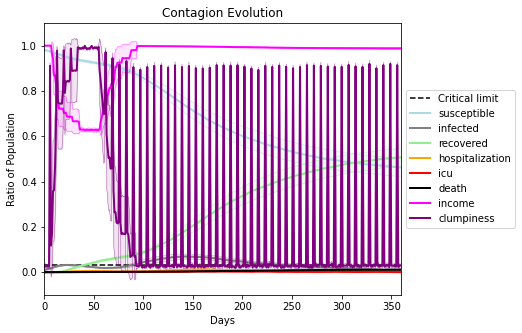

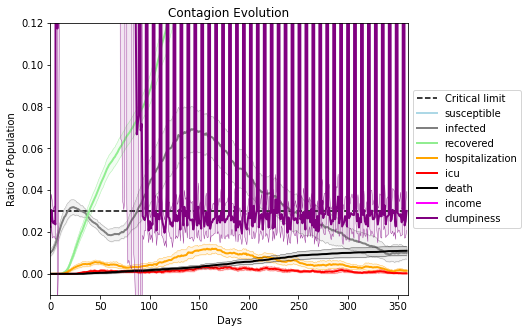

In [36]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.5
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6575, 2011, 7761, 1807, 7920, 1773, 3985, 7387, 4836, 5604, 2026, 5706, 8322, 7884, 7300, 3000, 3927, 4626, 6687, 4663]
Average similarity between family members is 0.21631036408550786 at temperature -0.4
Average similarity between family and home is 0.9998514004647767 at temperature -1
Average similarity between students and their classroom is 0.14400271428144762 at temperature -0.4
Average classroom occupancy is 4.171428571428572 and number classrooms is 70
Average similarity between workers is 0.14927245417988466 at temperature -0.4
Average office occupancy is 3.2487804878048783 and number offices is 205
Average friend similarity for adults: 0.27951124849250425 for kids: 0.18365074013643434
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.004932169563450006
avg restaurant similarity -0.059446159885709816
avg restaurant similarity 0.08403278244517574
avg restaurant similarity -0.03659546953637144
avg restaurant similarity 0.1271935573158885
avg restaurant similarity 0.06635618982276906
avg restaurant similarity 0.25820803084782706
avg restaurant similarity 0.06237435310219226
avg restaurant similarity 0.015842542822948287
avg restaurant similarity 0.10201024171254168
avg restaurant similarity 0.020919846463438085
avg restaurant similarity 0.06305229368925072
avg restaurant similarity 0.12194012499517536
avg restaurant similarity -0.145407111810889
avg restaurant similarity 0.1132621906055012
avg restaurant similarity 0.0807170070408701
avg restaurant similarity 0.20347621239921285
avg restaurant similarity 0.029268307076301178
avg restaurant similarity 0.19830194389324005
avg restaurant similarity 0.04592946354333549
avg restaurant similarity 0.15697206099188157
avg restaurant similarity 0.244

avg restaurant similarity 0.06995863793333691
avg restaurant similarity 0.18639543603123643
avg restaurant similarity 0.03737677972087683
avg restaurant similarity 0.23560927218877534
avg restaurant similarity 0.2076071727044574
avg restaurant similarity 0.028870555454079672
avg restaurant similarity -0.06491819736902446
avg restaurant similarity 0.023414242186614836
avg restaurant similarity 0.14538338598745723
avg restaurant similarity -0.054156994287758095
avg restaurant similarity 0.041945019395616075
avg restaurant similarity 0.20210844921545276
avg restaurant similarity 0.009624866951828959
avg restaurant similarity 0.3866535268204231
avg restaurant similarity 0.23559528025814852
avg restaurant similarity 0.017663092183650125
avg restaurant similarity 0.03576192236325106
avg restaurant similarity 0.10044673448559954
avg restaurant similarity 0.3364905248767638
avg restaurant similarity 0.05689706787309387
avg restaurant similarity 0.0335778645972526
avg restaurant similarity 0.15

avg restaurant similarity 0.23333730823943538
avg restaurant similarity 0.129845214162662
avg restaurant similarity 0.13500294171735375
avg restaurant similarity 0.150112501746906
avg restaurant similarity -0.011672988915552018
avg restaurant similarity 0.3300194814329908
avg restaurant similarity -0.039639262303402194
avg restaurant similarity 0.19411705088196735
avg restaurant similarity 0.17552655656958244
avg restaurant similarity 0.04077860988833972
avg restaurant similarity 0.14882502150999477
avg restaurant similarity 0.06923530633649255
avg restaurant similarity -0.017825986689425408
avg restaurant similarity 0.05653719025224202
avg restaurant similarity 0.20520416709435155
avg restaurant similarity 0.2825207310620961
avg restaurant similarity 0.1063245600873063
avg restaurant similarity 0.18959014294262488
avg restaurant similarity 0.19516646805654964
avg restaurant similarity 0.11802555443790486
avg restaurant similarity 0.16271879270902745
avg restaurant similarity -0.043333

avg restaurant similarity 0.2315737424768176
avg restaurant similarity 0.050985352288100215
avg restaurant similarity 0.0441015574214493
avg restaurant similarity 0.06984548948543781
avg restaurant similarity 0.2639883114391669
avg restaurant similarity 0.21075676556444645
avg restaurant similarity 0.1727519276491478
avg restaurant similarity 0.14930650475218293
avg restaurant similarity 0.2186344332395314
avg restaurant similarity 0.3459268226969099
avg restaurant similarity 0.05546603783391154
avg restaurant similarity 0.20464339508485052
avg restaurant similarity -0.03478114119517718
avg restaurant similarity -0.004617868398177175
avg restaurant similarity 0.07371216377335996
avg restaurant similarity -0.003984762139977618
avg restaurant similarity 0.0896557051939999
avg restaurant similarity 0.25456063598261014
avg restaurant similarity 0.22769117368692246
avg restaurant similarity 0.26936684218951473
avg restaurant similarity 0.20071979997862308
avg restaurant similarity 0.0469601

avg restaurant similarity -0.0016489413119705199
avg restaurant similarity 0.05222815157418809
avg restaurant similarity 0.015119125266942823
avg restaurant similarity 0.20559091936034213
avg restaurant similarity 0.032744840488376455
avg restaurant similarity -0.14654582791141776
avg restaurant similarity -0.0009864779846556254
avg restaurant similarity -0.004436441056882487
avg restaurant similarity -0.0190107877490786
avg restaurant similarity -0.031005331930828228
avg restaurant similarity -0.04320099117170811
avg restaurant similarity 0.16874018011804823
avg restaurant similarity -0.014453939345758308
avg restaurant similarity 0.1767201676294502
avg restaurant similarity 0.0002529518084444312
avg restaurant similarity 0.07473759220650102
avg restaurant similarity 0.043705893517177956
avg restaurant similarity 0.3418195409555552
avg restaurant similarity 0.151101809346953
avg restaurant similarity 0.05162669346643341
avg restaurant similarity 0.12290852459024099
avg restaurant simi

avg restaurant similarity 0.02403265736676244
avg restaurant similarity -0.23210258154619928
avg restaurant similarity 0.06368055837004123
avg restaurant similarity 0.15669222365925745
avg restaurant similarity 0.08567231952638776
avg restaurant similarity -0.028574353403811925
avg restaurant similarity 0.07244107154870956
avg restaurant similarity 0.13770913573307883
avg restaurant similarity 0.1726667030240836
avg restaurant similarity 0.07051242670131179
avg restaurant similarity 0.29801293413181434
avg restaurant similarity 0.010649519770023104
avg restaurant similarity -0.3396030105377934
avg restaurant similarity -0.13407294193902705
avg restaurant similarity -0.15619608170140764
avg restaurant similarity 0.21586539955193979
avg restaurant similarity 0.15497422447693276
avg restaurant similarity 0.13135698115127878
avg restaurant similarity 0.13869099037563437
avg restaurant similarity 0.17153401474595786
avg restaurant similarity 0.040572771648990105
avg restaurant similarity 0.

avg restaurant similarity 0.1369958660650659
avg restaurant similarity 0.09299360579151703
avg restaurant similarity 0.029293568257069094
avg restaurant similarity 0.40723432480093874
avg restaurant similarity 0.12173372956354815
avg restaurant similarity -0.04033802289698646
avg restaurant similarity 0.12145005549748217
avg restaurant similarity 0.09353169464051109
avg restaurant similarity 0.06359823408733843
avg restaurant similarity -0.0649254154056184
avg restaurant similarity 0.1449384385219508
avg restaurant similarity -0.02068680217826339
avg restaurant similarity -0.17653637761069993
avg restaurant similarity 0.09981545883558697
avg restaurant similarity 0.08178221476407257
avg restaurant similarity -0.013724434742976549
avg restaurant similarity 0.012825839404512271
avg restaurant similarity 0.14423333210409447
avg restaurant similarity 0.03450536472485396
avg restaurant similarity -0.11363415766983549
avg restaurant similarity 0.446118046057607
avg restaurant similarity 0.17

avg restaurant similarity -0.09610433844420557
avg restaurant similarity -0.08541600614803958
avg restaurant similarity -0.1769767264444462
avg restaurant similarity 0.09527674026815246
avg restaurant similarity 0.004311262051358122
avg restaurant similarity 0.10516033326063258
avg restaurant similarity 0.02316664149960556
avg restaurant similarity -0.18291603694914593
avg restaurant similarity 0.1813438061612891
avg restaurant similarity 0.31354883032145325
avg restaurant similarity 0.31758281667584415
avg restaurant similarity 0.06152107007331649
avg restaurant similarity 0.018696879391059025
avg restaurant similarity 0.180557118735744
avg restaurant similarity 0.2287472344930075
avg restaurant similarity -0.004052540272708028
avg restaurant similarity 0.25016960200749583
avg restaurant similarity 0.010670259794280304
avg restaurant similarity 0.06696150248266694
avg restaurant similarity 0.13993668172395457
avg restaurant similarity 0.06712409221364679
avg restaurant similarity 0.02

avg restaurant similarity 0.1832682374326825
avg restaurant similarity 0.09751072589490185
avg restaurant similarity 0.301799731089739
avg restaurant similarity -0.11483268094388545
avg restaurant similarity 0.29729878892505024
avg restaurant similarity 0.19267313080232173
avg restaurant similarity -0.021916325231385897
avg restaurant similarity 0.20540766394248197
avg restaurant similarity 0.10043546378533567
avg restaurant similarity 0.21970381921138554
avg restaurant similarity 0.0760829749754028
avg restaurant similarity 0.08076677053033955
avg restaurant similarity 0.05829172352730393
avg restaurant similarity -0.03911139578091355
avg restaurant similarity 0.3096317399763415
avg restaurant similarity 0.0006981807173890887
avg restaurant similarity -0.16233110888497074
avg restaurant similarity -0.06569505891687936
avg restaurant similarity 0.02305038968802117
avg restaurant similarity 0.08714493596465608
avg restaurant similarity 0.17042296342582308
avg restaurant similarity -0.31

avg restaurant similarity -0.03927848915009816
avg restaurant similarity 0.038617750033637356
avg restaurant similarity 0.19767595031207816
avg restaurant similarity -0.14822185558535192
avg restaurant similarity -0.27615754995915903
avg restaurant similarity 0.2061942667623237
avg restaurant similarity 0.1397456480664483
avg restaurant similarity 0.039525785324803116
avg restaurant similarity -0.2976161282679762
avg restaurant similarity 0.20088344956209106
avg restaurant similarity 0.11146636029450109
avg restaurant similarity 0.09435321899709774
avg restaurant similarity 0.29468379019022845
avg restaurant similarity 0.10619783642590276
avg restaurant similarity 0.1756595245496562
avg restaurant similarity 0.012771753665955156
avg restaurant similarity 0.08174657484311601
avg restaurant similarity -0.04101441310297571
avg restaurant similarity -0.054211271434163356
avg restaurant similarity -0.13886568208727196
avg restaurant similarity 0.2648799683452566
avg restaurant similarity -0

avg restaurant similarity -0.001678764301572864
avg restaurant similarity 0.10270852355244435
avg restaurant similarity -0.02368857786670466
avg restaurant similarity 0.13292700663579318
avg restaurant similarity -0.10824374159020937
avg restaurant similarity 0.09404146318923316
avg restaurant similarity 0.06914392984835936
avg restaurant similarity 0.19119821841606144
avg restaurant similarity 0.10497037215892513
avg restaurant similarity 0.14763479027705165
avg restaurant similarity 0.09537346500237621
avg restaurant similarity 0.4315606361047095
avg restaurant similarity 0.32934758966032496
avg restaurant similarity 0.14799237781016492
avg restaurant similarity -0.026694723266565006
avg restaurant similarity 0.19618364186095744
avg restaurant similarity 0.21351999536233465
avg restaurant similarity -0.03398649381943832
avg restaurant similarity 0.06309127993459429
avg restaurant similarity 0.08530160997524462
avg restaurant similarity 0.06566764125797558
avg restaurant similarity 0.

avg restaurant similarity 0.10913743069495695
avg restaurant similarity 0.3456794917662581
avg restaurant similarity 0.4570558251742194
avg restaurant similarity 0.3369325440792152
avg restaurant similarity -0.11135248775906552
avg restaurant similarity 0.11989162678232695
avg restaurant similarity 0.07397435543426395
avg restaurant similarity 0.4550092095639082
avg restaurant similarity 0.24146432371084536
avg restaurant similarity 0.21967173095465248
avg restaurant similarity 0.14617729374632782
avg restaurant similarity 0.398409350887506
avg restaurant similarity -0.13625364208595295
avg restaurant similarity 0.24525458048896318
avg restaurant similarity 0.09307410018881153
avg restaurant similarity -0.05746435678537457
avg restaurant similarity 0.2496400738712723
avg restaurant similarity -0.01893565252249676
avg restaurant similarity 0.521368705511321
avg restaurant similarity 0.4081874744098284
avg restaurant similarity 0.10780451398490595
avg restaurant similarity -0.02328495403

avg restaurant similarity -0.021476297388886522
avg restaurant similarity 0.11739712390205535
avg restaurant similarity -0.06906530851913587
avg restaurant similarity 0.11909732113272359
avg restaurant similarity 0.015325166440755556
avg restaurant similarity 0.2302440931582653
avg restaurant similarity -0.055333465047449314
avg restaurant similarity 0.19981706430450216
avg restaurant similarity -0.01471889266185733
avg restaurant similarity 0.1225261370061081
avg restaurant similarity 0.28774888200892196
avg restaurant similarity 0.08790169504359806
avg restaurant similarity 0.212845431267536
avg restaurant similarity 0.16257177432859957
avg restaurant similarity 0.05696251812651157
avg restaurant similarity 0.14227130418591513
avg restaurant similarity 0.10674429268541669
avg restaurant similarity -0.11915129765086141
avg restaurant similarity 0.25160669620925297
avg restaurant similarity 0.047533404518017575
avg restaurant similarity 0.33574856167547706
avg restaurant similarity 0.1

avg restaurant similarity 0.11753517462338613
avg restaurant similarity 0.06299371007949121
avg restaurant similarity -0.026424700141580874
avg restaurant similarity 0.1950458252818113
avg restaurant similarity 0.12254501403970079
avg restaurant similarity 0.001463819655484855
avg restaurant similarity 0.22519558396197653
avg restaurant similarity 0.32615721070769355
avg restaurant similarity 0.1561480855556444
avg restaurant similarity 0.25091104457169966
avg restaurant similarity 0.17302349601891204
avg restaurant similarity 0.22246898354368916
avg restaurant similarity 0.2817542490783875
avg restaurant similarity 0.311178121360008
avg restaurant similarity 0.09725170185988424
avg restaurant similarity 0.07161601948418546
avg restaurant similarity 0.28077836619485663
avg restaurant similarity 0.1849305103484417
avg restaurant similarity -0.20802366835513914
avg restaurant similarity 0.1464632374807965
avg restaurant similarity -0.04787965358920358
avg restaurant similarity -0.0510884

avg restaurant similarity 0.1171760989083767
avg restaurant similarity 0.18120070121426632
avg restaurant similarity 0.19616574180496793
avg restaurant similarity 0.09120542945939834
avg restaurant similarity 0.23254101692230825
avg restaurant similarity -0.22878443384377634
avg restaurant similarity 0.027270978045484347
avg restaurant similarity 0.343002688010075
avg restaurant similarity 0.22275374531739708
avg restaurant similarity 0.04803448409819483
avg restaurant similarity 0.20490948401054399
avg restaurant similarity 0.07821223784662762
avg restaurant similarity 0.3014392097859736
avg restaurant similarity 0.01227472565035503
avg restaurant similarity 0.08222838537990534
avg restaurant similarity 0.07720811289978623
avg restaurant similarity -0.15423895498329085
avg restaurant similarity 0.151923277052404
avg restaurant similarity 0.016259316943392384
avg restaurant similarity 0.017898927412629387
avg restaurant similarity 0.2507806707354323
avg restaurant similarity 0.09766758

avg restaurant similarity 0.027612843534352373
avg restaurant similarity -0.08221388080950186
avg restaurant similarity 0.16002877441542257
avg restaurant similarity 0.05713591321418116
avg restaurant similarity 0.11824924092123741
avg restaurant similarity 0.17173626144004345
avg restaurant similarity 0.13739597620190372
avg restaurant similarity -0.03196438578156336
avg restaurant similarity 0.12851499365072847
avg restaurant similarity 0.12245064976286904
avg restaurant similarity 0.26195880578422936
avg restaurant similarity 0.14195261314294527
avg restaurant similarity -0.012325403186562642
avg restaurant similarity 0.23270519416926008
avg restaurant similarity 0.027072364444865438
avg restaurant similarity 0.18704578782132286
avg restaurant similarity 0.09201218745783915
avg restaurant similarity 0.2405554571959076
avg restaurant similarity 0.16017784759305365
avg restaurant similarity 0.11222908623631711
avg restaurant similarity 0.05574463308422005
avg restaurant similarity -0.

avg restaurant similarity -0.018785222221608843
avg restaurant similarity 0.11655065937211782
avg restaurant similarity 0.061344641215767444
avg restaurant similarity 0.0797412713322369
avg restaurant similarity 0.12692811598440454
avg restaurant similarity 0.05741104806432493
avg restaurant similarity 0.04990117921456297
avg restaurant similarity 0.1780428047039672
avg restaurant similarity 0.028624259583216474
avg restaurant similarity -0.12591143115995068
avg restaurant similarity 0.09652877132374528
avg restaurant similarity -0.08411453130920135
avg restaurant similarity 0.3153325086977746
avg restaurant similarity 0.04261422272444863
avg restaurant similarity -0.03047631980386007
avg restaurant similarity 0.2809044590649711
avg restaurant similarity -0.05838764969423997
avg restaurant similarity 0.18005555401308188
avg restaurant similarity 0.2940328954091896
avg restaurant similarity 0.11617219406699747
avg restaurant similarity 0.03326296863735363
avg restaurant similarity -0.05

avg restaurant similarity -0.03620748239242346
avg restaurant similarity -0.029579338725173376
avg restaurant similarity 0.09055510695180877
avg restaurant similarity 0.09614472244843124
avg restaurant similarity 0.02925248811362484
avg restaurant similarity 0.18033088306573183
avg restaurant similarity 0.05414976753400168
avg restaurant similarity 0.041317452749569314
avg restaurant similarity -0.11097287823408289
avg restaurant similarity 0.11597483158468427
avg restaurant similarity 0.10467621930384453
avg restaurant similarity -0.2134956702578805
avg restaurant similarity 0.2221946234987009
avg restaurant similarity 0.30810316777620894
avg restaurant similarity 0.1785659085982849
avg restaurant similarity 0.1431245221766346
avg restaurant similarity 0.12702218024188658
avg restaurant similarity 0.1716380809399353
avg restaurant similarity 0.1813735490746339
avg restaurant similarity -0.11370441914028151
avg restaurant similarity 0.15919361836605644
avg restaurant similarity 0.19070

avg restaurant similarity -0.18387770371173606
avg restaurant similarity 0.2487610549696777
avg restaurant similarity 0.2464191190764674
avg restaurant similarity 0.05604568745567794
avg restaurant similarity 0.043104753001585276
avg restaurant similarity 0.06080448252718994
avg restaurant similarity 0.04085650588453303
avg restaurant similarity -0.08022530783584199
avg restaurant similarity 0.11051242132257995
avg restaurant similarity 0.09522261449036337
avg restaurant similarity 0.12552767602882198
avg restaurant similarity 0.024831814185202687
avg restaurant similarity 0.02430866844205658
avg restaurant similarity 0.013555100075152787
avg restaurant similarity 0.07580148920977844
avg restaurant similarity -0.07924461255507113
avg restaurant similarity 0.007864813523167924
avg restaurant similarity 0.24951213405345785
avg restaurant similarity -0.005992431018464379
avg restaurant similarity 0.004684425663405427
avg restaurant similarity 0.0918531498094793
avg restaurant similarity -

avg restaurant similarity 0.05351195462345879
avg restaurant similarity 0.06599546667838677
avg restaurant similarity 0.1096582751724009
avg restaurant similarity 0.010150585320794655
avg restaurant similarity -0.06916741924296055
avg restaurant similarity 0.1720870257790276
avg restaurant similarity 0.033801016268085876
avg restaurant similarity -0.19703788175861836
avg restaurant similarity 0.18356293744324856
avg restaurant similarity 0.05136374022550181
avg restaurant similarity -0.08424435064699144
avg restaurant similarity -0.029942840575357805
avg restaurant similarity -0.19598023324432706
avg restaurant similarity 0.12908628365811214
avg restaurant similarity 0.04414882198686293
avg restaurant similarity 0.07204886590844499
avg restaurant similarity 0.03968919668829296
avg restaurant similarity 0.12947712705071926
avg restaurant similarity 0.027159664936781833
avg restaurant similarity 0.04411744619048899
avg restaurant similarity 0.09412827483375605
avg restaurant similarity 0

avg restaurant similarity 0.1070433145980158
avg restaurant similarity 0.07174872084953277
avg restaurant similarity 0.13827914898958762
avg restaurant similarity 0.05177947235803567
avg restaurant similarity -0.06708460758386935
avg restaurant similarity 0.11216992817139032
avg restaurant similarity 0.07031726363620942
avg restaurant similarity 0.1704654583860922
avg restaurant similarity -0.05068352866064881
avg restaurant similarity -0.1035433097625065
avg restaurant similarity -0.031346998716589095
avg restaurant similarity -0.02104605931578945
avg restaurant similarity 0.06151552232310798
avg restaurant similarity 0.05302493633922587
avg restaurant similarity 0.08182076311542759
avg restaurant similarity 0.14183164126929323
avg restaurant similarity -0.18142182837422355
avg restaurant similarity 0.08185082381441314
avg restaurant similarity -0.039075060972027
avg restaurant similarity -0.030216955771494053
avg restaurant similarity 0.27898516781070926
avg restaurant similarity 0.0

avg restaurant similarity 0.05816947203893542
avg restaurant similarity -0.024554663511612288
avg restaurant similarity 0.01654361852954396
avg restaurant similarity 0.03234357835966824
avg restaurant similarity -0.07511332723631389
avg restaurant similarity 0.09274159856201836
avg restaurant similarity -0.03548688101489621
avg restaurant similarity 0.10326397782907919
avg restaurant similarity 0.1709810003719377
avg restaurant similarity 0.007988585930784026
avg restaurant similarity 0.03532609050556677
avg restaurant similarity 0.26795217504505486
avg restaurant similarity 0.02309531228829619
avg restaurant similarity 0.08306094123846898
avg restaurant similarity 0.05787086535364856
avg restaurant similarity 0.3312927564781421
avg restaurant similarity -0.09271251878946053
avg restaurant similarity -0.06057444096158808
avg restaurant similarity 0.06495898441514747
avg restaurant similarity -0.01675851702307893
avg restaurant similarity 0.1876009080303067
avg restaurant similarity -0.

avg restaurant similarity -0.021826691604178026
avg restaurant similarity 0.33049948669449103
avg restaurant similarity 0.29512562982572005
avg restaurant similarity 0.09510319138977441
avg restaurant similarity 0.17259836027922182
avg restaurant similarity 0.13514042785054722
avg restaurant similarity 0.13775342781459524
avg restaurant similarity 0.15276221126533882
avg restaurant similarity 0.09763146160805566
avg restaurant similarity 0.38212875944653385
avg restaurant similarity -0.38566050638024274
avg restaurant similarity 0.15618087412281784
avg restaurant similarity -0.014902020630889716
avg restaurant similarity 0.022314536822115205
avg restaurant similarity 0.36152664348950203
avg restaurant similarity 0.47534314592324095
avg restaurant similarity 0.09407564892827693
avg restaurant similarity 0.021697879021327453
avg restaurant similarity 0.022264093954416614
avg restaurant similarity -0.003623027221864566
avg restaurant similarity 0.0639317866329266
avg restaurant similarity

avg restaurant similarity 0.17537699173056873
avg restaurant similarity 0.22896215165634243
avg restaurant similarity 0.1438913842930657
avg restaurant similarity 0.23149178190061392
avg restaurant similarity 0.1320515567170311
avg restaurant similarity 0.060080996437154845
avg restaurant similarity 0.004907242648632774
avg restaurant similarity -0.04243271963926684
avg restaurant similarity 0.01882068439171082
avg restaurant similarity 0.09702292836697361
avg restaurant similarity 0.16037379522025805
avg restaurant similarity 0.30892735432807755
avg restaurant similarity -0.19506297536234912
avg restaurant similarity 0.10198594317140422
avg restaurant similarity 0.2133905983733438
avg restaurant similarity 0.4150075324764931
avg restaurant similarity 0.1439074328748045
avg restaurant similarity 0.19279187737500422
avg restaurant similarity -0.033828405619720635
avg restaurant similarity 0.09716125123413966
avg restaurant similarity 0.19037231404419375
avg restaurant similarity 0.22831

avg restaurant similarity 0.1628807670598732
avg restaurant similarity 0.041334402450292344
avg restaurant similarity 0.12982530542519588
avg restaurant similarity 0.23249307111345907
avg restaurant similarity -0.01789006152030901
avg restaurant similarity 0.13884024642875228
avg restaurant similarity -0.0331422221577359
avg restaurant similarity 0.04990619182331241
avg restaurant similarity 0.1314292196245296
avg restaurant similarity 0.02566848623250341
avg restaurant similarity 0.14707536143025446
avg restaurant similarity 0.12119900183204171
avg restaurant similarity 0.09977139477059432
avg restaurant similarity 0.22660646328096487
avg restaurant similarity 0.2554982513794983
avg restaurant similarity 0.1725463365212759
avg restaurant similarity 0.1332110410697818
avg restaurant similarity 0.1226909614591332
avg restaurant similarity 0.09368369472423194
avg restaurant similarity 0.03686171858647447
avg restaurant similarity 0.05097201644529002
avg restaurant similarity 0.6292253384

avg restaurant similarity -0.03349641887728218
avg restaurant similarity -0.001759610992555892
avg restaurant similarity 0.252251986369009
avg restaurant similarity 0.11862417692524872
avg restaurant similarity 0.1624535188662751
avg restaurant similarity 0.09824882953849308
avg restaurant similarity 0.21250126250465076
avg restaurant similarity 0.20474215978905275
avg restaurant similarity 0.34928159288800237
avg restaurant similarity 0.8152440508859957
avg restaurant similarity 0.09652243949408401
avg restaurant similarity 0.38104360243763247
avg restaurant similarity 0.22477690723177668
avg restaurant similarity 0.2730048259721167
avg restaurant similarity 0.41238346071665544
avg restaurant similarity 0.2064074886143012
avg restaurant similarity 0.03781629049241258
avg restaurant similarity -0.047732629696464114
avg restaurant similarity -0.1869154015470474
avg restaurant similarity -0.04961377727448319
avg restaurant similarity 0.3738293065011629
avg restaurant similarity 0.0972691

avg restaurant similarity 0.11516216096312365
avg restaurant similarity 0.11558096044548924
avg restaurant similarity -0.07092054814043809
avg restaurant similarity 0.14611477404405507
avg restaurant similarity -0.08990105370925883
avg restaurant similarity 0.14205758635231802
avg restaurant similarity 0.12791622556334442
avg restaurant similarity 0.09489661906774358
avg restaurant similarity 0.3301073690579539
avg restaurant similarity 0.10683125924210343
avg restaurant similarity 0.05938540923717195
avg restaurant similarity 0.36218406061685976
avg restaurant similarity 0.42253285862660145
avg restaurant similarity -0.002248164667537795
avg restaurant similarity 0.10712971912691521
avg restaurant similarity 0.22222600094344766
avg restaurant similarity 0.05654035378407019
avg restaurant similarity 0.0719549614288794
avg restaurant similarity 0.056191979578154826
avg restaurant similarity 0.30372409006659984
avg restaurant similarity 0.0814654393035262
avg restaurant similarity -0.104

avg restaurant similarity 0.20292808088598976
avg restaurant similarity 0.2589753783214514
avg restaurant similarity 0.31829711748593964
avg restaurant similarity 0.3035491905427227
avg restaurant similarity 0.06827726007737005
avg restaurant similarity 0.14844373846830713
avg restaurant similarity 0.23991469380140806
avg restaurant similarity 0.16981912881577932
avg restaurant similarity 0.3768156996569705
avg restaurant similarity -0.02512970831228492
avg restaurant similarity 0.14626360467911162
avg restaurant similarity -0.16134408218741364
avg restaurant similarity 0.2810233461161231
avg restaurant similarity -0.17844778262138788
avg restaurant similarity -0.048629394496774336
avg restaurant similarity 0.4447424971095591
avg restaurant similarity 0.19602447403221135
avg restaurant similarity 0.07462429714668799
avg restaurant similarity 0.10531308483316316
avg restaurant similarity 0.03473179123727514
avg restaurant similarity 0.09879955723062067
avg restaurant similarity 0.034780

avg restaurant similarity 0.09428763119656038
avg restaurant similarity -0.12779440812190604
avg restaurant similarity 0.26268134099482005
avg restaurant similarity 0.14687841094500104
avg restaurant similarity 0.4349546351473544
avg restaurant similarity 0.2033291422551401
avg restaurant similarity -0.002137192523645854
avg restaurant similarity 0.2017017143422866
avg restaurant similarity -0.02338662731553462
avg restaurant similarity 0.09988475795462128
avg restaurant similarity 0.04494070721211123
avg restaurant similarity 0.033239218299032966
avg restaurant similarity 0.012708781199523383
avg restaurant similarity 0.6100859279559206
avg restaurant similarity 0.05935564342822547
avg restaurant similarity -0.06414214807578646
avg restaurant similarity 0.15116231582514927
avg restaurant similarity -0.03346208867681165
avg restaurant similarity 0.15721155977123047
avg restaurant similarity 0.009918677793193194
avg restaurant similarity 0.1736791900661434
avg restaurant similarity -0.0

avg restaurant similarity 0.1937959814263142
avg restaurant similarity -0.04593933390012282
avg restaurant similarity 0.11187391662702569
avg restaurant similarity -0.027524750791618403
avg restaurant similarity -0.01003900062052738
avg restaurant similarity 0.4463107674862743
avg restaurant similarity 0.06963796517708515
avg restaurant similarity -0.08166603975053237
avg restaurant similarity -0.04370588549800914
avg restaurant similarity 0.21909662752000778
avg restaurant similarity 0.026909793821674265
avg restaurant similarity 0.2967818120170548
avg restaurant similarity -0.029103076451309336
avg restaurant similarity 0.1031400245697001
avg restaurant similarity 0.09234574600286918
avg restaurant similarity 0.18033548514780404
avg restaurant similarity 0.12124105110002707
avg restaurant similarity 0.10552680600818568
avg restaurant similarity 0.07183971564886762
avg restaurant similarity 0.05750776640868666
avg restaurant similarity 0.03728919473737633
avg restaurant similarity 0.0

avg restaurant similarity 0.1007362820813059
avg restaurant similarity 0.1970906145299648
avg restaurant similarity -0.0039169276583233435
avg restaurant similarity 0.19480359128342375
avg restaurant similarity 0.009843021820463954
avg restaurant similarity 0.11044931441282253
avg restaurant similarity 0.0676067521843654
avg restaurant similarity -0.000429923105314145
avg restaurant similarity 0.06618281333739597
avg restaurant similarity 0.1309249839537553
avg restaurant similarity 0.10693366543683742
avg restaurant similarity 0.005168740677792082
avg restaurant similarity 0.2683730636258607
avg restaurant similarity 0.10160858162653524
avg restaurant similarity 0.01506676456063318
avg restaurant similarity 0.06602377919755739
avg restaurant similarity 0.10257892555586434
avg restaurant similarity 0.03907641118174058
avg restaurant similarity 0.0015126062668101663
avg restaurant similarity 0.09677367291826118
avg restaurant similarity 0.013175298810491837
avg restaurant similarity 0.1

avg restaurant similarity -0.08291300554554618
avg restaurant similarity 0.14453750144844524
avg restaurant similarity 0.32898141910837136
avg restaurant similarity -0.022578766831990064
avg restaurant similarity 0.49405425634772127
avg restaurant similarity 0.23070746907325748
avg restaurant similarity 0.19068151739949404
avg restaurant similarity 0.1893995140628647
avg restaurant similarity 0.17282853363362616
avg restaurant similarity 0.06657331948613311
avg restaurant similarity 0.02843414645421081
avg restaurant similarity 0.15919013032671936
avg restaurant similarity 0.14103049388423858
avg restaurant similarity 0.022660633922762265
avg restaurant similarity 0.07404696739649046
avg restaurant similarity 0.22071981038399557
avg restaurant similarity -0.02267744957785469
avg restaurant similarity 0.11009393332059607
avg restaurant similarity 0.18055064780536592
avg restaurant similarity 0.21146762241593012
avg restaurant similarity 0.07290443647293192
avg restaurant similarity 0.20

avg restaurant similarity -0.05171330442319916
avg restaurant similarity 0.14021049373552175
avg restaurant similarity 0.03867786978816481
avg restaurant similarity 0.12034984607161443
avg restaurant similarity 0.015090271047956755
avg restaurant similarity 0.2540271489901266
avg restaurant similarity 0.12367642654593179
avg restaurant similarity -0.03691928353801051
avg restaurant similarity 0.0921445555420742
avg restaurant similarity -0.049352642994364454
avg restaurant similarity 0.2089457313516488
avg restaurant similarity 0.09750266590894931
avg restaurant similarity -0.08338582733315988
avg restaurant similarity 0.20597688996539043
avg restaurant similarity 0.11994206582406608
avg restaurant similarity -0.012474969270937362
avg restaurant similarity 0.186970970257579
avg restaurant similarity 0.21710113569926595
avg restaurant similarity 0.1840962958696323
avg restaurant similarity 0.23632092822950468
avg restaurant similarity 0.03287038961202317
avg restaurant similarity 0.0110

avg restaurant similarity 0.032023099823912965
avg restaurant similarity -0.1843616660510014
avg restaurant similarity -0.09027028119854004
avg restaurant similarity -0.048451413668421234
avg restaurant similarity -0.028994706225475952
avg restaurant similarity -0.09995172706891114
avg restaurant similarity 0.05778305280277052
avg restaurant similarity 0.08891719489967215
avg restaurant similarity -0.32079621843381967
avg restaurant similarity 0.149881393377989
avg restaurant similarity -0.190821190060378
avg restaurant similarity 0.036297605824502296
avg restaurant similarity 0.17719995280536438
avg restaurant similarity 0.2744909569653952
avg restaurant similarity 0.031142085938233203
avg restaurant similarity 0.2840514273069369
avg restaurant similarity -0.042766478863605954
avg restaurant similarity -0.025580441405409
avg restaurant similarity 0.2431327080307181
avg restaurant similarity 0.11001795035756126
avg restaurant similarity 0.2083552286506561
avg restaurant similarity 0.12

avg restaurant similarity 0.15987013579351683
avg restaurant similarity 0.2967716985571157
avg restaurant similarity 0.2035731928465676
avg restaurant similarity -0.0402014546067693
avg restaurant similarity -0.0592403627168436
avg restaurant similarity 0.12561270580982112
avg restaurant similarity 0.3546446287800455
avg restaurant similarity 0.18966513038064783
avg restaurant similarity 0.11106597113993855
avg restaurant similarity 0.15195205669513767
avg restaurant similarity 0.07349170448452244
avg restaurant similarity -0.27161518049209554
avg restaurant similarity -0.09332483192863103
avg restaurant similarity 0.12403734740882007
avg restaurant similarity -0.04368194554431304
avg restaurant similarity 0.10590847974465696
avg restaurant similarity -0.0016767965680809307
avg restaurant similarity 0.26153738877893096
avg restaurant similarity -0.17052104410049937
avg restaurant similarity -0.1035397520194623
avg restaurant similarity 0.047682859313158715
avg restaurant similarity 0.0

avg restaurant similarity 0.003590553357376937
avg restaurant similarity 0.08146401889050585
avg restaurant similarity 0.12296652299051081
avg restaurant similarity 0.07564785462590706
avg restaurant similarity 0.07230388758347732
avg restaurant similarity 0.20341046846193697
avg restaurant similarity 0.0049083057999426
avg restaurant similarity 0.035992324518204034
avg restaurant similarity 0.3606701420201945
avg restaurant similarity 0.16955126920851557
avg restaurant similarity -0.0013319826224772874
avg restaurant similarity 0.10289395374423224
avg restaurant similarity 0.0884139640556661
avg restaurant similarity 0.10355775607704285
avg restaurant similarity -0.04653993742993515
avg restaurant similarity -0.03727095743860275
avg restaurant similarity 0.08947482379733872
avg restaurant similarity 0.04822672061834682
avg restaurant similarity 0.12133074795502422
avg restaurant similarity -0.012596483122464613
avg restaurant similarity 0.018830622570527998
avg restaurant similarity 0

avg restaurant similarity -0.09218295925916148
avg restaurant similarity 0.2622476585914849
avg restaurant similarity 0.088906883329986
avg restaurant similarity 0.1304432482359255
avg restaurant similarity 0.20323111373654562
avg restaurant similarity 0.1489596725860592
avg restaurant similarity 0.1471013587316841
avg restaurant similarity 0.09861796577172242
avg restaurant similarity 0.2799342241315322
avg restaurant similarity 0.10758260256561669
avg restaurant similarity 0.11229207823224249
avg restaurant similarity 0.08193764249218423
avg restaurant similarity 0.19603503103094702
avg restaurant similarity 0.15475834753759382
avg restaurant similarity 0.07402304143057592
avg restaurant similarity 0.24761773831052267
avg restaurant similarity 0.1209452414527393
avg restaurant similarity 0.04489955161388037
avg restaurant similarity -0.023826653596351926
avg restaurant similarity 0.14269919895095276
avg restaurant similarity 0.1597342206147263
avg restaurant similarity 0.097812998994

avg restaurant similarity 0.1502379688403839
avg restaurant similarity 0.05907833978270907
avg restaurant similarity 0.19838099082425842
avg restaurant similarity 0.09859441567651014
avg restaurant similarity 0.2725348701988292
avg restaurant similarity 0.26145473471694414
avg restaurant similarity 0.14217846420439187
avg restaurant similarity -0.0007140918462851723
avg restaurant similarity 0.11675313173775201
avg restaurant similarity 0.1367960456280419
avg restaurant similarity 0.08163770653165164
avg restaurant similarity 0.09368130809163228
avg restaurant similarity 0.2590998709656339
avg restaurant similarity 0.1544735671616475
avg restaurant similarity 0.10054661880647987
avg restaurant similarity 0.05735781774737758
avg restaurant similarity 0.08427289560436613
avg restaurant similarity 0.6416241681984844
avg restaurant similarity 0.049386008848349365
avg restaurant similarity 0.23226053533452776
avg restaurant similarity 0.15465142231524107
avg restaurant similarity 0.14794632

avg restaurant similarity -0.028850695513063764
avg restaurant similarity 0.2228245667207509
avg restaurant similarity 0.23727355116499874
avg restaurant similarity -0.12364652166375135
avg restaurant similarity -0.12507116998107454
avg restaurant similarity -0.10110558779217017
avg restaurant similarity 0.16923957354404645
avg restaurant similarity 0.16359998317463217
avg restaurant similarity 0.04071814812921128
avg restaurant similarity 0.3039569452372052
avg restaurant similarity 0.08458598002998369
avg restaurant similarity 0.5830309126340449
avg restaurant similarity 0.34325537874601864
avg restaurant similarity 0.10050852226370012
avg restaurant similarity 0.4694066796124054
avg restaurant similarity -0.037915885902339574
avg restaurant similarity -0.07508902529088132
avg restaurant similarity 0.188238258774299
avg restaurant similarity 0.27592904150292635
avg restaurant similarity 0.09874297898424404
avg restaurant similarity 0.4125928384735379
avg restaurant similarity 0.25370

avg restaurant similarity 0.22256728857807664
avg restaurant similarity 0.28586498298914115
avg restaurant similarity 0.060683550934677734
avg restaurant similarity 0.29983803379748614
avg restaurant similarity 0.016768198815971764
avg restaurant similarity 0.09536372020434852
avg restaurant similarity 0.1546861141084864
avg restaurant similarity 0.005761829577798779
avg restaurant similarity -0.005995381591422702
avg restaurant similarity 0.3887105338762796
avg restaurant similarity -0.028824259760202184
avg restaurant similarity 0.07130904035524094
avg restaurant similarity 0.16386159309004664
avg restaurant similarity 0.07361538266851918
avg restaurant similarity -0.10351848837119718
avg restaurant similarity 0.3314505115515105
avg restaurant similarity 0.12996713639693236
avg restaurant similarity 0.08988825814517555
avg restaurant similarity 0.12906136067428695
avg restaurant similarity 0.1126753359507085
avg restaurant similarity 0.11809070980140028
avg restaurant similarity 0.13

(<function dict.items>, <function dict.items>, <function dict.items>)

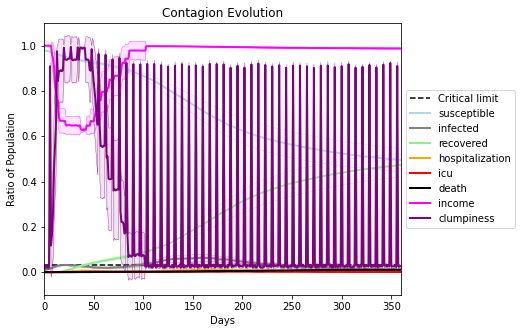

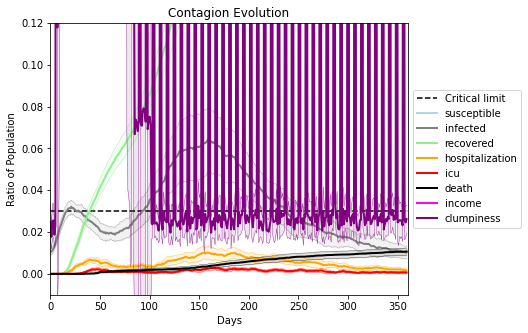

In [37]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.4
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5489, 6662, 3083, 5711, 4167, 9382, 1124, 8748, 8963, 9249, 8956, 1320, 2643, 3605, 4323, 6263, 8588, 328, 8505, 4488]
Average similarity between family members is 0.18929109179606562 at temperature -0.3
Average similarity between family and home is 0.9998524153718701 at temperature -1
Average similarity between students and their classroom is 0.1776116835299981 at temperature -0.3
Average classroom occupancy is 3.8714285714285714 and number classrooms is 70
Average similarity between workers is 0.15850961515507772 at temperature -0.3
Average office occupancy is 3.3819095477386933 and number offices is 199
Average friend similarity for adults: 0.24900809952842765 for kids: 0.20062200343113606
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.018678908266168123
avg restaurant similarity 0.20414817598809104
avg restaurant similarity 0.1620135645298673
avg restaurant similarity 0.21839519295325682
avg restaurant similarity 0.05915051737639237
avg restaurant similarity 0.2088185365072051
avg restaurant similarity 0.059854781401650695
avg restaurant similarity 0.08046845417362242
avg restaurant similarity 0.08068086158836778
avg restaurant similarity 0.09722253656068292
avg restaurant similarity 0.13757631251048302
avg restaurant similarity 0.044228851944814025
avg restaurant similarity 0.15357176993550745
avg restaurant similarity 0.017736052288571325
avg restaurant similarity -0.19678920050501766
avg restaurant similarity 0.15797570538295672
avg restaurant similarity 0.24869834612167033
avg restaurant similarity 0.08979976168263136
avg restaurant similarity -0.059146210827626534
avg restaurant similarity 0.10978931882578825
avg restaurant similarity 0.012243784412329492
avg restaurant similarity -0

avg restaurant similarity 0.15591649301596916
avg restaurant similarity 0.10895793696953159
avg restaurant similarity -0.12788909613934202
avg restaurant similarity 0.05810916777519699
avg restaurant similarity 0.12355331557641196
avg restaurant similarity 0.12014450450145965
avg restaurant similarity -0.22510568179009605
avg restaurant similarity 0.3272347923237952
avg restaurant similarity -0.017569670896405747
avg restaurant similarity 0.12976110291718637
avg restaurant similarity 0.07037179238922353
avg restaurant similarity 0.03254984328590415
avg restaurant similarity -0.040937694815504425
avg restaurant similarity 0.04770584662836983
avg restaurant similarity 0.1553162904227628
avg restaurant similarity 0.13414915324960847
avg restaurant similarity -0.1960064612678701
avg restaurant similarity 0.19367438468799514
avg restaurant similarity 0.23042597560609906
avg restaurant similarity 0.1784678171718356
avg restaurant similarity 0.47837985137656147
avg restaurant similarity -0.14

avg restaurant similarity -0.09312661894674826
avg restaurant similarity 0.2284819694874457
avg restaurant similarity 0.0507583848994221
avg restaurant similarity -0.015628635902845536
avg restaurant similarity 0.018050277388670554
avg restaurant similarity -0.08946685284387054
avg restaurant similarity -0.04236659973978479
avg restaurant similarity 0.17183054155363944
avg restaurant similarity -0.010983013909075925
avg restaurant similarity 0.16086799134190008
avg restaurant similarity 0.24595322805393469
avg restaurant similarity 0.07115692162853315
avg restaurant similarity -0.03417168079635781
avg restaurant similarity 0.09054546766711245
avg restaurant similarity 0.1765374552237555
avg restaurant similarity 0.14704858806294618
avg restaurant similarity -0.04493416142193667
avg restaurant similarity 0.10511238613762826
avg restaurant similarity 0.16231157495673562
avg restaurant similarity -0.1650147586111297
avg restaurant similarity 0.19897879463546436
avg restaurant similarity 0

avg restaurant similarity 0.039397478468985156
avg restaurant similarity 0.0643048056132571
avg restaurant similarity -0.1419435653781547
avg restaurant similarity 0.009155750846593685
avg restaurant similarity -0.03157237030880637
avg restaurant similarity 0.03670764890333768
avg restaurant similarity 0.023933818142453368
avg restaurant similarity 0.09950359669715456
avg restaurant similarity 0.11092059308748915
avg restaurant similarity 0.06643914095202157
avg restaurant similarity 0.3733906309782273
avg restaurant similarity 0.09840469047986791
avg restaurant similarity 0.13798416005776679
avg restaurant similarity 0.11597548495011135
avg restaurant similarity -0.027420405189717285
avg restaurant similarity 0.02815337404083825
avg restaurant similarity 0.08015740008443116
avg restaurant similarity 0.21602633159851883
avg restaurant similarity -0.1327283791428226
avg restaurant similarity 0.13102513839722837
avg restaurant similarity -0.0003667079547713892
avg restaurant similarity 0

avg restaurant similarity 0.00047401983353338267
avg restaurant similarity 0.2788318662299941
avg restaurant similarity 0.10412861468762658
avg restaurant similarity -0.003030995263279851
avg restaurant similarity -0.038545272637267966
avg restaurant similarity 0.09865928356580364
avg restaurant similarity 0.10787066091051907
avg restaurant similarity 0.17503760945256142
avg restaurant similarity 0.16347504969890383
avg restaurant similarity 0.08200139012446045
avg restaurant similarity -0.04386503086250085
avg restaurant similarity -0.2687025269207784
avg restaurant similarity -0.18265479613006042
avg restaurant similarity 0.23985412903108483
avg restaurant similarity 0.10974996632611775
avg restaurant similarity 0.13156054365577668
avg restaurant similarity 0.14410335346214018
avg restaurant similarity -0.11074798861128524
avg restaurant similarity 0.09272298805173147
avg restaurant similarity 0.3449262770470264
avg restaurant similarity 0.11642183377552641
avg restaurant similarity 

avg restaurant similarity 0.09951889474336093
avg restaurant similarity 0.029489259477767704
avg restaurant similarity -0.02688091620943662
avg restaurant similarity -0.27102920614377446
avg restaurant similarity 0.12197461519840083
avg restaurant similarity -0.06955203043434141
avg restaurant similarity -0.2388190719040949
avg restaurant similarity 0.1324539246568806
avg restaurant similarity 0.293305747307571
avg restaurant similarity 0.08163803163331945
avg restaurant similarity 0.13931544660268066
avg restaurant similarity 0.2478874322315017
avg restaurant similarity 0.2126508663120892
avg restaurant similarity 0.06998097587244616
avg restaurant similarity 0.33413116063925735
avg restaurant similarity -0.09365846164619757
avg restaurant similarity 0.07981315404184376
avg restaurant similarity 0.1349958404059934
avg restaurant similarity 0.17136473609486852
avg restaurant similarity 0.5092324873574505
avg restaurant similarity 0.009825229593232593
avg restaurant similarity 0.0963906

avg restaurant similarity -0.14726257734744266
avg restaurant similarity 0.015817117814926767
avg restaurant similarity 0.23385305143725935
avg restaurant similarity 0.2581454394044094
avg restaurant similarity 0.13861477837742295
avg restaurant similarity -0.20204537960547525
avg restaurant similarity -0.046819192529838266
avg restaurant similarity 0.19788474788351773
avg restaurant similarity 0.026288178763641385
avg restaurant similarity -0.0656475102000821
avg restaurant similarity 0.12501835796632169
avg restaurant similarity 0.023950856280216676
avg restaurant similarity -0.06054060464643937
avg restaurant similarity 0.03886099728461189
avg restaurant similarity -0.22869789555643324
avg restaurant similarity 0.008243627508212198
avg restaurant similarity 0.11298515884162794
avg restaurant similarity 0.09851146843409991
avg restaurant similarity -0.06074711546758132
avg restaurant similarity 0.05918340469447296
avg restaurant similarity 0.22113975391369411
avg restaurant similarit

avg restaurant similarity -0.12434697022568805
avg restaurant similarity 0.3952088518330762
avg restaurant similarity 0.008205682817645929
avg restaurant similarity 0.1123166470726176
avg restaurant similarity 0.18398168730661235
avg restaurant similarity 0.054768340702808165
avg restaurant similarity 0.313739173855485
avg restaurant similarity 0.12556453288646605
avg restaurant similarity 0.16943935795006856
avg restaurant similarity 0.15967732921881136
avg restaurant similarity 0.03292080557611999
avg restaurant similarity 0.1462450298102639
avg restaurant similarity 0.1108176380633497
avg restaurant similarity -0.20295427588956994
avg restaurant similarity -0.18825850950062392
avg restaurant similarity 0.04884030948159991
avg restaurant similarity 0.2281627463282736
avg restaurant similarity 0.08257974121717018
avg restaurant similarity -0.322887288729822
avg restaurant similarity -0.27617171290181197
avg restaurant similarity 0.010634645600947706
avg restaurant similarity 0.0812432

avg restaurant similarity 0.05745687699054022
avg restaurant similarity 0.07563989321907919
avg restaurant similarity 0.05688680048180679
avg restaurant similarity 0.12891622610131026
avg restaurant similarity 0.1236733805289859
avg restaurant similarity 0.20760741324188017
avg restaurant similarity 0.13542946980382436
avg restaurant similarity 0.09041077360092585
avg restaurant similarity 0.03010825316617972
avg restaurant similarity 0.11376695346337386
avg restaurant similarity -0.014387846210745032
avg restaurant similarity 0.19261246952825462
avg restaurant similarity -0.03368519211942978
avg restaurant similarity 0.19473704459480648
avg restaurant similarity 0.036402441298807126
avg restaurant similarity 0.1202663790105195
avg restaurant similarity -0.014373472531611135
avg restaurant similarity 0.08772676167709832
avg restaurant similarity 0.09820603531301166
avg restaurant similarity 0.01668719901362724
avg restaurant similarity -0.1350973553081883
avg restaurant similarity 0.04

avg restaurant similarity -0.0757070973116098
avg restaurant similarity 0.12621248980633062
avg restaurant similarity -0.04999388818199052
avg restaurant similarity 0.22172216627812089
avg restaurant similarity -0.0031727704841919926
avg restaurant similarity -0.006784804409416059
avg restaurant similarity 0.2062102820722001
avg restaurant similarity 0.0775801194361244
avg restaurant similarity 0.0662501575999274
avg restaurant similarity 0.3327262342289914
avg restaurant similarity 0.27575727669522304
avg restaurant similarity 0.08471026755989881
avg restaurant similarity -0.062253596281479265
avg restaurant similarity 0.13956260203151663
avg restaurant similarity 0.01840825999473735
avg restaurant similarity 0.1421790509819859
avg restaurant similarity 0.0810063626004863
avg restaurant similarity 0.14895001576092884
avg restaurant similarity 0.20470862026935344
avg restaurant similarity 0.2743756670128439
avg restaurant similarity 0.07583871603835494
avg restaurant similarity 0.09132

avg restaurant similarity 0.42423164476123154
avg restaurant similarity 0.10078275414282238
avg restaurant similarity 0.06299323118541186
avg restaurant similarity 0.19341280895879023
avg restaurant similarity 0.17066096137667644
avg restaurant similarity 0.33618163702020487
avg restaurant similarity 0.30631594816392144
avg restaurant similarity 0.29068103784897287
avg restaurant similarity 0.15032299698412419
avg restaurant similarity 0.1508767487212918
avg restaurant similarity -0.2684844532471455
avg restaurant similarity 0.12885760336759783
avg restaurant similarity 0.14767919014021164
avg restaurant similarity -0.01633990814025843
avg restaurant similarity 0.4931854823751163
avg restaurant similarity 0.07676424373994195
avg restaurant similarity 0.08746162980288238
avg restaurant similarity 0.2874032609062094
avg restaurant similarity 0.4410024357563064
avg restaurant similarity 0.15683364832118885
avg restaurant similarity -0.219191247621086
avg restaurant similarity -0.046025994

avg restaurant similarity 0.10495220609272696
avg restaurant similarity 0.0030352324334839142
avg restaurant similarity 0.20761883879384047
avg restaurant similarity -0.1168886044827786
avg restaurant similarity 0.1449726431492954
avg restaurant similarity -0.03354202016186616
avg restaurant similarity 0.015042239289210984
avg restaurant similarity -0.17412338467131647
avg restaurant similarity 0.09413303171723779
avg restaurant similarity -0.07012389419707712
avg restaurant similarity 0.23450794222299892
avg restaurant similarity 0.1310855316344465
avg restaurant similarity -0.11293371545631754
avg restaurant similarity 0.20427155410394637
avg restaurant similarity 0.6353884957932894
avg restaurant similarity -0.07120602298011007
avg restaurant similarity 0.2951174985785843
avg restaurant similarity 0.10255360421717477
avg restaurant similarity 0.13597805893954837
avg restaurant similarity 0.10343699647413593
avg restaurant similarity 0.36546419702221633
avg restaurant similarity 0.26

avg restaurant similarity 0.0716508911510462
avg restaurant similarity 0.12609979851449937
avg restaurant similarity 0.1543657939318253
avg restaurant similarity 0.27835513334298917
avg restaurant similarity 0.07434108175740578
avg restaurant similarity 0.08003593972206996
avg restaurant similarity 0.17064687519460647
avg restaurant similarity 0.16486742732589396
avg restaurant similarity 0.25336810324802517
avg restaurant similarity 0.2570964966785371
avg restaurant similarity 0.07286713702302776
avg restaurant similarity 0.19182631033343372
avg restaurant similarity 0.048585397148349314
avg restaurant similarity 0.005762940367782299
avg restaurant similarity 0.16083099839786794
avg restaurant similarity 0.055562226189295134
avg restaurant similarity 0.07013849664999776
avg restaurant similarity 0.12436673728483576
avg restaurant similarity -0.17850649593849208
avg restaurant similarity -0.026897098784546738
avg restaurant similarity -0.1550605898664028
avg restaurant similarity -0.04

avg restaurant similarity 0.09207237282799093
avg restaurant similarity 0.0890582363104817
avg restaurant similarity 0.13028802629022054
avg restaurant similarity -0.029384051061004616
avg restaurant similarity 0.26744461261597685
avg restaurant similarity 0.22856606927029463
avg restaurant similarity 0.0643262423937676
avg restaurant similarity 0.06659375306407653
avg restaurant similarity -0.08133979479214859
avg restaurant similarity 0.14970465104845124
avg restaurant similarity 0.02325914708955285
avg restaurant similarity 0.08313734540060642
avg restaurant similarity 0.14051495980168177
avg restaurant similarity 0.28185706716121905
avg restaurant similarity 0.05747466857977631
avg restaurant similarity 0.5553183835604959
avg restaurant similarity -0.14604722061864453
avg restaurant similarity -0.015686868033187123
avg restaurant similarity 0.19846043248544826
avg restaurant similarity 0.002335237571205691
avg restaurant similarity -0.040042353198457656
avg restaurant similarity 0.

avg restaurant similarity -0.058861995475870454
avg restaurant similarity 0.11133854946120596
avg restaurant similarity -0.016991047388594603
avg restaurant similarity -0.06807194460255622
avg restaurant similarity 0.16409263800324367
avg restaurant similarity 0.09656559661587358
avg restaurant similarity -0.10617316839726454
avg restaurant similarity 0.041082270606003404
avg restaurant similarity 0.4092737333669917
avg restaurant similarity 0.32791491857460103
avg restaurant similarity -0.011021133080505308
avg restaurant similarity 0.05443595100504308
avg restaurant similarity 0.09690372623200455
avg restaurant similarity -0.11952351616616183
avg restaurant similarity 0.126118819215323
avg restaurant similarity 0.06465775648468332
avg restaurant similarity 0.1513357744058048
avg restaurant similarity 0.10054438255849385
avg restaurant similarity 0.4624942204350695
avg restaurant similarity 0.16647448353489283
avg restaurant similarity 0.36522622984047587
avg restaurant similarity 0.1

avg restaurant similarity 0.1536812230556481
avg restaurant similarity -0.0025501323550987456
avg restaurant similarity 0.13693502477636102
avg restaurant similarity -0.16671217050947326
avg restaurant similarity 0.20093582988011788
avg restaurant similarity -0.02530683095403237
avg restaurant similarity 0.18347376243780927
avg restaurant similarity 0.08456191374577747
avg restaurant similarity 0.05710073741438862
avg restaurant similarity -0.02532911502441791
avg restaurant similarity 0.01075561962792657
avg restaurant similarity -0.4495728160464375
avg restaurant similarity 0.1451358661228973
avg restaurant similarity -0.18407628779970092
avg restaurant similarity 0.09282162283364026
avg restaurant similarity 0.06040402502352344
avg restaurant similarity 0.1063134121309432
avg restaurant similarity 0.12439304317002843
avg restaurant similarity -0.005794659397433936
avg restaurant similarity -0.031530513415563864
avg restaurant similarity 0.07210192145658072
avg restaurant similarity 

avg restaurant similarity 0.17600846710498577
avg restaurant similarity 0.03700626391575016
avg restaurant similarity 0.2640620016357301
avg restaurant similarity 0.1708053232882576
avg restaurant similarity 0.14201298065388146
avg restaurant similarity 0.03290549048757526
avg restaurant similarity -0.004469417056555643
avg restaurant similarity 0.48914229854155
avg restaurant similarity 0.052283624845135865
avg restaurant similarity -0.1196123595328054
avg restaurant similarity 0.03391040178273498
avg restaurant similarity 0.04629291429229116
avg restaurant similarity -0.032339489161957925
avg restaurant similarity 0.1516139678705869
avg restaurant similarity 0.12238102389874261
avg restaurant similarity 0.2764261657191663
avg restaurant similarity 0.32292742501086624
avg restaurant similarity 0.17168672474154256
avg restaurant similarity 0.0019735029974289773
avg restaurant similarity 0.11434744661057462
avg restaurant similarity 0.1107797782007599
avg restaurant similarity -0.175439

avg restaurant similarity 0.039731786472808873
avg restaurant similarity 0.10557051407902365
avg restaurant similarity -0.4207730169051905
avg restaurant similarity 0.03698655654798787
avg restaurant similarity 0.41859009577590556
avg restaurant similarity 0.23034043169888516
avg restaurant similarity 0.2228673202762017
avg restaurant similarity -0.265175174821513
avg restaurant similarity 0.03773735679728151
avg restaurant similarity 0.30373986399855585
avg restaurant similarity 0.09817408652503747
avg restaurant similarity 0.00989861759462976
avg restaurant similarity 0.2061149521854229
avg restaurant similarity 0.17315024606138812
avg restaurant similarity -0.03266448881079356
avg restaurant similarity 0.3756939287476735
avg restaurant similarity 0.3045643010086184
avg restaurant similarity 0.005403589721205921
avg restaurant similarity 0.23111709921512516
avg restaurant similarity 0.11798681599406043
avg restaurant similarity 0.12310297473201806
avg restaurant similarity -0.0075125

avg restaurant similarity 0.013611685999849708
avg restaurant similarity 0.16693253945381012
avg restaurant similarity 0.2424515901932681
avg restaurant similarity 0.18851157929459875
avg restaurant similarity 0.25262553011427713
avg restaurant similarity 0.07870150972851962
avg restaurant similarity 0.18482529884268906
avg restaurant similarity -0.01726979858722678
avg restaurant similarity -0.03593329237884374
avg restaurant similarity 0.056160541354343174
avg restaurant similarity 0.2176421242504876
avg restaurant similarity -0.08879623026126288
avg restaurant similarity -0.08432658912448703
avg restaurant similarity 0.06819932250351751
avg restaurant similarity 0.19413252730870495
avg restaurant similarity -0.08440866086609543
avg restaurant similarity 0.13063833858809604
avg restaurant similarity 0.06630509851217359
avg restaurant similarity 0.09164324690320927
avg restaurant similarity 0.16038070979515365
avg restaurant similarity 0.203496754488212
avg restaurant similarity 0.065

avg restaurant similarity 0.25859002792665914
avg restaurant similarity 0.08871525026483709
avg restaurant similarity 0.08108731210944577
avg restaurant similarity -0.00020972488767005202
avg restaurant similarity 0.15960086073775254
avg restaurant similarity 0.22832110270233247
avg restaurant similarity 0.1512477956740423
avg restaurant similarity 0.12061548308922229
avg restaurant similarity -0.04775823189420528
avg restaurant similarity 0.12745002779444983
avg restaurant similarity 0.12203480881298508
avg restaurant similarity 0.37197938100960665
avg restaurant similarity 0.10198187028408746
avg restaurant similarity 0.15720774502949653
avg restaurant similarity 0.009492524465877977
avg restaurant similarity 0.28383998635995755
avg restaurant similarity 0.01174655487394866
avg restaurant similarity 0.4139294739443412
avg restaurant similarity 0.1793405805860239
avg restaurant similarity 0.09974834429843113
avg restaurant similarity 0.016205778046618755
avg restaurant similarity 0.09

avg restaurant similarity 0.10004978361845467
avg restaurant similarity 0.1944279846875331
avg restaurant similarity 0.12322199180416166
avg restaurant similarity 0.1816676211576488
avg restaurant similarity 0.22388099062349065
avg restaurant similarity -0.09628945763927302
avg restaurant similarity -0.027760698571260577
avg restaurant similarity -0.03296312106371642
avg restaurant similarity 0.014475037648494638
avg restaurant similarity 0.11873362899966905
avg restaurant similarity -0.020906435234246068
avg restaurant similarity 0.23607538418756563
avg restaurant similarity -0.008332476238072211
avg restaurant similarity 0.030806678181316424
avg restaurant similarity 0.15019107144609142
avg restaurant similarity -0.0911321558280299
avg restaurant similarity 0.07780600923795401
avg restaurant similarity -0.03340847792888044
avg restaurant similarity 0.04207041691608567
avg restaurant similarity 0.3061945989621796
avg restaurant similarity 0.14725376955203598
avg restaurant similarity 

avg restaurant similarity 0.033333977320811864
avg restaurant similarity 0.06610521293165415
avg restaurant similarity 0.007622096982952693
avg restaurant similarity -0.11450082718787213
avg restaurant similarity -0.02266484234824747
avg restaurant similarity 0.3056587965213581
avg restaurant similarity 0.19106782201537775
avg restaurant similarity 0.04561654567102338
avg restaurant similarity 0.1670711046207223
avg restaurant similarity 0.06323261847326248
avg restaurant similarity -0.035505156433092856
avg restaurant similarity 0.13562968180875265
avg restaurant similarity -0.11809835737819162
avg restaurant similarity 0.06226037290050934
avg restaurant similarity 0.039344588949875955
avg restaurant similarity 0.020052211413901632
avg restaurant similarity 0.1482218694718428
avg restaurant similarity 0.16151480749183436
avg restaurant similarity 0.10282560429659654
avg restaurant similarity 0.12078037029237715
avg restaurant similarity 0.10332441040557223
avg restaurant similarity -0

avg restaurant similarity 0.09083348302975978
avg restaurant similarity -0.15074776339052298
avg restaurant similarity 0.14644203737593375
avg restaurant similarity 0.01922379014428875
avg restaurant similarity 0.1023639719243419
avg restaurant similarity -0.0023970626828901166
avg restaurant similarity 0.02831480630000016
avg restaurant similarity -0.021116818284610567
avg restaurant similarity -0.0023749554563517773
avg restaurant similarity -0.06714280802317442
avg restaurant similarity 0.32704222426405016
avg restaurant similarity 0.13056486823520858
avg restaurant similarity 0.13069478069873516
avg restaurant similarity -0.29342195704029284
avg restaurant similarity -0.07099604324676773
avg restaurant similarity 0.2987153459075367
avg restaurant similarity -0.05023113526363246
avg restaurant similarity 0.057374261727843816
avg restaurant similarity 0.30107250660002277
avg restaurant similarity 0.05703622436828826
avg restaurant similarity -0.2357554116611125
avg restaurant similar

avg restaurant similarity -0.2765658442868697
avg restaurant similarity 0.15672860746428394
avg restaurant similarity -0.4086909758910086
avg restaurant similarity 0.08351406288653662
avg restaurant similarity 0.21816626151169824
avg restaurant similarity 0.12666892544294878
avg restaurant similarity 0.6416206487904338
avg restaurant similarity 0.0059818386723813274
avg restaurant similarity 0.18103174318254345
avg restaurant similarity 0.19830618214939613
avg restaurant similarity 0.16936207836278908
avg restaurant similarity 0.06170800351414844
avg restaurant similarity 0.020791489821732033
avg restaurant similarity -0.07467579601023484
avg restaurant similarity 0.07984777928333525
avg restaurant similarity 0.02364357949411705
avg restaurant similarity -0.13564909387910987
avg restaurant similarity 0.14958026791274792
avg restaurant similarity -0.08204614089229492
avg restaurant similarity 0.0675207587630568
avg restaurant similarity -0.02339506590905717
avg restaurant similarity 0.2

avg restaurant similarity 0.13155483964321185
avg restaurant similarity 0.3109086585486509
avg restaurant similarity 0.27338234650045107
avg restaurant similarity -0.10125919800633104
avg restaurant similarity 0.18507986885615915
avg restaurant similarity 0.04263035389976757
avg restaurant similarity 0.1569840815177351
avg restaurant similarity 0.15212417034594486
avg restaurant similarity 0.10640340781714784
avg restaurant similarity -0.0004640628648611353
avg restaurant similarity -0.09849833306997931
avg restaurant similarity 0.002219584766693122
avg restaurant similarity 0.01132908281378436
avg restaurant similarity 0.0351231171934616
avg restaurant similarity -0.03698019159527348
avg restaurant similarity 0.15867506135672413
avg restaurant similarity 0.1813268592656665
avg restaurant similarity -0.0024618153335801696
avg restaurant similarity 0.06563396837551455
avg restaurant similarity 0.021550526078713952
avg restaurant similarity 0.15240031489636058
avg restaurant similarity 0

avg restaurant similarity 0.02826134108338525
avg restaurant similarity -0.03757653558392632
avg restaurant similarity 0.009046593873235457
avg restaurant similarity 0.19842049712755186
avg restaurant similarity 0.019930948276190304
avg restaurant similarity 0.0641381309412706
avg restaurant similarity 0.02040846607696754
avg restaurant similarity 0.2476683452274635
avg restaurant similarity 0.13396163576212944
avg restaurant similarity 0.13534489705706648
avg restaurant similarity 0.07415071826379913
avg restaurant similarity 0.1405752682899155
avg restaurant similarity 0.13732731690542216
avg restaurant similarity 0.08147899776881429
avg restaurant similarity -0.1986878826259693
avg restaurant similarity 0.18374801901231483
avg restaurant similarity 0.16732628029555882
avg restaurant similarity 0.07023218618331471
avg restaurant similarity 0.0019627940661474143
avg restaurant similarity -0.09275622089477503
avg restaurant similarity 0.08306409863063703
avg restaurant similarity 0.362

avg restaurant similarity 0.0335480071494031
avg restaurant similarity 0.1261188425839619
avg restaurant similarity 0.03889344610429901
avg restaurant similarity 0.13053596597538505
avg restaurant similarity 0.17797364978386596
avg restaurant similarity 0.08922224452816331
avg restaurant similarity -0.01789480964847764
avg restaurant similarity 0.12774949405719205
avg restaurant similarity 0.05630943738205817
avg restaurant similarity 0.11525860349606233
avg restaurant similarity 0.22457069582185366
avg restaurant similarity 0.049636595208819
avg restaurant similarity -0.0024939279386156157
avg restaurant similarity 0.05231518637677875
avg restaurant similarity 0.18273586599385994
avg restaurant similarity -0.055423848871292904
avg restaurant similarity -0.07997022099216602
avg restaurant similarity -0.11533355603738209
avg restaurant similarity -0.07146850983354919
avg restaurant similarity 0.263135483503032
avg restaurant similarity 0.20051412345399133
avg restaurant similarity -0.04

avg restaurant similarity 0.04161526947367447
avg restaurant similarity 0.09154368826711132
avg restaurant similarity 0.2834123932077011
avg restaurant similarity 0.19113919982658545
avg restaurant similarity 0.09898698258078238
avg restaurant similarity 0.29648834029458054
avg restaurant similarity 0.27148021723406557
avg restaurant similarity 0.20010000283044801
avg restaurant similarity 0.007054244326942397
avg restaurant similarity -0.12410012653905639
avg restaurant similarity -0.19801433657819192
avg restaurant similarity 0.002244196399094567
avg restaurant similarity -0.03292391849063087
avg restaurant similarity -0.08949010580212986
avg restaurant similarity 0.13056919317574456
avg restaurant similarity 0.029381481479233282
avg restaurant similarity 0.11598482715646227
avg restaurant similarity 0.02084031794602731
avg restaurant similarity 0.2788450801498915
avg restaurant similarity 0.2114819064288196
avg restaurant similarity 0.22838969660440853
avg restaurant similarity 0.21

avg restaurant similarity 0.25519579709235196
avg restaurant similarity 0.26753110830210897
avg restaurant similarity 0.14316380970089349
avg restaurant similarity 0.07862493350587048
avg restaurant similarity 0.04565514063057202
avg restaurant similarity 0.08790791598837003
avg restaurant similarity -0.13619727672942614
avg restaurant similarity 0.2756879621965182
avg restaurant similarity 0.14965225229399318
avg restaurant similarity 0.3485577086152272
avg restaurant similarity -0.015233313098220493
avg restaurant similarity 0.09204272687008039
avg restaurant similarity 0.20168992929123128
avg restaurant similarity 0.16609734227824813
avg restaurant similarity 0.11217043342938735
avg restaurant similarity 0.10634123282274054
avg restaurant similarity 0.12226525734403068
avg restaurant similarity 0.1262438047636756
avg restaurant similarity 0.2572006829182252
avg restaurant similarity 0.22551370983940636
avg restaurant similarity 0.21058162385317034
avg restaurant similarity 0.2078384

avg restaurant similarity -0.1337288264177037
avg restaurant similarity 0.11332868650405613
avg restaurant similarity 0.02700561735872517
avg restaurant similarity 0.10400558621967203
avg restaurant similarity 0.19242698123746305
avg restaurant similarity 0.1391224259261138
avg restaurant similarity 0.21918223945597615
avg restaurant similarity 0.07204832506779119
avg restaurant similarity 0.029053261148354326
avg restaurant similarity 0.05963209882575619
avg restaurant similarity -0.15384823384816057
avg restaurant similarity -0.03387279996114907
avg restaurant similarity 0.13498676490840106
avg restaurant similarity 0.1423562889745803
avg restaurant similarity 0.17946867482534185
avg restaurant similarity 0.10039565109049425
avg restaurant similarity -0.153654145567646
avg restaurant similarity 0.05905668134039778
avg restaurant similarity 0.18315756023878066
avg restaurant similarity 0.15487979900535934
avg restaurant similarity 0.31872144027515326
avg restaurant similarity 0.003755

avg restaurant similarity 0.0877655280856958
avg restaurant similarity 0.16194064306856198
avg restaurant similarity -0.20661121757728498
avg restaurant similarity 0.059073404021277955
avg restaurant similarity 0.3033817181058185
avg restaurant similarity 0.29155831656010944
avg restaurant similarity 0.07490226031037295
avg restaurant similarity 0.18892413792031343
avg restaurant similarity -0.08467209209300568
avg restaurant similarity 0.1272893247106033
avg restaurant similarity 0.008100738124736672
avg restaurant similarity 0.19940816992533775
avg restaurant similarity 0.27122030766604466
avg restaurant similarity 0.0569471919748878
avg restaurant similarity 0.14250748653352746
avg restaurant similarity -0.11900388893223894
avg restaurant similarity 0.11393194640115747
avg restaurant similarity 0.10760257639693242
avg restaurant similarity 0.0160472547021996
avg restaurant similarity 0.06720808771986267
avg restaurant similarity -0.021207351250642815
avg restaurant similarity 0.3163

avg restaurant similarity 0.07641261775735862
avg restaurant similarity 0.13494165733347954
avg restaurant similarity 0.011838603486638441
avg restaurant similarity -0.08190869496369468
avg restaurant similarity 0.04306993499183942
avg restaurant similarity -0.10337414820817703
avg restaurant similarity 0.1724600820702285
avg restaurant similarity 0.0339856794547086
avg restaurant similarity -0.07695320398462485
avg restaurant similarity -0.25966652081236924
avg restaurant similarity 0.11128686923127391
avg restaurant similarity 0.0803489017846248
avg restaurant similarity -0.024885983853064425
avg restaurant similarity 0.02875011928298201
avg restaurant similarity 0.12825942050617087
avg restaurant similarity 0.2518560830880543
avg restaurant similarity -0.017775850386289597
avg restaurant similarity -0.07187429279000397
avg restaurant similarity 0.0437572317650969
avg restaurant similarity 0.06922997343923272
avg restaurant similarity 0.12084776599425197
avg restaurant similarity 0.0

avg restaurant similarity -0.11510847759326416
avg restaurant similarity 0.08029945284634678
avg restaurant similarity 0.03446172783310052
avg restaurant similarity 0.03904471307533576
avg restaurant similarity 0.10597786534199038
avg restaurant similarity 0.14838355319459626
avg restaurant similarity 0.15832558952214223
avg restaurant similarity 0.03593454814959877
avg restaurant similarity 0.04267709631220683
avg restaurant similarity 0.10813481310005599
avg restaurant similarity -0.034424322505882676
avg restaurant similarity -0.08152569131971381
avg restaurant similarity 0.010112102669024101
avg restaurant similarity -0.42905766622201535
avg restaurant similarity -0.00198751070380695
avg restaurant similarity 0.15248857557974824
avg restaurant similarity -0.0006518612404941337
avg restaurant similarity 0.037005678423213756
avg restaurant similarity -0.07257374069115603
avg restaurant similarity 0.15458845481350755
avg restaurant similarity 0.14392365754877082
avg restaurant similar

avg restaurant similarity -0.004117230074629171
avg restaurant similarity -0.045703439388724565
avg restaurant similarity 0.09929430689258352
avg restaurant similarity -0.05897426101780952
avg restaurant similarity -0.06182917490972346
avg restaurant similarity 0.1787064578497119
avg restaurant similarity 0.0011354515888520346
avg restaurant similarity -0.05801975649539039
avg restaurant similarity -0.04998540055878195
avg restaurant similarity 0.22855591103647355
avg restaurant similarity 0.06430227406149287
avg restaurant similarity -0.09024716768659248
avg restaurant similarity 0.04092572017033601
avg restaurant similarity 0.025685060122597782
avg restaurant similarity -0.009238278734109557
avg restaurant similarity -0.2211231109627101
avg restaurant similarity -0.10626863006029759
avg restaurant similarity 0.2957429523300808
avg restaurant similarity 0.12674100673910077
avg restaurant similarity 0.09982736315490065
avg restaurant similarity -0.04341030133042153
avg restaurant simil

avg restaurant similarity 0.08691359172430031
avg restaurant similarity 0.27226966863801494
avg restaurant similarity -0.05826766848982697
avg restaurant similarity 0.1597826449103674
avg restaurant similarity 0.0335774019743427
avg restaurant similarity -0.06352902269334043
avg restaurant similarity 0.17778193954185373
avg restaurant similarity 0.16257762085334285
avg restaurant similarity -0.024226010477319957
avg restaurant similarity 0.048696104204137114
avg restaurant similarity 0.1290951207357143
avg restaurant similarity 0.20851415774230334
avg restaurant similarity 0.11071533939960747
avg restaurant similarity 0.08319735198986519
avg restaurant similarity 0.23048015737576344
avg restaurant similarity 0.26345938386423645
avg restaurant similarity 0.3148568014696923
avg restaurant similarity 0.24217473254068977
avg restaurant similarity 0.09569155892040883
avg restaurant similarity 0.2044686639084754
avg restaurant similarity 0.09910059663312372
avg restaurant similarity -0.02285

avg restaurant similarity 0.20102365322095045
avg restaurant similarity 0.07950961792988674
avg restaurant similarity -0.04578342190158588
avg restaurant similarity 0.1692876368268601
avg restaurant similarity -0.07847725711636949
avg restaurant similarity 0.07023464055003929
avg restaurant similarity -0.04415520371217032
avg restaurant similarity -0.2864610171087547
avg restaurant similarity 0.1911932671742789
avg restaurant similarity -0.14838086766819666
avg restaurant similarity 0.014597973123657734
avg restaurant similarity 0.045650063677511565
avg restaurant similarity -0.009204005843421235
avg restaurant similarity 0.15043684962750545
avg restaurant similarity 0.214592438051791
avg restaurant similarity 0.10104970120455703
avg restaurant similarity -0.08635365295668147
avg restaurant similarity 0.27292846734806003
avg restaurant similarity 0.1477132121602804
avg restaurant similarity 0.037609432733641125
avg restaurant similarity 0.19774698371455113
avg restaurant similarity 0.2

avg restaurant similarity 0.021224224664004653
avg restaurant similarity 0.1233777280441843
avg restaurant similarity -0.16229026984033287
avg restaurant similarity -0.26898254637029584
avg restaurant similarity 0.1537485418219002
avg restaurant similarity 0.24202757351947632
avg restaurant similarity 0.1853271144428712
avg restaurant similarity 0.15229392659361204
avg restaurant similarity 0.10647541178652732
avg restaurant similarity -0.02744017239365175
avg restaurant similarity 0.1731935617163565
avg restaurant similarity -0.06602156988564359
avg restaurant similarity 0.1444811494722676
avg restaurant similarity -0.007053035097251803
avg restaurant similarity 0.005218964092398901
avg restaurant similarity 0.1960298054430029
avg restaurant similarity -0.006535247587014198
avg restaurant similarity 0.11161923745144874
avg restaurant similarity 0.06945536306374223
avg restaurant similarity 0.05036457126141971
avg restaurant similarity 0.38249600635648523
avg restaurant similarity 0.03

avg restaurant similarity -0.10746616885406123
avg restaurant similarity 0.06858201584703677
avg restaurant similarity 0.34358087131635806
avg restaurant similarity 0.003475869360113742
avg restaurant similarity 0.0583789134381334
avg restaurant similarity 0.2583936957664961
avg restaurant similarity 0.06434840592502995
avg restaurant similarity 0.30060308267560104
avg restaurant similarity 0.06346167870419385
avg restaurant similarity -0.015755073544963503
avg restaurant similarity -0.17777844970934875
avg restaurant similarity 0.16774810451218736
avg restaurant similarity -0.022234571026310365
avg restaurant similarity -0.04916059643020102
avg restaurant similarity 0.2317514708991523
avg restaurant similarity -0.10301603149082925
avg restaurant similarity 0.15183986433476762
avg restaurant similarity -0.06359993651180224
avg restaurant similarity 0.2845400447602458
avg restaurant similarity 0.06617048684730928
avg restaurant similarity -0.0243970067503081
avg restaurant similarity -0

avg restaurant similarity 0.04589851303348789
avg restaurant similarity -0.07635668992882234
avg restaurant similarity 0.1649038383304553
avg restaurant similarity 0.16265232967425486
avg restaurant similarity 0.1056138095259554
avg restaurant similarity 0.3287352562724615
avg restaurant similarity 0.06143570436118731
avg restaurant similarity 0.21009887248795261
avg restaurant similarity -0.010199798031399997
avg restaurant similarity 0.18714296083674406
avg restaurant similarity 0.08315858546179583
avg restaurant similarity -0.0514685962064996
avg restaurant similarity 0.06929956013559156
avg restaurant similarity 0.20628913619933398
avg restaurant similarity 0.15643369319921277
avg restaurant similarity 0.05397871108735426
avg restaurant similarity 0.15422667728585412
avg restaurant similarity 0.14995643712543058
avg restaurant similarity -0.021335083553912008
avg restaurant similarity 0.11263823494602558
avg restaurant similarity 0.24574339391688996
avg restaurant similarity 0.0153

avg restaurant similarity 0.00022334729160625177
avg restaurant similarity 0.13305018425969298
avg restaurant similarity -0.012220194424658876
avg restaurant similarity 0.03362328859054526
avg restaurant similarity 0.15168958862579082
avg restaurant similarity 0.11485043630220296
avg restaurant similarity 0.11099563271896797
avg restaurant similarity 0.12615332289390144
avg restaurant similarity -0.03638893156402375
avg restaurant similarity 0.17927501601396104
avg restaurant similarity 0.02213187495042676
avg restaurant similarity 0.22230314891592387
avg restaurant similarity 0.12645197879635436
avg restaurant similarity 0.0600952907060157
avg restaurant similarity 0.17262656869252607
avg restaurant similarity 0.3075481449341708
avg restaurant similarity -0.13966703745579673
avg restaurant similarity -0.013811867428261543
avg restaurant similarity 0.31184091382731655
avg restaurant similarity 0.06878420212324501
avg restaurant similarity 0.08426757894207144
avg restaurant similarity 0

(<function dict.items>, <function dict.items>, <function dict.items>)

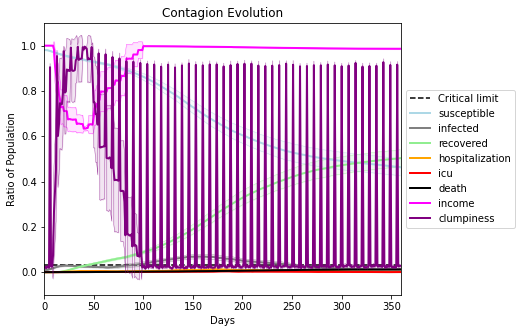

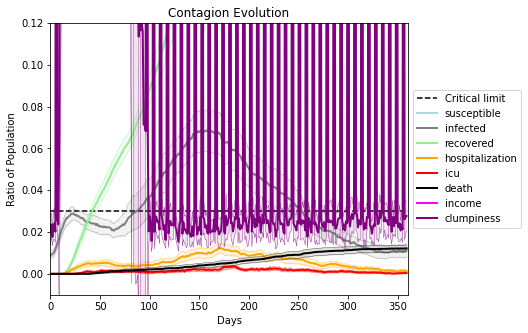

In [38]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.3
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6711, 5309, 5614, 9859, 6656, 3220, 5846, 2577, 1312, 8712, 9946, 4330, 9837, 1809, 80, 3093, 6459, 9539, 515, 2319]
Average similarity between family members is 0.1404093868505892 at temperature -0.2
Average similarity between family and home is 0.9998603227730147 at temperature -1
Average similarity between students and their classroom is 0.180172214482944 at temperature -0.2
Average classroom occupancy is 4.414285714285715 and number classrooms is 70
Average similarity between workers is 0.1457614840646205 at temperature -0.2
Average office occupancy is 3.268041237113402 and number offices is 194
Average friend similarity for adults: 0.2052205105692781 for kids: 0.19438457046937088
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogen

avg restaurant similarity 0.08065678621987794
avg restaurant similarity 0.21950062936360862
avg restaurant similarity 0.12275761535014285
avg restaurant similarity 0.11297162058338671
avg restaurant similarity 0.06427140149705997
avg restaurant similarity 0.2396603320557694
avg restaurant similarity 0.16532499347307186
avg restaurant similarity 0.07270563338568375
avg restaurant similarity 0.0952889185481445
avg restaurant similarity -0.15074337261818782
avg restaurant similarity 0.18020289936341566
avg restaurant similarity 0.4138567469384532
avg restaurant similarity 0.14530871770569506
avg restaurant similarity -0.1854778450864558
avg restaurant similarity 0.1777349496104358
avg restaurant similarity 0.08812609036239073
avg restaurant similarity -0.06564245670035428
avg restaurant similarity -0.17780298590076998
avg restaurant similarity 0.002334278108014523
avg restaurant similarity 0.26829332364442426
avg restaurant similarity -0.14300929261698564
avg restaurant similarity 0.08433

avg restaurant similarity 0.30140797952848125
avg restaurant similarity 0.05666075601944807
avg restaurant similarity 0.21900595750428528
avg restaurant similarity 0.22889556947380912
avg restaurant similarity 0.12283718201486493
avg restaurant similarity 0.03669111742916458
avg restaurant similarity 0.10791380303536145
avg restaurant similarity 0.08686034101819405
avg restaurant similarity 0.07008764085045337
avg restaurant similarity 0.057956542383994
avg restaurant similarity 0.01855596922921804
avg restaurant similarity 0.184851208978094
avg restaurant similarity 0.31321567719943005
avg restaurant similarity 0.006208265504466844
avg restaurant similarity -0.05947119280348746
avg restaurant similarity 0.07124420415006835
avg restaurant similarity 0.04095657461251435
avg restaurant similarity -0.1567354026427998
avg restaurant similarity 0.1490744134467074
avg restaurant similarity 0.2680333561258653
avg restaurant similarity -0.06765141540691194
avg restaurant similarity 0.177433503

avg restaurant similarity 0.11250582275790189
avg restaurant similarity 0.23338603871346095
avg restaurant similarity 0.16665293835965186
avg restaurant similarity 0.11768178714554621
avg restaurant similarity 0.1530032787854824
avg restaurant similarity 0.3478685362067964
avg restaurant similarity 0.11159377433442458
avg restaurant similarity 0.014210400660885072
avg restaurant similarity 0.09809867199797609
avg restaurant similarity 0.1332579424088292
avg restaurant similarity 0.025145168169998566
avg restaurant similarity 0.10294478386526831
avg restaurant similarity 0.22898520077853354
avg restaurant similarity 0.11040006035820589
avg restaurant similarity 0.0900146032078406
avg restaurant similarity 0.2441160022280049
avg restaurant similarity 0.05110940626975191
avg restaurant similarity 0.2704844785117076
avg restaurant similarity 0.20780199049202572
avg restaurant similarity 0.22266295522694568
avg restaurant similarity 0.5929397398826094
avg restaurant similarity 0.00797445157

avg restaurant similarity 0.1353793168333321
avg restaurant similarity 0.2950589319497049
avg restaurant similarity 0.08045877228689366
avg restaurant similarity 0.24675176566114637
avg restaurant similarity 0.06999888603024405
avg restaurant similarity 0.17752830571701878
avg restaurant similarity 0.0052056861350444185
avg restaurant similarity 0.04110471270211379
avg restaurant similarity 0.15573218396307187
avg restaurant similarity 0.154718571498281
avg restaurant similarity 0.11951171195453521
avg restaurant similarity 0.2142652491950383
avg restaurant similarity 0.23773021906487254
avg restaurant similarity 0.040527303121515576
avg restaurant similarity 0.09245206160087319
avg restaurant similarity 0.24163125193189797
avg restaurant similarity 0.1349320339432446
avg restaurant similarity 0.06555667205177886
avg restaurant similarity 0.17595144053828063
avg restaurant similarity 0.04959263892077198
avg restaurant similarity 0.1613970741999281
avg restaurant similarity 0.1496038945

avg restaurant similarity 0.21576506753505795
avg restaurant similarity -0.08381623133097638
avg restaurant similarity 0.13506877507719015
avg restaurant similarity 0.11017042870455375
avg restaurant similarity 0.1093874056986699
avg restaurant similarity -0.16117799379905406
avg restaurant similarity -0.05937068116489936
avg restaurant similarity 0.007117831687941469
avg restaurant similarity 0.040240319378599065
avg restaurant similarity 0.019145221665578544
avg restaurant similarity 0.10468326652281275
avg restaurant similarity -0.06104407101474754
avg restaurant similarity -0.00889684754563237
avg restaurant similarity 0.09520717185452926
avg restaurant similarity 0.03429595789298572
avg restaurant similarity 0.04384406504661089
avg restaurant similarity 0.2904658789412158
avg restaurant similarity 0.08495825110720795
avg restaurant similarity 0.16343365033525112
avg restaurant similarity 0.09893318771433365
avg restaurant similarity 0.23752727898552797
avg restaurant similarity 0.

avg restaurant similarity 0.12205575818893287
avg restaurant similarity 0.11209242306106054
avg restaurant similarity 0.32227487738813043
avg restaurant similarity 0.1303935722086555
avg restaurant similarity 0.09596385240077064
avg restaurant similarity 0.022056487788817438
avg restaurant similarity 0.04353873669527997
avg restaurant similarity 0.20666003204820085
avg restaurant similarity 0.1569506525436638
avg restaurant similarity 0.11985980480840328
avg restaurant similarity 0.06451514746262907
avg restaurant similarity 0.07191729798626206
avg restaurant similarity 0.03411860493259006
avg restaurant similarity 0.11530818978370523
avg restaurant similarity 0.16028075779707687
avg restaurant similarity 0.1094601241556597
avg restaurant similarity 0.17245306089122303
avg restaurant similarity 0.12489920262278766
avg restaurant similarity 0.06692974937760672
avg restaurant similarity 0.16687666079554953
avg restaurant similarity 0.12327221548317441
avg restaurant similarity 0.11419460

avg restaurant similarity -0.15519015361651628
avg restaurant similarity 0.08318268020243605
avg restaurant similarity -0.003239558129151716
avg restaurant similarity 0.1734535852025793
avg restaurant similarity 0.07365859831016948
avg restaurant similarity 0.04869243391469566
avg restaurant similarity 0.20565498652015268
avg restaurant similarity 0.11630179859224403
avg restaurant similarity 0.07540359390320812
avg restaurant similarity 0.14251022275903855
avg restaurant similarity -0.1537968533840919
avg restaurant similarity 0.26265668838090306
avg restaurant similarity 0.04729639843567225
avg restaurant similarity 0.1124604399350203
avg restaurant similarity 0.12403156009201101
avg restaurant similarity 0.09078134259599462
avg restaurant similarity 0.18369536338540768
avg restaurant similarity 0.09889267232074993
avg restaurant similarity 0.20494617121743927
avg restaurant similarity -0.0017248190414629661
avg restaurant similarity 0.1853012723567606
avg restaurant similarity 0.049

avg restaurant similarity 0.23734727925915616
avg restaurant similarity 0.3556098626597817
avg restaurant similarity 0.07078631266214783
avg restaurant similarity -0.13542607152631644
avg restaurant similarity 0.005413558585863101
avg restaurant similarity -0.11971427305388704
avg restaurant similarity -0.08356880917373337
avg restaurant similarity 0.43354770176581114
avg restaurant similarity 0.3630296336237075
avg restaurant similarity 0.09072730761779614
avg restaurant similarity -0.136448918708848
avg restaurant similarity 0.13118517873974478
avg restaurant similarity 0.14578786856297496
avg restaurant similarity 0.38474747988625907
avg restaurant similarity -0.06223891360164255
avg restaurant similarity 0.14694873455647853
avg restaurant similarity -0.12241519417885569
avg restaurant similarity -0.017334842467054336
avg restaurant similarity 0.05001607839637612
avg restaurant similarity -0.09264085201063466
avg restaurant similarity 0.07491169014934215
avg restaurant similarity -0

avg restaurant similarity 0.1328045490982749
avg restaurant similarity 0.13049002812430485
avg restaurant similarity -0.029040064212067423
avg restaurant similarity 0.3143080319473811
avg restaurant similarity 0.14304672234401522
avg restaurant similarity 0.12940733588402803
avg restaurant similarity -0.02133693328691976
avg restaurant similarity 0.11618998216093834
avg restaurant similarity 0.10571205134591649
avg restaurant similarity 0.06100267408813516
avg restaurant similarity 0.11093585629971181
avg restaurant similarity 0.08283332847939659
avg restaurant similarity 0.18531615579929714
avg restaurant similarity -0.0002728422226728755
avg restaurant similarity 0.1916042223331259
avg restaurant similarity 0.13838714944777747
avg restaurant similarity 0.26000763366630386
avg restaurant similarity 0.1654181428520166
avg restaurant similarity 0.4195301205570655
avg restaurant similarity 0.2146898505194226
avg restaurant similarity 0.21128206603422
avg restaurant similarity 0.098938292

avg restaurant similarity 0.06554976932310023
avg restaurant similarity 0.027800291424288318
avg restaurant similarity 0.15223579825093428
avg restaurant similarity 0.20838631106994865
avg restaurant similarity 0.2172576784149504
avg restaurant similarity 0.1705912180789282
avg restaurant similarity 0.13054855498952123
avg restaurant similarity 0.07137588570696697
avg restaurant similarity 0.028839623206423446
avg restaurant similarity 0.03865874538983248
avg restaurant similarity 0.5573667443638014
avg restaurant similarity 0.013218254590108969
avg restaurant similarity 0.2981355850693937
avg restaurant similarity 0.3438442062039955
avg restaurant similarity 0.07571633129970269
avg restaurant similarity 0.009726950000917185
avg restaurant similarity -0.008794384353502436
avg restaurant similarity 0.0613193178689793
avg restaurant similarity 0.20950634074271063
avg restaurant similarity -0.010975097843348004
avg restaurant similarity 0.19489818060646083
avg restaurant similarity 0.0199

avg restaurant similarity 0.25368000422759857
avg restaurant similarity 0.2360767942772251
avg restaurant similarity 0.2005584481163151
avg restaurant similarity -0.030972478686145388
avg restaurant similarity 0.12037549284884046
avg restaurant similarity 0.08367722004962146
avg restaurant similarity 0.2062695156278057
avg restaurant similarity 0.1603852700235148
avg restaurant similarity 0.13410772754801845
avg restaurant similarity 0.21439566919949923
avg restaurant similarity 0.3361141761264931
avg restaurant similarity 0.136838773692785
avg restaurant similarity 0.191728012795253
avg restaurant similarity 0.09701009013638077
avg restaurant similarity 0.13938208563680615
avg restaurant similarity 0.058085271088839846
avg restaurant similarity 0.052874922559466575
avg restaurant similarity 0.026563300254005193
avg restaurant similarity 0.07966721055945655
avg restaurant similarity 0.4281565180480789
avg restaurant similarity 0.2689996714064208
avg restaurant similarity 0.216206128068

avg restaurant similarity 0.13935746763379248
avg restaurant similarity 0.23650441768391225
avg restaurant similarity 0.031106537413840184
avg restaurant similarity 0.03376529238305779
avg restaurant similarity 0.03551558839110864
avg restaurant similarity 0.10054537540673407
avg restaurant similarity 0.06405419950487165
avg restaurant similarity 0.07310567607278212
avg restaurant similarity 0.11223460889150877
avg restaurant similarity 0.3119292851776623
avg restaurant similarity 0.1567639581451485
avg restaurant similarity 0.06267605610698097
avg restaurant similarity 0.2250469096114594
avg restaurant similarity 0.2702926546700712
avg restaurant similarity 0.05286327965543049
avg restaurant similarity 0.17236915231511504
avg restaurant similarity 0.20958915509433051
avg restaurant similarity 0.2628294781494638
avg restaurant similarity 0.15694457756932673
avg restaurant similarity 0.16679167463034825
avg restaurant similarity 0.1558070477423436
avg restaurant similarity 0.07959425975

avg restaurant similarity 0.10448885765590528
avg restaurant similarity 0.10363878295921024
avg restaurant similarity 0.07422489756184023
avg restaurant similarity 0.1541486103500263
avg restaurant similarity 0.05694667127974091
avg restaurant similarity 0.445952041234403
avg restaurant similarity 0.02605400075042427
avg restaurant similarity 0.18963101360977125
avg restaurant similarity 0.19582217025413465
avg restaurant similarity 0.2432167131525752
avg restaurant similarity 0.0752917989636672
avg restaurant similarity 0.21109275322658547
avg restaurant similarity 0.01582169246283041
avg restaurant similarity 0.20091187543197908
avg restaurant similarity -0.1902542861500508
avg restaurant similarity 0.25119861765865703
avg restaurant similarity 0.13002828851086562
avg restaurant similarity 0.12637390151291647
avg restaurant similarity 0.24361366405905177
avg restaurant similarity 0.05736094625559563
avg restaurant similarity -0.029457979120186807
avg restaurant similarity -0.05961537

avg restaurant similarity 0.060581752229320614
avg restaurant similarity -0.0599643432528941
avg restaurant similarity 0.02233096405741158
avg restaurant similarity 0.02700605628392531
avg restaurant similarity -0.022029912932329684
avg restaurant similarity 0.17566092173510112
avg restaurant similarity 0.24108862472618617
avg restaurant similarity 0.23182387544521751
avg restaurant similarity 0.14304245436483312
avg restaurant similarity 0.23217939203397042
avg restaurant similarity 0.06994164018656401
avg restaurant similarity 0.05358755733542381
avg restaurant similarity 0.21446760979717158
avg restaurant similarity 0.21739490367513495
avg restaurant similarity 0.21409429402800628
avg restaurant similarity -0.10042806921871975
avg restaurant similarity 0.03534493462374576
avg restaurant similarity 0.19460551645109492
avg restaurant similarity 0.07732797596352083
avg restaurant similarity 0.18505144194765638
avg restaurant similarity 0.22935509247457908
avg restaurant similarity 0.25

avg restaurant similarity 0.19958346623234194
avg restaurant similarity 0.0544254607260133
avg restaurant similarity 0.001638502038656564
avg restaurant similarity 0.11818360905415207
avg restaurant similarity 0.2175831554674027
avg restaurant similarity 0.09868020301513246
avg restaurant similarity -0.005178439691537428
avg restaurant similarity 0.043675038685197384
avg restaurant similarity 0.005573445724597832
avg restaurant similarity -0.06107536549540199
avg restaurant similarity 0.05648074162718044
avg restaurant similarity -0.1481820509478899
avg restaurant similarity -0.12646836123804006
avg restaurant similarity 0.15606339690374513
avg restaurant similarity 0.16403820606112646
avg restaurant similarity 0.14607252304547894
avg restaurant similarity 0.22138881401679214
avg restaurant similarity 0.13914675812088687
avg restaurant similarity 0.4032582059623553
avg restaurant similarity 0.011995776964484731
avg restaurant similarity 0.1330714819266861
avg restaurant similarity -0.0

avg restaurant similarity 0.19955940576951015
avg restaurant similarity 0.41091428638077393
avg restaurant similarity -0.07058157984661645
avg restaurant similarity 0.0006801101680694276
avg restaurant similarity -0.051400346639610704
avg restaurant similarity 0.09778574842360217
avg restaurant similarity -0.04658929587106313
avg restaurant similarity 0.20474465362808045
avg restaurant similarity 0.024937447605549033
avg restaurant similarity 0.14028222026811432
avg restaurant similarity 0.20510516604478876
avg restaurant similarity 0.274415278125009
avg restaurant similarity -0.008740642348571623
avg restaurant similarity 0.07021790232634209
avg restaurant similarity 0.047957967419567565
avg restaurant similarity 0.10044870366044134
avg restaurant similarity 0.0172395636390089
avg restaurant similarity 0.09954245578417982
avg restaurant similarity 0.10739789801816618
avg restaurant similarity 0.29509291444191366
avg restaurant similarity -0.08209481324158557
avg restaurant similarity 

avg restaurant similarity -0.033764714738311136
avg restaurant similarity 0.03577639881504373
avg restaurant similarity 0.1213710079687693
avg restaurant similarity -0.09805315492087797
avg restaurant similarity 0.09704167771696129
avg restaurant similarity -0.10060525655786476
avg restaurant similarity 0.10468290806182376
avg restaurant similarity 0.22153336865821432
avg restaurant similarity 0.2806148137193079
avg restaurant similarity 0.037824312238910286
avg restaurant similarity -0.05075920625841244
avg restaurant similarity 0.039494306992804186
avg restaurant similarity 0.08557970818777422
avg restaurant similarity -0.12309414219394872
avg restaurant similarity 0.15444912465784197
avg restaurant similarity -0.023061129122146723
avg restaurant similarity 0.1610199891217182
avg restaurant similarity -0.007359284266712909
avg restaurant similarity 0.12725937522086364
avg restaurant similarity 0.01372354067238006
avg restaurant similarity -0.15079690321125344
avg restaurant similarit

avg restaurant similarity -0.15799192694904338
avg restaurant similarity 0.17126835281240727
avg restaurant similarity -0.24922369546455636
avg restaurant similarity -0.002194363827179066
avg restaurant similarity 0.2272319439219348
avg restaurant similarity -0.14363126216749625
avg restaurant similarity -0.1322700261067335
avg restaurant similarity 0.11196143547077583
avg restaurant similarity 0.10153174329917673
avg restaurant similarity -0.10616133665687595
avg restaurant similarity 0.3293089803341537
avg restaurant similarity 0.0017656277066861402
avg restaurant similarity -0.10677473086791067
avg restaurant similarity 0.13466101123407725
avg restaurant similarity 0.14762896546508042
avg restaurant similarity 0.11924143850011196
avg restaurant similarity 0.16210761416571765
avg restaurant similarity 0.17066110724434122
avg restaurant similarity -0.0447988375651991
avg restaurant similarity -0.018303673583868498
avg restaurant similarity -0.011043441027492218
avg restaurant similari

avg restaurant similarity -0.18810785218211706
avg restaurant similarity 0.16455322629793
avg restaurant similarity 0.10153492441464106
avg restaurant similarity 0.032498143719263024
avg restaurant similarity 0.14464903142652016
avg restaurant similarity 0.08602412134216961
avg restaurant similarity 0.1002300414942974
avg restaurant similarity -0.016269582631921256
avg restaurant similarity 0.0656054116426968
avg restaurant similarity 0.1589586645959218
avg restaurant similarity 0.12201333397148513
avg restaurant similarity 0.07864077442514472
avg restaurant similarity -0.04227678801419968
avg restaurant similarity 0.004052509802260888
avg restaurant similarity 0.0843896519907041
avg restaurant similarity 0.06035090656920788
avg restaurant similarity 0.06114902046824994
avg restaurant similarity -0.04212796246261699
avg restaurant similarity 0.1416504721957034
avg restaurant similarity 0.2526280709548108
avg restaurant similarity 0.15650546567157994
avg restaurant similarity 0.33821378

avg restaurant similarity 0.7080974745248856
avg restaurant similarity -0.048313331785015165
avg restaurant similarity 0.08313249761958212
avg restaurant similarity 0.2183717459451121
avg restaurant similarity 0.05821822424741276
avg restaurant similarity 0.19097144666725108
avg restaurant similarity 0.0880500616773059
avg restaurant similarity 0.1193313936471023
avg restaurant similarity 0.1528142476093552
avg restaurant similarity 0.364803543321617
avg restaurant similarity 0.14175456838443515
avg restaurant similarity -0.07501964503889372
avg restaurant similarity 0.01092473507374456
avg restaurant similarity -0.2268471268811149
avg restaurant similarity -0.05911941190911232
avg restaurant similarity -0.16141793438115482
avg restaurant similarity 0.021171161076293316
avg restaurant similarity -0.1550713567088862
avg restaurant similarity 0.17052059379262563
avg restaurant similarity 0.21271142298878196
avg restaurant similarity 0.10850698802013382
avg restaurant similarity 0.0292116

avg restaurant similarity 0.15425801599418126
avg restaurant similarity 0.005313244632849573
avg restaurant similarity 0.07074225485733894
avg restaurant similarity -0.079980411094612
avg restaurant similarity -0.002643975233758111
avg restaurant similarity 0.28412743648760147
avg restaurant similarity 0.20569289850673178
avg restaurant similarity -0.13638839817849083
avg restaurant similarity 0.15311165300780957
avg restaurant similarity 0.173030367630295
avg restaurant similarity 0.24450550942422233
avg restaurant similarity 0.15518869187708217
avg restaurant similarity 0.08169695853758217
avg restaurant similarity -0.18169559098688834
avg restaurant similarity 0.10957018577004556
avg restaurant similarity -0.11755786563514044
avg restaurant similarity -0.003311465449416105
avg restaurant similarity 0.07771507856823684
avg restaurant similarity 0.017950251888931557
avg restaurant similarity 0.12214613083942029
avg restaurant similarity 0.09820268931205028
avg restaurant similarity 0.

avg restaurant similarity 0.06104683629598421
avg restaurant similarity 0.034148113900655266
avg restaurant similarity 0.12983698761202067
avg restaurant similarity -0.036847840205591426
avg restaurant similarity -0.11576212624594776
avg restaurant similarity 0.19714426239900618
avg restaurant similarity 0.01102188374601879
avg restaurant similarity -0.050636179821746806
avg restaurant similarity -0.027752200110846663
avg restaurant similarity 0.029804618524994768
avg restaurant similarity 0.32436342519774114
avg restaurant similarity 0.16623658790146242
avg restaurant similarity 0.1217214943528696
avg restaurant similarity 0.061397622881919155
avg restaurant similarity 0.04397495851774422
avg restaurant similarity 0.14081336958249868
avg restaurant similarity 0.02193139055141859
avg restaurant similarity -0.09984765232504443
avg restaurant similarity 0.2712887251205869
avg restaurant similarity 0.10287195123645558
avg restaurant similarity 0.12073525905214413
avg restaurant similarity

avg restaurant similarity 0.04034703205049771
avg restaurant similarity -0.1024994045443927
avg restaurant similarity 0.13676614408418036
avg restaurant similarity -0.18827161791092314
avg restaurant similarity 0.1709952051005124
avg restaurant similarity -0.32867057005873207
avg restaurant similarity -0.04262573789629004
avg restaurant similarity 0.030855349306579877
avg restaurant similarity 0.12662092022860932
avg restaurant similarity 0.10771536307258268
avg restaurant similarity 0.05429439252858484
avg restaurant similarity 0.07548824443953303
avg restaurant similarity 0.11632138137790592
avg restaurant similarity 0.12745016590099692
avg restaurant similarity -0.05808066252217078
avg restaurant similarity 0.21526999059952368
avg restaurant similarity -0.007211258733736615
avg restaurant similarity 0.11639090723587307
avg restaurant similarity 0.1757376638702583
avg restaurant similarity 0.05738267735845224
avg restaurant similarity -0.09083346609138256
avg restaurant similarity -0

avg restaurant similarity -0.011122298696743485
avg restaurant similarity 0.03932397249260389
avg restaurant similarity -0.03827044923331179
avg restaurant similarity -0.3244925202129628
avg restaurant similarity -0.09118790090123498
avg restaurant similarity -0.007875546627330546
avg restaurant similarity 0.17531564318526904
avg restaurant similarity 0.23016995457114459
avg restaurant similarity 0.06993256434420932
avg restaurant similarity 0.16211660571599726
avg restaurant similarity 0.11260465801369172
avg restaurant similarity -0.06042692527424311
avg restaurant similarity 0.11943170126095827
avg restaurant similarity -0.02777949010121169
avg restaurant similarity -0.10828514468877884
avg restaurant similarity 0.021229560243892415
avg restaurant similarity -0.1198263590528964
avg restaurant similarity -0.07344303714987468
avg restaurant similarity 0.08281889225132694
avg restaurant similarity -0.056134520699592384
avg restaurant similarity 0.035750119528113584
avg restaurant simil

avg restaurant similarity 0.03555196285187059
avg restaurant similarity 0.013248775151769646
avg restaurant similarity 0.12981724615011234
avg restaurant similarity 0.1296774797218612
avg restaurant similarity -0.053102009487746696
avg restaurant similarity 0.0736154494580695
avg restaurant similarity 0.08357370732636915
avg restaurant similarity -0.012539873543488914
avg restaurant similarity -0.03873284444380406
avg restaurant similarity 0.13254718632718948
avg restaurant similarity 0.06104454811834026
avg restaurant similarity -0.09139763875849835
avg restaurant similarity 0.009435978361804393
avg restaurant similarity 0.17152378680590116
avg restaurant similarity 0.12654838191570186
avg restaurant similarity 0.020223258807184022
avg restaurant similarity 0.17936202529294717
avg restaurant similarity 0.10482597451839196
avg restaurant similarity -0.12349562935530664
avg restaurant similarity -0.031078242590841215
avg restaurant similarity 0.217461365581932
avg restaurant similarity 

avg restaurant similarity 0.10858162195571143
avg restaurant similarity 0.22386026657022431
avg restaurant similarity -0.21544425304404122
avg restaurant similarity 0.03893303790245874
avg restaurant similarity 0.10632743421020943
avg restaurant similarity -0.10318308733011712
avg restaurant similarity 0.008525732934967252
avg restaurant similarity -0.009959164420676752
avg restaurant similarity 0.1912521187650702
avg restaurant similarity -0.02735608518866635
avg restaurant similarity -0.09285483697458968
avg restaurant similarity -0.041348524588435236
avg restaurant similarity -0.13447563407943758
avg restaurant similarity 0.028657939015264776
avg restaurant similarity -0.030071906394255943
avg restaurant similarity 0.011031346424321391
avg restaurant similarity 0.08519094561434369
avg restaurant similarity -0.04322259189941147
avg restaurant similarity 0.00048350198867786837
avg restaurant similarity 0.13713091311537243
avg restaurant similarity 0.06271483803771921
avg restaurant si

avg restaurant similarity 0.05868647032826252
avg restaurant similarity 0.2202078159844457
avg restaurant similarity -0.007081446018296705
avg restaurant similarity 0.24969939243678335
avg restaurant similarity 0.2777893490844737
avg restaurant similarity 0.18827176835150244
avg restaurant similarity -0.00986942972069075
avg restaurant similarity 0.1218044239558242
avg restaurant similarity 0.0024532297872469303
avg restaurant similarity 0.013154407080046596
avg restaurant similarity -0.029142569763187298
avg restaurant similarity 0.0982567059778447
avg restaurant similarity 0.15680241711865525
avg restaurant similarity 0.11904151190887062
avg restaurant similarity 0.21624746856632546
avg restaurant similarity 0.06459381547940411
avg restaurant similarity 0.15535650179423405
avg restaurant similarity 0.10723992118132611
avg restaurant similarity 0.01357352079469806
avg restaurant similarity 0.148634979352515
avg restaurant similarity -0.1392045834195183
avg restaurant similarity 0.0849

avg restaurant similarity -0.013305830659472051
avg restaurant similarity 0.16810377471095334
avg restaurant similarity 0.06516390851073155
avg restaurant similarity 0.12819950340309794
avg restaurant similarity -0.10365116805538947
avg restaurant similarity 0.0821632055226207
avg restaurant similarity 0.22937047451656803
avg restaurant similarity 0.16511201922670066
avg restaurant similarity -0.019770259967039502
avg restaurant similarity -0.035165084498333755
avg restaurant similarity -0.13942727617323095
avg restaurant similarity 0.3303797806684518
avg restaurant similarity 0.08104976376141752
avg restaurant similarity 0.019386948605174023
avg restaurant similarity 0.06515741110293208
avg restaurant similarity 0.16884676921122266
avg restaurant similarity 0.04424939247459415
avg restaurant similarity 0.5304726856671431
avg restaurant similarity 0.15125329184908834
avg restaurant similarity -0.033246788839357645
avg restaurant similarity -0.03707552168959518
avg restaurant similarity

avg restaurant similarity 0.07646467951542218
avg restaurant similarity -0.022366906886250947
avg restaurant similarity 0.07628163606428524
avg restaurant similarity 0.24882029769983877
avg restaurant similarity -0.2157880955073217
avg restaurant similarity -0.0448682442174628
avg restaurant similarity 0.06887497865123289
avg restaurant similarity -0.03454211130444246
avg restaurant similarity 0.15586357678798637
avg restaurant similarity 0.1035085962287884
avg restaurant similarity -0.137461187645959
avg restaurant similarity 0.24614436121942448
avg restaurant similarity 0.1112160010419317
avg restaurant similarity -0.029401038513793488
avg restaurant similarity 0.0545310398997382
avg restaurant similarity -0.05521220165741745
avg restaurant similarity 0.09986209748076798
avg restaurant similarity 0.1647374274045084
avg restaurant similarity 0.10954360779761067
avg restaurant similarity 0.007143712243028665
avg restaurant similarity 0.2026426399086676
avg restaurant similarity -0.0310

avg restaurant similarity 0.03454195979781609
avg restaurant similarity 0.0404353005232668
avg restaurant similarity -0.09072446462723571
avg restaurant similarity 0.17237348239672254
avg restaurant similarity 0.05975925375933809
avg restaurant similarity 0.12915108754544455
avg restaurant similarity 0.07585988358466629
avg restaurant similarity 0.24387638006977091
avg restaurant similarity 0.06517257765187617
avg restaurant similarity 0.03872572471582435
avg restaurant similarity -0.03160940420931143
avg restaurant similarity 0.07872847968730666
avg restaurant similarity 0.12342442550112034
avg restaurant similarity 0.052722975695476064
avg restaurant similarity 0.1716967189643735
avg restaurant similarity 0.24085046763187967
avg restaurant similarity -0.11589234665458993
avg restaurant similarity -0.14694153847240096
avg restaurant similarity 0.1728349788740614
avg restaurant similarity 0.04676399439765799
avg restaurant similarity 0.2594526156283609
avg restaurant similarity 0.19413

avg restaurant similarity 0.1964447873080918
avg restaurant similarity 0.003056519735998454
avg restaurant similarity 0.0663728376718711
avg restaurant similarity -0.10970934017055073
avg restaurant similarity 0.1877732870807585
avg restaurant similarity 0.22078599194853218
avg restaurant similarity 0.1681399846054309
avg restaurant similarity 0.11161431708731058
avg restaurant similarity 0.06367360502402632
avg restaurant similarity -0.0017393111410245465
avg restaurant similarity 0.1505531837766836
avg restaurant similarity 0.1423929642726298
avg restaurant similarity 0.08957660193043068
avg restaurant similarity -0.024469876440401002
avg restaurant similarity 0.12093046953293277
avg restaurant similarity 0.15257226628770762
avg restaurant similarity 0.09510086061399174
avg restaurant similarity 0.19760718100504002
avg restaurant similarity 0.0479960676222279
avg restaurant similarity 0.05094349063256455
avg restaurant similarity 0.03983317867701732
avg restaurant similarity -0.08740

avg restaurant similarity 0.18574535968504496
avg restaurant similarity -0.1265458377753724
avg restaurant similarity -0.024653926097817625
avg restaurant similarity -0.05750167746798591
avg restaurant similarity 0.19850035374501632
avg restaurant similarity 0.10740207071980154
avg restaurant similarity 0.1436768722920574
avg restaurant similarity 0.07347811475720809
avg restaurant similarity 0.04798711027004657
avg restaurant similarity -0.08067756664505697
avg restaurant similarity 0.049855623635406354
avg restaurant similarity 0.13446886338868805
avg restaurant similarity 0.024087654563544707
avg restaurant similarity 0.14298880710498402
avg restaurant similarity 0.20391084561492187
avg restaurant similarity 0.008128093510727954
avg restaurant similarity -0.18145696198396383
avg restaurant similarity 0.15951486538814946
avg restaurant similarity -0.055104116277500836
avg restaurant similarity 0.17637864321274865
avg restaurant similarity 0.07588971109855633
avg restaurant similarity

avg restaurant similarity 0.026643382397959638
avg restaurant similarity 0.16862990521848598
avg restaurant similarity 0.10823901826975742
avg restaurant similarity 0.06041718543819083
avg restaurant similarity 0.15110451441700126
avg restaurant similarity -0.1858413565525792
avg restaurant similarity 0.06357374461781483
avg restaurant similarity 0.01814455979983592
avg restaurant similarity 0.09901136320188168
avg restaurant similarity 0.16337125104684375
avg restaurant similarity 0.3695092034599888
avg restaurant similarity 0.029880324228520355
avg restaurant similarity 0.010720882841147214
avg restaurant similarity 0.16593846576328017
avg restaurant similarity 0.00032529566211727195
avg restaurant similarity -0.035691390895255956
avg restaurant similarity 0.03475912470187028
avg restaurant similarity 0.027865782896399294
avg restaurant similarity 0.12166290016809217
avg restaurant similarity -0.07307643024049695
avg restaurant similarity 0.059226505851320006
avg restaurant similarit

avg restaurant similarity 0.015234551278228658
avg restaurant similarity 0.10949842275647184
avg restaurant similarity 0.18185887925005592
avg restaurant similarity 0.01426492545632461
avg restaurant similarity -0.030143193367161272
avg restaurant similarity -0.020402109929946306
avg restaurant similarity 0.07631088152861533
avg restaurant similarity 0.1206918137998742
avg restaurant similarity 0.11823592755247646
avg restaurant similarity 0.0892577141465677
avg restaurant similarity 0.18414126135634132
avg restaurant similarity 0.5468911890912406
avg restaurant similarity -0.028425489780516525
avg restaurant similarity 0.1832453042669195
avg restaurant similarity -0.11629836505211695
avg restaurant similarity -0.07233659261550598
avg restaurant similarity 0.10718161523805544
avg restaurant similarity 0.07755069727097096
avg restaurant similarity 0.16140524906857937
avg restaurant similarity -0.016648830718640296
avg restaurant similarity 0.03735115063584526
avg restaurant similarity -

avg restaurant similarity 0.05519542676768303
avg restaurant similarity 0.10157161084827825
avg restaurant similarity 0.06718777631169284
avg restaurant similarity 0.5024666501120107
avg restaurant similarity 0.24374074666047957
avg restaurant similarity -0.013789798091218797
avg restaurant similarity 0.06017549297146483
avg restaurant similarity 0.1431138648119304
avg restaurant similarity 0.045129241603413715
avg restaurant similarity 0.10728843875321828
avg restaurant similarity 0.14763109182682163
avg restaurant similarity 0.12212578858163009
avg restaurant similarity 0.07126390993168018
avg restaurant similarity -0.09087050248285385
avg restaurant similarity -0.12117946882034093
avg restaurant similarity 0.024637609358610004
avg restaurant similarity -0.02156041390350556
avg restaurant similarity 0.08796674321567836
avg restaurant similarity 0.2167061481973664
avg restaurant similarity 0.13582183189340008
avg restaurant similarity 0.04859063580963007
avg restaurant similarity -0.0

avg restaurant similarity 0.025409220616508483
avg restaurant similarity 0.06147463074895193
avg restaurant similarity -0.008751381619970869
avg restaurant similarity -0.2945769320030547
avg restaurant similarity -0.1731485193790151
avg restaurant similarity 0.12464664780843963
avg restaurant similarity -0.043332465695500054
avg restaurant similarity -0.023046313633330706
avg restaurant similarity 0.08893576624182778
avg restaurant similarity 0.020845417933032462
avg restaurant similarity 0.09890894459817445
avg restaurant similarity 0.2449795171623061
avg restaurant similarity 0.16912197750563818
avg restaurant similarity 0.07392842030844841
avg restaurant similarity 0.0803549325358074
avg restaurant similarity -0.0765371121643206
avg restaurant similarity 0.2074057129515543
avg restaurant similarity -0.038770462533104524
avg restaurant similarity -0.026690923532863706
avg restaurant similarity -0.18637967648099257
avg restaurant similarity 0.13879489446604662
avg restaurant similarit

avg restaurant similarity 0.18569958777114356
avg restaurant similarity 0.18920445712236808
avg restaurant similarity 0.138436962717448
avg restaurant similarity 0.059641021360610925
avg restaurant similarity 0.35712895688464524
avg restaurant similarity 0.08262043799738379
avg restaurant similarity 0.02861273614452525
avg restaurant similarity 0.2181380821077908
avg restaurant similarity 0.15475839332744334
avg restaurant similarity 0.17161421537111649
avg restaurant similarity 0.11171645857569434
avg restaurant similarity 0.11678784152768265
avg restaurant similarity 0.19374913014031492
avg restaurant similarity 0.08144427535000358
avg restaurant similarity 0.05369587776981889
avg restaurant similarity -0.07329495689551127
avg restaurant similarity 0.09071628911415529
avg restaurant similarity 0.2009986682891841
avg restaurant similarity 0.21547240853918637
avg restaurant similarity 0.23085085177928977
avg restaurant similarity 0.11656970545213666
avg restaurant similarity 0.06534286

avg restaurant similarity 0.12563455937026619
avg restaurant similarity -0.14460188218654949
avg restaurant similarity 0.1953424780614072
avg restaurant similarity 0.09678934128423859
avg restaurant similarity 0.23937568769123715
avg restaurant similarity 0.38684754408518485
avg restaurant similarity 0.21485524142658363
avg restaurant similarity 0.13020359612853027
avg restaurant similarity 0.3193064954647109
avg restaurant similarity 0.1866865527311718
avg restaurant similarity 0.21123175785130507
avg restaurant similarity 0.010464346440598985
avg restaurant similarity -0.060834086171702696
avg restaurant similarity 0.01898888451637623
avg restaurant similarity 0.1347673818289534
avg restaurant similarity 0.07370599846807332
avg restaurant similarity 0.00620235200015127
avg restaurant similarity 0.12211056805292414
avg restaurant similarity -0.004078556279890138
avg restaurant similarity 0.07035570390833416
avg restaurant similarity -0.07950371413765601
avg restaurant similarity 0.197

avg restaurant similarity 0.22618906558002014
avg restaurant similarity 0.11260111020868473
avg restaurant similarity 0.12472654805913497
avg restaurant similarity 0.09961485465404805
avg restaurant similarity 0.16327758130506131
avg restaurant similarity -0.02690256111251657
avg restaurant similarity 0.24652468872318176
avg restaurant similarity 0.17073804191205513
avg restaurant similarity 0.1656850094800283
avg restaurant similarity 0.18324815690242502
avg restaurant similarity 0.02218919910550725
avg restaurant similarity 0.135120502134574
avg restaurant similarity 0.2951516416632186
avg restaurant similarity 0.18918743882843975
avg restaurant similarity 0.2584773255694271
avg restaurant similarity 0.1613252915790254
avg restaurant similarity -0.023912621846821525
avg restaurant similarity 0.039922860519453325
avg restaurant similarity 0.23690033315830558
avg restaurant similarity 0.07766136270699499
avg restaurant similarity 0.14399929723797023
avg restaurant similarity 0.02433089

avg restaurant similarity 0.11546041224291845
avg restaurant similarity 0.123961986328729
avg restaurant similarity 0.09457846894360125
avg restaurant similarity 0.15773842198225835
avg restaurant similarity 0.0339054558075266
avg restaurant similarity 0.06450082059513128
avg restaurant similarity -0.08028632348184006
avg restaurant similarity 0.02162834681608888
avg restaurant similarity 0.14969455755601196
avg restaurant similarity 0.0024035121199085683
avg restaurant similarity 0.13461226255667336
avg restaurant similarity 0.08148095219921178
avg restaurant similarity -0.010490736488064766
avg restaurant similarity -0.12753282874724836
avg restaurant similarity 0.15749568926854804
avg restaurant similarity 0.11425650686946888
avg restaurant similarity -0.06584919546302186
avg restaurant similarity -0.0212432713911192
avg restaurant similarity 0.18649685928552884
avg restaurant similarity 0.12328082942592239
avg restaurant similarity 0.08169128533120731
avg restaurant similarity 0.03

(<function dict.items>, <function dict.items>, <function dict.items>)

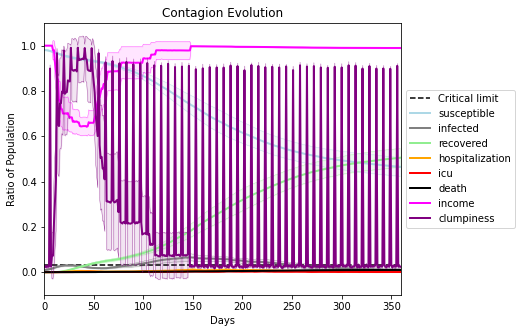

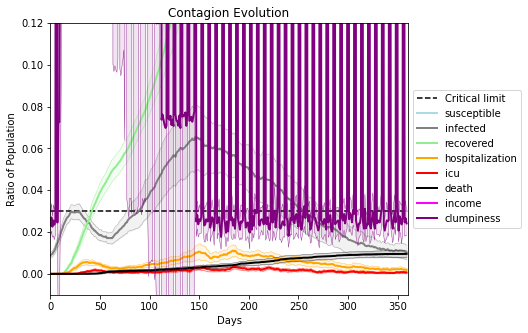

In [39]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.2
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5373, 7436, 5036, 8200, 2762, 1009, 2070, 3454, 8803, 4550, 6164, 3367, 4702, 3191, 7248, 2084, 268, 8556, 5004, 9671]
Average similarity between family members is 0.15757666017772534 at temperature -0.1
Average similarity between family and home is 0.9998469024684455 at temperature -1
Average similarity between students and their classroom is 0.13249764098012054 at temperature -0.1
Average classroom occupancy is 4.057142857142857 and number classrooms is 70
Average similarity between workers is 0.17694369846186528 at temperature -0.1
Average office occupancy is 3.175609756097561 and number offices is 205
Average friend similarity for adults: 0.21863114408438736 for kids: 0.2076901474509127
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.14544533673049875
avg restaurant similarity -0.06523475277010082
avg restaurant similarity 0.20349297133748864
avg restaurant similarity 0.31605579866231986
avg restaurant similarity 0.18676586230766776
avg restaurant similarity 0.2020732753281238
avg restaurant similarity -0.02440874493301449
avg restaurant similarity 0.2505606966906086
avg restaurant similarity -0.002007865632492838
avg restaurant similarity 0.16001015256326753
avg restaurant similarity 0.24590999070363978
avg restaurant similarity 0.03614714402485423
avg restaurant similarity -0.016305723258666614
avg restaurant similarity -0.015782138080998515
avg restaurant similarity -0.024421013767997636
avg restaurant similarity 0.13478073724960432
avg restaurant similarity 0.10726478219365188
avg restaurant similarity 0.0897341281939085
avg restaurant similarity 0.04180616161732533
avg restaurant similarity -0.030616472809425557
avg restaurant similarity 0.3380711248303086
avg restaurant similarity 

avg restaurant similarity 0.14689345004237062
avg restaurant similarity 0.12998562566308863
avg restaurant similarity 0.20853754913594907
avg restaurant similarity 0.18013408368247258
avg restaurant similarity 0.17004505770071962
avg restaurant similarity 0.010012117713006207
avg restaurant similarity 0.10751477892118182
avg restaurant similarity -0.028611368974971192
avg restaurant similarity 0.12076690080596314
avg restaurant similarity 0.046111402191635995
avg restaurant similarity 0.07072188528492875
avg restaurant similarity 0.21081681482000283
avg restaurant similarity 0.05740281015721033
avg restaurant similarity 0.04889809163451546
avg restaurant similarity 0.08074446189041914
avg restaurant similarity 0.19824405534983539
avg restaurant similarity -0.013453694481231682
avg restaurant similarity 0.12207771390313664
avg restaurant similarity 0.2680550541384487
avg restaurant similarity 0.12597808292050214
avg restaurant similarity 0.24762800841025429
avg restaurant similarity 0.1

avg restaurant similarity 0.22691354465194044
avg restaurant similarity 0.011610325616670539
avg restaurant similarity -0.08893532861843485
avg restaurant similarity 0.0789592005219362
avg restaurant similarity 0.08063300418583635
avg restaurant similarity 0.2971896723801004
avg restaurant similarity 0.009831882211974135
avg restaurant similarity 0.08742610764125187
avg restaurant similarity 0.16754271384953404
avg restaurant similarity 0.06298969445893021
avg restaurant similarity 0.106154403135919
avg restaurant similarity 0.0912719678091884
avg restaurant similarity -0.0027257799385927983
avg restaurant similarity 0.1593048978247064
avg restaurant similarity 0.1840773378979064
avg restaurant similarity 0.07547859762718383
avg restaurant similarity 0.14622056289688456
avg restaurant similarity 0.18142771463167806
avg restaurant similarity 0.1088399580753928
avg restaurant similarity 0.008147268141531137
avg restaurant similarity 0.11142116867857392
avg restaurant similarity 0.2035235

avg restaurant similarity -0.02040170841549939
avg restaurant similarity 0.10378520218351427
avg restaurant similarity 0.04450095560520589
avg restaurant similarity 0.07402486671891313
avg restaurant similarity 0.16674710816941793
avg restaurant similarity 0.13548851562414393
avg restaurant similarity 0.16399893763594484
avg restaurant similarity 0.16600795091589576
avg restaurant similarity 0.20257689244493307
avg restaurant similarity 0.15440088984469663
avg restaurant similarity 0.2091779563881346
avg restaurant similarity 0.21097656877875223
avg restaurant similarity 0.15944774662223998
avg restaurant similarity -0.04719247578352661
avg restaurant similarity 0.049103601342865795
avg restaurant similarity 0.2477075430905277
avg restaurant similarity 0.0523775773810905
avg restaurant similarity 0.05364537862924207
avg restaurant similarity 0.011919322148831879
avg restaurant similarity 0.2002841701785208
avg restaurant similarity 0.027529399593241122
avg restaurant similarity 0.02788

avg restaurant similarity 0.10146369545419354
avg restaurant similarity 0.29287996361660923
avg restaurant similarity 0.2390078551000101
avg restaurant similarity -0.031890314773276925
avg restaurant similarity 0.228630375036182
avg restaurant similarity -0.00864681431176843
avg restaurant similarity 0.18409234225588397
avg restaurant similarity 0.03203305373114491
avg restaurant similarity 0.1862026325813811
avg restaurant similarity 0.07046531876236885
avg restaurant similarity 0.050795796049163386
avg restaurant similarity 0.30733909150049565
avg restaurant similarity 0.23296306086210208
avg restaurant similarity 0.10223435912948241
avg restaurant similarity 0.07064909083562848
avg restaurant similarity 0.1957419275229595
avg restaurant similarity 0.27154966988561746
avg restaurant similarity 0.12684998866443717
avg restaurant similarity -0.02835567949008032
avg restaurant similarity 0.2890800473152301
avg restaurant similarity 0.06550771606190857
avg restaurant similarity -0.031371

avg restaurant similarity 0.15831385525929073
avg restaurant similarity 0.06253380313330516
avg restaurant similarity 0.012600471184486216
avg restaurant similarity 0.2200937039299027
avg restaurant similarity 0.028436943536759168
avg restaurant similarity -0.06406344716516331
avg restaurant similarity 0.045009078004253994
avg restaurant similarity 0.16332104651668836
avg restaurant similarity -0.03645338497343988
avg restaurant similarity 0.026226582355092364
avg restaurant similarity 0.42134667426281325
avg restaurant similarity -0.028992906492096838
avg restaurant similarity 0.1526432923778287
avg restaurant similarity -0.09855238514630049
avg restaurant similarity 0.09602391103724657
avg restaurant similarity 0.0876391618225028
avg restaurant similarity 0.11360040150387697
avg restaurant similarity 0.025711178658719552
avg restaurant similarity 0.10372355140762089
avg restaurant similarity -0.11156183819242506
avg restaurant similarity 0.24781580671587608
avg restaurant similarity 

avg restaurant similarity 0.359058866466776
avg restaurant similarity -0.22976424306227544
avg restaurant similarity 0.05927788683771418
avg restaurant similarity 0.08371073168078648
avg restaurant similarity 0.17234783028412778
avg restaurant similarity 0.049805334146557176
avg restaurant similarity 0.06973517118180665
avg restaurant similarity 0.16176039968639808
avg restaurant similarity 0.27251723133720435
avg restaurant similarity 0.16885532741654122
avg restaurant similarity -0.017855504165382893
avg restaurant similarity -0.0013219962886847718
avg restaurant similarity 0.07261131728595605
avg restaurant similarity 0.08225854737127859
avg restaurant similarity 0.09853157062369262
avg restaurant similarity 0.07399958891991401
avg restaurant similarity 0.1027332411648612
avg restaurant similarity 0.15156466921251527
avg restaurant similarity 0.20160641917627298
avg restaurant similarity -0.10042982352119785
avg restaurant similarity 0.007932343667126609
avg restaurant similarity -0

avg restaurant similarity 0.0848072458003641
avg restaurant similarity 0.0499485592818767
avg restaurant similarity -0.07388859292029436
avg restaurant similarity -0.12019726544681131
avg restaurant similarity 0.05923617431715317
avg restaurant similarity 0.004125274941789983
avg restaurant similarity 0.07081787990739481
avg restaurant similarity 0.008700570928396184
avg restaurant similarity 0.1466247589394169
avg restaurant similarity 0.12008446273533044
avg restaurant similarity -0.004925729177265303
avg restaurant similarity 0.14573211229337077
avg restaurant similarity 0.3721184292070855
avg restaurant similarity 0.0895240842082242
avg restaurant similarity 0.049295037616790785
avg restaurant similarity 0.15164896722716342
avg restaurant similarity 0.09632483278659265
avg restaurant similarity -0.045559445211129285
avg restaurant similarity 0.09360822447051795
avg restaurant similarity -0.012448828369476814
avg restaurant similarity -0.21521353343282715
avg restaurant similarity 0

avg restaurant similarity 0.14724879590854298
avg restaurant similarity -0.03156753061733553
avg restaurant similarity 0.21730169372407446
avg restaurant similarity -0.08713832484819287
avg restaurant similarity 0.20164026274223187
avg restaurant similarity 0.028796039650437293
avg restaurant similarity 0.20119535003438474
avg restaurant similarity 0.10312551482152545
avg restaurant similarity 0.12533726181080726
avg restaurant similarity 0.09457096766291047
avg restaurant similarity 0.02595253687879146
avg restaurant similarity 0.024106561415028448
avg restaurant similarity 0.3205362980321801
avg restaurant similarity 0.06852986465684255
avg restaurant similarity 0.4115864736127123
avg restaurant similarity 0.08170984597146623
avg restaurant similarity 0.059895096308102636
avg restaurant similarity 0.24028564471393818
avg restaurant similarity 0.047344808547782904
avg restaurant similarity 0.1438759659114005
avg restaurant similarity 0.30375520715889837
avg restaurant similarity 0.088

avg restaurant similarity -0.030461294333237788
avg restaurant similarity -0.0074741116821302744
avg restaurant similarity 0.04075056386962918
avg restaurant similarity 0.2749059301781761
avg restaurant similarity 0.19200311850876833
avg restaurant similarity 0.1264231036953925
avg restaurant similarity 0.2338149916777967
avg restaurant similarity 0.22163761523324832
avg restaurant similarity 0.2622311700459173
avg restaurant similarity 0.01855458125875588
avg restaurant similarity 0.49311214296997036
avg restaurant similarity 0.2385772160732544
avg restaurant similarity -0.02772180847678255
avg restaurant similarity 0.18250583072361498
avg restaurant similarity 0.16455099715508706
avg restaurant similarity 0.3370204439190014
avg restaurant similarity 0.20865817077002538
avg restaurant similarity 0.1807419075706793
avg restaurant similarity 0.1631764104233224
avg restaurant similarity -0.02642387824370359
avg restaurant similarity 0.3971716811548088
avg restaurant similarity 0.05380982

avg restaurant similarity 0.08983196563032037
avg restaurant similarity -0.01365549822665009
avg restaurant similarity 0.08692840925301959
avg restaurant similarity 0.1377657050799672
avg restaurant similarity -0.15595046897587045
avg restaurant similarity 0.12547049851276257
avg restaurant similarity -0.0951451282356705
avg restaurant similarity 0.07878692495784168
avg restaurant similarity 0.2380105617672782
avg restaurant similarity 0.07187663913698232
avg restaurant similarity -0.1286935493930458
avg restaurant similarity 0.2516273190262573
avg restaurant similarity 0.21802090471515018
avg restaurant similarity 0.08977616583924328
avg restaurant similarity -0.11939062398208557
avg restaurant similarity 0.19461118304243238
avg restaurant similarity -0.11345367369588348
avg restaurant similarity 0.16432828507037245
avg restaurant similarity 0.23068716769885608
avg restaurant similarity -0.01089904860737329
avg restaurant similarity 0.052128031254455254
avg restaurant similarity -0.06

avg restaurant similarity -0.01715103196836937
avg restaurant similarity 0.06481753991578647
avg restaurant similarity -0.032692164410039935
avg restaurant similarity 0.10250664316464905
avg restaurant similarity 0.05780728341241512
avg restaurant similarity 0.04980573018389768
avg restaurant similarity -0.015989284900917538
avg restaurant similarity 0.15057364288958403
avg restaurant similarity 0.0021741251495778283
avg restaurant similarity 0.02544525798967659
avg restaurant similarity -0.24360553577197983
avg restaurant similarity 0.13728259624133335
avg restaurant similarity 0.16817849010003333
avg restaurant similarity 0.06918035815105172
avg restaurant similarity -0.016390064724407277
avg restaurant similarity 0.03423466528304475
avg restaurant similarity 0.09753463623766463
avg restaurant similarity 0.005004558578111118
avg restaurant similarity -0.026197013286497466
avg restaurant similarity 0.04423878516526427
avg restaurant similarity -0.14997146581866802
avg restaurant simil

avg restaurant similarity 0.06311742497672887
avg restaurant similarity 0.07990897128742475
avg restaurant similarity 0.026472955936003382
avg restaurant similarity 0.002683081811496818
avg restaurant similarity 0.02933208675914809
avg restaurant similarity 0.021012828429423175
avg restaurant similarity 0.008927840877944761
avg restaurant similarity 0.02103727696137649
avg restaurant similarity 0.1922170780182867
avg restaurant similarity 0.13147366239293512
avg restaurant similarity 0.1639143541411181
avg restaurant similarity -0.01508993231100306
avg restaurant similarity 0.11648502646948414
avg restaurant similarity 0.12007151836421527
avg restaurant similarity 0.052698425406741904
avg restaurant similarity 0.11572564398901782
avg restaurant similarity 0.23487626618754925
avg restaurant similarity 0.09197589096653286
avg restaurant similarity -0.020614517349742012
avg restaurant similarity 0.10843316662517158
avg restaurant similarity 0.22764039630372707
avg restaurant similarity -0

avg restaurant similarity 0.183351826772549
avg restaurant similarity -0.15221872505266815
avg restaurant similarity 0.1338557635543153
avg restaurant similarity 0.0888852314559629
avg restaurant similarity 0.13467409678889444
avg restaurant similarity 0.08944640192773443
avg restaurant similarity 0.004754800458891803
avg restaurant similarity 0.13390690215942277
avg restaurant similarity -0.034980080474929995
avg restaurant similarity 0.11670320771920295
avg restaurant similarity 0.2599894135196043
avg restaurant similarity 0.06539138422259726
avg restaurant similarity 0.16782385269539216
avg restaurant similarity 0.18345437234584447
avg restaurant similarity -0.1298674220180326
avg restaurant similarity -0.199324418443664
avg restaurant similarity 0.09946051680406451
avg restaurant similarity 0.025679081535978053
avg restaurant similarity 0.029040239316348262
avg restaurant similarity 0.05536572846957518
avg restaurant similarity 0.11011390126633093
avg restaurant similarity 0.089309

avg restaurant similarity -0.010966201301512778
avg restaurant similarity 0.03397462705545309
avg restaurant similarity 0.12906531098718255
avg restaurant similarity 0.07764509701984465
avg restaurant similarity 0.026949326619777888
avg restaurant similarity 0.09616770315923968
avg restaurant similarity 0.10428508500432024
avg restaurant similarity 0.04544482440832894
avg restaurant similarity 0.06884032820380889
avg restaurant similarity -0.005107713966318531
avg restaurant similarity 0.037434842740746925
avg restaurant similarity 0.04569867250397852
avg restaurant similarity 0.015844235844424723
avg restaurant similarity 0.0864163000962943
avg restaurant similarity 0.07863530194290375
avg restaurant similarity 0.08028273040786836
avg restaurant similarity 0.15453243208688483
avg restaurant similarity 0.17081405608559497
avg restaurant similarity 0.15350927517712734
avg restaurant similarity 0.09997226003670866
avg restaurant similarity 0.029969116102313554
avg restaurant similarity 0

avg restaurant similarity -0.14698360029110238
avg restaurant similarity -0.04252532282075494
avg restaurant similarity 0.08399674628602893
avg restaurant similarity 0.0944124275878584
avg restaurant similarity -0.04796044996403153
avg restaurant similarity 0.0075078911652711544
avg restaurant similarity 0.03792213661171899
avg restaurant similarity -0.10640251488221625
avg restaurant similarity 0.015778188476592153
avg restaurant similarity 0.060755950536213264
avg restaurant similarity -0.0788938917601898
avg restaurant similarity 0.07086135333250491
avg restaurant similarity 0.1208106044335074
avg restaurant similarity 0.06751088068901206
avg restaurant similarity 0.056595005443440795
avg restaurant similarity 0.06656189386934697
avg restaurant similarity 0.03555618482310002
avg restaurant similarity 0.06777223906572082
avg restaurant similarity 0.05524379505395644
avg restaurant similarity -0.044796292529589055
avg restaurant similarity 0.03230668120065633
avg restaurant similarity

avg restaurant similarity -0.02195157194879991
avg restaurant similarity 0.1083270244927451
avg restaurant similarity 0.11093024988474891
avg restaurant similarity 0.11353414411483023
avg restaurant similarity 0.12611791507614115
avg restaurant similarity 0.004629533861591101
avg restaurant similarity 0.1845746852755316
avg restaurant similarity -0.027438908986096616
avg restaurant similarity 0.1415373850861171
avg restaurant similarity -0.02983612176528172
avg restaurant similarity -0.01516792673782979
avg restaurant similarity 0.16466495101111886
avg restaurant similarity 0.09111262984489436
avg restaurant similarity 0.0614894818462476
avg restaurant similarity -0.010312986556141426
avg restaurant similarity 0.005265779144189924
avg restaurant similarity 0.05475739224019259
avg restaurant similarity 0.10698334136152214
avg restaurant similarity 0.011304046914459163
avg restaurant similarity 0.04556566051713447
avg restaurant similarity -0.0435548561173192
avg restaurant similarity 0.

avg restaurant similarity 0.29278031023120293
avg restaurant similarity 0.0023542358039608416
avg restaurant similarity 0.12674972190784692
avg restaurant similarity -0.020515892374331702
avg restaurant similarity 0.11583873458977267
avg restaurant similarity 0.114769573386892
avg restaurant similarity -0.11436909565539513
avg restaurant similarity 0.0932052972015112
avg restaurant similarity 0.06146483490224797
avg restaurant similarity 0.10626119253037587
avg restaurant similarity 0.1023781147015523
avg restaurant similarity 0.07532214325198688
avg restaurant similarity 0.16996553527485941
avg restaurant similarity 0.1034186039635204
avg restaurant similarity 0.053630333838047266
avg restaurant similarity 0.392187738364897
avg restaurant similarity 0.10239260016959673
avg restaurant similarity 0.26284310542597317
avg restaurant similarity -0.0751986489658313
avg restaurant similarity -0.10300884850180922
avg restaurant similarity 0.04722986335550437
avg restaurant similarity 0.133182

avg restaurant similarity 0.1558839687492311
avg restaurant similarity 0.27658076543792637
avg restaurant similarity 0.19795618335826556
avg restaurant similarity -0.006430718918745762
avg restaurant similarity -0.054383205770758725
avg restaurant similarity -0.017356026710915934
avg restaurant similarity -0.08043917661470357
avg restaurant similarity 0.1250650646294537
avg restaurant similarity 0.021079645901830337
avg restaurant similarity -0.025177744567630236
avg restaurant similarity 0.11105928988546747
avg restaurant similarity 0.15657684650707163
avg restaurant similarity 0.003770617178375668
avg restaurant similarity 0.083765092858837
avg restaurant similarity 0.09740632592782987
avg restaurant similarity 0.25829753603530303
avg restaurant similarity 0.11965255815666777
avg restaurant similarity 0.25611550316737264
avg restaurant similarity 0.1475585034457412
avg restaurant similarity -0.03499537010889557
avg restaurant similarity -0.052876443671187455
avg restaurant similarity

avg restaurant similarity 0.24972914614275443
avg restaurant similarity 0.2590218191958172
avg restaurant similarity 0.396602539753791
avg restaurant similarity 0.09208278472550252
avg restaurant similarity -0.3252763543604813
avg restaurant similarity 0.1255604937244407
avg restaurant similarity 0.03560597791821376
avg restaurant similarity 0.21693677089067628
avg restaurant similarity 0.15702603246476554
avg restaurant similarity -0.022490384374291628
avg restaurant similarity 0.1308701793459704
avg restaurant similarity 0.16821884468432954
avg restaurant similarity -0.013409166794971101
avg restaurant similarity 0.037340868679902994
avg restaurant similarity 0.02539625912829601
avg restaurant similarity 0.20157519756990205
avg restaurant similarity 0.04553841426391234
avg restaurant similarity -0.07730638665155927
avg restaurant similarity 0.28552819623647174
avg restaurant similarity 0.06604317146197775
avg restaurant similarity 0.144811200457398
avg restaurant similarity 0.2903734

avg restaurant similarity 0.23513623142940313
avg restaurant similarity -0.07212839324727995
avg restaurant similarity 0.13168340237379592
avg restaurant similarity 0.03674427900668787
avg restaurant similarity 0.1516273220479618
avg restaurant similarity -0.04543271233835078
avg restaurant similarity 0.1884841972811043
avg restaurant similarity 0.0871333184945226
avg restaurant similarity 0.1638179430221103
avg restaurant similarity 0.16520102327820124
avg restaurant similarity -0.1309145636670542
avg restaurant similarity 0.09319690871613727
avg restaurant similarity 0.4026810797985779
avg restaurant similarity 0.3009216581396153
avg restaurant similarity 0.053087388471037236
avg restaurant similarity 0.15604942625609172
avg restaurant similarity 0.051075425218218215
avg restaurant similarity 0.09605692342715512
avg restaurant similarity -0.09163731887244594
avg restaurant similarity 0.1575410599312672
avg restaurant similarity 0.05144682364940404
avg restaurant similarity 0.12546065

avg restaurant similarity 0.2737584726119133
avg restaurant similarity 0.4385695784432254
avg restaurant similarity 0.20759954468711284
avg restaurant similarity 0.24046488233397595
avg restaurant similarity -0.031052030206413395
avg restaurant similarity 0.049113080465021657
avg restaurant similarity 0.10231533958864422
avg restaurant similarity 0.42798539228062993
avg restaurant similarity 0.06785523905045407
avg restaurant similarity 0.41026212030262055
avg restaurant similarity -0.025831621267652528
avg restaurant similarity -0.01868833871343468
avg restaurant similarity 0.1696592915304055
avg restaurant similarity 0.13322037333640044
avg restaurant similarity -0.0017295111900208677
avg restaurant similarity -0.0022787517750548353
avg restaurant similarity 0.14771513658028848
avg restaurant similarity 0.15017395716807666
avg restaurant similarity 0.26566952013526923
avg restaurant similarity 0.13028913089474606
avg restaurant similarity 0.0007959274961512053
avg restaurant similari

avg restaurant similarity 0.1604255093244813
avg restaurant similarity 0.30875911101158043
avg restaurant similarity -0.14521075314351597
avg restaurant similarity 0.12778350161475052
avg restaurant similarity 0.09375937305042095
avg restaurant similarity -0.059259815126403076
avg restaurant similarity -0.004909962274972232
avg restaurant similarity -0.007958240301396255
avg restaurant similarity 0.13710562837936735
avg restaurant similarity 0.08283851060122432
avg restaurant similarity -0.1464256028988611
avg restaurant similarity 0.20204481618797945
avg restaurant similarity -0.007063552836253521
avg restaurant similarity 0.01255357939408052
avg restaurant similarity -0.06117796439542536
avg restaurant similarity 0.3198695109172809
avg restaurant similarity 0.023189295804589276
avg restaurant similarity 0.07521529472767638
avg restaurant similarity 0.015616518206272823
avg restaurant similarity 0.06620893634564874
avg restaurant similarity 0.09211985852498059
avg restaurant similarit

avg restaurant similarity -0.17301971107694347
avg restaurant similarity 0.09734869369142128
avg restaurant similarity 0.31979672339356935
avg restaurant similarity 0.0837985038433557
avg restaurant similarity 0.12539059600358235
avg restaurant similarity 0.1567208083274966
avg restaurant similarity 0.16309335151522283
avg restaurant similarity -0.07731198438568918
avg restaurant similarity 0.013232204264572901
avg restaurant similarity 0.08610058254173801
avg restaurant similarity 0.12197812172026248
avg restaurant similarity -0.027567349806232516
avg restaurant similarity -0.32436072940742516
avg restaurant similarity 0.039715833650742154
avg restaurant similarity 0.1089931881582506
avg restaurant similarity -0.07876461739208863
avg restaurant similarity -0.0799253821075063
avg restaurant similarity 0.18199390181851244
avg restaurant similarity 0.12494519473816053
avg restaurant similarity 0.13385998419574366
avg restaurant similarity 0.10435670040026951
avg restaurant similarity -0.

avg restaurant similarity -0.00362358485263457
avg restaurant similarity 0.12598368148483963
avg restaurant similarity 0.1678186057081483
avg restaurant similarity 0.20990731738272592
avg restaurant similarity -0.02898845813890908
avg restaurant similarity 0.13308708070684766
avg restaurant similarity 0.1947776821120601
avg restaurant similarity -0.024838675096811643
avg restaurant similarity -0.07008763052986401
avg restaurant similarity 0.11774073361930837
avg restaurant similarity 0.13628876420955932
avg restaurant similarity -0.12257761352611031
avg restaurant similarity 0.09024854423515662
avg restaurant similarity 0.20594308364012334
avg restaurant similarity 0.11410609287353986
avg restaurant similarity 0.06673239764568165
avg restaurant similarity 0.4750817285372291
avg restaurant similarity 0.28140825890932
avg restaurant similarity 0.15332947449414389
avg restaurant similarity 0.09757217096870585
avg restaurant similarity 0.05498652665801239
avg restaurant similarity 0.046542

avg restaurant similarity 0.0943488113979359
avg restaurant similarity 0.0933528668461887
avg restaurant similarity 0.3375910311771182
avg restaurant similarity -0.005257682802831422
avg restaurant similarity 0.13577469786591864
avg restaurant similarity -0.0763788631574335
avg restaurant similarity 0.21000396720633874
avg restaurant similarity 0.14489777784791866
avg restaurant similarity 0.013619295605352293
avg restaurant similarity 0.1794580738973406
avg restaurant similarity 0.08299151431683885
avg restaurant similarity 0.15674545436810358
avg restaurant similarity 0.025251879638169442
avg restaurant similarity 0.2703050039035849
avg restaurant similarity 0.15761306342631518
avg restaurant similarity 0.05976113238866096
avg restaurant similarity 0.05776650681202435
avg restaurant similarity 0.04988256173051528
avg restaurant similarity 0.0018963033073369033
avg restaurant similarity 0.06528332274141663
avg restaurant similarity 0.08805912903046116
avg restaurant similarity 0.03461

avg restaurant similarity 0.2103377680034612
avg restaurant similarity 0.26988093723010464
avg restaurant similarity 0.38259662282319695
avg restaurant similarity 0.20857303785033965
avg restaurant similarity 0.050394211371132584
avg restaurant similarity 0.15058589534013248
avg restaurant similarity 0.03160679492212082
avg restaurant similarity -0.022974346186989264
avg restaurant similarity 0.12734620559239035
avg restaurant similarity 0.32951226612511925
avg restaurant similarity 0.09293485669614258
avg restaurant similarity 0.08977108307194522
avg restaurant similarity 0.08846342307881447
avg restaurant similarity 0.03652946979141937
avg restaurant similarity 0.017548585416047695
avg restaurant similarity -0.005521840646545054
avg restaurant similarity 0.28084025724383704
avg restaurant similarity 0.01369422984011004
avg restaurant similarity 0.212395165882237
avg restaurant similarity 0.1335272461774889
avg restaurant similarity -0.08215977283987769
avg restaurant similarity 0.259

avg restaurant similarity 0.05952710347505269
avg restaurant similarity 0.03606855974568268
avg restaurant similarity 0.32479636667725076
avg restaurant similarity 0.18605674723354673
avg restaurant similarity 0.17373829018257433
avg restaurant similarity 0.30346059147348925
avg restaurant similarity 0.24403072068565793
avg restaurant similarity 0.45210757494244147
avg restaurant similarity 0.18797329073690952
avg restaurant similarity 0.2709612747375501
avg restaurant similarity 0.20729795929213468
avg restaurant similarity 0.08841739107657139
avg restaurant similarity 0.3012026560028601
avg restaurant similarity 0.05761247124676718
avg restaurant similarity 0.29801588342893554
avg restaurant similarity 0.013553479949893414
avg restaurant similarity 0.13083892825376914
avg restaurant similarity 0.31772167619391595
avg restaurant similarity 0.08063305652004321
avg restaurant similarity 0.3544497382204974
avg restaurant similarity 0.05931176751116236
avg restaurant similarity 0.10222111

avg restaurant similarity 0.07619893796896238
avg restaurant similarity 0.02037191739729699
avg restaurant similarity 0.01615744181216034
avg restaurant similarity 0.2386462177685304
avg restaurant similarity 0.02293369821297585
avg restaurant similarity 0.18856912600694162
avg restaurant similarity 0.040372972721700505
avg restaurant similarity -0.043501431727231685
avg restaurant similarity -0.08095404594760325
avg restaurant similarity 0.033537798323698825
avg restaurant similarity 0.09772785667891844
avg restaurant similarity 0.16246359491289675
avg restaurant similarity 0.19226086827989755
avg restaurant similarity 0.24129419456901305
avg restaurant similarity 0.11793973733786936
avg restaurant similarity 0.12574937998842636
avg restaurant similarity -0.12906441718506095
avg restaurant similarity 0.08222531620589485
avg restaurant similarity 0.15439038169844524
avg restaurant similarity 0.0017557349904061437
avg restaurant similarity 0.21847560740919192
avg restaurant similarity -

avg restaurant similarity 0.042211153714268694
avg restaurant similarity 0.15071031324740086
avg restaurant similarity 0.12526369307436588
avg restaurant similarity 0.13042763301639143
avg restaurant similarity 0.13634711395429536
avg restaurant similarity -0.01758759555018542
avg restaurant similarity 0.02626464809734636
avg restaurant similarity 0.27517646971628434
avg restaurant similarity 0.23364622495436868
avg restaurant similarity 0.08458693059523378
avg restaurant similarity 0.1402430653019789
avg restaurant similarity 0.14902894287358276
avg restaurant similarity 0.05380281584869222
avg restaurant similarity 0.18632609420917137
avg restaurant similarity 0.06160308400210819
avg restaurant similarity -0.07859157806662379
avg restaurant similarity 0.06641069244383399
avg restaurant similarity 0.04580969730402673
avg restaurant similarity 0.32147496367833484
avg restaurant similarity 0.1266233007916803
avg restaurant similarity -6.083343691509063e-05
avg restaurant similarity 0.05

avg restaurant similarity 0.29725269695184575
avg restaurant similarity -0.025233605499456236
avg restaurant similarity -0.0049620939603052475
avg restaurant similarity 0.044743277018336046
avg restaurant similarity -0.01456194789833619
avg restaurant similarity 0.22669123435186944
avg restaurant similarity 0.061159450966622425
avg restaurant similarity 0.14141582512370504
avg restaurant similarity 0.13435259282242637
avg restaurant similarity 0.12035005496427487
avg restaurant similarity 0.008302201504727057
avg restaurant similarity 0.11818815442011897
avg restaurant similarity -0.01332868108027646
avg restaurant similarity -0.05407521695039556
avg restaurant similarity -0.0857683018179804
avg restaurant similarity -0.04596926824219952
avg restaurant similarity -0.027996013441889712
avg restaurant similarity 0.03078042620000036
avg restaurant similarity 0.11815058789554159
avg restaurant similarity 0.0031729852665059177
avg restaurant similarity 0.08750730192243039
avg restaurant sim

avg restaurant similarity 0.15941624138615193
avg restaurant similarity 0.15989372180407507
avg restaurant similarity 0.16585591780605946
avg restaurant similarity 0.11312705553771928
avg restaurant similarity 0.10034297774726604
avg restaurant similarity -0.020174915482350786
avg restaurant similarity 0.13883176098334687
avg restaurant similarity 0.1781383368588173
avg restaurant similarity 0.12592205261862907
avg restaurant similarity 0.06739901241632941
avg restaurant similarity 0.08993542728486016
avg restaurant similarity 0.0799665115476473
avg restaurant similarity 0.3244255135482035
avg restaurant similarity 0.29613226691609
avg restaurant similarity -0.0917299245482367
avg restaurant similarity 0.11918420218899055
avg restaurant similarity -0.044327475511811446
avg restaurant similarity 0.3649170357142914
avg restaurant similarity 0.1400172807351669
avg restaurant similarity -0.06656002668144008
avg restaurant similarity 0.055996675777101476
avg restaurant similarity 0.00681049

avg restaurant similarity -0.0255874303813958
avg restaurant similarity 0.15306144534022748
avg restaurant similarity 0.1258898758417589
avg restaurant similarity 0.36599326433183405
avg restaurant similarity -0.4044726607142902
avg restaurant similarity 0.052274008714908296
avg restaurant similarity 0.057581881568751846
avg restaurant similarity 0.1821883617683347
avg restaurant similarity -0.08021553984986027
avg restaurant similarity 0.15923646109096465
avg restaurant similarity 0.20873252145356122
avg restaurant similarity 0.13265742185464
avg restaurant similarity 0.23591304521080203
avg restaurant similarity 0.04098718964258104
avg restaurant similarity -0.04668896663842326
avg restaurant similarity 0.16434016029149032
avg restaurant similarity -0.1417558742703498
avg restaurant similarity 0.11345983996180188
avg restaurant similarity 0.11957904182455124
avg restaurant similarity 0.13462423030020035
avg restaurant similarity 0.0891619209126715
avg restaurant similarity 0.00550110

avg restaurant similarity 0.215605567939277
avg restaurant similarity 0.4956615418860632
avg restaurant similarity 0.06950313197301136
avg restaurant similarity 0.3003362316597867
avg restaurant similarity -0.24691002385225663
avg restaurant similarity 0.0840357489554377
avg restaurant similarity -0.2325275694524588
avg restaurant similarity 0.09911963382154362
avg restaurant similarity -0.05782161183498427
avg restaurant similarity 0.15551562273641356
avg restaurant similarity 0.30461618494349246
avg restaurant similarity -0.10268279627654006
avg restaurant similarity 0.07368221196941224
avg restaurant similarity -0.10406116343087274
avg restaurant similarity -0.024200993352655402
avg restaurant similarity 0.39437450240730026
avg restaurant similarity -0.07791227410572775
avg restaurant similarity 0.3076518219821555
avg restaurant similarity -0.051613296078980075
avg restaurant similarity 0.19301343270147636
avg restaurant similarity 0.07568412919724812
avg restaurant similarity 0.285

avg restaurant similarity 0.02262681887844631
avg restaurant similarity 0.15847080328680246
avg restaurant similarity 0.29723168875738615
avg restaurant similarity 0.0647788893738523
avg restaurant similarity 0.07317728941412781
avg restaurant similarity 0.09769282876959165
avg restaurant similarity 0.11556889755761456
avg restaurant similarity 0.06891619218046839
avg restaurant similarity 0.05772618641192132
avg restaurant similarity 0.053843676711444695
avg restaurant similarity -0.041510238285582785
avg restaurant similarity 0.11246485829289299
avg restaurant similarity 0.09460075605896781
avg restaurant similarity 0.08949109397964489
avg restaurant similarity 0.09009517848235102
avg restaurant similarity 0.1432751664000161
avg restaurant similarity -0.06441257358771577
avg restaurant similarity 0.12000330145079587
avg restaurant similarity 0.23245193305407447
avg restaurant similarity 0.12126292378829295
avg restaurant similarity 0.04517226958825635
avg restaurant similarity 0.2099

avg restaurant similarity 0.06080106803687161
avg restaurant similarity 0.19080631641123744
avg restaurant similarity -0.08910106882130872
avg restaurant similarity 0.23722457014793216
avg restaurant similarity 0.3374831727392896
avg restaurant similarity 0.14225213691724414
avg restaurant similarity -0.07187172095556099
avg restaurant similarity 0.24779773620431228
avg restaurant similarity 0.008599816169398618
avg restaurant similarity -0.04107841144809094
avg restaurant similarity -0.020002953422576037
avg restaurant similarity 0.1726690448652025
avg restaurant similarity 0.11252198223738788
avg restaurant similarity 0.2392081374535516
avg restaurant similarity 0.020067518022853864
avg restaurant similarity 0.03722162792115291
avg restaurant similarity 0.24314275254332465
avg restaurant similarity 0.24299051212623723
avg restaurant similarity 0.14022886663473796
avg restaurant similarity 0.13615475346899558
avg restaurant similarity 0.08985558205662719
avg restaurant similarity 0.00

avg restaurant similarity 0.1739234639938897
avg restaurant similarity 0.11766842944944256
avg restaurant similarity 0.13678376182929716
avg restaurant similarity -0.036952249765660646
avg restaurant similarity 0.5049667942538637
avg restaurant similarity 0.29622941032985217
avg restaurant similarity -0.03183953422877986
avg restaurant similarity 0.17395128200260776
avg restaurant similarity 0.16172734866508753
avg restaurant similarity -0.07858107429131216
avg restaurant similarity -0.0038661063030564482
avg restaurant similarity 0.0472683101593378
avg restaurant similarity 0.180409439111121
avg restaurant similarity -0.0189169084760156
avg restaurant similarity -0.017871119356754173
avg restaurant similarity 0.2534240739546451
avg restaurant similarity -0.25673077287681967
avg restaurant similarity 0.06555423403104588
avg restaurant similarity -0.14586007464742615
avg restaurant similarity -0.0786039414084953
avg restaurant similarity 0.22688747342068308
avg restaurant similarity 0.0

avg restaurant similarity 0.22323782091286273
avg restaurant similarity 0.18238537740662966
avg restaurant similarity -0.005035649674354804
avg restaurant similarity 0.03391704258610338
avg restaurant similarity 0.1579391624992522
avg restaurant similarity -0.04929040583980854
avg restaurant similarity 0.016259188161043787
avg restaurant similarity 0.06401949809764126
avg restaurant similarity 0.09635611281348595
avg restaurant similarity 0.08687604011051732
avg restaurant similarity -0.0018890419213592191
avg restaurant similarity 0.1623052670612657
avg restaurant similarity -0.08479489086928063
avg restaurant similarity 0.03395944737847154
avg restaurant similarity 0.05581666682756122
avg restaurant similarity -0.0162403917088913
avg restaurant similarity 0.2737540449468842
avg restaurant similarity -0.013147275028715641
avg restaurant similarity 0.08482838691997938
avg restaurant similarity 0.2522544917713063
avg restaurant similarity 0.15602174812606542
avg restaurant similarity 0.

avg restaurant similarity 0.16929430373344387
avg restaurant similarity 0.0471185812464386
avg restaurant similarity 0.07190578208815847
avg restaurant similarity 0.4995928875484346
avg restaurant similarity 0.08855045220796004
avg restaurant similarity -0.005640257382391837
avg restaurant similarity 0.1506225663984484
avg restaurant similarity 0.21238581046646396
avg restaurant similarity -0.005749645093614982
avg restaurant similarity -0.055628465156848696
avg restaurant similarity 0.30437328178237166
avg restaurant similarity -0.032931171628517296
avg restaurant similarity 0.2726691099352045
avg restaurant similarity 0.35740356206874063
avg restaurant similarity 0.0794250602856504
avg restaurant similarity 0.14301855466527422
avg restaurant similarity 0.09434037283219487
avg restaurant similarity 0.09635832910535366
avg restaurant similarity 0.19055199193905126
avg restaurant similarity -0.10995183269079607
avg restaurant similarity 0.3044035410144796
avg restaurant similarity 0.045

avg restaurant similarity 0.05362724851448117
avg restaurant similarity 0.23712225850562862
avg restaurant similarity 0.09166510448237065
avg restaurant similarity 0.014385837441519708
avg restaurant similarity 0.24137600207851376
avg restaurant similarity 0.32700165440214096
avg restaurant similarity -0.3043853736137638
avg restaurant similarity 0.2636619908274732
avg restaurant similarity 0.19819285456305477
avg restaurant similarity 0.1329152246139967
avg restaurant similarity 0.23477781927543154
avg restaurant similarity 0.26750015050093007
avg restaurant similarity 0.31187565033549763
avg restaurant similarity 0.15191282301453563
avg restaurant similarity 0.11254020568713788
avg restaurant similarity 0.1351197303399599
avg restaurant similarity -0.2667035895598997
avg restaurant similarity 0.17161820488814522
avg restaurant similarity 0.08380235021461822
avg restaurant similarity -0.05294080299019338
avg restaurant similarity 0.34547778891924313
avg restaurant similarity 0.0944360

(<function dict.items>, <function dict.items>, <function dict.items>)

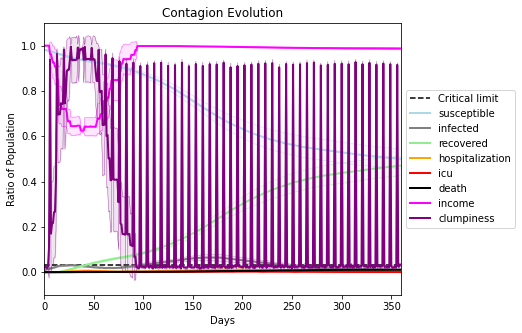

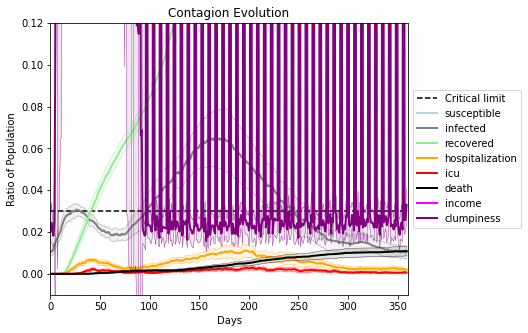

In [40]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9910, 7601, 2633, 698, 8701, 799, 2375, 9749, 3244, 4768, 3846, 6810, 9277, 6521, 4224, 9001, 4651, 2065, 5411, 7547]
Average similarity between family members is 0.16412202840898887 at temperature 0
Average similarity between family and home is 0.9998454052122027 at temperature -1
Average similarity between students and their classroom is 0.14439568707669462 at temperature 0
Average classroom occupancy is 3.704225352112676 and number classrooms is 71
Average similarity between workers is 0.16772976426047187 at temperature 0
Average office occupancy is 3.405 and number offices is 200
Average friend similarity for adults: 0.21695551385118897 for kids: 0.1959210251418136
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 

avg restaurant similarity 0.10435674178688235
avg restaurant similarity 0.22576826834640396
avg restaurant similarity 0.040041638381625916
avg restaurant similarity 0.1993660016762473
avg restaurant similarity 0.211566970543878
avg restaurant similarity 0.19845033505655296
avg restaurant similarity 0.08547698753295863
avg restaurant similarity 0.4000530656638639
avg restaurant similarity 0.15528514019681858
avg restaurant similarity -0.014190098481276657
avg restaurant similarity 0.18154747144658206
avg restaurant similarity 0.2789655973386306
avg restaurant similarity -0.10164141944367981
avg restaurant similarity 0.19928512210503416
avg restaurant similarity -0.1367125812782074
avg restaurant similarity -0.054812238446634985
avg restaurant similarity -0.2097788606317808
avg restaurant similarity -0.02849334597548754
avg restaurant similarity 0.060196036264811174
avg restaurant similarity 0.16705083827764627
avg restaurant similarity 0.11929570770094612
avg restaurant similarity -0.01

avg restaurant similarity 0.0782595550410099
avg restaurant similarity -0.036848700267729205
avg restaurant similarity 0.004471492799062539
avg restaurant similarity 0.016156642668764543
avg restaurant similarity 0.08507634774732116
avg restaurant similarity 0.21111270953895384
avg restaurant similarity 0.09294486649145221
avg restaurant similarity 0.2568780443293648
avg restaurant similarity 0.036628976258884394
avg restaurant similarity 0.06904861711456824
avg restaurant similarity 0.10016545219991967
avg restaurant similarity 0.043990534079336445
avg restaurant similarity 0.1692792145197904
avg restaurant similarity 0.03800871419742498
avg restaurant similarity -0.1145582830143793
avg restaurant similarity 0.1832835786509058
avg restaurant similarity 0.05304789825312111
avg restaurant similarity -0.032010158913153876
avg restaurant similarity 0.12299946268867493
avg restaurant similarity 0.44158013882494235
avg restaurant similarity 0.13296027796289625
avg restaurant similarity 0.01

avg restaurant similarity 0.2469213412702721
avg restaurant similarity 0.023841874937670936
avg restaurant similarity 0.33795601610304155
avg restaurant similarity 0.1608906036528718
avg restaurant similarity 0.15069259339478042
avg restaurant similarity 0.16563609090792838
avg restaurant similarity 0.14790073889287506
avg restaurant similarity 0.12487427098289111
avg restaurant similarity 0.21071773171461938
avg restaurant similarity 0.23537774907070116
avg restaurant similarity 0.07014507023119937
avg restaurant similarity 0.1702073710170606
avg restaurant similarity 0.21948318895861146
avg restaurant similarity -0.12152721409529557
avg restaurant similarity -0.029601421851940944
avg restaurant similarity -0.08884274304885248
avg restaurant similarity 0.05024743806507776
avg restaurant similarity 0.007156934407955888
avg restaurant similarity 0.32972002227644703
avg restaurant similarity 0.10575280062559601
avg restaurant similarity -0.10265104431271319
avg restaurant similarity 0.23

avg restaurant similarity 0.27815671733215686
avg restaurant similarity 0.19039206219844365
avg restaurant similarity 0.10796073037816604
avg restaurant similarity 0.10641636075130782
avg restaurant similarity -0.023871375053828428
avg restaurant similarity 0.07859583337782973
avg restaurant similarity 0.13030832412952673
avg restaurant similarity -0.11355686848104801
avg restaurant similarity 0.07371563128318741
avg restaurant similarity 0.13408732123751368
avg restaurant similarity 0.044368404417207734
avg restaurant similarity 0.15297280327113746
avg restaurant similarity -0.17882730197486224
avg restaurant similarity 0.27613481111881305
avg restaurant similarity -0.010061959970011922
avg restaurant similarity 0.17998165817985098
avg restaurant similarity 0.30724547942475583
avg restaurant similarity 0.18715720391931123
avg restaurant similarity 0.1776137242026093
avg restaurant similarity 0.1843697335724096
avg restaurant similarity 0.07960641207378485
avg restaurant similarity 0.3

avg restaurant similarity 0.3273019723519931
avg restaurant similarity -0.07097898358398033
avg restaurant similarity 0.012523658513689452
avg restaurant similarity 0.3599213352920916
avg restaurant similarity 0.083336300867882
avg restaurant similarity 0.1652600877328783
avg restaurant similarity 0.19634811115395392
avg restaurant similarity 0.18413549938030674
avg restaurant similarity 0.1533221589174922
avg restaurant similarity -0.03251012367114168
avg restaurant similarity 0.12502883630926437
avg restaurant similarity 0.08963572508680721
avg restaurant similarity 0.23532706705938855
avg restaurant similarity 0.17667706239390019
avg restaurant similarity 0.18628431638884738
avg restaurant similarity 0.19587910875745684
avg restaurant similarity 0.26829519202446594
avg restaurant similarity -0.02570958629019044
avg restaurant similarity 0.11218321775441588
avg restaurant similarity 0.02032116051682512
avg restaurant similarity 0.07279286113013594
avg restaurant similarity 0.08831067

avg restaurant similarity 0.33790501422407315
avg restaurant similarity 0.11919872964471366
avg restaurant similarity 0.05367822132303557
avg restaurant similarity 0.07727938717345947
avg restaurant similarity -0.020681446913322743
avg restaurant similarity 0.18980663102110334
avg restaurant similarity 0.3052789343179999
avg restaurant similarity 0.015176199555902872
avg restaurant similarity 0.2058261221507215
avg restaurant similarity 0.00414478913183288
avg restaurant similarity 0.08001710323458254
avg restaurant similarity 0.3923049515582309
avg restaurant similarity 0.2731544678781564
avg restaurant similarity -0.0351504222105417
avg restaurant similarity 0.19172216656290472
avg restaurant similarity 0.3054450715324628
avg restaurant similarity -0.10433371155642046
avg restaurant similarity 0.03644050283401936
avg restaurant similarity 0.11025694666617603
avg restaurant similarity 0.1501681147322217
avg restaurant similarity 0.08431985494016375
avg restaurant similarity 0.32510171

avg restaurant similarity -0.009196229945654355
avg restaurant similarity 0.10095045116896757
avg restaurant similarity -0.007394023380775008
avg restaurant similarity 0.1403263825737868
avg restaurant similarity 0.022624962844625854
avg restaurant similarity 0.1306376127308536
avg restaurant similarity -0.11412863555535642
avg restaurant similarity -0.018770660853030106
avg restaurant similarity 0.1296684615832573
avg restaurant similarity 0.10810602117533387
avg restaurant similarity 0.11210248026601498
avg restaurant similarity -0.11752834467101639
avg restaurant similarity -0.5041675622242285
avg restaurant similarity 0.07985267898467326
avg restaurant similarity 0.14657267123720752
avg restaurant similarity 0.028874459416859954
avg restaurant similarity 0.3847180136783806
avg restaurant similarity 0.2993235774972399
avg restaurant similarity 0.00012038251294098357
avg restaurant similarity -0.18500738526671126
avg restaurant similarity -0.0745570616269952
avg restaurant similarity

avg restaurant similarity -0.1398218152702921
avg restaurant similarity 0.23821925509067327
avg restaurant similarity 0.13064259232534522
avg restaurant similarity 0.06166653362429177
avg restaurant similarity -0.0938494704035473
avg restaurant similarity -0.11505352546228756
avg restaurant similarity -0.14916587606071777
avg restaurant similarity 0.3067223185971086
avg restaurant similarity 0.23084231300719557
avg restaurant similarity 0.04972184623448529
avg restaurant similarity 0.24293117571654022
avg restaurant similarity 0.01945206520046277
avg restaurant similarity -0.5041675622242285
avg restaurant similarity 0.07362725924080693
avg restaurant similarity 0.14633680699914073
avg restaurant similarity -0.014274807781684839
avg restaurant similarity 0.12266910921804167
avg restaurant similarity -0.26344783307587394
avg restaurant similarity -0.026000432037644267
avg restaurant similarity 0.03793696074463014
avg restaurant similarity 0.15299359236361162
avg restaurant similarity -0

avg restaurant similarity 0.08739464758462684
avg restaurant similarity 0.08479637609334083
avg restaurant similarity 0.1004706553932897
avg restaurant similarity 0.07198241354490896
avg restaurant similarity 0.0864594601219592
avg restaurant similarity 0.03386141502495228
avg restaurant similarity 0.14107681526261173
avg restaurant similarity 0.11727689672565286
avg restaurant similarity 0.12916975252358762
avg restaurant similarity 0.06466431493404162
avg restaurant similarity 0.2109955653236093
avg restaurant similarity 0.018548011126189673
avg restaurant similarity 0.3188400815940521
avg restaurant similarity 0.03592286938768263
avg restaurant similarity 0.12480467571555157
avg restaurant similarity 0.2710265409550577
avg restaurant similarity 0.04554666269859284
avg restaurant similarity 0.03445092001849096
avg restaurant similarity 0.11689060830713623
avg restaurant similarity 0.040300314279300996
avg restaurant similarity 0.29203283506183764
avg restaurant similarity 0.032287054

avg restaurant similarity 0.07055216407784269
avg restaurant similarity 0.07432659184994032
avg restaurant similarity 0.2648248746984982
avg restaurant similarity -0.02632970862354032
avg restaurant similarity 0.06823714653958801
avg restaurant similarity 0.19308614327085127
avg restaurant similarity 0.12655862067919021
avg restaurant similarity 0.1037670311581761
avg restaurant similarity 0.22968895432430406
avg restaurant similarity 0.49422880270854186
avg restaurant similarity -0.0655338844029564
avg restaurant similarity 0.1494600678759045
avg restaurant similarity 0.11085750302254782
avg restaurant similarity 0.05866774517507038
avg restaurant similarity 0.020593363643513437
avg restaurant similarity -0.04840661451452076
avg restaurant similarity 0.09150083679478109
avg restaurant similarity 0.18955343253882548
avg restaurant similarity 0.017763067969763496
avg restaurant similarity 0.08597562589966228
avg restaurant similarity -0.08701079546699192
avg restaurant similarity 0.1807

avg restaurant similarity -0.026996606357609285
avg restaurant similarity 0.10442961641460545
avg restaurant similarity 0.20442091320584804
avg restaurant similarity 0.16838137819463841
avg restaurant similarity 0.1348762115128286
avg restaurant similarity 0.025354052164272292
avg restaurant similarity -0.0629068446977671
avg restaurant similarity 0.030385265390814306
avg restaurant similarity 0.18421311016361974
avg restaurant similarity 0.11269827603025187
avg restaurant similarity -0.00520438566643314
avg restaurant similarity 0.18537972415007342
avg restaurant similarity -0.021570027891041732
avg restaurant similarity 0.18369753157411203
avg restaurant similarity 0.0686230155695896
avg restaurant similarity 0.06183537196767381
avg restaurant similarity 0.1233616506440241
avg restaurant similarity 0.2244353379461343
avg restaurant similarity 0.08051192942908912
avg restaurant similarity 0.21514430030296755
avg restaurant similarity 0.18251070961622676
avg restaurant similarity 0.249

avg restaurant similarity 0.12063066702014717
avg restaurant similarity 0.22794805442218458
avg restaurant similarity 0.13761821186862686
avg restaurant similarity 0.06431052715553434
avg restaurant similarity 0.055599316999731724
avg restaurant similarity 0.05702602068575545
avg restaurant similarity 0.11496986587468239
avg restaurant similarity 0.13827784993677714
avg restaurant similarity 0.09295284168365286
avg restaurant similarity 0.19373848313716724
avg restaurant similarity 0.09497629990625993
avg restaurant similarity 0.09037963846035345
avg restaurant similarity 0.23960039382291098
avg restaurant similarity 0.08305244457149859
avg restaurant similarity 0.22119046858835692
avg restaurant similarity 0.12256120866876379
avg restaurant similarity 0.15317491917709936
avg restaurant similarity 0.09479537933527676
avg restaurant similarity 0.23345026018743872
avg restaurant similarity 0.002244504592920825
avg restaurant similarity 0.18318043600723058
avg restaurant similarity 0.0610

avg restaurant similarity 0.026922749707230825
avg restaurant similarity 0.16174099282015217
avg restaurant similarity 0.14292527776045763
avg restaurant similarity 0.022447195293197567
avg restaurant similarity 0.05184787501622305
avg restaurant similarity 0.13414735025286467
avg restaurant similarity 0.08140045035418761
avg restaurant similarity 0.15719938706751818
avg restaurant similarity -0.021110962445547332
avg restaurant similarity 0.19049252316158186
avg restaurant similarity 0.03875292025534976
avg restaurant similarity 0.15729165801637965
avg restaurant similarity -0.1239537065730765
avg restaurant similarity 0.423853173014926
avg restaurant similarity 0.013003588240833693
avg restaurant similarity 0.04423704370034925
avg restaurant similarity 0.014066200615708721
avg restaurant similarity 0.0706562047056571
avg restaurant similarity 0.10168171511494475
avg restaurant similarity -0.04462599819272336
avg restaurant similarity -0.016387183469770084
avg restaurant similarity 0.

avg restaurant similarity 0.20507012540547628
avg restaurant similarity 0.17546239740877628
avg restaurant similarity 0.22384566682516013
avg restaurant similarity 0.0820621083253859
avg restaurant similarity -0.025760612522929133
avg restaurant similarity 0.10170158365489854
avg restaurant similarity 0.14514366849677698
avg restaurant similarity 0.05396759562823317
avg restaurant similarity 0.06033724092281306
avg restaurant similarity 0.072732416337048
avg restaurant similarity 0.18011069104137134
avg restaurant similarity 0.004831805292486888
avg restaurant similarity -0.321386047749168
avg restaurant similarity 0.03516372140118362
avg restaurant similarity 0.1361279030334714
avg restaurant similarity 0.04376626429004942
avg restaurant similarity 0.3219356628484931
avg restaurant similarity 0.10168332600032193
avg restaurant similarity 0.021186830692273412
avg restaurant similarity 0.1098480956384063
avg restaurant similarity -0.1349584070064409
avg restaurant similarity -0.02536753

avg restaurant similarity 0.16596053998266036
avg restaurant similarity -0.09191963147787459
avg restaurant similarity -0.0029600504595693466
avg restaurant similarity 0.06979152236569697
avg restaurant similarity 0.12501689353964773
avg restaurant similarity -0.05782829562875825
avg restaurant similarity 0.14129304844817395
avg restaurant similarity 0.20087496937174515
avg restaurant similarity 0.05329333441292432
avg restaurant similarity 0.056730905726007
avg restaurant similarity 0.08176214280126767
avg restaurant similarity 0.15476948190605563
avg restaurant similarity -0.003118780504487438
avg restaurant similarity 0.036574381093714435
avg restaurant similarity 0.17055708656197183
avg restaurant similarity 0.0688386527332979
avg restaurant similarity -0.004193676500900857
avg restaurant similarity 0.25531817862609985
avg restaurant similarity 0.014004445118598762
avg restaurant similarity 0.08796521235812226
avg restaurant similarity -0.15045378747369556
avg restaurant similarity

avg restaurant similarity 0.48060104621203115
avg restaurant similarity 0.20283081312202422
avg restaurant similarity 0.032739966868705554
avg restaurant similarity 0.2997640289769366
avg restaurant similarity 0.29264688226525976
avg restaurant similarity 0.15501909812324727
avg restaurant similarity 0.45432358776706705
avg restaurant similarity -0.33767567884508104
avg restaurant similarity -0.010664599187705626
avg restaurant similarity -0.027126795764857776
avg restaurant similarity 0.1299112232387977
avg restaurant similarity -0.008755142448877094
avg restaurant similarity 0.09349330037132537
avg restaurant similarity 0.09714011102535754
avg restaurant similarity -0.18551266089647048
avg restaurant similarity -0.18171415182787848
avg restaurant similarity 0.1179929643437148
avg restaurant similarity 0.06759569379110986
avg restaurant similarity -0.02410704716640393
avg restaurant similarity 0.026326861771573645
avg restaurant similarity 0.04017345507585268
avg restaurant similarity

avg restaurant similarity 0.15002352218063997
avg restaurant similarity 0.020553314946547344
avg restaurant similarity 0.0737942638106404
avg restaurant similarity 0.34821322225949874
avg restaurant similarity -0.015426479411368339
avg restaurant similarity 0.06685231300660475
avg restaurant similarity 0.43198663341568927
avg restaurant similarity 0.2022937963222475
avg restaurant similarity 0.10594833876729322
avg restaurant similarity -0.09978836634414778
avg restaurant similarity 0.25163427098933133
avg restaurant similarity 0.11162093440243613
avg restaurant similarity 0.08882294666394368
avg restaurant similarity 0.115647341714948
avg restaurant similarity -0.20850247998559657
avg restaurant similarity -0.06260385904627488
avg restaurant similarity 0.02090874484700226
avg restaurant similarity 0.3171468441795753
avg restaurant similarity -0.11786147292834985
avg restaurant similarity 0.15115220200647808
avg restaurant similarity 0.0656315327191942
avg restaurant similarity 0.12362

avg restaurant similarity 0.07962271598780254
avg restaurant similarity -0.12314034819146522
avg restaurant similarity 0.1677741865937907
avg restaurant similarity -0.018571661064788195
avg restaurant similarity 0.23495515241614173
avg restaurant similarity 0.02601477920273331
avg restaurant similarity 0.06611174869615198
avg restaurant similarity -0.07497014793960645
avg restaurant similarity 0.20945198666876744
avg restaurant similarity 0.36216447074475455
avg restaurant similarity -0.05173701609938416
avg restaurant similarity 0.25616825889798955
avg restaurant similarity 0.05159401590739857
avg restaurant similarity 0.39757917525016256
avg restaurant similarity 0.15703847688733455
avg restaurant similarity -0.1908730799808607
avg restaurant similarity 0.2702708652342587
avg restaurant similarity 0.17563275051629665
avg restaurant similarity 0.2815573270832006
avg restaurant similarity 0.08975389826794983
avg restaurant similarity 0.029190441511393484
avg restaurant similarity -0.11

avg restaurant similarity 0.15225782241997718
avg restaurant similarity 0.14630918735558712
avg restaurant similarity 0.11619744188748292
avg restaurant similarity -0.16462278124705845
avg restaurant similarity 0.13958573264659943
avg restaurant similarity 0.07414754483561864
avg restaurant similarity 0.35685160898270785
avg restaurant similarity -0.07698236774372345
avg restaurant similarity 0.1263702503595416
avg restaurant similarity 0.08403251866575297
avg restaurant similarity -0.043443987080143236
avg restaurant similarity 0.03773146080658453
avg restaurant similarity 0.11280913333289619
avg restaurant similarity -0.006729753668652842
avg restaurant similarity 0.1424108342826344
avg restaurant similarity -0.06945730983698466
avg restaurant similarity 0.06316154128418525
avg restaurant similarity 0.14126761121842404
avg restaurant similarity 0.06710245084507178
avg restaurant similarity 0.028826464526390823
avg restaurant similarity 0.14719530332723188
avg restaurant similarity 0.

avg restaurant similarity 0.25196746176003776
avg restaurant similarity -0.17112081101992554
avg restaurant similarity 0.08319947043089426
avg restaurant similarity 0.05660711944197313
avg restaurant similarity -0.016984005368788045
avg restaurant similarity 0.07483101328091142
avg restaurant similarity -0.014087345789137095
avg restaurant similarity 0.12158474587838025
avg restaurant similarity -0.046757227212768565
avg restaurant similarity 0.10180747792290352
avg restaurant similarity -0.031488207756678654
avg restaurant similarity 0.11102436588508821
avg restaurant similarity -0.2214897274839412
avg restaurant similarity 0.06689246229462394
avg restaurant similarity -0.09917205337665148
avg restaurant similarity -0.27497779164770697
avg restaurant similarity 0.06528613042194785
avg restaurant similarity -0.0121861128364536
avg restaurant similarity -0.043820695559520215
avg restaurant similarity 0.13341443496493205
avg restaurant similarity 0.11341587239451058
avg restaurant simila

avg restaurant similarity -0.04033748828823972
avg restaurant similarity -0.09895334554203783
avg restaurant similarity -0.06429937117800771
avg restaurant similarity -0.02347031609755832
avg restaurant similarity 0.09392934618709578
avg restaurant similarity -0.07872859089406958
avg restaurant similarity -0.16056717121612812
avg restaurant similarity -0.07095171147868277
avg restaurant similarity 0.18703647214034602
avg restaurant similarity -0.05814350809159775
avg restaurant similarity 0.26531481702477194
avg restaurant similarity -0.11383121960294204
avg restaurant similarity -0.13694652366296237
avg restaurant similarity -0.060428893287642026
avg restaurant similarity 0.1001737114893125
avg restaurant similarity -0.009778654877609677
avg restaurant similarity -0.004701212518312794
avg restaurant similarity -0.24302847090199303
avg restaurant similarity -0.0011143269168936586
avg restaurant similarity 0.24953303917625227
avg restaurant similarity -0.13321797046761022
avg restaurant

avg restaurant similarity 0.4355583503928049
avg restaurant similarity 0.04336863115761087
avg restaurant similarity -0.09073448340532636
avg restaurant similarity 0.10067002260216242
avg restaurant similarity -0.04370183099333549
avg restaurant similarity 0.14217812697853371
avg restaurant similarity -0.04656783123419775
avg restaurant similarity -0.20179773907355858
avg restaurant similarity 0.46038673447268147
avg restaurant similarity 0.1975437949942887
avg restaurant similarity 0.5813884577888393
avg restaurant similarity 0.47669038831294325
avg restaurant similarity -0.1419824783564862
avg restaurant similarity 0.19532824596199452
avg restaurant similarity -0.034824585503603935
avg restaurant similarity -0.11901729700726671
avg restaurant similarity 0.11643744686461098
avg restaurant similarity 0.08640903495144112
avg restaurant similarity 0.08133476216881841
avg restaurant similarity 0.16566224212288133
avg restaurant similarity 0.1887862565177352
avg restaurant similarity 0.002

avg restaurant similarity 0.17856894240746674
avg restaurant similarity 0.14459222754540124
avg restaurant similarity 0.044210624493550704
avg restaurant similarity 0.021807896787492898
avg restaurant similarity 0.15398641744580596
avg restaurant similarity 0.06727271431588008
avg restaurant similarity 0.546766392767033
avg restaurant similarity 0.08597738752882457
avg restaurant similarity -0.17643672999291865
avg restaurant similarity -0.10098491485961161
avg restaurant similarity 0.12760911671007094
avg restaurant similarity 0.45184733312839787
avg restaurant similarity 0.02646144528550758
avg restaurant similarity 0.04054351556645727
avg restaurant similarity 0.14913093605330122
avg restaurant similarity 0.2873512971302595
avg restaurant similarity 0.15466629326895026
avg restaurant similarity -0.0034186692877608157
avg restaurant similarity 0.2442801401894574
avg restaurant similarity 0.1513638620783641
avg restaurant similarity 0.24284601956862498
avg restaurant similarity 0.1009

avg restaurant similarity 0.11805368668050514
avg restaurant similarity 0.05817895152550667
avg restaurant similarity 0.17779776950549334
avg restaurant similarity 0.11340701730987937
avg restaurant similarity 0.25916817789718605
avg restaurant similarity -0.037166030124816174
avg restaurant similarity -0.10953954476305033
avg restaurant similarity 0.3728747437764257
avg restaurant similarity 0.21956728640949738
avg restaurant similarity 0.29820265142803043
avg restaurant similarity 0.06931034711542007
avg restaurant similarity -0.17271168105924445
avg restaurant similarity 0.04846685152779903
avg restaurant similarity -0.05924670218552222
avg restaurant similarity 0.16173601605901233
avg restaurant similarity -0.12489567525688496
avg restaurant similarity 0.17486613217121727
avg restaurant similarity 0.056834205912049726
avg restaurant similarity 0.04760051850723409
avg restaurant similarity 0.4195413079062928
avg restaurant similarity 0.10414432945892564
avg restaurant similarity 0.0

avg restaurant similarity 0.22765297811361243
avg restaurant similarity 0.11073479589393527
avg restaurant similarity 0.10335936910229838
avg restaurant similarity 0.19193925176363116
avg restaurant similarity 0.11858746906893518
avg restaurant similarity 0.08882726535095012
avg restaurant similarity 0.10383459697860314
avg restaurant similarity 0.3357162375673838
avg restaurant similarity 0.14046645406145242
avg restaurant similarity 0.07507900375244109
avg restaurant similarity 0.21992641089490667
avg restaurant similarity 0.019044702821169508
avg restaurant similarity 0.0873857307479101
avg restaurant similarity 0.14759922926532557
avg restaurant similarity 0.050931533866062924
avg restaurant similarity 0.03198674141913892
avg restaurant similarity 0.07447974202499939
avg restaurant similarity 0.014272525770544081
avg restaurant similarity 0.12387884016224705
avg restaurant similarity 0.056984099419755095
avg restaurant similarity 0.15964170613571632
avg restaurant similarity 0.0072

avg restaurant similarity 0.14560400362187134
avg restaurant similarity -0.3440102018149391
avg restaurant similarity 0.127421319615927
avg restaurant similarity -0.07762082841490753
avg restaurant similarity 0.15420181262598243
avg restaurant similarity -0.033588404900025494
avg restaurant similarity 0.35535981450077153
avg restaurant similarity -0.05540047480082297
avg restaurant similarity 0.20177843258723763
avg restaurant similarity 0.11719192412765587
avg restaurant similarity 0.21075291036944144
avg restaurant similarity -0.01094909561581559
avg restaurant similarity 0.02541840725289196
avg restaurant similarity 0.16205382529787238
avg restaurant similarity -0.16422693184694523
avg restaurant similarity 0.03566130190952474
avg restaurant similarity -0.10454259075195374
avg restaurant similarity 0.15220171972707433
avg restaurant similarity 0.03710754036695051
avg restaurant similarity 0.01293357671059728
avg restaurant similarity 0.113047289723886
avg restaurant similarity -0.00

avg restaurant similarity -0.06042748384426725
avg restaurant similarity 0.17011458199206608
avg restaurant similarity -0.012315523557178305
avg restaurant similarity 0.006468379115107087
avg restaurant similarity 0.022159777273797292
avg restaurant similarity 0.15452285234778135
avg restaurant similarity 0.09134292029623649
avg restaurant similarity -0.06283486146094608
avg restaurant similarity 0.19386468757326314
avg restaurant similarity 0.2705402804354158
avg restaurant similarity -0.19672696349544905
avg restaurant similarity -0.0076310237623893225
avg restaurant similarity 0.04392296103233309
avg restaurant similarity -0.007734617186923271
avg restaurant similarity 0.25836490111712734
avg restaurant similarity -0.059324778879564374
avg restaurant similarity 0.2463216232019564
avg restaurant similarity -0.028458447549682502
avg restaurant similarity 0.0513297371130441
avg restaurant similarity 0.2408762094040413
avg restaurant similarity 0.2621327756196152
avg restaurant similari

avg restaurant similarity 0.3353787426811071
avg restaurant similarity -0.0007262312078960602
avg restaurant similarity 0.1515590819187835
avg restaurant similarity 0.21926010889689343
avg restaurant similarity 0.2275436599453406
avg restaurant similarity 0.03496756554095196
avg restaurant similarity -0.07281171822785128
avg restaurant similarity 0.12918925792879726
avg restaurant similarity -0.014100613180753159
avg restaurant similarity 0.22190407986070326
avg restaurant similarity 0.23904771550813736
avg restaurant similarity 0.024207314141593928
avg restaurant similarity 0.028722758875175076
avg restaurant similarity 0.004937877274328768
avg restaurant similarity 0.3225645014327656
avg restaurant similarity 0.08719542921570884
avg restaurant similarity -0.016536148998777873
avg restaurant similarity -0.08127281296889108
avg restaurant similarity -0.02164531998238704
avg restaurant similarity 0.0015401680198604366
avg restaurant similarity -0.13705050896720158
avg restaurant similar

avg restaurant similarity 0.12023105899248686
avg restaurant similarity 0.12343191532270345
avg restaurant similarity -0.033787727727582755
avg restaurant similarity 0.21119590267241986
avg restaurant similarity -0.03952377826898604
avg restaurant similarity 0.2972161109364501
avg restaurant similarity 0.12431798203041551
avg restaurant similarity 0.2638464541940722
avg restaurant similarity 0.10689628085739047
avg restaurant similarity 0.04666173066537939
avg restaurant similarity 0.029383361734237532
avg restaurant similarity 0.19736892175541004
avg restaurant similarity -0.16240869113257628
avg restaurant similarity 0.25299258576969474
avg restaurant similarity 0.08534598101723173
avg restaurant similarity 0.27750563363242275
avg restaurant similarity 0.22741327951473528
avg restaurant similarity 0.11732519604701573
avg restaurant similarity 0.12264759615311958
avg restaurant similarity 0.08623438600759402
avg restaurant similarity 0.0912841127518781
avg restaurant similarity 0.1259

avg restaurant similarity 0.05324198515450751
avg restaurant similarity 0.427304722500425
avg restaurant similarity 0.039694758355435227
avg restaurant similarity 0.009270797637386733
avg restaurant similarity -0.04833052060779228
avg restaurant similarity 0.20087430403010176
avg restaurant similarity 0.012899470980299723
avg restaurant similarity 0.0751587892012243
avg restaurant similarity -0.05793362189249089
avg restaurant similarity 0.2434154940757116
avg restaurant similarity 0.2383080981561521
avg restaurant similarity -0.043183337113035805
avg restaurant similarity 0.2003610326240549
avg restaurant similarity 0.1659253190301588
avg restaurant similarity 0.12491009702503977
avg restaurant similarity 0.10184475914305992
avg restaurant similarity 0.08167684650884718
avg restaurant similarity 0.10821774572117798
avg restaurant similarity 0.17988011065506007
avg restaurant similarity 0.06269608830519555
avg restaurant similarity 0.3267198657980083
avg restaurant similarity -0.012567

avg restaurant similarity -0.1673038311747144
avg restaurant similarity 0.029827960888627214
avg restaurant similarity -0.11390959706008756
avg restaurant similarity 0.2043408478161668
avg restaurant similarity -0.08261246101961556
avg restaurant similarity -0.0467335255560294
avg restaurant similarity 0.00840530877333243
avg restaurant similarity 0.1571124986600955
avg restaurant similarity 0.04268395378859564
avg restaurant similarity -0.10473036819876827
avg restaurant similarity 0.18919774211420154
avg restaurant similarity 0.014158554492582895
avg restaurant similarity 0.08870012120977888
avg restaurant similarity 0.1642456212924032
avg restaurant similarity 0.2286507469085796
avg restaurant similarity 0.029492078025006883
avg restaurant similarity 0.22765390641446762
avg restaurant similarity 0.24400859856788984
avg restaurant similarity -0.043371938696738215
avg restaurant similarity 0.06932591349845664
avg restaurant similarity 0.07792402015267151
avg restaurant similarity 0.01

avg restaurant similarity 0.014903649527993657
avg restaurant similarity 0.08337288951940643
avg restaurant similarity 0.022196179497401977
avg restaurant similarity 0.3020614548219902
avg restaurant similarity 0.17591439165171094
avg restaurant similarity 0.04829386797676333
avg restaurant similarity -0.17890413971190755
avg restaurant similarity -0.17275031339213587
avg restaurant similarity -0.027608028595161416
avg restaurant similarity 0.013900221527738732
avg restaurant similarity 0.1801782446253095
avg restaurant similarity 0.10400437974662538
avg restaurant similarity 0.12818879752724058
avg restaurant similarity 0.004384352982577444
avg restaurant similarity -0.015608401067442358
avg restaurant similarity -0.010616104994054899
avg restaurant similarity 0.1707784549596503
avg restaurant similarity 0.18905616003311912
avg restaurant similarity -0.060386397988635536
avg restaurant similarity 0.005721497174163653
avg restaurant similarity 0.12595491645328719
avg restaurant similar

avg restaurant similarity 0.18813497647928068
avg restaurant similarity 0.013921075770786922
avg restaurant similarity -0.014711218670265327
avg restaurant similarity 0.13205535036622423
avg restaurant similarity 0.23608750920986096
avg restaurant similarity 0.029112924324289448
avg restaurant similarity 0.14297701075605762
avg restaurant similarity -0.06052797863248987
avg restaurant similarity 0.17460218227584778
avg restaurant similarity 0.08819130433930203
avg restaurant similarity 0.11416981525757872
avg restaurant similarity 0.0327677959039472
avg restaurant similarity 0.2605451752169674
avg restaurant similarity 0.24884198600867494
avg restaurant similarity 0.28988553608372986
avg restaurant similarity 0.1521692833588209
avg restaurant similarity -0.0645905411544765
avg restaurant similarity 0.11743805256335334
avg restaurant similarity 0.34904852128697755
avg restaurant similarity 0.041717572339707625
avg restaurant similarity 0.05237663190865216
avg restaurant similarity 0.034

avg restaurant similarity -0.04574832576237542
avg restaurant similarity -0.008575604504991261
avg restaurant similarity 0.19505493764902537
avg restaurant similarity -0.12486178945209175
avg restaurant similarity 0.3925581370782119
avg restaurant similarity 0.11447369951559794
avg restaurant similarity -0.03278519299317223
avg restaurant similarity 0.012342769464579623
avg restaurant similarity 0.19442916470642607
avg restaurant similarity -0.07946550376622658
avg restaurant similarity 0.020591218502823465
avg restaurant similarity 0.0890071047300375
avg restaurant similarity 0.1252833659416319
avg restaurant similarity 0.009105385201681953
avg restaurant similarity 0.301248777167363
avg restaurant similarity 0.11770474468396577
avg restaurant similarity -0.014019812522915925
avg restaurant similarity 0.083633809523711
avg restaurant similarity 0.1408443911100836
avg restaurant similarity 0.0200363440542237
avg restaurant similarity 0.05082929546079196
avg restaurant similarity -0.085

avg restaurant similarity 0.0890346274262967
avg restaurant similarity 0.027553351896119536
avg restaurant similarity 0.19179801928105733
avg restaurant similarity 0.05006061020556733
avg restaurant similarity 0.041303613723787255
avg restaurant similarity 0.24179377772787447
avg restaurant similarity 0.08528416409425213
avg restaurant similarity -0.011933769066650857
avg restaurant similarity -0.059557640506601825
avg restaurant similarity 0.10778952926063419
avg restaurant similarity -0.07161843154997538
avg restaurant similarity 0.035417994991092855
avg restaurant similarity 0.1729210206972937
avg restaurant similarity -0.08144559767585614
avg restaurant similarity 0.034987025626561905
avg restaurant similarity 0.06752232136947187
avg restaurant similarity -0.024476764599599958
avg restaurant similarity 0.14571734602220132
avg restaurant similarity 0.11072565260643913
avg restaurant similarity 0.22291438807702252
avg restaurant similarity 0.33469080529244766
avg restaurant similarit

avg restaurant similarity 0.061968068416002095
avg restaurant similarity 0.10519412075130896
avg restaurant similarity 0.07384547042481525
avg restaurant similarity 0.04553383813652203
avg restaurant similarity 0.28049786737749793
avg restaurant similarity 0.5508097445090548
avg restaurant similarity 0.11282863803793562
avg restaurant similarity 0.27778498204518526
avg restaurant similarity 0.2677422052986335
avg restaurant similarity 0.13038426609093803
avg restaurant similarity 0.24528579467230474
avg restaurant similarity 0.2488226688558062
avg restaurant similarity 0.21975722917671175
avg restaurant similarity 0.29494725118753723
avg restaurant similarity 0.27222524042440355
avg restaurant similarity -0.03729228347577562
avg restaurant similarity 0.2778078065583567
avg restaurant similarity 0.033942134601292404
avg restaurant similarity -0.09632388861485021
avg restaurant similarity 0.042094564500106624
avg restaurant similarity 0.08593173311341544
avg restaurant similarity 0.10294

avg restaurant similarity 0.05227445807355024
avg restaurant similarity -0.030167294127239022
avg restaurant similarity 0.14955114066536415
avg restaurant similarity 0.04350907528624826
avg restaurant similarity 0.0038337376643835315
avg restaurant similarity 0.0985476556871619
avg restaurant similarity 0.006075685286213872
avg restaurant similarity 0.2501422657575882
avg restaurant similarity 0.11733145508184949
avg restaurant similarity 0.15552099214876736
avg restaurant similarity -0.02586479721478071
avg restaurant similarity 0.000584505187123921
avg restaurant similarity 0.1990333357570548
avg restaurant similarity 0.07958380014011082
avg restaurant similarity 0.11466022744242192
avg restaurant similarity 0.019124975335697025
avg restaurant similarity 0.17732206146889876
avg restaurant similarity 0.05467934426408611
avg restaurant similarity 0.06644834047161297
avg restaurant similarity 0.0756322547349366
avg restaurant similarity 0.06081930575485365
avg restaurant similarity 0.15

avg restaurant similarity 0.07445467936505934
avg restaurant similarity 0.23297373939187555
avg restaurant similarity 0.11557417830135966
avg restaurant similarity 0.14835262142482056
avg restaurant similarity 0.13256773624431165
avg restaurant similarity -0.0711787276113238
avg restaurant similarity 0.17515725536954113
avg restaurant similarity 0.16129569328922275
avg restaurant similarity -0.19401620976126496
avg restaurant similarity 7.368941429615064e-06
avg restaurant similarity 0.08946595946760737
avg restaurant similarity -0.022435371255024754
avg restaurant similarity 0.2196905009040519
avg restaurant similarity -0.044991305511109005
avg restaurant similarity -0.04623380190492053
avg restaurant similarity 0.13399037622694313
avg restaurant similarity 0.07666441881791353
avg restaurant similarity 0.15097753807619188
avg restaurant similarity 0.09574141307888746
avg restaurant similarity 0.011327300792682715
avg restaurant similarity -0.03227741389979909
avg restaurant similarity

avg restaurant similarity 0.06071897374794123
avg restaurant similarity 0.692968686760769
avg restaurant similarity -0.003176425990072393
avg restaurant similarity 0.08666560600327144
avg restaurant similarity 0.133367790400511
avg restaurant similarity -0.11825328254723916
avg restaurant similarity 0.035778833897320075
avg restaurant similarity 0.22920469690932005
avg restaurant similarity 0.1466161450941307
avg restaurant similarity -0.18659422710947174
avg restaurant similarity 0.24427558775872094
avg restaurant similarity 0.05238401372226817
avg restaurant similarity -0.02089449649104438
avg restaurant similarity 0.07958453396629103
avg restaurant similarity -0.04733395510905447
avg restaurant similarity 0.26451208393326575
avg restaurant similarity 0.19876347406831257
avg restaurant similarity 0.2062435874533344
avg restaurant similarity 0.233459736477374
avg restaurant similarity 0.032536359688512734
avg restaurant similarity 0.051524126530082585
avg restaurant similarity -0.0536

avg restaurant similarity 0.14359619975407786
avg restaurant similarity -0.1802976841209114
avg restaurant similarity -0.05994588125317642
avg restaurant similarity 0.10041821651461254
avg restaurant similarity 0.014385909683995411
avg restaurant similarity -0.1789819236619343
avg restaurant similarity -0.10739896526153625
avg restaurant similarity 0.2769015045178285
avg restaurant similarity 0.13594637277400978
avg restaurant similarity -0.009365036820464474
avg restaurant similarity 0.031630940281626975
avg restaurant similarity -0.16093793446274404
avg restaurant similarity 0.260199611136898
avg restaurant similarity 0.041883191999005795
avg restaurant similarity -0.14188980628536305
avg restaurant similarity 0.14424039648541562
avg restaurant similarity -0.11073730057234987
avg restaurant similarity -0.020748326573716086
avg restaurant similarity 0.13313190509064182
avg restaurant similarity 0.7302406304000099
avg restaurant similarity 0.21706116363872388
avg restaurant similarity 

(<function dict.items>, <function dict.items>, <function dict.items>)

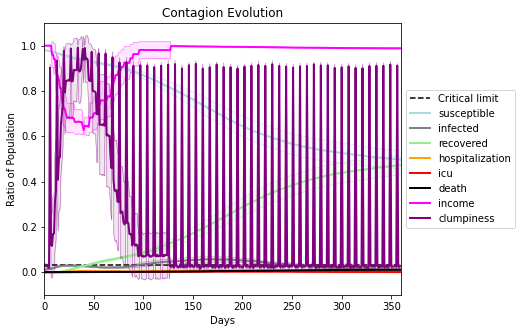

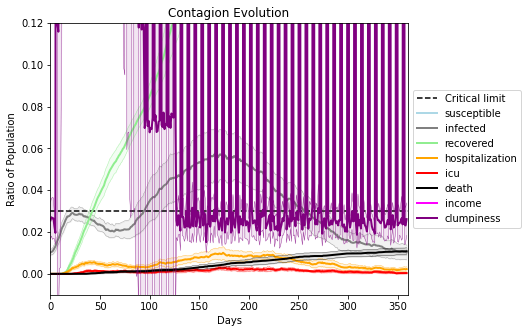

In [41]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7786, 6655, 7010, 4868, 9259, 6512, 4805, 717, 1789, 559, 5962, 3331, 8583, 1874, 5391, 1983, 7029, 6672, 8135, 2357]
Average similarity between family members is 0.13138848265151368 at temperature 0.33
Average similarity between family and home is 0.9998547976801068 at temperature -1
Average similarity between students and their classroom is 0.10878698995996386 at temperature 0.33
Average classroom occupancy is 3.7 and number classrooms is 70
Average similarity between workers is 0.07738834821762736 at temperature 0.33
Average office occupancy is 3.3838383838383836 and number offices is 198
Average friend similarity for adults: 0.16585230495184253 for kids: 0.15077902774982077
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousB

avg restaurant similarity 0.011857198893008226
avg restaurant similarity 0.35971352069760987
avg restaurant similarity 0.2401727364706364
avg restaurant similarity 0.3461884837472249
avg restaurant similarity 0.06900213564868664
avg restaurant similarity 0.132362036531445
avg restaurant similarity 0.0980688309771003
avg restaurant similarity -0.11972571796023979
avg restaurant similarity 0.09005910571665666
avg restaurant similarity 0.0648084269013379
avg restaurant similarity 0.15228853080781515
avg restaurant similarity 0.12448050230683483
avg restaurant similarity 0.15900587004379035
avg restaurant similarity 0.21856930304820252
avg restaurant similarity 0.07439424887725822
avg restaurant similarity -0.00230798572221218
avg restaurant similarity 0.008393362746653898
avg restaurant similarity 0.19028776426338598
avg restaurant similarity 0.2959621322755164
avg restaurant similarity -0.00513985136999043
avg restaurant similarity 0.13319258052359212
avg restaurant similarity 0.16113464

avg restaurant similarity -0.03473631914920496
avg restaurant similarity 0.25438741344406784
avg restaurant similarity -0.013977883549792638
avg restaurant similarity 0.0405943058154708
avg restaurant similarity 0.10953716318518608
avg restaurant similarity -0.012385300962751235
avg restaurant similarity 0.11121907391583025
avg restaurant similarity 0.019954982484934283
avg restaurant similarity 0.20992535301188875
avg restaurant similarity 0.16939129077422285
avg restaurant similarity 0.04230946713614956
avg restaurant similarity 0.14334295330905908
avg restaurant similarity 0.01141723153443043
avg restaurant similarity 0.15109501610040382
avg restaurant similarity 0.14412434152027875
avg restaurant similarity 0.32115473723908144
avg restaurant similarity -0.0634058281767222
avg restaurant similarity 0.04618464413479238
avg restaurant similarity 0.05954626989343364
avg restaurant similarity 0.2352461714602344
avg restaurant similarity 0.08004010387080328
avg restaurant similarity 0.18

avg restaurant similarity -0.10197289177978912
avg restaurant similarity 0.004247632749002576
avg restaurant similarity -0.006196690503447978
avg restaurant similarity -0.07246881536817797
avg restaurant similarity 0.06523351959531162
avg restaurant similarity -0.08907432939044121
avg restaurant similarity -0.1051224618393105
avg restaurant similarity 0.06648455711686863
avg restaurant similarity 0.05444606127229914
avg restaurant similarity 0.06372970549720802
avg restaurant similarity -0.08846900271256837
avg restaurant similarity -0.0851637098983127
avg restaurant similarity 0.2283300119680074
avg restaurant similarity -0.03427560247073767
avg restaurant similarity 0.16557568904529382
avg restaurant similarity 0.012390857093373332
avg restaurant similarity 0.13903514033888578
avg restaurant similarity -0.05647002890723978
avg restaurant similarity -0.058869961489839875
avg restaurant similarity -0.05173610139786374
avg restaurant similarity 0.12968678611281592
avg restaurant similar

avg restaurant similarity -0.21647779023401073
avg restaurant similarity 0.0846110594973104
avg restaurant similarity -0.050335812928024616
avg restaurant similarity -0.05986707580338593
avg restaurant similarity 0.037641906042612784
avg restaurant similarity -0.135907638193344
avg restaurant similarity 0.11640449077366391
avg restaurant similarity -0.21502913299978602
avg restaurant similarity -0.03706436741482031
avg restaurant similarity -0.10719281112878343
avg restaurant similarity -0.04718247992453472
avg restaurant similarity 0.25681290270352036
avg restaurant similarity -0.2448437171807159
avg restaurant similarity 0.05652653315528946
avg restaurant similarity 0.09309807569746502
avg restaurant similarity 0.05534135004888297
avg restaurant similarity -0.08505002118317878
avg restaurant similarity -0.04937258268125086
avg restaurant similarity 0.12889683698865226
avg restaurant similarity 0.055252820894372646
avg restaurant similarity -0.07828137072620685
avg restaurant similari

avg restaurant similarity 0.11270482711314873
avg restaurant similarity 0.059853064758446775
avg restaurant similarity -0.10576470873339994
avg restaurant similarity -0.039073474426721565
avg restaurant similarity 0.11862380563814698
avg restaurant similarity 0.13507335765346382
avg restaurant similarity 0.25785732568326775
avg restaurant similarity 0.1929675366158853
avg restaurant similarity 0.03190058399189306
avg restaurant similarity -0.0396114987172657
avg restaurant similarity 0.11379432314510893
avg restaurant similarity -0.1256532334799057
avg restaurant similarity 0.21770544481754892
avg restaurant similarity 0.05373423365654774
avg restaurant similarity 0.027366878741359835
avg restaurant similarity 0.045584799383450475
avg restaurant similarity 0.07398881472427157
avg restaurant similarity -0.03477347206787953
avg restaurant similarity 0.02513046849443202
avg restaurant similarity 0.057745764818586634
avg restaurant similarity -0.06687998393731026
avg restaurant similarity 

avg restaurant similarity -0.10174058671834191
avg restaurant similarity -0.030779482024924688
avg restaurant similarity 0.18723190905112244
avg restaurant similarity -0.06242391277286712
avg restaurant similarity 0.027371051903449767
avg restaurant similarity 0.14453540842976798
avg restaurant similarity -0.033380799695477456
avg restaurant similarity 0.13231574228167853
avg restaurant similarity -0.0037555527125479604
avg restaurant similarity 0.10695693485640106
avg restaurant similarity -0.12295872667768155
avg restaurant similarity 0.07029436768852558
avg restaurant similarity -0.10169315362785453
avg restaurant similarity -0.04148435547702224
avg restaurant similarity -0.011318184025332731
avg restaurant similarity 0.016397805915354793
avg restaurant similarity 0.14218848103169682
avg restaurant similarity 0.06941398851004754
avg restaurant similarity -0.03014715963046103
avg restaurant similarity 0.06318000466358781
avg restaurant similarity -0.09841991393065737
avg restaurant s

avg restaurant similarity 0.06546982245384442
avg restaurant similarity 0.15469112744566074
avg restaurant similarity -0.032138744742554966
avg restaurant similarity 0.23357174557101035
avg restaurant similarity 0.05832430486910083
avg restaurant similarity 0.362841307989735
avg restaurant similarity 0.22802222753069365
avg restaurant similarity -0.04503319295107357
avg restaurant similarity -0.31376074017890965
avg restaurant similarity 0.06371265955801875
avg restaurant similarity 0.08597901448419845
avg restaurant similarity -0.1150666483665819
avg restaurant similarity -0.07932407625966628
avg restaurant similarity 0.11452295932520039
avg restaurant similarity 0.09931675480581856
avg restaurant similarity 0.03388974527047407
avg restaurant similarity -0.006328066747460885
avg restaurant similarity 0.1835919044385766
avg restaurant similarity -0.06892435617724482
avg restaurant similarity -0.10478911618257092
avg restaurant similarity -0.1789886824373666
avg restaurant similarity -0

avg restaurant similarity 0.09217707730981456
avg restaurant similarity -0.022932333288723964
avg restaurant similarity -0.032662511777903934
avg restaurant similarity 0.06846945259020445
avg restaurant similarity 0.11630722664031641
avg restaurant similarity 0.03712966929476009
avg restaurant similarity -0.0833279224224966
avg restaurant similarity 0.26469753692529163
avg restaurant similarity 0.035032440298832034
avg restaurant similarity 0.16976642360261926
avg restaurant similarity 0.033594245154737516
avg restaurant similarity 0.09744769468771655
avg restaurant similarity 0.043847806638517985
avg restaurant similarity -0.016853222525841448
avg restaurant similarity 0.04287361085796289
avg restaurant similarity -0.13795751410771148
avg restaurant similarity -0.1394326190635614
avg restaurant similarity 0.14259508370476848
avg restaurant similarity 0.4548489439939157
avg restaurant similarity 0.12445674348457296
avg restaurant similarity 0.16922033321652705
avg restaurant similarity

avg restaurant similarity 0.08691267420192805
avg restaurant similarity 0.06082199305457432
avg restaurant similarity -0.035592852634938006
avg restaurant similarity -0.06550749020317928
avg restaurant similarity -0.12844941987480832
avg restaurant similarity 0.05126769317588707
avg restaurant similarity -0.16169010923737578
avg restaurant similarity -0.016898327606715738
avg restaurant similarity 0.06355457262137315
avg restaurant similarity 0.26548784784828305
avg restaurant similarity -0.015517730406650665
avg restaurant similarity 0.06538346431459836
avg restaurant similarity 0.06284705561615808
avg restaurant similarity 0.006954939073601483
avg restaurant similarity 0.0004224515431696894
avg restaurant similarity 0.15183468162531744
avg restaurant similarity -0.12112163136669973
avg restaurant similarity 0.11174808790883028
avg restaurant similarity 0.22104719528975522
avg restaurant similarity -0.027846007618257826
avg restaurant similarity -0.00915273000045434
avg restaurant sim

avg restaurant similarity 0.10751970606313617
avg restaurant similarity 0.009787852376694564
avg restaurant similarity 0.05208805350979923
avg restaurant similarity -0.10024211903427505
avg restaurant similarity -0.10597218105909086
avg restaurant similarity 0.05020803248303154
avg restaurant similarity 0.07713242213099895
avg restaurant similarity -0.014894075479371868
avg restaurant similarity -0.11963908908854129
avg restaurant similarity 0.023147819237628618
avg restaurant similarity 0.19178562699572194
avg restaurant similarity -0.04613598871676211
avg restaurant similarity -0.02998510741528389
avg restaurant similarity -0.10677501372365816
avg restaurant similarity 0.19620236256268989
avg restaurant similarity 0.30834490256833524
avg restaurant similarity -0.18977618594907178
avg restaurant similarity -0.1139653219316555
avg restaurant similarity -0.19728741053795873
avg restaurant similarity 0.038504828810061745
avg restaurant similarity 0.09909866254473426
avg restaurant simila

avg restaurant similarity 0.10080123609999453
avg restaurant similarity -0.0997641346342348
avg restaurant similarity -0.0469738521499519
avg restaurant similarity 0.13424252933839584
avg restaurant similarity 0.13230865321314675
avg restaurant similarity 0.19849031044200258
avg restaurant similarity 0.2021458699715816
avg restaurant similarity -0.09280566245557158
avg restaurant similarity -0.03564237152051238
avg restaurant similarity -0.08090032723827147
avg restaurant similarity -0.032027094501985015
avg restaurant similarity 0.07349881406994857
avg restaurant similarity -0.34539169384964585
avg restaurant similarity 0.13638320488695127
avg restaurant similarity 0.3714434000445338
avg restaurant similarity 0.23120208506354717
avg restaurant similarity 0.2270602668390527
avg restaurant similarity -0.0671757708757788
avg restaurant similarity -0.09683570945642503
avg restaurant similarity -0.13151302100328507
avg restaurant similarity 0.03779985459127342
avg restaurant similarity 0.0

avg restaurant similarity 0.0793363869277542
avg restaurant similarity 0.4167482728534496
avg restaurant similarity -0.08108822283572228
avg restaurant similarity -0.016548434747048174
avg restaurant similarity 0.26392867255957997
avg restaurant similarity 0.19003596544562845
avg restaurant similarity -0.2179117250514936
avg restaurant similarity -0.1548001303646764
avg restaurant similarity 0.16213702433823654
avg restaurant similarity 0.12375839683336011
avg restaurant similarity -0.2054273121426295
avg restaurant similarity 0.1004493678762862
avg restaurant similarity 0.18206013821050726
avg restaurant similarity 0.20499864998639353
avg restaurant similarity 0.18443115341100885
avg restaurant similarity 0.03540902053860759
avg restaurant similarity -0.026494507439942822
avg restaurant similarity -0.028121492398044724
avg restaurant similarity -0.03572759718154228
avg restaurant similarity -0.3214638039189678
avg restaurant similarity -0.21919088647006985
avg restaurant similarity -0

avg restaurant similarity 0.05373479829087753
avg restaurant similarity -0.13024100622149345
avg restaurant similarity -0.20905234003882509
avg restaurant similarity 0.09725299200271224
avg restaurant similarity 0.12777667391510666
avg restaurant similarity 0.30338662886584195
avg restaurant similarity 0.04054713450306855
avg restaurant similarity 0.31335939417851333
avg restaurant similarity 0.05274066944099475
avg restaurant similarity -0.06377421756061745
avg restaurant similarity -0.11339715113863306
avg restaurant similarity -0.15798131499204413
avg restaurant similarity 0.05163257739860046
avg restaurant similarity 0.138120048995634
avg restaurant similarity -0.22190334414007318
avg restaurant similarity 0.20303119740710787
avg restaurant similarity -0.08507286725297669
avg restaurant similarity -0.0033392963439291897
avg restaurant similarity 0.0443953004888527
avg restaurant similarity 0.0006546740341080992
avg restaurant similarity 0.023382540174941274
avg restaurant similarit

avg restaurant similarity 0.0149297227168343
avg restaurant similarity 0.3398693334328453
avg restaurant similarity 0.31431817275976026
avg restaurant similarity -0.018280464468496606
avg restaurant similarity -0.20905234003882509
avg restaurant similarity 0.03626567484254082
avg restaurant similarity -0.011739168811201767
avg restaurant similarity -0.03861520197836793
avg restaurant similarity 0.08390279784653436
avg restaurant similarity -0.03455873776869673
avg restaurant similarity 0.19061673009494617
avg restaurant similarity -0.20905234003882509
avg restaurant similarity 0.10347749966242499
avg restaurant similarity 0.5825108719303139
avg restaurant similarity 0.08640466319203867
avg restaurant similarity -0.08105050242149502
avg restaurant similarity 0.06108186625952336
avg restaurant similarity -0.07992170179752908
avg restaurant similarity 0.008266002433016773
avg restaurant similarity 0.10095383185182175
avg restaurant similarity 0.09649791037428643
avg restaurant similarity 

avg restaurant similarity -0.0850018223811975
avg restaurant similarity 0.057339257707954575
avg restaurant similarity -0.045530115935944915
avg restaurant similarity -0.0648775638880996
avg restaurant similarity 0.046703500114039925
avg restaurant similarity 0.20299398667063956
avg restaurant similarity 0.0950377657071857
avg restaurant similarity -0.2160457018377699
avg restaurant similarity -0.051120882157508166
avg restaurant similarity 0.18641049628022913
avg restaurant similarity -0.09854508085415044
avg restaurant similarity 0.1897109003426933
avg restaurant similarity -0.08053243279303965
avg restaurant similarity -0.023672392252093888
avg restaurant similarity 0.038987378353623196
avg restaurant similarity 0.3104327579411868
avg restaurant similarity 0.20789079329938215
avg restaurant similarity 0.13255030000645468
avg restaurant similarity 0.18957228392179473
avg restaurant similarity -0.21068736765697443
avg restaurant similarity -0.06149148049599323
avg restaurant similarit

avg restaurant similarity 0.12552104036622158
avg restaurant similarity 0.03205026751981899
avg restaurant similarity 0.1662166669829284
avg restaurant similarity -0.00684711535106624
avg restaurant similarity -0.07759839462548569
avg restaurant similarity 0.02169472598622387
avg restaurant similarity 0.008514731548429428
avg restaurant similarity 0.1938662872989012
avg restaurant similarity -0.11521676146916766
avg restaurant similarity 0.17255414774368993
avg restaurant similarity -0.02723424129330429
avg restaurant similarity 0.1179453042255159
avg restaurant similarity 0.14921973828783192
avg restaurant similarity 0.08511983062022822
avg restaurant similarity 0.07541867182035375
avg restaurant similarity -0.058546061291662226
avg restaurant similarity 0.16231547388979942
avg restaurant similarity 0.06131844036656753
avg restaurant similarity -0.005242176606050122
avg restaurant similarity 0.09575407431395004
avg restaurant similarity -0.17482279171175039
avg restaurant similarity 0

avg restaurant similarity 0.061595890705551035
avg restaurant similarity 0.238656380503291
avg restaurant similarity 0.16781355015835703
avg restaurant similarity -0.09737447559945431
avg restaurant similarity 0.34633423933005886
avg restaurant similarity 0.13655815508180752
avg restaurant similarity -0.09128643932302864
avg restaurant similarity -0.37967897676092216
avg restaurant similarity 0.062308515877457574
avg restaurant similarity 0.04023171659348895
avg restaurant similarity -0.2208742795927171
avg restaurant similarity 0.191111967743218
avg restaurant similarity 0.20466020959595074
avg restaurant similarity 0.19395197803409212
avg restaurant similarity 0.03953859185617546
avg restaurant similarity 0.10921084779926085
avg restaurant similarity 0.10160229458710211
avg restaurant similarity 0.4094483466286928
avg restaurant similarity 0.08188219172535573
avg restaurant similarity -0.010581766994740865
avg restaurant similarity -0.08917829178420142
avg restaurant similarity 0.108

avg restaurant similarity 0.09249093290530463
avg restaurant similarity -0.012749201802674817
avg restaurant similarity 0.024749879180634565
avg restaurant similarity 0.03690907615998649
avg restaurant similarity -0.03790940258169881
avg restaurant similarity 0.05113911662957925
avg restaurant similarity -0.08811616707182288
avg restaurant similarity -0.023630091996028016
avg restaurant similarity 0.05292749333258213
avg restaurant similarity -0.3159099707857898
avg restaurant similarity 0.1803624536104795
avg restaurant similarity 0.10562519941340827
avg restaurant similarity 0.06377933074346608
avg restaurant similarity -0.07448048307947085
avg restaurant similarity 0.27862877270758013
avg restaurant similarity 0.19200091704434377
avg restaurant similarity 0.20128643244862335
avg restaurant similarity -0.21002800771120111
avg restaurant similarity 0.05314263275104136
avg restaurant similarity 0.05863797557955307
avg restaurant similarity -0.026627088864996606
avg restaurant similarit

avg restaurant similarity 0.04169737311225256
avg restaurant similarity 0.18738033928933706
avg restaurant similarity 0.04560781998177748
avg restaurant similarity 0.05701531929958398
avg restaurant similarity -0.022205789191022958
avg restaurant similarity 0.31777428682430076
avg restaurant similarity 0.10294865379821799
avg restaurant similarity -0.10731206851845106
avg restaurant similarity -0.012584435433797508
avg restaurant similarity 0.13998332108157507
avg restaurant similarity 0.043217155996619544
avg restaurant similarity 0.07658282490233706
avg restaurant similarity -0.15923355136942074
avg restaurant similarity 0.14805531150822934
avg restaurant similarity 0.1145051303196895
avg restaurant similarity 0.1108092591054473
avg restaurant similarity -0.0032103071509531254
avg restaurant similarity 0.2981092541304761
avg restaurant similarity -0.15441011460449425
avg restaurant similarity 0.04719417278877702
avg restaurant similarity 0.2208961057937025
avg restaurant similarity 0

avg restaurant similarity -0.01138958280593172
avg restaurant similarity -0.1919056405449817
avg restaurant similarity 0.16418369461157978
avg restaurant similarity 0.11914016008982217
avg restaurant similarity -0.021444674365122027
avg restaurant similarity 0.2935034391007516
avg restaurant similarity -0.05648600536894865
avg restaurant similarity 0.047022721560166306
avg restaurant similarity -0.0810957794531114
avg restaurant similarity 0.162538499314812
avg restaurant similarity -0.07834661240543665
avg restaurant similarity 0.021181123581192653
avg restaurant similarity -0.07826385633518285
avg restaurant similarity 0.2515203295647489
avg restaurant similarity -0.13046592693687972
avg restaurant similarity -0.0906891955220222
avg restaurant similarity 0.04310018806822018
avg restaurant similarity 0.10824744874671159
avg restaurant similarity -0.1450617971568509
avg restaurant similarity 0.015494772736510601
avg restaurant similarity -0.018610146363557338
avg restaurant similarity 

avg restaurant similarity 0.08094701582170435
avg restaurant similarity -0.03815311614896155
avg restaurant similarity 0.020335103594508325
avg restaurant similarity 0.050243597163485684
avg restaurant similarity 0.1952395487252367
avg restaurant similarity 0.07424035065239118
avg restaurant similarity 0.0813715927501246
avg restaurant similarity -0.059074393793574285
avg restaurant similarity -0.09825775718241707
avg restaurant similarity -0.006951314819040141
avg restaurant similarity 0.14565880668126444
avg restaurant similarity -0.15947690947770365
avg restaurant similarity -0.03036472333953882
avg restaurant similarity 0.042548497931851996
avg restaurant similarity 0.40168245833021216
avg restaurant similarity 0.012416560522660281
avg restaurant similarity 0.3190207690214936
avg restaurant similarity 0.29063681845149425
avg restaurant similarity 0.07357819061315483
avg restaurant similarity 0.021877606197492343
avg restaurant similarity 0.020132901654936593
avg restaurant similari

avg restaurant similarity 0.24572696834252405
avg restaurant similarity 0.051299649854580145
avg restaurant similarity -0.030197398356977836
avg restaurant similarity -0.04007672851000374
avg restaurant similarity 0.07392826647603948
avg restaurant similarity -0.1892459647863658
avg restaurant similarity 0.20646263334798817
avg restaurant similarity -0.14206964724133783
avg restaurant similarity -0.014790016276117299
avg restaurant similarity 0.06670266549390554
avg restaurant similarity -0.0020832496664194102
avg restaurant similarity -0.04952602009935132
avg restaurant similarity -0.00845445182357675
avg restaurant similarity 0.004229350967453866
avg restaurant similarity 0.191808616815733
avg restaurant similarity 0.2557455934833803
avg restaurant similarity 0.06069132920980163
avg restaurant similarity 0.24786297190062828
avg restaurant similarity 0.01087358671836047
avg restaurant similarity 0.21990713753797944
avg restaurant similarity 0.09911238242554381
avg restaurant similarit

avg restaurant similarity 0.20578846785576377
avg restaurant similarity -0.02996380893539611
avg restaurant similarity 0.08765225294717437
avg restaurant similarity 0.06663900426313474
avg restaurant similarity 0.058928495918668916
avg restaurant similarity 0.21589816888777105
avg restaurant similarity 0.05691253206827984
avg restaurant similarity 0.15282281600404204
avg restaurant similarity -0.10973469047848627
avg restaurant similarity 0.15516398639982965
avg restaurant similarity 0.05244979380076004
avg restaurant similarity 0.006796788761823617
avg restaurant similarity 0.05341868682332568
avg restaurant similarity 0.24667926641053478
avg restaurant similarity -0.09116233360752841
avg restaurant similarity 0.07922993194976258
avg restaurant similarity 0.14597545340727366
avg restaurant similarity -0.11410519405977616
avg restaurant similarity 0.14378348307868952
avg restaurant similarity 0.2740298544444269
avg restaurant similarity 0.02689920970772015
avg restaurant similarity 0.0

avg restaurant similarity 0.03242206684734627
avg restaurant similarity 0.17932189907480117
avg restaurant similarity 0.07214479446439767
avg restaurant similarity 0.23870054976535
avg restaurant similarity -0.0010384853680138826
avg restaurant similarity -0.11169647153095444
avg restaurant similarity -0.16751501340826053
avg restaurant similarity -0.0920870197015623
avg restaurant similarity -0.017034845775568127
avg restaurant similarity 0.04642951210285008
avg restaurant similarity 0.3256386786722636
avg restaurant similarity 0.0172266846465146
avg restaurant similarity 0.07440525977120617
avg restaurant similarity -0.07318754031681038
avg restaurant similarity -0.0447698905164598
avg restaurant similarity -0.11134708486861103
avg restaurant similarity 0.03295479032619723
avg restaurant similarity 0.10655985224745204
avg restaurant similarity -0.07974433637209412
avg restaurant similarity 0.166678071332815
avg restaurant similarity 0.07236988740278175
avg restaurant similarity 0.111

avg restaurant similarity 0.09063518745554192
avg restaurant similarity -0.04645254597454435
avg restaurant similarity -0.0930152274979472
avg restaurant similarity 0.32621241534979023
avg restaurant similarity 0.12768860048333708
avg restaurant similarity 0.026634192144625
avg restaurant similarity -0.10815383710954024
avg restaurant similarity 0.03857524907319186
avg restaurant similarity 0.052096281390649826
avg restaurant similarity 0.3664960127578656
avg restaurant similarity -0.2041196081260755
avg restaurant similarity 0.13329008470180778
avg restaurant similarity 0.014849588575115997
avg restaurant similarity 0.11203417220603576
avg restaurant similarity 0.0037780212247378432
avg restaurant similarity 0.025595093272754506
avg restaurant similarity -0.0017152421370744805
avg restaurant similarity 0.0916482705868677
avg restaurant similarity 0.0948193052939894
avg restaurant similarity 0.1313163907890123
avg restaurant similarity -0.08889817039275448
avg restaurant similarity 0.0

avg restaurant similarity -0.02757981051136613
avg restaurant similarity 0.14589858913549278
avg restaurant similarity -0.4752350192903714
avg restaurant similarity -0.19250309683770708
avg restaurant similarity -0.04008158319973794
avg restaurant similarity 0.13768199407868825
avg restaurant similarity 0.0878279768546235
avg restaurant similarity 0.0023746068279530902
avg restaurant similarity 0.03034326495989431
avg restaurant similarity 0.05619546630802824
avg restaurant similarity 0.07966826706119026
avg restaurant similarity -0.11365095601447517
avg restaurant similarity 0.02178848813950339
avg restaurant similarity 0.14528042497935073
avg restaurant similarity -0.16974941128851578
avg restaurant similarity 0.15895870642427637
avg restaurant similarity -0.11758592214283503
avg restaurant similarity -0.12060281577205652
avg restaurant similarity -0.06509173400071483
avg restaurant similarity -0.04829092505261965
avg restaurant similarity 0.07336482295319921
avg restaurant similarit

avg restaurant similarity -0.014382693415761835
avg restaurant similarity -0.08744908357557302
avg restaurant similarity 0.019338953424458266
avg restaurant similarity 0.027979280194541285
avg restaurant similarity 0.12891125295331174
avg restaurant similarity 0.11762968414754787
avg restaurant similarity -0.07878579367459267
avg restaurant similarity 0.04311331375657237
avg restaurant similarity -0.1092706060758378
avg restaurant similarity 0.07974445644718368
avg restaurant similarity -0.16065759210638497
avg restaurant similarity 0.14308908997955094
avg restaurant similarity 0.012064155057714711
avg restaurant similarity 0.3271505013408609
avg restaurant similarity 0.16570252014627354
avg restaurant similarity -0.06763547137971607
avg restaurant similarity -0.1767294893749294
avg restaurant similarity 0.03273708840913649
avg restaurant similarity -0.20112487940342386
avg restaurant similarity 0.2946735143246358
avg restaurant similarity 0.11348137865699595
avg restaurant similarity 

avg restaurant similarity 0.18449771619323882
avg restaurant similarity 0.22658095449485105
avg restaurant similarity 0.07568383281834125
avg restaurant similarity 0.059409350444614824
avg restaurant similarity 0.24402239829472053
avg restaurant similarity 0.22325831939232404
avg restaurant similarity 0.13237648294193116
avg restaurant similarity -0.032407248272696934
avg restaurant similarity -0.012463192278024548
avg restaurant similarity 0.05264322872254118
avg restaurant similarity 0.11752045335234883
avg restaurant similarity 0.16391761437923213
avg restaurant similarity 0.1602446824461157
avg restaurant similarity 0.29779510342773713
avg restaurant similarity 0.1896609100173692
avg restaurant similarity 0.12741984665886913
avg restaurant similarity -0.014513011201506082
avg restaurant similarity 0.23585422417393703
avg restaurant similarity -0.19607152586336346
avg restaurant similarity 0.2325363803048698
avg restaurant similarity -0.017767354845443038
avg restaurant similarity 0

avg restaurant similarity 0.26931426726024216
avg restaurant similarity 0.005212522326343947
avg restaurant similarity -0.051780858676029176
avg restaurant similarity -0.0005468776350587614
avg restaurant similarity 0.05766614375227984
avg restaurant similarity 0.14476985636505388
avg restaurant similarity 0.15614378494102696
avg restaurant similarity 0.06228799049552647
avg restaurant similarity -0.040923993036403136
avg restaurant similarity 0.05051228530174945
avg restaurant similarity 0.18009740914265643
avg restaurant similarity 0.10151633468367005
avg restaurant similarity -0.19507164063318916
avg restaurant similarity 0.31062629549748266
avg restaurant similarity 0.20618805018220612
avg restaurant similarity 0.10873002358959383
avg restaurant similarity -0.1584802506133033
avg restaurant similarity 0.2440879407353363
avg restaurant similarity 0.06720462100937852
avg restaurant similarity 0.20274668314996036
avg restaurant similarity 0.04652407161234048
avg restaurant similarity 

avg restaurant similarity 0.12641251310685314
avg restaurant similarity -0.048027907663890965
avg restaurant similarity 0.15919307254339074
avg restaurant similarity 0.06972461579294292
avg restaurant similarity -0.19881084513888214
avg restaurant similarity 0.02554595670772105
avg restaurant similarity -0.043311532627245755
avg restaurant similarity 0.43325874086864197
avg restaurant similarity -0.21859389402387938
avg restaurant similarity 0.03132923257589078
avg restaurant similarity -0.052608657242784095
avg restaurant similarity 0.02848152190987828
avg restaurant similarity -0.2910306176138406
avg restaurant similarity 0.11529952029999307
avg restaurant similarity 0.3181429278161974
avg restaurant similarity 0.027368435000974346
avg restaurant similarity 0.02518967756708765
avg restaurant similarity 0.1000221737403616
avg restaurant similarity -0.015494907987398127
avg restaurant similarity 0.005407665596878622
avg restaurant similarity -0.0971011685969237
avg restaurant similarit

avg restaurant similarity -0.004083437091548517
avg restaurant similarity -0.20827781879895502
avg restaurant similarity 0.009486438007732915
avg restaurant similarity 0.04548796991135973
avg restaurant similarity 0.2181365910092598
avg restaurant similarity 0.02326332985015899
avg restaurant similarity 0.1981522603387549
avg restaurant similarity 0.42765906031194467
avg restaurant similarity -0.006789017395785648
avg restaurant similarity 0.14786523587711137
avg restaurant similarity 0.02198141969213398
avg restaurant similarity 0.217704017404001
avg restaurant similarity -0.028487906006721672
avg restaurant similarity -0.0478904075999774
avg restaurant similarity 0.0830697830309323
avg restaurant similarity 0.04244897570328804
avg restaurant similarity -0.17654974559630257
avg restaurant similarity 0.2184466918539895
avg restaurant similarity -0.0007650139644299538
avg restaurant similarity 0.04594411987209015
avg restaurant similarity -0.06441630127129946
avg restaurant similarity -

avg restaurant similarity 0.2883720884114249
avg restaurant similarity 0.050347854183250475
avg restaurant similarity 0.038377506590857854
avg restaurant similarity 0.09338736302869796
avg restaurant similarity -0.07287696165972261
avg restaurant similarity 0.1140518088869405
avg restaurant similarity 0.16784923065398905
avg restaurant similarity 0.1558170394283956
avg restaurant similarity 0.06613396499617535
avg restaurant similarity -0.021924050502049937
avg restaurant similarity 0.08686047617088993
avg restaurant similarity 0.15616205412327824
avg restaurant similarity 0.21022588250854735
avg restaurant similarity 0.11715605659321753
avg restaurant similarity -0.11616504114376132
avg restaurant similarity -0.018706216263452168
avg restaurant similarity 0.125127432769911
avg restaurant similarity 0.044203905929293276
avg restaurant similarity -0.07298814109185092
avg restaurant similarity 0.1578862353090679
avg restaurant similarity 0.09791327556528948
avg restaurant similarity 0.19

avg restaurant similarity 0.15182218902941763
avg restaurant similarity 0.15775899031920604
avg restaurant similarity -0.019917799638119665
avg restaurant similarity 0.13388384716200324
avg restaurant similarity -0.05200513328301621
avg restaurant similarity 0.04408238320967215
avg restaurant similarity -0.05172059488885745
avg restaurant similarity 0.04553011817379263
avg restaurant similarity 0.1650829473525966
avg restaurant similarity 0.11205817047535682
avg restaurant similarity 0.2027350691164573
avg restaurant similarity 0.1228883887763849
avg restaurant similarity 0.0006376181996731109
avg restaurant similarity 0.050599177904299165
avg restaurant similarity 0.020388907313022744
avg restaurant similarity 0.05932663786008908
avg restaurant similarity 0.1180087224227597
avg restaurant similarity 0.10412635514440118
avg restaurant similarity -0.03168004822196916
avg restaurant similarity 0.28742708986699705
avg restaurant similarity 0.0287630715267326
avg restaurant similarity 0.20

avg restaurant similarity 0.06961807425757535
avg restaurant similarity -0.020458312960299714
avg restaurant similarity -0.005043882579110932
avg restaurant similarity 0.1499264042355695
avg restaurant similarity 0.13518012980212465
avg restaurant similarity -0.07178749948475253
avg restaurant similarity 0.13544627859109148
avg restaurant similarity 0.035310096886921744
avg restaurant similarity 0.10080578671356108
avg restaurant similarity 0.1764070929572515
avg restaurant similarity 0.08428617683015799
avg restaurant similarity 0.0804029488754738
avg restaurant similarity 0.10257221944006899
avg restaurant similarity 0.03304790712722669
avg restaurant similarity 0.04439136298307722
avg restaurant similarity 0.03982209013460684
avg restaurant similarity -0.11457471724421353
avg restaurant similarity -0.04145472076272341
avg restaurant similarity 0.10100363891028967
avg restaurant similarity 0.08494675376256439
avg restaurant similarity 0.34270076652125003
avg restaurant similarity 0.3

avg restaurant similarity -0.1318917581311769
avg restaurant similarity 0.1963624586623369
avg restaurant similarity 0.20690831876529558
avg restaurant similarity -0.021936095317052474
avg restaurant similarity 0.19281022946003895
avg restaurant similarity 0.04239657893097748
avg restaurant similarity 0.18227476558610411
avg restaurant similarity 0.1511092192970635
avg restaurant similarity -0.00533643623775952
avg restaurant similarity 0.32199843677937257
avg restaurant similarity -0.15612959437282645
avg restaurant similarity -0.013833758788953411
avg restaurant similarity 0.12381705741504023
avg restaurant similarity 0.03405102512442141
avg restaurant similarity 0.20142315519757556
avg restaurant similarity 0.14052503391491233
avg restaurant similarity 0.0739120431580362
avg restaurant similarity 0.10771410097265308
avg restaurant similarity 0.2860722535669779
avg restaurant similarity -0.007432047331501224
avg restaurant similarity 0.23708147430630175
avg restaurant similarity 0.14

avg restaurant similarity 0.04755207434646844
avg restaurant similarity 0.1191384488135045
avg restaurant similarity -0.02844280914750148
avg restaurant similarity 0.033825982640955106
avg restaurant similarity -0.0027825548604912907
avg restaurant similarity -0.037256305600271995
avg restaurant similarity 0.14476230955351355
avg restaurant similarity 0.16031796224124134
avg restaurant similarity 0.021779297923136008
avg restaurant similarity -0.05619355594756399
avg restaurant similarity 0.09444175588568184
avg restaurant similarity 0.1854401319196011
avg restaurant similarity -0.014776543851501305
avg restaurant similarity 0.1384486724577501
avg restaurant similarity -0.03467226738685744
avg restaurant similarity 0.18307361191478178
avg restaurant similarity -0.22482744746073147
avg restaurant similarity -0.000353063703235564
avg restaurant similarity 0.34321391528298656
avg restaurant similarity 0.17971700563695095
avg restaurant similarity 0.10582145253449307
avg restaurant similar

avg restaurant similarity -0.09884490567961488
avg restaurant similarity 0.17777830522843413
avg restaurant similarity -0.07958894831045467
avg restaurant similarity -0.02681933356639463
avg restaurant similarity 0.04822014043087014
avg restaurant similarity -0.14822451704225686
avg restaurant similarity 0.2150730712117904
avg restaurant similarity -0.013044787076949785
avg restaurant similarity 0.010388297459891765
avg restaurant similarity -0.07195057040760909
avg restaurant similarity 0.08826495397264807
avg restaurant similarity 0.05605454111465831
avg restaurant similarity 0.08859311769523424
avg restaurant similarity 0.09238463523012114
avg restaurant similarity -0.07492488188780368
avg restaurant similarity -0.007131042240553206
avg restaurant similarity 0.07969348485707958
avg restaurant similarity 0.0050658048713086235
avg restaurant similarity 0.059659330386975906
avg restaurant similarity 0.026339122667879692
avg restaurant similarity 0.02914759281626063
avg restaurant simil

avg restaurant similarity -0.013938905636349119
avg restaurant similarity 0.11188541081516284
avg restaurant similarity -0.023518177014771813
avg restaurant similarity 0.18227812986206485
avg restaurant similarity -0.09664843494010823
avg restaurant similarity 0.0688239910424355
avg restaurant similarity 0.2513042456655713
avg restaurant similarity 0.07542635475311751
avg restaurant similarity 0.07825804724558058
avg restaurant similarity 0.23971300818656083
avg restaurant similarity 0.16253091051118193
avg restaurant similarity 0.17289701861039986
avg restaurant similarity 0.14879273681923516
avg restaurant similarity -0.015366158797851146
avg restaurant similarity 0.07219003461889766
avg restaurant similarity -0.15946171863288625
avg restaurant similarity -0.028609089910032817
avg restaurant similarity 0.05753096885181449
avg restaurant similarity 0.13420123552518679
avg restaurant similarity -0.07345137401303715
avg restaurant similarity 0.08434593824351994
avg restaurant similarity

avg restaurant similarity 0.06512053721373647
avg restaurant similarity -0.006114372129749357
avg restaurant similarity 0.005143108901467521
avg restaurant similarity 0.004473422541915955
avg restaurant similarity 0.03070573966641149
avg restaurant similarity 0.11820620606735979
avg restaurant similarity 0.04751801763060379
avg restaurant similarity -0.037211303012440855
avg restaurant similarity -0.010979775616622405
avg restaurant similarity -0.006468953544118902
avg restaurant similarity 0.2629580847219016
avg restaurant similarity -0.004669454977955345
avg restaurant similarity 0.28078053934579567
avg restaurant similarity 0.11511722871580218
avg restaurant similarity 0.012713261182722401
avg restaurant similarity -0.018621573002085643
avg restaurant similarity 0.06101495167090086
avg restaurant similarity 0.04232977943180909
avg restaurant similarity 0.006274410989664482
avg restaurant similarity 0.09740785511554699
avg restaurant similarity -0.026839455860633073
avg restaurant si

avg restaurant similarity 0.05178857649407402
avg restaurant similarity 0.2519321864265319
avg restaurant similarity -0.09927434290950503
avg restaurant similarity 0.16060415271002892
avg restaurant similarity 0.06407743765494589
avg restaurant similarity 0.03919933828575089
avg restaurant similarity 0.2200184360006081
avg restaurant similarity -0.26848350897145007
avg restaurant similarity 0.10379389115665116
avg restaurant similarity 0.1156741776886126
avg restaurant similarity 0.1589742736371643
avg restaurant similarity -0.15760899485920174
avg restaurant similarity 0.03270969184129936
avg restaurant similarity -0.02896339641706102
avg restaurant similarity 0.10169215449672958
avg restaurant similarity -0.13081565095580325
avg restaurant similarity 0.3953875326489503
avg restaurant similarity 0.14797910616763493
avg restaurant similarity 0.12500274197595798
avg restaurant similarity 0.12196741655725886
avg restaurant similarity -0.13689443085498296
avg restaurant similarity 0.01267

(<function dict.items>, <function dict.items>, <function dict.items>)

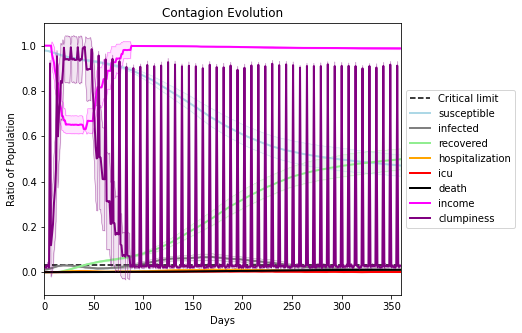

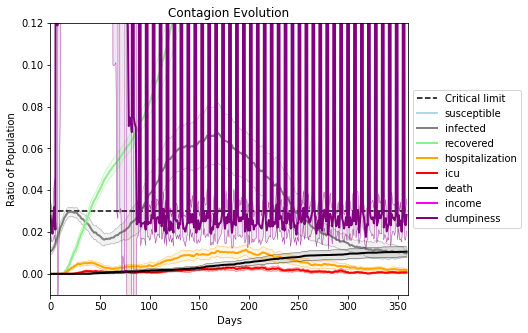

In [42]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.33
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[182, 9821, 2827, 6495, 7889, 8849, 2044, 4351, 7109, 5725, 2255, 5627, 2617, 8538, 9969, 439, 8304, 8967, 4857, 9174]
Average similarity between family members is 0.07781835992885146 at temperature 0.66
Average similarity between family and home is 0.9998559895929069 at temperature -1
Average similarity between students and their classroom is 0.07126987861370852 at temperature 0.66
Average classroom occupancy is 4.180555555555555 and number classrooms is 72
Average similarity between workers is 0.06373390863610107 at temperature 0.66
Average office occupancy is 3.205 and number offices is 200
Average friend similarity for adults: 0.12149006944028788 for kids: 0.11982325716159603
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogeneous

avg restaurant similarity 0.006275417919678306
avg restaurant similarity 0.15465084100000367
avg restaurant similarity 0.1524691197988667
avg restaurant similarity 0.07736729928435702
avg restaurant similarity 0.035018381374882876
avg restaurant similarity 0.11250521023993518
avg restaurant similarity -0.05581117386328177
avg restaurant similarity 0.06243497708352728
avg restaurant similarity -0.09401238577110943
avg restaurant similarity 0.03693328621634449
avg restaurant similarity 0.3053268833802843
avg restaurant similarity 0.15918304149293658
avg restaurant similarity 0.1535798295993069
avg restaurant similarity 0.1295236660741423
avg restaurant similarity -0.03585484541746416
avg restaurant similarity 0.03526908425094102
avg restaurant similarity -0.041437975697002825
avg restaurant similarity 0.013868719801554722
avg restaurant similarity 0.18767517893613564
avg restaurant similarity -0.12194662309217782
avg restaurant similarity 0.020525481545673373
avg restaurant similarity 0.

avg restaurant similarity 0.2682919421353366
avg restaurant similarity 0.20168029564997658
avg restaurant similarity 0.05147419891070796
avg restaurant similarity 0.08424882401125289
avg restaurant similarity 0.17945578680656207
avg restaurant similarity 0.06371590505477982
avg restaurant similarity 0.018610430481100136
avg restaurant similarity -0.042537882450472596
avg restaurant similarity 0.02960286732001808
avg restaurant similarity 0.009871231211948184
avg restaurant similarity 0.1738134155293574
avg restaurant similarity 0.05841762976582277
avg restaurant similarity -0.20045058363029458
avg restaurant similarity -0.05090690328275326
avg restaurant similarity -0.010675301375641606
avg restaurant similarity 0.04580179557752365
avg restaurant similarity 0.14163995636076407
avg restaurant similarity 0.019441822186261212
avg restaurant similarity -0.16783768329816948
avg restaurant similarity -0.10270611909711479
avg restaurant similarity -0.05189355443938376
avg restaurant similarit

avg restaurant similarity -0.08187175057451931
avg restaurant similarity 0.01413852477999857
avg restaurant similarity 0.031699182787068285
avg restaurant similarity -0.10293265215053167
avg restaurant similarity -0.030674186702943525
avg restaurant similarity 0.04870971543248499
avg restaurant similarity 0.05639941619990374
avg restaurant similarity 0.05645273651445267
avg restaurant similarity -0.0631616729345749
avg restaurant similarity -0.17487049984927922
avg restaurant similarity 0.09370228002273912
avg restaurant similarity 0.009845018936181598
avg restaurant similarity -0.07727062863812882
avg restaurant similarity 0.028749023946351298
avg restaurant similarity 0.048510972656077414
avg restaurant similarity -0.24472865845103575
avg restaurant similarity 0.1641293866696084
avg restaurant similarity -0.0625423834518142
avg restaurant similarity -0.022117534705026008
avg restaurant similarity 0.002438324981699976
avg restaurant similarity -0.19804640542891902
avg restaurant simil

avg restaurant similarity 0.21546477021181
avg restaurant similarity -0.18104255083985066
avg restaurant similarity 0.2583338113825771
avg restaurant similarity -0.028399113448909438
avg restaurant similarity -0.14523956286311718
avg restaurant similarity 0.20888502073878104
avg restaurant similarity -0.036058303930966096
avg restaurant similarity 0.06562796656676857
avg restaurant similarity 0.21439256469987503
avg restaurant similarity -0.002043509380788344
avg restaurant similarity -0.005218746430384211
avg restaurant similarity -0.1719144076580029
avg restaurant similarity 0.004489081719417555
avg restaurant similarity 0.005859960995815011
avg restaurant similarity 0.15140597939969808
avg restaurant similarity -0.14275133380610314
avg restaurant similarity -0.059179751756836034
avg restaurant similarity -0.004630817002599134
avg restaurant similarity -0.10443237423915558
avg restaurant similarity 0.15963691766974594
avg restaurant similarity 0.0990860836098102
avg restaurant simila

avg restaurant similarity 0.024997442200508136
avg restaurant similarity 0.01603756995074175
avg restaurant similarity 0.12461522455169206
avg restaurant similarity 0.0499532770179643
avg restaurant similarity 0.18192035638627815
avg restaurant similarity 0.3152134473769362
avg restaurant similarity -0.0379998361498436
avg restaurant similarity 0.1826014115311028
avg restaurant similarity 0.2064141864697792
avg restaurant similarity 0.02584951100987173
avg restaurant similarity 0.0033814701074944237
avg restaurant similarity 0.138024801551443
avg restaurant similarity 0.011182109771597733
avg restaurant similarity -0.12262413751486956
avg restaurant similarity 0.012449707609501525
avg restaurant similarity 0.17281198017690932
avg restaurant similarity 0.15514225387899938
avg restaurant similarity 0.17113539470341235
avg restaurant similarity 0.09442152661522159
avg restaurant similarity -0.0038023886989665225
avg restaurant similarity -0.12423285288192394
avg restaurant similarity 0.02

avg restaurant similarity -0.015313383224163202
avg restaurant similarity -0.16944964056414405
avg restaurant similarity 0.1463580997194477
avg restaurant similarity 0.022508881332914326
avg restaurant similarity 0.15893873556780996
avg restaurant similarity 0.040955776160401185
avg restaurant similarity 0.065203497114256
avg restaurant similarity -0.1476403098521701
avg restaurant similarity 0.031600957265096
avg restaurant similarity 0.07450411383976815
avg restaurant similarity 0.02812445855647403
avg restaurant similarity -0.0547091726037821
avg restaurant similarity 0.14880180381097066
avg restaurant similarity -0.00733390706652553
avg restaurant similarity 0.10572622642278491
avg restaurant similarity 0.1423876341566258
avg restaurant similarity 0.07204420318866209
avg restaurant similarity -0.06998527013799807
avg restaurant similarity -0.0635562810229188
avg restaurant similarity -0.06316495761028217
avg restaurant similarity 0.012154204543419533
avg restaurant similarity 0.192

avg restaurant similarity -0.09760672934946533
avg restaurant similarity -0.03059056557108879
avg restaurant similarity 0.09893048134683209
avg restaurant similarity 0.04402598936760375
avg restaurant similarity 0.0929107166585273
avg restaurant similarity 0.10693417883159584
avg restaurant similarity 0.08491990513750333
avg restaurant similarity 0.009071799147352257
avg restaurant similarity 0.02451781269560366
avg restaurant similarity -0.032993371829497846
avg restaurant similarity 0.04336614799478066
avg restaurant similarity 0.04743104413170153
avg restaurant similarity 0.09750199080067154
avg restaurant similarity 0.2397379252447832
avg restaurant similarity -0.0894666302436176
avg restaurant similarity 0.06332484321447622
avg restaurant similarity 0.021117636652117706
avg restaurant similarity 0.21676560885408824
avg restaurant similarity 0.03504770197388843
avg restaurant similarity -0.08920629838318697
avg restaurant similarity -0.029645967051036552
avg restaurant similarity 0

avg restaurant similarity -0.1296955051116103
avg restaurant similarity -0.010207249848320759
avg restaurant similarity 0.03134182524717195
avg restaurant similarity -0.15045805319236305
avg restaurant similarity -0.042610022936776175
avg restaurant similarity -0.0653077389072428
avg restaurant similarity 0.11284470679271066
avg restaurant similarity 0.33877235521304955
avg restaurant similarity 0.07659711010942799
avg restaurant similarity -0.03444776655145256
avg restaurant similarity 0.0452797094567659
avg restaurant similarity 0.14409301266591304
avg restaurant similarity -0.14329516505706844
avg restaurant similarity 0.11580510899470256
avg restaurant similarity -0.0461999238471629
avg restaurant similarity -0.1278078965244732
avg restaurant similarity 0.09232329227609659
avg restaurant similarity 0.08343315560143329
avg restaurant similarity -0.08151351891133937
avg restaurant similarity -0.005529563081216132
avg restaurant similarity 0.15419146043055745
avg restaurant similarity

avg restaurant similarity -0.15679695889323453
avg restaurant similarity -0.2401640278165407
avg restaurant similarity 0.1373345963062708
avg restaurant similarity 0.00805802639014457
avg restaurant similarity 0.18397090355332657
avg restaurant similarity -0.07367192559413697
avg restaurant similarity 0.0916469810234396
avg restaurant similarity 0.14818060268884328
avg restaurant similarity 0.007824270007750584
avg restaurant similarity 0.06823697366496032
avg restaurant similarity 0.23345738280366915
avg restaurant similarity -0.049692467745025705
avg restaurant similarity 0.011813968619119708
avg restaurant similarity 0.005259460338242437
avg restaurant similarity 0.06291765479324009
avg restaurant similarity 0.1177070322907892
avg restaurant similarity -0.2803102338464164
avg restaurant similarity -0.0653388922942479
avg restaurant similarity -0.07350923324980145
avg restaurant similarity -0.05091321205749558
avg restaurant similarity -0.34600657244320404
avg restaurant similarity 0

avg restaurant similarity 0.17628977579184768
avg restaurant similarity 0.04198058829074355
avg restaurant similarity -0.42624208663377794
avg restaurant similarity -0.12617986602159892
avg restaurant similarity 0.4744682419157912
avg restaurant similarity -0.05263804691887839
avg restaurant similarity -0.128533733837373
avg restaurant similarity -0.03959414478759484
avg restaurant similarity 0.1110563910297182
avg restaurant similarity -0.03543692054709099
avg restaurant similarity -0.12504265118157926
avg restaurant similarity -0.11312585553495694
avg restaurant similarity -0.3161148304493992
avg restaurant similarity 0.2965337702273618
avg restaurant similarity 0.06310142981898327
avg restaurant similarity -0.36448394416854196
avg restaurant similarity -0.19998589675029696
avg restaurant similarity 0.2323689052651996
avg restaurant similarity 0.16941560369237008
avg restaurant similarity -0.13788344666806454
avg restaurant similarity -0.025856207845565138
avg restaurant similarity -

avg restaurant similarity 0.07142722425810087
avg restaurant similarity -0.1301702919948206
avg restaurant similarity -0.0700913265960193
avg restaurant similarity 0.03268378499083763
avg restaurant similarity 0.028789008949494217
avg restaurant similarity -0.03200682689515726
avg restaurant similarity -0.1238592496989267
avg restaurant similarity -0.00405388119913902
avg restaurant similarity 0.10140901057171996
avg restaurant similarity -0.13365826190993668
avg restaurant similarity -0.06033367712284641
avg restaurant similarity -0.050243359013652546
avg restaurant similarity -0.09791630286414925
avg restaurant similarity 0.015650796521099453
avg restaurant similarity -0.1913149199110173
avg restaurant similarity 0.0942146883432107
avg restaurant similarity 0.014060836261131221
avg restaurant similarity -0.0807144307688845
avg restaurant similarity -0.11196420767197703
avg restaurant similarity 0.019761094461598724
avg restaurant similarity -0.04221205458258117
avg restaurant similar

avg restaurant similarity -0.007667837521738427
avg restaurant similarity 0.16345930582633283
avg restaurant similarity 0.07929845830737406
avg restaurant similarity 0.040336056357215086
avg restaurant similarity -0.02501323545750224
avg restaurant similarity -0.05437153409474903
avg restaurant similarity -0.052195277134207775
avg restaurant similarity -0.15093096442448137
avg restaurant similarity -0.062263203306298046
avg restaurant similarity -0.04645670026231402
avg restaurant similarity -0.11306152957156906
avg restaurant similarity 0.08701771281483862
avg restaurant similarity -0.16179424678667384
avg restaurant similarity -0.11372722453304022
avg restaurant similarity 0.07904928426387232
avg restaurant similarity 0.026388240931174485
avg restaurant similarity 0.023010644341054712
avg restaurant similarity -0.01968300646943066
avg restaurant similarity 0.18236143040747999
avg restaurant similarity -0.17194100413857796
avg restaurant similarity -0.11491409122117376
avg restaurant 

avg restaurant similarity 0.3173153810806374
avg restaurant similarity -0.14499126711699417
avg restaurant similarity -0.08700027591656297
avg restaurant similarity -0.09945254010277103
avg restaurant similarity 0.20266616122555448
avg restaurant similarity -0.05825907732053916
avg restaurant similarity -0.008439044590347214
avg restaurant similarity 0.036056888104400775
avg restaurant similarity -0.010072605240446508
avg restaurant similarity 0.22314904982416117
avg restaurant similarity -0.28261550116014034
avg restaurant similarity -0.1390343954197668
avg restaurant similarity 0.06110761491067134
avg restaurant similarity 0.05275773138506196
avg restaurant similarity 0.031881618472171996
avg restaurant similarity 0.05637361986854183
avg restaurant similarity 0.28953341333626803
avg restaurant similarity 0.23486294052608866
avg restaurant similarity 0.15725655156119953
avg restaurant similarity -0.09622619693408535
avg restaurant similarity 0.13811204366660773
avg restaurant similari

avg restaurant similarity -0.1084906897169973
avg restaurant similarity 0.03428959091174009
avg restaurant similarity 0.041142405862559
avg restaurant similarity 0.047346293550577734
avg restaurant similarity -0.2520878195888151
avg restaurant similarity -0.08479068165356315
avg restaurant similarity -0.10905414883225002
avg restaurant similarity 0.14480616954630993
avg restaurant similarity -0.043657210614707384
avg restaurant similarity -0.2284916533278335
avg restaurant similarity 0.0008094810161781929
avg restaurant similarity 0.07520607366629818
avg restaurant similarity -0.023189898081858534
avg restaurant similarity 0.06860787444229122
avg restaurant similarity -0.02901012424185805
avg restaurant similarity 0.13433951623814283
avg restaurant similarity 0.092711803757693
avg restaurant similarity 0.22758806298280218
avg restaurant similarity -0.003380018850405203
avg restaurant similarity -0.08255060983300727
avg restaurant similarity -0.04937086581387748
avg restaurant similarit

avg restaurant similarity 0.08752256348902285
avg restaurant similarity 0.05774099948766329
avg restaurant similarity 0.12705742145416216
avg restaurant similarity -0.0046128404099277515
avg restaurant similarity 0.1813652246933015
avg restaurant similarity 0.03916049288243064
avg restaurant similarity 0.022306973212856435
avg restaurant similarity 0.032445839857180275
avg restaurant similarity -0.35918880445643386
avg restaurant similarity 0.049183626070653554
avg restaurant similarity 0.10853077996708081
avg restaurant similarity -0.025689273369556932
avg restaurant similarity -0.035775804548232426
avg restaurant similarity 0.19817822981878927
avg restaurant similarity -0.026665794217656438
avg restaurant similarity 0.3551819215405317
avg restaurant similarity 0.2703368622101542
avg restaurant similarity -0.2839038550158613
avg restaurant similarity -0.12943526478087156
avg restaurant similarity 0.11613374621702999
avg restaurant similarity 0.05882288942027815
avg restaurant similari

avg restaurant similarity -0.17113814642462274
avg restaurant similarity 0.35320450012935245
avg restaurant similarity 0.10267701590359786
avg restaurant similarity 0.09733416836628823
avg restaurant similarity -0.1348436734982107
avg restaurant similarity 0.046846244768062484
avg restaurant similarity -0.16104637257151522
avg restaurant similarity 0.10346829860777314
avg restaurant similarity 0.11619374060785471
avg restaurant similarity 0.3893572635567473
avg restaurant similarity 0.08458147148936299
avg restaurant similarity -0.05569359363391718
avg restaurant similarity -0.12949922930847527
avg restaurant similarity -0.0034874541274326452
avg restaurant similarity -0.2124999642147778
avg restaurant similarity 0.5045757695190868
avg restaurant similarity -0.021904195790977857
avg restaurant similarity 0.10789743091585063
avg restaurant similarity 0.10760218764799176
avg restaurant similarity 0.20356686032445467
avg restaurant similarity -0.08258821787634504
avg restaurant similarity

avg restaurant similarity -0.15992136461890608
avg restaurant similarity 0.05156703649870902
avg restaurant similarity 0.019784982890156316
avg restaurant similarity 0.078126624284269
avg restaurant similarity 0.18594596930223398
avg restaurant similarity -0.011319331417566612
avg restaurant similarity 0.19094518465359148
avg restaurant similarity 0.16761128249742607
avg restaurant similarity 0.11736353657771785
avg restaurant similarity 0.1822720275929158
avg restaurant similarity -0.05628595874808582
avg restaurant similarity 0.15571100772176624
avg restaurant similarity -0.013227916792766426
avg restaurant similarity 0.16572138954621338
avg restaurant similarity -0.09102096478913826
avg restaurant similarity -0.053131422888272294
avg restaurant similarity -0.26134946185423297
avg restaurant similarity 0.08202104630208606
avg restaurant similarity 0.0004627872654020214
avg restaurant similarity -0.11328651617573944
avg restaurant similarity -0.038469521639872266
avg restaurant simila

avg restaurant similarity 0.15740200987927747
avg restaurant similarity 0.09676889865799178
avg restaurant similarity 0.2570579171547979
avg restaurant similarity 0.1202223278019827
avg restaurant similarity -0.04627234043596363
avg restaurant similarity 0.24105676684346214
avg restaurant similarity -0.15398428257840427
avg restaurant similarity 0.06081831976921986
avg restaurant similarity -0.049123159260360934
avg restaurant similarity 0.11842193981442824
avg restaurant similarity -0.01426722072055913
avg restaurant similarity 0.1284903376174798
avg restaurant similarity -0.032921277509132506
avg restaurant similarity 0.009109288268919883
avg restaurant similarity 0.14702809298293526
avg restaurant similarity -0.07416236752145965
avg restaurant similarity -0.10550312932928797
avg restaurant similarity -0.0167275434090412
avg restaurant similarity 0.062750039791618
avg restaurant similarity -0.015075152122848906
avg restaurant similarity 0.008607995298226248
avg restaurant similarity 

avg restaurant similarity -0.02641898870897163
avg restaurant similarity -0.05906720713497219
avg restaurant similarity 0.05997192251487053
avg restaurant similarity -0.09566105861205688
avg restaurant similarity 0.1460439045616156
avg restaurant similarity -0.039529802956974995
avg restaurant similarity -0.05517314258758976
avg restaurant similarity 0.01931026425401246
avg restaurant similarity -0.10907573603561316
avg restaurant similarity -0.0919135366452442
avg restaurant similarity 0.10709447978051594
avg restaurant similarity 0.19559404836838873
avg restaurant similarity -0.08122016081182519
avg restaurant similarity 0.1921417981457785
avg restaurant similarity 0.10322511705293093
avg restaurant similarity 0.12123791087687862
avg restaurant similarity 0.020599561809730545
avg restaurant similarity 0.019860817991118038
avg restaurant similarity 0.2572985081129221
avg restaurant similarity 0.20028982186628752
avg restaurant similarity 0.04169873510176696
avg restaurant similarity 0

avg restaurant similarity 0.10392174353888134
avg restaurant similarity 0.13948385102786134
avg restaurant similarity -0.26464342804751134
avg restaurant similarity -0.02341683786255907
avg restaurant similarity 0.20806551475552834
avg restaurant similarity -0.2667587155149006
avg restaurant similarity 0.11901229183529476
avg restaurant similarity -0.0653502960059743
avg restaurant similarity -0.006590632361239473
avg restaurant similarity -0.07050470828992728
avg restaurant similarity -0.028747344101357764
avg restaurant similarity 0.16055598046135605
avg restaurant similarity -0.1380242194066393
avg restaurant similarity 0.032435435677493366
avg restaurant similarity -0.030558578085769755
avg restaurant similarity 0.10011757833234734
avg restaurant similarity 0.17212282719457647
avg restaurant similarity -0.025637044325798306
avg restaurant similarity 0.2822849075091976
avg restaurant similarity -0.03993745430585328
avg restaurant similarity 0.09044218541288485
avg restaurant similar

avg restaurant similarity 0.10996749439848526
avg restaurant similarity -0.1032255560398426
avg restaurant similarity 0.018882940036293327
avg restaurant similarity 0.18751270626655314
avg restaurant similarity 0.13082201891891884
avg restaurant similarity 0.11318066270129656
avg restaurant similarity 0.17263825394974297
avg restaurant similarity 0.0951422774883228
avg restaurant similarity -0.12011611686227211
avg restaurant similarity 0.04143547889346146
avg restaurant similarity 0.22404160298538828
avg restaurant similarity 0.15275863790334146
avg restaurant similarity -0.003173833966169158
avg restaurant similarity -0.025402794885516694
avg restaurant similarity 0.07397275686067115
avg restaurant similarity 0.20954393280852113
avg restaurant similarity -0.028331567078656725
avg restaurant similarity 0.10102212990826401
avg restaurant similarity 0.07533188819903712
avg restaurant similarity -0.05516483213362144
avg restaurant similarity 0.1623812645959854
avg restaurant similarity 0

avg restaurant similarity -0.14723462190013345
avg restaurant similarity 0.09091474978971013
avg restaurant similarity 0.09215769720016825
avg restaurant similarity -0.1398660268809604
avg restaurant similarity -0.21198434669492006
avg restaurant similarity -0.0414186750861049
avg restaurant similarity 0.0061911638692297944
avg restaurant similarity 0.005611325840776403
avg restaurant similarity 0.046957749248788136
avg restaurant similarity 0.09676908500967746
avg restaurant similarity -0.10516417611224645
avg restaurant similarity 0.06623951931452525
avg restaurant similarity -0.07360458230422764
avg restaurant similarity -0.12156867925577956
avg restaurant similarity -0.15791793643258203
avg restaurant similarity 0.1132942216181027
avg restaurant similarity -0.1480138319849944
avg restaurant similarity -0.15564192808168592
avg restaurant similarity -0.0626589866837535
avg restaurant similarity 0.09848770986692286
avg restaurant similarity -0.042581758291263885
avg restaurant similar

avg restaurant similarity 0.07064911394030346
avg restaurant similarity 0.1360752575874493
avg restaurant similarity -0.18607103747895862
avg restaurant similarity 0.16948657850231716
avg restaurant similarity 0.4986929163944548
avg restaurant similarity -0.007251620532935985
avg restaurant similarity 0.030397863192713006
avg restaurant similarity 0.26872550315363714
avg restaurant similarity 0.23327512243027332
avg restaurant similarity 0.16997761703270306
avg restaurant similarity 0.03971057550676313
avg restaurant similarity 0.07722975282971276
avg restaurant similarity 0.14941747473594708
avg restaurant similarity 0.0964232120768514
avg restaurant similarity 0.22169031476873544
avg restaurant similarity 0.049765607953153095
avg restaurant similarity 0.017927578738387337
avg restaurant similarity -0.0017269731703952065
avg restaurant similarity 0.08481086740159054
avg restaurant similarity 0.08235660749276658
avg restaurant similarity 0.026205615946661275
avg restaurant similarity -

avg restaurant similarity 0.11609759150704384
avg restaurant similarity 0.05908805015438879
avg restaurant similarity 0.1028281806622328
avg restaurant similarity 0.09356345265690712
avg restaurant similarity 0.23661122669391738
avg restaurant similarity -0.10243881085547382
avg restaurant similarity -0.020420512389306936
avg restaurant similarity 0.10588245539290259
avg restaurant similarity 0.2587803148690396
avg restaurant similarity 0.06229091650461362
avg restaurant similarity 0.156826618088382
avg restaurant similarity 0.06792571121890024
avg restaurant similarity 0.02481674367398744
avg restaurant similarity 0.24665489831980375
avg restaurant similarity 0.15940782725386515
avg restaurant similarity 0.2523295058079783
avg restaurant similarity 0.22147403348171488
avg restaurant similarity 0.012892344994117377
avg restaurant similarity 0.22347907594739974
avg restaurant similarity 0.005961870972554462
avg restaurant similarity 0.05667008270858109
avg restaurant similarity 0.037880

avg restaurant similarity 0.0620985706232767
avg restaurant similarity 0.17159254009406777
avg restaurant similarity 0.11485439349331095
avg restaurant similarity 0.011430327613142745
avg restaurant similarity -0.20777885219196687
avg restaurant similarity 0.15627214383997493
avg restaurant similarity 0.194706793996267
avg restaurant similarity -0.017542830163481054
avg restaurant similarity 0.1177759082084688
avg restaurant similarity 0.16167832317683864
avg restaurant similarity 0.03283553778125835
avg restaurant similarity 0.2269755870851705
avg restaurant similarity -0.12028355920811887
avg restaurant similarity 0.2466671338130917
avg restaurant similarity 0.01839399552777388
avg restaurant similarity 0.08055900527267947
avg restaurant similarity -0.046035933867252826
avg restaurant similarity 0.07198155100784327
avg restaurant similarity 0.11118770515774118
avg restaurant similarity 0.12103786551448384
avg restaurant similarity -0.1700265945959252
avg restaurant similarity -0.0826

avg restaurant similarity -0.019540292059348156
avg restaurant similarity 0.010676575716127666
avg restaurant similarity -0.06025973958719272
avg restaurant similarity 0.1154339864957281
avg restaurant similarity -0.08275765668972068
avg restaurant similarity 0.3101897502822182
avg restaurant similarity 0.03827767177227667
avg restaurant similarity -0.058974248294452795
avg restaurant similarity 0.11157299407961883
avg restaurant similarity 0.2407673902633111
avg restaurant similarity -0.03984519934457674
avg restaurant similarity 0.11426478563272609
avg restaurant similarity -0.10969639015853898
avg restaurant similarity -0.05437993229538976
avg restaurant similarity 0.29311216783639077
avg restaurant similarity -0.06656537994400172
avg restaurant similarity 0.11529524610498901
avg restaurant similarity 0.06849912446145721
avg restaurant similarity -0.05124082557598577
avg restaurant similarity -0.1037910908153399
avg restaurant similarity 0.3400154188622273
avg restaurant similarity 

avg restaurant similarity 0.17017812438329408
avg restaurant similarity 0.015697906622951435
avg restaurant similarity 0.22508763495105485
avg restaurant similarity -0.18223483915288122
avg restaurant similarity 0.1668257818554087
avg restaurant similarity 0.005376278917379177
avg restaurant similarity 0.04500694892382326
avg restaurant similarity 0.060194262898436164
avg restaurant similarity 0.03112831380338793
avg restaurant similarity 0.21133242099390573
avg restaurant similarity 0.2628057130379154
avg restaurant similarity -0.11412983135162856
avg restaurant similarity 0.058470902710384506
avg restaurant similarity 0.015914339548533902
avg restaurant similarity 0.3002822955933675
avg restaurant similarity 0.38165894851808496
avg restaurant similarity -0.058476211158113856
avg restaurant similarity 0.08149466636911479
avg restaurant similarity 0.08480526358588267
avg restaurant similarity 0.07662574852038447
avg restaurant similarity -0.05351892585839557
avg restaurant similarity 0

avg restaurant similarity 0.21908672274077892
avg restaurant similarity -0.32025679751490477
avg restaurant similarity 0.06028573604913431
avg restaurant similarity -0.031715977221203534
avg restaurant similarity 0.01316124385923705
avg restaurant similarity 0.15208990175306364
avg restaurant similarity -0.012888654722612762
avg restaurant similarity 0.21427766342370988
avg restaurant similarity 0.07668302005179528
avg restaurant similarity 0.12001015547427295
avg restaurant similarity 0.0942752975147587
avg restaurant similarity 0.04831916297097458
avg restaurant similarity -0.28857219526210115
avg restaurant similarity 0.11987450439973
avg restaurant similarity 0.046556836752979114
avg restaurant similarity 0.06204987872464543
avg restaurant similarity -0.044962455233501196
avg restaurant similarity 0.038923849697061946
avg restaurant similarity 0.13312099273612216
avg restaurant similarity -0.12115586502110252
avg restaurant similarity 0.10599508280247155
avg restaurant similarity 0

avg restaurant similarity 0.09591013096236334
avg restaurant similarity -0.10273193535642682
avg restaurant similarity 0.007841254184820342
avg restaurant similarity -0.0530613316113594
avg restaurant similarity 0.018465408881024447
avg restaurant similarity 0.10741980486426272
avg restaurant similarity 0.04958198636853547
avg restaurant similarity -0.05350441789920368
avg restaurant similarity -0.21549110962800427
avg restaurant similarity 0.04526986079058996
avg restaurant similarity 0.0347566291401092
avg restaurant similarity 0.10712247442318669
avg restaurant similarity -0.017295207144095905
avg restaurant similarity -0.01836183914398611
avg restaurant similarity -0.2830479248229596
avg restaurant similarity -0.179538706343184
avg restaurant similarity -0.04634639059663789
avg restaurant similarity 0.09512863123366469
avg restaurant similarity -0.10330850343583187
avg restaurant similarity 0.1552364350141239
avg restaurant similarity 0.04094356981453965
avg restaurant similarity 0

avg restaurant similarity -0.009545562983891793
avg restaurant similarity 0.028898062159318283
avg restaurant similarity -0.1257023534844991
avg restaurant similarity 0.055459159552360214
avg restaurant similarity -0.19261141511175467
avg restaurant similarity 0.018311345681437857
avg restaurant similarity -0.11282460880491527
avg restaurant similarity -0.00970219525391582
avg restaurant similarity -0.18359725810477542
avg restaurant similarity 0.10974871899746896
avg restaurant similarity -0.13807335962309264
avg restaurant similarity -0.06125077705641751
avg restaurant similarity 0.06033732863253395
avg restaurant similarity 0.0009989339450486995
avg restaurant similarity 0.06959584971771637
avg restaurant similarity -0.02349672554115083
avg restaurant similarity 0.2538167324453261
avg restaurant similarity -0.04216171934922721
avg restaurant similarity -0.00240292205365962
avg restaurant similarity 0.09577330043215798
avg restaurant similarity 0.10161121439268346
avg restaurant simi

avg restaurant similarity -0.15363403429246741
avg restaurant similarity 0.1935396157498556
avg restaurant similarity -0.08463105988357496
avg restaurant similarity 0.19865394838316575
avg restaurant similarity 0.242035511986587
avg restaurant similarity 0.11543578449722802
avg restaurant similarity -0.11645173626232817
avg restaurant similarity -0.05914541940923042
avg restaurant similarity -0.41874162413417976
avg restaurant similarity 0.002123307892921028
avg restaurant similarity 0.030126960634573475
avg restaurant similarity 0.05306918124775876
avg restaurant similarity -0.3483174089174866
avg restaurant similarity 0.17572338811733346
avg restaurant similarity 0.10150570418804739
avg restaurant similarity 0.5970931183466466
avg restaurant similarity 0.07113021417926596
avg restaurant similarity 0.0168069326560231
avg restaurant similarity -0.0025379922377286126
avg restaurant similarity 0.18743944639638946
avg restaurant similarity 0.1209356273812297
avg restaurant similarity 0.24

avg restaurant similarity 0.09429116859585866
avg restaurant similarity 0.061642843402696434
avg restaurant similarity -0.020030732106930144
avg restaurant similarity 0.17600002242385335
avg restaurant similarity 0.06813394492194393
avg restaurant similarity 0.0838717864042797
avg restaurant similarity -0.009149075598137504
avg restaurant similarity 0.36129973043865926
avg restaurant similarity -0.17541861935112898
avg restaurant similarity -0.03292712022868912
avg restaurant similarity -0.09233181520436559
avg restaurant similarity -0.1203629260039458
avg restaurant similarity 0.07094116031313198
avg restaurant similarity 0.031897867863307214
avg restaurant similarity 0.08939441768655054
avg restaurant similarity 0.016213882707690128
avg restaurant similarity -0.010855506183035749
avg restaurant similarity -0.3774203306200971
avg restaurant similarity -0.1013909804637598
avg restaurant similarity -0.11941831655173507
avg restaurant similarity 0.020245537568094815
avg restaurant simila

avg restaurant similarity -0.09753656602943507
avg restaurant similarity 0.1771127390221514
avg restaurant similarity 0.1138588528919164
avg restaurant similarity 0.07649598051923451
avg restaurant similarity -0.22279282946736925
avg restaurant similarity -0.11694836071358039
avg restaurant similarity 0.14574962865477972
avg restaurant similarity 0.1294591512817568
avg restaurant similarity 0.0007675552575731146
avg restaurant similarity 0.15714318584834003
avg restaurant similarity -0.12067523184082228
avg restaurant similarity 0.05612391562633166
avg restaurant similarity 0.02729353070204045
avg restaurant similarity -0.1522462869364299
avg restaurant similarity 0.09585228650274452
avg restaurant similarity -0.01119279929529339
avg restaurant similarity -0.1253291893024302
avg restaurant similarity 0.1336359728512566
avg restaurant similarity -0.0004494946845242283
avg restaurant similarity 0.10214591684916452
avg restaurant similarity 0.06548408975349258
avg restaurant similarity 0.

avg restaurant similarity -0.1076421232607813
avg restaurant similarity 0.04585557213875766
avg restaurant similarity 0.16000109339419877
avg restaurant similarity 0.03895935523646222
avg restaurant similarity -0.06340073505524796
avg restaurant similarity -0.06656195432788378
avg restaurant similarity -0.16096975430134786
avg restaurant similarity -0.03104748158449734
avg restaurant similarity 0.03475267507478931
avg restaurant similarity -0.1258970009645612
avg restaurant similarity 0.199904365714838
avg restaurant similarity 0.08702940289198262
avg restaurant similarity 0.24521380969686482
avg restaurant similarity 0.017350872981758813
avg restaurant similarity 0.23432283173353013
avg restaurant similarity -0.0564638507836609
avg restaurant similarity 0.23168667111264007
avg restaurant similarity -0.08063319624504234
avg restaurant similarity -0.0828482463279595
avg restaurant similarity 0.06634683648615394
avg restaurant similarity 0.06733103805093439
avg restaurant similarity -0.2

avg restaurant similarity 0.07079801277703529
avg restaurant similarity 0.03972213013437439
avg restaurant similarity 0.09727892949990656
avg restaurant similarity 0.044144170215891565
avg restaurant similarity -0.011088858504258017
avg restaurant similarity -0.019500964298232844
avg restaurant similarity -0.06184899549210823
avg restaurant similarity 0.04633599429509011
avg restaurant similarity 0.23739705720638296
avg restaurant similarity -0.06524608601540054
avg restaurant similarity -0.038602448641064754
avg restaurant similarity 0.08788500102790428
avg restaurant similarity -0.049836348631953874
avg restaurant similarity 0.05988861202265258
avg restaurant similarity 0.1056712362293355
avg restaurant similarity 0.09436237645987984
avg restaurant similarity 0.03757452113458784
avg restaurant similarity -0.02492906923983647
avg restaurant similarity 0.020381744155379973
avg restaurant similarity 0.20051088307046513
avg restaurant similarity 0.19800299345890138
avg restaurant similar

avg restaurant similarity -0.045494543361073746
avg restaurant similarity 0.15701904879722006
avg restaurant similarity -0.020627532345543154
avg restaurant similarity -0.000587048723849154
avg restaurant similarity 0.10737807144851587
avg restaurant similarity 0.12508052829265828
avg restaurant similarity 0.07284666844708233
avg restaurant similarity 0.2980597906459332
avg restaurant similarity 0.01893095744914116
avg restaurant similarity 0.0698207076954143
avg restaurant similarity -0.04880100505991079
avg restaurant similarity 0.07661286239315497
avg restaurant similarity 0.2700117436679675
avg restaurant similarity -0.05169064735482923
avg restaurant similarity 0.06974310887724786
avg restaurant similarity 0.007567145697445407
avg restaurant similarity -0.010871990450712509
avg restaurant similarity 0.04555411515167858
avg restaurant similarity 0.042040472376659234
avg restaurant similarity 0.05357629192762263
avg restaurant similarity 0.17857803414424467
avg restaurant similarity

avg restaurant similarity -0.036736099127171455
avg restaurant similarity 0.13546406142232725
avg restaurant similarity 0.006306227814779288
avg restaurant similarity -0.04394226807667561
avg restaurant similarity 0.07335920361215004
avg restaurant similarity -0.010852873000250868
avg restaurant similarity 0.055675074900609446
avg restaurant similarity 0.038829545480404154
avg restaurant similarity 0.349729604941923
avg restaurant similarity 0.05279707639136626
avg restaurant similarity -0.07858689677550026
avg restaurant similarity -0.13253228778820786
avg restaurant similarity 0.011156855281430409
avg restaurant similarity -0.0638302438166061
avg restaurant similarity -0.13952655643748002
avg restaurant similarity -0.0544543895329805
avg restaurant similarity -0.0034252702574710664
avg restaurant similarity 0.018057394723735527
avg restaurant similarity -0.13288987657735124
avg restaurant similarity -0.11360676545730002
avg restaurant similarity 0.08713401984272634
avg restaurant sim

avg restaurant similarity 0.11263012325936791
avg restaurant similarity 0.022273324110123623
avg restaurant similarity 0.09845751724306082
avg restaurant similarity -0.08573673142046873
avg restaurant similarity -0.02801304737597162
avg restaurant similarity -0.06545087454033095
avg restaurant similarity 0.07194794677957866
avg restaurant similarity 0.23282391324344773
avg restaurant similarity 0.1158510702813835
avg restaurant similarity 0.10847219586882319
avg restaurant similarity -0.07627609794756353
avg restaurant similarity -0.1046577228938153
avg restaurant similarity 0.05749126683233163
avg restaurant similarity 0.09094517823598337
avg restaurant similarity 0.08847493570109911
avg restaurant similarity -0.13789999211056558
avg restaurant similarity 0.04816562253665938
avg restaurant similarity -0.15070426665295703
avg restaurant similarity -0.05534693358208725
avg restaurant similarity 0.15642696338004075
avg restaurant similarity -0.05098246138992223
avg restaurant similarity 

avg restaurant similarity -0.0134705234075832
avg restaurant similarity 0.14714709441492307
avg restaurant similarity -0.27067971348443953
avg restaurant similarity 0.07313069132670577
avg restaurant similarity 0.10689871362678642
avg restaurant similarity 0.003938079074035793
avg restaurant similarity -0.05381445292913941
avg restaurant similarity -0.20679652809288876
avg restaurant similarity 0.17064187850703347
avg restaurant similarity 0.04784849374860653
avg restaurant similarity 0.03141733357667996
avg restaurant similarity 0.20472427317343053
avg restaurant similarity -0.0898420633247161
avg restaurant similarity 0.005531192590338736
avg restaurant similarity -0.07445779769535649
avg restaurant similarity 0.0371408310544357
avg restaurant similarity 0.14441949792298567
avg restaurant similarity -0.1523603142056668
avg restaurant similarity 0.06765625184511631
avg restaurant similarity 0.02274648508494536
avg restaurant similarity 0.14565846205082203
avg restaurant similarity -0.

avg restaurant similarity 0.038740893915847736
avg restaurant similarity 0.09845312277076818
avg restaurant similarity 0.010991506769924286
avg restaurant similarity -0.0625536636480646
avg restaurant similarity -0.060214254831090275
avg restaurant similarity 0.09928912102875054
avg restaurant similarity -0.08813283814797063
avg restaurant similarity -0.29535970102937564
avg restaurant similarity 0.04644183272543716
avg restaurant similarity 0.1303855333982268
avg restaurant similarity 0.006819295899311911
avg restaurant similarity 0.20689572741132964
avg restaurant similarity 0.14116145984180184
avg restaurant similarity 0.23940208882704717
avg restaurant similarity -0.15187826837015725
avg restaurant similarity 0.08815248926758122
avg restaurant similarity -0.03965185427400199
avg restaurant similarity 0.1351484912774791
avg restaurant similarity -0.0550819601736744
avg restaurant similarity 0.0711318926909681
avg restaurant similarity 0.1962769352041174
avg restaurant similarity 0.2

(<function dict.items>, <function dict.items>, <function dict.items>)

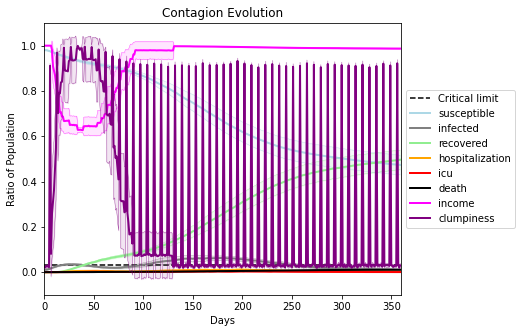

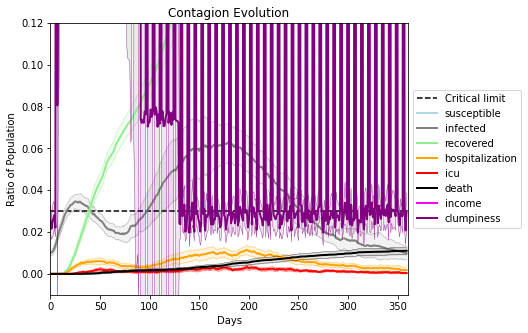

In [43]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.66
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6653, 1556, 9320, 4897, 2746, 7471, 1695, 2564, 719, 8112, 7775, 2139, 9659, 3728, 237, 8945, 1439, 4221, 5215, 9150]
Average similarity between family members is -0.006159014253490762 at temperature 1
Average similarity between family and home is 0.9998661518043683 at temperature -1
Average similarity between students and their classroom is -0.011674663498242734 at temperature 1
Average classroom occupancy is 3.8028169014084505 and number classrooms is 71
Average similarity between workers is 0.011828773109066947 at temperature 1
Average office occupancy is 3.355 and number offices is 200
Average friend similarity for adults: 0.08549749949878653 for kids: 0.08716725575279537
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBui

avg restaurant similarity 0.23756433396725055
avg restaurant similarity 0.10119781949862748
avg restaurant similarity 0.1671454404557524
avg restaurant similarity 0.0029119634312503953
avg restaurant similarity 0.08416713542363834
avg restaurant similarity 0.1356551589193927
avg restaurant similarity -0.21114569441603684
avg restaurant similarity 0.06299843457389316
avg restaurant similarity 0.027529081683351976
avg restaurant similarity -0.03588609390699925
avg restaurant similarity -0.010850667688161916
avg restaurant similarity -0.03522199294325933
avg restaurant similarity -0.02241274663829719
avg restaurant similarity 0.049116911277183775
avg restaurant similarity 0.08388982489612837
avg restaurant similarity 0.06035299237029268
avg restaurant similarity 0.001866924251419861
avg restaurant similarity 0.05164360755432318
avg restaurant similarity 0.03429564157708336
avg restaurant similarity 0.1413175683227824
avg restaurant similarity 0.13775274598629303
avg restaurant similarity 

avg restaurant similarity -0.03682230544738347
avg restaurant similarity 0.04527469699603027
avg restaurant similarity 0.15719577361469955
avg restaurant similarity 0.030579869380202768
avg restaurant similarity 0.07106971558928762
avg restaurant similarity -0.11133665286595207
avg restaurant similarity 0.1901318277872072
avg restaurant similarity 0.15653490659195543
avg restaurant similarity 0.23926989106124055
avg restaurant similarity 0.07668513434816256
avg restaurant similarity 0.13091663182347724
avg restaurant similarity 0.16947566967550656
avg restaurant similarity 0.09936453913156669
avg restaurant similarity 0.08842533446523705
avg restaurant similarity 0.06794232462288166
avg restaurant similarity -0.1785297966469178
avg restaurant similarity 0.07327397673988234
avg restaurant similarity 0.07917984532096843
avg restaurant similarity 0.13407845092252532
avg restaurant similarity 0.026144374556568397
avg restaurant similarity -0.1364023435821824
avg restaurant similarity 0.103

avg restaurant similarity -0.024960048259322496
avg restaurant similarity 0.05484396328909422
avg restaurant similarity 0.0597004483363467
avg restaurant similarity 0.07622033271582475
avg restaurant similarity 0.031417803585830385
avg restaurant similarity -0.03835285627092289
avg restaurant similarity -0.038107311135421644
avg restaurant similarity 0.03314363747118709
avg restaurant similarity -0.17843598075545186
avg restaurant similarity -0.07312506235880564
avg restaurant similarity -0.05398386504497569
avg restaurant similarity -0.06638118016911963
avg restaurant similarity 0.05833405078644522
avg restaurant similarity 0.05237492809030529
avg restaurant similarity 0.0800120068721647
avg restaurant similarity 0.009442397794643249
avg restaurant similarity 0.04007770936288129
avg restaurant similarity -0.12161257772051544
avg restaurant similarity -0.2135568371701917
avg restaurant similarity -0.12768051950931758
avg restaurant similarity -0.11373961878875777
avg restaurant similar

avg restaurant similarity -0.1946576600311698
avg restaurant similarity 0.20731931265269754
avg restaurant similarity -0.07279829140977584
avg restaurant similarity 0.1490366490414389
avg restaurant similarity -0.16527017528424492
avg restaurant similarity -0.08933454162062675
avg restaurant similarity 0.04192181022074025
avg restaurant similarity -0.09203343583538627
avg restaurant similarity 0.006006254362000948
avg restaurant similarity -0.03199076459425623
avg restaurant similarity -0.13431114178545664
avg restaurant similarity -0.07696828916235933
avg restaurant similarity 0.06904740960968968
avg restaurant similarity -0.12660968612182796
avg restaurant similarity -0.20524127521521543
avg restaurant similarity -0.05871271472423216
avg restaurant similarity 0.02857103307535241
avg restaurant similarity -0.06997432329288113
avg restaurant similarity -0.3219258520161818
avg restaurant similarity -0.0314036907978639
avg restaurant similarity 0.11194525237239972
avg restaurant similari

avg restaurant similarity 0.0037628626215550545
avg restaurant similarity -0.008580903281045632
avg restaurant similarity -0.06568191571463573
avg restaurant similarity 0.023825987754719922
avg restaurant similarity -0.0029376744300758767
avg restaurant similarity -0.026091300202706037
avg restaurant similarity -0.056894981561863706
avg restaurant similarity -0.054911578479345365
avg restaurant similarity 0.06546247133361908
avg restaurant similarity -0.035034191319599596
avg restaurant similarity -0.10302276011213206
avg restaurant similarity -0.05049754611507684
avg restaurant similarity -0.07241184923378546
avg restaurant similarity -0.15810121687001713
avg restaurant similarity 0.08297808969445178
avg restaurant similarity 0.008285168222546425
avg restaurant similarity -0.05285839255273448
avg restaurant similarity 0.0747693590771737
avg restaurant similarity -0.006346479403872817
avg restaurant similarity -0.03588780167248032
avg restaurant similarity -0.05310835217126804
avg rest

avg restaurant similarity -0.059632618285508907
avg restaurant similarity -0.044584517311980425
avg restaurant similarity -0.030254960020960314
avg restaurant similarity -0.17814346607249476
avg restaurant similarity -0.17876022244136056
avg restaurant similarity -0.07892242101203482
avg restaurant similarity 0.18394745991791728
avg restaurant similarity -0.03870596183291848
avg restaurant similarity 0.04044370544918325
avg restaurant similarity -0.13195982443342522
avg restaurant similarity -0.052192673326838225
avg restaurant similarity 0.008644935997481848
avg restaurant similarity -0.059391850967892124
avg restaurant similarity 0.09164856729917376
avg restaurant similarity -0.04921913242527863
avg restaurant similarity -0.048293156126931955
avg restaurant similarity 0.18347457869024267
avg restaurant similarity 0.15484757024494863
avg restaurant similarity 0.008135319722311008
avg restaurant similarity 0.020398372138610597
avg restaurant similarity -0.08535298409280351
avg restaura

avg restaurant similarity 0.09703193648153385
avg restaurant similarity 0.07965882778043565
avg restaurant similarity -0.05352229741028982
avg restaurant similarity 0.049319091277547876
avg restaurant similarity 0.22719355285302673
avg restaurant similarity -0.01847754400552379
avg restaurant similarity -0.04032046386351446
avg restaurant similarity 0.07079559058767826
avg restaurant similarity 0.08798569555272955
avg restaurant similarity -0.05815617170203999
avg restaurant similarity -0.12524673303940378
avg restaurant similarity 0.049601297188124595
avg restaurant similarity 0.27989401353192517
avg restaurant similarity 0.1970160812717722
avg restaurant similarity 0.0026352601491289
avg restaurant similarity 0.07025535463592997
avg restaurant similarity -0.007331980366322228
avg restaurant similarity -0.18728444059464203
avg restaurant similarity -0.08432307472201152
avg restaurant similarity 0.013020784746595345
avg restaurant similarity 0.014202490752278989
avg restaurant similari

avg restaurant similarity 0.05661786980632195
avg restaurant similarity 0.016613923266159444
avg restaurant similarity -0.1242686730168146
avg restaurant similarity 0.01963556488230968
avg restaurant similarity 0.05698876552862981
avg restaurant similarity 0.028666179673772794
avg restaurant similarity 0.10291839523610105
avg restaurant similarity 0.08192082053327672
avg restaurant similarity 0.1583436446314592
avg restaurant similarity 0.01820768095874431
avg restaurant similarity -0.2433983891827091
avg restaurant similarity -0.18875114599625126
avg restaurant similarity -0.08063906092470953
avg restaurant similarity 0.057168788509651534
avg restaurant similarity -0.0128313993573617
avg restaurant similarity -0.022630829597423845
avg restaurant similarity 0.07120420817178026
avg restaurant similarity -0.1922911853749517
avg restaurant similarity -0.10462052037226807
avg restaurant similarity -0.13744940183082588
avg restaurant similarity 0.2506016450102359
avg restaurant similarity -

avg restaurant similarity -0.07065205854358647
avg restaurant similarity -0.03166638129706582
avg restaurant similarity 0.028628929824006714
avg restaurant similarity 0.048993739499371705
avg restaurant similarity -0.025963716982746094
avg restaurant similarity -0.04069580704325713
avg restaurant similarity -0.13898844811405767
avg restaurant similarity -0.024335773143461192
avg restaurant similarity 0.1597538057791391
avg restaurant similarity -0.08534024813399478
avg restaurant similarity -0.08449863667676583
avg restaurant similarity -0.05327399596328336
avg restaurant similarity -0.09886219405695255
avg restaurant similarity -0.20775223329970793
avg restaurant similarity -0.08258438138468271
avg restaurant similarity -0.023905704729489104
avg restaurant similarity -0.10502067040756158
avg restaurant similarity -0.137738735308613
avg restaurant similarity 0.04148602794396511
avg restaurant similarity -0.001590838004619511
avg restaurant similarity -0.011077679928039085
avg restauran

avg restaurant similarity -0.21349126531176937
avg restaurant similarity 0.0522457304685959
avg restaurant similarity -0.08693372856904336
avg restaurant similarity 0.08515269187351268
avg restaurant similarity 0.11467312762703322
avg restaurant similarity -0.07286467714061715
avg restaurant similarity -0.25766032848093307
avg restaurant similarity 0.0467805385137317
avg restaurant similarity 0.10868715583318611
avg restaurant similarity -0.23473030437441303
avg restaurant similarity 0.05601051860774932
avg restaurant similarity -0.1552195881688686
avg restaurant similarity -0.020583720933019085
avg restaurant similarity -0.08365523684442468
avg restaurant similarity 0.03857270528387862
avg restaurant similarity 0.16414378853660025
avg restaurant similarity 0.017851537386190212
avg restaurant similarity -0.11316436149844601
avg restaurant similarity -0.07041026860041447
avg restaurant similarity 0.0028276407791359755
avg restaurant similarity 0.012401077317926208
avg restaurant similar

avg restaurant similarity 0.016981956330219476
avg restaurant similarity 0.075332046267233
avg restaurant similarity 0.02984387211720384
avg restaurant similarity 0.06381534480020373
avg restaurant similarity 0.2483736709245129
avg restaurant similarity 0.11306771847784913
avg restaurant similarity 0.10466547579391357
avg restaurant similarity -0.16396481469230315
avg restaurant similarity 0.16114714517121848
avg restaurant similarity 0.07765941052574515
avg restaurant similarity -0.011015911769636226
avg restaurant similarity 0.14527331020995615
avg restaurant similarity -0.11969261032608297
avg restaurant similarity 0.12401717369525422
avg restaurant similarity 0.08276663647805937
avg restaurant similarity 0.058819453929002154
avg restaurant similarity -0.022221038547852356
avg restaurant similarity -0.021149862607315092
avg restaurant similarity 0.06598532803860906
avg restaurant similarity 0.18742619907167224
avg restaurant similarity 0.07978314666900782
avg restaurant similarity 0

avg restaurant similarity -0.062604898633598
avg restaurant similarity 0.1050944872749191
avg restaurant similarity -0.03785763366743113
avg restaurant similarity 0.13852489891028608
avg restaurant similarity -0.15124522225598475
avg restaurant similarity 0.17237562751202642
avg restaurant similarity 0.20543652712597898
avg restaurant similarity 0.08864510726877968
avg restaurant similarity 0.16659812679612074
avg restaurant similarity 0.19178534588127694
avg restaurant similarity 0.06747421741379239
avg restaurant similarity 0.0954158437413668
avg restaurant similarity 0.019460686118984973
avg restaurant similarity 0.2897569089565199
avg restaurant similarity 0.010200318014415174
avg restaurant similarity 0.2581712835449114
avg restaurant similarity 0.17068117688668213
avg restaurant similarity 0.04320845631862505
avg restaurant similarity -0.08900620639263501
avg restaurant similarity -0.03525207710719118
avg restaurant similarity 0.12136288970402659
avg restaurant similarity 0.09150

avg restaurant similarity -0.0034277115612671803
avg restaurant similarity -0.2561272693030185
avg restaurant similarity -0.05273895355092598
avg restaurant similarity 0.11316206476407453
avg restaurant similarity 0.15209841904722113
avg restaurant similarity 0.14406425538149342
avg restaurant similarity -0.013002937162867967
avg restaurant similarity 0.0789714438982027
avg restaurant similarity -0.08713380433757438
avg restaurant similarity 0.03391561707140282
avg restaurant similarity -0.03426920436845694
avg restaurant similarity -0.0408471497390456
avg restaurant similarity 0.22408408158589788
avg restaurant similarity 0.01269953932961074
avg restaurant similarity 0.062365467321833734
avg restaurant similarity 0.060570482854120186
avg restaurant similarity 0.12671446631753605
avg restaurant similarity -0.010822071870441593
avg restaurant similarity 0.29965272972057283
avg restaurant similarity 0.031244229852493987
avg restaurant similarity 0.03198161162381034
avg restaurant similar

avg restaurant similarity 0.08973607121154945
avg restaurant similarity 0.04806571899323258
avg restaurant similarity 0.15942959269751952
avg restaurant similarity 0.14424389489305345
avg restaurant similarity -0.1047873124890926
avg restaurant similarity -0.04942173872858332
avg restaurant similarity 0.0897154528515645
avg restaurant similarity 0.1728582171800282
avg restaurant similarity -0.023342376251182375
avg restaurant similarity -0.17496064886175616
avg restaurant similarity -0.0075813951372264085
avg restaurant similarity -0.08535526500794172
avg restaurant similarity 0.052821607426858506
avg restaurant similarity 0.05496747687200034
avg restaurant similarity -0.060066128157900724
avg restaurant similarity 0.000552766340570531
avg restaurant similarity -0.10963805983331006
avg restaurant similarity -0.010728224284861575
avg restaurant similarity 0.11393269930198968
avg restaurant similarity -0.1041065138067023
avg restaurant similarity -0.030328386845953664
avg restaurant simi

avg restaurant similarity 0.21010348111599142
avg restaurant similarity -0.038624813058080215
avg restaurant similarity 0.0845043430946929
avg restaurant similarity 0.09540943997403387
avg restaurant similarity -0.014929388902136492
avg restaurant similarity 0.04269133340902443
avg restaurant similarity 0.06462662654982054
avg restaurant similarity 0.1007355694942619
avg restaurant similarity 0.2022115068305447
avg restaurant similarity 0.017636912820783505
avg restaurant similarity 0.13760872493018383
avg restaurant similarity 0.027459085151414413
avg restaurant similarity 0.2657334398838975
avg restaurant similarity 0.008371773994091012
avg restaurant similarity 0.12533827535196002
avg restaurant similarity 0.0029443348326273315
avg restaurant similarity 0.09942615354046457
avg restaurant similarity -0.03859430237355768
avg restaurant similarity 0.09685865919929904
avg restaurant similarity 0.09555297305472542
avg restaurant similarity -0.008639428277645413
avg restaurant similarity 

avg restaurant similarity -0.14524503591312551
avg restaurant similarity 0.06530423298234701
avg restaurant similarity 0.07736579029928065
avg restaurant similarity -0.08416999481798401
avg restaurant similarity -0.07284142540717
avg restaurant similarity -0.12316136114463487
avg restaurant similarity 0.016403936225807367
avg restaurant similarity -0.09364691073783847
avg restaurant similarity 0.1558661733739472
avg restaurant similarity 0.008118879326197807
avg restaurant similarity -0.08204046080096089
avg restaurant similarity 0.12246810705067097
avg restaurant similarity 0.2753501101444702
avg restaurant similarity 0.12593540726302446
avg restaurant similarity 0.09121870301611905
avg restaurant similarity -0.1128007535102242
avg restaurant similarity 0.1958094005250173
avg restaurant similarity 0.10975056853563323
avg restaurant similarity 0.022693747808348888
avg restaurant similarity 0.02634653213399311
avg restaurant similarity -0.030165059164685166
avg restaurant similarity 0.3

avg restaurant similarity 0.19743164494946133
avg restaurant similarity 0.2408229292653822
avg restaurant similarity -0.11453486400518818
avg restaurant similarity -0.32762613455033807
avg restaurant similarity 0.04270036568011
avg restaurant similarity 0.0701954490312959
avg restaurant similarity 0.039670998779393354
avg restaurant similarity -0.08036695865520654
avg restaurant similarity 0.4435015350945889
avg restaurant similarity -0.21656144288223028
avg restaurant similarity -0.06545735984450088
avg restaurant similarity 0.08511966948228855
avg restaurant similarity -0.08892055094743563
avg restaurant similarity 0.26941206178361615
avg restaurant similarity -0.25119617731428356
avg restaurant similarity -0.054284570444125005
avg restaurant similarity -0.01086887712231141
avg restaurant similarity 0.07121596667456102
avg restaurant similarity 0.23048066259240735
avg restaurant similarity 0.2189642907716808
avg restaurant similarity -0.010227019394274022
avg restaurant similarity -0

avg restaurant similarity 0.112695026448272
avg restaurant similarity 0.05412210794831277
avg restaurant similarity -0.24379425505415564
avg restaurant similarity 0.05257540943923891
avg restaurant similarity 0.05608853010515666
avg restaurant similarity 0.17482310959693947
avg restaurant similarity -0.14933709422591443
avg restaurant similarity -0.22497828578432624
avg restaurant similarity -0.031500174021015015
avg restaurant similarity -0.04731290495006472
avg restaurant similarity 0.023265113966373815
avg restaurant similarity -0.02396551932118096
avg restaurant similarity -0.00119141706978515
avg restaurant similarity 0.14003127184430658
avg restaurant similarity -0.203936702730992
avg restaurant similarity -0.016879059513646016
avg restaurant similarity -0.1870908694651995
avg restaurant similarity 0.021045524045527054
avg restaurant similarity -0.17775381083992156
avg restaurant similarity -0.06089450094275642
avg restaurant similarity -0.008933973941622859
avg restaurant simila

avg restaurant similarity -0.018405179169586915
avg restaurant similarity 0.10806346113383715
avg restaurant similarity 0.09932407853296021
avg restaurant similarity 0.005115415649155334
avg restaurant similarity 0.04736906429598042
avg restaurant similarity -0.07854701041132645
avg restaurant similarity -0.07964750110100802
avg restaurant similarity 0.10334646234642637
avg restaurant similarity -0.1387854857495562
avg restaurant similarity 0.10084725271128991
avg restaurant similarity -0.10577837104548357
avg restaurant similarity 0.047777799236436595
avg restaurant similarity -0.1370172682084104
avg restaurant similarity -0.11781126837821554
avg restaurant similarity 0.03424899666918922
avg restaurant similarity -0.004321520288020297
avg restaurant similarity 0.053812743086605115
avg restaurant similarity 0.05216496734210526
avg restaurant similarity -0.13535314158813092
avg restaurant similarity -0.13352323051837814
avg restaurant similarity -0.24261474775474456
avg restaurant simil

avg restaurant similarity 0.0027615343427581096
avg restaurant similarity -0.1342722432999347
avg restaurant similarity 0.15609709602202326
avg restaurant similarity 0.18808126671213016
avg restaurant similarity 0.08917729821611303
avg restaurant similarity -0.22132260903189227
avg restaurant similarity 0.03710979275865799
avg restaurant similarity 0.09376465987774803
avg restaurant similarity 0.0438807163098025
avg restaurant similarity -0.19507195634586846
avg restaurant similarity 0.18284261771147953
avg restaurant similarity -0.3277429388454486
avg restaurant similarity -0.16736658863653756
avg restaurant similarity 0.1245673543423657
avg restaurant similarity 0.11206140237808769
avg restaurant similarity 0.14936416759171192
avg restaurant similarity 0.33385794120229845
avg restaurant similarity 0.0316162076457135
avg restaurant similarity -0.16021189720981405
avg restaurant similarity 0.15509542954108824
avg restaurant similarity -0.050026306494168435
avg restaurant similarity -0.

avg restaurant similarity 0.023974160618041845
avg restaurant similarity 0.11135705874879163
avg restaurant similarity 0.010551135087772348
avg restaurant similarity 0.1822140858006924
avg restaurant similarity -0.12193466583615827
avg restaurant similarity -0.3077892287610578
avg restaurant similarity -0.10177537408664936
avg restaurant similarity -0.09566366915367693
avg restaurant similarity -0.14989985682976373
avg restaurant similarity -0.022967133506974945
avg restaurant similarity -0.026962627967741987
avg restaurant similarity -0.06803817280961913
avg restaurant similarity -0.130645625607608
avg restaurant similarity 0.017709849031536957
avg restaurant similarity -0.1388003978067075
avg restaurant similarity -0.08481115007262661
avg restaurant similarity 0.19573367200945185
avg restaurant similarity -0.09499163329923316
avg restaurant similarity -0.14029022134797575
avg restaurant similarity 0.04780106088311313
avg restaurant similarity -0.041098932922739174
avg restaurant simi

avg restaurant similarity -0.06362105806791402
avg restaurant similarity 0.24015239033083804
avg restaurant similarity 0.041259121664452336
avg restaurant similarity 0.04339553862467943
avg restaurant similarity -0.03045284522986154
avg restaurant similarity -0.07150758833191569
avg restaurant similarity -0.014094730555443974
avg restaurant similarity -0.12632503114196236
avg restaurant similarity 0.0005756933814366038
avg restaurant similarity -0.1982103491964588
avg restaurant similarity -0.06578960053887065
avg restaurant similarity -0.10961497795333949
avg restaurant similarity 0.13562261726840213
avg restaurant similarity -0.0880871454681307
avg restaurant similarity 0.10362795766799719
avg restaurant similarity 0.2637085822259096
avg restaurant similarity 0.08195437137429953
avg restaurant similarity -0.16296029096877726
avg restaurant similarity -0.03658955822193092
avg restaurant similarity 0.008816829735233633
avg restaurant similarity 0.03347950090686095
avg restaurant simila

avg restaurant similarity 0.06432372357801683
avg restaurant similarity 0.03987725614870356
avg restaurant similarity 0.08612124682609039
avg restaurant similarity 0.011995655782486582
avg restaurant similarity -0.09607019377537374
avg restaurant similarity 0.03558201370442431
avg restaurant similarity -0.041043641822417286
avg restaurant similarity 0.22461457089708164
avg restaurant similarity 0.058453976480645764
avg restaurant similarity 0.08735017339958058
avg restaurant similarity -0.0802159329309275
avg restaurant similarity 0.011423880654196401
avg restaurant similarity -0.17279583706692195
avg restaurant similarity -0.2585588269086973
avg restaurant similarity 0.01735555382678832
avg restaurant similarity -0.055358988624667385
avg restaurant similarity 0.17291906950031766
avg restaurant similarity 0.26153897205145543
avg restaurant similarity 0.10533464373034777
avg restaurant similarity -0.04877372706959866
avg restaurant similarity 0.2585829096394865
avg restaurant similarity

avg restaurant similarity -0.15980847811877363
avg restaurant similarity 0.1363673468114012
avg restaurant similarity 0.013366649821324494
avg restaurant similarity 0.06396698325545794
avg restaurant similarity 0.004729097889659158
avg restaurant similarity -0.07006075333585755
avg restaurant similarity -0.1740522461920749
avg restaurant similarity 0.08143496143933163
avg restaurant similarity 0.16609334173131332
avg restaurant similarity -0.08720396002243684
avg restaurant similarity 0.0811045341304519
avg restaurant similarity 0.06611027511450596
avg restaurant similarity 0.08433871287974444
avg restaurant similarity 0.055903584467570905
avg restaurant similarity -0.2647573565510135
avg restaurant similarity 0.025442689474092738
avg restaurant similarity -0.10949222606548865
avg restaurant similarity 0.04988581835402786
avg restaurant similarity 0.07552834635923435
avg restaurant similarity -0.09794173019369731
avg restaurant similarity -0.005019873202730991
avg restaurant similarity

avg restaurant similarity -0.13216487883221523
avg restaurant similarity 0.10868983258181486
avg restaurant similarity 0.019637691066475647
avg restaurant similarity 0.16152241737742296
avg restaurant similarity 0.12397829469249223
avg restaurant similarity 0.007458620637203311
avg restaurant similarity 0.2325329106380797
avg restaurant similarity 0.010146619511493149
avg restaurant similarity -0.20777564346004873
avg restaurant similarity -0.2959646911124571
avg restaurant similarity -0.06074957550491021
avg restaurant similarity -0.047287140075741675
avg restaurant similarity 0.07956513667465764
avg restaurant similarity 0.22714996885775066
avg restaurant similarity 0.01312753466904576
avg restaurant similarity 0.30085838908719953
avg restaurant similarity 0.058347942590330305
avg restaurant similarity 0.15159767443318928
avg restaurant similarity 0.20022117426341132
avg restaurant similarity -0.12436907959055363
avg restaurant similarity -0.017848921442043766
avg restaurant similari

avg restaurant similarity 0.023199851783210115
avg restaurant similarity 0.12572689998856787
avg restaurant similarity 0.02446908523252489
avg restaurant similarity -0.10765984862669217
avg restaurant similarity 0.15869599913600324
avg restaurant similarity 0.07262527808935798
avg restaurant similarity 0.03848443852727917
avg restaurant similarity -0.04614283230407012
avg restaurant similarity -0.01932769351349079
avg restaurant similarity 0.12752560284680783
avg restaurant similarity 0.1902821805765303
avg restaurant similarity 0.0011557520242612205
avg restaurant similarity 0.004665842887372262
avg restaurant similarity 0.07892288740034506
avg restaurant similarity 0.3195044349380943
avg restaurant similarity -0.07732725778447762
avg restaurant similarity 0.25256942853538816
avg restaurant similarity 0.20451804592681333
avg restaurant similarity 0.21471793835931413
avg restaurant similarity 0.18525571297327503
avg restaurant similarity -0.032350764571610624
avg restaurant similarity 

avg restaurant similarity -0.0041234380315377074
avg restaurant similarity -0.006922989228776724
avg restaurant similarity 0.05628699067334619
avg restaurant similarity 0.24852637610905626
avg restaurant similarity 0.11127824386507801
avg restaurant similarity 0.006339812178466363
avg restaurant similarity -0.10970747018525791
avg restaurant similarity -0.21601479744551447
avg restaurant similarity 0.0922011201689416
avg restaurant similarity 0.02141244190980854
avg restaurant similarity -0.214121177800096
avg restaurant similarity -0.09789731976676605
avg restaurant similarity 0.007828580392485233
avg restaurant similarity -0.02162682967572797
avg restaurant similarity -0.005384503236623178
avg restaurant similarity 0.14557147521317995
avg restaurant similarity 0.0746516747740161
avg restaurant similarity 0.09251292182272022
avg restaurant similarity -0.07900116728697146
avg restaurant similarity 0.026439567774771126
avg restaurant similarity -0.003550100200374773
avg restaurant simil

avg restaurant similarity 0.07259607967755957
avg restaurant similarity -0.025196246939694827
avg restaurant similarity -0.06148378877785432
avg restaurant similarity 0.0857630215290656
avg restaurant similarity 0.14495334073069824
avg restaurant similarity 0.11502370482476554
avg restaurant similarity -0.03691834079406204
avg restaurant similarity -0.12027192986776405
avg restaurant similarity -0.04272009065475457
avg restaurant similarity -0.0699235412611136
avg restaurant similarity 0.07114656088980445
avg restaurant similarity 0.00518563635232917
avg restaurant similarity 0.057190523797398356
avg restaurant similarity 0.01000573896278301
avg restaurant similarity -0.015633820948541745
avg restaurant similarity -0.2192855655711559
avg restaurant similarity 0.038484424688962605
avg restaurant similarity 0.014393864972733839
avg restaurant similarity 0.10893744133586185
avg restaurant similarity -0.07223940607782939
avg restaurant similarity 0.09489575998225405
avg restaurant similari

avg restaurant similarity 0.07050795127772137
avg restaurant similarity -0.10709446259864458
avg restaurant similarity 0.12255920760109947
avg restaurant similarity -0.07619660860237262
avg restaurant similarity -0.009875911207978516
avg restaurant similarity -0.04954849971859579
avg restaurant similarity -0.08960429180749535
avg restaurant similarity -0.11437294610252417
avg restaurant similarity 0.0385781162609579
avg restaurant similarity 0.1387952033603147
avg restaurant similarity 0.10028141686925252
avg restaurant similarity 0.08692572773462215
avg restaurant similarity 0.16199885962513325
avg restaurant similarity 0.2672693511175047
avg restaurant similarity 0.14877126676836935
avg restaurant similarity 0.009400194863845013
avg restaurant similarity 0.39289048436839985
avg restaurant similarity 0.01773201607453989
avg restaurant similarity 0.1098237417975045
avg restaurant similarity -0.15655832797358885
avg restaurant similarity -0.07172080733959288
avg restaurant similarity -0

avg restaurant similarity -0.12362317205685834
avg restaurant similarity 0.08830894538179332
avg restaurant similarity -0.0037633256164905037
avg restaurant similarity 0.22352843622328317
avg restaurant similarity -0.02455116256764353
avg restaurant similarity 0.044560357029890967
avg restaurant similarity -0.09804633784216903
avg restaurant similarity 0.0835972274586372
avg restaurant similarity 0.09352990085184121
avg restaurant similarity 0.08359807353021417
avg restaurant similarity 0.09973737776557116
avg restaurant similarity -0.03783836223416748
avg restaurant similarity -0.001170145710872474
avg restaurant similarity -0.18868647799051294
avg restaurant similarity 0.13059586879530283
avg restaurant similarity 0.02889379134607875
avg restaurant similarity 0.18693964369393726
avg restaurant similarity -0.09334113654575146
avg restaurant similarity 0.056879668155089616
avg restaurant similarity -0.021696086408967006
avg restaurant similarity 0.02715463312040079
avg restaurant simil

avg restaurant similarity 0.1509638919934445
avg restaurant similarity 0.17140007850397576
avg restaurant similarity -0.1280138346174172
avg restaurant similarity 0.11373470813620205
avg restaurant similarity 0.3373409505742486
avg restaurant similarity 0.04631534559285915
avg restaurant similarity 0.09272509866244348
avg restaurant similarity -0.1861579039878925
avg restaurant similarity 0.07744249297458865
avg restaurant similarity -0.15168882223478214
avg restaurant similarity 0.14965535834776889
avg restaurant similarity 0.11264708922412711
avg restaurant similarity 0.12574215425614468
avg restaurant similarity 0.04796155699384586
avg restaurant similarity 0.21025715849023136
avg restaurant similarity -0.23043093387274577
avg restaurant similarity -0.05330228949755275
avg restaurant similarity 0.00589768770594673
avg restaurant similarity -0.08673469460513297
avg restaurant similarity 0.20746178918461555
avg restaurant similarity -0.001995243884057897
avg restaurant similarity -0.2

avg restaurant similarity -0.046496076879122494
avg restaurant similarity 0.1847319437267712
avg restaurant similarity 0.010631586880216573
avg restaurant similarity -0.16991760262211572
avg restaurant similarity -0.08531517487936541
avg restaurant similarity -0.18732972190175126
avg restaurant similarity -0.14562555453991446
avg restaurant similarity -0.10644842549140959
avg restaurant similarity -0.005729310728154685
avg restaurant similarity 0.4717302248050521
avg restaurant similarity -0.020278851426211136
avg restaurant similarity -0.08403553978348208
avg restaurant similarity 0.03668371217313146
avg restaurant similarity -0.0037937221661876936
avg restaurant similarity -0.2120148171918398
avg restaurant similarity 0.2632875892947448
avg restaurant similarity -0.08309969222366186
avg restaurant similarity 0.018673618371684998
avg restaurant similarity 0.07584914790051007
avg restaurant similarity 0.02815364200636219
avg restaurant similarity -0.22310381313353828
avg restaurant sim

avg restaurant similarity 0.13377528771820815
avg restaurant similarity -0.1758374768674769
avg restaurant similarity -0.37849827254193624
avg restaurant similarity -0.04002933401493674
avg restaurant similarity -0.021643446534195577
avg restaurant similarity -0.1660603468191776
avg restaurant similarity -0.13501412838165405
avg restaurant similarity 0.13892395455977244
avg restaurant similarity -0.055654769503637555
avg restaurant similarity -0.11307721250595483
avg restaurant similarity 0.009820958754503055
avg restaurant similarity 0.08804683434607533
avg restaurant similarity 0.002544865467697305
avg restaurant similarity 0.10284665301780406
avg restaurant similarity 0.06790419810260416
avg restaurant similarity 0.042772935032711366
avg restaurant similarity -0.05061707516504049
avg restaurant similarity 0.07435340849613284
avg restaurant similarity 0.1332420254340561
avg restaurant similarity -0.2340705884017834
avg restaurant similarity 0.18096050713780795
avg restaurant similari

avg restaurant similarity -0.19046739177165448
avg restaurant similarity -0.2955298122863759
avg restaurant similarity 0.1587011350997216
avg restaurant similarity 0.12741527068963132
avg restaurant similarity -0.07393955593694432
avg restaurant similarity 0.01454016408058001
avg restaurant similarity 0.0448705483044438
avg restaurant similarity 0.20957387490231913
avg restaurant similarity -0.04174486005080334
avg restaurant similarity 0.020007575996550942
avg restaurant similarity -0.2749764770434578
avg restaurant similarity 0.1928336352911971
avg restaurant similarity -0.6311992904442171
avg restaurant similarity 0.16681760267148635
avg restaurant similarity 0.05609057362004777
avg restaurant similarity 0.4443851032227819
avg restaurant similarity 0.17502083035427365
avg restaurant similarity -0.04664600313176143
avg restaurant similarity 0.2553371351188969
avg restaurant similarity 0.003952897518334095
avg restaurant similarity -0.04382796813336682
avg restaurant similarity -0.246

avg restaurant similarity 0.05629062910168583
avg restaurant similarity 0.16729566385016192
avg restaurant similarity -0.03077406828777934
avg restaurant similarity 0.02934408629347956
avg restaurant similarity 0.08069418004743287
avg restaurant similarity -0.060027625706350264
avg restaurant similarity -0.0751633630432131
avg restaurant similarity -0.02994525609991734
avg restaurant similarity -0.1097859874077169
avg restaurant similarity -0.04393372737014207
avg restaurant similarity -0.15953083358670306
avg restaurant similarity -0.09234682119753254
avg restaurant similarity -0.26079075141966046
avg restaurant similarity -0.08010114153044386
avg restaurant similarity -0.0229410971865917
avg restaurant similarity 0.10128775964515933
avg restaurant similarity 0.011826994564031598
avg restaurant similarity 0.005484619878789077
avg restaurant similarity 0.01501122160943601
avg restaurant similarity 0.007976824190249131
avg restaurant similarity -0.001965365776010891
avg restaurant simil

avg restaurant similarity -0.13528598624389584
avg restaurant similarity 0.17010087930911258
avg restaurant similarity 0.1030175645476112
avg restaurant similarity 0.09375896943833102
avg restaurant similarity -0.11824641453124667
avg restaurant similarity -0.5354329696944894
avg restaurant similarity 0.08590563702489881
avg restaurant similarity -0.02012388906628313
avg restaurant similarity 0.13813714799377041
avg restaurant similarity -0.03044699106737271
avg restaurant similarity 0.12970950340445955
avg restaurant similarity 0.20816572112742532
avg restaurant similarity 0.17678843441903444
avg restaurant similarity 0.06009203970500803
avg restaurant similarity -0.2303253390433412
avg restaurant similarity -0.019740013499508338
avg restaurant similarity 0.11894033525006487
avg restaurant similarity 0.027176468097335205
avg restaurant similarity 0.023619281801450457
avg restaurant similarity -0.026620314566676993
avg restaurant similarity -0.05184864708899336
avg restaurant similarit

avg restaurant similarity 0.00870403475499093
avg restaurant similarity 0.17366316136264245
avg restaurant similarity -0.13509860974747404
avg restaurant similarity 0.0019157520698501462
avg restaurant similarity -0.027112844233338516
avg restaurant similarity 0.06664628455949007
avg restaurant similarity 0.07165441604502559
avg restaurant similarity 0.26711206385345526
avg restaurant similarity 0.10447793430440361
avg restaurant similarity 0.027447495090031634
avg restaurant similarity -0.16674813749349604
avg restaurant similarity 0.07693204392244316
avg restaurant similarity 0.033284155795413314
avg restaurant similarity -0.010344782784830267
avg restaurant similarity -0.035408705587667476
avg restaurant similarity -0.21368160005032788
avg restaurant similarity 0.14430284334726773
avg restaurant similarity 0.08524273746666158
avg restaurant similarity -0.08229783876875889
avg restaurant similarity 0.21655636203492343
avg restaurant similarity -0.11285210720814706
avg restaurant simi

avg restaurant similarity -0.05382877134299342
avg restaurant similarity 0.005931445081557879
avg restaurant similarity -0.01799605276870717
avg restaurant similarity -0.08327170742764906
avg restaurant similarity 0.08360695179489902
avg restaurant similarity -0.10510784112406286
avg restaurant similarity -0.2964711145981159
avg restaurant similarity -0.03961437278495792
avg restaurant similarity -0.33673137834334804
avg restaurant similarity -0.09801170283717903
avg restaurant similarity -0.08333700407526179
avg restaurant similarity 0.19089953070446095
avg restaurant similarity -0.1411876800871687
avg restaurant similarity 0.12627969440754508
avg restaurant similarity 0.04772215742811381
avg restaurant similarity 0.14426817564345729
avg restaurant similarity 0.0919111799979372
avg restaurant similarity -0.055286909477765295
avg restaurant similarity -0.05230208700640435
avg restaurant similarity -0.020500063772532565
avg restaurant similarity -0.20980705592501792
avg restaurant simil

avg restaurant similarity 0.08123344664237801
avg restaurant similarity -0.15146859090998144
avg restaurant similarity -0.14530834536894757
avg restaurant similarity 0.03761058221654866
avg restaurant similarity 0.013898658374973217
avg restaurant similarity 0.019785200313613274
avg restaurant similarity 0.16297322027007025
avg restaurant similarity 0.03658257726517444
avg restaurant similarity 0.39525223619940286
avg restaurant similarity 0.14459000093646843
avg restaurant similarity 0.1864343691487068
avg restaurant similarity -0.04080949791011165
avg restaurant similarity 0.005154429983372075
avg restaurant similarity 0.061771996407699044
avg restaurant similarity 0.1340571518091923
avg restaurant similarity -0.023229279923050822
avg restaurant similarity 0.09718170392344179
avg restaurant similarity -0.05627121731877408
avg restaurant similarity 0.2823458423263536
avg restaurant similarity 0.10230415124027803
avg restaurant similarity -0.0329154164714769
avg restaurant similarity 0

avg restaurant similarity 0.10524583336689686
avg restaurant similarity -0.02436467664277976
avg restaurant similarity 0.19849820451997305
avg restaurant similarity -0.026861586250064986
avg restaurant similarity -0.2127680516727424
avg restaurant similarity 0.12568698135281672
avg restaurant similarity 0.218237845250425
avg restaurant similarity -0.12015325884639398
avg restaurant similarity 0.10200724652637462
avg restaurant similarity 0.08224654155262197
avg restaurant similarity 0.11212042052485177
avg restaurant similarity 0.0011791227785567515
avg restaurant similarity 0.028824338380025804
avg restaurant similarity 0.08507689554874134
avg restaurant similarity 0.026821447610780834
avg restaurant similarity 0.06749085870805943
avg restaurant similarity 0.10202073251483017
avg restaurant similarity -0.028579658152786357
avg restaurant similarity -0.07921232668455619
avg restaurant similarity 0.18946984482859766
avg restaurant similarity 0.08455252873316822
avg restaurant similarity

(<function dict.items>, <function dict.items>, <function dict.items>)

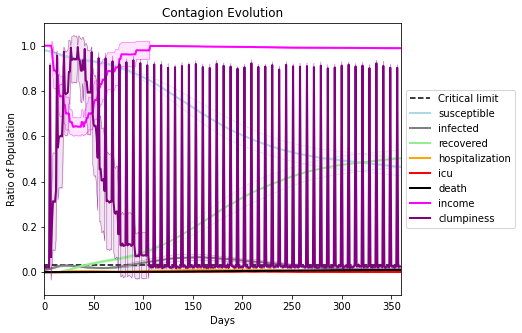

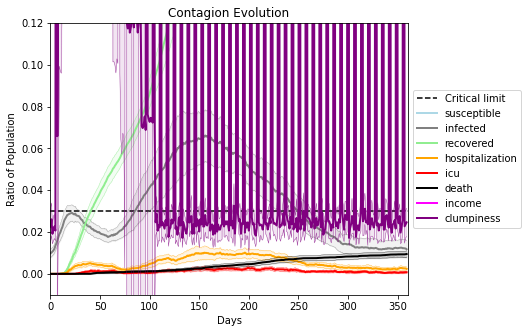

In [44]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)